<a href="https://colab.research.google.com/github/coddmajes/deep-learning/blob/master/Version8plus_LossFunctionAdjustment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### **Tensorflow 2.0 with GPU**

In [2]:
import tensorflow as tf
print(tf.__version__)

2.2.0-rc3


In [1]:
!pip install tensorflow-gpu==2.2.0-rc3
#pip install --upgrade tensorflow

     |████████████████████████████████| 516.2MB 28kB/s 
ERROR: Operation cancelled by user


In [3]:
print("GPU is avaliable:",tf.config.list_physical_devices('GPU'))
print("Num GPUs Available: ", len(tf.config.experimental.list_physical_devices('GPU')))

GPU is avaliable: []
Num GPUs Available:  0


In [0]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
  try:
    # Currently, memory growth needs to be the same across GPUs
    for gpu in gpus:
      tf.config.experimental.set_memory_growth(gpu, True)
    logical_gpus = tf.config.experimental.list_logical_devices('GPU')
    print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
  except RuntimeError as e:
    # Memory growth must be set before GPUs have been initialized
    print(e)

In [5]:
tf.config.set_soft_device_placement(True)
!nvidia-smi

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



### **Get Data**

In [6]:
!wget --no-check-certificate --show-progress -q\
    "https://github.com/coddmajes/deep-learning/raw/master/CroppedYale.zip" \
    -O "/tmp/CroppedYale.zip"

/tmp/CroppedYale.zi 100%[===================>]  55.78M  71.3MB/s    in 0.8s    


In [0]:
import numpy as np
import pathlib
import zipfile
import os
import matplotlib.pyplot as plt

from time import time
from math import sqrt
from PIL import Image

In [8]:
zip_ref = zipfile.ZipFile('/tmp/CroppedYale.zip', 'r')
zip_ref.extractall("/tmp")
zip_ref.close()

root_dir = "/tmp/CroppedYale"
data_root = pathlib.Path(root_dir)
print(data_root)
print(data_root.exists())

/tmp/CroppedYale
True


In [0]:
def pgmtojpg(srcPath, dstPath):
  filepath, filename = os.path.split(srcPath)
  out_file = os.path.splitext(filename)[0] + '.png'
  im = Image.open(srcPath)
  new_path = os.path.join(dstPath, out_file)
  im.save(new_path)
  im.close()

### **# randomly select half of the 2,414 images in the Extended Yale B database as A (1205)**

### **Data Preparation training data & validation data**

In [10]:
import random, shutil, fnmatch

#A=== training set (196*168, 1205)
A_list = []
val_list = []
test_list = []

train_dir = '/tmp/Yale/train'
val_dir = '/tmp/Yale/val'
test_dir = '/tmp/Yale/test'

train_files_num = 0
val_files_num = 0
test_files_num = 0

train_nums = []
val_nums = []
test_nums = []

class_names = []
#creat a database  train has 1205 faces, val has 604 faces, test has 605 faces, train val test all have 38 classes
CroppedYale_dir = os.walk(root_dir) 
for path,dir_list,file_list in CroppedYale_dir: 
  for dir_name in dir_list:
    dir_path = os.path.join(path,dir_name) #dir_path = '/tmp/CroppedYale/Yale01'
    class_names.append(dir_name)
    #each subject has 64 pictures
    files = os.listdir(dir_path)
    file_path = []

    train_f_num = []
    val_f_num = []
    test_f_num = []

    for f in files:
      if fnmatch.fnmatch(f, '*.pgm') and f.find('Ambient') == -1: #get the 64 file in each subject
        file_path.append(os.path.join(dir_path,f))
    
    #print(len(file_path))
    print(dir_name)

    #random each subject
    random.shuffle(file_path)
    file_len = len(file_path)

    #get each subject's path 
    trian_class_path = os.path.join(train_dir,dir_name)
    val_class_path = os.path.join(val_dir,dir_name)
    test_class_path = os.path.join(test_dir,dir_name)

    #create a new dir train_dir val_dir and test_dir
    if not os.path.exists(trian_class_path):
      #print(trian_class_path)
      os.makedirs(trian_class_path)
      #print('create trian_class_path success！\n')

    if not os.path.exists(val_class_path):
      #print(val_class_path)
      os.makedirs(val_class_path)
      #print('create val_class_path success！\n')

    if not os.path.exists(test_class_path):
      #print(test_class_path)
      os.makedirs(test_class_path)
      #print('create test_class_path success！\n')

    #copy the pic to the train dir 
    #pgm->jpg
    #open file and img->array A_list
    for tr_src_path in file_path[:int(file_len/2)]:
      if os.path.exists(tr_src_path):
        # create A_dic = {yale01:0...31, yale02:32...63....}
        train_f_num.append(train_files_num)
        train_files_num = train_files_num+1

        pgmtojpg(tr_src_path, trian_class_path)
        
        #A_list
        tr_img = Image.open(tr_src_path)
        tr_img_convert_ndarray = np.array(tr_img)
        tr_img_convert_ndarray = tr_img_convert_ndarray.flatten()
        A_list.append(tr_img_convert_ndarray)
    train_nums.append(train_f_num)

    for val_src_path in file_path[int(file_len/2):int(file_len/4*3)]:
      if os.path.exists(val_src_path):
        val_f_num.append(val_files_num)
        val_files_num = val_files_num+1
        pgmtojpg(val_src_path, val_class_path)

        # validation dataset
        val_img = Image.open(val_src_path)
        val_img_convert_ndarray = np.array(val_img)
        val_img_convert_ndarray = val_img_convert_ndarray.flatten()
        val_list.append(val_img_convert_ndarray)
    val_nums.append(val_f_num)

    for te_src_path in file_path[int(file_len/4*3):]:
      if os.path.exists(te_src_path):
        test_f_num.append(test_files_num)
        test_files_num = test_files_num+1
        pgmtojpg(te_src_path, test_class_path)

        test_img = Image.open(te_src_path)
        test_img_convert_ndarray = np.array(val_img)
        test_img_convert_ndarray = test_img_convert_ndarray.flatten()
        test_list.append(test_img_convert_ndarray)
        #shutil.copy(te_src_path, test_class_path)
    test_nums.append(test_f_num)
  

yaleB33
yaleB04
yaleB16
yaleB23
yaleB29
yaleB05
yaleB26
yaleB01
yaleB28
yaleB10
yaleB37
yaleB17
yaleB11
yaleB31
yaleB21
yaleB24
yaleB12
yaleB13
yaleB39
yaleB02
yaleB38
yaleB27
yaleB30
yaleB08
yaleB35
yaleB34
yaleB18
yaleB25
yaleB07
yaleB03
yaleB19
yaleB22
yaleB20
yaleB09
yaleB15
yaleB36
yaleB06
yaleB32


### **A**

In [11]:
A = np.array(A_list)
A = A.T

# create A_dic = {yale01:0...31, yale02:32...63....}
A_dict = dict(zip(class_names, train_nums))
val_dict = dict(zip(class_names, val_nums))
test_dict = dict(zip(class_names, test_nums))
print(class_names)
print(A_dict)
print(val_dict)
print(test_dict)

['yaleB33', 'yaleB04', 'yaleB16', 'yaleB23', 'yaleB29', 'yaleB05', 'yaleB26', 'yaleB01', 'yaleB28', 'yaleB10', 'yaleB37', 'yaleB17', 'yaleB11', 'yaleB31', 'yaleB21', 'yaleB24', 'yaleB12', 'yaleB13', 'yaleB39', 'yaleB02', 'yaleB38', 'yaleB27', 'yaleB30', 'yaleB08', 'yaleB35', 'yaleB34', 'yaleB18', 'yaleB25', 'yaleB07', 'yaleB03', 'yaleB19', 'yaleB22', 'yaleB20', 'yaleB09', 'yaleB15', 'yaleB36', 'yaleB06', 'yaleB32']
{'yaleB33': [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31], 'yaleB04': [32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63], 'yaleB16': [64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94], 'yaleB23': [95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126], 'ya

### **Dict**

In [12]:
class_sort = class_names.copy()
class_sort.sort()
print(class_names)
print(class_sort)
num_to_class = dict(zip(class_sort, np.arange(0, len(class_sort))))
print(num_to_class)
class_to_num = dict(zip(np.arange(0, len(class_sort)), class_sort))
print(class_to_num)

['yaleB33', 'yaleB04', 'yaleB16', 'yaleB23', 'yaleB29', 'yaleB05', 'yaleB26', 'yaleB01', 'yaleB28', 'yaleB10', 'yaleB37', 'yaleB17', 'yaleB11', 'yaleB31', 'yaleB21', 'yaleB24', 'yaleB12', 'yaleB13', 'yaleB39', 'yaleB02', 'yaleB38', 'yaleB27', 'yaleB30', 'yaleB08', 'yaleB35', 'yaleB34', 'yaleB18', 'yaleB25', 'yaleB07', 'yaleB03', 'yaleB19', 'yaleB22', 'yaleB20', 'yaleB09', 'yaleB15', 'yaleB36', 'yaleB06', 'yaleB32']
['yaleB01', 'yaleB02', 'yaleB03', 'yaleB04', 'yaleB05', 'yaleB06', 'yaleB07', 'yaleB08', 'yaleB09', 'yaleB10', 'yaleB11', 'yaleB12', 'yaleB13', 'yaleB15', 'yaleB16', 'yaleB17', 'yaleB18', 'yaleB19', 'yaleB20', 'yaleB21', 'yaleB22', 'yaleB23', 'yaleB24', 'yaleB25', 'yaleB26', 'yaleB27', 'yaleB28', 'yaleB29', 'yaleB30', 'yaleB31', 'yaleB32', 'yaleB33', 'yaleB34', 'yaleB35', 'yaleB36', 'yaleB37', 'yaleB38', 'yaleB39']
{'yaleB01': 0, 'yaleB02': 1, 'yaleB03': 2, 'yaleB04': 3, 'yaleB05': 4, 'yaleB06': 5, 'yaleB07': 6, 'yaleB08': 7, 'yaleB09': 8, 'yaleB10': 9, 'yaleB11': 10, 'yaleB

### **R && D**

In [13]:
# get the Random Matrix R
n_samples = 400
rng = np.random.RandomState(int(time()))

Rm, Rn = 120, 192*168 

R = rng.randn(Rm, Rn) / np.sqrt(Rm)

print(R.shape)
print(R)

#D
D = np.matmul(R,A)
Dm, Dn = D.shape[0], D.shape[1]

D_norm= np.linalg.norm(D, axis=0)
D = D/D_norm

(120, 32256)
[[-0.05152871  0.18218791  0.0583642  ... -0.00437301  0.03448
  -0.04043847]
 [ 0.01763909 -0.01665241  0.02466137 ...  0.17551564 -0.0728349
   0.13290952]
 [ 0.03272176  0.01498596  0.02555489 ... -0.04532904 -0.09500541
   0.06870009]
 ...
 [ 0.05190851 -0.08919571  0.07263487 ... -0.12015776 -0.0966436
   0.04779249]
 [ 0.12440147  0.12447005 -0.00272393 ...  0.07774067  0.07399402
   0.08278484]
 [ 0.08121239 -0.10470623  0.00198776 ... -0.02126107 -0.09215841
   0.06923635]]


### **Data Preparation**

In [14]:
val_data = np.array(val_list)

val_label = []
for name in class_names:
  for i in val_dict[name]:
    val_label.append(num_to_class[name])

print(val_label)

test_label = []
for name in class_names:
  for i in test_dict[name]:
    test_label.append(num_to_class[name])

print(test_label)

# val_data split to 5 parts
val_label = np.array(val_label)
test_label = np.array(test_label)
from sklearn.model_selection import train_test_split
val_input_train, val_input_val, val_input_train_label, val_input_val_label = train_test_split(val_data, val_label, test_size=476)

print(val_input_train.shape)
print(val_input_val.shape)
print(val_input_train_label.shape)
print(val_input_val_label.shape)

[31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 31, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 21, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 27, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 24, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 26, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 9, 35, 35, 35, 35, 35, 35, 35, 35, 35, 35, 35, 35, 35, 35, 35, 35, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 29, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 22, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11, 11,

## **Unrolled Algorithms**

In [0]:
class uISTA(tf.Module):
  def __init__(self, num_unroll, in_D, lr=1., soft=None, step=None,theta=None):
    super(uISTA, self).__init__()
    self.num_unroll = num_unroll
    self.D = tf.Variable(in_D, name='tf_D',trainable=True)
    self.lr = tf.Variable(lr, name='tf_lr',trainable=True)

    if step is None: 
      self.step = lambda m_D, m_y: 2*np.linalg.norm(m_D.numpy().dot(m_D.numpy().T.dot(m_y))) / np.linalg.norm(m_y.numpy())
    else:
      self.step = step

    if theta is None:
      self.theta = lambda m_lam, m_step: m_lam*m_step
    else:
      self.theta = theta 

    if soft is None:
      self.soft = lambda p, th: tf.multiply(tf.sign(p),tf.maximum(tf.abs(p) - th, 0))
    else:
      self.soft = soft 

  def __call__(self, in_y):
    in_L = 1./self.step(self.D, in_y)
    x = self.soft(tf.matmul(tf.transpose(self.D), in_L*in_y), self.theta(self.lr, in_L))
    for i in range(self.num_unroll):
      #x + 1/L*A.t(b-Ax)
      x = self.soft(x + tf.matmul(tf.transpose(self.D), (in_L*in_y - tf.matmul(self.D, in_L*x))), self.theta(self.lr, in_L)) 

    #classifying
    y_class = []
    class_resi = []
    for name in class_sort:
      #get the block D(i)
      Di = tf.gather(self.D, A_dict[name],axis=1) #Di.shape = (120,len(A_dict[name]))
      xi = tf.gather(x, A_dict[name],axis=0) #xi.shape = (len(A_dict[name]),batch_size)
      yi = tf.matmul(Di,xi) #yi.shape = (120, batch_size)

      yi_si = tf.matmul(tf.transpose(in_y), yi) #in_y.T.dot(yi)
      iny_n = tf.linalg.norm(in_y,axis=0) #||iny_n||
      yi_n = tf.linalg.norm(yi,axis=0) #||yi_n||
      si_n = iny_n*yi_n #||iny_n||*||yi_n||
      si = yi_si/si_n # in_y.T.dot(yi)/||iny_n||*||yi_n||
      si_diag = tf.linalg.diag_part(si)
      y_class.append(si_diag)
      
      #compute the residuals r = ||in_y - Di*xi||2
      residuals = tf.linalg.norm((in_y - yi), axis=0) #residuals.shape(batch_size,)
      #print(residuals.shape)
      class_resi.append(residuals)

    return x, y_class, class_resi

### LISTA

In [0]:
class LISTA(tf.Module):
  def __init__(self, num_unroll, in_D, scale, theta, soft=None, _W=None, _S=None):
    super(LISTA, self).__init__()
    self.num_unroll = num_unroll
    self.D = in_D
    self.theta = theta
    self.scale = scale

    S = np.diag(np.ones(self.D.shape[1])) - (1/self.scale)*np.matmul(self.D.T, self.D)
    W = (1/self.scale)*self.D.T
    self.S = tf.Variable(S, name='S',trainable=True)
    self.W = tf.Variable(W, name='W',trainable=True)

    if _W is None:
      self._W = lambda m_W, m_y: tf.matmul(m_W, m_y)
    else:
      self._W = _W

    if _S is None:
      self._S = lambda m_S, m_x: tf.matmul(m_S, m_x)
    else:
      self._S = _S
    
    if soft is None:
      self.soft = lambda p, th: tf.multiply(tf.sign(p),tf.maximum(tf.abs(p) - th, 0))
    else:
      self.soft = soft

  def __call__(self, in_y):
    x = self.soft(self._W(self.W, in_y), self.theta)   
    for i in range(self.num_unroll):
      #x + 1/L*A.t(b-Ax)
      x = self.soft(self._W(self.W, in_y) + self._S(self.S, x), self.theta) 

    return x

**FISTA**

In [0]:
class uFISTA(tf.Module):
  def __init__(self, num_unroll, in_D, lr=1., soft=None, step=None, theta=None):
    super(uFISTA, self).__init__()
    self.num_unroll = num_unroll
    self.D = tf.Variable(in_D, name='tf_D',trainable=True)
    self.lr = tf.Variable(lr, name='tf_lr',trainable=True)

    if step is None: 
      self.step = lambda m_D, m_y: 2*np.linalg.norm(m_D.numpy().dot(m_D.numpy().T.dot(m_y))) / np.linalg.norm(m_y.numpy())
    else:
      self.step = step

    if theta is None:
      self.theta = lambda m_lam, m_step: m_lam*m_step
    else:
      self.theta = theta 

    if soft is None:
      self.soft = lambda p, th: tf.multiply(tf.sign(p),tf.maximum(tf.abs(p) - th, 0))
    else:
      self.soft = soft

  # ts is t(k) t is t(k+1) 
  # xs is x(k-1) x is x(k)         
  def __call__(self, in_y):
    in_L = 1./self.step(self.D, in_y)
    x = tf.matmul(tf.transpose(self.D), in_y)
    w = x
    t = tf.cast(1.,dtype=tf.float64)
    for i in range(self.num_unroll):
      # save x(k-1)
      xs = x
      Q = w + tf.matmul(tf.transpose(self.D), (in_L*in_y- tf.matmul(self.D, in_L*w)))
      x = self.soft(Q, self.theta(self.lr, in_L))
      # save t(k)
      ts = t
      t = (1/2)*(1+tf.sqrt(1+4*t*t))
      w = x + tf.multiply((ts-1)/t, (x-xs))

    #classifying
    y_class = []
    class_resi = []
    for name in class_sort:
      #get the block D(i)
      Di = tf.gather(self.D, A_dict[name],axis=1) #Di.shape = (120,len(A_dict[name]))
      xi = tf.gather(x, A_dict[name],axis=0) #xi.shape = (len(A_dict[name]),batch_size)
      yi = tf.matmul(Di,xi) #yi.shape = (120, batch_size)

      yi_si = tf.matmul(tf.transpose(in_y), yi) #in_y.T.dot(yi)
      iny_n = tf.linalg.norm(in_y,axis=0) #||iny_n||
      yi_n = tf.linalg.norm(yi,axis=0) #||yi_n||
      si_n = iny_n*yi_n #||iny_n||*||yi_n||
      si = yi_si/si_n # in_y.T.dot(yi)/||iny_n||*||yi_n||
      si_diag = tf.linalg.diag_part(si)
      y_class.append(si_diag)

      #compute the residuals r = ||in_y - Di*xi||2
      residuals = tf.linalg.norm((in_y - yi), axis=0) #residuals.shape(batch_size,)
      #print(residuals.shape)
      class_resi.append(residuals)

    return x, y_class, class_resi

# **Automation Testing**

### **Save Path**

In [18]:
savePath = '/tmp/Yale/save'

if not os.path.exists(savePath):
  print(savePath)
  os.makedirs(savePath)
  print('create' + savePath + 'success！\n')

/tmp/Yale/save
create/tmp/Yale/savesuccess！



### **Plot Function**

In [0]:
def model_test(in_model, in_y, in_y_label, in_lay, in_lam, in_wi, in_rwi, in_tit):
  t0 = time()
  x_model, y_class, residuals = in_model(in_y)
  t = (time() - t0)*1000
  print('done %d layers in %.2fms' % (in_lay, t))

  y_class = tf.nn.softmax(y_class, axis=0)
  y_class_onehot = tf.argmax(y_class, axis=0)#y_predicts_class.shape = (batch_size,)

  print("predict class: %s" % class_to_num[y_class_onehot.numpy()[0]]) 
  print("test image label: %s" % class_to_num[in_y_label])

  #plot x
  plt.figure(figsize=(12,4))
  axx = plt.subplot(1,2,1,)
  axr = plt.subplot(1,2,2)
  plt.sca(axx)
  plt.plot(np.arange(x_model.shape[0]), x_model, 'ro', mfc = 'None', markersize=2, mec='blue', mew=1, label=in_tit)
  plt.legend(loc= 'upper right')
  
  plt.title(in_tit+'T'+ str(int(t)) +'_layer' + str(in_lay) + '_Lamb' + str(in_lam) +"_wi"+ str(in_wi) +"_rwi" + str(in_rwi))

  #plot residuals 
  '''
  #problem 1: results show unclear
  # if the pic is blur or unclear, then the result turn out to be wrong
  # if the pic is unblur or clear, with the layers increased, the result shows clearer
  '''

  print("predict residuals label: %s" % y_class_onehot.numpy()[0])
  print("test residuals label: %s" % in_y_label)

  residuals = np.array(residuals)
  resi = residuals[y_class_onehot.numpy()[0]]
  print(resi)

  #use the minimum resi to identify class
  min_resi = tf.argmin(tf.convert_to_tensor(residuals),axis = 0)

  plt.sca(axr)
  for line in range(residuals.shape[0]):
    p_color = 'blue'
    '''
    if line == in_y_label:
      p_color = 'red'
    if line == y_class_onehot.numpy()[0] and line != in_y_label:
      p_color = 'green'
    '''
    if line == in_y_label or line == min_resi.numpy()[0] or line == y_class_onehot.numpy()[0]: #描绘这其中一条线时的状况：除此之外都是蓝色
      
      if y_class_onehot.numpy()[0] == in_y_label and in_y_label == min_resi.numpy()[0]: # 三个都相等 红标！！
        if line == in_y_label: 
          p_color = 'red'
      elif y_class_onehot.numpy()[0] == in_y_label and in_y_label != min_resi.numpy()[0]: #与y_class 相等， 红色， 黄色   
        if line == in_y_label:
          p_color = 'red'
        elif line == min_resi.numpy()[0]:
          p_color = 'yellow'
      elif y_class_onehot.numpy()[0] != in_y_label and in_y_label == min_resi.numpy()[0]:#resi 相等， 红色， 绿色
        if line == in_y_label:
          p_color = 'red'
        elif line == y_class_onehot.numpy()[0]:
          p_color = 'green'
      elif y_class_onehot.numpy()[0] != in_y_label and y_class_onehot.numpy()[0] == min_resi.numpy()[0]:# class 和 resi 相等， 红色， 粉色
        if line == in_y_label:
          p_color = 'red'
        elif line == y_class_onehot.numpy()[0]:
          p_color = 'pink'
      elif y_class_onehot.numpy()[0] != in_y_label and in_y_label != min_resi.numpy()[0]: #三个都不相等， 红绿黄蓝
        if line == in_y_label:
          p_color = 'red'
        elif line == y_class_onehot.numpy()[0]:
          p_color = 'green'
        elif line == min_resi.numpy()[0]:
          p_color = 'yellow'
    plt.bar(line, residuals[line],label=line, color=p_color) #
    #plt.legend(loc= 'upper right')
  
  plt.title(in_tit+'_resi'+str(int(resi))  + '_Class'+ str(y_class_onehot.numpy()[0]))
  
  plt.savefig(savePath +'/' + in_tit + '_layer' + str(in_lay) + '_Lamb' + str(in_lam)  +"_wi"+ str(in_wi) +"_rwi" + str(in_rwi)+'BeforeTrain'+ '.png')
  plt.show()

  return x_model

## **Optimizaiton**

In [0]:
# training data preparation
BATCH_SIZE = 32
BUFFER_SIZE = 200
NUM_EPOCHES = 100
LEARNING_RATE = 3e-4 #3e-4

#train data
train_dataset = tf.data.Dataset.from_tensor_slices((val_input_train, val_input_train_label))
train_dataset = train_dataset.shuffle(buffer_size=BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

#optimizer
optimizer=tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE)

In [0]:
def loss_fuc(model, label, in_y, in_l, in_w, in_rwi, in_epo):
  predict_x, predict_y, predict_residuals = model(in_y) #predict_x.shape(1205,32), predict_y_onthot.shape(38,32), predict_residuals.shape=(38,32)

  if in_epo == 0 or in_epo == NUM_EPOCHES-1:
    predicts_y_soft = tf.nn.softmax(predict_y, axis=0)
    predicts_y_max = tf.argmax(predicts_y_soft,axis=0)
    equ_class = tf.reduce_mean(tf.cast(tf.equal(label, predicts_y_max),dtype=tf.float64))

    resi_min = tf.argmin(tf.convert_to_tensor(predict_residuals),axis = 0)
    equ_resi = tf.reduce_mean(tf.cast(tf.equal(label, resi_min),dtype=tf.float64))
    print("green class correct rate:", equ_class.numpy())
    print("yellow resi correct rate:", equ_resi.numpy())
  
  label_onehot = tf.one_hot(label, depth=len(class_names)) # (100,38)
  predict_y = tf.transpose(predict_y)

  loss_resi = tf.reduce_min(tf.convert_to_tensor(predict_residuals),axis = 0)

  loss_l = tf.nn.softmax_cross_entropy_with_logits(labels= label_onehot, logits= predict_y) #loss 1: (100,)

  loss_L1 = tf.reduce_sum(in_l*tf.abs(predict_x),axis=0) # sum(abs(x))  lamb is change
  
  loss = tf.linalg.norm(in_y - tf.matmul(model.D, predict_x),axis=0) # loss = ||y-Dx||2
  #loss_L2 = 0.5 * loss * loss

  return 0.5*loss_resi*loss_resi + in_w*loss_l + loss_L1 #+ loss_L2 ## loss_L2_norm = ||y-Dx|| 


In [0]:
def grad(model, labels, in_y, in_l, in_w, in_rwi, in_epo):
  with tf.GradientTape() as tape:
    loss_value = loss_fuc(model, labels, in_y, in_l, in_w, in_rwi, in_epo)

  return loss_value, tape.gradient(loss_value, model.trainable_variables)

In [0]:
def train(model, in_l, in_w, in_rwi, in_title, in_cout):
  loss = []
  for epoch in range(NUM_EPOCHES): 
    for tr_batch, tr_labels in train_dataset:
      tr_batch = tf.transpose(tr_batch) #(32256,100)
      tr_batch = tf.cast(tr_batch, dtype=tf.float64)
      yt_batch = tf.matmul(R, tr_batch) #(120,100)
      loss_value, grads = grad(model, tr_labels, yt_batch, in_l, in_w, in_rwi, epoch)
      optimizer.apply_gradients(zip(grads, model.trainable_variables))
      loss.append(tf.linalg.norm(loss_value))
    if (epoch+1) % 10 == 0:
      print ('Epoch [{:3d}/{}]: loss = {:.4f},  '.format(epoch+1, NUM_EPOCHES, tf.linalg.norm(loss_value)), end=' ')
      print('lambda [max:{:.4f}], [min:{:.4f}], '.format(tf.reduce_max(model.lr), tf.reduce_min(model.lr)))
      #print('step [L:{:.4f}]], '.format(model.soft(model.D)))
  plt.title("Loss")
  plt.plot(loss, label="loss")
  plt.legend()
 
  plt.savefig(savePath + '/' +in_title + "_" + '_layer_10'+'_L_W' + str(in_w) +'_Re_W' + str(in_rwi) +'_co_'+ str(in_cout) + '_B_S' + str(BATCH_SIZE)  +'Train'+'.png')
  plt.show()
    

### **Model Choose**

In [0]:
def model_choose(in_title, in_layers, in_l, in_L):
  if in_title == title1:
    model_out = uISTA(in_layers, D, lr=in_l) 
  elif in_title == title2:
    model_out = uFISTA(in_layers, D, lr=in_l) 
  elif in_title == title3:
    model_out = uSALSA(in_layers, D, lr=in_l, scale=in_L) 
  elif in_title == title4:
    model_out = uOMP(D, tol = 2e-5, maxnnz = in_layers)  #当layer>1000不成立
  return model_out

### **Randomly choose input_y**

In [0]:
# get 10 test examples for validation
val_example = val_input_train[0:10,:]
val_example_label = val_input_train_label[0:10]
input_y_example = np.matmul(R, val_example.T)

### **zip file**

In [0]:
def dfs_get_zip_file(input_path,result):

#
    files = os.listdir(input_path)
    for file in files:
        if os.path.isdir(input_path+'/'+file):
            dfs_get_zip_file(input_path+'/'+file,result)
        else:
            result.append(input_path+'/'+file)

def zip_path(input_path,output_path,output_name):

    f = zipfile.ZipFile(output_path+'/'+output_name,'w',zipfile.ZIP_DEFLATED)
    filelists = []
    dfs_get_zip_file(input_path,filelists)
    for file in filelists:
        f.write(file)
    f.close()
    return output_path+r"/"+output_name

### **Parameters**  
### **L2 = 2 * lambda(max) (D.T * D)**

In [0]:
# Lambda
la1, la2, la3 = 10, 2, 0.2
la = [la1, la2, la3]

# weight 
w1, w2, w3 = 10, 1, 0.5,
w = [w1, w2, w3]

# Resi weight 
rew1, rew2, rew3 = 10, 50, 100,
rew = [rew1, rew2, rew3]

# Layers 
layer1, layer2, layer3 = 10, 5, 1
layer = [layer1, layer2, layer3]

# Titles
title1, title2, title3, title4 = 'ISTA', 'FISTA', 'SALSA', 'OMP'


### testing5 for resi correct and class correct lossfunction== resi时

In [0]:
cout = 0
title = ["FISTA","ISTA"]
rwi = 0.5
for tit in title:
  for wi in w:
  #for rwi in rew:
    for l in la:
      lam = np.ones((Dn,1)) * l
      for lay in layer:
        for i in range(10):
          input_y = input_y_example[:,i]
          input_y_label = val_example_label[i]
          input_y = tf.convert_to_tensor(input_y)
          input_y = tf.reshape(input_y,(input_y.shape[0],1))

          # plot 1
          model_obj = model_choose(tit, lay, lam, 0)
          x_model = model_test(model_obj, input_y, input_y_label, lay, l, wi, rwi, tit+"BeforeTrain")
        
          # train
          train(model_obj, l, wi, rwi, tit, cout)
          # plot after train
          x_model_tr = model_test(model_obj, input_y, input_y_label, lay, l, wi,rwi, tit + "AfterTrain")
          # plot contrast of before train and after train
          x_p = [x_model, x_model_tr]
          title_p = [tit, tit+"_train"]
          co_p = ['red', 'blue']
          for o_x, o_tit, o_co in zip(x_p, title_p, co_p):
            plt.plot(np.arange(o_x.shape[0]), o_x, 'ro', mfc = 'None', markersize=2, mec=o_co, mew=1, label=o_tit)
            plt.legend(loc= 'upper right')
          plt.title("The contrast of the sparsity of x" + '_Lamb' + str(l))
          plt.savefig(savePath +'/' + tit + 'Contrast_layer' + str(lay) + '_Lamb' + str(la) +"_wi"+ str(wi)+"_Rwi"+ str(rwi) + '.png')
          plt.show()

          cout = cout+1
          print(cout)    


### testing4 for L, L changed and lamb is constant in lossfunction

done 10 layers in 89.09ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[13941.38586987]


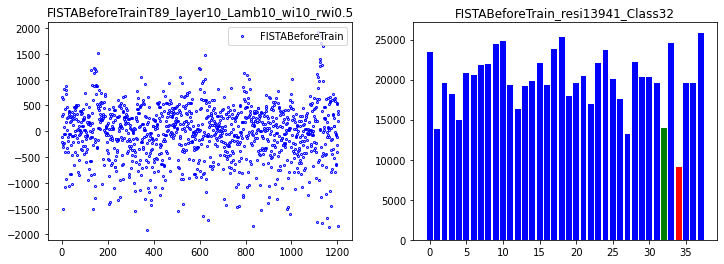

correct rate: 0.5625
correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.625
Epoch [ 10/100]: loss = 83819076.9344,   lambda [max:10.0335], [min:9.9765], 
Epoch [ 20/100]: loss = 58671752.5928,   lambda [max:10.0487], [min:9.9664], 
Epoch [ 30/100]: loss = 55458114.5717,   lambda [max:10.0615], [min:9.9575], 
Epoch [ 40/100]: loss = 37338007.1550,   lambda [max:10.0698], [min:9.9541], 
Epoch [ 50/100]: loss = 35974610.3877,   lambda [max:10.0824], [min:9.9484], 
Epoch [ 60/100]: loss = 33056300.5168,   lambda [max:10.0964], [min:9.9440], 
Epoch [ 70/100]: loss = 31963583.6802,   lambda [max:10.1097], [min:9.9406], 
Epoch [ 80/100]: loss = 29578579.2320,   lambda [max:10.1234], [min:9.9375], 
Epoch [ 90/100]: loss = 28986744.3336,   lambda [max:10.1370], [min:9.9349], 
correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.71875
correct rate: 0.75
Epoch [100/100]: loss = 27066569.3112,   lambda [max:10.1515], [min:9.9325], 


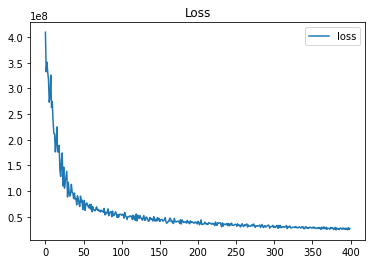

done 10 layers in 89.44ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[1629.72449714]


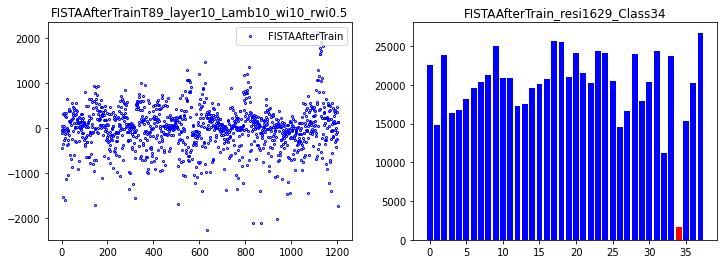

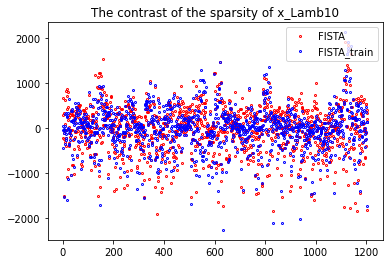

1
done 10 layers in 88.00ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[8822.74593575]


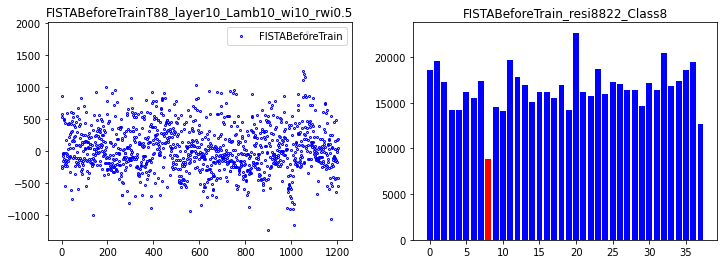

correct rate: 0.625
correct rate: 0.6875
correct rate: 0.5
correct rate: 0.65625
Epoch [ 10/100]: loss = 74236761.3055,   lambda [max:10.0425], [min:9.9705], 
Epoch [ 20/100]: loss = 57103479.3043,   lambda [max:10.0657], [min:9.9601], 
Epoch [ 30/100]: loss = 44085813.0718,   lambda [max:10.0780], [min:9.9463], 
Epoch [ 40/100]: loss = 34267983.0401,   lambda [max:10.0947], [min:9.9371], 
Epoch [ 50/100]: loss = 35075217.5524,   lambda [max:10.1138], [min:9.9303], 
Epoch [ 60/100]: loss = 30193593.7195,   lambda [max:10.1311], [min:9.9246], 
Epoch [ 70/100]: loss = 26571379.5936,   lambda [max:10.1474], [min:9.9196], 
Epoch [ 80/100]: loss = 24764629.2078,   lambda [max:10.1630], [min:9.9155], 
Epoch [ 90/100]: loss = 25309862.4603,   lambda [max:10.1776], [min:9.9120], 
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.71875
Epoch [100/100]: loss = 22144852.0544,   lambda [max:10.1911], [min:9.9089], 


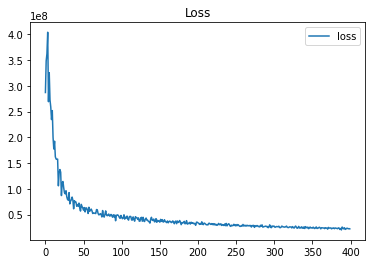

done 10 layers in 84.61ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1765.60910967]


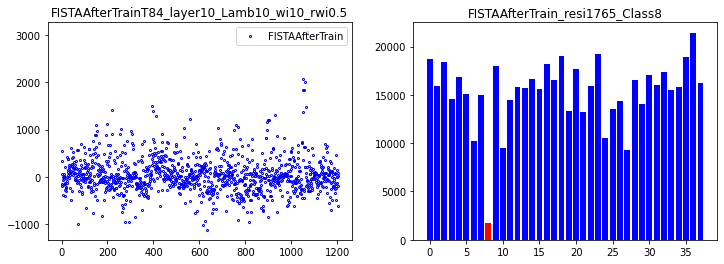

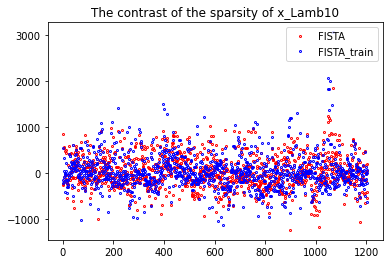

2
done 10 layers in 86.70ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6060.81923272]


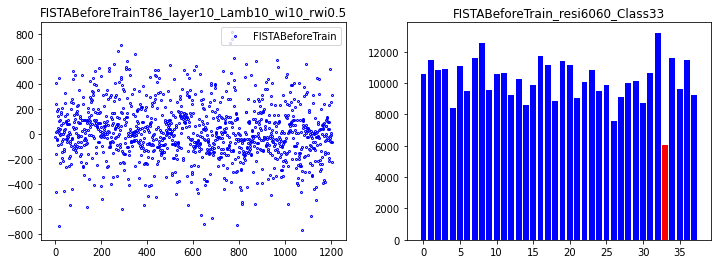

correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.59375
Epoch [ 10/100]: loss = 68113732.3586,   lambda [max:10.0468], [min:9.9678], 
Epoch [ 20/100]: loss = 48549382.9175,   lambda [max:10.0680], [min:9.9530], 
Epoch [ 30/100]: loss = 39206951.6236,   lambda [max:10.0876], [min:9.9425], 
Epoch [ 40/100]: loss = 37003066.1613,   lambda [max:10.1104], [min:9.9362], 
Epoch [ 50/100]: loss = 28423546.4603,   lambda [max:10.1332], [min:9.9314], 
Epoch [ 60/100]: loss = 25369515.5074,   lambda [max:10.1540], [min:9.9274], 
Epoch [ 70/100]: loss = 23379435.6280,   lambda [max:10.1736], [min:9.9248], 
Epoch [ 80/100]: loss = 23107943.9445,   lambda [max:10.1924], [min:9.9229], 
Epoch [ 90/100]: loss = 21815965.0370,   lambda [max:10.2093], [min:9.9211], 
correct rate: 0.625
correct rate: 0.625
correct rate: 0.8125
correct rate: 0.59375
Epoch [100/100]: loss = 20434276.5637,   lambda [max:10.2247], [min:9.9184], 


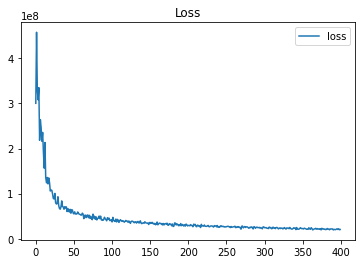

done 10 layers in 87.13ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[1326.58644106]


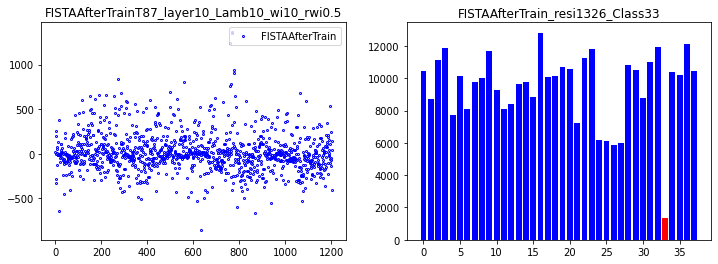

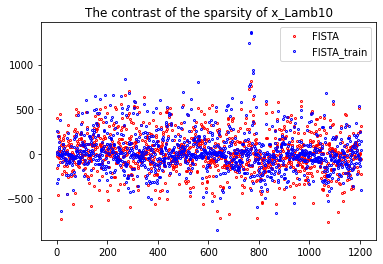

3
done 10 layers in 88.32ms
predict class: yaleB31
test image label: yaleB19
predict residuals label: 29
test residuals label: 17
[7794.27484626]


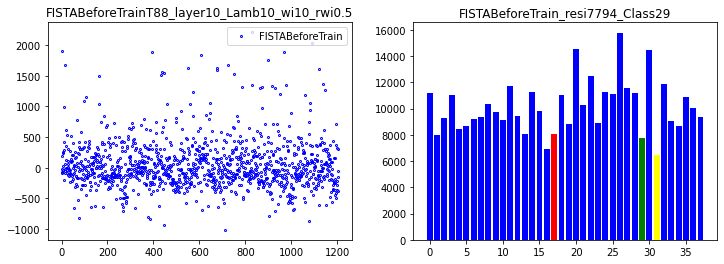

correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.5
correct rate: 0.59375
Epoch [ 10/100]: loss = 64961685.2800,   lambda [max:10.0472], [min:9.9665], 
Epoch [ 20/100]: loss = 43541540.7859,   lambda [max:10.0778], [min:9.9578], 
Epoch [ 30/100]: loss = 37498546.6712,   lambda [max:10.1040], [min:9.9449], 
Epoch [ 40/100]: loss = 32573507.6282,   lambda [max:10.1278], [min:9.9362], 
Epoch [ 50/100]: loss = 28553515.2677,   lambda [max:10.1502], [min:9.9295], 
Epoch [ 60/100]: loss = 24416868.0832,   lambda [max:10.1717], [min:9.9237], 
Epoch [ 70/100]: loss = 26206269.7546,   lambda [max:10.1915], [min:9.9195], 
Epoch [ 80/100]: loss = 21460843.6619,   lambda [max:10.2100], [min:9.9154], 
Epoch [ 90/100]: loss = 21661670.3259,   lambda [max:10.2270], [min:9.9120], 
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.625
Epoch [100/100]: loss = 20402289.5644,   lambda [max:10.2432], [min:9.9090], 


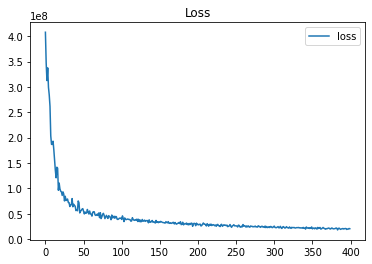

done 10 layers in 89.51ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[2863.28696759]


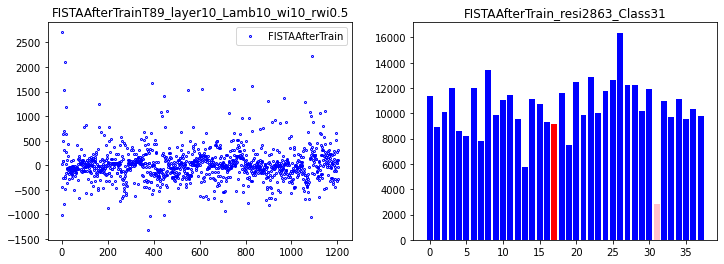

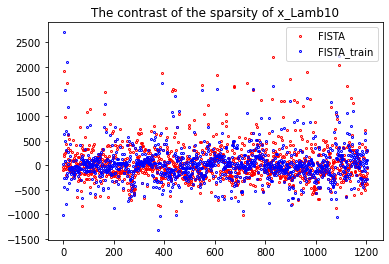

4
done 10 layers in 89.68ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[7973.40559981]


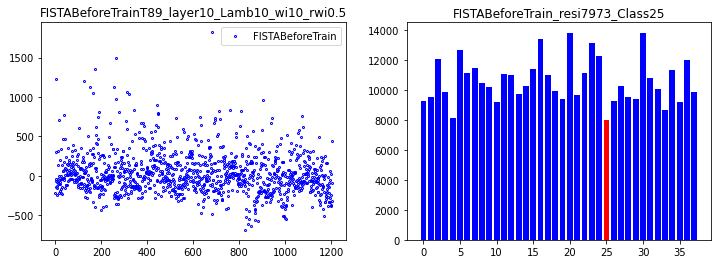

correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.59375
Epoch [ 10/100]: loss = 60077453.8931,   lambda [max:10.0566], [min:9.9648], 
Epoch [ 20/100]: loss = 44305480.6939,   lambda [max:10.0851], [min:9.9570], 
Epoch [ 30/100]: loss = 37588134.7479,   lambda [max:10.1112], [min:9.9468], 
Epoch [ 40/100]: loss = 28877548.1376,   lambda [max:10.1360], [min:9.9405], 
Epoch [ 50/100]: loss = 26374514.6092,   lambda [max:10.1589], [min:9.9355], 
Epoch [ 60/100]: loss = 24952287.7446,   lambda [max:10.1787], [min:9.9317], 
Epoch [ 70/100]: loss = 24077956.8288,   lambda [max:10.1979], [min:9.9286], 
Epoch [ 80/100]: loss = 21475930.5003,   lambda [max:10.2158], [min:9.9259], 
Epoch [ 90/100]: loss = 21863999.5119,   lambda [max:10.2318], [min:9.9238], 
correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.75
Epoch [100/100]: loss = 18783281.4349,   lambda [max:10.2470], [min:9.9224], 


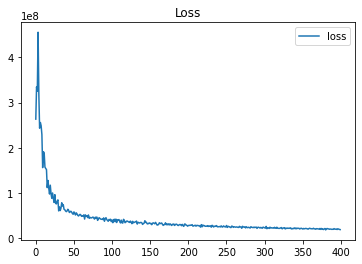

done 10 layers in 95.01ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[984.86649926]


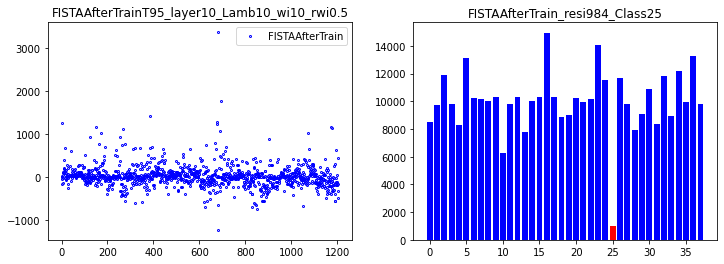

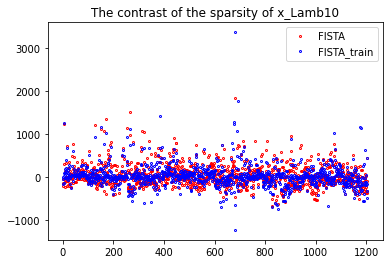

5
done 10 layers in 85.68ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[10512.26431666]


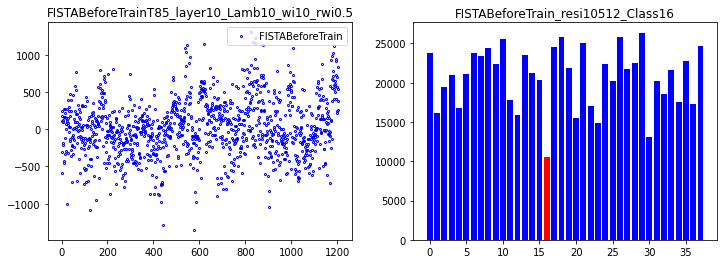

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.5
correct rate: 0.6875
Epoch [ 10/100]: loss = 67309516.2365,   lambda [max:10.0523], [min:9.9636], 
Epoch [ 20/100]: loss = 44582043.2047,   lambda [max:10.0769], [min:9.9561], 
Epoch [ 30/100]: loss = 37531591.3164,   lambda [max:10.1008], [min:9.9432], 
Epoch [ 40/100]: loss = 29574248.9005,   lambda [max:10.1260], [min:9.9342], 
Epoch [ 50/100]: loss = 30367165.1585,   lambda [max:10.1486], [min:9.9268], 
Epoch [ 60/100]: loss = 27093760.0347,   lambda [max:10.1702], [min:9.9213], 
Epoch [ 70/100]: loss = 24312728.4308,   lambda [max:10.1906], [min:9.9162], 
Epoch [ 80/100]: loss = 21519023.4475,   lambda [max:10.2075], [min:9.9118], 
Epoch [ 90/100]: loss = 22771941.6733,   lambda [max:10.2228], [min:9.9079], 
correct rate: 0.75
correct rate: 0.6875
correct rate: 0.53125
correct rate: 0.625
Epoch [100/100]: loss = 19210559.0476,   lambda [max:10.2402], [min:9.9048], 


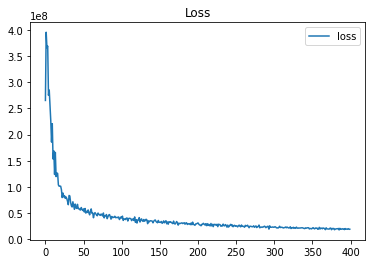

done 10 layers in 94.05ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[569.9333076]


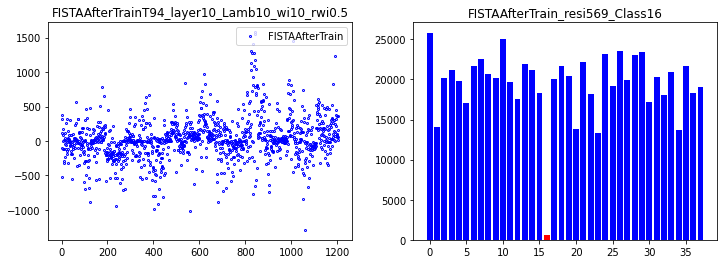

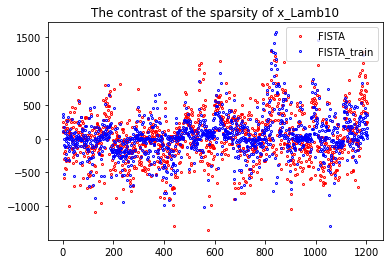

6
done 10 layers in 98.81ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[8534.80881601]


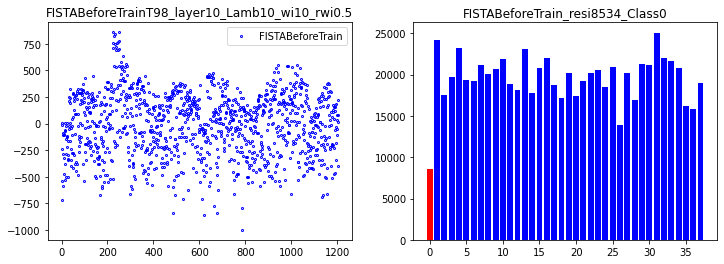

correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.65625
Epoch [ 10/100]: loss = 62802044.5719,   lambda [max:10.0542], [min:9.9663], 
Epoch [ 20/100]: loss = 41084065.5345,   lambda [max:10.0765], [min:9.9519], 
Epoch [ 30/100]: loss = 33933659.2840,   lambda [max:10.1031], [min:9.9415], 
Epoch [ 40/100]: loss = 30645824.2974,   lambda [max:10.1281], [min:9.9346], 
Epoch [ 50/100]: loss = 30841492.8017,   lambda [max:10.1511], [min:9.9300], 
Epoch [ 60/100]: loss = 23496769.9890,   lambda [max:10.1721], [min:9.9235], 
Epoch [ 70/100]: loss = 21859385.3477,   lambda [max:10.1916], [min:9.9170], 
Epoch [ 80/100]: loss = 20797128.7376,   lambda [max:10.2107], [min:9.9122], 
Epoch [ 90/100]: loss = 19233231.3834,   lambda [max:10.2294], [min:9.9088], 
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.5625
Epoch [100/100]: loss = 18973932.0701,   lambda [max:10.2464], [min:9.9063], 


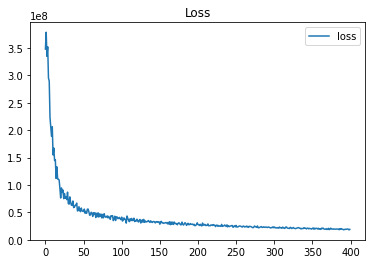

done 10 layers in 87.13ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1230.25983227]


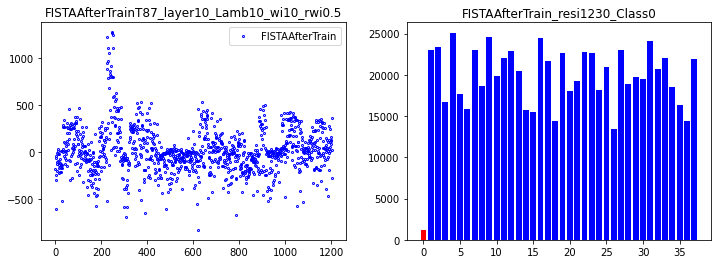

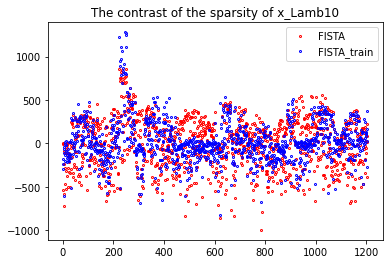

7
done 10 layers in 91.54ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2517.8860613]


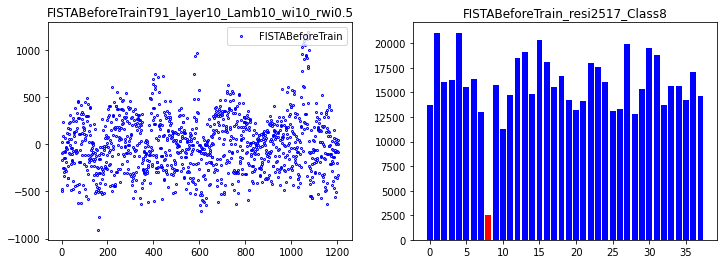

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.5625
Epoch [ 10/100]: loss = 58818946.6013,   lambda [max:10.0538], [min:9.9643], 
Epoch [ 20/100]: loss = 44240843.2258,   lambda [max:10.0839], [min:9.9583], 
Epoch [ 30/100]: loss = 36926736.1621,   lambda [max:10.1119], [min:9.9539], 
Epoch [ 40/100]: loss = 28852352.6555,   lambda [max:10.1387], [min:9.9466], 
Epoch [ 50/100]: loss = 25994402.3837,   lambda [max:10.1636], [min:9.9415], 
Epoch [ 60/100]: loss = 25581355.2900,   lambda [max:10.1855], [min:9.9362], 
Epoch [ 70/100]: loss = 23387082.2296,   lambda [max:10.2053], [min:9.9324], 
Epoch [ 80/100]: loss = 21377090.2123,   lambda [max:10.2232], [min:9.9298], 
Epoch [ 90/100]: loss = 20235177.0861,   lambda [max:10.2396], [min:9.9284], 
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.65625
Epoch [100/100]: loss = 18886868.5719,   lambda [max:10.2544], [min:9.9274], 


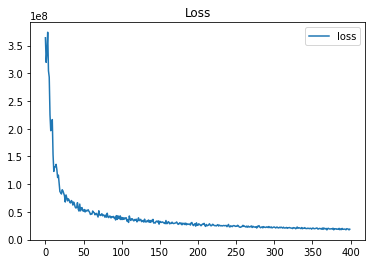

done 10 layers in 90.34ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1878.16508763]


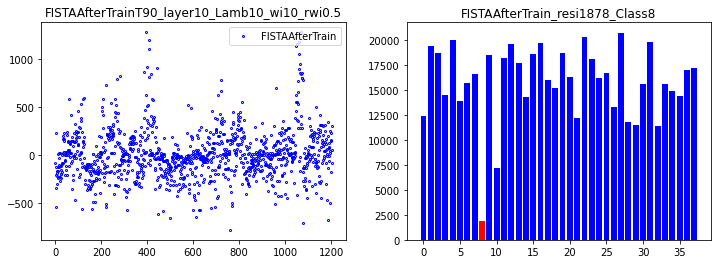

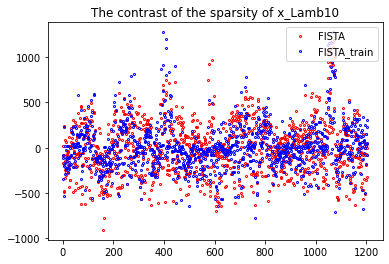

8
done 10 layers in 90.50ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[9767.57112045]


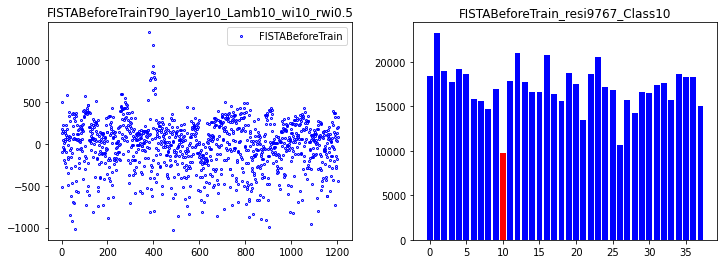

correct rate: 0.625
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.53125
Epoch [ 10/100]: loss = 68070180.1785,   lambda [max:10.0542], [min:9.9627], 
Epoch [ 20/100]: loss = 44072332.0460,   lambda [max:10.0836], [min:9.9498], 
Epoch [ 30/100]: loss = 37057162.5480,   lambda [max:10.1139], [min:9.9397], 
Epoch [ 40/100]: loss = 31485586.5974,   lambda [max:10.1403], [min:9.9289], 
Epoch [ 50/100]: loss = 26217058.7174,   lambda [max:10.1667], [min:9.9208], 
Epoch [ 60/100]: loss = 24733725.4937,   lambda [max:10.1906], [min:9.9135], 
Epoch [ 70/100]: loss = 23272160.9278,   lambda [max:10.2088], [min:9.9081], 
Epoch [ 80/100]: loss = 21574297.4422,   lambda [max:10.2286], [min:9.9032], 
Epoch [ 90/100]: loss = 18703900.0872,   lambda [max:10.2484], [min:9.8990], 
correct rate: 0.5625
correct rate: 0.75
correct rate: 0.625
correct rate: 0.71875
Epoch [100/100]: loss = 18985470.8622,   lambda [max:10.2670], [min:9.8954], 


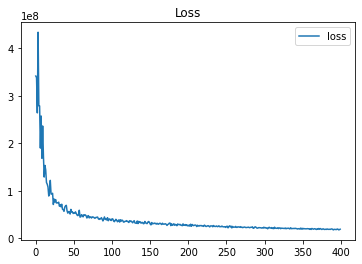

done 10 layers in 87.34ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1582.45711547]


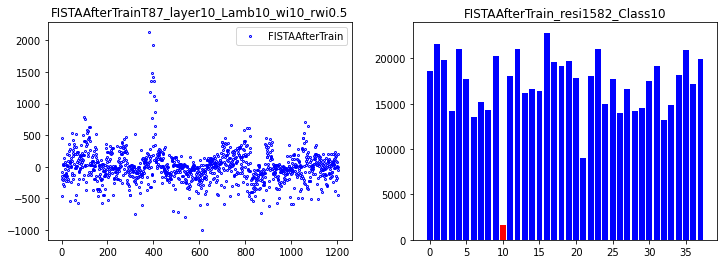

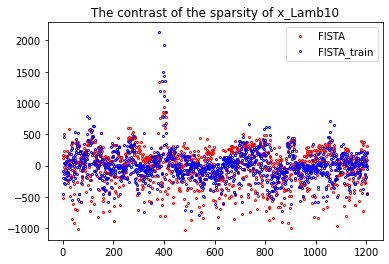

9
done 10 layers in 102.76ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[9010.79906215]


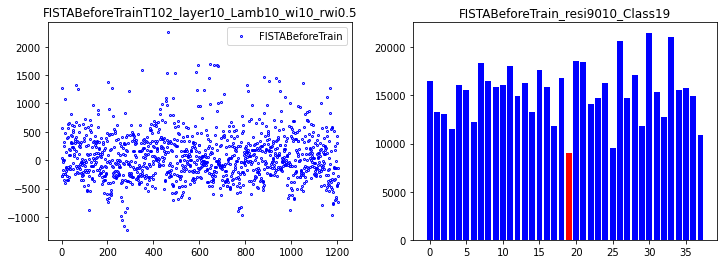

correct rate: 0.5625
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.65625
Epoch [ 10/100]: loss = 59339619.5754,   lambda [max:10.0599], [min:9.9658], 
Epoch [ 20/100]: loss = 42413145.0175,   lambda [max:10.0850], [min:9.9507], 
Epoch [ 30/100]: loss = 38586583.6182,   lambda [max:10.1037], [min:9.9406], 
Epoch [ 40/100]: loss = 31768267.6292,   lambda [max:10.1333], [min:9.9332], 
Epoch [ 50/100]: loss = 27915161.3050,   lambda [max:10.1593], [min:9.9274], 
Epoch [ 60/100]: loss = 26321033.9588,   lambda [max:10.1827], [min:9.9230], 
Epoch [ 70/100]: loss = 23901090.6928,   lambda [max:10.2035], [min:9.9190], 
Epoch [ 80/100]: loss = 22269695.7017,   lambda [max:10.2234], [min:9.9158], 
Epoch [ 90/100]: loss = 18976011.1941,   lambda [max:10.2421], [min:9.9132], 
correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.8125
Epoch [100/100]: loss = 18963969.5334,   lambda [max:10.2592], [min:9.9111], 


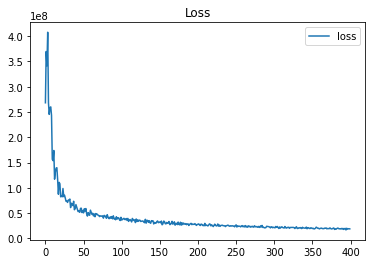

done 10 layers in 93.97ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[3035.27105513]


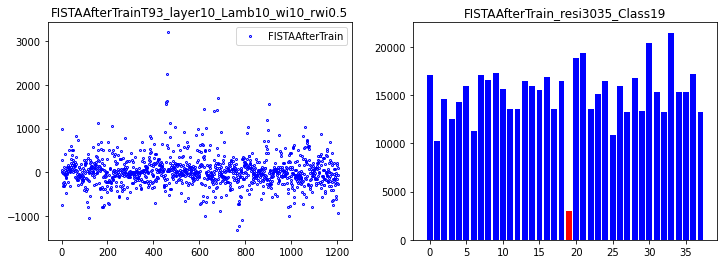

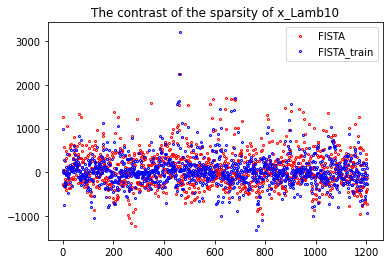

10
done 5 layers in 88.16ms
predict class: yaleB05
test image label: yaleB36
predict residuals label: 4
test residuals label: 34
[16737.98789477]


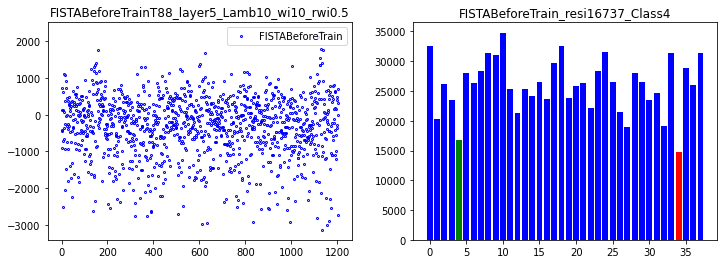

correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.5
correct rate: 0.375
Epoch [ 10/100]: loss = 85437493.4400,   lambda [max:10.0587], [min:9.9764], 
Epoch [ 20/100]: loss = 67870979.3630,   lambda [max:10.1059], [min:9.9639], 
Epoch [ 30/100]: loss = 60879892.1264,   lambda [max:10.1403], [min:9.9578], 
Epoch [ 40/100]: loss = 53593591.0978,   lambda [max:10.1693], [min:9.9542], 
Epoch [ 50/100]: loss = 45054094.2289,   lambda [max:10.1947], [min:9.9513], 
Epoch [ 60/100]: loss = 38267954.0172,   lambda [max:10.2176], [min:9.9500], 
Epoch [ 70/100]: loss = 35526960.7697,   lambda [max:10.2384], [min:9.9473], 
Epoch [ 80/100]: loss = 35338005.0054,   lambda [max:10.2582], [min:9.9426], 
Epoch [ 90/100]: loss = 32387840.4589,   lambda [max:10.2754], [min:9.9386], 
correct rate: 0.28125
correct rate: 0.1875
correct rate: 0.3125
correct rate: 0.34375
Epoch [100/100]: loss = 28423196.9373,   lambda [max:10.2906], [min:9.9364], 


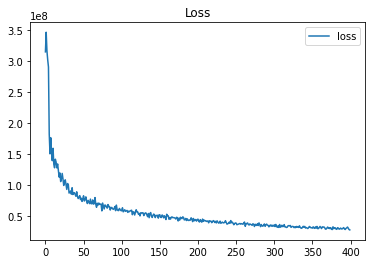

done 5 layers in 87.40ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[1573.91497713]


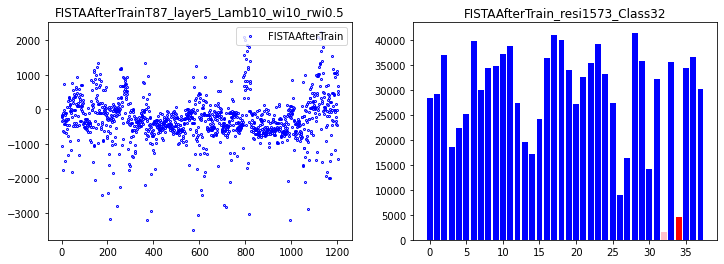

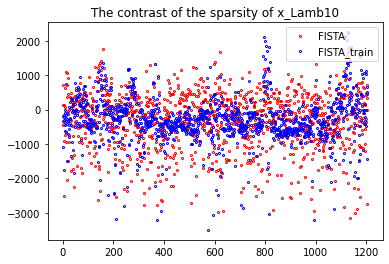

11
done 5 layers in 82.70ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[4445.81119946]


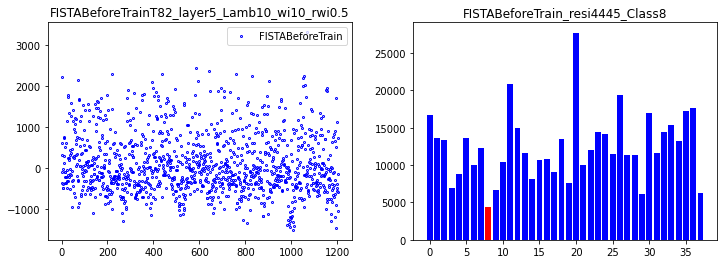

correct rate: 0.46875
correct rate: 0.4375
correct rate: 0.5
correct rate: 0.4375
Epoch [ 10/100]: loss = 84895485.6957,   lambda [max:10.0554], [min:9.9645], 
Epoch [ 20/100]: loss = 67387752.0382,   lambda [max:10.0997], [min:9.9485], 
Epoch [ 30/100]: loss = 54283418.2069,   lambda [max:10.1341], [min:9.9399], 
Epoch [ 40/100]: loss = 49555199.3582,   lambda [max:10.1630], [min:9.9332], 
Epoch [ 50/100]: loss = 45595392.1539,   lambda [max:10.1883], [min:9.9288], 
Epoch [ 60/100]: loss = 41847482.2263,   lambda [max:10.2111], [min:9.9268], 
Epoch [ 70/100]: loss = 38377694.4717,   lambda [max:10.2322], [min:9.9257], 
Epoch [ 80/100]: loss = 36360258.4446,   lambda [max:10.2510], [min:9.9253], 
Epoch [ 90/100]: loss = 30559257.4381,   lambda [max:10.2683], [min:9.9262], 
correct rate: 0.21875
correct rate: 0.28125
correct rate: 0.3125
correct rate: 0.34375
Epoch [100/100]: loss = 30728775.6070,   lambda [max:10.2838], [min:9.9281], 


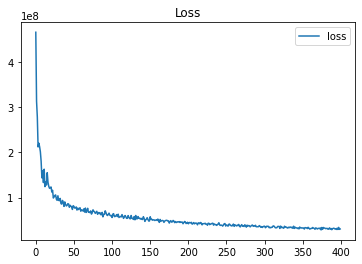

done 5 layers in 82.76ms
predict class: yaleB10
test image label: yaleB09
predict residuals label: 9
test residuals label: 8
[2631.94902397]


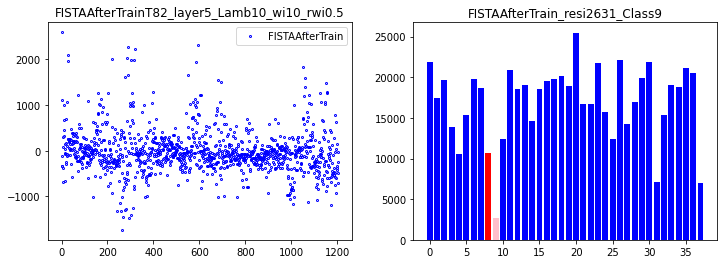

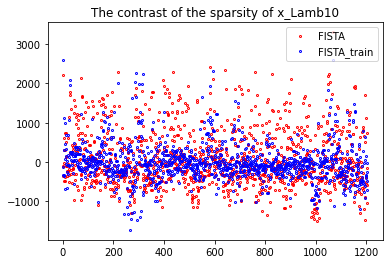

12
done 5 layers in 82.49ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4656.48754402]


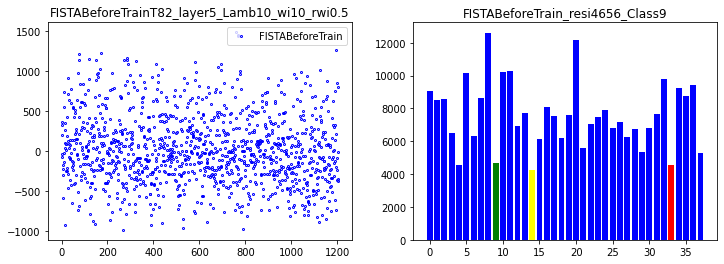

correct rate: 0.5
correct rate: 0.4375
correct rate: 0.4375
correct rate: 0.40625
Epoch [ 10/100]: loss = 87147929.3225,   lambda [max:10.0599], [min:9.9754], 
Epoch [ 20/100]: loss = 68848232.8767,   lambda [max:10.1087], [min:9.9635], 
Epoch [ 30/100]: loss = 61078494.9698,   lambda [max:10.1446], [min:9.9539], 
Epoch [ 40/100]: loss = 50979096.6875,   lambda [max:10.1738], [min:9.9489], 
Epoch [ 50/100]: loss = 44584753.1370,   lambda [max:10.1994], [min:9.9436], 
Epoch [ 60/100]: loss = 41247492.3203,   lambda [max:10.2224], [min:9.9409], 
Epoch [ 70/100]: loss = 35021090.1646,   lambda [max:10.2432], [min:9.9380], 
Epoch [ 80/100]: loss = 35190925.9789,   lambda [max:10.2625], [min:9.9378], 
Epoch [ 90/100]: loss = 31984610.7767,   lambda [max:10.2811], [min:9.9363], 
correct rate: 0.3125
correct rate: 0.375
correct rate: 0.1875
correct rate: 0.25
Epoch [100/100]: loss = 32099084.1410,   lambda [max:10.2977], [min:9.9364], 


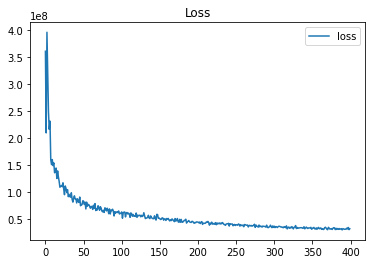

done 5 layers in 82.36ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[2712.67989414]


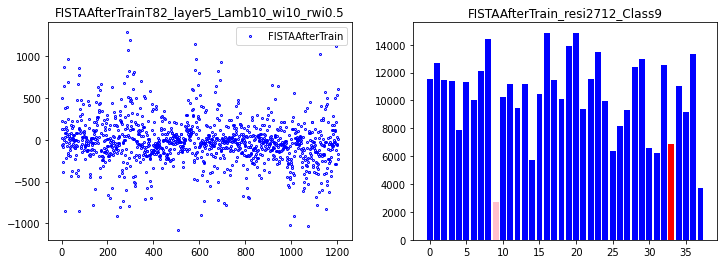

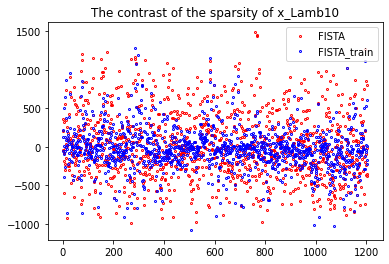

13
done 5 layers in 86.99ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[4966.80891396]


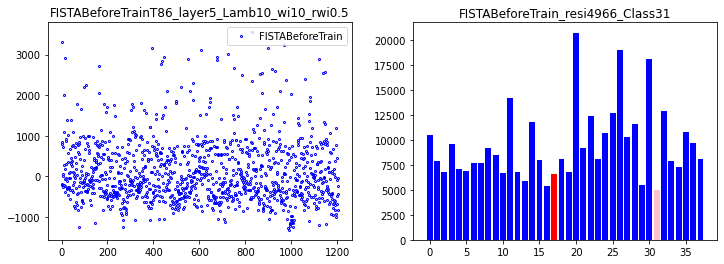

correct rate: 0.46875
correct rate: 0.375
correct rate: 0.4375
correct rate: 0.46875
Epoch [ 10/100]: loss = 90229878.8885,   lambda [max:10.0598], [min:9.9633], 
Epoch [ 20/100]: loss = 66718725.4768,   lambda [max:10.1042], [min:9.9506], 
Epoch [ 30/100]: loss = 56619435.5684,   lambda [max:10.1378], [min:9.9423], 
Epoch [ 40/100]: loss = 50017406.6028,   lambda [max:10.1654], [min:9.9365], 
Epoch [ 50/100]: loss = 40953831.3502,   lambda [max:10.1910], [min:9.9317], 
Epoch [ 60/100]: loss = 41127805.0304,   lambda [max:10.2142], [min:9.9298], 
Epoch [ 70/100]: loss = 37042709.8904,   lambda [max:10.2348], [min:9.9281], 
Epoch [ 80/100]: loss = 35537943.4466,   lambda [max:10.2537], [min:9.9273], 
Epoch [ 90/100]: loss = 37347960.0370,   lambda [max:10.2711], [min:9.9271], 
correct rate: 0.21875
correct rate: 0.25
correct rate: 0.28125
correct rate: 0.28125
Epoch [100/100]: loss = 30287534.1989,   lambda [max:10.2863], [min:9.9289], 


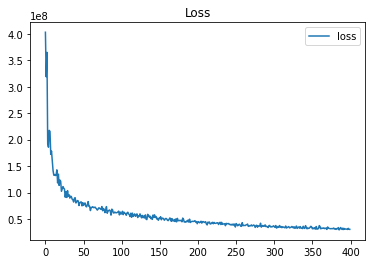

done 5 layers in 81.33ms
predict class: yaleB13
test image label: yaleB19
predict residuals label: 12
test residuals label: 17
[2526.1712597]


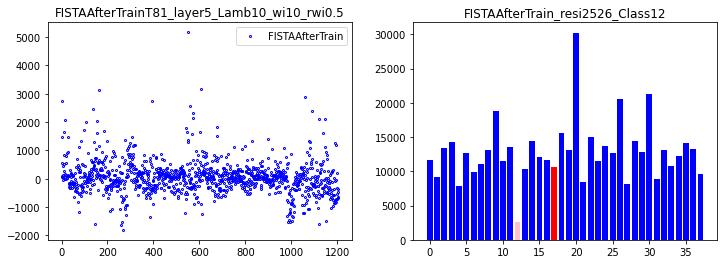

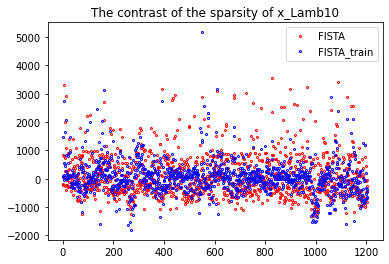

14
done 5 layers in 84.00ms
predict class: yaleB11
test image label: yaleB27
predict residuals label: 10
test residuals label: 25
[5465.70571366]


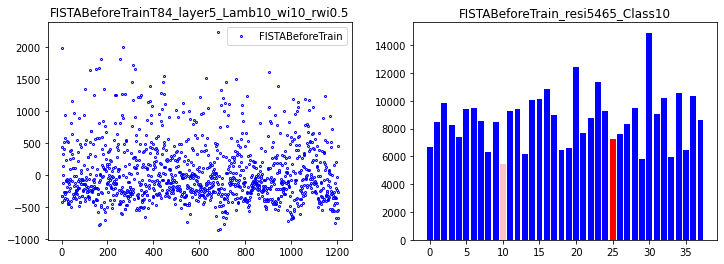

correct rate: 0.4375
correct rate: 0.375
correct rate: 0.4375
correct rate: 0.4375
Epoch [ 10/100]: loss = 91198546.4413,   lambda [max:10.0589], [min:9.9766], 
Epoch [ 20/100]: loss = 65279412.1583,   lambda [max:10.1024], [min:9.9708], 
Epoch [ 30/100]: loss = 57258282.5706,   lambda [max:10.1361], [min:9.9676], 
Epoch [ 40/100]: loss = 50732680.5695,   lambda [max:10.1649], [min:9.9638], 
Epoch [ 50/100]: loss = 45982443.0086,   lambda [max:10.1908], [min:9.9571], 
Epoch [ 60/100]: loss = 43447738.1737,   lambda [max:10.2139], [min:9.9501], 
Epoch [ 70/100]: loss = 35441944.0678,   lambda [max:10.2351], [min:9.9457], 
Epoch [ 80/100]: loss = 35042864.6180,   lambda [max:10.2545], [min:9.9413], 
Epoch [ 90/100]: loss = 32526449.6423,   lambda [max:10.2718], [min:9.9380], 
correct rate: 0.3125
correct rate: 0.28125
correct rate: 0.21875
correct rate: 0.34375
Epoch [100/100]: loss = 30174073.3380,   lambda [max:10.2871], [min:9.9357], 


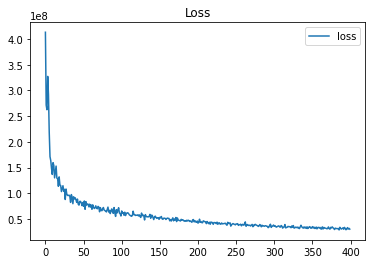

done 5 layers in 84.14ms
predict class: yaleB09
test image label: yaleB27
predict residuals label: 8
test residuals label: 25
[2330.94951142]


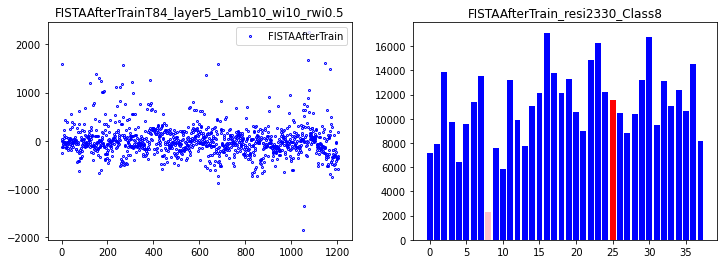

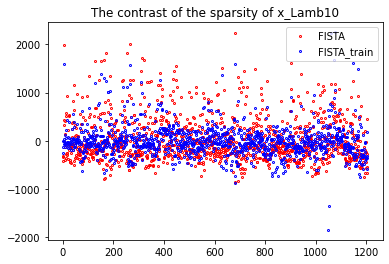

15
done 5 layers in 83.52ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[7226.85819751]


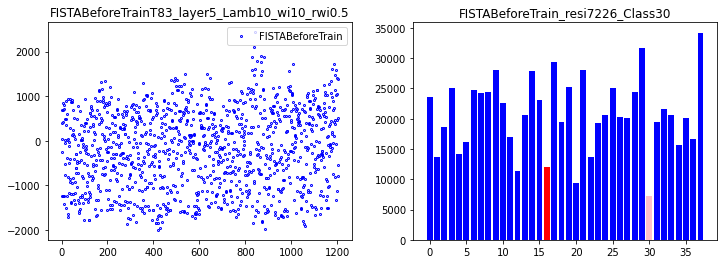

correct rate: 0.4375
correct rate: 0.46875
correct rate: 0.34375
correct rate: 0.46875
Epoch [ 10/100]: loss = 81831273.1241,   lambda [max:10.0559], [min:9.9725], 
Epoch [ 20/100]: loss = 59705401.1629,   lambda [max:10.0977], [min:9.9593], 
Epoch [ 30/100]: loss = 55931225.8060,   lambda [max:10.1324], [min:9.9503], 
Epoch [ 40/100]: loss = 51420596.3081,   lambda [max:10.1610], [min:9.9424], 
Epoch [ 50/100]: loss = 43535418.1380,   lambda [max:10.1862], [min:9.9372], 
Epoch [ 60/100]: loss = 39547249.6588,   lambda [max:10.2090], [min:9.9334], 
Epoch [ 70/100]: loss = 35249933.9352,   lambda [max:10.2296], [min:9.9301], 
Epoch [ 80/100]: loss = 34190710.4409,   lambda [max:10.2484], [min:9.9296], 
Epoch [ 90/100]: loss = 35134654.6282,   lambda [max:10.2652], [min:9.9293], 
correct rate: 0.25
correct rate: 0.28125
correct rate: 0.28125
correct rate: 0.25
Epoch [100/100]: loss = 30262526.0382,   lambda [max:10.2802], [min:9.9302], 


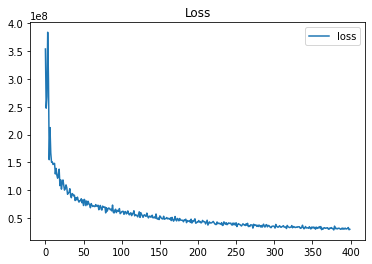

done 5 layers in 85.16ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[726.48653089]


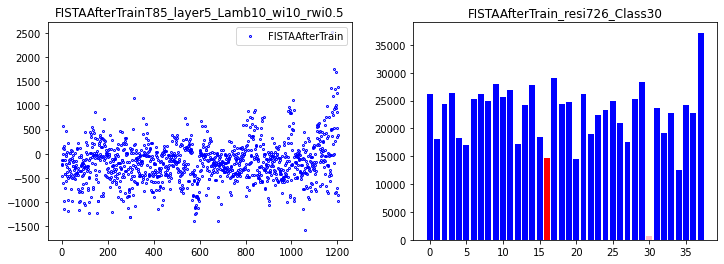

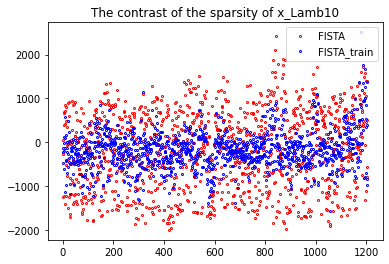

16
done 5 layers in 78.86ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[16822.70800562]


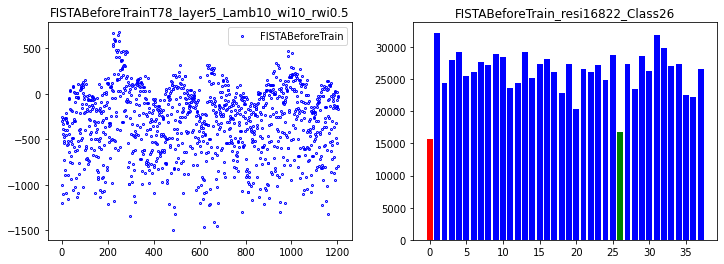

correct rate: 0.5
correct rate: 0.4375
correct rate: 0.34375
correct rate: 0.4375
Epoch [ 10/100]: loss = 84886667.7303,   lambda [max:10.0559], [min:9.9720], 
Epoch [ 20/100]: loss = 71361648.7029,   lambda [max:10.1000], [min:9.9599], 
Epoch [ 30/100]: loss = 58328618.4981,   lambda [max:10.1352], [min:9.9539], 
Epoch [ 40/100]: loss = 46493071.4704,   lambda [max:10.1641], [min:9.9498], 
Epoch [ 50/100]: loss = 43418091.2760,   lambda [max:10.1888], [min:9.9464], 
Epoch [ 60/100]: loss = 40571524.9184,   lambda [max:10.2116], [min:9.9457], 
Epoch [ 70/100]: loss = 38442202.9618,   lambda [max:10.2324], [min:9.9455], 
Epoch [ 80/100]: loss = 33000394.5199,   lambda [max:10.2516], [min:9.9413], 
Epoch [ 90/100]: loss = 32374528.2776,   lambda [max:10.2695], [min:9.9380], 
correct rate: 0.375
correct rate: 0.25
correct rate: 0.28125
correct rate: 0.25
Epoch [100/100]: loss = 29098456.9235,   lambda [max:10.2845], [min:9.9344], 


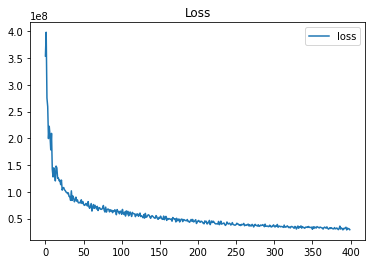

done 5 layers in 77.94ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[2729.36552694]


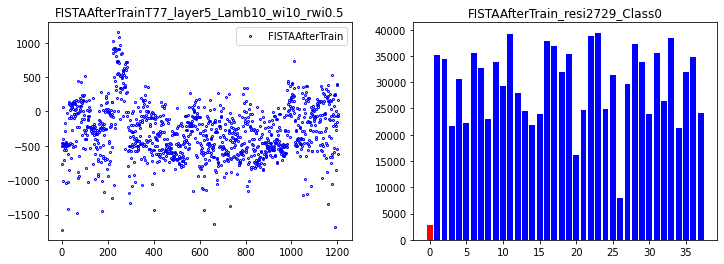

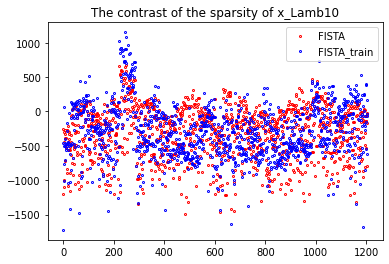

17
done 5 layers in 77.69ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[5129.29331545]


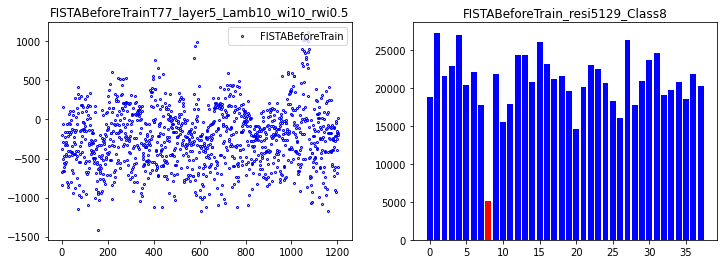

correct rate: 0.5
correct rate: 0.34375
correct rate: 0.5
correct rate: 0.375
Epoch [ 10/100]: loss = 77847060.6277,   lambda [max:10.0564], [min:9.9785], 
Epoch [ 20/100]: loss = 63573400.7685,   lambda [max:10.1010], [min:9.9715], 
Epoch [ 30/100]: loss = 57799556.8338,   lambda [max:10.1361], [min:9.9640], 
Epoch [ 40/100]: loss = 51128809.8503,   lambda [max:10.1648], [min:9.9562], 
Epoch [ 50/100]: loss = 45739193.2232,   lambda [max:10.1895], [min:9.9504], 
Epoch [ 60/100]: loss = 40121802.1725,   lambda [max:10.2118], [min:9.9467], 
Epoch [ 70/100]: loss = 37613089.9189,   lambda [max:10.2322], [min:9.9443], 
Epoch [ 80/100]: loss = 36314094.4781,   lambda [max:10.2509], [min:9.9420], 
Epoch [ 90/100]: loss = 36311721.8624,   lambda [max:10.2680], [min:9.9402], 
correct rate: 0.28125
correct rate: 0.3125
correct rate: 0.28125
correct rate: 0.375
Epoch [100/100]: loss = 30393914.6304,   lambda [max:10.2831], [min:9.9385], 


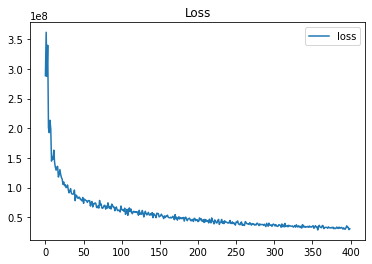

done 5 layers in 79.30ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1977.23899903]


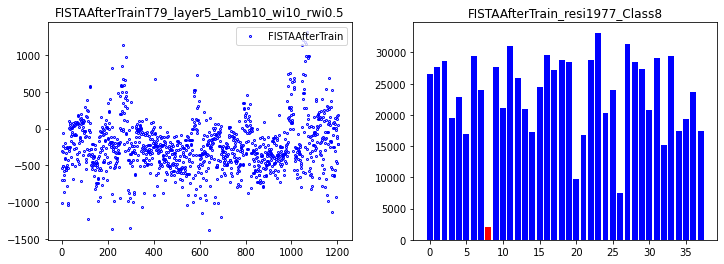

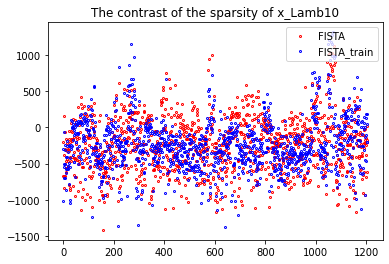

18
done 5 layers in 86.48ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[15797.11521824]


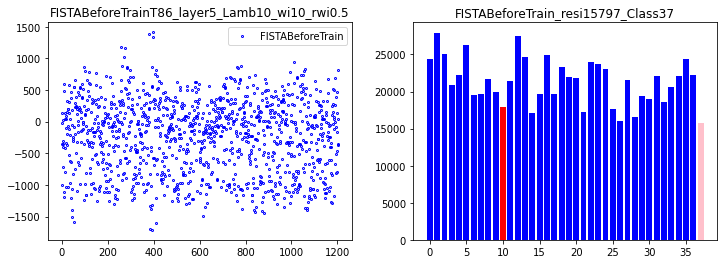

correct rate: 0.4375
correct rate: 0.3125
correct rate: 0.59375
correct rate: 0.40625
Epoch [ 10/100]: loss = 87542686.6341,   lambda [max:10.0627], [min:9.9742], 
Epoch [ 20/100]: loss = 69524225.0568,   lambda [max:10.1100], [min:9.9621], 
Epoch [ 30/100]: loss = 58651014.5825,   lambda [max:10.1453], [min:9.9509], 
Epoch [ 40/100]: loss = 50708205.6025,   lambda [max:10.1747], [min:9.9449], 
Epoch [ 50/100]: loss = 49190080.7117,   lambda [max:10.2008], [min:9.9419], 
Epoch [ 60/100]: loss = 42392891.4667,   lambda [max:10.2239], [min:9.9416], 
Epoch [ 70/100]: loss = 39050734.9318,   lambda [max:10.2451], [min:9.9393], 
Epoch [ 80/100]: loss = 33212355.1772,   lambda [max:10.2653], [min:9.9368], 
Epoch [ 90/100]: loss = 31274343.5103,   lambda [max:10.2827], [min:9.9344], 
correct rate: 0.40625
correct rate: 0.1875
correct rate: 0.25
correct rate: 0.21875
Epoch [100/100]: loss = 31488364.6968,   lambda [max:10.2975], [min:9.9333], 


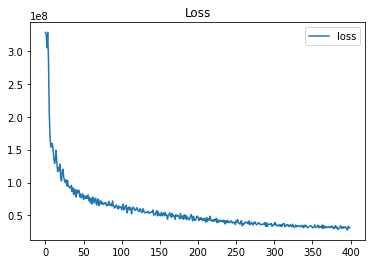

done 5 layers in 89.59ms
predict class: yaleB28
test image label: yaleB11
predict residuals label: 26
test residuals label: 10
[2443.85985745]


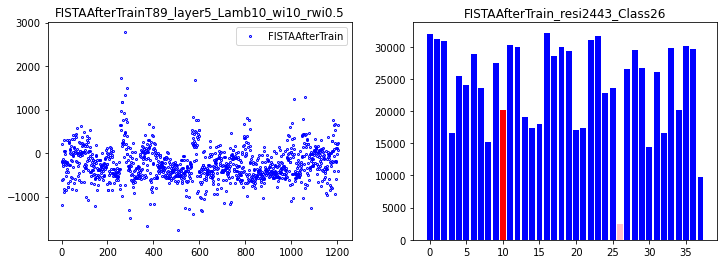

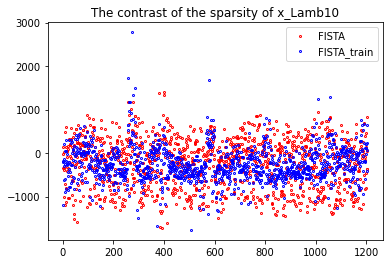

19
done 5 layers in 82.17ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[4730.76968357]


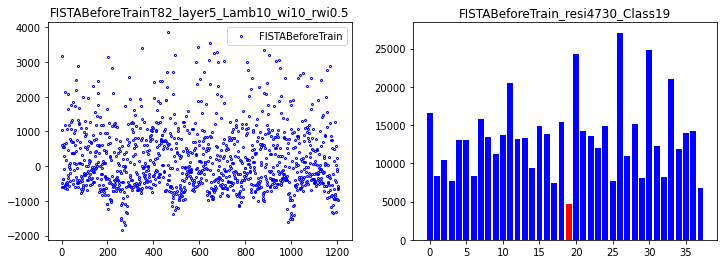

correct rate: 0.46875
correct rate: 0.34375
correct rate: 0.5
correct rate: 0.40625
Epoch [ 10/100]: loss = 86389418.7969,   lambda [max:10.0577], [min:9.9753], 
Epoch [ 20/100]: loss = 69416834.6509,   lambda [max:10.1045], [min:9.9636], 
Epoch [ 30/100]: loss = 58330129.1707,   lambda [max:10.1392], [min:9.9576], 
Epoch [ 40/100]: loss = 51321542.2760,   lambda [max:10.1680], [min:9.9524], 
Epoch [ 50/100]: loss = 45823049.2829,   lambda [max:10.1937], [min:9.9491], 
Epoch [ 60/100]: loss = 40991324.6185,   lambda [max:10.2166], [min:9.9467], 
Epoch [ 70/100]: loss = 37262737.9563,   lambda [max:10.2375], [min:9.9449], 
Epoch [ 80/100]: loss = 32023167.5268,   lambda [max:10.2568], [min:9.9423], 
Epoch [ 90/100]: loss = 31599376.9584,   lambda [max:10.2747], [min:9.9371], 
correct rate: 0.25
correct rate: 0.21875
correct rate: 0.25
correct rate: 0.375
Epoch [100/100]: loss = 33536749.3187,   lambda [max:10.2906], [min:9.9336], 


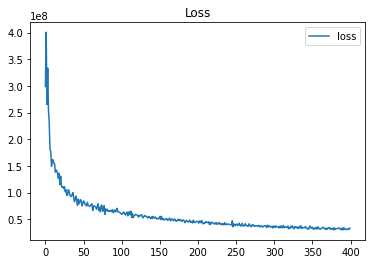

done 5 layers in 81.66ms
predict class: yaleB10
test image label: yaleB21
predict residuals label: 9
test residuals label: 19
[4024.81992902]


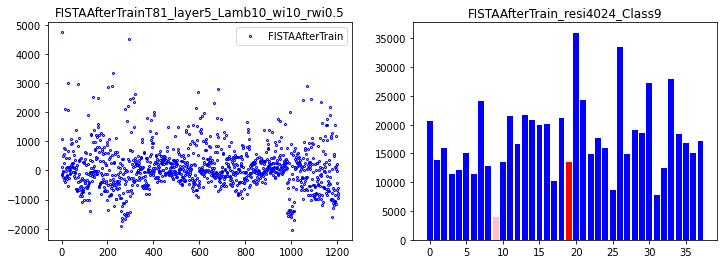

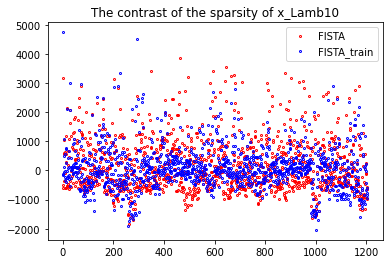

20
done 1 layers in 83.48ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[165029.85877878]


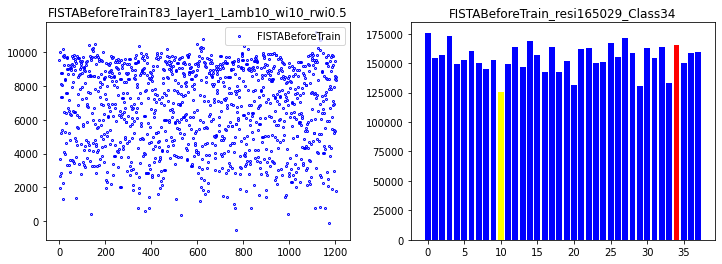

correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.4375
Epoch [ 10/100]: loss = 1226898329.4361,   lambda [max:10.0629], [min:9.9699], 
Epoch [ 20/100]: loss = 776084140.0452,   lambda [max:10.1028], [min:9.9724], 
Epoch [ 30/100]: loss = 602661085.6987,   lambda [max:10.1349], [min:9.9717], 
Epoch [ 40/100]: loss = 525795005.0975,   lambda [max:10.1628], [min:9.9715], 
Epoch [ 50/100]: loss = 522959424.8843,   lambda [max:10.1881], [min:9.9711], 
Epoch [ 60/100]: loss = 430401488.2954,   lambda [max:10.2113], [min:9.9710], 
Epoch [ 70/100]: loss = 470872371.8965,   lambda [max:10.2330], [min:9.9705], 
Epoch [ 80/100]: loss = 514508926.0786,   lambda [max:10.2533], [min:9.9699], 
Epoch [ 90/100]: loss = 526976441.5667,   lambda [max:10.2726], [min:9.9693], 
correct rate: 0.0
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.0
Epoch [100/100]: loss = 444421370.3180,   lambda [max:10.2909], [min:9.9686], 


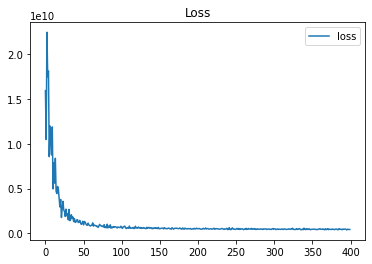

done 1 layers in 77.80ms
predict class: yaleB31
test image label: yaleB36
predict residuals label: 29
test residuals label: 34
[7500.07831917]


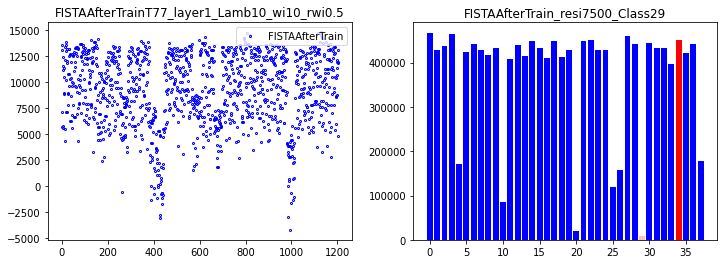

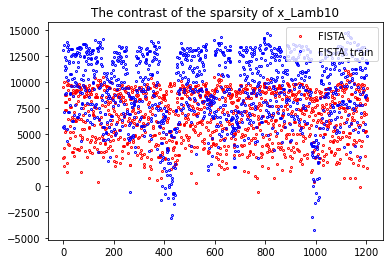

21
done 1 layers in 76.24ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[55240.5028473]


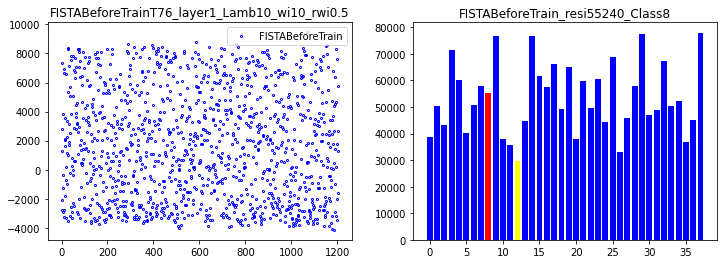

correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.625
Epoch [ 10/100]: loss = 1493673025.5604,   lambda [max:10.0631], [min:9.9696], 
Epoch [ 20/100]: loss = 737227202.9860,   lambda [max:10.1034], [min:9.9720], 
Epoch [ 30/100]: loss = 561875645.3382,   lambda [max:10.1356], [min:9.9726], 
Epoch [ 40/100]: loss = 502232591.2984,   lambda [max:10.1638], [min:9.9721], 
Epoch [ 50/100]: loss = 609708363.3082,   lambda [max:10.1893], [min:9.9722], 
Epoch [ 60/100]: loss = 459774585.6337,   lambda [max:10.2127], [min:9.9722], 
Epoch [ 70/100]: loss = 492307334.8143,   lambda [max:10.2346], [min:9.9719], 
Epoch [ 80/100]: loss = 439485665.9591,   lambda [max:10.2551], [min:9.9719], 
Epoch [ 90/100]: loss = 472689767.1490,   lambda [max:10.2745], [min:9.9722], 
correct rate: 0.09375
correct rate: 0.125
correct rate: 0.0
correct rate: 0.0625
Epoch [100/100]: loss = 494998889.8289,   lambda [max:10.2931], [min:9.9726], 


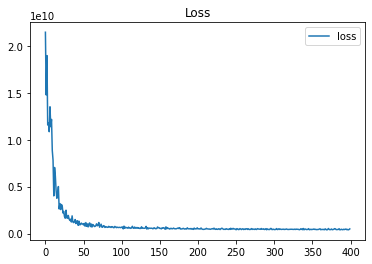

done 1 layers in 81.58ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[68680.39830459]


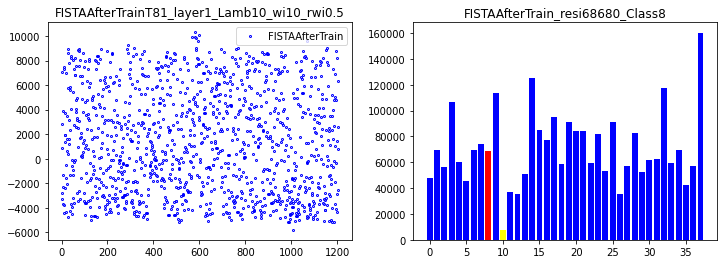

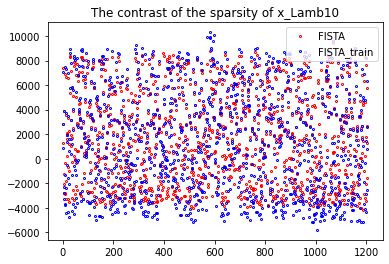

22
done 1 layers in 77.91ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[46018.58194607]


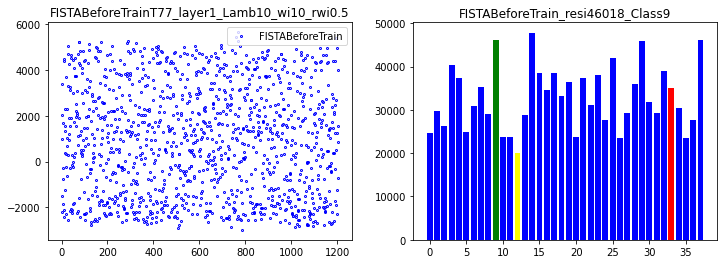

correct rate: 0.65625
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.53125
Epoch [ 10/100]: loss = 980529384.1510,   lambda [max:10.0629], [min:9.9700], 
Epoch [ 20/100]: loss = 752894007.0028,   lambda [max:10.1028], [min:9.9727], 
Epoch [ 30/100]: loss = 643913690.5822,   lambda [max:10.1349], [min:9.9741], 
Epoch [ 40/100]: loss = 600898267.1310,   lambda [max:10.1629], [min:9.9741], 
Epoch [ 50/100]: loss = 476319733.9936,   lambda [max:10.1882], [min:9.9744], 
Epoch [ 60/100]: loss = 476067989.9381,   lambda [max:10.2115], [min:9.9754], 
Epoch [ 70/100]: loss = 478929716.3439,   lambda [max:10.2332], [min:9.9765], 
Epoch [ 80/100]: loss = 535271369.5725,   lambda [max:10.2536], [min:9.9766], 
Epoch [ 90/100]: loss = 401795121.6502,   lambda [max:10.2730], [min:9.9770], 
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.125
Epoch [100/100]: loss = 430029112.3024,   lambda [max:10.2914], [min:9.9774], 


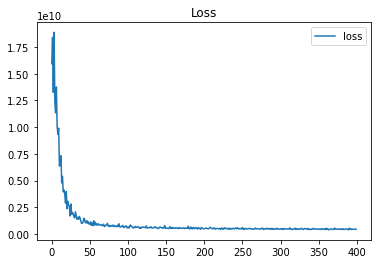

done 1 layers in 76.41ms
predict class: yaleB11
test image label: yaleB35
predict residuals label: 10
test residuals label: 33
[4150.81963329]


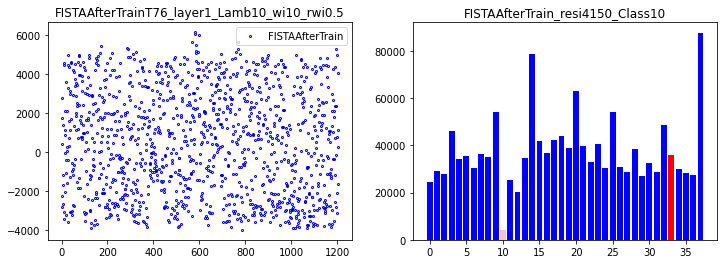

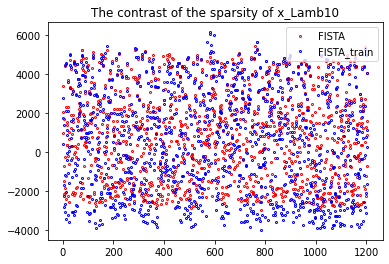

23
done 1 layers in 81.96ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[27569.75108349]


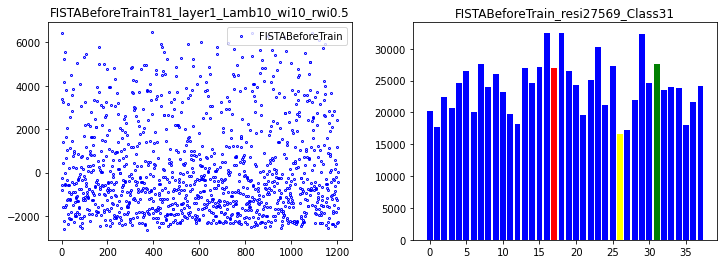

correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.5625
Epoch [ 10/100]: loss = 1011399283.0564,   lambda [max:10.0630], [min:9.9692], 
Epoch [ 20/100]: loss = 821493971.9506,   lambda [max:10.1030], [min:9.9719], 
Epoch [ 30/100]: loss = 567275525.9783,   lambda [max:10.1351], [min:9.9727], 
Epoch [ 40/100]: loss = 530902877.6459,   lambda [max:10.1633], [min:9.9733], 
Epoch [ 50/100]: loss = 612165155.6139,   lambda [max:10.1887], [min:9.9730], 
Epoch [ 60/100]: loss = 443943189.2504,   lambda [max:10.2121], [min:9.9734], 
Epoch [ 70/100]: loss = 465086675.0681,   lambda [max:10.2339], [min:9.9731], 
Epoch [ 80/100]: loss = 492555431.3911,   lambda [max:10.2544], [min:9.9723], 
Epoch [ 90/100]: loss = 422557561.8532,   lambda [max:10.2738], [min:9.9725], 
correct rate: 0.03125
correct rate: 0.0
correct rate: 0.09375
correct rate: 0.0625
Epoch [100/100]: loss = 521452617.9460,   lambda [max:10.2923], [min:9.9721], 


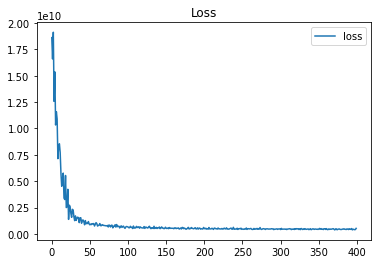

done 1 layers in 76.32ms
predict class: yaleB05
test image label: yaleB19
predict residuals label: 4
test residuals label: 17
[25935.81159416]


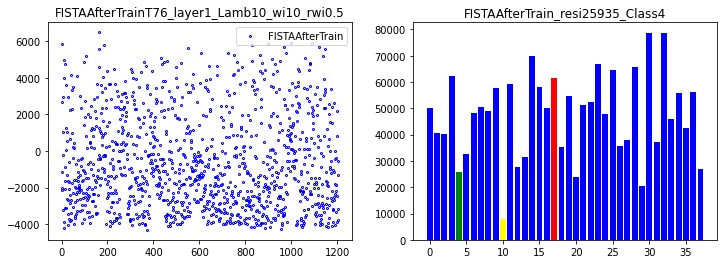

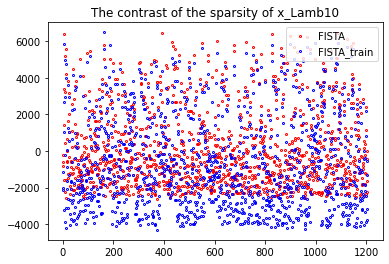

24
done 1 layers in 79.11ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[31029.50814495]


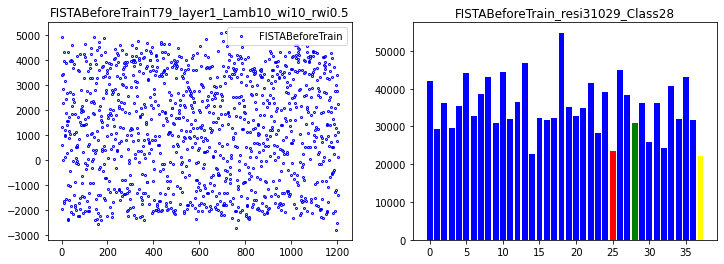

correct rate: 0.59375
correct rate: 0.53125
correct rate: 0.6875
correct rate: 0.59375
Epoch [ 10/100]: loss = 1119860304.2168,   lambda [max:10.0628], [min:9.9642], 
Epoch [ 20/100]: loss = 856663548.2790,   lambda [max:10.1027], [min:9.9660], 
Epoch [ 30/100]: loss = 548760374.0281,   lambda [max:10.1348], [min:9.9672], 
Epoch [ 40/100]: loss = 517013392.5931,   lambda [max:10.1629], [min:9.9678], 
Epoch [ 50/100]: loss = 607091425.7922,   lambda [max:10.1883], [min:9.9696], 
Epoch [ 60/100]: loss = 485144345.9183,   lambda [max:10.2117], [min:9.9703], 
Epoch [ 70/100]: loss = 455189631.0485,   lambda [max:10.2335], [min:9.9710], 
Epoch [ 80/100]: loss = 464337253.9156,   lambda [max:10.2540], [min:9.9709], 
Epoch [ 90/100]: loss = 416727995.6790,   lambda [max:10.2734], [min:9.9712], 
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.09375
correct rate: 0.03125
Epoch [100/100]: loss = 453931865.1262,   lambda [max:10.2919], [min:9.9715], 


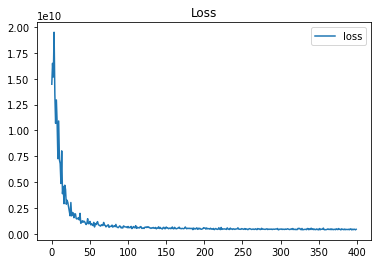

done 1 layers in 83.04ms
predict class: yaleB05
test image label: yaleB27
predict residuals label: 4
test residuals label: 25
[52490.85547937]


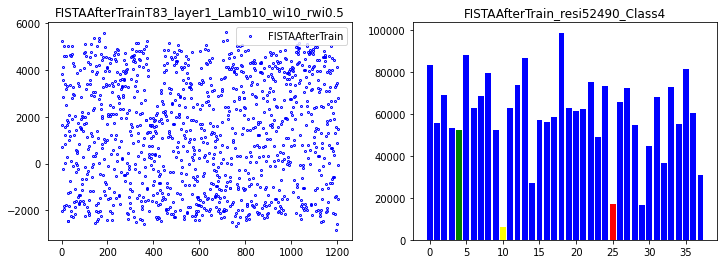

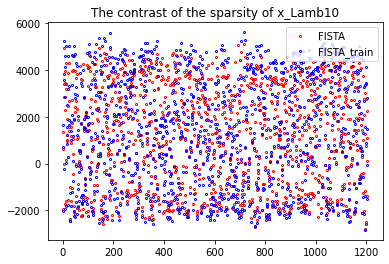

25
done 1 layers in 75.50ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[117197.18619119]


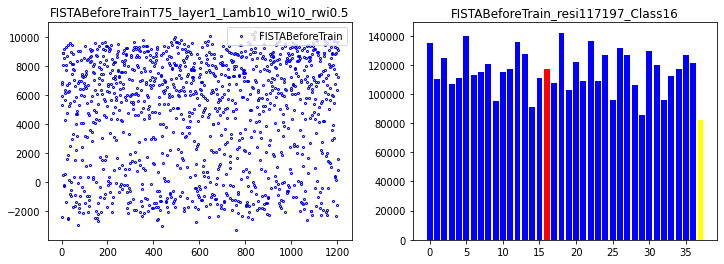

correct rate: 0.5625
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.625
Epoch [ 10/100]: loss = 1562616347.7094,   lambda [max:10.0633], [min:9.9695], 
Epoch [ 20/100]: loss = 762146461.6658,   lambda [max:10.1034], [min:9.9705], 
Epoch [ 30/100]: loss = 577835756.0355,   lambda [max:10.1357], [min:9.9691], 
Epoch [ 40/100]: loss = 644451024.3251,   lambda [max:10.1638], [min:9.9674], 
Epoch [ 50/100]: loss = 542847319.7883,   lambda [max:10.1893], [min:9.9672], 
Epoch [ 60/100]: loss = 546906374.8188,   lambda [max:10.2128], [min:9.9666], 
Epoch [ 70/100]: loss = 461274874.8488,   lambda [max:10.2347], [min:9.9669], 
Epoch [ 80/100]: loss = 489343040.5974,   lambda [max:10.2554], [min:9.9664], 
Epoch [ 90/100]: loss = 432484844.3306,   lambda [max:10.2749], [min:9.9666], 
correct rate: 0.03125
correct rate: 0.125
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 421745714.4824,   lambda [max:10.2935], [min:9.9663], 


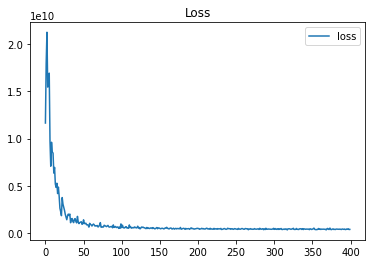

done 1 layers in 76.36ms
predict class: yaleB11
test image label: yaleB18
predict residuals label: 10
test residuals label: 16
[5054.87465408]


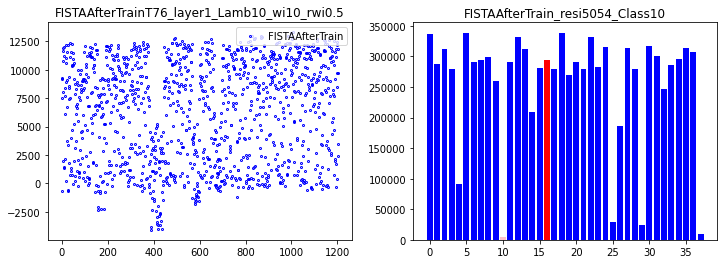

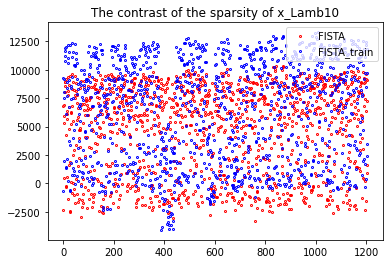

26
done 1 layers in 76.64ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[207823.02013693]


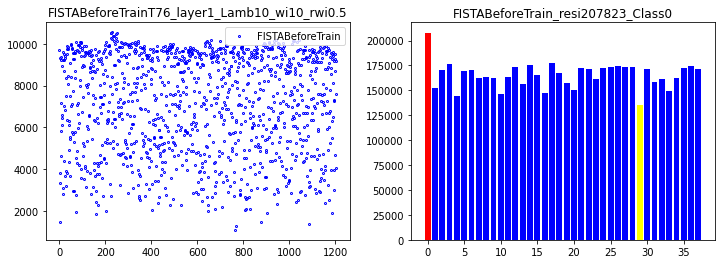

correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.5
Epoch [ 10/100]: loss = 1656358451.0306,   lambda [max:10.0635], [min:9.9710], 
Epoch [ 20/100]: loss = 770841395.4990,   lambda [max:10.1037], [min:9.9710], 
Epoch [ 30/100]: loss = 601094215.7244,   lambda [max:10.1358], [min:9.9710], 
Epoch [ 40/100]: loss = 473223484.8004,   lambda [max:10.1640], [min:9.9716], 
Epoch [ 50/100]: loss = 481943490.4353,   lambda [max:10.1894], [min:9.9719], 
Epoch [ 60/100]: loss = 482504304.1005,   lambda [max:10.2128], [min:9.9725], 
Epoch [ 70/100]: loss = 458571760.2880,   lambda [max:10.2347], [min:9.9722], 
Epoch [ 80/100]: loss = 427124821.9992,   lambda [max:10.2553], [min:9.9720], 
Epoch [ 90/100]: loss = 375950647.9889,   lambda [max:10.2748], [min:9.9718], 
correct rate: 0.125
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.0625
Epoch [100/100]: loss = 412608450.9699,   lambda [max:10.2934], [min:9.9718], 


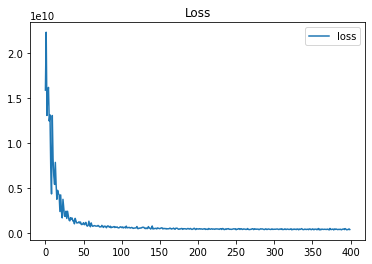

done 1 layers in 77.08ms
predict class: yaleB11
test image label: yaleB01
predict residuals label: 10
test residuals label: 0
[5709.53317105]


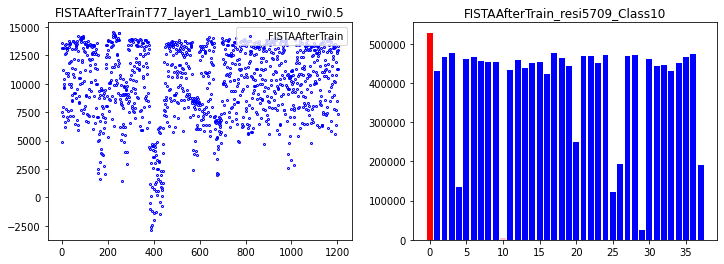

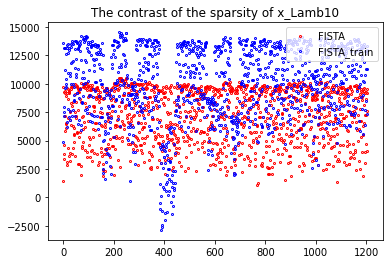

27
done 1 layers in 79.75ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[144025.54102348]


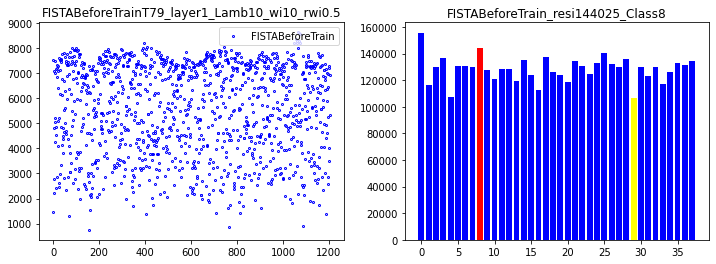

correct rate: 0.53125
correct rate: 0.75
correct rate: 0.71875
correct rate: 0.5
Epoch [ 10/100]: loss = 1380983633.1802,   lambda [max:10.0628], [min:9.9685], 
Epoch [ 20/100]: loss = 717024175.9840,   lambda [max:10.1028], [min:9.9701], 
Epoch [ 30/100]: loss = 683988931.2564,   lambda [max:10.1347], [min:9.9702], 
Epoch [ 40/100]: loss = 491839247.8096,   lambda [max:10.1626], [min:9.9709], 
Epoch [ 50/100]: loss = 506065495.1990,   lambda [max:10.1879], [min:9.9700], 
Epoch [ 60/100]: loss = 552385370.1542,   lambda [max:10.2111], [min:9.9699], 
Epoch [ 70/100]: loss = 467984278.9639,   lambda [max:10.2328], [min:9.9697], 
Epoch [ 80/100]: loss = 463515095.7247,   lambda [max:10.2532], [min:9.9690], 
Epoch [ 90/100]: loss = 514929638.4295,   lambda [max:10.2725], [min:9.9693], 
correct rate: 0.0
correct rate: 0.03125
correct rate: 0.0
correct rate: 0.09375
Epoch [100/100]: loss = 458328994.0327,   lambda [max:10.2909], [min:9.9687], 


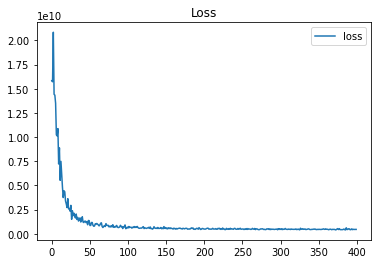

done 1 layers in 72.54ms
predict class: yaleB31
test image label: yaleB09
predict residuals label: 29
test residuals label: 8
[5610.05556078]


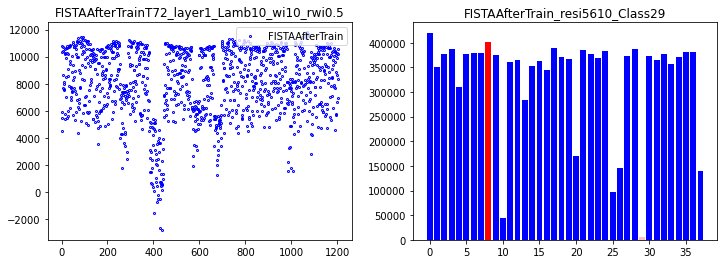

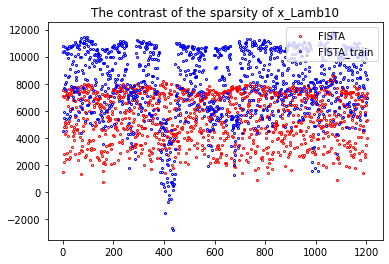

28
done 1 layers in 78.35ms
predict class: yaleB30
test image label: yaleB11
predict residuals label: 28
test residuals label: 10
[140785.74771459]


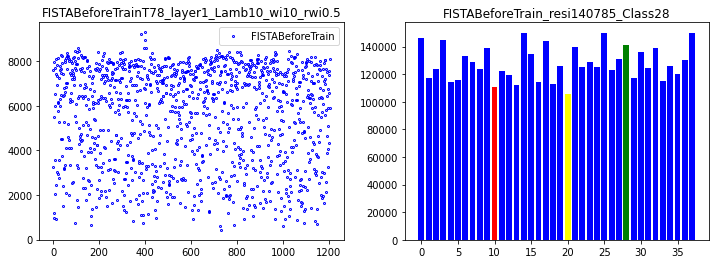

correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.4375
Epoch [ 10/100]: loss = 1501614356.5270,   lambda [max:10.0630], [min:9.9701], 
Epoch [ 20/100]: loss = 661684891.8726,   lambda [max:10.1031], [min:9.9715], 
Epoch [ 30/100]: loss = 630253513.4289,   lambda [max:10.1353], [min:9.9721], 
Epoch [ 40/100]: loss = 513224236.9973,   lambda [max:10.1634], [min:9.9713], 
Epoch [ 50/100]: loss = 524290667.4056,   lambda [max:10.1888], [min:9.9708], 
Epoch [ 60/100]: loss = 462765252.3200,   lambda [max:10.2121], [min:9.9700], 
Epoch [ 70/100]: loss = 463418638.7907,   lambda [max:10.2339], [min:9.9685], 
Epoch [ 80/100]: loss = 548194975.8323,   lambda [max:10.2543], [min:9.9691], 
Epoch [ 90/100]: loss = 462157704.9742,   lambda [max:10.2737], [min:9.9685], 
correct rate: 0.0
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.03125
Epoch [100/100]: loss = 436429084.8554,   lambda [max:10.2921], [min:9.9677], 


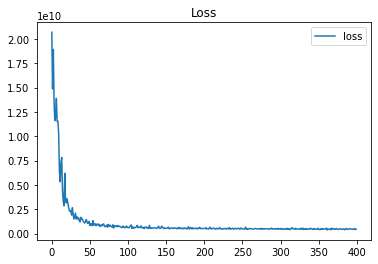

done 1 layers in 72.75ms
predict class: yaleB31
test image label: yaleB11
predict residuals label: 29
test residuals label: 10
[8287.1053166]


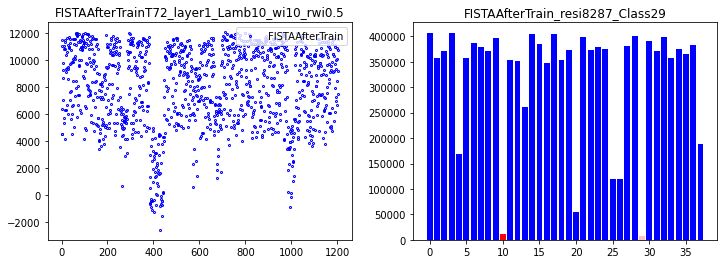

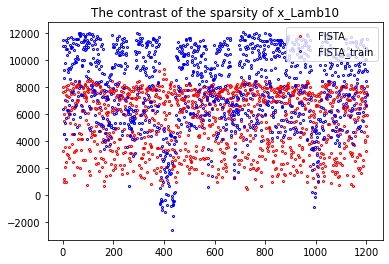

29
done 1 layers in 76.18ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[56893.779385]


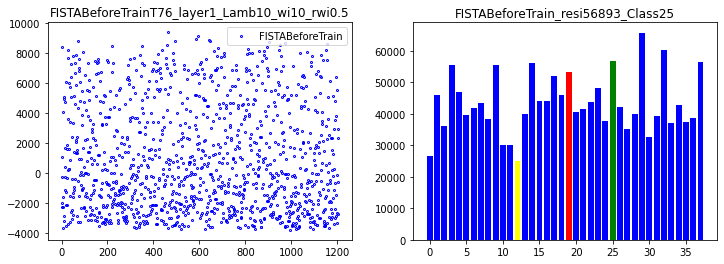

correct rate: 0.78125
correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.46875
Epoch [ 10/100]: loss = 1499408620.4604,   lambda [max:10.0630], [min:9.9749], 
Epoch [ 20/100]: loss = 728380715.1887,   lambda [max:10.1030], [min:9.9799], 
Epoch [ 30/100]: loss = 598197262.8769,   lambda [max:10.1351], [min:9.9829], 
Epoch [ 40/100]: loss = 551750697.8868,   lambda [max:10.1631], [min:9.9820], 
Epoch [ 50/100]: loss = 474363449.1360,   lambda [max:10.1884], [min:9.9821], 
Epoch [ 60/100]: loss = 506904816.4508,   lambda [max:10.2118], [min:9.9809], 
Epoch [ 70/100]: loss = 498879960.1573,   lambda [max:10.2335], [min:9.9796], 
Epoch [ 80/100]: loss = 478346379.5206,   lambda [max:10.2539], [min:9.9794], 
Epoch [ 90/100]: loss = 430179647.1320,   lambda [max:10.2732], [min:9.9797], 
correct rate: 0.0625
correct rate: 0.0
correct rate: 0.03125
correct rate: 0.0625
Epoch [100/100]: loss = 509455810.2562,   lambda [max:10.2916], [min:9.9813], 


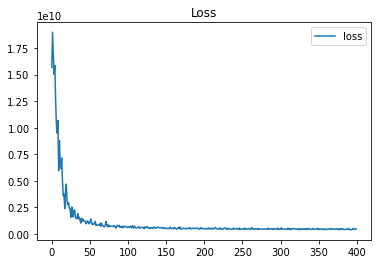

done 1 layers in 78.69ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[73831.65921619]


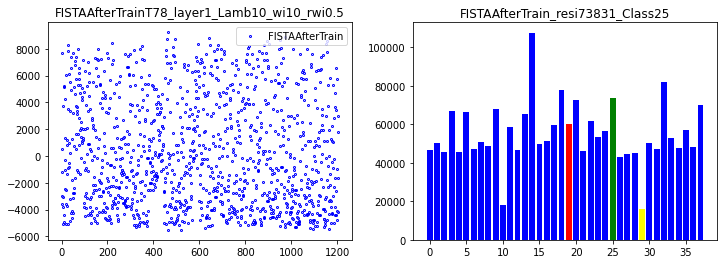

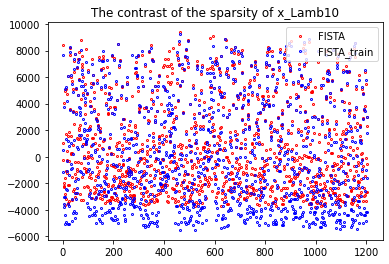

30
done 10 layers in 94.41ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[13940.52443046]


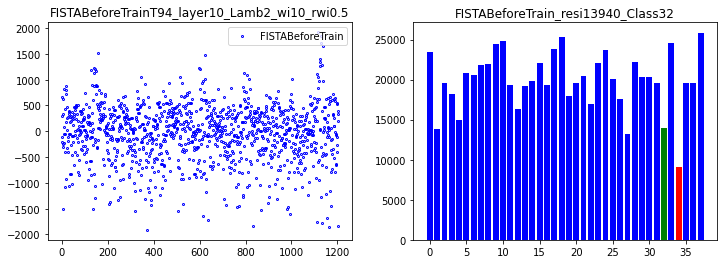

correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.53125
correct rate: 0.71875
Epoch [ 10/100]: loss = 47601373.5179,   lambda [max:2.0514], [min:1.9643], 
Epoch [ 20/100]: loss = 25331926.9770,   lambda [max:2.0638], [min:1.9461], 
Epoch [ 30/100]: loss = 18562278.0912,   lambda [max:2.0675], [min:1.9352], 
Epoch [ 40/100]: loss = 15257822.1455,   lambda [max:2.0706], [min:1.9276], 
Epoch [ 50/100]: loss = 13995030.7172,   lambda [max:2.0733], [min:1.9224], 
Epoch [ 60/100]: loss = 11442292.3728,   lambda [max:2.0780], [min:1.9184], 
Epoch [ 70/100]: loss = 9857505.5964,   lambda [max:2.0855], [min:1.9148], 
Epoch [ 80/100]: loss = 8237965.7447,   lambda [max:2.0950], [min:1.9114], 
Epoch [ 90/100]: loss = 8016863.6456,   lambda [max:2.1044], [min:1.9086], 
correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.625
Epoch [100/100]: loss = 7154764.4516,   lambda [max:2.1132], [min:1.9062], 


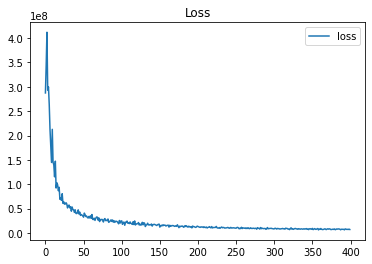

done 10 layers in 86.18ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[865.7399904]


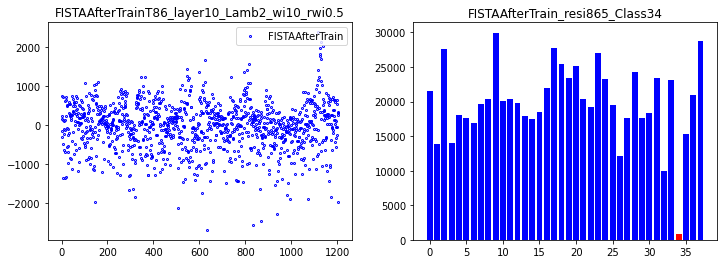

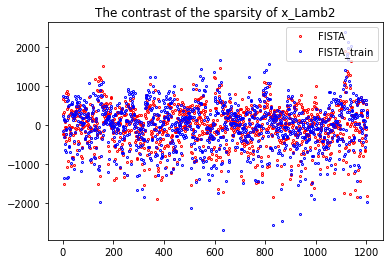

31
done 10 layers in 101.35ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[8822.25222553]


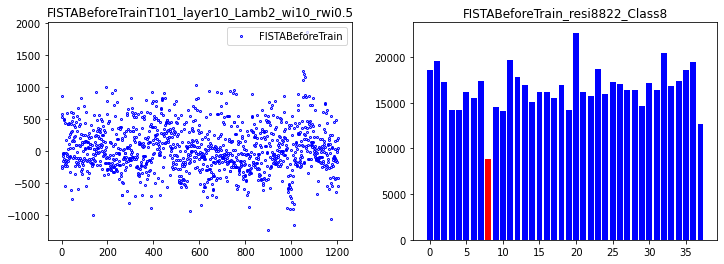

correct rate: 0.53125
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.5625
Epoch [ 10/100]: loss = 43184623.3435,   lambda [max:2.0497], [min:1.9636], 
Epoch [ 20/100]: loss = 25575901.6866,   lambda [max:2.0689], [min:1.9490], 
Epoch [ 30/100]: loss = 19208216.9313,   lambda [max:2.0733], [min:1.9367], 
Epoch [ 40/100]: loss = 13759900.7226,   lambda [max:2.0760], [min:1.9276], 
Epoch [ 50/100]: loss = 13309641.1265,   lambda [max:2.0789], [min:1.9204], 
Epoch [ 60/100]: loss = 11323767.1918,   lambda [max:2.0819], [min:1.9146], 
Epoch [ 70/100]: loss = 9705798.5758,   lambda [max:2.0919], [min:1.9096], 
Epoch [ 80/100]: loss = 8176135.9848,   lambda [max:2.1018], [min:1.9054], 
Epoch [ 90/100]: loss = 8424675.1601,   lambda [max:2.1114], [min:1.9018], 
correct rate: 0.75
correct rate: 0.71875
correct rate: 0.53125
correct rate: 0.6875
Epoch [100/100]: loss = 7963280.7709,   lambda [max:2.1214], [min:1.8989], 


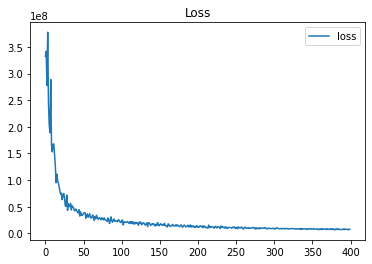

done 10 layers in 87.93ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1379.35245559]


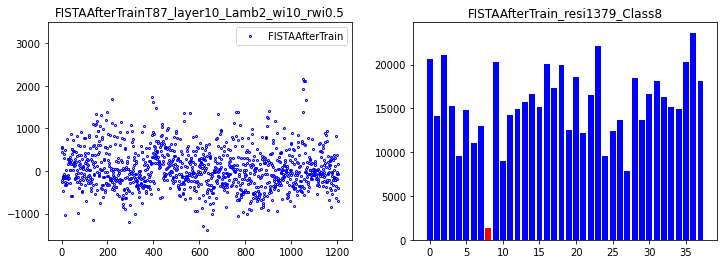

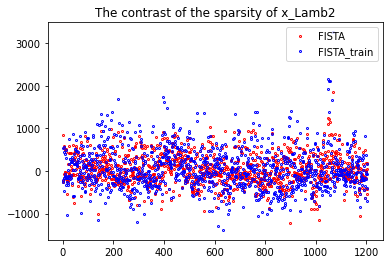

32
done 10 layers in 93.09ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6060.17098924]


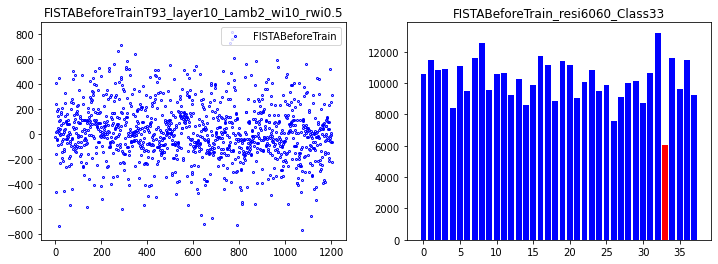

correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.65625
Epoch [ 10/100]: loss = 44487284.7644,   lambda [max:2.0495], [min:1.9642], 
Epoch [ 20/100]: loss = 22281741.2651,   lambda [max:2.0606], [min:1.9484], 
Epoch [ 30/100]: loss = 16830166.8370,   lambda [max:2.0640], [min:1.9332], 
Epoch [ 40/100]: loss = 14674043.5521,   lambda [max:2.0666], [min:1.9218], 
Epoch [ 50/100]: loss = 10820118.0000,   lambda [max:2.0765], [min:1.9132], 
Epoch [ 60/100]: loss = 10560548.7654,   lambda [max:2.0860], [min:1.9061], 
Epoch [ 70/100]: loss = 9407930.0071,   lambda [max:2.0958], [min:1.9001], 
Epoch [ 80/100]: loss = 9521230.0746,   lambda [max:2.1051], [min:1.8952], 
Epoch [ 90/100]: loss = 7321810.2242,   lambda [max:2.1144], [min:1.8911], 
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.75
Epoch [100/100]: loss = 6790593.3788,   lambda [max:2.1239], [min:1.8875], 


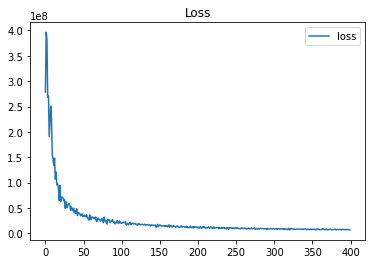

done 10 layers in 86.06ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[1160.00170501]


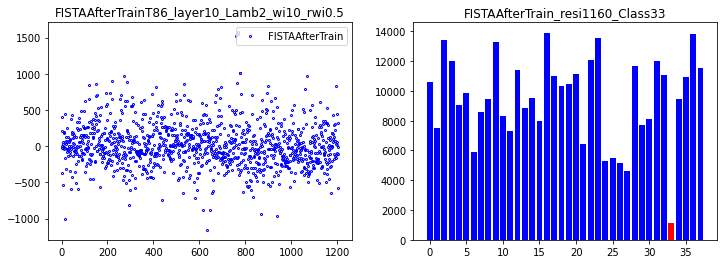

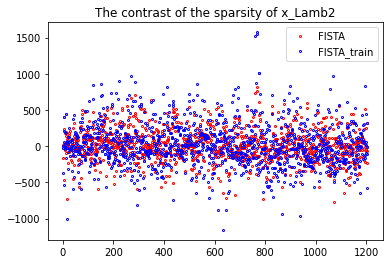

33
done 10 layers in 87.50ms
predict class: yaleB31
test image label: yaleB19
predict residuals label: 29
test residuals label: 17
[7793.78350232]


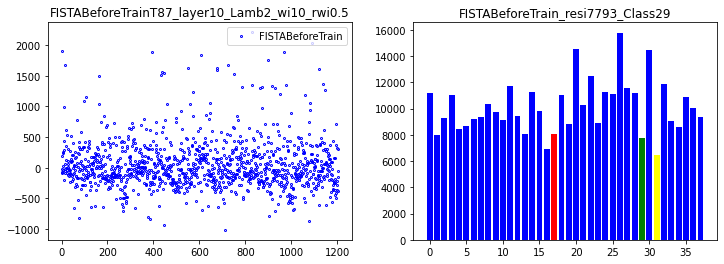

correct rate: 0.625
correct rate: 0.5625
correct rate: 0.625
correct rate: 0.65625
Epoch [ 10/100]: loss = 44544314.3891,   lambda [max:2.0505], [min:1.9669], 
Epoch [ 20/100]: loss = 32534309.4502,   lambda [max:2.0622], [min:1.9519], 
Epoch [ 30/100]: loss = 24088592.6646,   lambda [max:2.0711], [min:1.9352], 
Epoch [ 40/100]: loss = 13589165.0257,   lambda [max:2.0805], [min:1.9228], 
Epoch [ 50/100]: loss = 12809348.9900,   lambda [max:2.0882], [min:1.9130], 
Epoch [ 60/100]: loss = 10440921.5036,   lambda [max:2.0948], [min:1.9049], 
Epoch [ 70/100]: loss = 10107694.6188,   lambda [max:2.1005], [min:1.8982], 
Epoch [ 80/100]: loss = 9412213.6597,   lambda [max:2.1054], [min:1.8925], 
Epoch [ 90/100]: loss = 7902287.1094,   lambda [max:2.1103], [min:1.8874], 
correct rate: 0.6875
correct rate: 0.78125
correct rate: 0.59375
correct rate: 0.59375
Epoch [100/100]: loss = 7623492.5430,   lambda [max:2.1204], [min:1.8829], 


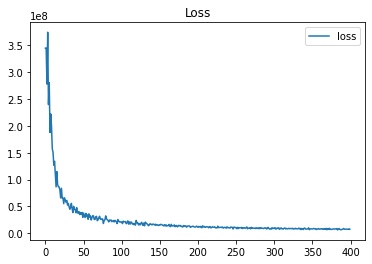

done 10 layers in 85.67ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[2296.27248291]


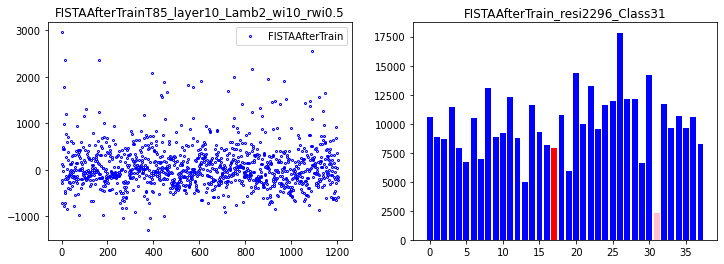

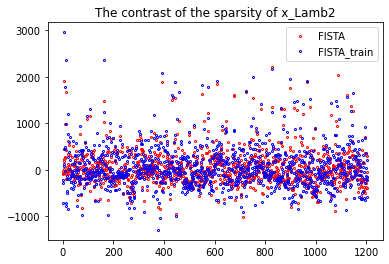

34
done 10 layers in 97.48ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[7972.95029419]


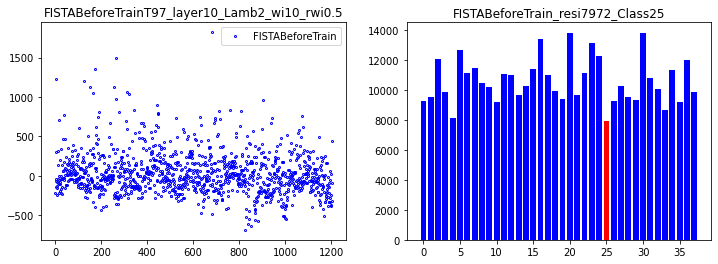

correct rate: 0.625
correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.65625
Epoch [ 10/100]: loss = 41380854.2838,   lambda [max:2.0495], [min:1.9637], 
Epoch [ 20/100]: loss = 23270266.9383,   lambda [max:2.0605], [min:1.9507], 
Epoch [ 30/100]: loss = 21939370.4092,   lambda [max:2.0645], [min:1.9379], 
Epoch [ 40/100]: loss = 16063878.0188,   lambda [max:2.0676], [min:1.9283], 
Epoch [ 50/100]: loss = 11504112.2376,   lambda [max:2.0733], [min:1.9213], 
Epoch [ 60/100]: loss = 11768044.5016,   lambda [max:2.0832], [min:1.9161], 
Epoch [ 70/100]: loss = 10103365.3936,   lambda [max:2.0928], [min:1.9110], 
Epoch [ 80/100]: loss = 8032536.7402,   lambda [max:2.1023], [min:1.9063], 
Epoch [ 90/100]: loss = 8591048.2263,   lambda [max:2.1117], [min:1.9029], 
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.71875
Epoch [100/100]: loss = 8362503.8743,   lambda [max:2.1212], [min:1.8998], 


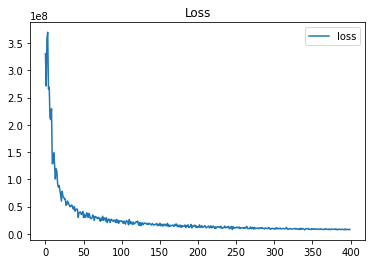

done 10 layers in 87.69ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[811.96048277]


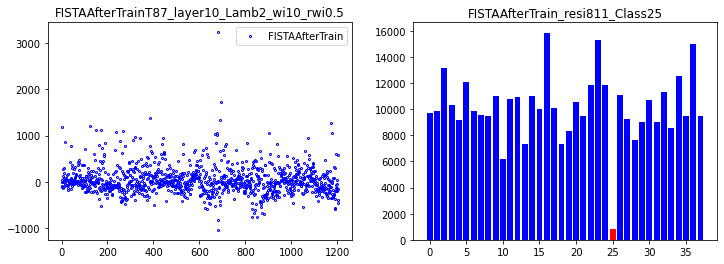

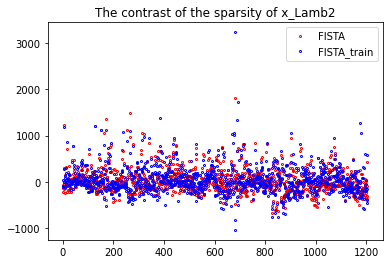

35
done 10 layers in 88.05ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[10511.60811205]


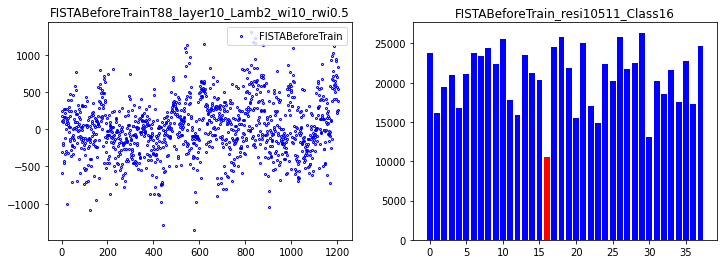

correct rate: 0.6875
correct rate: 0.46875
correct rate: 0.53125
correct rate: 0.65625
Epoch [ 10/100]: loss = 53457708.7237,   lambda [max:2.0481], [min:1.9626], 
Epoch [ 20/100]: loss = 27471760.5633,   lambda [max:2.0601], [min:1.9471], 
Epoch [ 30/100]: loss = 20284393.3316,   lambda [max:2.0654], [min:1.9333], 
Epoch [ 40/100]: loss = 13215010.0614,   lambda [max:2.0760], [min:1.9217], 
Epoch [ 50/100]: loss = 11184709.3003,   lambda [max:2.0867], [min:1.9118], 
Epoch [ 60/100]: loss = 11150517.5473,   lambda [max:2.0944], [min:1.9026], 
Epoch [ 70/100]: loss = 10804595.1099,   lambda [max:2.0999], [min:1.8954], 
Epoch [ 80/100]: loss = 8806666.6836,   lambda [max:2.1078], [min:1.8898], 
Epoch [ 90/100]: loss = 8554266.8244,   lambda [max:2.1177], [min:1.8849], 
correct rate: 0.5625
correct rate: 0.59375
correct rate: 0.5
correct rate: 0.84375
Epoch [100/100]: loss = 7389189.1816,   lambda [max:2.1275], [min:1.8814], 


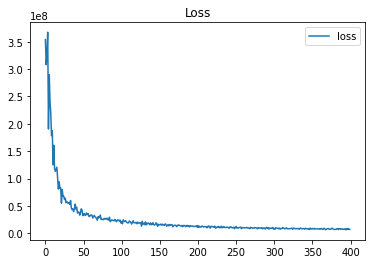

done 10 layers in 89.19ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[501.40534629]


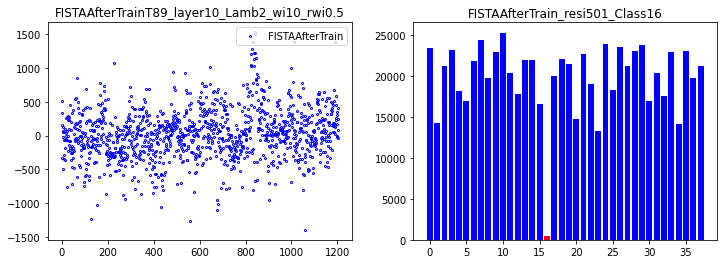

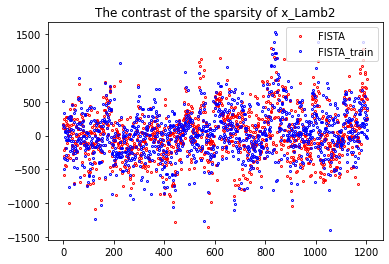

36
done 10 layers in 91.95ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[8533.40620913]


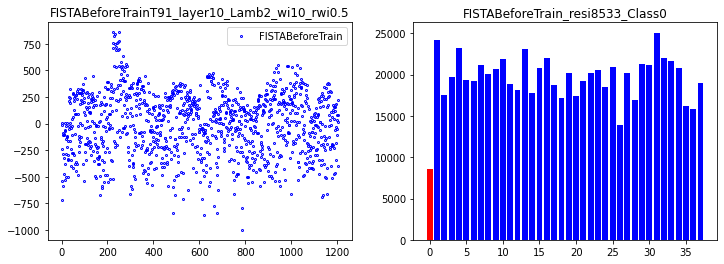

correct rate: 0.375
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.71875
Epoch [ 10/100]: loss = 46639667.6176,   lambda [max:2.0476], [min:1.9604], 
Epoch [ 20/100]: loss = 27443586.1728,   lambda [max:2.0687], [min:1.9521], 
Epoch [ 30/100]: loss = 19120154.1082,   lambda [max:2.0741], [min:1.9404], 
Epoch [ 40/100]: loss = 16087878.7715,   lambda [max:2.0772], [min:1.9303], 
Epoch [ 50/100]: loss = 12239881.0113,   lambda [max:2.0799], [min:1.9220], 
Epoch [ 60/100]: loss = 11086284.0867,   lambda [max:2.0856], [min:1.9132], 
Epoch [ 70/100]: loss = 10093317.1222,   lambda [max:2.0960], [min:1.9062], 
Epoch [ 80/100]: loss = 9314083.9363,   lambda [max:2.1058], [min:1.9009], 
Epoch [ 90/100]: loss = 7250050.8726,   lambda [max:2.1157], [min:1.8967], 
correct rate: 0.75
correct rate: 0.53125
correct rate: 0.53125
correct rate: 0.75
Epoch [100/100]: loss = 6772893.6675,   lambda [max:2.1255], [min:1.8927], 


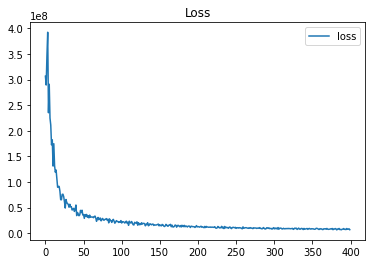

done 10 layers in 86.57ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1177.08910462]


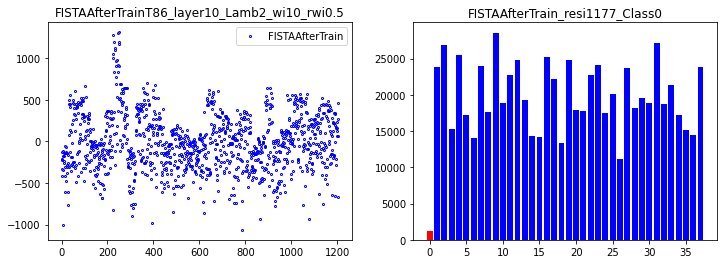

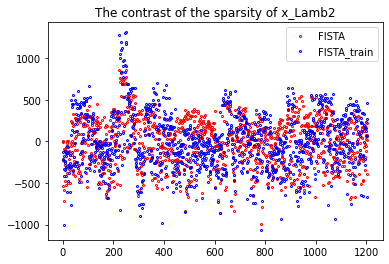

37
done 10 layers in 88.67ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2517.91581253]


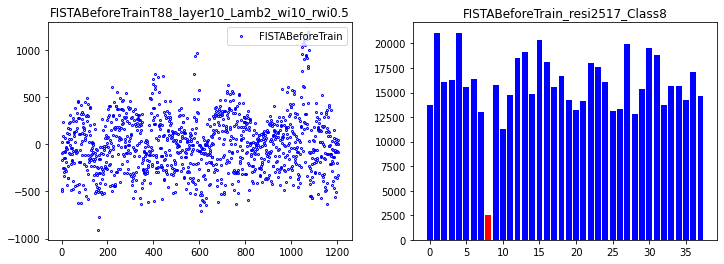

correct rate: 0.53125
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.53125
Epoch [ 10/100]: loss = 45967217.3585,   lambda [max:2.0514], [min:1.9593], 
Epoch [ 20/100]: loss = 26603248.9984,   lambda [max:2.0660], [min:1.9456], 
Epoch [ 30/100]: loss = 20779721.9602,   lambda [max:2.0710], [min:1.9462], 
Epoch [ 40/100]: loss = 14848965.5100,   lambda [max:2.0738], [min:1.9359], 
Epoch [ 50/100]: loss = 11752019.4696,   lambda [max:2.0760], [min:1.9252], 
Epoch [ 60/100]: loss = 9078339.3778,   lambda [max:2.0798], [min:1.9161], 
Epoch [ 70/100]: loss = 9221468.9550,   lambda [max:2.0848], [min:1.9081], 
Epoch [ 80/100]: loss = 8457632.1366,   lambda [max:2.0902], [min:1.9018], 
Epoch [ 90/100]: loss = 7558955.1834,   lambda [max:2.0961], [min:1.8965], 
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.75
Epoch [100/100]: loss = 7491873.5415,   lambda [max:2.1028], [min:1.8922], 


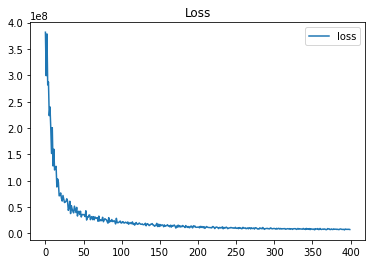

done 10 layers in 89.85ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1724.59095882]


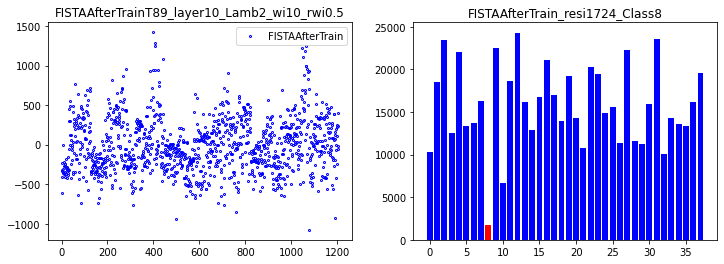

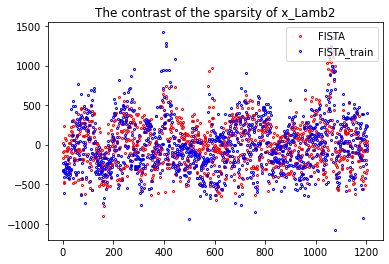

38
done 10 layers in 89.66ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[9766.92064843]


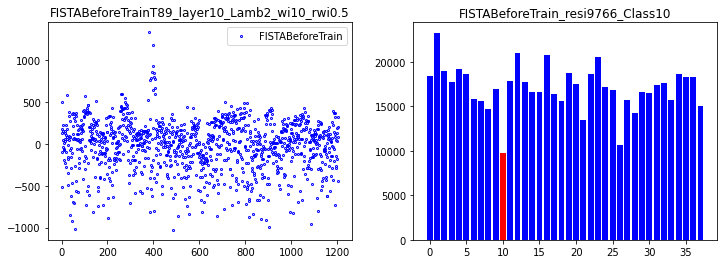

correct rate: 0.59375
correct rate: 0.53125
correct rate: 0.75
correct rate: 0.6875
Epoch [ 10/100]: loss = 40266474.4337,   lambda [max:2.0484], [min:1.9666], 
Epoch [ 20/100]: loss = 24312072.5300,   lambda [max:2.0639], [min:1.9477], 
Epoch [ 30/100]: loss = 18035866.4672,   lambda [max:2.0712], [min:1.9324], 
Epoch [ 40/100]: loss = 16268146.3631,   lambda [max:2.0803], [min:1.9202], 
Epoch [ 50/100]: loss = 12401223.8637,   lambda [max:2.0881], [min:1.9108], 
Epoch [ 60/100]: loss = 10941503.0709,   lambda [max:2.0945], [min:1.9032], 
Epoch [ 70/100]: loss = 9553957.0095,   lambda [max:2.0999], [min:1.8964], 
Epoch [ 80/100]: loss = 8741478.0614,   lambda [max:2.1046], [min:1.8909], 
Epoch [ 90/100]: loss = 8514268.1192,   lambda [max:2.1087], [min:1.8865], 
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.75
correct rate: 0.5625
Epoch [100/100]: loss = 7380332.9518,   lambda [max:2.1169], [min:1.8822], 


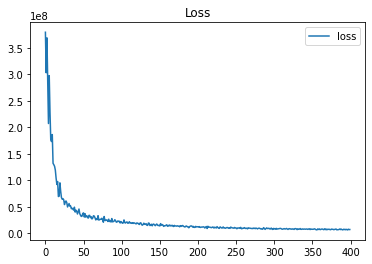

done 10 layers in 85.70ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1479.74761867]


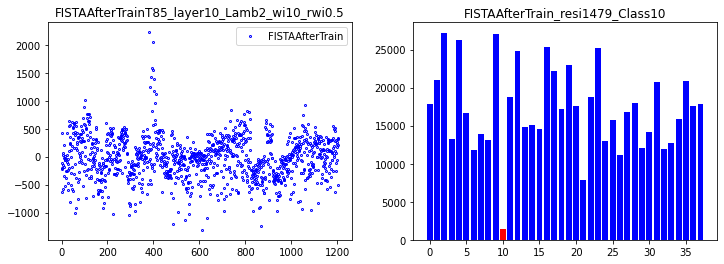

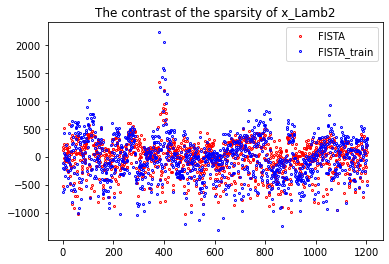

39
done 10 layers in 90.31ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[9010.09097018]


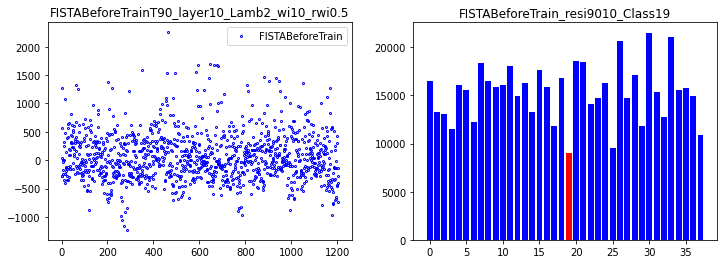

correct rate: 0.625
correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.65625
Epoch [ 10/100]: loss = 49063658.1934,   lambda [max:2.0508], [min:1.9568], 
Epoch [ 20/100]: loss = 27305146.9351,   lambda [max:2.0668], [min:1.9340], 
Epoch [ 30/100]: loss = 21285688.2338,   lambda [max:2.0713], [min:1.9219], 
Epoch [ 40/100]: loss = 13280327.8748,   lambda [max:2.0739], [min:1.9130], 
Epoch [ 50/100]: loss = 11289712.2880,   lambda [max:2.0811], [min:1.9064], 
Epoch [ 60/100]: loss = 10641983.2375,   lambda [max:2.0920], [min:1.9005], 
Epoch [ 70/100]: loss = 9239368.9504,   lambda [max:2.1026], [min:1.8962], 
Epoch [ 80/100]: loss = 8023739.1378,   lambda [max:2.1134], [min:1.8927], 
Epoch [ 90/100]: loss = 7511731.7120,   lambda [max:2.1239], [min:1.8894], 
correct rate: 0.78125
correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.65625
Epoch [100/100]: loss = 6959114.8515,   lambda [max:2.1344], [min:1.8868], 


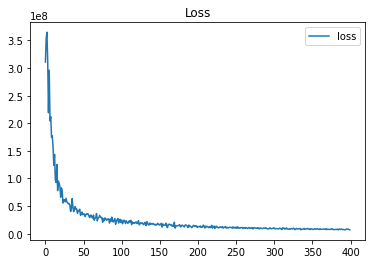

done 10 layers in 88.92ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[2926.42480845]


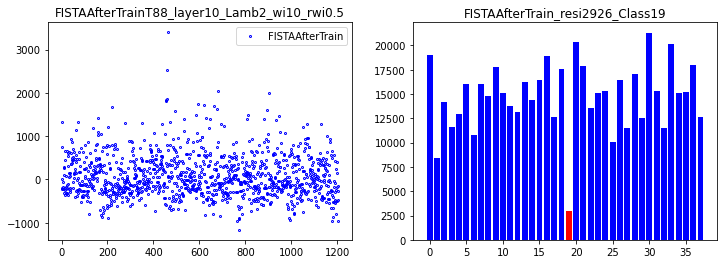

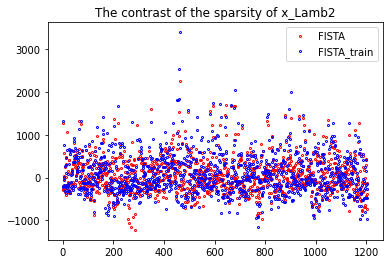

40
done 5 layers in 88.07ms
predict class: yaleB05
test image label: yaleB36
predict residuals label: 4
test residuals label: 34
[16737.76588462]


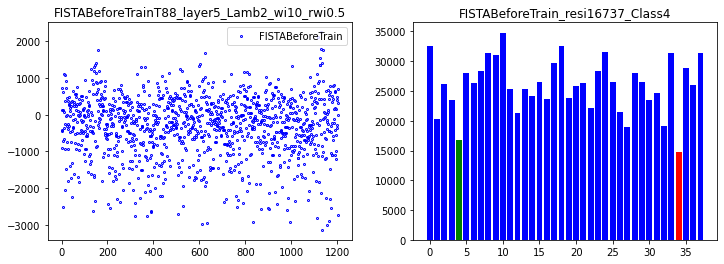

correct rate: 0.34375
correct rate: 0.3125
correct rate: 0.65625
correct rate: 0.375
Epoch [ 10/100]: loss = 49123156.2077,   lambda [max:2.0435], [min:1.9754], 
Epoch [ 20/100]: loss = 34025887.4901,   lambda [max:2.0515], [min:1.9656], 
Epoch [ 30/100]: loss = 26878840.5246,   lambda [max:2.0617], [min:1.9522], 
Epoch [ 40/100]: loss = 24069496.2847,   lambda [max:2.0794], [min:1.9437], 
Epoch [ 50/100]: loss = 18459801.3747,   lambda [max:2.0986], [min:1.9362], 
Epoch [ 60/100]: loss = 17290269.2866,   lambda [max:2.1164], [min:1.9314], 
Epoch [ 70/100]: loss = 16006067.5442,   lambda [max:2.1337], [min:1.9271], 
Epoch [ 80/100]: loss = 15431785.4263,   lambda [max:2.1500], [min:1.9241], 
Epoch [ 90/100]: loss = 13919195.2610,   lambda [max:2.1666], [min:1.9207], 
correct rate: 0.34375
correct rate: 0.25
correct rate: 0.28125
correct rate: 0.34375
Epoch [100/100]: loss = 12260890.0532,   lambda [max:2.1822], [min:1.9190], 


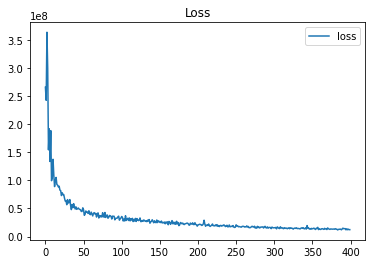

done 5 layers in 81.68ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[1145.4015795]


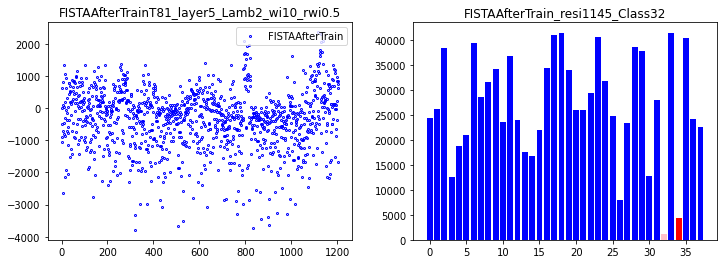

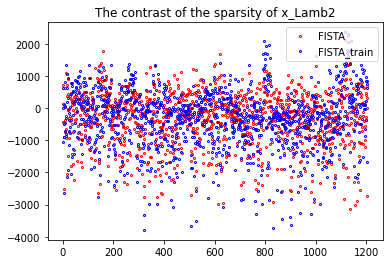

41
done 5 layers in 81.12ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[4445.81433131]


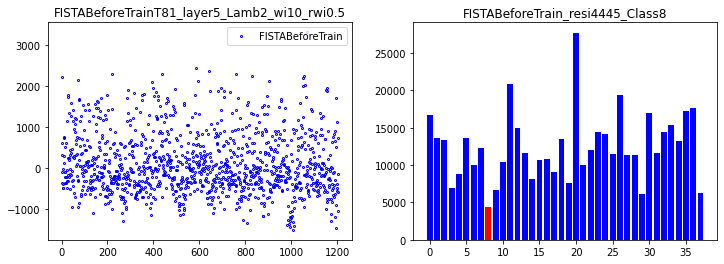

correct rate: 0.375
correct rate: 0.4375
correct rate: 0.46875
correct rate: 0.40625
Epoch [ 10/100]: loss = 62307767.9529,   lambda [max:2.0450], [min:1.9606], 
Epoch [ 20/100]: loss = 40953974.1410,   lambda [max:2.0595], [min:1.9631], 
Epoch [ 30/100]: loss = 28487062.2247,   lambda [max:2.0771], [min:1.9644], 
Epoch [ 40/100]: loss = 25443810.4314,   lambda [max:2.1000], [min:1.9560], 
Epoch [ 50/100]: loss = 21394606.2998,   lambda [max:2.1206], [min:1.9501], 
Epoch [ 60/100]: loss = 18074565.9182,   lambda [max:2.1404], [min:1.9457], 
Epoch [ 70/100]: loss = 16531402.1356,   lambda [max:2.1592], [min:1.9417], 
Epoch [ 80/100]: loss = 15631095.7122,   lambda [max:2.1775], [min:1.9386], 
Epoch [ 90/100]: loss = 13683247.6233,   lambda [max:2.1949], [min:1.9369], 
correct rate: 0.1875
correct rate: 0.125
correct rate: 0.34375
correct rate: 0.25
Epoch [100/100]: loss = 13470702.8344,   lambda [max:2.2115], [min:1.9350], 


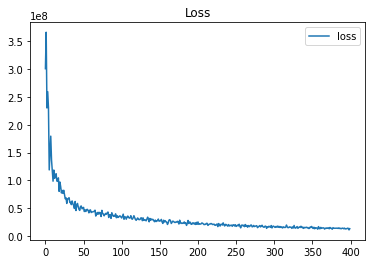

done 5 layers in 78.49ms
predict class: yaleB39
test image label: yaleB09
predict residuals label: 37
test residuals label: 8
[4441.90838245]


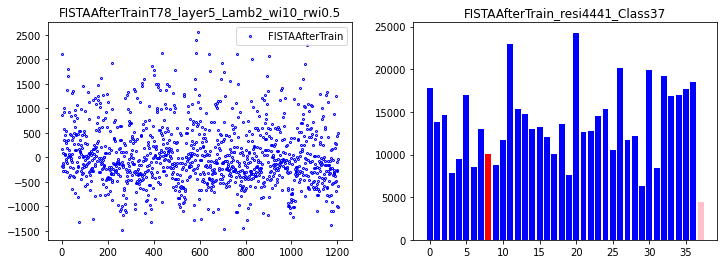

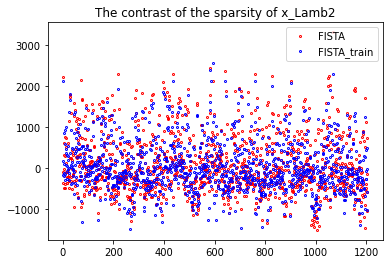

42
done 5 layers in 81.98ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4656.20968395]


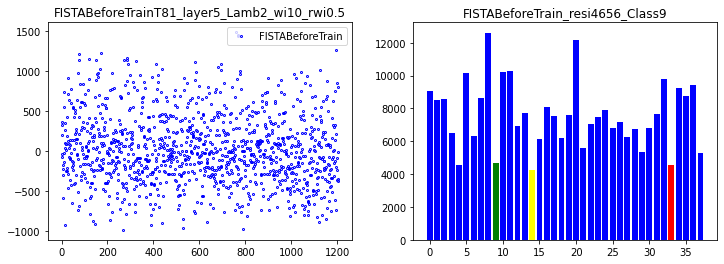

correct rate: 0.46875
correct rate: 0.25
correct rate: 0.59375
correct rate: 0.40625
Epoch [ 10/100]: loss = 56816389.7417,   lambda [max:2.0424], [min:1.9617], 
Epoch [ 20/100]: loss = 38588821.3706,   lambda [max:2.0594], [min:1.9590], 
Epoch [ 30/100]: loss = 29736484.8126,   lambda [max:2.0669], [min:1.9535], 
Epoch [ 40/100]: loss = 23926166.5138,   lambda [max:2.0894], [min:1.9482], 
Epoch [ 50/100]: loss = 21371423.8047,   lambda [max:2.1102], [min:1.9490], 
Epoch [ 60/100]: loss = 20744954.4868,   lambda [max:2.1306], [min:1.9477], 
Epoch [ 70/100]: loss = 18307224.4928,   lambda [max:2.1498], [min:1.9480], 
Epoch [ 80/100]: loss = 15073845.9543,   lambda [max:2.1685], [min:1.9486], 
Epoch [ 90/100]: loss = 13271572.9749,   lambda [max:2.1862], [min:1.9499], 
correct rate: 0.1875
correct rate: 0.34375
correct rate: 0.3125
correct rate: 0.3125
Epoch [100/100]: loss = 12094319.9217,   lambda [max:2.2036], [min:1.9505], 


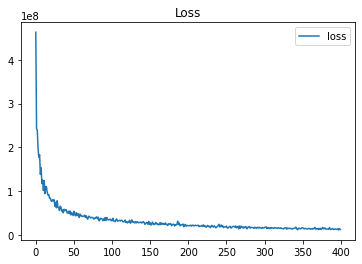

done 5 layers in 80.34ms
predict class: yaleB39
test image label: yaleB35
predict residuals label: 37
test residuals label: 33
[4122.7003745]


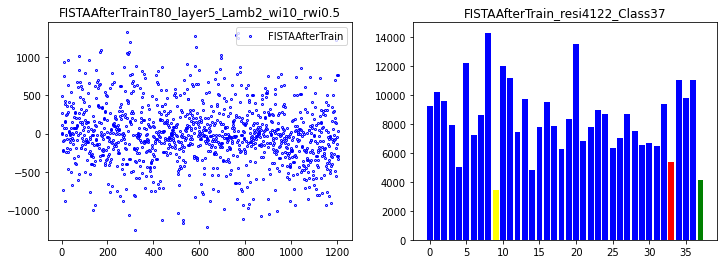

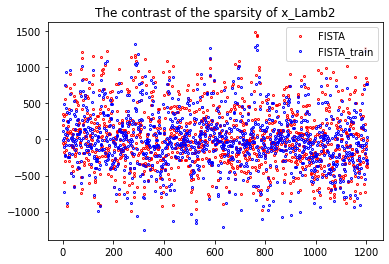

43
done 5 layers in 84.88ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[4966.87152919]


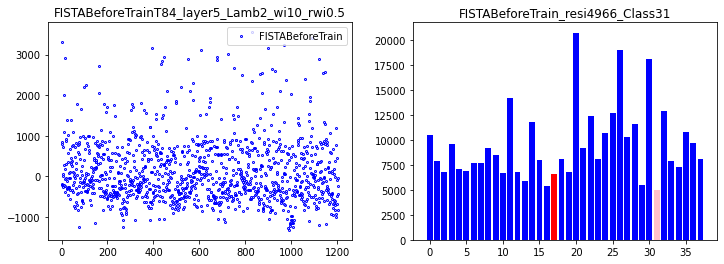

correct rate: 0.4375
correct rate: 0.40625
correct rate: 0.5
correct rate: 0.40625
Epoch [ 10/100]: loss = 50427416.6873,   lambda [max:2.0389], [min:1.9646], 
Epoch [ 20/100]: loss = 35741862.7963,   lambda [max:2.0481], [min:1.9545], 
Epoch [ 30/100]: loss = 28251429.3604,   lambda [max:2.0584], [min:1.9472], 
Epoch [ 40/100]: loss = 23512818.1240,   lambda [max:2.0754], [min:1.9419], 
Epoch [ 50/100]: loss = 19597926.1006,   lambda [max:2.0953], [min:1.9372], 
Epoch [ 60/100]: loss = 17852676.5716,   lambda [max:2.1144], [min:1.9340], 
Epoch [ 70/100]: loss = 15966046.3900,   lambda [max:2.1328], [min:1.9318], 
Epoch [ 80/100]: loss = 13974084.3783,   lambda [max:2.1504], [min:1.9305], 
Epoch [ 90/100]: loss = 11428089.8825,   lambda [max:2.1675], [min:1.9304], 
correct rate: 0.25
correct rate: 0.21875
correct rate: 0.375
correct rate: 0.3125
Epoch [100/100]: loss = 11753732.4423,   lambda [max:2.1841], [min:1.9293], 


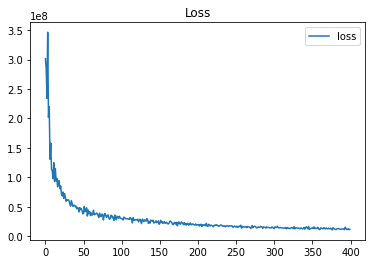

done 5 layers in 82.79ms
predict class: yaleB02
test image label: yaleB19
predict residuals label: 1
test residuals label: 17
[4075.15240396]


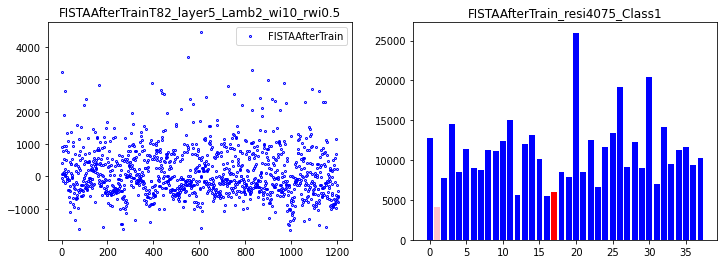

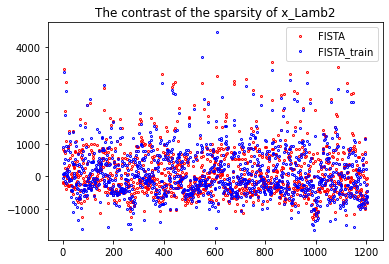

44
done 5 layers in 79.01ms
predict class: yaleB11
test image label: yaleB27
predict residuals label: 10
test residuals label: 25
[5465.60149539]


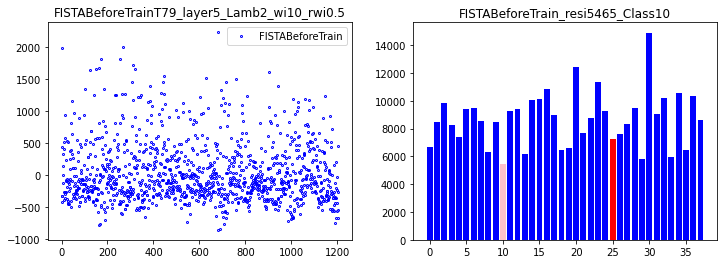

correct rate: 0.625
correct rate: 0.375
correct rate: 0.375
correct rate: 0.34375
Epoch [ 10/100]: loss = 53820950.9155,   lambda [max:2.0398], [min:1.9654], 
Epoch [ 20/100]: loss = 36372505.6627,   lambda [max:2.0637], [min:1.9670], 
Epoch [ 30/100]: loss = 36953564.9634,   lambda [max:2.0913], [min:1.9681], 
Epoch [ 40/100]: loss = 21600249.1627,   lambda [max:2.1177], [min:1.9638], 
Epoch [ 50/100]: loss = 26276632.5440,   lambda [max:2.1412], [min:1.9596], 
Epoch [ 60/100]: loss = 18727122.6788,   lambda [max:2.1631], [min:1.9581], 
Epoch [ 70/100]: loss = 16930935.4944,   lambda [max:2.1839], [min:1.9570], 
Epoch [ 80/100]: loss = 14357438.5524,   lambda [max:2.2040], [min:1.9575], 
Epoch [ 90/100]: loss = 14104635.9555,   lambda [max:2.2232], [min:1.9564], 
correct rate: 0.125
correct rate: 0.125
correct rate: 0.46875
correct rate: 0.28125
Epoch [100/100]: loss = 13311594.5450,   lambda [max:2.2414], [min:1.9566], 


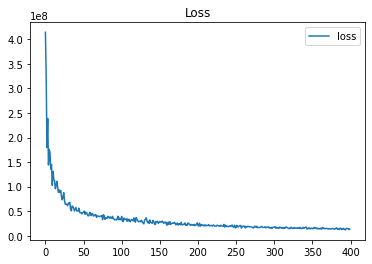

done 5 layers in 81.86ms
predict class: yaleB09
test image label: yaleB27
predict residuals label: 8
test residuals label: 25
[3151.67640127]


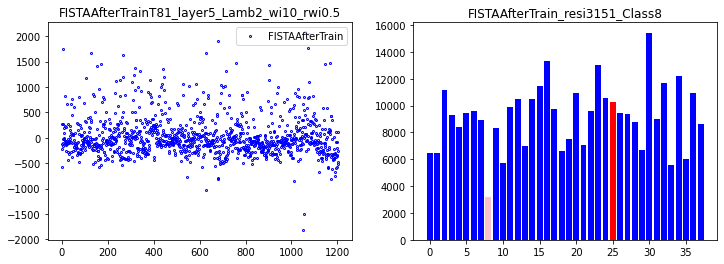

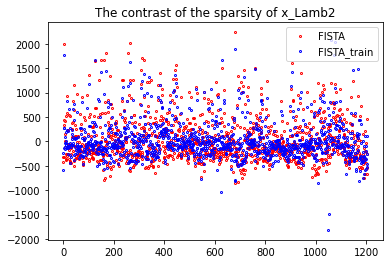

45
done 5 layers in 80.97ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[7226.74164134]


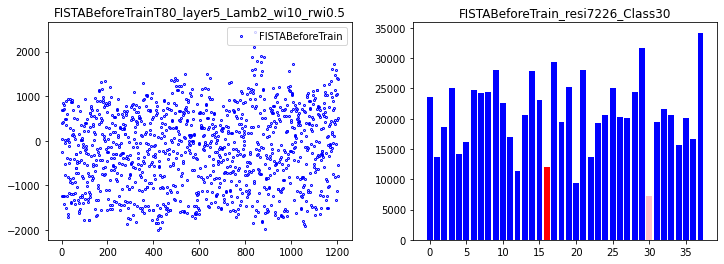

correct rate: 0.40625
correct rate: 0.5
correct rate: 0.4375
correct rate: 0.34375
Epoch [ 10/100]: loss = 54179901.1464,   lambda [max:2.0488], [min:1.9770], 
Epoch [ 20/100]: loss = 38592843.7704,   lambda [max:2.0703], [min:1.9734], 
Epoch [ 30/100]: loss = 29744855.1336,   lambda [max:2.0781], [min:1.9643], 
Epoch [ 40/100]: loss = 26198200.7888,   lambda [max:2.0833], [min:1.9546], 
Epoch [ 50/100]: loss = 21419644.6211,   lambda [max:2.0973], [min:1.9513], 
Epoch [ 60/100]: loss = 20119769.3294,   lambda [max:2.1149], [min:1.9458], 
Epoch [ 70/100]: loss = 17555854.0086,   lambda [max:2.1320], [min:1.9429], 
Epoch [ 80/100]: loss = 15970137.8670,   lambda [max:2.1477], [min:1.9401], 
Epoch [ 90/100]: loss = 14265091.2220,   lambda [max:2.1638], [min:1.9388], 
correct rate: 0.1875
correct rate: 0.28125
correct rate: 0.21875
correct rate: 0.375
Epoch [100/100]: loss = 14888784.6126,   lambda [max:2.1797], [min:1.9367], 


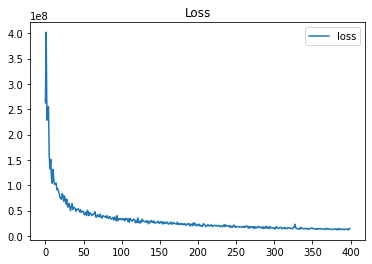

done 5 layers in 81.45ms
predict class: yaleB22
test image label: yaleB18
predict residuals label: 20
test residuals label: 16
[986.79867581]


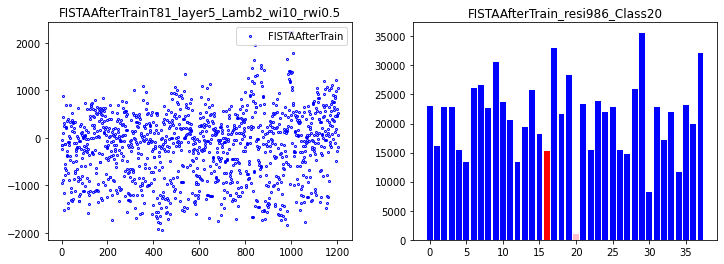

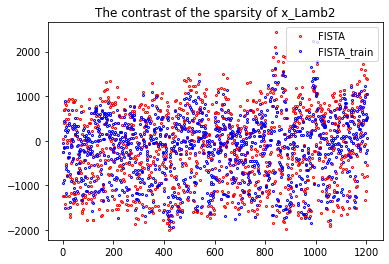

46
done 5 layers in 84.99ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[16822.41249805]


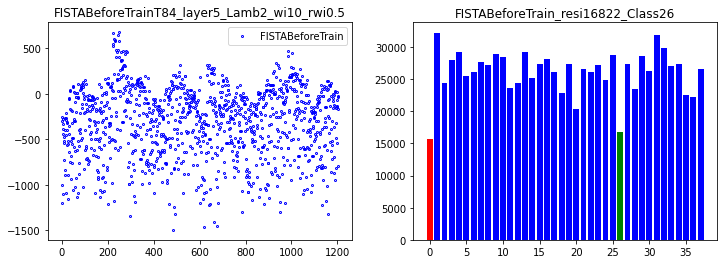

correct rate: 0.4375
correct rate: 0.5
correct rate: 0.34375
correct rate: 0.4375
Epoch [ 10/100]: loss = 61751047.0916,   lambda [max:2.0394], [min:1.9709], 
Epoch [ 20/100]: loss = 40346442.0964,   lambda [max:2.0595], [min:1.9549], 
Epoch [ 30/100]: loss = 32635135.5943,   lambda [max:2.0797], [min:1.9448], 
Epoch [ 40/100]: loss = 25384754.2664,   lambda [max:2.1029], [min:1.9375], 
Epoch [ 50/100]: loss = 22204906.2833,   lambda [max:2.1247], [min:1.9326], 
Epoch [ 60/100]: loss = 18455536.4386,   lambda [max:2.1460], [min:1.9320], 
Epoch [ 70/100]: loss = 16175757.4056,   lambda [max:2.1663], [min:1.9329], 
Epoch [ 80/100]: loss = 15816001.9985,   lambda [max:2.1858], [min:1.9341], 
Epoch [ 90/100]: loss = 14377371.6817,   lambda [max:2.2047], [min:1.9371], 
correct rate: 0.3125
correct rate: 0.1875
correct rate: 0.25
correct rate: 0.3125
Epoch [100/100]: loss = 13176751.6771,   lambda [max:2.2224], [min:1.9393], 


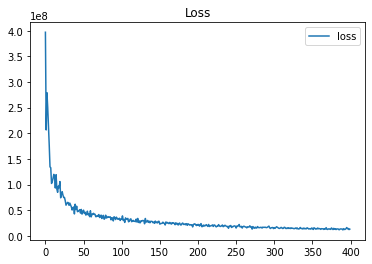

done 5 layers in 92.89ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1593.02171799]


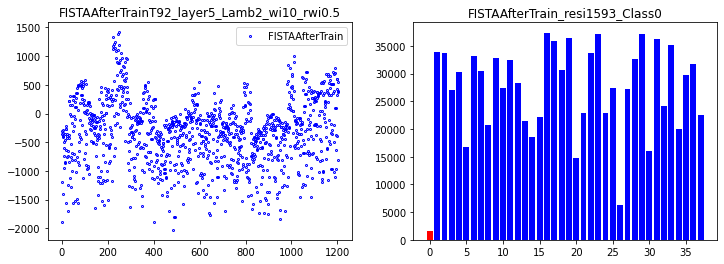

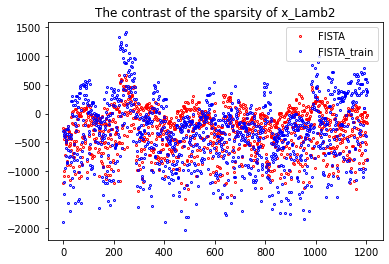

47
done 5 layers in 81.77ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[5129.07752112]


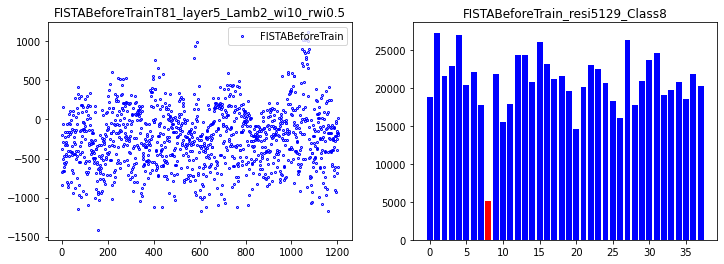

correct rate: 0.375
correct rate: 0.53125
correct rate: 0.40625
correct rate: 0.34375
Epoch [ 10/100]: loss = 62009729.0374,   lambda [max:2.0422], [min:1.9650], 
Epoch [ 20/100]: loss = 35470270.8755,   lambda [max:2.0583], [min:1.9643], 
Epoch [ 30/100]: loss = 27822505.5972,   lambda [max:2.0658], [min:1.9604], 
Epoch [ 40/100]: loss = 25337042.4542,   lambda [max:2.0850], [min:1.9529], 
Epoch [ 50/100]: loss = 21408739.0195,   lambda [max:2.1058], [min:1.9451], 
Epoch [ 60/100]: loss = 16960098.0471,   lambda [max:2.1254], [min:1.9420], 
Epoch [ 70/100]: loss = 18523149.2169,   lambda [max:2.1439], [min:1.9391], 
Epoch [ 80/100]: loss = 17025002.0085,   lambda [max:2.1623], [min:1.9393], 
Epoch [ 90/100]: loss = 14889073.0182,   lambda [max:2.1801], [min:1.9385], 
correct rate: 0.3125
correct rate: 0.375
correct rate: 0.375
correct rate: 0.28125
Epoch [100/100]: loss = 16819539.5711,   lambda [max:2.1970], [min:1.9384], 


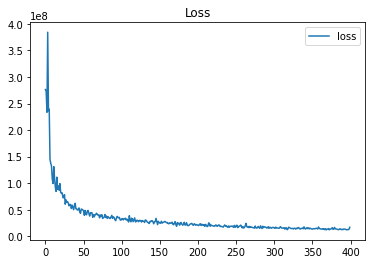

done 5 layers in 81.89ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1260.74962112]


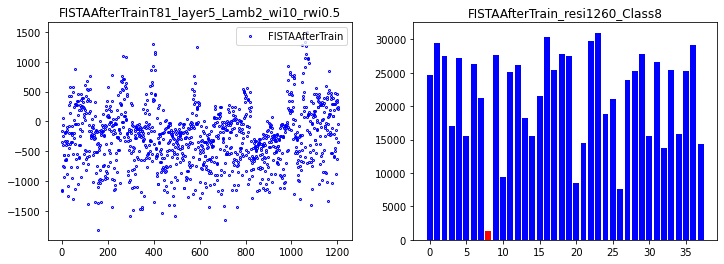

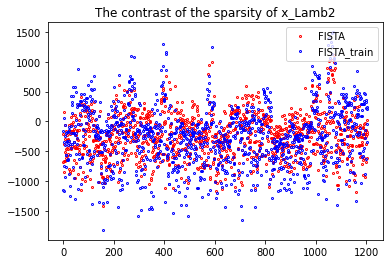

48
done 5 layers in 82.05ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[15796.94470236]


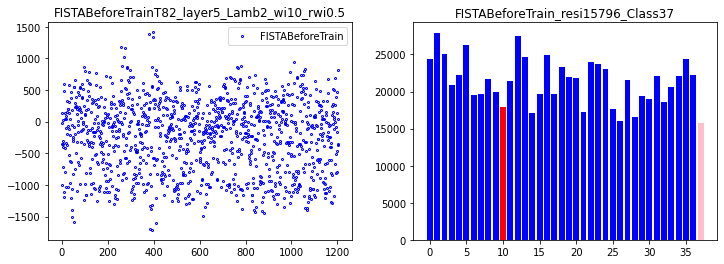

correct rate: 0.375
correct rate: 0.40625
correct rate: 0.53125
correct rate: 0.34375
Epoch [ 10/100]: loss = 56945908.8813,   lambda [max:2.0439], [min:1.9729], 
Epoch [ 20/100]: loss = 35445857.2387,   lambda [max:2.0575], [min:1.9583], 
Epoch [ 30/100]: loss = 29710301.6040,   lambda [max:2.0806], [min:1.9482], 
Epoch [ 40/100]: loss = 28269969.5748,   lambda [max:2.1067], [min:1.9391], 
Epoch [ 50/100]: loss = 18201609.9811,   lambda [max:2.1304], [min:1.9322], 
Epoch [ 60/100]: loss = 20146218.7174,   lambda [max:2.1524], [min:1.9271], 
Epoch [ 70/100]: loss = 16208189.1940,   lambda [max:2.1738], [min:1.9238], 
Epoch [ 80/100]: loss = 15341783.2295,   lambda [max:2.1942], [min:1.9200], 
Epoch [ 90/100]: loss = 13638349.2902,   lambda [max:2.2140], [min:1.9175], 
correct rate: 0.375
correct rate: 0.125
correct rate: 0.3125
correct rate: 0.25
Epoch [100/100]: loss = 13410690.5483,   lambda [max:2.2328], [min:1.9161], 


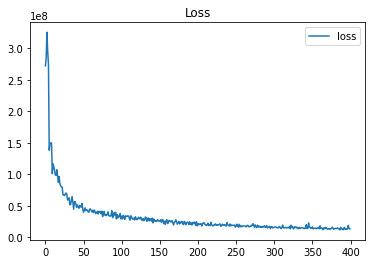

done 5 layers in 85.14ms
predict class: yaleB28
test image label: yaleB11
predict residuals label: 26
test residuals label: 10
[2294.12740974]


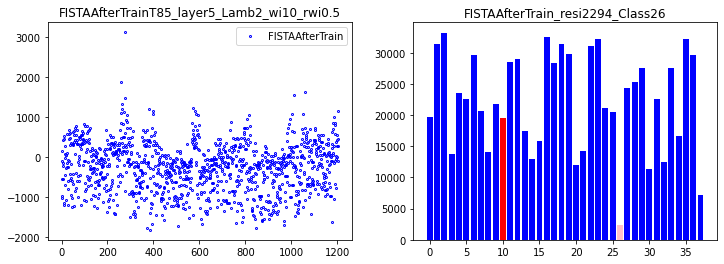

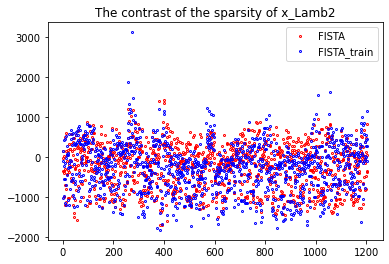

49
done 5 layers in 82.08ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[4730.73998406]


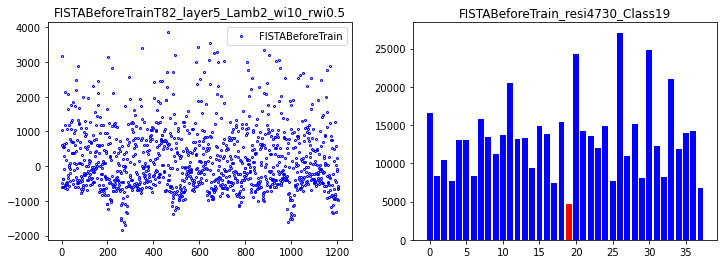

correct rate: 0.4375
correct rate: 0.4375
correct rate: 0.375
correct rate: 0.46875
Epoch [ 10/100]: loss = 54143215.7146,   lambda [max:2.0470], [min:1.9604], 
Epoch [ 20/100]: loss = 35710150.4088,   lambda [max:2.0636], [min:1.9624], 
Epoch [ 30/100]: loss = 28844834.1252,   lambda [max:2.0736], [min:1.9655], 
Epoch [ 40/100]: loss = 23745150.5210,   lambda [max:2.0852], [min:1.9587], 
Epoch [ 50/100]: loss = 21411230.7277,   lambda [max:2.1063], [min:1.9523], 
Epoch [ 60/100]: loss = 18917652.8542,   lambda [max:2.1265], [min:1.9504], 
Epoch [ 70/100]: loss = 13040763.2326,   lambda [max:2.1456], [min:1.9492], 
Epoch [ 80/100]: loss = 14385052.8269,   lambda [max:2.1633], [min:1.9491], 
Epoch [ 90/100]: loss = 13201978.6713,   lambda [max:2.1803], [min:1.9510], 
correct rate: 0.40625
correct rate: 0.34375
correct rate: 0.3125
correct rate: 0.21875
Epoch [100/100]: loss = 13516741.0974,   lambda [max:2.1974], [min:1.9506], 


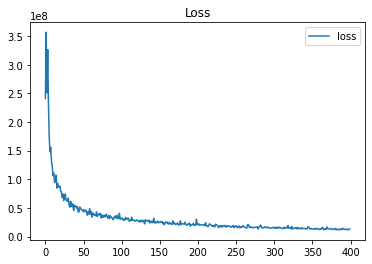

done 5 layers in 81.31ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[5642.62076912]


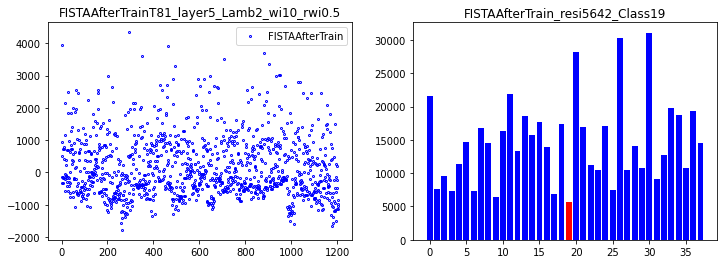

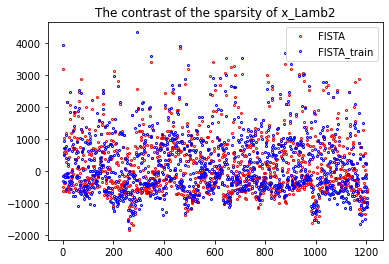

50
done 1 layers in 77.48ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[165030.00428363]


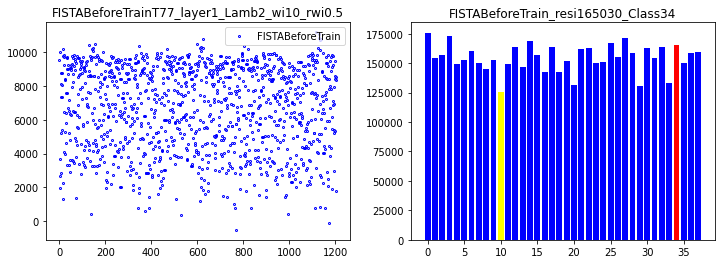

correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.6875
Epoch [ 10/100]: loss = 1021705591.0673,   lambda [max:2.0629], [min:1.9697], 
Epoch [ 20/100]: loss = 487319843.5389,   lambda [max:2.1032], [min:1.9720], 
Epoch [ 30/100]: loss = 432640194.8383,   lambda [max:2.1358], [min:1.9723], 
Epoch [ 40/100]: loss = 347863289.9769,   lambda [max:2.1644], [min:1.9715], 
Epoch [ 50/100]: loss = 238419840.0360,   lambda [max:2.1904], [min:1.9714], 
Epoch [ 60/100]: loss = 218066555.7869,   lambda [max:2.2145], [min:1.9707], 
Epoch [ 70/100]: loss = 186706056.8349,   lambda [max:2.2371], [min:1.9699], 
Epoch [ 80/100]: loss = 149513498.1880,   lambda [max:2.2585], [min:1.9697], 
Epoch [ 90/100]: loss = 173028986.3697,   lambda [max:2.2790], [min:1.9688], 
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 150379859.3752,   lambda [max:2.2986], [min:1.9690], 


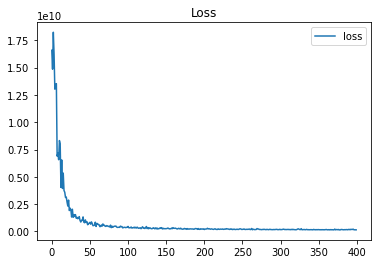

done 1 layers in 75.88ms
predict class: yaleB11
test image label: yaleB36
predict residuals label: 10
test residuals label: 34
[8591.90846197]


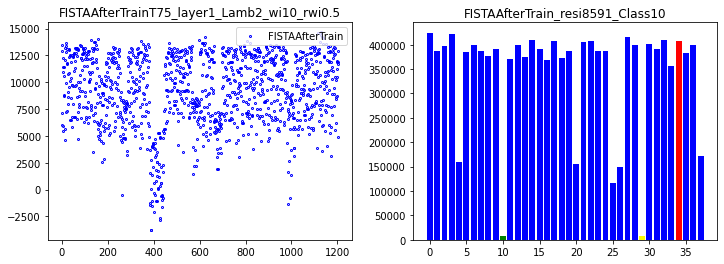

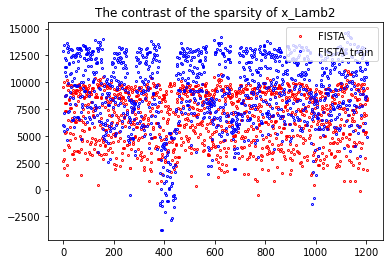

51
done 1 layers in 76.71ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[55240.62144772]


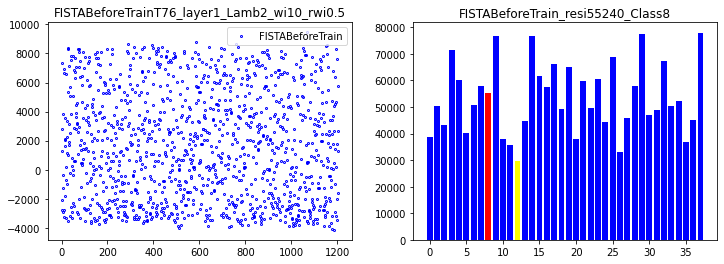

correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.5
correct rate: 0.65625
Epoch [ 10/100]: loss = 865760688.3734,   lambda [max:2.0630], [min:1.9695], 
Epoch [ 20/100]: loss = 310136409.5336,   lambda [max:2.1035], [min:1.9725], 
Epoch [ 30/100]: loss = 258071390.7077,   lambda [max:2.1361], [min:1.9722], 
Epoch [ 40/100]: loss = 227171041.0517,   lambda [max:2.1649], [min:1.9711], 
Epoch [ 50/100]: loss = 236581936.0233,   lambda [max:2.1911], [min:1.9705], 
Epoch [ 60/100]: loss = 160609587.6410,   lambda [max:2.2153], [min:1.9709], 
Epoch [ 70/100]: loss = 258635540.1829,   lambda [max:2.2380], [min:1.9697], 
Epoch [ 80/100]: loss = 166535212.9503,   lambda [max:2.2596], [min:1.9689], 
Epoch [ 90/100]: loss = 140022564.5072,   lambda [max:2.2802], [min:1.9692], 
correct rate: 0.15625
correct rate: 0.0625
correct rate: 0.0
correct rate: 0.03125
Epoch [100/100]: loss = 140883240.5323,   lambda [max:2.3000], [min:1.9692], 


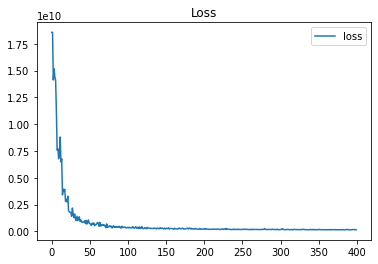

done 1 layers in 75.68ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[78234.10875033]


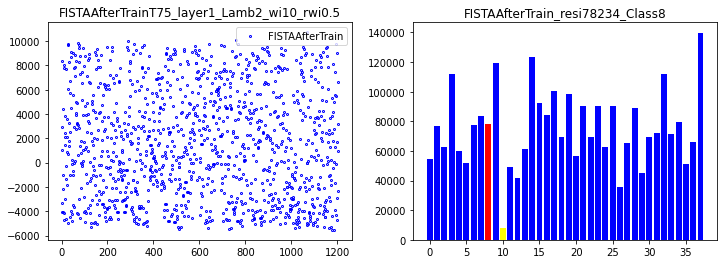

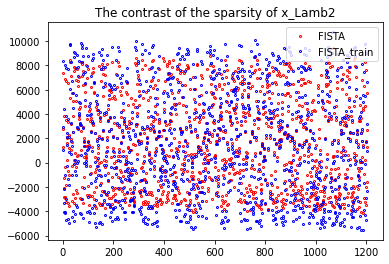

52
done 1 layers in 97.33ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[46018.72914558]


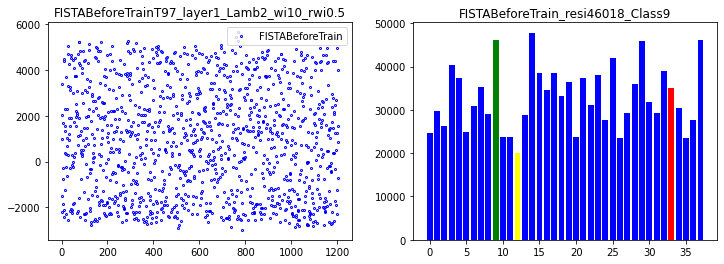

correct rate: 0.625
correct rate: 0.71875
correct rate: 0.53125
correct rate: 0.5625
Epoch [ 10/100]: loss = 1178129637.3347,   lambda [max:2.0628], [min:1.9685], 
Epoch [ 20/100]: loss = 452165845.1659,   lambda [max:2.1029], [min:1.9712], 
Epoch [ 30/100]: loss = 298848870.4048,   lambda [max:2.1352], [min:1.9706], 
Epoch [ 40/100]: loss = 296000360.5710,   lambda [max:2.1637], [min:1.9707], 
Epoch [ 50/100]: loss = 214327095.1035,   lambda [max:2.1896], [min:1.9706], 
Epoch [ 60/100]: loss = 198220475.4585,   lambda [max:2.2137], [min:1.9701], 
Epoch [ 70/100]: loss = 163312196.2832,   lambda [max:2.2364], [min:1.9699], 
Epoch [ 80/100]: loss = 157683428.4436,   lambda [max:2.2579], [min:1.9699], 
Epoch [ 90/100]: loss = 150529734.7059,   lambda [max:2.2785], [min:1.9700], 
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.0625
Epoch [100/100]: loss = 139197556.9400,   lambda [max:2.2983], [min:1.9702], 


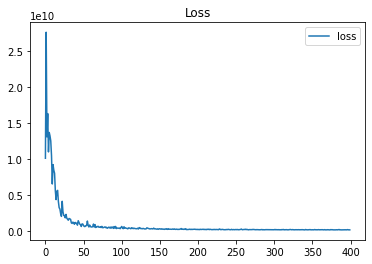

done 1 layers in 88.59ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[59238.26806688]


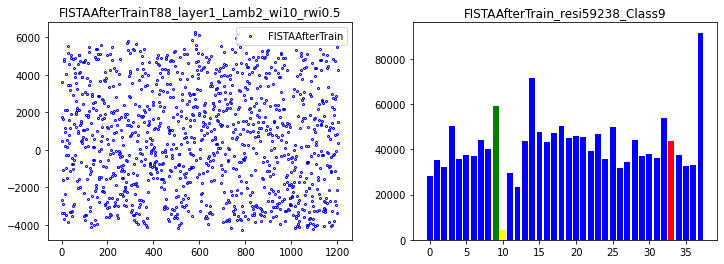

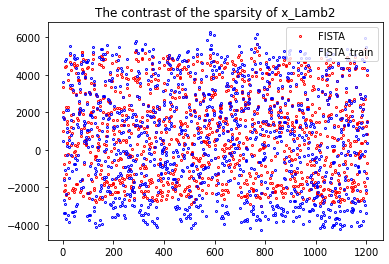

53
done 1 layers in 74.77ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[27569.88345457]


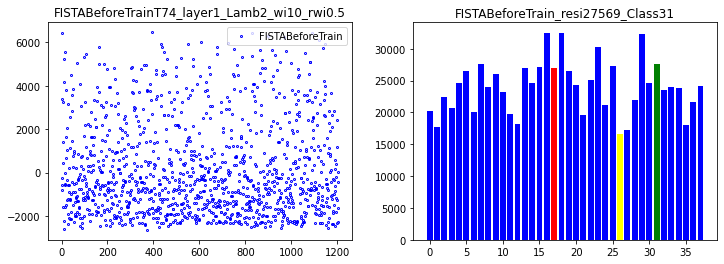

correct rate: 0.5
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.625
Epoch [ 10/100]: loss = 1751872242.4460,   lambda [max:2.0630], [min:1.9686], 
Epoch [ 20/100]: loss = 446055564.1833,   lambda [max:2.1034], [min:1.9712], 
Epoch [ 30/100]: loss = 339518262.7239,   lambda [max:2.1358], [min:1.9711], 
Epoch [ 40/100]: loss = 275871214.2958,   lambda [max:2.1644], [min:1.9699], 
Epoch [ 50/100]: loss = 219415207.1167,   lambda [max:2.1903], [min:1.9702], 
Epoch [ 60/100]: loss = 174359547.4408,   lambda [max:2.2144], [min:1.9697], 
Epoch [ 70/100]: loss = 204367637.9789,   lambda [max:2.2371], [min:1.9690], 
Epoch [ 80/100]: loss = 147853444.8218,   lambda [max:2.2585], [min:1.9693], 
Epoch [ 90/100]: loss = 191813478.7026,   lambda [max:2.2789], [min:1.9685], 
correct rate: 0.09375
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 140813681.5997,   lambda [max:2.2986], [min:1.9681], 


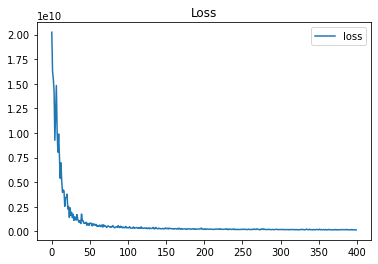

done 1 layers in 73.43ms
predict class: yaleB15
test image label: yaleB19
predict residuals label: 13
test residuals label: 17
[44566.78415613]


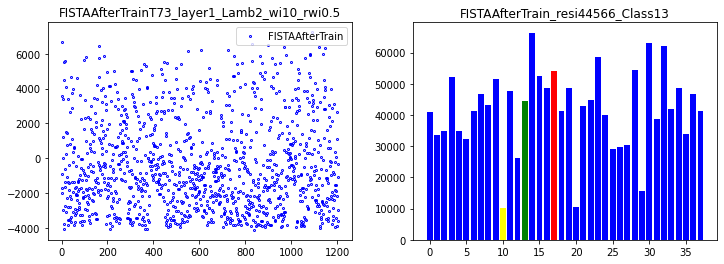

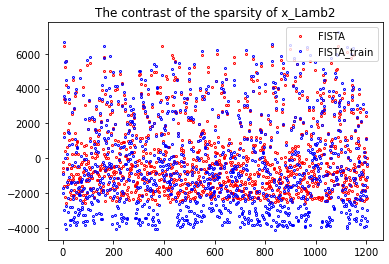

54
done 1 layers in 70.19ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[31029.61963336]


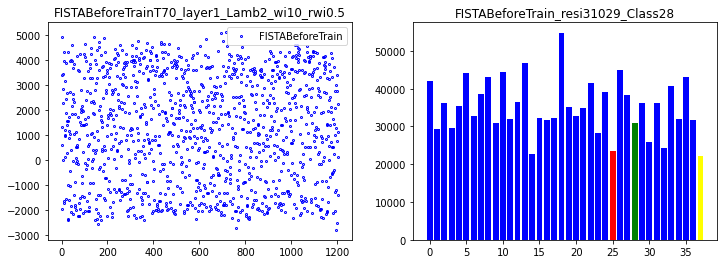

correct rate: 0.8125
correct rate: 0.59375
correct rate: 0.4375
correct rate: 0.65625
Epoch [ 10/100]: loss = 836957473.3392,   lambda [max:2.0630], [min:1.9742], 
Epoch [ 20/100]: loss = 428910612.4922,   lambda [max:2.1032], [min:1.9730], 
Epoch [ 30/100]: loss = 313458476.4786,   lambda [max:2.1355], [min:1.9717], 
Epoch [ 40/100]: loss = 283175171.9221,   lambda [max:2.1640], [min:1.9703], 
Epoch [ 50/100]: loss = 168948649.0566,   lambda [max:2.1900], [min:1.9692], 
Epoch [ 60/100]: loss = 161141344.9510,   lambda [max:2.2142], [min:1.9687], 
Epoch [ 70/100]: loss = 140949383.7102,   lambda [max:2.2370], [min:1.9684], 
Epoch [ 80/100]: loss = 159738030.9322,   lambda [max:2.2586], [min:1.9678], 
Epoch [ 90/100]: loss = 168021286.2362,   lambda [max:2.2792], [min:1.9672], 
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.0625
Epoch [100/100]: loss = 139994687.6530,   lambda [max:2.2989], [min:1.9669], 


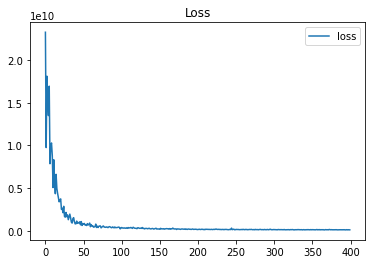

done 1 layers in 78.02ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[60137.39548095]


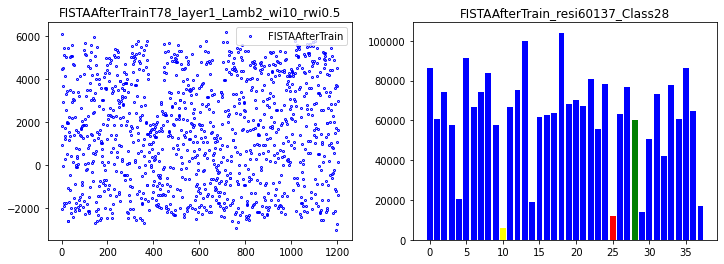

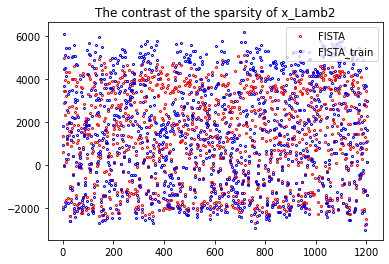

55
done 1 layers in 75.65ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[117197.29986484]


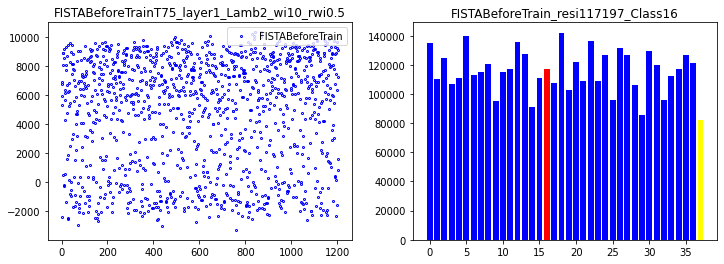

correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.5
Epoch [ 10/100]: loss = 1054333100.2679,   lambda [max:2.0629], [min:1.9686], 
Epoch [ 20/100]: loss = 484619126.6341,   lambda [max:2.1031], [min:1.9707], 
Epoch [ 30/100]: loss = 343184679.3971,   lambda [max:2.1355], [min:1.9707], 
Epoch [ 40/100]: loss = 261438702.0600,   lambda [max:2.1640], [min:1.9703], 
Epoch [ 50/100]: loss = 244476589.5722,   lambda [max:2.1899], [min:1.9703], 
Epoch [ 60/100]: loss = 217765091.4676,   lambda [max:2.2139], [min:1.9696], 
Epoch [ 70/100]: loss = 182616489.2476,   lambda [max:2.2365], [min:1.9688], 
Epoch [ 80/100]: loss = 173638431.4084,   lambda [max:2.2579], [min:1.9693], 
Epoch [ 90/100]: loss = 157209275.9338,   lambda [max:2.2784], [min:1.9691], 
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.09375
Epoch [100/100]: loss = 190364456.6228,   lambda [max:2.2980], [min:1.9687], 


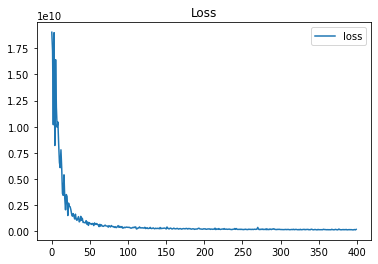

done 1 layers in 94.94ms
predict class: yaleB39
test image label: yaleB18
predict residuals label: 37
test residuals label: 16
[5175.27231599]


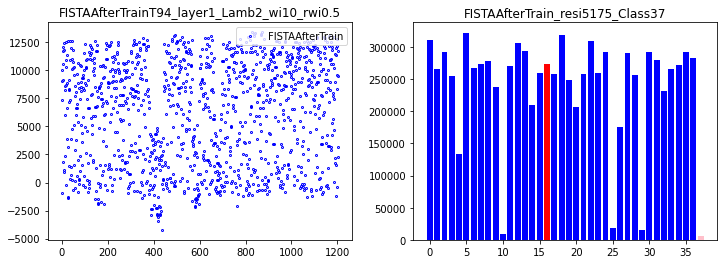

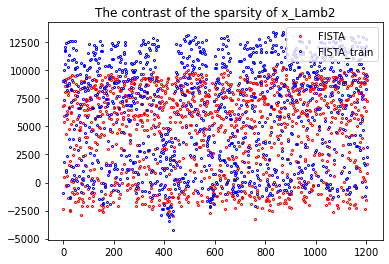

56
done 1 layers in 84.64ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[207823.17555821]


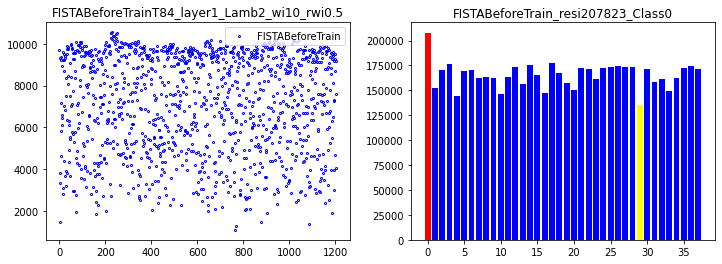

correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.5625
Epoch [ 10/100]: loss = 1309196937.2212,   lambda [max:2.0628], [min:1.9711], 
Epoch [ 20/100]: loss = 389966675.9826,   lambda [max:2.1030], [min:1.9745], 
Epoch [ 30/100]: loss = 372380136.1014,   lambda [max:2.1357], [min:1.9744], 
Epoch [ 40/100]: loss = 283051989.0514,   lambda [max:2.1645], [min:1.9746], 
Epoch [ 50/100]: loss = 180933637.3720,   lambda [max:2.1906], [min:1.9738], 
Epoch [ 60/100]: loss = 209343068.9720,   lambda [max:2.2149], [min:1.9735], 
Epoch [ 70/100]: loss = 174513811.2522,   lambda [max:2.2377], [min:1.9743], 
Epoch [ 80/100]: loss = 169924101.7634,   lambda [max:2.2594], [min:1.9738], 
Epoch [ 90/100]: loss = 145900363.0613,   lambda [max:2.2801], [min:1.9735], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.03125
Epoch [100/100]: loss = 142189326.1191,   lambda [max:2.2999], [min:1.9735], 


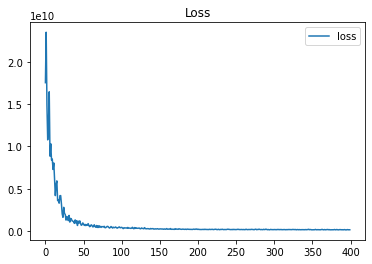

done 1 layers in 76.41ms
predict class: yaleB11
test image label: yaleB01
predict residuals label: 10
test residuals label: 0
[6144.07271742]


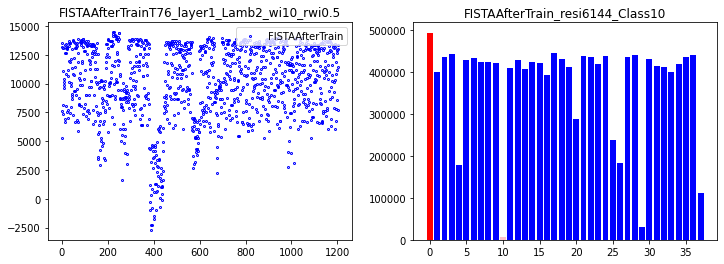

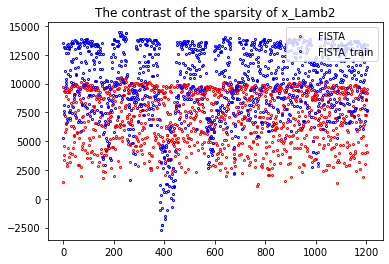

57
done 1 layers in 85.24ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[144025.68679775]


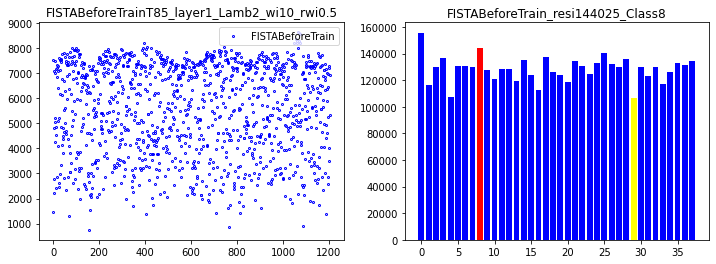

correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.625
Epoch [ 10/100]: loss = 1096177265.7224,   lambda [max:2.0628], [min:1.9692], 
Epoch [ 20/100]: loss = 465656118.2140,   lambda [max:2.1026], [min:1.9683], 
Epoch [ 30/100]: loss = 255202378.3323,   lambda [max:2.1350], [min:1.9702], 
Epoch [ 40/100]: loss = 242346074.9775,   lambda [max:2.1635], [min:1.9692], 
Epoch [ 50/100]: loss = 242083129.9961,   lambda [max:2.1896], [min:1.9684], 
Epoch [ 60/100]: loss = 183932567.3666,   lambda [max:2.2138], [min:1.9670], 
Epoch [ 70/100]: loss = 164199925.4654,   lambda [max:2.2365], [min:1.9665], 
Epoch [ 80/100]: loss = 146201595.1961,   lambda [max:2.2581], [min:1.9659], 
Epoch [ 90/100]: loss = 160627961.1050,   lambda [max:2.2787], [min:1.9653], 
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.09375
Epoch [100/100]: loss = 146169960.0560,   lambda [max:2.2984], [min:1.9652], 


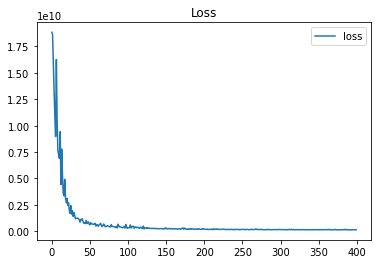

done 1 layers in 83.00ms
predict class: yaleB11
test image label: yaleB09
predict residuals label: 10
test residuals label: 8
[4991.51343548]


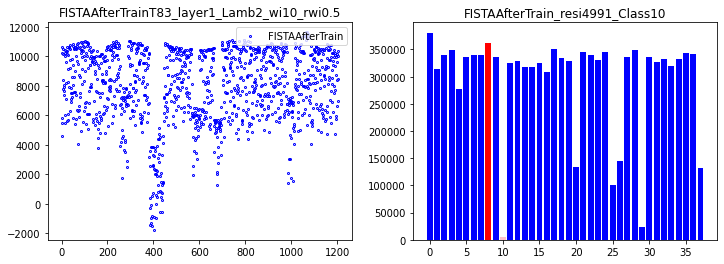

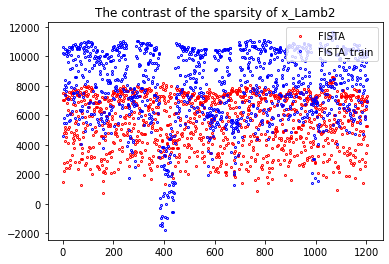

58
done 1 layers in 76.91ms
predict class: yaleB30
test image label: yaleB11
predict residuals label: 28
test residuals label: 10
[140785.89735658]


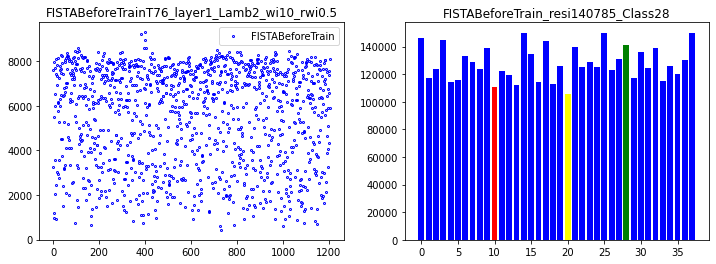

correct rate: 0.71875
correct rate: 0.625
correct rate: 0.53125
correct rate: 0.65625
Epoch [ 10/100]: loss = 1395501559.6261,   lambda [max:2.0631], [min:1.9683], 
Epoch [ 20/100]: loss = 452617518.8619,   lambda [max:2.1034], [min:1.9686], 
Epoch [ 30/100]: loss = 261935338.1665,   lambda [max:2.1359], [min:1.9676], 
Epoch [ 40/100]: loss = 228910917.6877,   lambda [max:2.1645], [min:1.9660], 
Epoch [ 50/100]: loss = 204825049.2181,   lambda [max:2.1904], [min:1.9652], 
Epoch [ 60/100]: loss = 166142397.3378,   lambda [max:2.2146], [min:1.9652], 
Epoch [ 70/100]: loss = 174807765.4584,   lambda [max:2.2372], [min:1.9647], 
Epoch [ 80/100]: loss = 153624074.1342,   lambda [max:2.2587], [min:1.9644], 
Epoch [ 90/100]: loss = 181451709.3822,   lambda [max:2.2793], [min:1.9636], 
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.125
Epoch [100/100]: loss = 150105418.3029,   lambda [max:2.2989], [min:1.9631], 


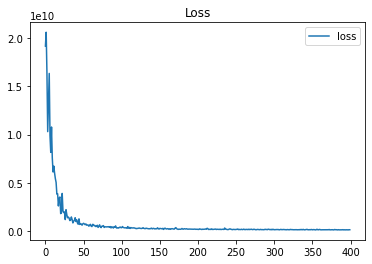

done 1 layers in 86.46ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[4626.1746471]


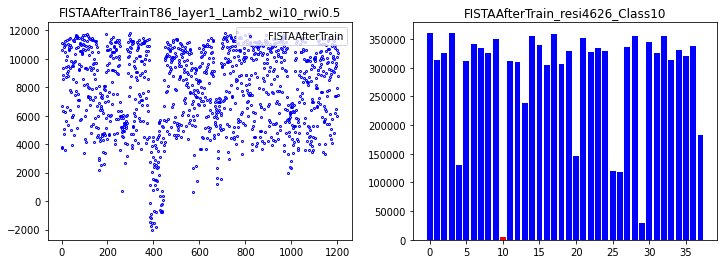

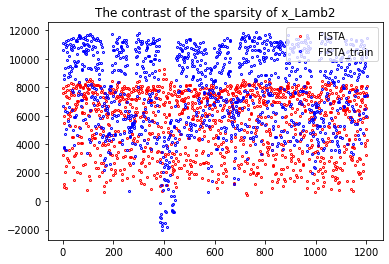

59
done 1 layers in 76.45ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[56893.90229373]


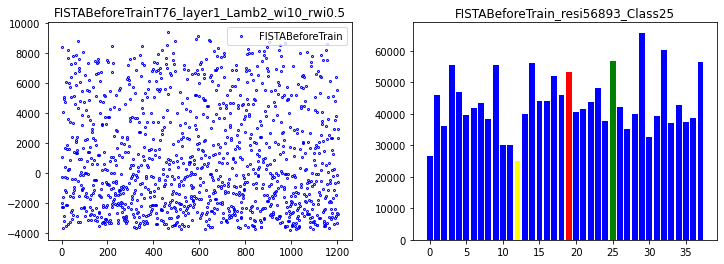

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.625
Epoch [ 10/100]: loss = 1151364056.6360,   lambda [max:2.0630], [min:1.9735], 
Epoch [ 20/100]: loss = 418177046.1756,   lambda [max:2.1030], [min:1.9720], 
Epoch [ 30/100]: loss = 359807872.1743,   lambda [max:2.1352], [min:1.9715], 
Epoch [ 40/100]: loss = 300436517.3771,   lambda [max:2.1636], [min:1.9714], 
Epoch [ 50/100]: loss = 258802789.6690,   lambda [max:2.1895], [min:1.9705], 
Epoch [ 60/100]: loss = 199146755.1071,   lambda [max:2.2135], [min:1.9697], 
Epoch [ 70/100]: loss = 164229652.3652,   lambda [max:2.2360], [min:1.9689], 
Epoch [ 80/100]: loss = 172305240.2022,   lambda [max:2.2575], [min:1.9683], 
Epoch [ 90/100]: loss = 163899202.0472,   lambda [max:2.2780], [min:1.9677], 
correct rate: 0.0625
correct rate: 0.125
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 135928200.9364,   lambda [max:2.2976], [min:1.9673], 


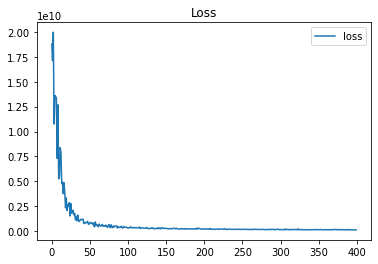

done 1 layers in 73.12ms
predict class: yaleB31
test image label: yaleB21
predict residuals label: 29
test residuals label: 19
[43161.06405544]


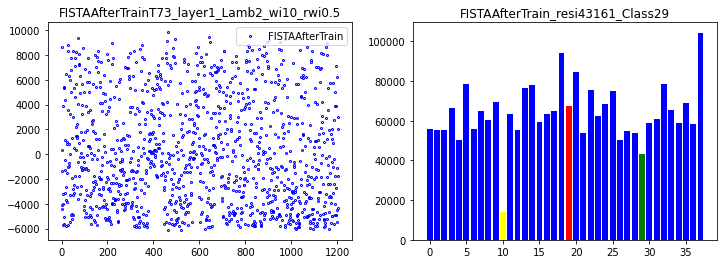

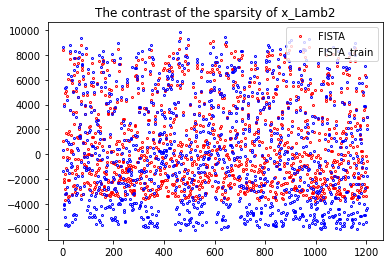

60
done 10 layers in 95.01ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[13940.33060953]


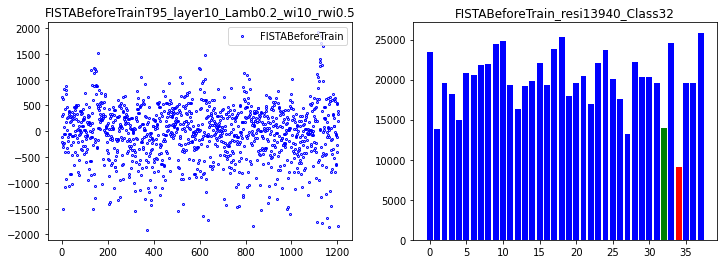

correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.6875
Epoch [ 10/100]: loss = 50451089.4882,   lambda [max:0.2481], [min:0.1597], 
Epoch [ 20/100]: loss = 22229586.1916,   lambda [max:0.2641], [min:0.1498], 
Epoch [ 30/100]: loss = 16744603.2676,   lambda [max:0.2668], [min:0.1382], 
Epoch [ 40/100]: loss = 9117911.4943,   lambda [max:0.2711], [min:0.1303], 
Epoch [ 50/100]: loss = 9583360.1723,   lambda [max:0.2756], [min:0.1247], 
Epoch [ 60/100]: loss = 6918148.6419,   lambda [max:0.2787], [min:0.1199], 
Epoch [ 70/100]: loss = 5834778.9393,   lambda [max:0.2814], [min:0.1163], 
Epoch [ 80/100]: loss = 7200898.7313,   lambda [max:0.2836], [min:0.1128], 
Epoch [ 90/100]: loss = 3710485.4780,   lambda [max:0.2854], [min:0.1099], 
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.625
Epoch [100/100]: loss = 4685090.3469,   lambda [max:0.2866], [min:0.1074], 


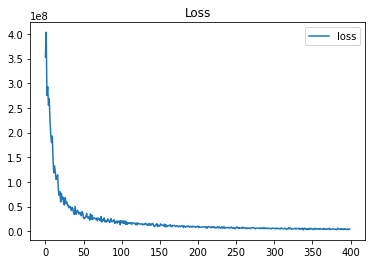

done 10 layers in 87.62ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[1008.72696728]


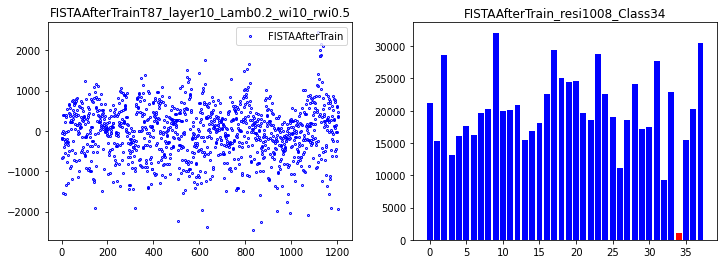

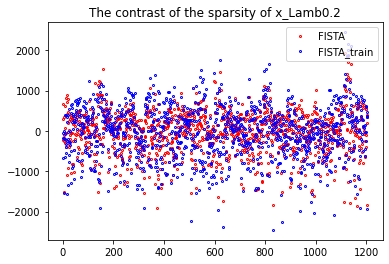

61
done 10 layers in 87.83ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[8822.14116408]


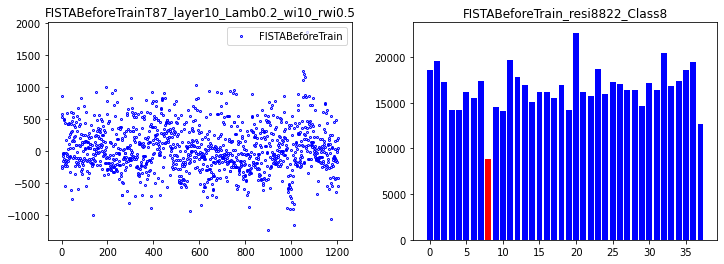

correct rate: 0.59375
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.6875
Epoch [ 10/100]: loss = 35278973.7845,   lambda [max:0.2487], [min:0.1612], 
Epoch [ 20/100]: loss = 20923476.9427,   lambda [max:0.2601], [min:0.1392], 
Epoch [ 30/100]: loss = 13153759.4229,   lambda [max:0.2621], [min:0.1271], 
Epoch [ 40/100]: loss = 8542049.3866,   lambda [max:0.2633], [min:0.1179], 
Epoch [ 50/100]: loss = 6768207.2273,   lambda [max:0.2716], [min:0.1106], 
Epoch [ 60/100]: loss = 7575661.0950,   lambda [max:0.2775], [min:0.1048], 
Epoch [ 70/100]: loss = 5972172.0932,   lambda [max:0.2798], [min:0.0993], 
Epoch [ 80/100]: loss = 3860338.7997,   lambda [max:0.2819], [min:0.0944], 
Epoch [ 90/100]: loss = 5962656.9464,   lambda [max:0.2828], [min:0.0903], 
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.625
Epoch [100/100]: loss = 4379201.6746,   lambda [max:0.2843], [min:0.0866], 


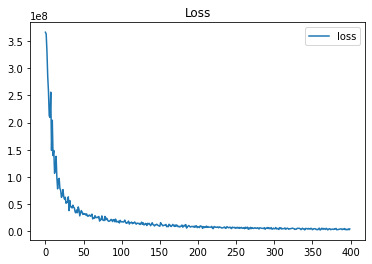

done 10 layers in 87.59ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1441.34498502]


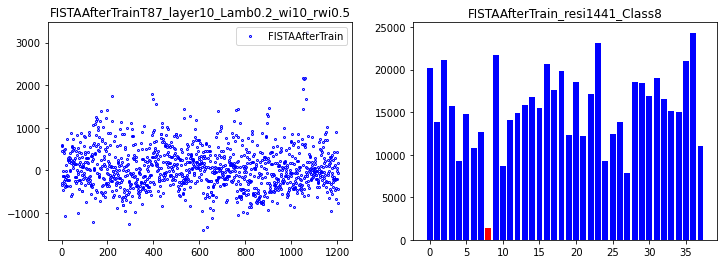

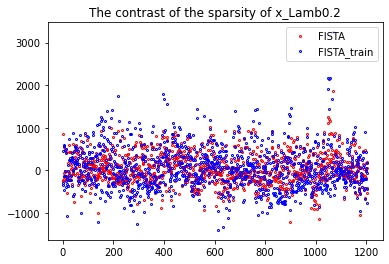

62
done 10 layers in 92.79ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6060.02514802]


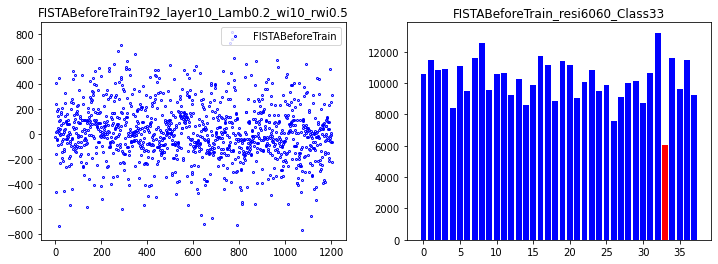

correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.625
Epoch [ 10/100]: loss = 34478306.5858,   lambda [max:0.2494], [min:0.1610], 
Epoch [ 20/100]: loss = 21728698.2099,   lambda [max:0.2621], [min:0.1488], 
Epoch [ 30/100]: loss = 17061801.3266,   lambda [max:0.2653], [min:0.1353], 
Epoch [ 40/100]: loss = 11092448.8591,   lambda [max:0.2675], [min:0.1254], 
Epoch [ 50/100]: loss = 8617683.2223,   lambda [max:0.2759], [min:0.1178], 
Epoch [ 60/100]: loss = 7734739.7852,   lambda [max:0.2808], [min:0.1113], 
Epoch [ 70/100]: loss = 4984831.5057,   lambda [max:0.2834], [min:0.1047], 
Epoch [ 80/100]: loss = 4471113.9900,   lambda [max:0.2855], [min:0.0985], 
Epoch [ 90/100]: loss = 4070844.7423,   lambda [max:0.2870], [min:0.0931], 
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.71875
Epoch [100/100]: loss = 3266316.6581,   lambda [max:0.2882], [min:0.0883], 


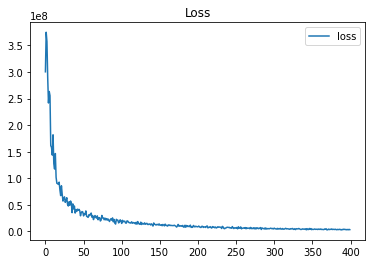

done 10 layers in 86.05ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[1044.1953179]


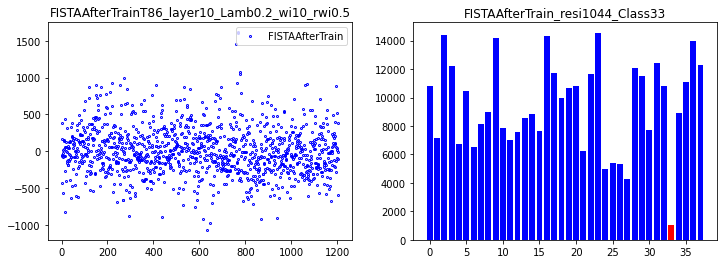

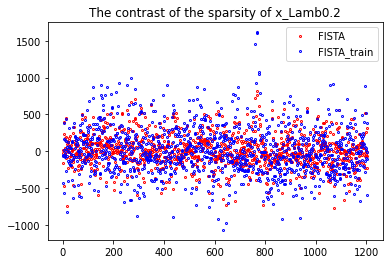

63
done 10 layers in 96.38ms
predict class: yaleB31
test image label: yaleB19
predict residuals label: 29
test residuals label: 17
[7793.67296069]


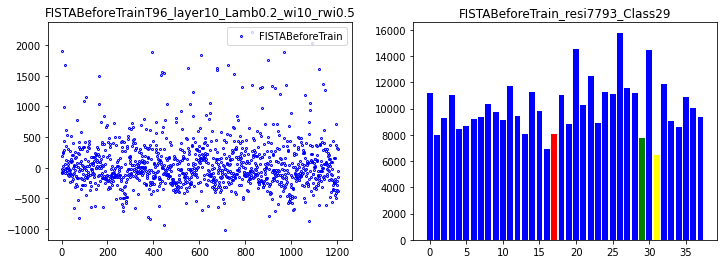

correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.59375
Epoch [ 10/100]: loss = 45316956.8408,   lambda [max:0.2467], [min:0.1609], 
Epoch [ 20/100]: loss = 23105604.6802,   lambda [max:0.2579], [min:0.1437], 
Epoch [ 30/100]: loss = 12617063.6299,   lambda [max:0.2598], [min:0.1269], 
Epoch [ 40/100]: loss = 12351066.2564,   lambda [max:0.2621], [min:0.1151], 
Epoch [ 50/100]: loss = 10552127.5556,   lambda [max:0.2699], [min:0.1059], 
Epoch [ 60/100]: loss = 6401152.0565,   lambda [max:0.2743], [min:0.0984], 
Epoch [ 70/100]: loss = 6489947.4217,   lambda [max:0.2771], [min:0.0922], 
Epoch [ 80/100]: loss = 3783850.9390,   lambda [max:0.2791], [min:0.0873], 
Epoch [ 90/100]: loss = 3315940.1144,   lambda [max:0.2799], [min:0.0829], 
correct rate: 0.78125
correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.53125
Epoch [100/100]: loss = 4860351.4600,   lambda [max:0.2812], [min:0.0790], 


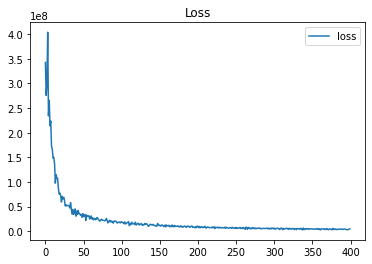

done 10 layers in 88.07ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[1993.22295056]


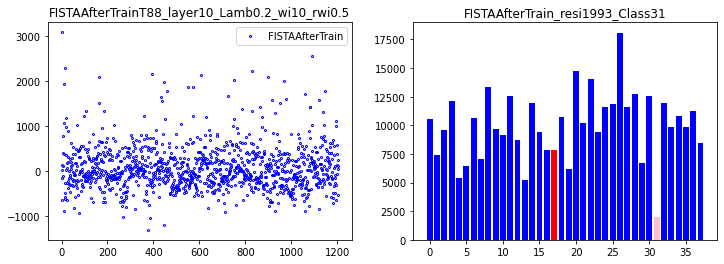

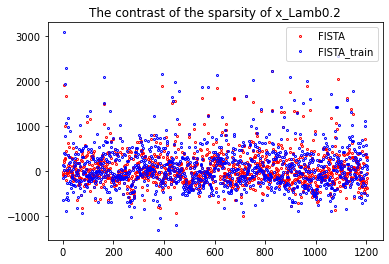

64
done 10 layers in 94.51ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[7972.84785787]


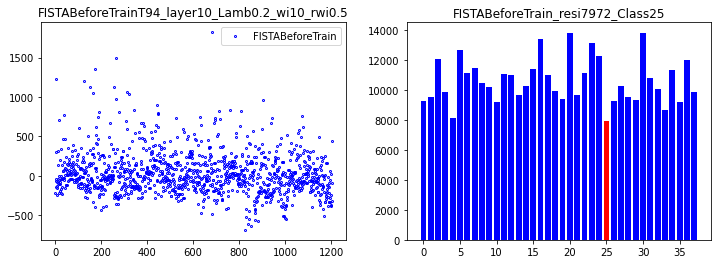

correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.46875
correct rate: 0.65625
Epoch [ 10/100]: loss = 42892212.6021,   lambda [max:0.2476], [min:0.1643], 
Epoch [ 20/100]: loss = 25449848.1528,   lambda [max:0.2599], [min:0.1390], 
Epoch [ 30/100]: loss = 13924836.7196,   lambda [max:0.2641], [min:0.1244], 
Epoch [ 40/100]: loss = 12197863.7961,   lambda [max:0.2641], [min:0.1136], 
Epoch [ 50/100]: loss = 6461319.8448,   lambda [max:0.2682], [min:0.1053], 
Epoch [ 60/100]: loss = 7242791.5364,   lambda [max:0.2726], [min:0.0985], 
Epoch [ 70/100]: loss = 5730054.6918,   lambda [max:0.2754], [min:0.0927], 
Epoch [ 80/100]: loss = 5472256.5703,   lambda [max:0.2770], [min:0.0875], 
Epoch [ 90/100]: loss = 4001377.3597,   lambda [max:0.2781], [min:0.0829], 
correct rate: 0.53125
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.75
Epoch [100/100]: loss = 3113860.9133,   lambda [max:0.2789], [min:0.0790], 


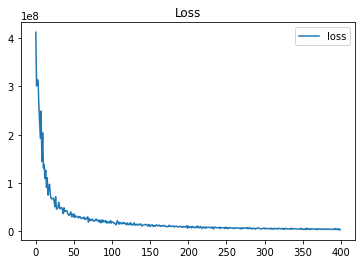

done 10 layers in 88.57ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[1085.00237651]


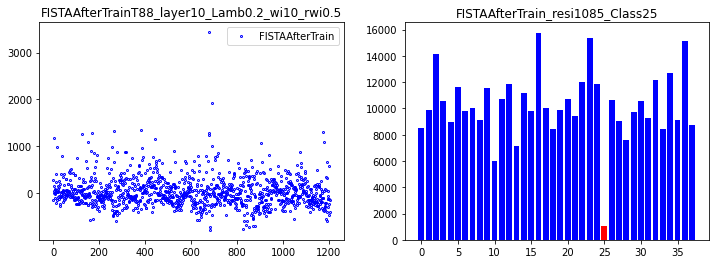

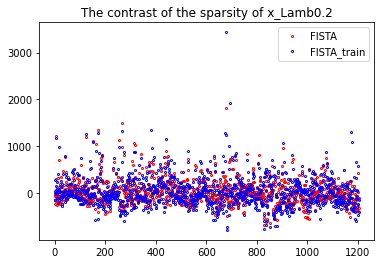

65
done 10 layers in 88.30ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[10511.46048008]


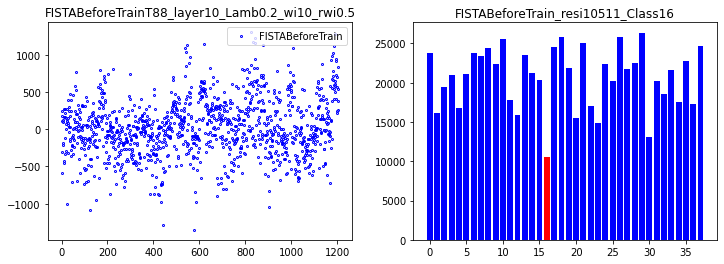

correct rate: 0.78125
correct rate: 0.53125
correct rate: 0.53125
correct rate: 0.5625
Epoch [ 10/100]: loss = 50779474.8133,   lambda [max:0.2472], [min:0.1629], 
Epoch [ 20/100]: loss = 20165658.3867,   lambda [max:0.2646], [min:0.1424], 
Epoch [ 30/100]: loss = 13689106.9643,   lambda [max:0.2670], [min:0.1250], 
Epoch [ 40/100]: loss = 11385680.7503,   lambda [max:0.2683], [min:0.1124], 
Epoch [ 50/100]: loss = 8913367.0968,   lambda [max:0.2685], [min:0.1023], 
Epoch [ 60/100]: loss = 6292956.4210,   lambda [max:0.2690], [min:0.0941], 
Epoch [ 70/100]: loss = 5403717.7480,   lambda [max:0.2688], [min:0.0872], 
Epoch [ 80/100]: loss = 3713750.5370,   lambda [max:0.2684], [min:0.0818], 
Epoch [ 90/100]: loss = 3600263.4897,   lambda [max:0.2685], [min:0.0766], 
correct rate: 0.78125
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.53125
Epoch [100/100]: loss = 3205159.3025,   lambda [max:0.2682], [min:0.0722], 


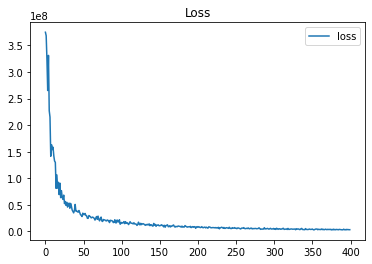

done 10 layers in 87.24ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[503.07694449]


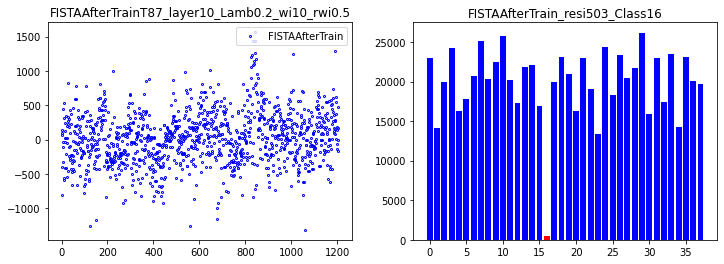

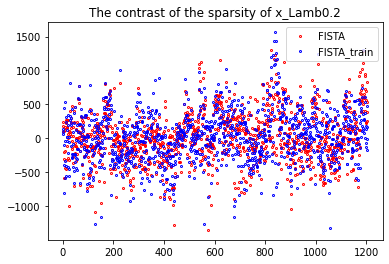

66
done 10 layers in 87.55ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[8533.09062643]


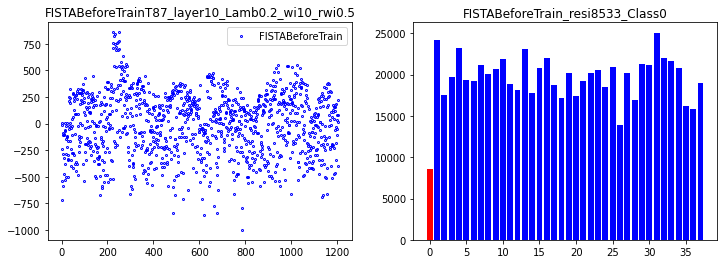

correct rate: 0.5625
correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 42320299.2201,   lambda [max:0.2498], [min:0.1632], 
Epoch [ 20/100]: loss = 25299207.1592,   lambda [max:0.2614], [min:0.1482], 
Epoch [ 30/100]: loss = 16760838.8972,   lambda [max:0.2643], [min:0.1361], 
Epoch [ 40/100]: loss = 11652341.5870,   lambda [max:0.2656], [min:0.1273], 
Epoch [ 50/100]: loss = 10087469.7031,   lambda [max:0.2664], [min:0.1189], 
Epoch [ 60/100]: loss = 7788942.7622,   lambda [max:0.2667], [min:0.1117], 
Epoch [ 70/100]: loss = 5189098.1466,   lambda [max:0.2663], [min:0.1051], 
Epoch [ 80/100]: loss = 4203905.6574,   lambda [max:0.2662], [min:0.0994], 
Epoch [ 90/100]: loss = 3643884.3280,   lambda [max:0.2680], [min:0.0945], 
correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.875
correct rate: 0.625
Epoch [100/100]: loss = 3025447.9507,   lambda [max:0.2693], [min:0.0901], 


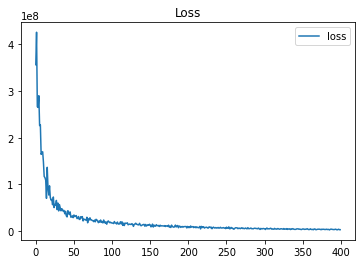

done 10 layers in 87.94ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[993.45163584]


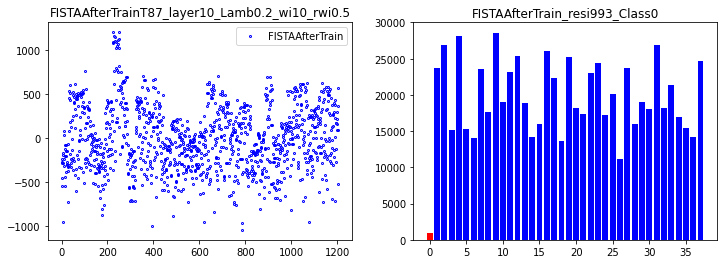

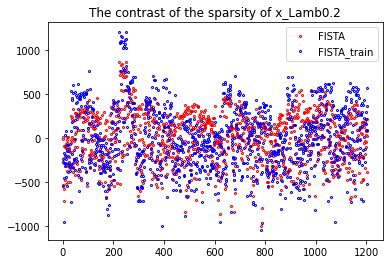

67
done 10 layers in 91.28ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2517.92268771]


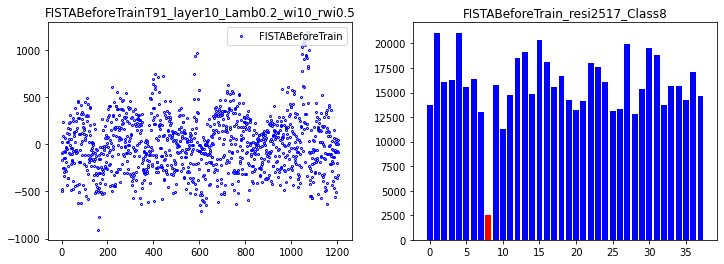

correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.65625
Epoch [ 10/100]: loss = 38215848.1254,   lambda [max:0.2502], [min:0.1627], 
Epoch [ 20/100]: loss = 23044166.1824,   lambda [max:0.2684], [min:0.1432], 
Epoch [ 30/100]: loss = 15222096.4930,   lambda [max:0.2709], [min:0.1309], 
Epoch [ 40/100]: loss = 10199484.9486,   lambda [max:0.2722], [min:0.1217], 
Epoch [ 50/100]: loss = 7860357.3637,   lambda [max:0.2722], [min:0.1143], 
Epoch [ 60/100]: loss = 7256507.3652,   lambda [max:0.2723], [min:0.1081], 
Epoch [ 70/100]: loss = 6493446.0390,   lambda [max:0.2720], [min:0.1030], 
Epoch [ 80/100]: loss = 5289553.1961,   lambda [max:0.2713], [min:0.0989], 
Epoch [ 90/100]: loss = 4269645.1327,   lambda [max:0.2707], [min:0.0951], 
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.71875
Epoch [100/100]: loss = 4276279.1333,   lambda [max:0.2703], [min:0.0915], 


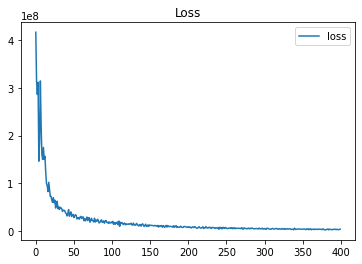

done 10 layers in 89.65ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1829.87300792]


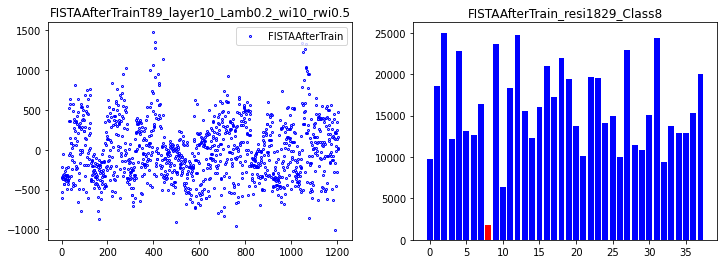

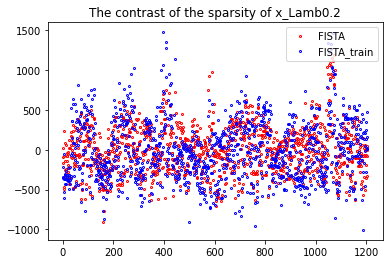

68
done 10 layers in 84.26ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[9766.77429531]


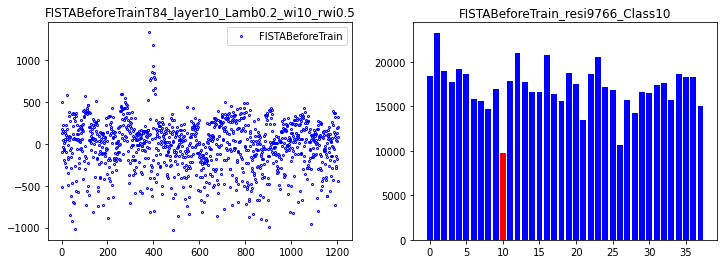

correct rate: 0.53125
correct rate: 0.625
correct rate: 0.5625
correct rate: 0.71875
Epoch [ 10/100]: loss = 35827877.9990,   lambda [max:0.2472], [min:0.1615], 
Epoch [ 20/100]: loss = 24611889.4972,   lambda [max:0.2576], [min:0.1543], 
Epoch [ 30/100]: loss = 17374157.3544,   lambda [max:0.2608], [min:0.1465], 
Epoch [ 40/100]: loss = 10760306.5114,   lambda [max:0.2624], [min:0.1367], 
Epoch [ 50/100]: loss = 9935054.2013,   lambda [max:0.2636], [min:0.1284], 
Epoch [ 60/100]: loss = 7176110.4926,   lambda [max:0.2670], [min:0.1218], 
Epoch [ 70/100]: loss = 6575381.2666,   lambda [max:0.2698], [min:0.1150], 
Epoch [ 80/100]: loss = 4051837.7113,   lambda [max:0.2714], [min:0.1088], 
Epoch [ 90/100]: loss = 4047657.4630,   lambda [max:0.2728], [min:0.1024], 
correct rate: 0.53125
correct rate: 0.75
correct rate: 0.6875
correct rate: 0.59375
Epoch [100/100]: loss = 3819304.2644,   lambda [max:0.2742], [min:0.0954], 


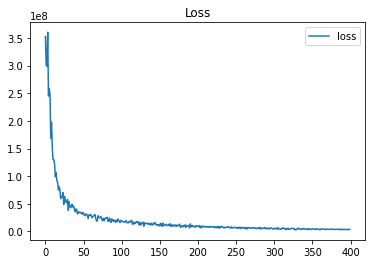

done 10 layers in 88.13ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1343.80957606]


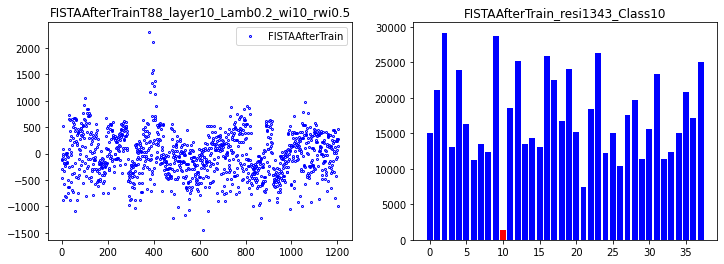

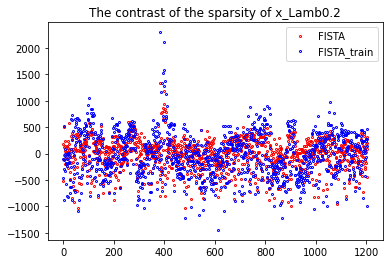

69
done 10 layers in 90.11ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[9009.93165632]


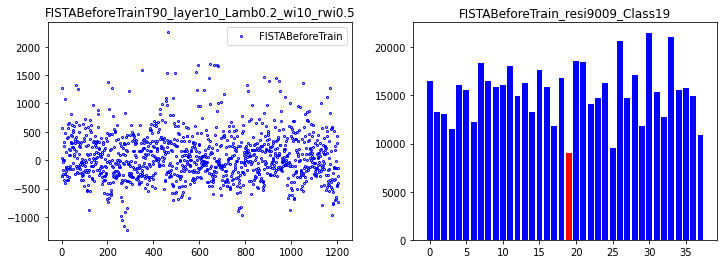

correct rate: 0.625
correct rate: 0.625
correct rate: 0.625
correct rate: 0.5625
Epoch [ 10/100]: loss = 48727929.5353,   lambda [max:0.2473], [min:0.1625], 
Epoch [ 20/100]: loss = 20433836.1263,   lambda [max:0.2566], [min:0.1390], 
Epoch [ 30/100]: loss = 12982958.6623,   lambda [max:0.2587], [min:0.1234], 
Epoch [ 40/100]: loss = 12547284.4647,   lambda [max:0.2624], [min:0.1120], 
Epoch [ 50/100]: loss = 7828427.5280,   lambda [max:0.2681], [min:0.1030], 
Epoch [ 60/100]: loss = 6440718.1893,   lambda [max:0.2726], [min:0.0955], 
Epoch [ 70/100]: loss = 5892398.7749,   lambda [max:0.2757], [min:0.0894], 
Epoch [ 80/100]: loss = 4458215.2038,   lambda [max:0.2771], [min:0.0837], 
Epoch [ 90/100]: loss = 4775076.9349,   lambda [max:0.2779], [min:0.0791], 
correct rate: 0.78125
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.5
Epoch [100/100]: loss = 4533154.9303,   lambda [max:0.2788], [min:0.0753], 


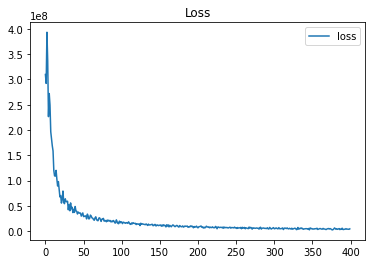

done 10 layers in 86.31ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[2792.52436648]


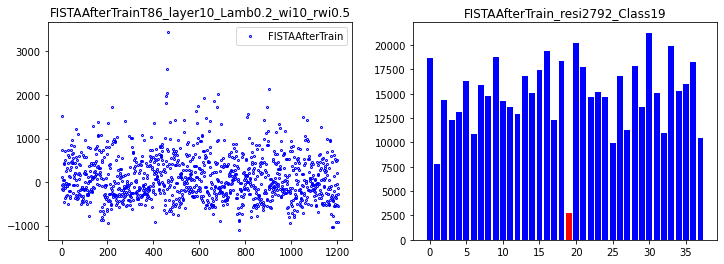

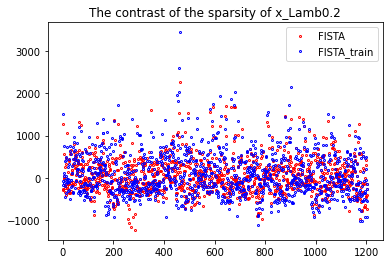

70
done 5 layers in 81.74ms
predict class: yaleB05
test image label: yaleB36
predict residuals label: 4
test residuals label: 34
[16737.71593264]


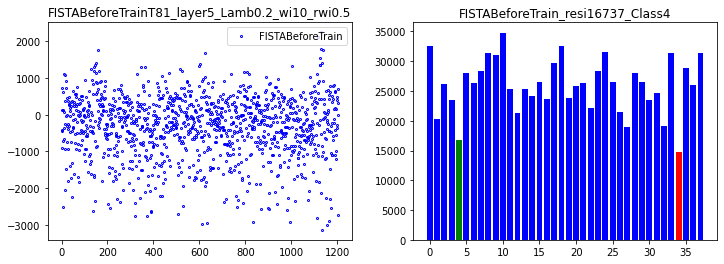

correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.375
correct rate: 0.5
Epoch [ 10/100]: loss = 48970481.9829,   lambda [max:0.2444], [min:0.1619], 
Epoch [ 20/100]: loss = 23875676.4542,   lambda [max:0.2517], [min:0.1488], 
Epoch [ 30/100]: loss = 21240387.9092,   lambda [max:0.2566], [min:0.1435], 
Epoch [ 40/100]: loss = 16261883.9719,   lambda [max:0.2586], [min:0.1416], 
Epoch [ 50/100]: loss = 16148727.3465,   lambda [max:0.2626], [min:0.1404], 
Epoch [ 60/100]: loss = 9373112.8377,   lambda [max:0.2634], [min:0.1364], 
Epoch [ 70/100]: loss = 8270817.5441,   lambda [max:0.2662], [min:0.1322], 
Epoch [ 80/100]: loss = 6923775.2048,   lambda [max:0.2690], [min:0.1281], 
Epoch [ 90/100]: loss = 6577806.7873,   lambda [max:0.2704], [min:0.1255], 
correct rate: 0.25
correct rate: 0.34375
correct rate: 0.21875
correct rate: 0.375
Epoch [100/100]: loss = 5760959.2797,   lambda [max:0.2728], [min:0.1230], 


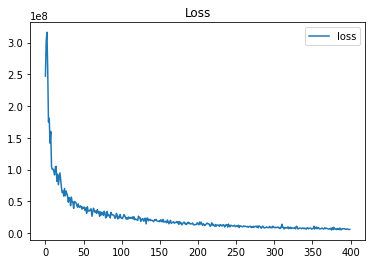

done 5 layers in 82.09ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[1267.13293194]


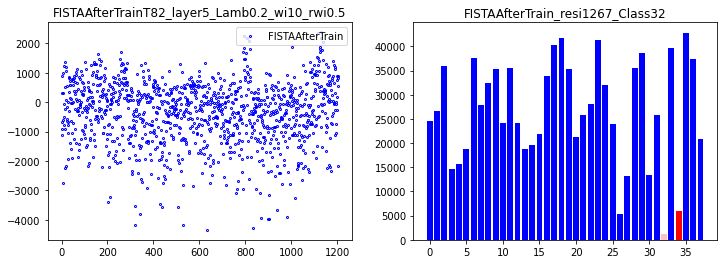

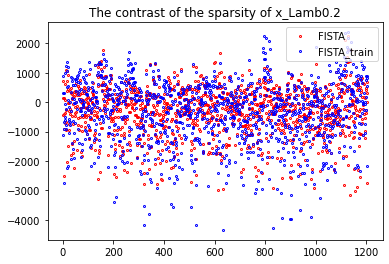

71
done 5 layers in 76.97ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[4445.81503993]


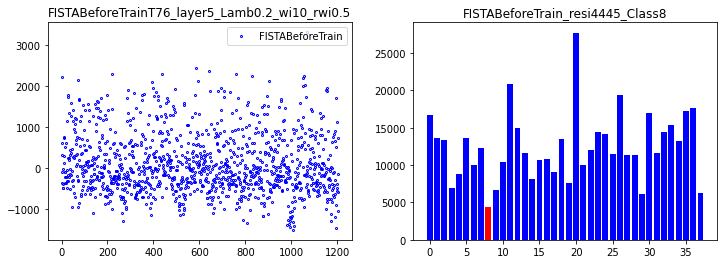

correct rate: 0.46875
correct rate: 0.3125
correct rate: 0.375
correct rate: 0.5625
Epoch [ 10/100]: loss = 38296639.1980,   lambda [max:0.2407], [min:0.1683], 
Epoch [ 20/100]: loss = 28570678.1116,   lambda [max:0.2534], [min:0.1631], 
Epoch [ 30/100]: loss = 22144699.7386,   lambda [max:0.2622], [min:0.1545], 
Epoch [ 40/100]: loss = 14142763.6385,   lambda [max:0.2685], [min:0.1493], 
Epoch [ 50/100]: loss = 14168276.9835,   lambda [max:0.2738], [min:0.1477], 
Epoch [ 60/100]: loss = 12027873.0065,   lambda [max:0.2765], [min:0.1455], 
Epoch [ 70/100]: loss = 10097543.7411,   lambda [max:0.2787], [min:0.1449], 
Epoch [ 80/100]: loss = 12549695.0683,   lambda [max:0.2847], [min:0.1439], 
Epoch [ 90/100]: loss = 6359428.6527,   lambda [max:0.2856], [min:0.1444], 
correct rate: 0.15625
correct rate: 0.375
correct rate: 0.28125
correct rate: 0.28125
Epoch [100/100]: loss = 5949745.2618,   lambda [max:0.2904], [min:0.1443], 


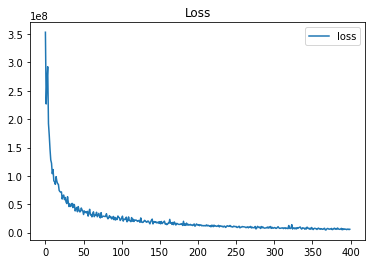

done 5 layers in 82.72ms
predict class: yaleB39
test image label: yaleB09
predict residuals label: 37
test residuals label: 8
[4505.77257354]


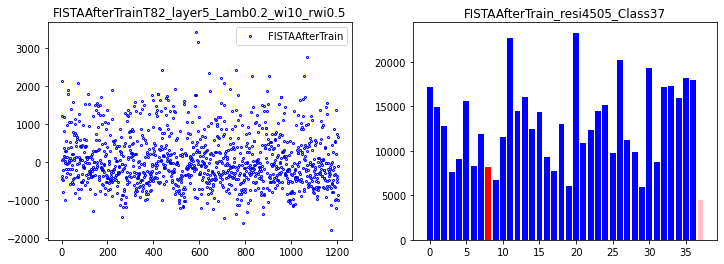

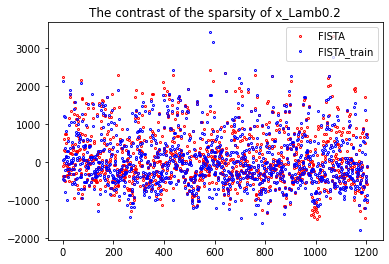

72
done 5 layers in 91.35ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4656.14716689]


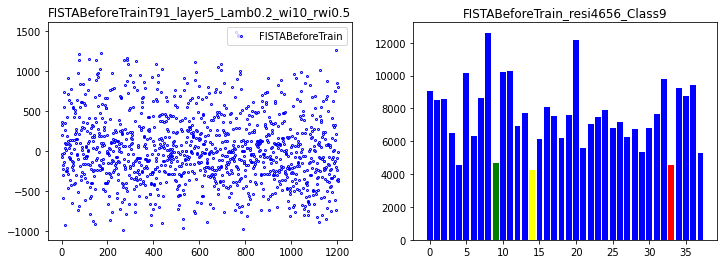

correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.5
correct rate: 0.34375
Epoch [ 10/100]: loss = 44162686.7745,   lambda [max:0.2445], [min:0.1620], 
Epoch [ 20/100]: loss = 21612190.0704,   lambda [max:0.2479], [min:0.1603], 
Epoch [ 30/100]: loss = 21083949.5606,   lambda [max:0.2532], [min:0.1566], 
Epoch [ 40/100]: loss = 17962867.2776,   lambda [max:0.2562], [min:0.1535], 
Epoch [ 50/100]: loss = 17766713.9661,   lambda [max:0.2634], [min:0.1513], 
Epoch [ 60/100]: loss = 13550537.7078,   lambda [max:0.2664], [min:0.1449], 
Epoch [ 70/100]: loss = 9964902.3107,   lambda [max:0.2695], [min:0.1371], 
Epoch [ 80/100]: loss = 7757012.2200,   lambda [max:0.2719], [min:0.1320], 
Epoch [ 90/100]: loss = 7826362.2538,   lambda [max:0.2751], [min:0.1289], 
correct rate: 0.25
correct rate: 0.28125
correct rate: 0.34375
correct rate: 0.3125
Epoch [100/100]: loss = 7853387.3927,   lambda [max:0.2761], [min:0.1275], 


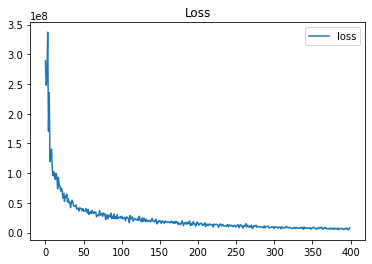

done 5 layers in 82.90ms
predict class: yaleB16
test image label: yaleB35
predict residuals label: 14
test residuals label: 33
[3698.97037784]


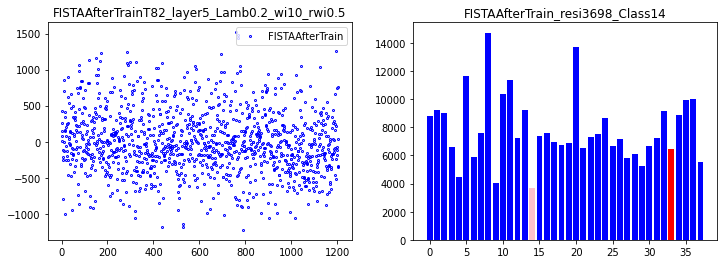

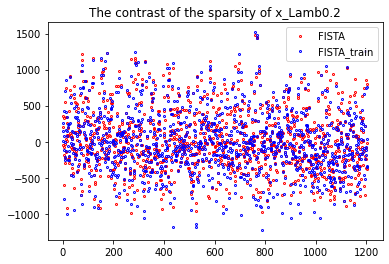

73
done 5 layers in 83.05ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[4966.88562122]


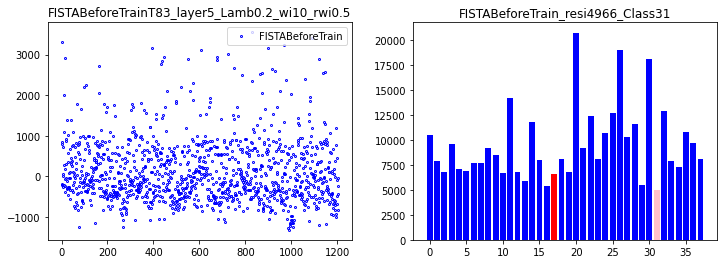

correct rate: 0.53125
correct rate: 0.34375
correct rate: 0.40625
correct rate: 0.46875
Epoch [ 10/100]: loss = 48565011.5843,   lambda [max:0.2413], [min:0.1729], 
Epoch [ 20/100]: loss = 33849687.3388,   lambda [max:0.2556], [min:0.1664], 
Epoch [ 30/100]: loss = 21295527.0405,   lambda [max:0.2583], [min:0.1591], 
Epoch [ 40/100]: loss = 17712086.0847,   lambda [max:0.2595], [min:0.1533], 
Epoch [ 50/100]: loss = 13031440.9233,   lambda [max:0.2616], [min:0.1484], 
Epoch [ 60/100]: loss = 10632117.2660,   lambda [max:0.2648], [min:0.1379], 
Epoch [ 70/100]: loss = 9072033.7925,   lambda [max:0.2701], [min:0.1331], 
Epoch [ 80/100]: loss = 6239806.2904,   lambda [max:0.2735], [min:0.1297], 
Epoch [ 90/100]: loss = 8078468.0886,   lambda [max:0.2751], [min:0.1277], 
correct rate: 0.25
correct rate: 0.21875
correct rate: 0.3125
correct rate: 0.3125
Epoch [100/100]: loss = 6277108.5866,   lambda [max:0.2761], [min:0.1252], 


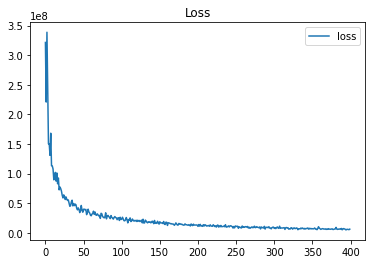

done 5 layers in 83.60ms
predict class: yaleB13
test image label: yaleB19
predict residuals label: 12
test residuals label: 17
[4642.68489289]


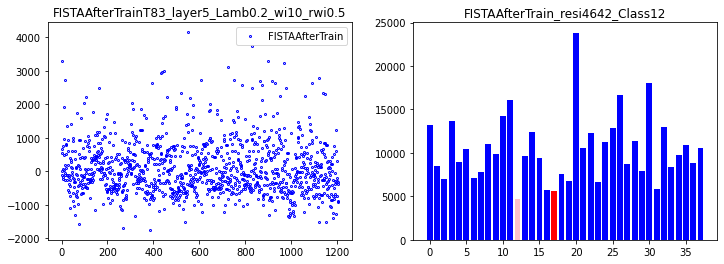

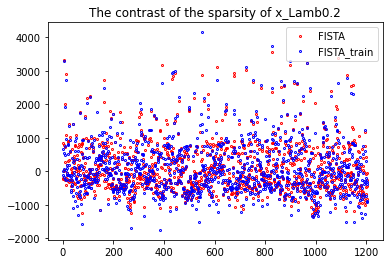

74
done 5 layers in 84.99ms
predict class: yaleB11
test image label: yaleB27
predict residuals label: 10
test residuals label: 25
[5465.57805095]


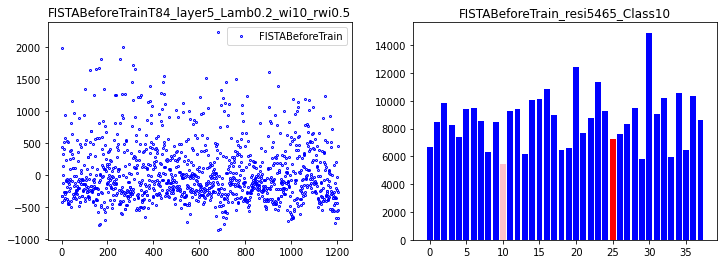

correct rate: 0.375
correct rate: 0.40625
correct rate: 0.53125
correct rate: 0.40625
Epoch [ 10/100]: loss = 43147470.2090,   lambda [max:0.2369], [min:0.1614], 
Epoch [ 20/100]: loss = 31261789.5286,   lambda [max:0.2583], [min:0.1586], 
Epoch [ 30/100]: loss = 20618830.6420,   lambda [max:0.2730], [min:0.1544], 
Epoch [ 40/100]: loss = 19733805.9139,   lambda [max:0.2799], [min:0.1465], 
Epoch [ 50/100]: loss = 14492476.6371,   lambda [max:0.2841], [min:0.1415], 
Epoch [ 60/100]: loss = 13720334.0476,   lambda [max:0.2881], [min:0.1372], 
Epoch [ 70/100]: loss = 9719015.6389,   lambda [max:0.2904], [min:0.1333], 
Epoch [ 80/100]: loss = 9370601.5021,   lambda [max:0.2924], [min:0.1315], 
Epoch [ 90/100]: loss = 8627414.7630,   lambda [max:0.2933], [min:0.1305], 
correct rate: 0.1875
correct rate: 0.25
correct rate: 0.28125
correct rate: 0.3125
Epoch [100/100]: loss = 5955409.6072,   lambda [max:0.2941], [min:0.1287], 


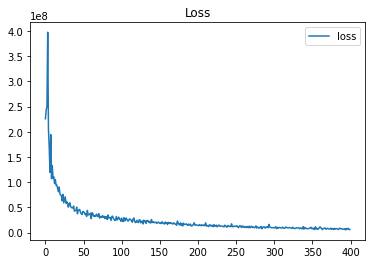

done 5 layers in 88.96ms
predict class: yaleB09
test image label: yaleB27
predict residuals label: 8
test residuals label: 25
[3291.26454191]


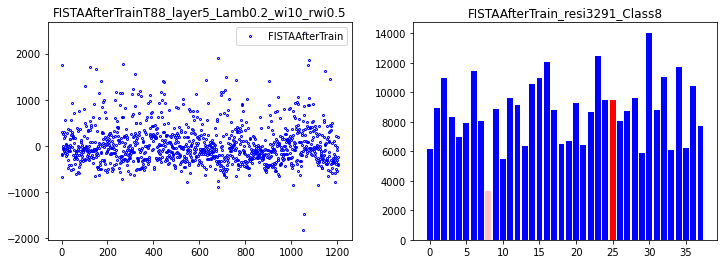

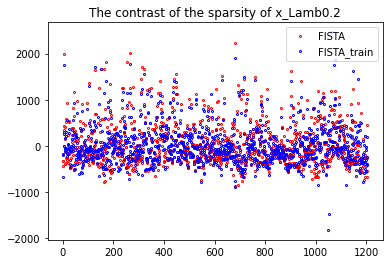

75
done 5 layers in 83.72ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[7226.71541855]


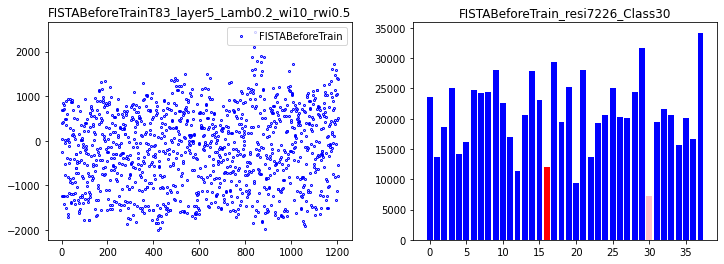

correct rate: 0.46875
correct rate: 0.5
correct rate: 0.34375
correct rate: 0.4375
Epoch [ 10/100]: loss = 40913754.5741,   lambda [max:0.2405], [min:0.1603], 
Epoch [ 20/100]: loss = 28843460.3414,   lambda [max:0.2504], [min:0.1572], 
Epoch [ 30/100]: loss = 19939336.2641,   lambda [max:0.2558], [min:0.1515], 
Epoch [ 40/100]: loss = 16645569.2286,   lambda [max:0.2615], [min:0.1410], 
Epoch [ 50/100]: loss = 12393400.1929,   lambda [max:0.2666], [min:0.1331], 
Epoch [ 60/100]: loss = 14455349.6582,   lambda [max:0.2690], [min:0.1275], 
Epoch [ 70/100]: loss = 9766252.4001,   lambda [max:0.2724], [min:0.1257], 
Epoch [ 80/100]: loss = 8511163.7910,   lambda [max:0.2724], [min:0.1250], 
Epoch [ 90/100]: loss = 7200965.3696,   lambda [max:0.2747], [min:0.1255], 
correct rate: 0.21875
correct rate: 0.21875
correct rate: 0.3125
correct rate: 0.375
Epoch [100/100]: loss = 7138653.5846,   lambda [max:0.2756], [min:0.1261], 


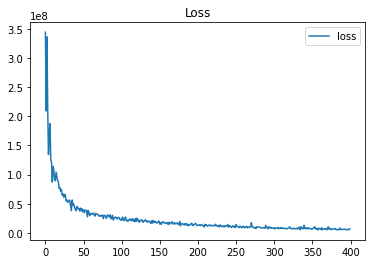

done 5 layers in 107.20ms
predict class: yaleB22
test image label: yaleB18
predict residuals label: 20
test residuals label: 16
[821.69061822]


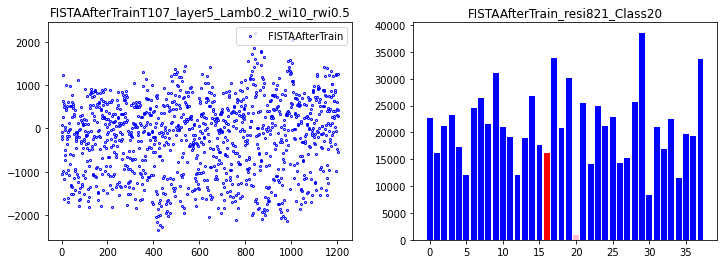

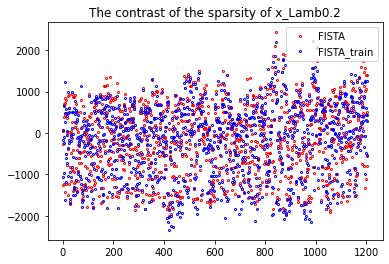

76
done 5 layers in 87.04ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[16822.34600901]


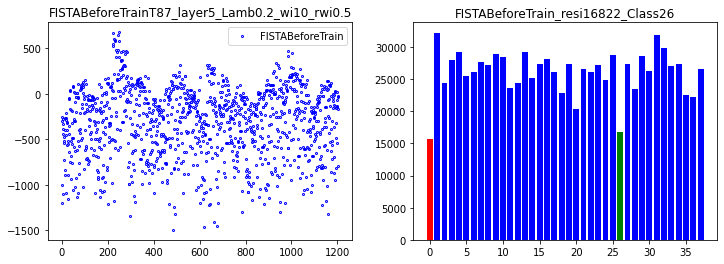

correct rate: 0.46875
correct rate: 0.53125
correct rate: 0.40625
correct rate: 0.28125
Epoch [ 10/100]: loss = 49465132.9910,   lambda [max:0.2392], [min:0.1612], 
Epoch [ 20/100]: loss = 35816212.2871,   lambda [max:0.2468], [min:0.1559], 
Epoch [ 30/100]: loss = 23365723.2902,   lambda [max:0.2493], [min:0.1445], 
Epoch [ 40/100]: loss = 20931223.8037,   lambda [max:0.2510], [min:0.1387], 
Epoch [ 50/100]: loss = 15028726.5217,   lambda [max:0.2550], [min:0.1351], 
Epoch [ 60/100]: loss = 12832668.4564,   lambda [max:0.2575], [min:0.1329], 
Epoch [ 70/100]: loss = 11693033.8823,   lambda [max:0.2589], [min:0.1315], 
Epoch [ 80/100]: loss = 9729810.4072,   lambda [max:0.2613], [min:0.1312], 
Epoch [ 90/100]: loss = 8311107.1248,   lambda [max:0.2623], [min:0.1304], 
correct rate: 0.25
correct rate: 0.375
correct rate: 0.25
correct rate: 0.1875
Epoch [100/100]: loss = 8007113.9436,   lambda [max:0.2639], [min:0.1309], 


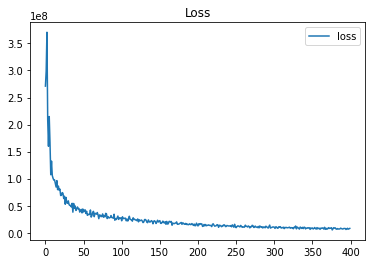

done 5 layers in 83.89ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[2097.93348111]


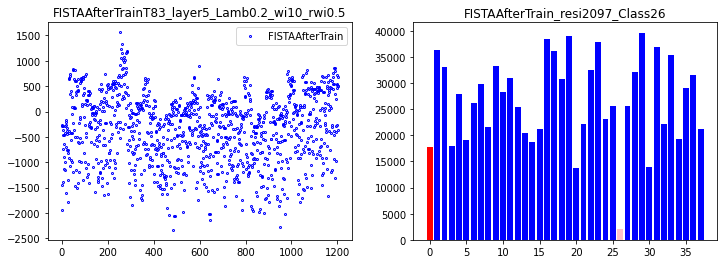

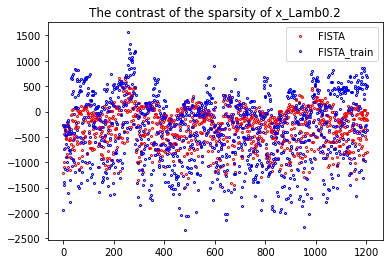

77
done 5 layers in 81.75ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[5129.02896833]


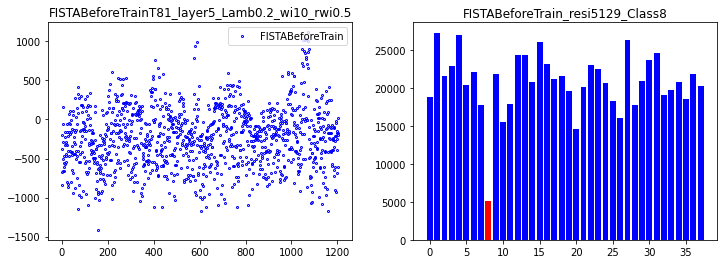

correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.4375
correct rate: 0.4375
Epoch [ 10/100]: loss = 46065101.7762,   lambda [max:0.2393], [min:0.1726], 
Epoch [ 20/100]: loss = 29948582.9452,   lambda [max:0.2493], [min:0.1646], 
Epoch [ 30/100]: loss = 23686385.1518,   lambda [max:0.2551], [min:0.1559], 
Epoch [ 40/100]: loss = 17297870.9012,   lambda [max:0.2597], [min:0.1501], 
Epoch [ 50/100]: loss = 16486882.3688,   lambda [max:0.2634], [min:0.1443], 
Epoch [ 60/100]: loss = 11393043.5736,   lambda [max:0.2647], [min:0.1405], 
Epoch [ 70/100]: loss = 9448580.0081,   lambda [max:0.2690], [min:0.1370], 
Epoch [ 80/100]: loss = 10827752.3279,   lambda [max:0.2729], [min:0.1353], 
Epoch [ 90/100]: loss = 7165254.9934,   lambda [max:0.2776], [min:0.1338], 
correct rate: 0.3125
correct rate: 0.15625
correct rate: 0.34375
correct rate: 0.28125
Epoch [100/100]: loss = 6942957.8826,   lambda [max:0.2786], [min:0.1326], 


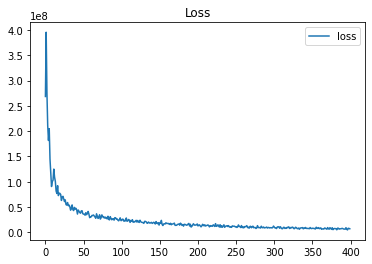

done 5 layers in 82.77ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1907.83194292]


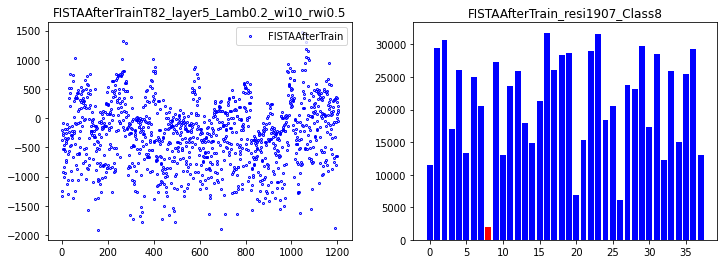

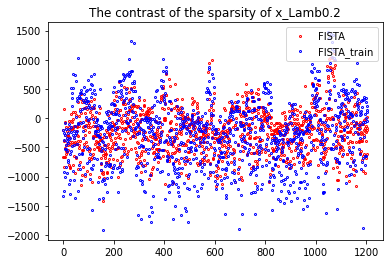

78
done 5 layers in 82.11ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[15796.90633677]


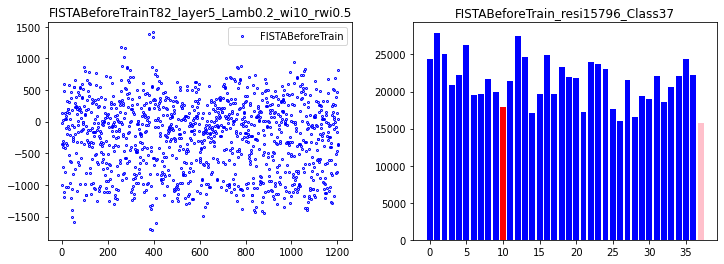

correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.40625
correct rate: 0.46875
Epoch [ 10/100]: loss = 46272533.4762,   lambda [max:0.2419], [min:0.1695], 
Epoch [ 20/100]: loss = 29122052.1343,   lambda [max:0.2546], [min:0.1574], 
Epoch [ 30/100]: loss = 21055722.6873,   lambda [max:0.2617], [min:0.1490], 
Epoch [ 40/100]: loss = 16321187.1797,   lambda [max:0.2673], [min:0.1405], 
Epoch [ 50/100]: loss = 14163702.6858,   lambda [max:0.2711], [min:0.1347], 
Epoch [ 60/100]: loss = 8522001.5387,   lambda [max:0.2730], [min:0.1303], 
Epoch [ 70/100]: loss = 12146158.4511,   lambda [max:0.2802], [min:0.1282], 
Epoch [ 80/100]: loss = 6729305.0012,   lambda [max:0.2849], [min:0.1262], 
Epoch [ 90/100]: loss = 7315459.2178,   lambda [max:0.2886], [min:0.1248], 
correct rate: 0.28125
correct rate: 0.1875
correct rate: 0.3125
correct rate: 0.34375
Epoch [100/100]: loss = 5897054.6501,   lambda [max:0.2922], [min:0.1229], 


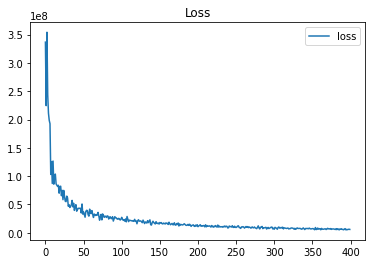

done 5 layers in 78.02ms
predict class: yaleB28
test image label: yaleB11
predict residuals label: 26
test residuals label: 10
[2128.29401886]


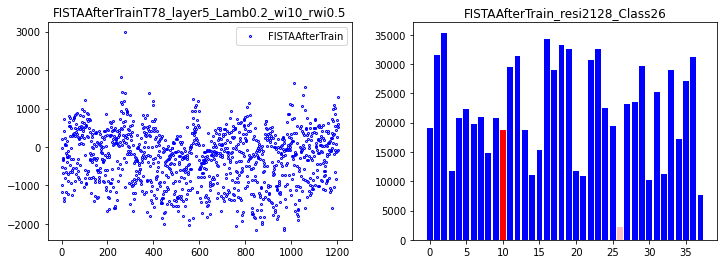

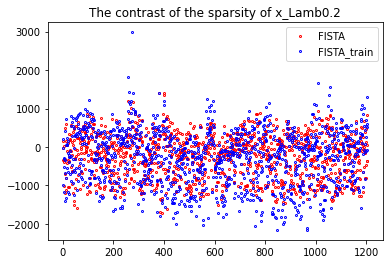

79
done 5 layers in 88.04ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[4730.73330457]


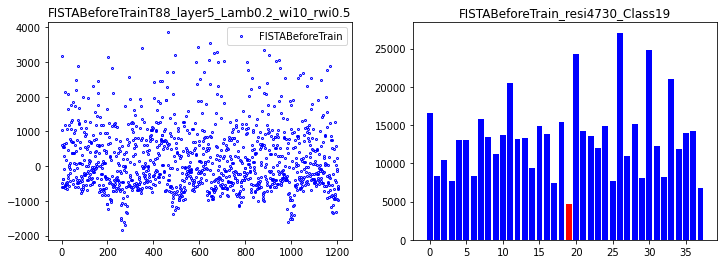

correct rate: 0.53125
correct rate: 0.375
correct rate: 0.40625
correct rate: 0.34375
Epoch [ 10/100]: loss = 46607876.9151,   lambda [max:0.2424], [min:0.1615], 
Epoch [ 20/100]: loss = 30081206.0058,   lambda [max:0.2571], [min:0.1596], 
Epoch [ 30/100]: loss = 18375449.9176,   lambda [max:0.2631], [min:0.1564], 
Epoch [ 40/100]: loss = 16829310.6601,   lambda [max:0.2661], [min:0.1526], 
Epoch [ 50/100]: loss = 15453701.7195,   lambda [max:0.2722], [min:0.1513], 
Epoch [ 60/100]: loss = 11083380.7061,   lambda [max:0.2774], [min:0.1455], 
Epoch [ 70/100]: loss = 10174955.1974,   lambda [max:0.2797], [min:0.1425], 
Epoch [ 80/100]: loss = 10416014.9990,   lambda [max:0.2837], [min:0.1403], 
Epoch [ 90/100]: loss = 6114050.3525,   lambda [max:0.2847], [min:0.1391], 
correct rate: 0.21875
correct rate: 0.21875
correct rate: 0.25
correct rate: 0.34375
Epoch [100/100]: loss = 5783823.9625,   lambda [max:0.2854], [min:0.1389], 


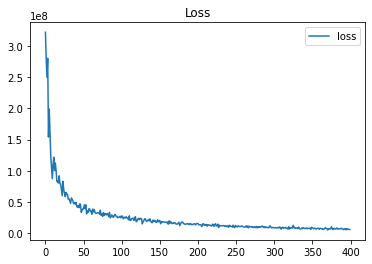

done 5 layers in 81.23ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[6822.36937614]


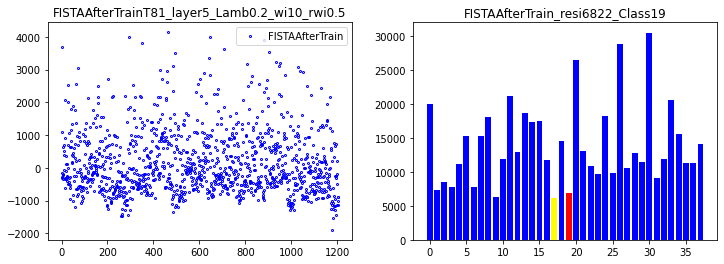

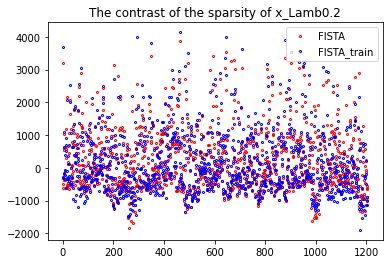

80
done 1 layers in 74.70ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[165030.03702222]


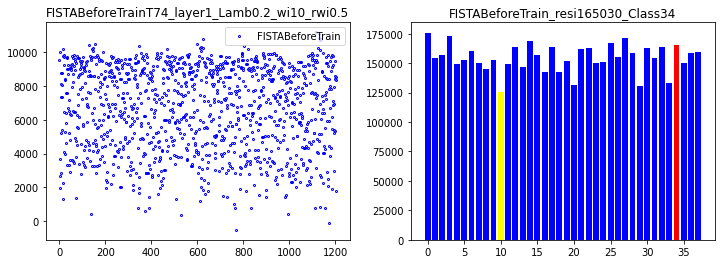

correct rate: 0.5625
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.625
Epoch [ 10/100]: loss = 1048231686.7155,   lambda [max:0.2629], [min:0.1681], 
Epoch [ 20/100]: loss = 350419645.9690,   lambda [max:0.3028], [min:0.1659], 
Epoch [ 30/100]: loss = 269786808.4927,   lambda [max:0.3351], [min:0.1654], 
Epoch [ 40/100]: loss = 220730647.5731,   lambda [max:0.3637], [min:0.1658], 
Epoch [ 50/100]: loss = 128274925.5596,   lambda [max:0.3898], [min:0.1661], 
Epoch [ 60/100]: loss = 164820240.4509,   lambda [max:0.4140], [min:0.1663], 
Epoch [ 70/100]: loss = 100213413.4029,   lambda [max:0.4369], [min:0.1670], 
Epoch [ 80/100]: loss = 74563875.5962,   lambda [max:0.4586], [min:0.1671], 
Epoch [ 90/100]: loss = 84846133.7687,   lambda [max:0.4794], [min:0.1675], 
correct rate: 0.09375
correct rate: 0.09375
correct rate: 0.0625
correct rate: 0.09375
Epoch [100/100]: loss = 90531776.7415,   lambda [max:0.4994], [min:0.1677], 


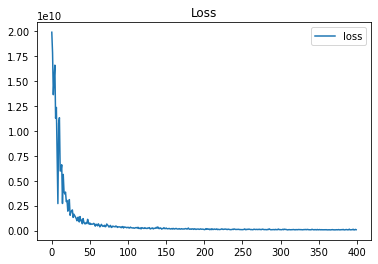

done 1 layers in 81.53ms
predict class: yaleB11
test image label: yaleB36
predict residuals label: 10
test residuals label: 34
[6201.5666844]


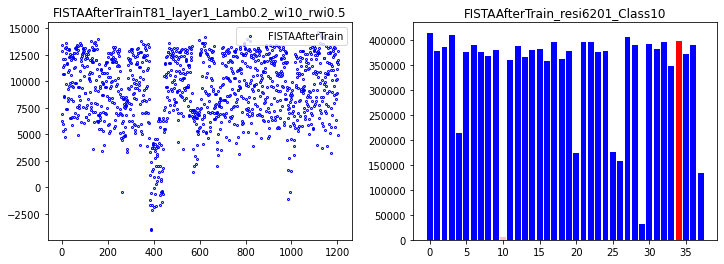

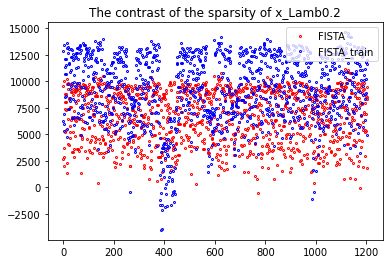

81
done 1 layers in 76.75ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[55240.64813281]


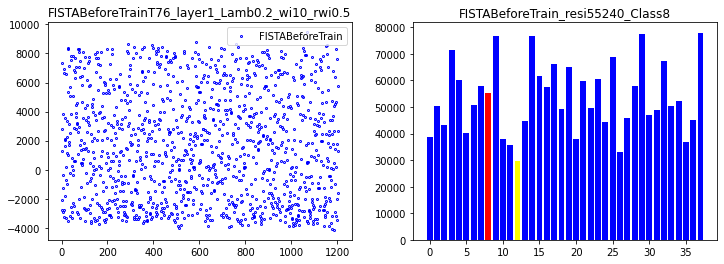

correct rate: 0.75
correct rate: 0.46875
correct rate: 0.625
correct rate: 0.65625
Epoch [ 10/100]: loss = 1203012333.6889,   lambda [max:0.2628], [min:0.1692], 
Epoch [ 20/100]: loss = 284322076.6497,   lambda [max:0.3029], [min:0.1694], 
Epoch [ 30/100]: loss = 315138612.0532,   lambda [max:0.3354], [min:0.1690], 
Epoch [ 40/100]: loss = 167882533.4261,   lambda [max:0.3642], [min:0.1696], 
Epoch [ 50/100]: loss = 171988011.1926,   lambda [max:0.3903], [min:0.1701], 
Epoch [ 60/100]: loss = 121505682.2338,   lambda [max:0.4146], [min:0.1706], 
Epoch [ 70/100]: loss = 111197554.4804,   lambda [max:0.4376], [min:0.1709], 
Epoch [ 80/100]: loss = 88201659.2042,   lambda [max:0.4593], [min:0.1705], 
Epoch [ 90/100]: loss = 89850203.9291,   lambda [max:0.4801], [min:0.1702], 
correct rate: 0.0
correct rate: 0.125
correct rate: 0.03125
correct rate: 0.125
Epoch [100/100]: loss = 92392435.7558,   lambda [max:0.5001], [min:0.1712], 


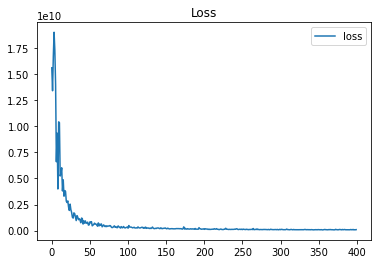

done 1 layers in 72.40ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[77888.57381959]


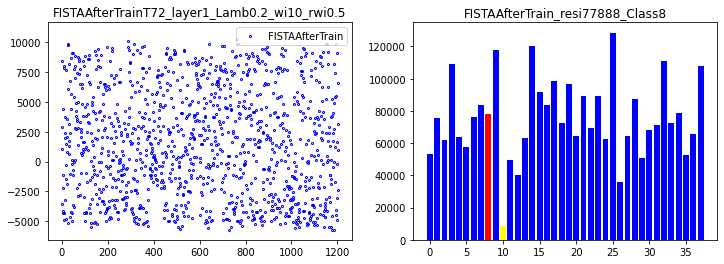

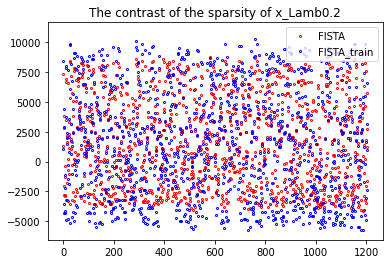

82
done 1 layers in 75.43ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[46018.76226547]


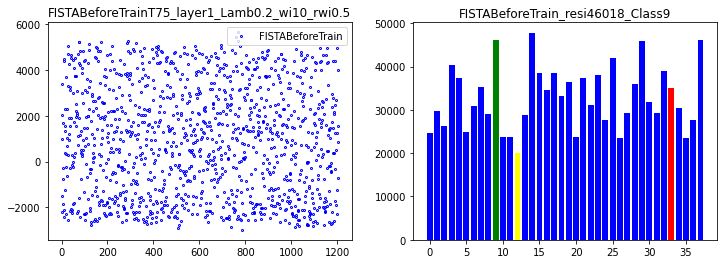

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.59375
Epoch [ 10/100]: loss = 1236813310.6674,   lambda [max:0.2628], [min:0.1788], 
Epoch [ 20/100]: loss = 285852892.7704,   lambda [max:0.3028], [min:0.1795], 
Epoch [ 30/100]: loss = 294770129.2193,   lambda [max:0.3352], [min:0.1800], 
Epoch [ 40/100]: loss = 250536698.6790,   lambda [max:0.3637], [min:0.1803], 
Epoch [ 50/100]: loss = 113435728.0777,   lambda [max:0.3898], [min:0.1803], 
Epoch [ 60/100]: loss = 101315592.4879,   lambda [max:0.4140], [min:0.1803], 
Epoch [ 70/100]: loss = 97447970.0479,   lambda [max:0.4369], [min:0.1803], 
Epoch [ 80/100]: loss = 88053141.4372,   lambda [max:0.4586], [min:0.1803], 
Epoch [ 90/100]: loss = 79337286.3870,   lambda [max:0.4794], [min:0.1804], 
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.09375
correct rate: 0.0625
Epoch [100/100]: loss = 86427784.0617,   lambda [max:0.4994], [min:0.1804], 


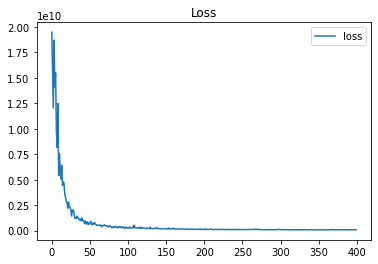

done 1 layers in 76.95ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[48865.49783528]


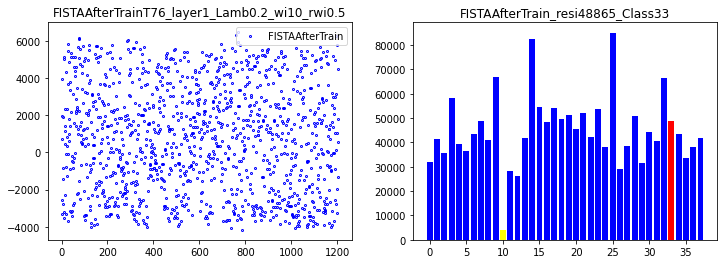

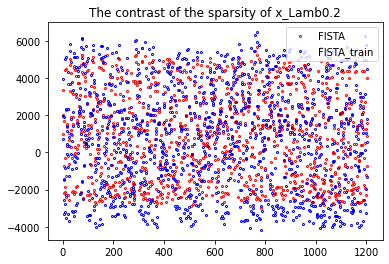

83
done 1 layers in 79.18ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[27569.91323808]


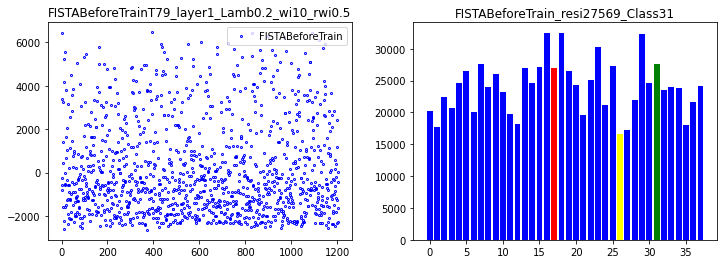

correct rate: 0.5625
correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.65625
Epoch [ 10/100]: loss = 731314338.7606,   lambda [max:0.2630], [min:0.1678], 
Epoch [ 20/100]: loss = 335336097.8787,   lambda [max:0.3033], [min:0.1694], 
Epoch [ 30/100]: loss = 224191582.7009,   lambda [max:0.3358], [min:0.1692], 
Epoch [ 40/100]: loss = 162723544.0519,   lambda [max:0.3646], [min:0.1663], 
Epoch [ 50/100]: loss = 146262017.0159,   lambda [max:0.3907], [min:0.1629], 
Epoch [ 60/100]: loss = 160482236.4769,   lambda [max:0.4150], [min:0.1614], 
Epoch [ 70/100]: loss = 121016686.2477,   lambda [max:0.4379], [min:0.1609], 
Epoch [ 80/100]: loss = 112929651.6277,   lambda [max:0.4596], [min:0.1587], 
Epoch [ 90/100]: loss = 151528220.8754,   lambda [max:0.4803], [min:0.1578], 
correct rate: 0.0625
correct rate: 0.0
correct rate: 0.09375
correct rate: 0.03125
Epoch [100/100]: loss = 83090213.4685,   lambda [max:0.5002], [min:0.1568], 


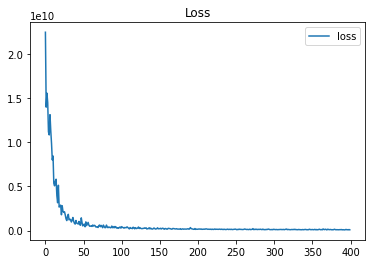

done 1 layers in 75.89ms
predict class: yaleB05
test image label: yaleB19
predict residuals label: 4
test residuals label: 17
[38565.92930279]


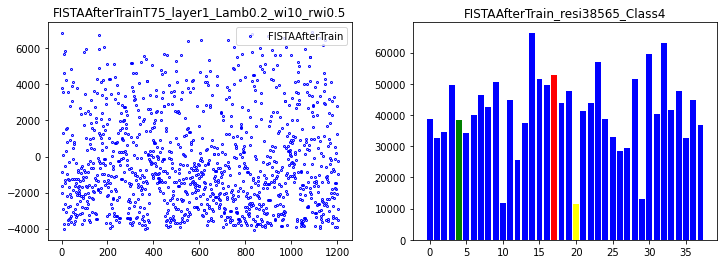

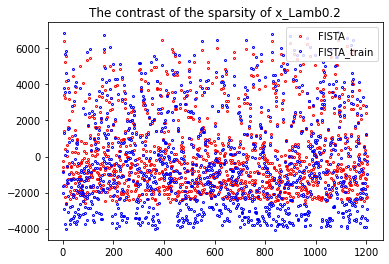

84
done 1 layers in 78.68ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[31029.64471825]


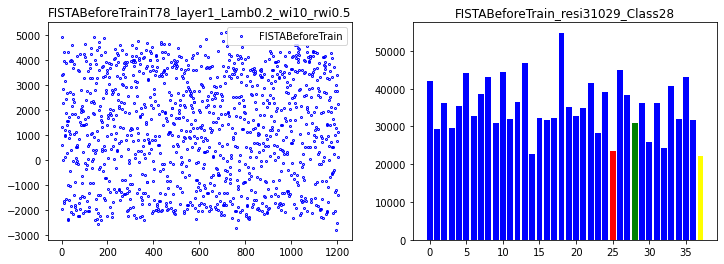

correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.5625
Epoch [ 10/100]: loss = 951109585.7878,   lambda [max:0.2629], [min:0.1715], 
Epoch [ 20/100]: loss = 390364977.5811,   lambda [max:0.3030], [min:0.1705], 
Epoch [ 30/100]: loss = 267548600.8034,   lambda [max:0.3355], [min:0.1702], 
Epoch [ 40/100]: loss = 196528899.4484,   lambda [max:0.3642], [min:0.1705], 
Epoch [ 50/100]: loss = 141628595.6761,   lambda [max:0.3904], [min:0.1704], 
Epoch [ 60/100]: loss = 112521278.9018,   lambda [max:0.4147], [min:0.1709], 
Epoch [ 70/100]: loss = 105773268.1361,   lambda [max:0.4376], [min:0.1711], 
Epoch [ 80/100]: loss = 139395054.8224,   lambda [max:0.4594], [min:0.1716], 
Epoch [ 90/100]: loss = 97147627.5702,   lambda [max:0.4802], [min:0.1724], 
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.125
Epoch [100/100]: loss = 96983680.3381,   lambda [max:0.5002], [min:0.1732], 


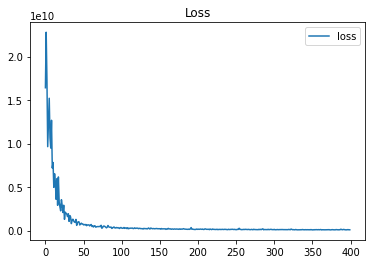

done 1 layers in 79.06ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[47220.88208215]


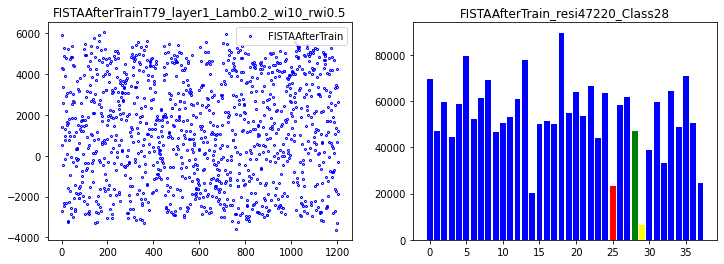

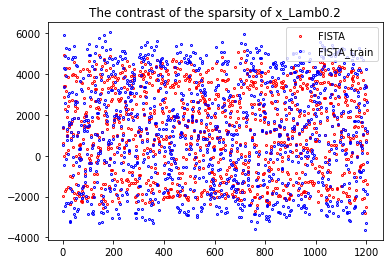

85
done 1 layers in 76.70ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[117197.32544141]


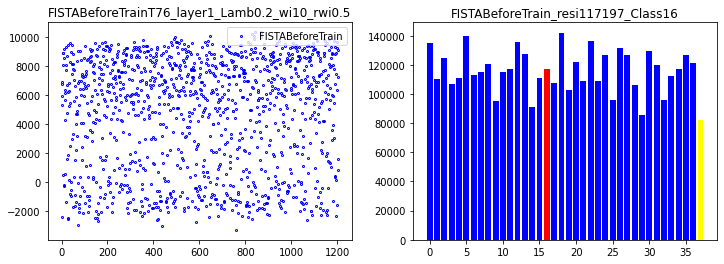

correct rate: 0.5
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.75
Epoch [ 10/100]: loss = 1396342091.8718,   lambda [max:0.2630], [min:0.1659], 
Epoch [ 20/100]: loss = 461660371.8697,   lambda [max:0.3031], [min:0.1609], 
Epoch [ 30/100]: loss = 223593115.2438,   lambda [max:0.3355], [min:0.1604], 
Epoch [ 40/100]: loss = 194576568.6946,   lambda [max:0.3640], [min:0.1586], 
Epoch [ 50/100]: loss = 148638567.9248,   lambda [max:0.3900], [min:0.1562], 
Epoch [ 60/100]: loss = 138322350.8161,   lambda [max:0.4142], [min:0.1534], 
Epoch [ 70/100]: loss = 113643660.5706,   lambda [max:0.4370], [min:0.1535], 
Epoch [ 80/100]: loss = 119447509.6371,   lambda [max:0.4586], [min:0.1524], 
Epoch [ 90/100]: loss = 123558398.4735,   lambda [max:0.4792], [min:0.1541], 
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.0625
Epoch [100/100]: loss = 75725901.4436,   lambda [max:0.4991], [min:0.1546], 


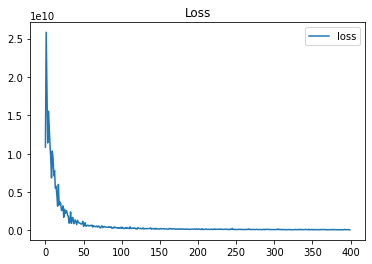

done 1 layers in 76.25ms
predict class: yaleB39
test image label: yaleB18
predict residuals label: 37
test residuals label: 16
[5751.64536331]


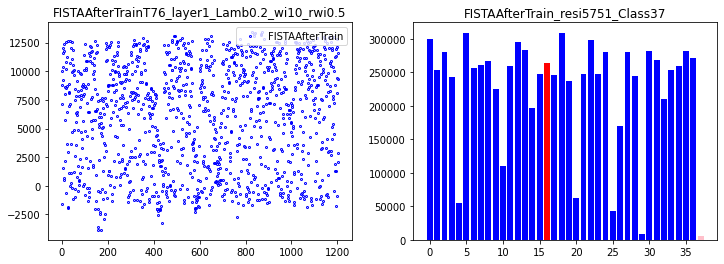

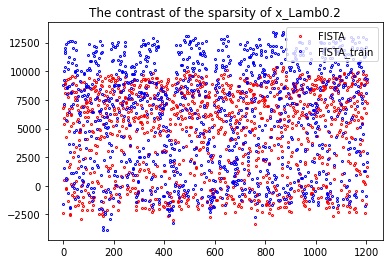

86
done 1 layers in 80.06ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[207823.21052799]


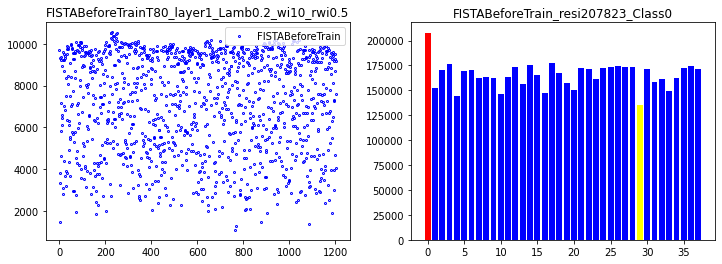

correct rate: 0.65625
correct rate: 0.625
correct rate: 0.5625
correct rate: 0.6875
Epoch [ 10/100]: loss = 1247510637.0895,   lambda [max:0.2630], [min:0.1694], 
Epoch [ 20/100]: loss = 460975975.1039,   lambda [max:0.3034], [min:0.1698], 
Epoch [ 30/100]: loss = 263735483.9080,   lambda [max:0.3362], [min:0.1704], 
Epoch [ 40/100]: loss = 203613028.1748,   lambda [max:0.3651], [min:0.1709], 
Epoch [ 50/100]: loss = 181402669.6407,   lambda [max:0.3914], [min:0.1714], 
Epoch [ 60/100]: loss = 139793027.2732,   lambda [max:0.4159], [min:0.1726], 
Epoch [ 70/100]: loss = 115882922.3465,   lambda [max:0.4388], [min:0.1741], 
Epoch [ 80/100]: loss = 91121279.3142,   lambda [max:0.4607], [min:0.1745], 
Epoch [ 90/100]: loss = 73294535.8044,   lambda [max:0.4815], [min:0.1738], 
correct rate: 0.125
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 71548815.6643,   lambda [max:0.5016], [min:0.1739], 


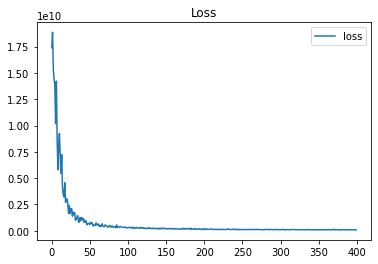

done 1 layers in 75.09ms
predict class: yaleB11
test image label: yaleB01
predict residuals label: 10
test residuals label: 0
[6224.68201776]


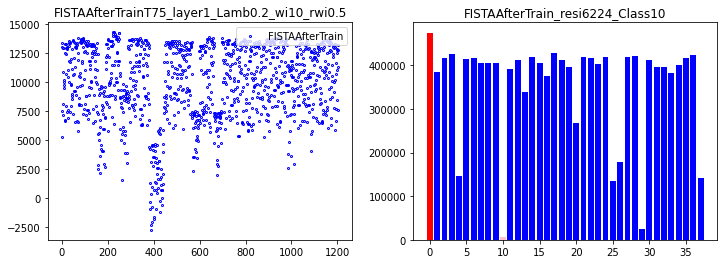

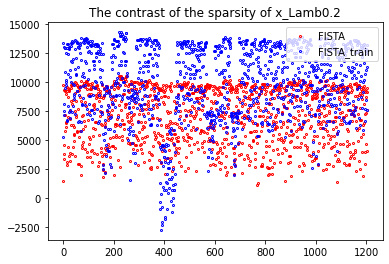

87
done 1 layers in 77.49ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[144025.71959696]


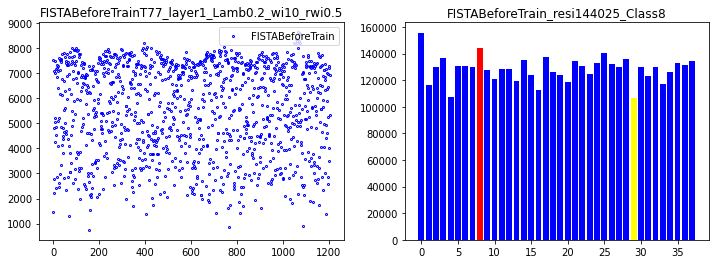

correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.59375
Epoch [ 10/100]: loss = 1254059177.1488,   lambda [max:0.2627], [min:0.1691], 
Epoch [ 20/100]: loss = 534894425.0199,   lambda [max:0.3025], [min:0.1703], 
Epoch [ 30/100]: loss = 329246107.9945,   lambda [max:0.3346], [min:0.1677], 
Epoch [ 40/100]: loss = 178316596.4095,   lambda [max:0.3630], [min:0.1666], 
Epoch [ 50/100]: loss = 195557159.0192,   lambda [max:0.3889], [min:0.1663], 
Epoch [ 60/100]: loss = 226373633.6036,   lambda [max:0.4130], [min:0.1657], 
Epoch [ 70/100]: loss = 121484546.7787,   lambda [max:0.4357], [min:0.1652], 
Epoch [ 80/100]: loss = 102018815.2943,   lambda [max:0.4572], [min:0.1648], 
Epoch [ 90/100]: loss = 94569732.3594,   lambda [max:0.4778], [min:0.1646], 
correct rate: 0.0625
correct rate: 0.125
correct rate: 0.0
correct rate: 0.03125
Epoch [100/100]: loss = 105178202.3862,   lambda [max:0.4976], [min:0.1641], 


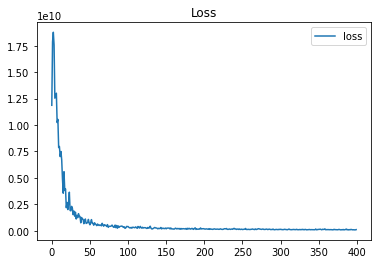

done 1 layers in 71.33ms
predict class: yaleB11
test image label: yaleB09
predict residuals label: 10
test residuals label: 8
[6320.29660262]


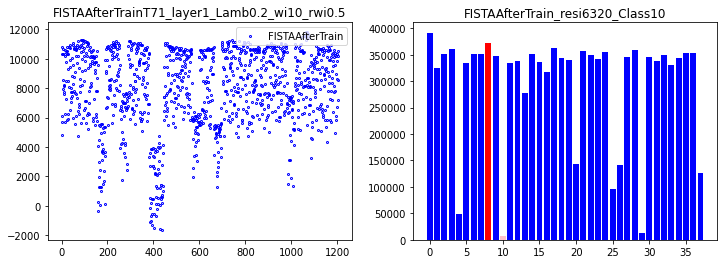

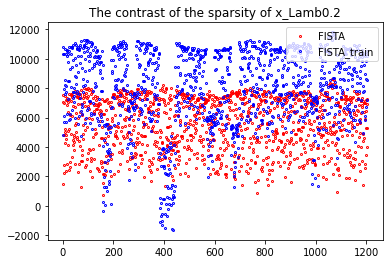

88
done 1 layers in 80.34ms
predict class: yaleB30
test image label: yaleB11
predict residuals label: 28
test residuals label: 10
[140785.93102603]


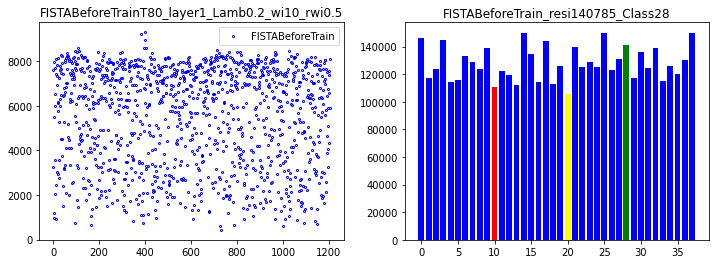

correct rate: 0.625
correct rate: 0.6875
correct rate: 0.5
correct rate: 0.625
Epoch [ 10/100]: loss = 1098368317.8857,   lambda [max:0.2630], [min:0.1679], 
Epoch [ 20/100]: loss = 334534165.1383,   lambda [max:0.3033], [min:0.1703], 
Epoch [ 30/100]: loss = 248220196.9428,   lambda [max:0.3360], [min:0.1723], 
Epoch [ 40/100]: loss = 256755676.7239,   lambda [max:0.3649], [min:0.1727], 
Epoch [ 50/100]: loss = 158161572.0017,   lambda [max:0.3911], [min:0.1722], 
Epoch [ 60/100]: loss = 148477354.5836,   lambda [max:0.4155], [min:0.1719], 
Epoch [ 70/100]: loss = 104725103.2664,   lambda [max:0.4385], [min:0.1718], 
Epoch [ 80/100]: loss = 108913298.4547,   lambda [max:0.4602], [min:0.1722], 
Epoch [ 90/100]: loss = 85507820.8326,   lambda [max:0.4811], [min:0.1722], 
correct rate: 0.03125
correct rate: 0.125
correct rate: 0.03125
correct rate: 0.0625
Epoch [100/100]: loss = 93762712.3993,   lambda [max:0.5011], [min:0.1725], 


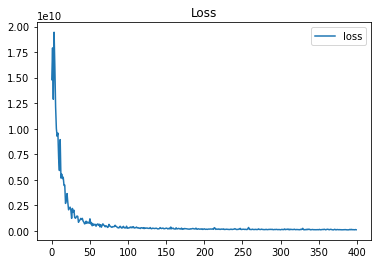

done 1 layers in 75.31ms
predict class: yaleB16
test image label: yaleB11
predict residuals label: 14
test residuals label: 10
[344111.44855085]


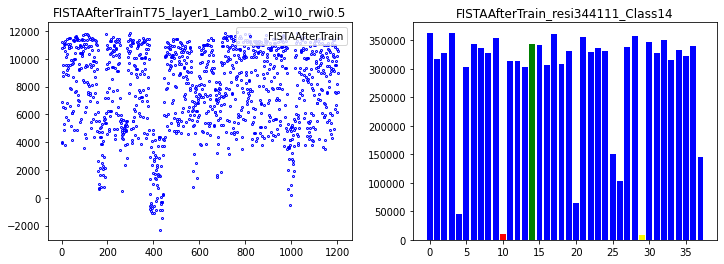

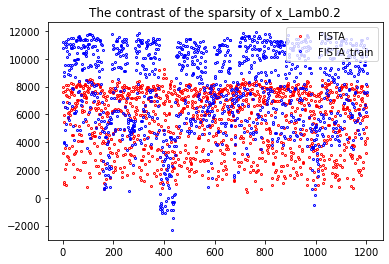

89
done 1 layers in 75.74ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[56893.9299482]


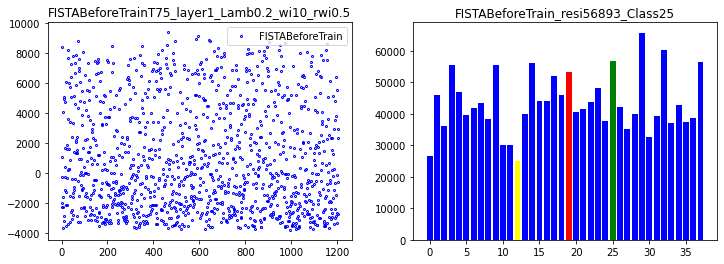

correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.53125
Epoch [ 10/100]: loss = 678440281.6448,   lambda [max:0.2630], [min:0.1650], 
Epoch [ 20/100]: loss = 459347168.2566,   lambda [max:0.3032], [min:0.1673], 
Epoch [ 30/100]: loss = 220239544.1599,   lambda [max:0.3358], [min:0.1689], 
Epoch [ 40/100]: loss = 150164751.1545,   lambda [max:0.3645], [min:0.1692], 
Epoch [ 50/100]: loss = 187585885.0178,   lambda [max:0.3906], [min:0.1707], 
Epoch [ 60/100]: loss = 140360374.5032,   lambda [max:0.4149], [min:0.1705], 
Epoch [ 70/100]: loss = 140940431.8760,   lambda [max:0.4377], [min:0.1720], 
Epoch [ 80/100]: loss = 116460471.3504,   lambda [max:0.4594], [min:0.1719], 
Epoch [ 90/100]: loss = 84134835.2406,   lambda [max:0.4801], [min:0.1721], 
correct rate: 0.15625
correct rate: 0.0
correct rate: 0.03125
correct rate: 0.125
Epoch [100/100]: loss = 99407398.7279,   lambda [max:0.5000], [min:0.1714], 


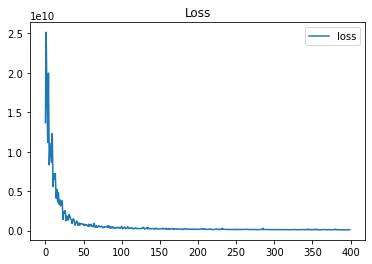

done 1 layers in 78.13ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[72670.76512009]


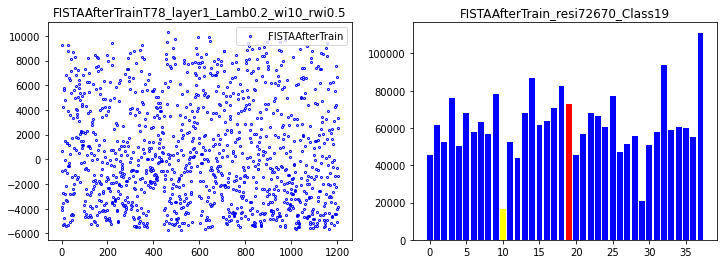

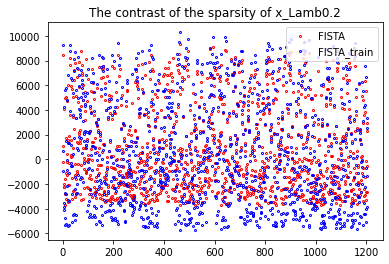

90
done 10 layers in 98.69ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[13941.38586987]


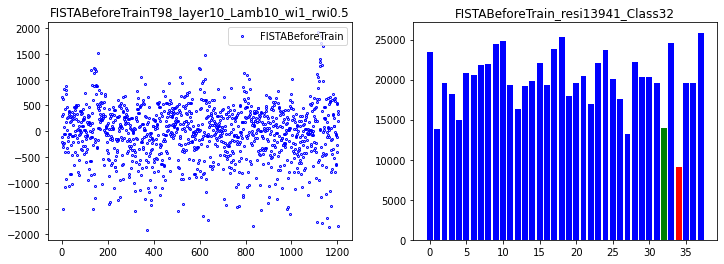

correct rate: 0.625
correct rate: 0.75
correct rate: 0.5
correct rate: 0.5625
Epoch [ 10/100]: loss = 59998621.1648,   lambda [max:10.0597], [min:9.9619], 
Epoch [ 20/100]: loss = 46986685.3313,   lambda [max:10.0943], [min:9.9426], 
Epoch [ 30/100]: loss = 34730834.9992,   lambda [max:10.1246], [min:9.9351], 
Epoch [ 40/100]: loss = 32167930.4421,   lambda [max:10.1515], [min:9.9292], 
Epoch [ 50/100]: loss = 27841055.3392,   lambda [max:10.1758], [min:9.9253], 
Epoch [ 60/100]: loss = 26986474.4180,   lambda [max:10.1988], [min:9.9225], 
Epoch [ 70/100]: loss = 21262857.7030,   lambda [max:10.2201], [min:9.9203], 
Epoch [ 80/100]: loss = 21062329.2944,   lambda [max:10.2393], [min:9.9191], 
Epoch [ 90/100]: loss = 20436192.1829,   lambda [max:10.2560], [min:9.9179], 
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.6875
Epoch [100/100]: loss = 18924907.0973,   lambda [max:10.2714], [min:9.9170], 


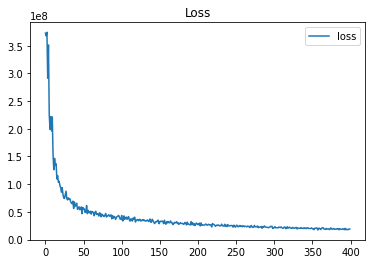

done 10 layers in 86.14ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[1181.41107115]


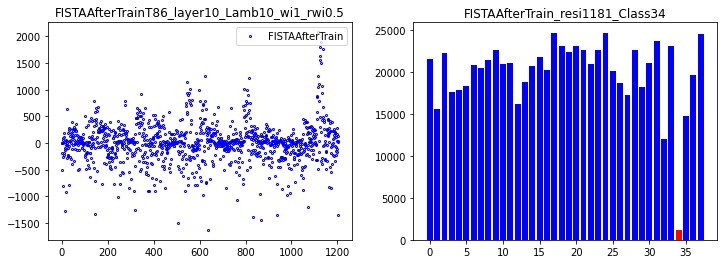

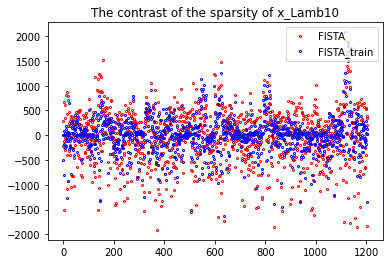

91
done 10 layers in 90.60ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[8822.74593575]


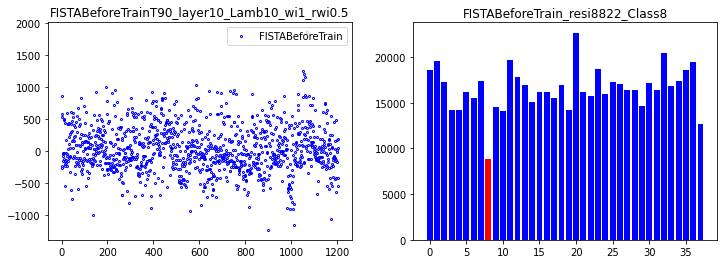

correct rate: 0.46875
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.5625
Epoch [ 10/100]: loss = 69371439.1095,   lambda [max:10.0524], [min:9.9646], 
Epoch [ 20/100]: loss = 45201184.5762,   lambda [max:10.0782], [min:9.9539], 
Epoch [ 30/100]: loss = 37985697.3803,   lambda [max:10.1046], [min:9.9427], 
Epoch [ 40/100]: loss = 30902047.8332,   lambda [max:10.1325], [min:9.9353], 
Epoch [ 50/100]: loss = 24528046.6360,   lambda [max:10.1578], [min:9.9302], 
Epoch [ 60/100]: loss = 26016872.9570,   lambda [max:10.1806], [min:9.9261], 
Epoch [ 70/100]: loss = 23699221.6322,   lambda [max:10.2033], [min:9.9227], 
Epoch [ 80/100]: loss = 22770109.4937,   lambda [max:10.2245], [min:9.9201], 
Epoch [ 90/100]: loss = 20173207.3224,   lambda [max:10.2432], [min:9.9183], 
correct rate: 0.84375
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.53125
Epoch [100/100]: loss = 20414449.9711,   lambda [max:10.2613], [min:9.9158], 


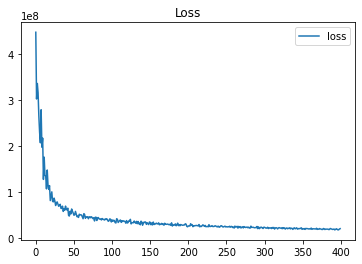

done 10 layers in 88.49ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1668.26459246]


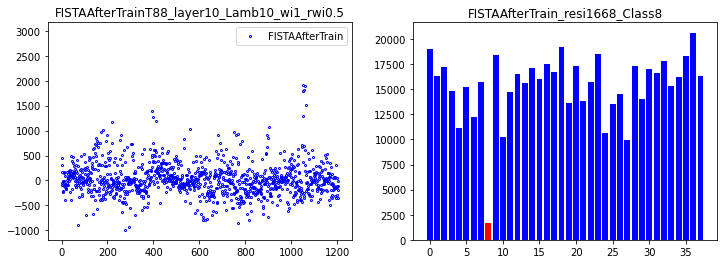

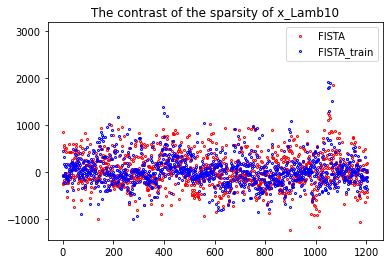

92
done 10 layers in 87.53ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6060.81923272]


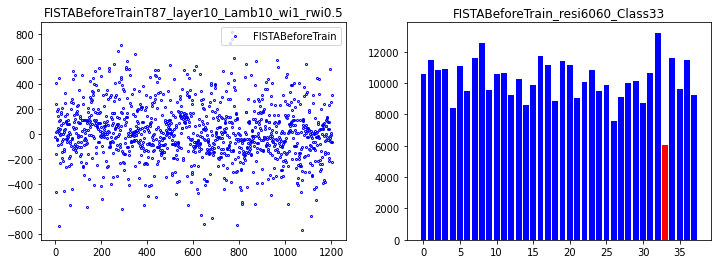

correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.78125
correct rate: 0.5625
Epoch [ 10/100]: loss = 63245204.2282,   lambda [max:10.0536], [min:9.9638], 
Epoch [ 20/100]: loss = 42214528.0993,   lambda [max:10.0793], [min:9.9544], 
Epoch [ 30/100]: loss = 34651994.2859,   lambda [max:10.1074], [min:9.9460], 
Epoch [ 40/100]: loss = 27908956.0807,   lambda [max:10.1340], [min:9.9402], 
Epoch [ 50/100]: loss = 27029494.3791,   lambda [max:10.1576], [min:9.9357], 
Epoch [ 60/100]: loss = 23193197.4585,   lambda [max:10.1799], [min:9.9324], 
Epoch [ 70/100]: loss = 24495080.3776,   lambda [max:10.2009], [min:9.9302], 
Epoch [ 80/100]: loss = 21297779.9516,   lambda [max:10.2197], [min:9.9283], 
Epoch [ 90/100]: loss = 19141119.1135,   lambda [max:10.2367], [min:9.9272], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.53125
Epoch [100/100]: loss = 19075376.4526,   lambda [max:10.2523], [min:9.9258], 


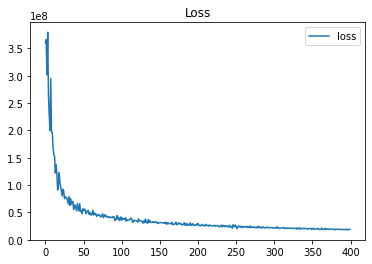

done 10 layers in 91.87ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[1349.22174873]


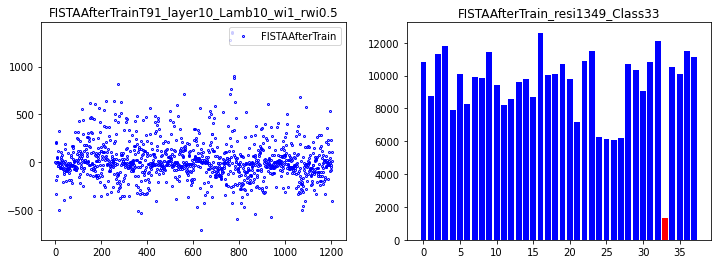

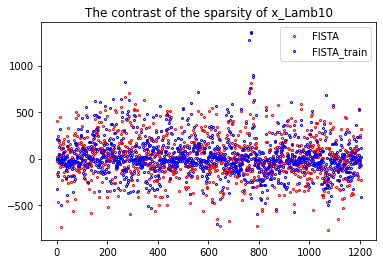

93
done 10 layers in 88.47ms
predict class: yaleB31
test image label: yaleB19
predict residuals label: 29
test residuals label: 17
[7794.27484626]


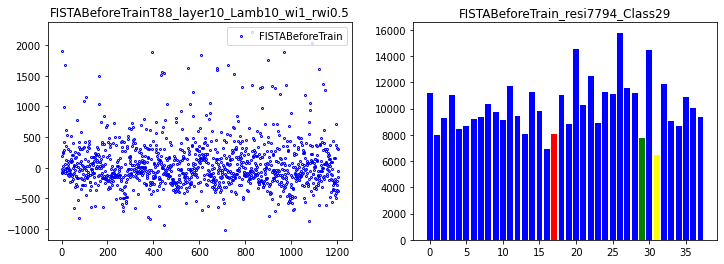

correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.65625
Epoch [ 10/100]: loss = 56464335.8514,   lambda [max:10.0525], [min:9.9592], 
Epoch [ 20/100]: loss = 39104815.9044,   lambda [max:10.0870], [min:9.9499], 
Epoch [ 30/100]: loss = 36416520.6942,   lambda [max:10.1172], [min:9.9417], 
Epoch [ 40/100]: loss = 28742453.8770,   lambda [max:10.1442], [min:9.9328], 
Epoch [ 50/100]: loss = 26484747.9706,   lambda [max:10.1681], [min:9.9258], 
Epoch [ 60/100]: loss = 23871109.6813,   lambda [max:10.1887], [min:9.9202], 
Epoch [ 70/100]: loss = 21276243.8444,   lambda [max:10.2066], [min:9.9152], 
Epoch [ 80/100]: loss = 21310159.1995,   lambda [max:10.2247], [min:9.9112], 
Epoch [ 90/100]: loss = 19825598.6133,   lambda [max:10.2435], [min:9.9078], 
correct rate: 0.78125
correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.6875
Epoch [100/100]: loss = 17915046.9591,   lambda [max:10.2606], [min:9.9048], 


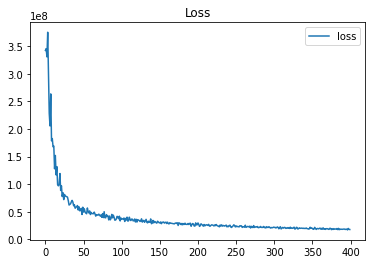

done 10 layers in 93.45ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[2811.33422514]


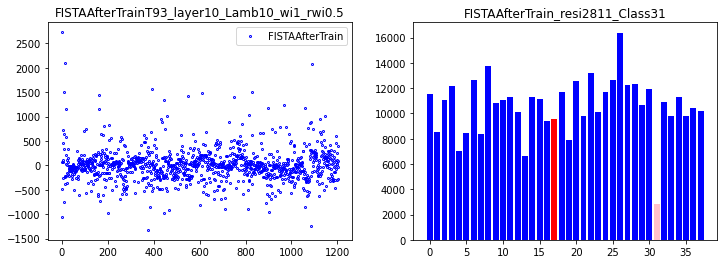

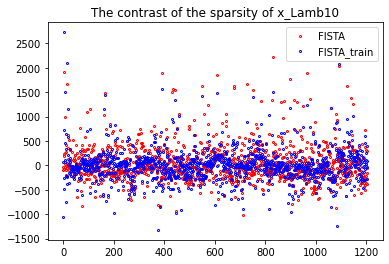

94
done 10 layers in 94.20ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[7973.40559981]


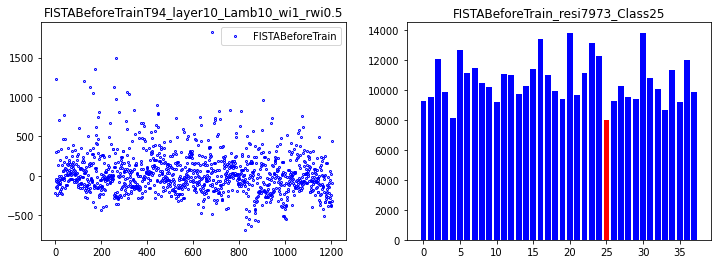

correct rate: 0.5
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.65625
Epoch [ 10/100]: loss = 62922161.4951,   lambda [max:10.0527], [min:9.9667], 
Epoch [ 20/100]: loss = 40352795.5459,   lambda [max:10.0859], [min:9.9593], 
Epoch [ 30/100]: loss = 34064852.3203,   lambda [max:10.1156], [min:9.9462], 
Epoch [ 40/100]: loss = 30555528.7991,   lambda [max:10.1427], [min:9.9370], 
Epoch [ 50/100]: loss = 25860091.8656,   lambda [max:10.1651], [min:9.9298], 
Epoch [ 60/100]: loss = 25165592.5160,   lambda [max:10.1849], [min:9.9243], 
Epoch [ 70/100]: loss = 21135049.6862,   lambda [max:10.2033], [min:9.9197], 
Epoch [ 80/100]: loss = 22139614.2587,   lambda [max:10.2217], [min:9.9152], 
Epoch [ 90/100]: loss = 18907328.2120,   lambda [max:10.2410], [min:9.9119], 
correct rate: 0.5625
correct rate: 0.625
correct rate: 0.8125
correct rate: 0.625
Epoch [100/100]: loss = 18115443.6562,   lambda [max:10.2582], [min:9.9089], 


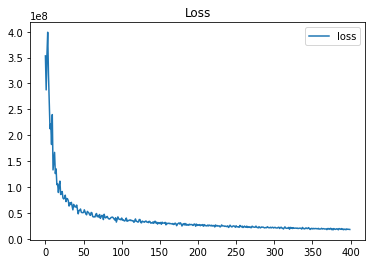

done 10 layers in 90.99ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[912.94575863]


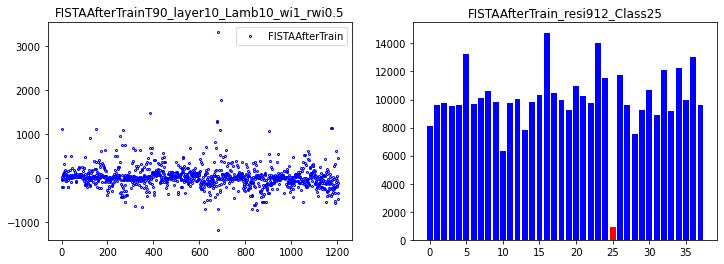

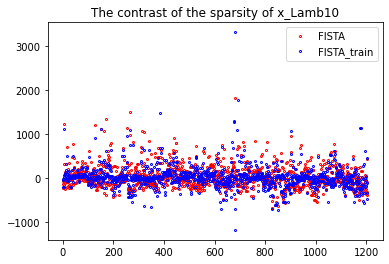

95
done 10 layers in 84.86ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[10512.26431666]


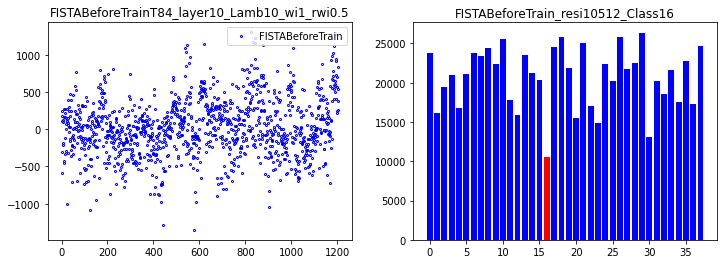

correct rate: 0.75
correct rate: 0.53125
correct rate: 0.5625
correct rate: 0.65625
Epoch [ 10/100]: loss = 63255791.3446,   lambda [max:10.0542], [min:9.9638], 
Epoch [ 20/100]: loss = 45043952.4788,   lambda [max:10.0822], [min:9.9528], 
Epoch [ 30/100]: loss = 31360743.0070,   lambda [max:10.1098], [min:9.9418], 
Epoch [ 40/100]: loss = 29570521.0173,   lambda [max:10.1355], [min:9.9348], 
Epoch [ 50/100]: loss = 27355322.0898,   lambda [max:10.1590], [min:9.9294], 
Epoch [ 60/100]: loss = 25244518.5585,   lambda [max:10.1804], [min:9.9256], 
Epoch [ 70/100]: loss = 22698601.5793,   lambda [max:10.2000], [min:9.9223], 
Epoch [ 80/100]: loss = 20714471.7238,   lambda [max:10.2178], [min:9.9198], 
Epoch [ 90/100]: loss = 21087194.8154,   lambda [max:10.2343], [min:9.9175], 
correct rate: 0.71875
correct rate: 0.75
correct rate: 0.5
correct rate: 0.75
Epoch [100/100]: loss = 18496802.0195,   lambda [max:10.2518], [min:9.9159], 


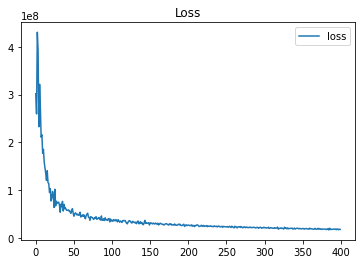

done 10 layers in 87.14ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[808.83968767]


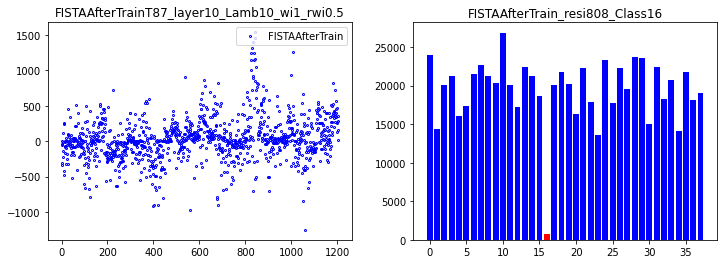

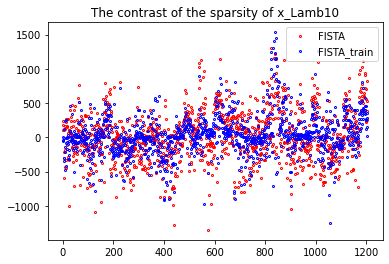

96
done 10 layers in 92.20ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[8534.80881601]


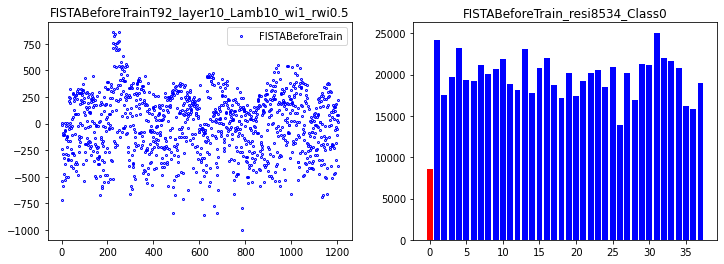

correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.59375
correct rate: 0.625
Epoch [ 10/100]: loss = 60162011.5915,   lambda [max:10.0532], [min:9.9628], 
Epoch [ 20/100]: loss = 41519463.8892,   lambda [max:10.0776], [min:9.9525], 
Epoch [ 30/100]: loss = 30843316.5608,   lambda [max:10.1005], [min:9.9392], 
Epoch [ 40/100]: loss = 30224585.1897,   lambda [max:10.1271], [min:9.9302], 
Epoch [ 50/100]: loss = 26237062.2171,   lambda [max:10.1513], [min:9.9227], 
Epoch [ 60/100]: loss = 25100137.6436,   lambda [max:10.1738], [min:9.9169], 
Epoch [ 70/100]: loss = 19964485.2745,   lambda [max:10.1947], [min:9.9122], 
Epoch [ 80/100]: loss = 20693941.2546,   lambda [max:10.2142], [min:9.9083], 
Epoch [ 90/100]: loss = 19650221.6666,   lambda [max:10.2327], [min:9.9049], 
correct rate: 0.75
correct rate: 0.625
correct rate: 0.625
correct rate: 0.65625
Epoch [100/100]: loss = 17709539.2451,   lambda [max:10.2492], [min:9.9021], 


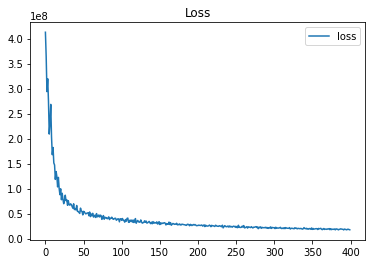

done 10 layers in 97.92ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1316.52400957]


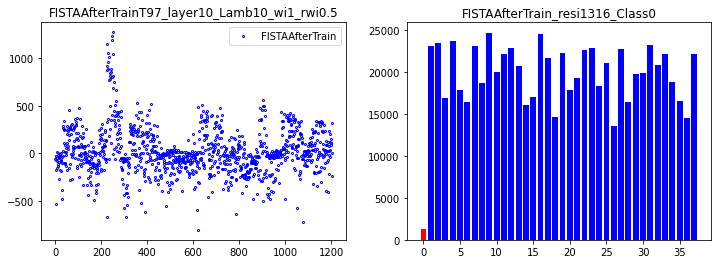

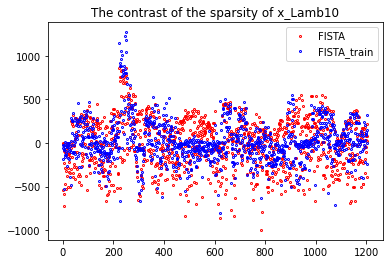

97
done 10 layers in 90.69ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2517.8860613]


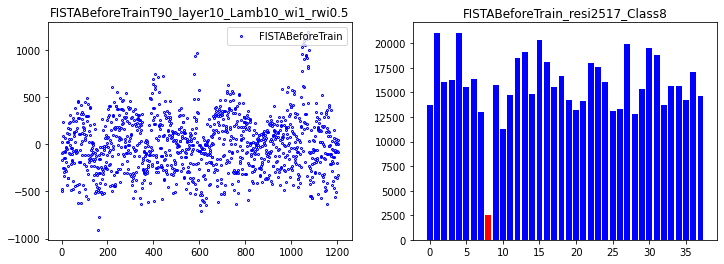

correct rate: 0.71875
correct rate: 0.625
correct rate: 0.5
correct rate: 0.59375
Epoch [ 10/100]: loss = 64785713.0195,   lambda [max:10.0539], [min:9.9655], 
Epoch [ 20/100]: loss = 44564241.5319,   lambda [max:10.0778], [min:9.9516], 
Epoch [ 30/100]: loss = 36766998.2256,   lambda [max:10.1025], [min:9.9438], 
Epoch [ 40/100]: loss = 30203674.8242,   lambda [max:10.1275], [min:9.9381], 
Epoch [ 50/100]: loss = 28686885.6096,   lambda [max:10.1508], [min:9.9320], 
Epoch [ 60/100]: loss = 23923947.0044,   lambda [max:10.1725], [min:9.9264], 
Epoch [ 70/100]: loss = 21785794.2670,   lambda [max:10.1915], [min:9.9219], 
Epoch [ 80/100]: loss = 21059909.4463,   lambda [max:10.2086], [min:9.9182], 
Epoch [ 90/100]: loss = 19474477.4992,   lambda [max:10.2243], [min:9.9155], 
correct rate: 0.75
correct rate: 0.75
correct rate: 0.4375
correct rate: 0.59375
Epoch [100/100]: loss = 19174460.6655,   lambda [max:10.2382], [min:9.9131], 


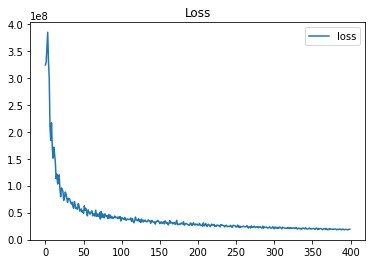

done 10 layers in 89.27ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1921.33648985]


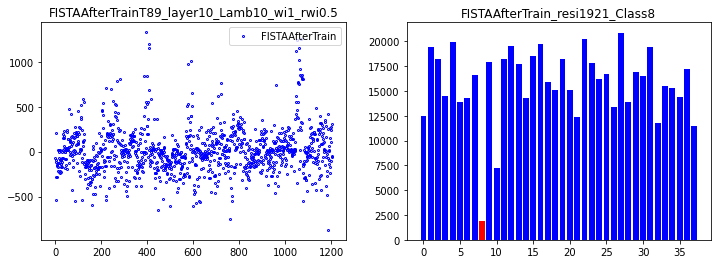

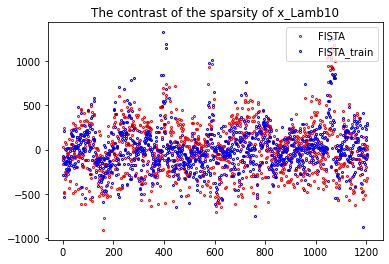

98
done 10 layers in 94.98ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[9767.57112045]


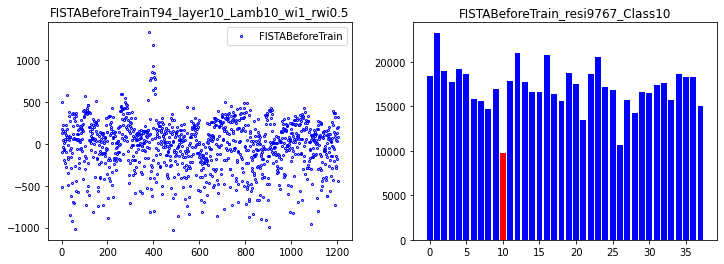

correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.5625
Epoch [ 10/100]: loss = 59714266.1061,   lambda [max:10.0564], [min:9.9647], 
Epoch [ 20/100]: loss = 42020952.5125,   lambda [max:10.0862], [min:9.9496], 
Epoch [ 30/100]: loss = 36819366.7561,   lambda [max:10.1150], [min:9.9408], 
Epoch [ 40/100]: loss = 29150664.3235,   lambda [max:10.1405], [min:9.9343], 
Epoch [ 50/100]: loss = 28252517.6747,   lambda [max:10.1633], [min:9.9295], 
Epoch [ 60/100]: loss = 23401370.1762,   lambda [max:10.1858], [min:9.9259], 
Epoch [ 70/100]: loss = 22966533.9068,   lambda [max:10.2057], [min:9.9225], 
Epoch [ 80/100]: loss = 21083477.8441,   lambda [max:10.2252], [min:9.9201], 
Epoch [ 90/100]: loss = 19155872.9526,   lambda [max:10.2446], [min:9.9179], 
correct rate: 0.71875
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.53125
Epoch [100/100]: loss = 18324735.6162,   lambda [max:10.2629], [min:9.9157], 


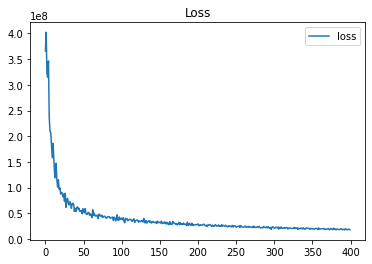

done 10 layers in 98.58ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1500.12944208]


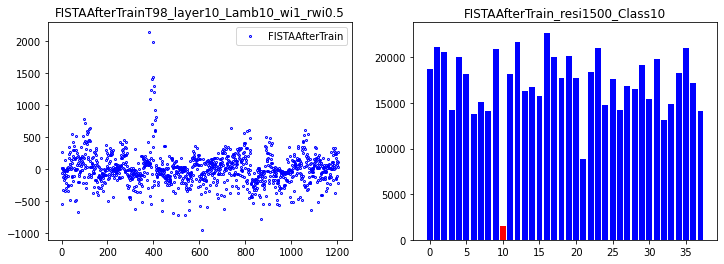

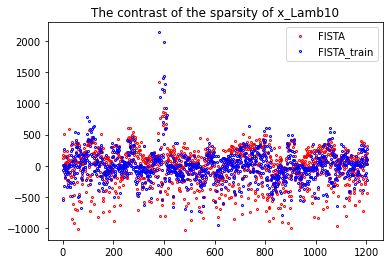

99
done 10 layers in 91.18ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[9010.79906215]


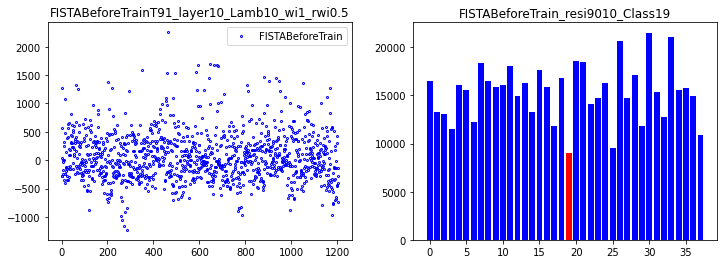

correct rate: 0.5625
correct rate: 0.53125
correct rate: 0.6875
correct rate: 0.65625
Epoch [ 10/100]: loss = 63465711.0949,   lambda [max:10.0589], [min:9.9591], 
Epoch [ 20/100]: loss = 46944209.8510,   lambda [max:10.0956], [min:9.9528], 
Epoch [ 30/100]: loss = 38317265.0661,   lambda [max:10.1255], [min:9.9489], 
Epoch [ 40/100]: loss = 28147641.8084,   lambda [max:10.1520], [min:9.9468], 
Epoch [ 50/100]: loss = 25545177.2761,   lambda [max:10.1763], [min:9.9441], 
Epoch [ 60/100]: loss = 24726264.4052,   lambda [max:10.1983], [min:9.9396], 
Epoch [ 70/100]: loss = 24708104.3742,   lambda [max:10.2184], [min:9.9363], 
Epoch [ 80/100]: loss = 19772911.9632,   lambda [max:10.2368], [min:9.9337], 
Epoch [ 90/100]: loss = 20291057.8404,   lambda [max:10.2546], [min:9.9319], 
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.75
Epoch [100/100]: loss = 18347755.2618,   lambda [max:10.2696], [min:9.9310], 


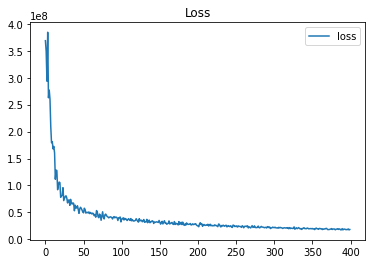

done 10 layers in 84.74ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[3206.85672176]


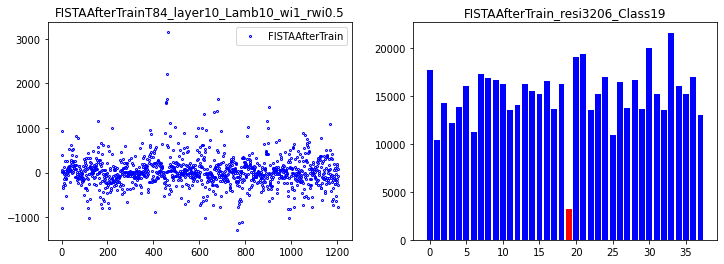

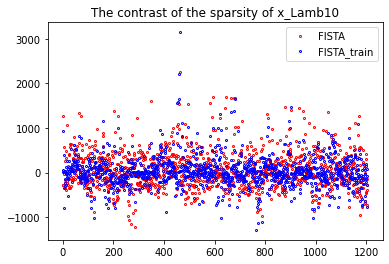

100
done 5 layers in 90.05ms
predict class: yaleB05
test image label: yaleB36
predict residuals label: 4
test residuals label: 34
[16737.98789477]


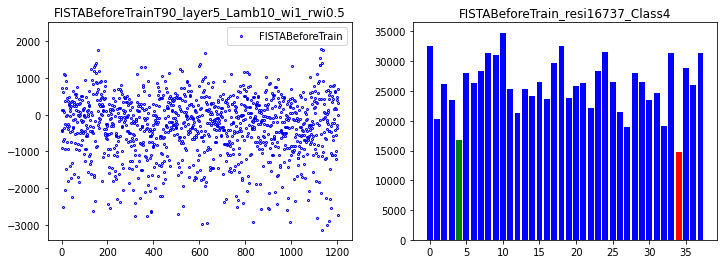

correct rate: 0.59375
correct rate: 0.5
correct rate: 0.28125
correct rate: 0.34375
Epoch [ 10/100]: loss = 81695359.5641,   lambda [max:10.0617], [min:9.9690], 
Epoch [ 20/100]: loss = 69820551.4863,   lambda [max:10.1048], [min:9.9590], 
Epoch [ 30/100]: loss = 59038225.6247,   lambda [max:10.1388], [min:9.9503], 
Epoch [ 40/100]: loss = 47074083.7731,   lambda [max:10.1680], [min:9.9452], 
Epoch [ 50/100]: loss = 43470034.7646,   lambda [max:10.1935], [min:9.9408], 
Epoch [ 60/100]: loss = 42853646.2660,   lambda [max:10.2169], [min:9.9377], 
Epoch [ 70/100]: loss = 37376491.9346,   lambda [max:10.2375], [min:9.9366], 
Epoch [ 80/100]: loss = 34175303.3021,   lambda [max:10.2566], [min:9.9366], 
Epoch [ 90/100]: loss = 34201407.6056,   lambda [max:10.2736], [min:9.9372], 
correct rate: 0.3125
correct rate: 0.15625
correct rate: 0.40625
correct rate: 0.28125
Epoch [100/100]: loss = 29096726.8466,   lambda [max:10.2887], [min:9.9373], 


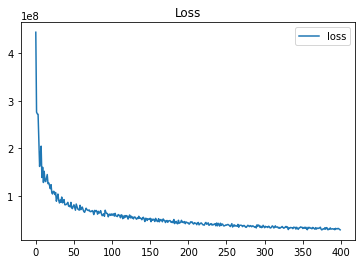

done 5 layers in 82.09ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[1639.98520193]


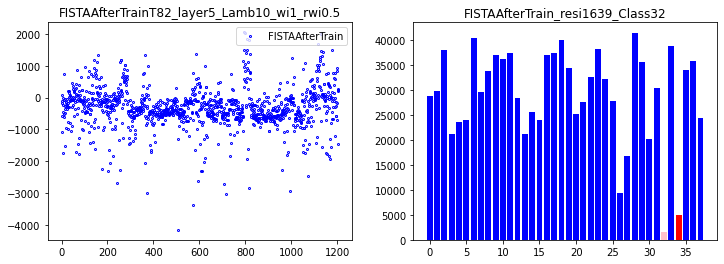

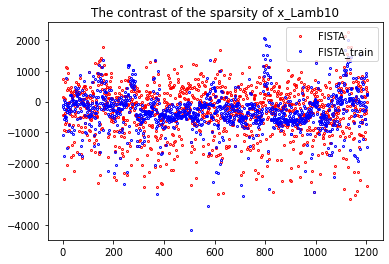

101
done 5 layers in 81.75ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[4445.81119946]


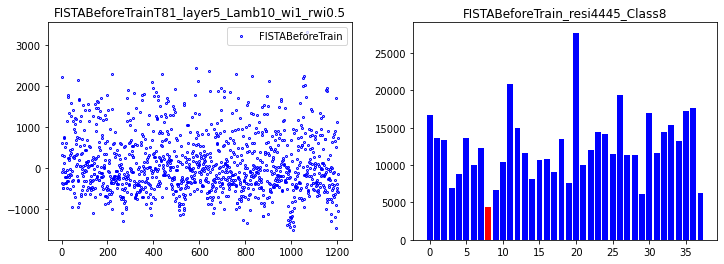

correct rate: 0.59375
correct rate: 0.40625
correct rate: 0.40625
correct rate: 0.375
Epoch [ 10/100]: loss = 84834849.4828,   lambda [max:10.0609], [min:9.9758], 
Epoch [ 20/100]: loss = 64788284.2937,   lambda [max:10.1078], [min:9.9677], 
Epoch [ 30/100]: loss = 55866173.9399,   lambda [max:10.1427], [min:9.9605], 
Epoch [ 40/100]: loss = 47325145.1532,   lambda [max:10.1722], [min:9.9547], 
Epoch [ 50/100]: loss = 42132259.4623,   lambda [max:10.1975], [min:9.9512], 
Epoch [ 60/100]: loss = 39478375.3602,   lambda [max:10.2206], [min:9.9497], 
Epoch [ 70/100]: loss = 36143724.7307,   lambda [max:10.2413], [min:9.9484], 
Epoch [ 80/100]: loss = 31793450.1919,   lambda [max:10.2597], [min:9.9478], 
Epoch [ 90/100]: loss = 31687099.0327,   lambda [max:10.2771], [min:9.9462], 
correct rate: 0.3125
correct rate: 0.34375
correct rate: 0.21875
correct rate: 0.375
Epoch [100/100]: loss = 32157782.2144,   lambda [max:10.2922], [min:9.9435], 


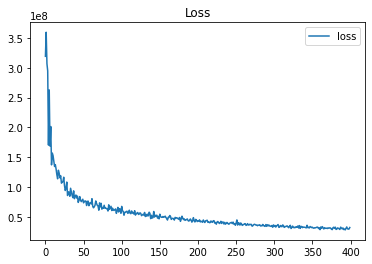

done 5 layers in 79.54ms
predict class: yaleB10
test image label: yaleB09
predict residuals label: 9
test residuals label: 8
[2742.80237405]


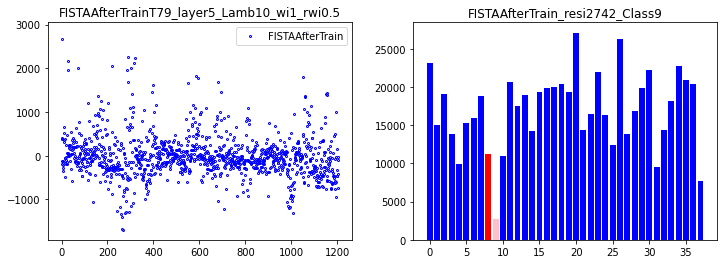

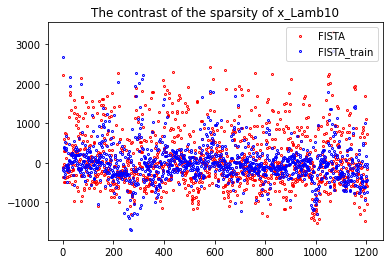

102
done 5 layers in 83.58ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4656.48754402]


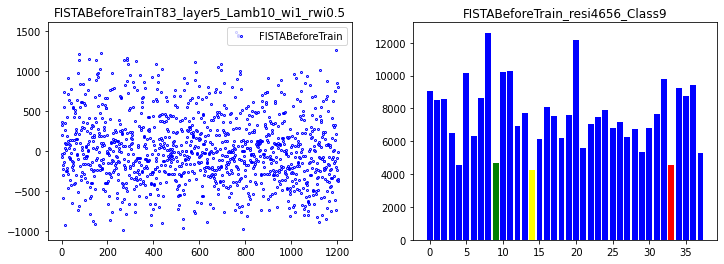

correct rate: 0.53125
correct rate: 0.4375
correct rate: 0.34375
correct rate: 0.40625
Epoch [ 10/100]: loss = 85664896.1690,   lambda [max:10.0594], [min:9.9738], 
Epoch [ 20/100]: loss = 70221039.7705,   lambda [max:10.1062], [min:9.9682], 
Epoch [ 30/100]: loss = 56109675.8544,   lambda [max:10.1407], [min:9.9627], 
Epoch [ 40/100]: loss = 50166820.5956,   lambda [max:10.1693], [min:9.9559], 
Epoch [ 50/100]: loss = 46396528.6919,   lambda [max:10.1939], [min:9.9500], 
Epoch [ 60/100]: loss = 40632157.5636,   lambda [max:10.2164], [min:9.9450], 
Epoch [ 70/100]: loss = 38049932.1173,   lambda [max:10.2372], [min:9.9403], 
Epoch [ 80/100]: loss = 34974918.6353,   lambda [max:10.2564], [min:9.9364], 
Epoch [ 90/100]: loss = 32341553.2703,   lambda [max:10.2740], [min:9.9340], 
correct rate: 0.4375
correct rate: 0.375
correct rate: 0.21875
correct rate: 0.3125
Epoch [100/100]: loss = 31032413.1247,   lambda [max:10.2896], [min:9.9328], 


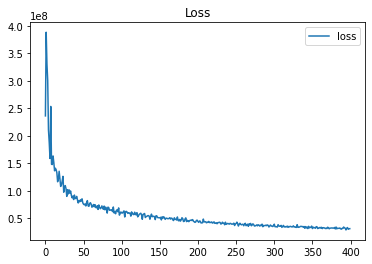

done 5 layers in 83.43ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[2645.0505215]


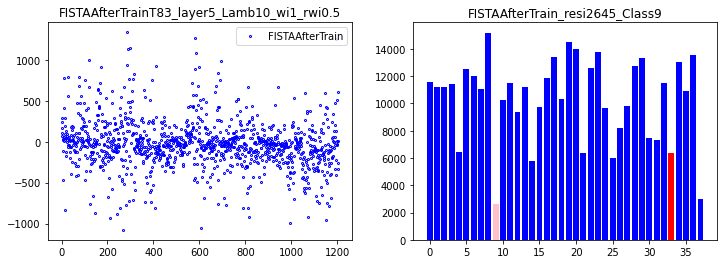

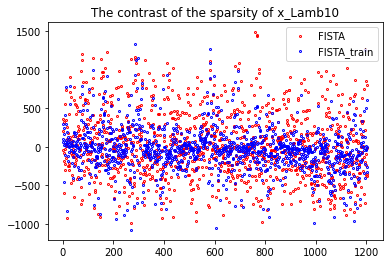

103
done 5 layers in 81.42ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[4966.80891396]


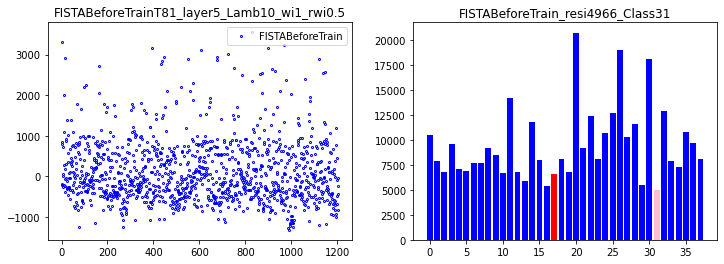

correct rate: 0.375
correct rate: 0.5
correct rate: 0.4375
correct rate: 0.40625
Epoch [ 10/100]: loss = 81619788.9739,   lambda [max:10.0614], [min:9.9732], 
Epoch [ 20/100]: loss = 69398612.9355,   lambda [max:10.1094], [min:9.9599], 
Epoch [ 30/100]: loss = 62048876.1826,   lambda [max:10.1454], [min:9.9499], 
Epoch [ 40/100]: loss = 51302083.0840,   lambda [max:10.1747], [min:9.9419], 
Epoch [ 50/100]: loss = 40831167.8593,   lambda [max:10.2002], [min:9.9365], 
Epoch [ 60/100]: loss = 39942002.2869,   lambda [max:10.2235], [min:9.9332], 
Epoch [ 70/100]: loss = 39294707.5482,   lambda [max:10.2442], [min:9.9304], 
Epoch [ 80/100]: loss = 35488799.7565,   lambda [max:10.2631], [min:9.9294], 
Epoch [ 90/100]: loss = 33339183.7119,   lambda [max:10.2802], [min:9.9289], 
correct rate: 0.1875
correct rate: 0.34375
correct rate: 0.15625
correct rate: 0.34375
Epoch [100/100]: loss = 32540770.7630,   lambda [max:10.2953], [min:9.9301], 


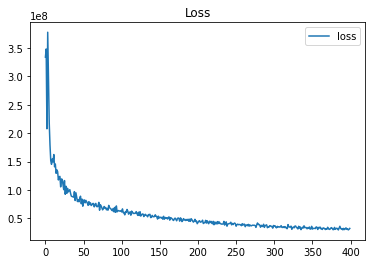

done 5 layers in 82.66ms
predict class: yaleB13
test image label: yaleB19
predict residuals label: 12
test residuals label: 17
[2384.46816198]


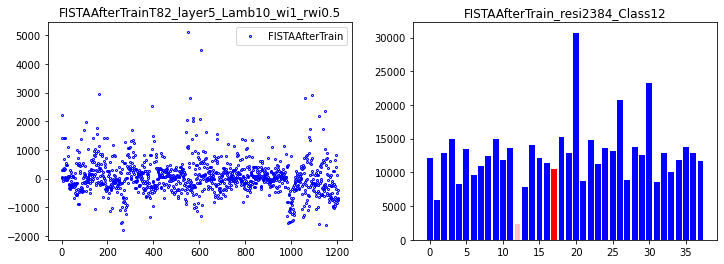

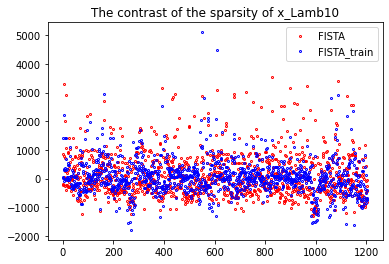

104
done 5 layers in 83.67ms
predict class: yaleB11
test image label: yaleB27
predict residuals label: 10
test residuals label: 25
[5465.70571366]


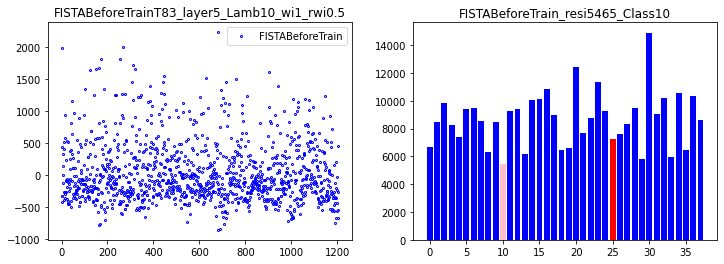

correct rate: 0.6875
correct rate: 0.28125
correct rate: 0.4375
correct rate: 0.40625
Epoch [ 10/100]: loss = 82409502.7935,   lambda [max:10.0576], [min:9.9663], 
Epoch [ 20/100]: loss = 65092174.9769,   lambda [max:10.1027], [min:9.9569], 
Epoch [ 30/100]: loss = 56374124.3275,   lambda [max:10.1379], [min:9.9529], 
Epoch [ 40/100]: loss = 52410111.0937,   lambda [max:10.1671], [min:9.9517], 
Epoch [ 50/100]: loss = 44000243.8747,   lambda [max:10.1929], [min:9.9512], 
Epoch [ 60/100]: loss = 42868770.0709,   lambda [max:10.2160], [min:9.9516], 
Epoch [ 70/100]: loss = 35836833.1907,   lambda [max:10.2371], [min:9.9524], 
Epoch [ 80/100]: loss = 35552107.7911,   lambda [max:10.2554], [min:9.9546], 
Epoch [ 90/100]: loss = 31873850.9432,   lambda [max:10.2728], [min:9.9541], 
correct rate: 0.3125
correct rate: 0.4375
correct rate: 0.28125
correct rate: 0.28125
Epoch [100/100]: loss = 29194971.8479,   lambda [max:10.2889], [min:9.9536], 


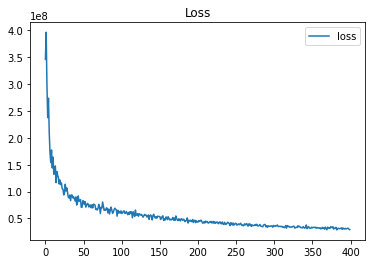

done 5 layers in 83.07ms
predict class: yaleB09
test image label: yaleB27
predict residuals label: 8
test residuals label: 25
[2504.24686751]


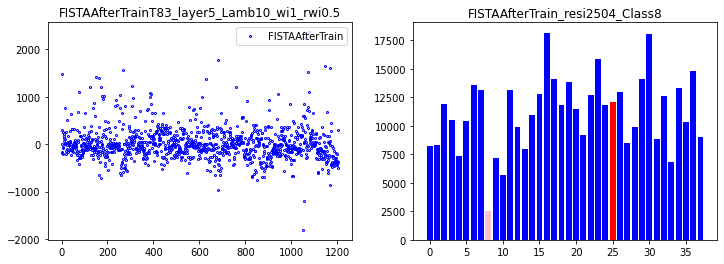

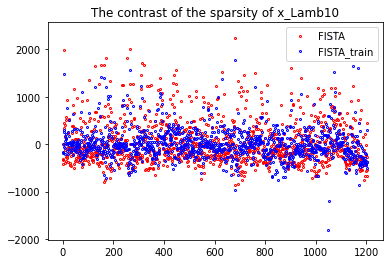

105
done 5 layers in 87.32ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[7226.85819751]


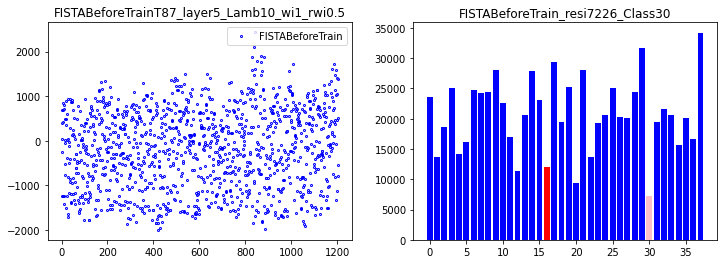

correct rate: 0.40625
correct rate: 0.53125
correct rate: 0.34375
correct rate: 0.46875
Epoch [ 10/100]: loss = 90568419.3799,   lambda [max:10.0614], [min:9.9759], 
Epoch [ 20/100]: loss = 66779669.6756,   lambda [max:10.1074], [min:9.9630], 
Epoch [ 30/100]: loss = 55326444.2230,   lambda [max:10.1423], [min:9.9569], 
Epoch [ 40/100]: loss = 49703178.5694,   lambda [max:10.1710], [min:9.9498], 
Epoch [ 50/100]: loss = 40803246.9520,   lambda [max:10.1963], [min:9.9455], 
Epoch [ 60/100]: loss = 38018633.5073,   lambda [max:10.2191], [min:9.9436], 
Epoch [ 70/100]: loss = 34461139.9026,   lambda [max:10.2396], [min:9.9422], 
Epoch [ 80/100]: loss = 33356447.1719,   lambda [max:10.2583], [min:9.9405], 
Epoch [ 90/100]: loss = 31160728.9834,   lambda [max:10.2755], [min:9.9416], 
correct rate: 0.1875
correct rate: 0.28125
correct rate: 0.25
correct rate: 0.34375
Epoch [100/100]: loss = 31241670.4089,   lambda [max:10.2903], [min:9.9398], 


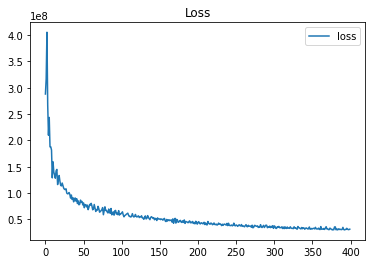

done 5 layers in 88.34ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[803.75065135]


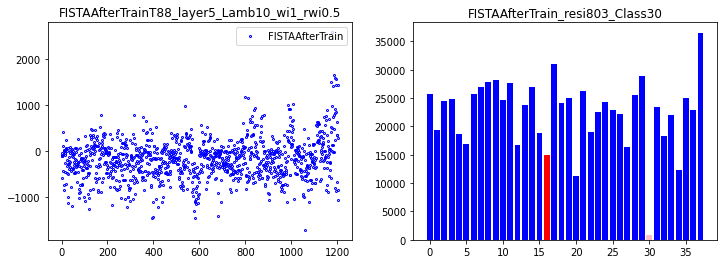

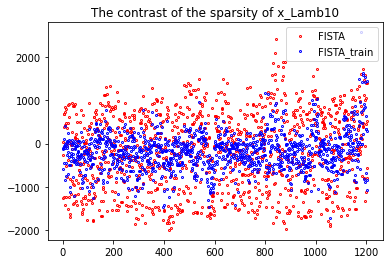

106
done 5 layers in 85.44ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[16822.70800562]


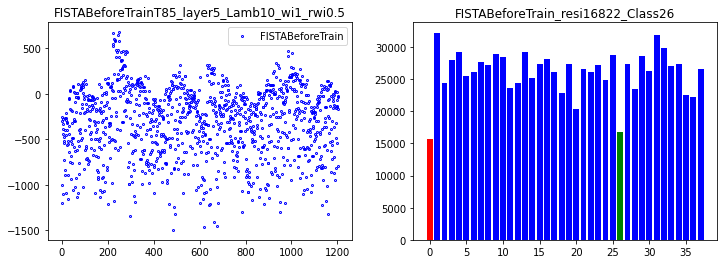

correct rate: 0.59375
correct rate: 0.40625
correct rate: 0.28125
correct rate: 0.4375
Epoch [ 10/100]: loss = 101204784.2189,   lambda [max:10.0596], [min:9.9744], 
Epoch [ 20/100]: loss = 72744627.5472,   lambda [max:10.1055], [min:9.9656], 
Epoch [ 30/100]: loss = 54503749.5838,   lambda [max:10.1406], [min:9.9584], 
Epoch [ 40/100]: loss = 52142403.8782,   lambda [max:10.1697], [min:9.9557], 
Epoch [ 50/100]: loss = 46735806.8874,   lambda [max:10.1947], [min:9.9570], 
Epoch [ 60/100]: loss = 40883312.4854,   lambda [max:10.2177], [min:9.9541], 
Epoch [ 70/100]: loss = 38160625.5546,   lambda [max:10.2387], [min:9.9498], 
Epoch [ 80/100]: loss = 35112161.2293,   lambda [max:10.2577], [min:9.9445], 
Epoch [ 90/100]: loss = 31744903.8577,   lambda [max:10.2753], [min:9.9396], 
correct rate: 0.375
correct rate: 0.28125
correct rate: 0.25
correct rate: 0.25
Epoch [100/100]: loss = 31639210.5002,   lambda [max:10.2916], [min:9.9345], 


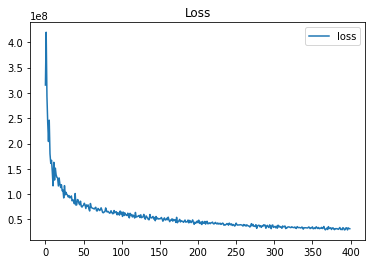

done 5 layers in 85.01ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[3068.37893895]


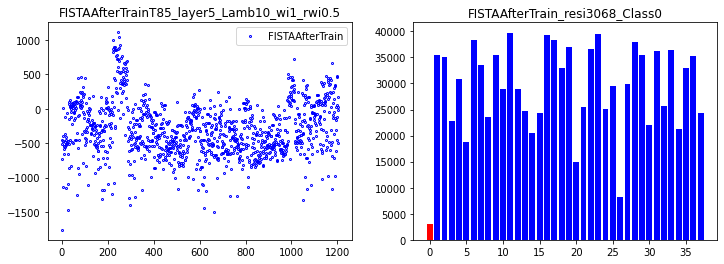

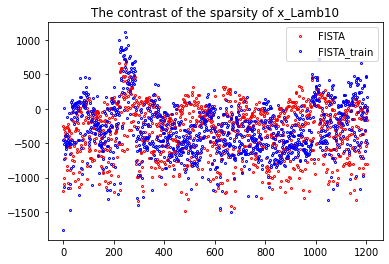

107
done 5 layers in 84.93ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[5129.29331545]


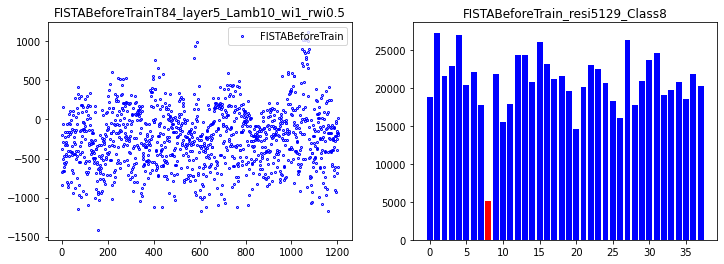

correct rate: 0.5
correct rate: 0.375
correct rate: 0.375
correct rate: 0.40625
Epoch [ 10/100]: loss = 90583766.5650,   lambda [max:10.0556], [min:9.9652], 
Epoch [ 20/100]: loss = 59358901.1159,   lambda [max:10.0989], [min:9.9507], 
Epoch [ 30/100]: loss = 59680974.9477,   lambda [max:10.1325], [min:9.9411], 
Epoch [ 40/100]: loss = 47937343.1542,   lambda [max:10.1609], [min:9.9347], 
Epoch [ 50/100]: loss = 46947232.8822,   lambda [max:10.1850], [min:9.9293], 
Epoch [ 60/100]: loss = 40339192.2870,   lambda [max:10.2071], [min:9.9255], 
Epoch [ 70/100]: loss = 37629609.6537,   lambda [max:10.2274], [min:9.9230], 
Epoch [ 80/100]: loss = 35390997.5492,   lambda [max:10.2457], [min:9.9210], 
Epoch [ 90/100]: loss = 32005010.5597,   lambda [max:10.2623], [min:9.9216], 
correct rate: 0.25
correct rate: 0.4375
correct rate: 0.25
correct rate: 0.1875
Epoch [100/100]: loss = 31186425.8619,   lambda [max:10.2769], [min:9.9221], 


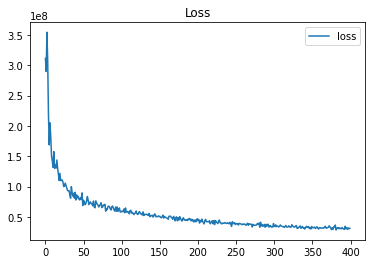

done 5 layers in 87.10ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2023.81115482]


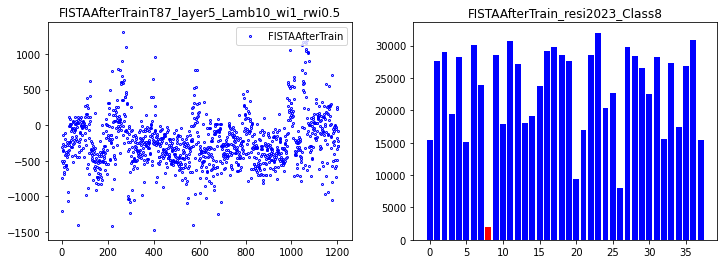

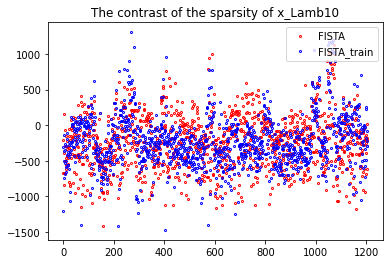

108
done 5 layers in 82.42ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[15797.11521824]


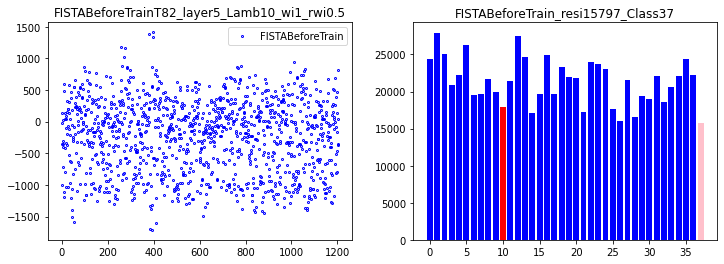

correct rate: 0.46875
correct rate: 0.5
correct rate: 0.34375
correct rate: 0.375
Epoch [ 10/100]: loss = 82159918.1231,   lambda [max:10.0589], [min:9.9673], 
Epoch [ 20/100]: loss = 66831181.8772,   lambda [max:10.1021], [min:9.9581], 
Epoch [ 30/100]: loss = 57570174.9632,   lambda [max:10.1370], [min:9.9499], 
Epoch [ 40/100]: loss = 46979279.1144,   lambda [max:10.1655], [min:9.9464], 
Epoch [ 50/100]: loss = 45011995.8602,   lambda [max:10.1905], [min:9.9425], 
Epoch [ 60/100]: loss = 39627270.4999,   lambda [max:10.2141], [min:9.9393], 
Epoch [ 70/100]: loss = 37837678.7584,   lambda [max:10.2347], [min:9.9379], 
Epoch [ 80/100]: loss = 35030680.6071,   lambda [max:10.2530], [min:9.9373], 
Epoch [ 90/100]: loss = 31542487.6243,   lambda [max:10.2701], [min:9.9373], 
correct rate: 0.21875
correct rate: 0.3125
correct rate: 0.375
correct rate: 0.15625
Epoch [100/100]: loss = 30125683.4742,   lambda [max:10.2855], [min:9.9380], 


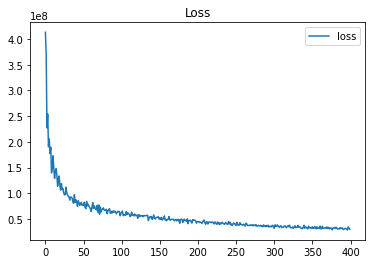

done 5 layers in 79.88ms
predict class: yaleB28
test image label: yaleB11
predict residuals label: 26
test residuals label: 10
[2858.34784177]


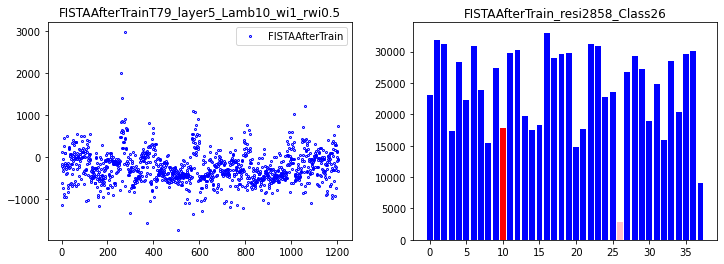

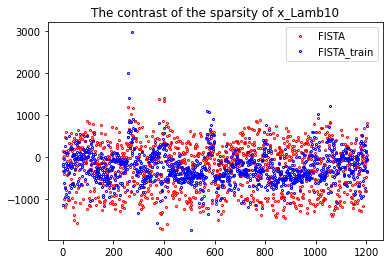

109
done 5 layers in 90.31ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[4730.76968357]


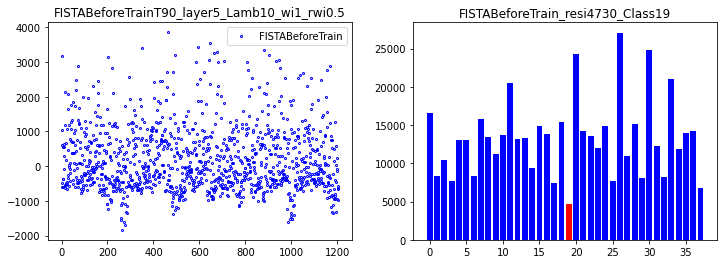

correct rate: 0.34375
correct rate: 0.46875
correct rate: 0.46875
correct rate: 0.46875
Epoch [ 10/100]: loss = 84766423.2562,   lambda [max:10.0562], [min:9.9676], 
Epoch [ 20/100]: loss = 65027290.7096,   lambda [max:10.1027], [min:9.9626], 
Epoch [ 30/100]: loss = 59289777.0532,   lambda [max:10.1378], [min:9.9579], 
Epoch [ 40/100]: loss = 47042236.0519,   lambda [max:10.1660], [min:9.9575], 
Epoch [ 50/100]: loss = 45066348.6944,   lambda [max:10.1913], [min:9.9555], 
Epoch [ 60/100]: loss = 38149918.4729,   lambda [max:10.2146], [min:9.9505], 
Epoch [ 70/100]: loss = 34935617.9734,   lambda [max:10.2355], [min:9.9458], 
Epoch [ 80/100]: loss = 36084229.9894,   lambda [max:10.2540], [min:9.9406], 
Epoch [ 90/100]: loss = 35162840.7345,   lambda [max:10.2711], [min:9.9366], 
correct rate: 0.34375
correct rate: 0.3125
correct rate: 0.40625
correct rate: 0.25
Epoch [100/100]: loss = 32580829.3241,   lambda [max:10.2857], [min:9.9325], 


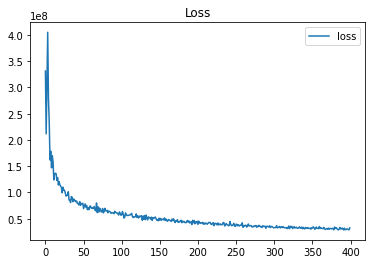

done 5 layers in 80.79ms
predict class: yaleB39
test image label: yaleB21
predict residuals label: 37
test residuals label: 19
[2833.72690357]


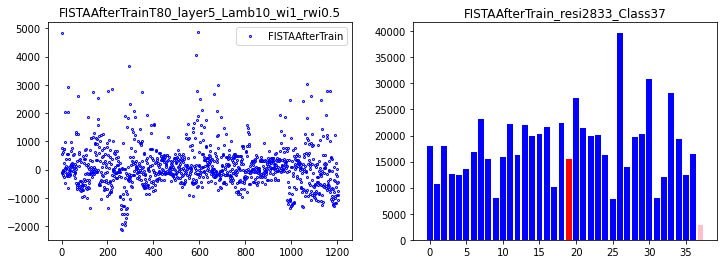

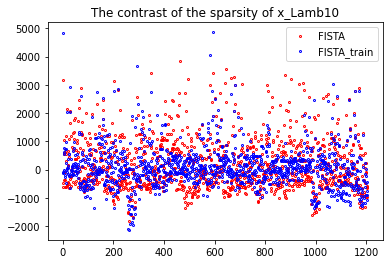

110
done 1 layers in 70.80ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[165029.85877878]


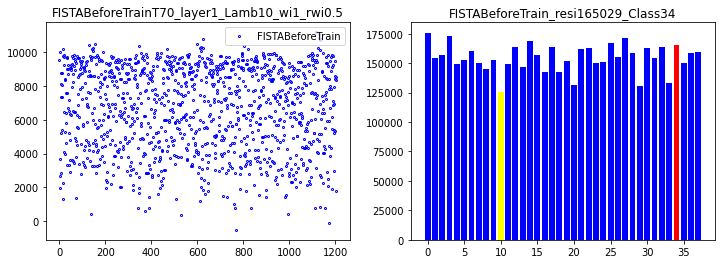

correct rate: 0.625
correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.5
Epoch [ 10/100]: loss = 1329311598.0290,   lambda [max:10.0638], [min:9.9679], 
Epoch [ 20/100]: loss = 695218333.9353,   lambda [max:10.1047], [min:9.9694], 
Epoch [ 30/100]: loss = 655743178.1232,   lambda [max:10.1373], [min:9.9700], 
Epoch [ 40/100]: loss = 612149326.1372,   lambda [max:10.1658], [min:9.9680], 
Epoch [ 50/100]: loss = 471671336.7288,   lambda [max:10.1914], [min:9.9678], 
Epoch [ 60/100]: loss = 466177629.1071,   lambda [max:10.2149], [min:9.9677], 
Epoch [ 70/100]: loss = 453657684.8290,   lambda [max:10.2368], [min:9.9673], 
Epoch [ 80/100]: loss = 491376063.7082,   lambda [max:10.2574], [min:9.9675], 
Epoch [ 90/100]: loss = 483587208.0276,   lambda [max:10.2768], [min:9.9672], 
correct rate: 0.0
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.03125
Epoch [100/100]: loss = 429433985.6006,   lambda [max:10.2953], [min:9.9662], 


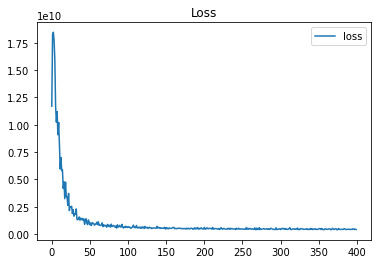

done 1 layers in 76.05ms
predict class: yaleB31
test image label: yaleB36
predict residuals label: 29
test residuals label: 34
[6801.02532504]


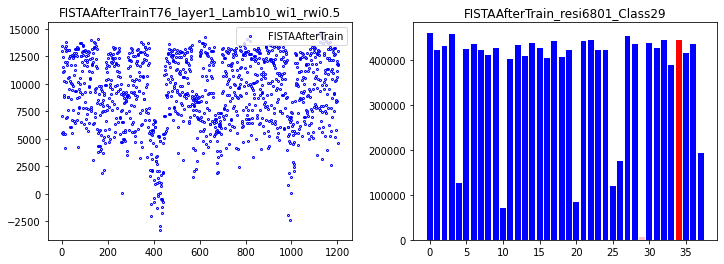

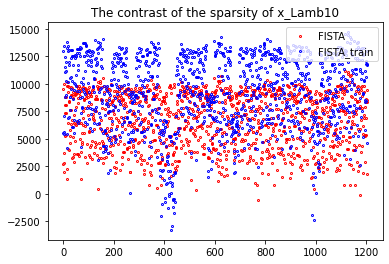

111
done 1 layers in 75.99ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[55240.5028473]


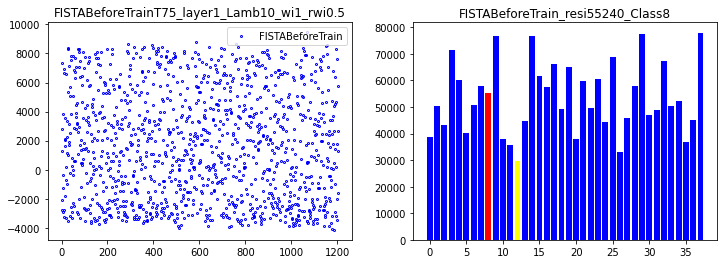

correct rate: 0.5625
correct rate: 0.53125
correct rate: 0.71875
correct rate: 0.65625
Epoch [ 10/100]: loss = 1262633736.1078,   lambda [max:10.0628], [min:9.9689], 
Epoch [ 20/100]: loss = 744038714.0294,   lambda [max:10.1026], [min:9.9707], 
Epoch [ 30/100]: loss = 561564843.5531,   lambda [max:10.1345], [min:9.9720], 
Epoch [ 40/100]: loss = 523478416.6689,   lambda [max:10.1624], [min:9.9738], 
Epoch [ 50/100]: loss = 511936501.8360,   lambda [max:10.1878], [min:9.9758], 
Epoch [ 60/100]: loss = 478096136.8264,   lambda [max:10.2110], [min:9.9767], 
Epoch [ 70/100]: loss = 477770288.1117,   lambda [max:10.2327], [min:9.9784], 
Epoch [ 80/100]: loss = 444340252.1810,   lambda [max:10.2531], [min:9.9791], 
Epoch [ 90/100]: loss = 515448435.1129,   lambda [max:10.2724], [min:9.9802], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.09375
Epoch [100/100]: loss = 418270969.6418,   lambda [max:10.2908], [min:9.9812], 


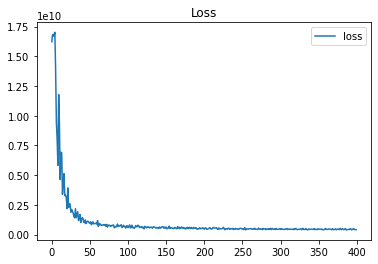

done 1 layers in 75.25ms
predict class: yaleB07
test image label: yaleB09
predict residuals label: 6
test residuals label: 8
[58344.7150937]


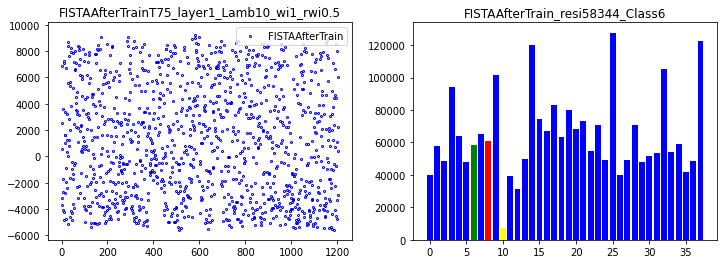

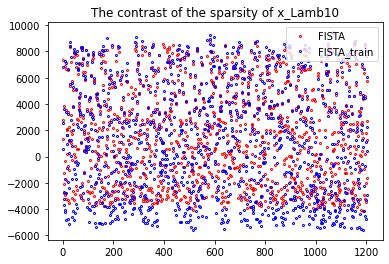

112
done 1 layers in 71.54ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[46018.58194607]


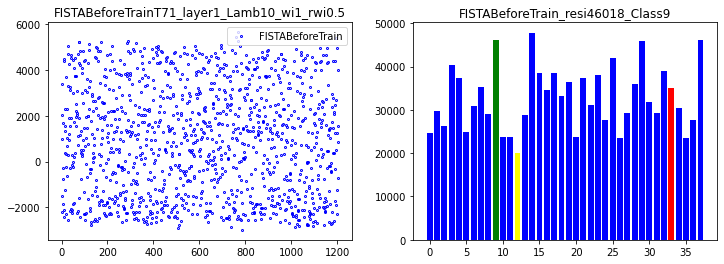

correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.53125
Epoch [ 10/100]: loss = 1634243885.2331,   lambda [max:10.0629], [min:9.9722], 
Epoch [ 20/100]: loss = 769107502.4058,   lambda [max:10.1028], [min:9.9739], 
Epoch [ 30/100]: loss = 633833667.1276,   lambda [max:10.1348], [min:9.9737], 
Epoch [ 40/100]: loss = 560909732.8230,   lambda [max:10.1627], [min:9.9734], 
Epoch [ 50/100]: loss = 530504137.7694,   lambda [max:10.1879], [min:9.9735], 
Epoch [ 60/100]: loss = 560553524.8302,   lambda [max:10.2112], [min:9.9732], 
Epoch [ 70/100]: loss = 515066293.0253,   lambda [max:10.2329], [min:9.9732], 
Epoch [ 80/100]: loss = 449098326.9791,   lambda [max:10.2533], [min:9.9724], 
Epoch [ 90/100]: loss = 503325660.8300,   lambda [max:10.2726], [min:9.9718], 
correct rate: 0.0625
correct rate: 0.0
correct rate: 0.09375
correct rate: 0.0625
Epoch [100/100]: loss = 450532907.8281,   lambda [max:10.2910], [min:9.9723], 


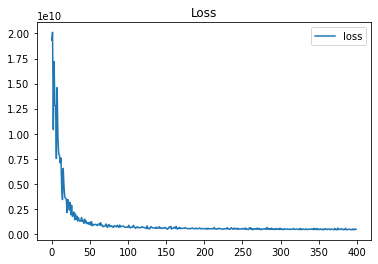

done 1 layers in 84.47ms
predict class: yaleB11
test image label: yaleB35
predict residuals label: 10
test residuals label: 33
[4302.40821226]


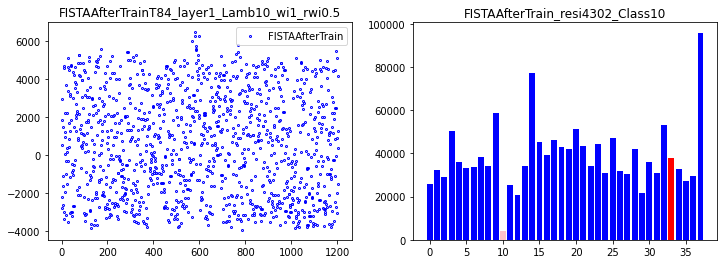

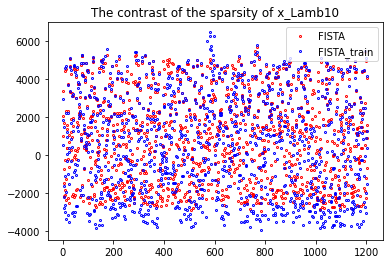

113
done 1 layers in 75.64ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[27569.75108349]


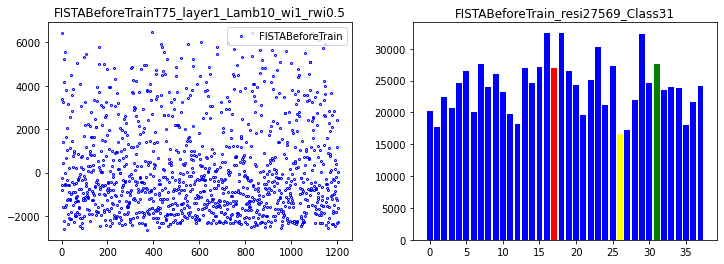

correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.46875
Epoch [ 10/100]: loss = 1454850298.0047,   lambda [max:10.0630], [min:9.9691], 
Epoch [ 20/100]: loss = 849032624.1319,   lambda [max:10.1032], [min:9.9703], 
Epoch [ 30/100]: loss = 452155556.8234,   lambda [max:10.1354], [min:9.9710], 
Epoch [ 40/100]: loss = 619113570.7641,   lambda [max:10.1635], [min:9.9710], 
Epoch [ 50/100]: loss = 496037334.0909,   lambda [max:10.1889], [min:9.9708], 
Epoch [ 60/100]: loss = 557733072.7955,   lambda [max:10.2122], [min:9.9702], 
Epoch [ 70/100]: loss = 551314308.8152,   lambda [max:10.2340], [min:9.9694], 
Epoch [ 80/100]: loss = 545443812.0840,   lambda [max:10.2544], [min:9.9690], 
Epoch [ 90/100]: loss = 443426466.4867,   lambda [max:10.2737], [min:9.9680], 
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.0
correct rate: 0.0625
Epoch [100/100]: loss = 512509305.2056,   lambda [max:10.2921], [min:9.9673], 


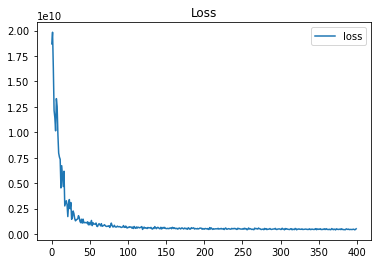

done 1 layers in 76.63ms
predict class: yaleB05
test image label: yaleB19
predict residuals label: 4
test residuals label: 17
[32518.82103237]


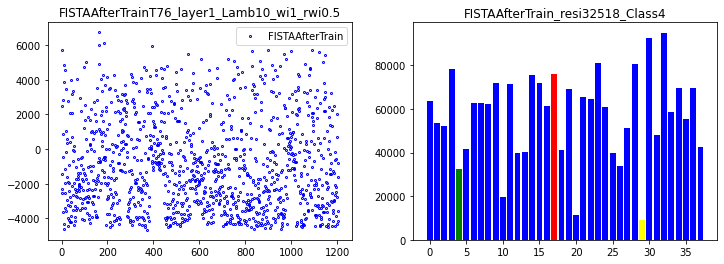

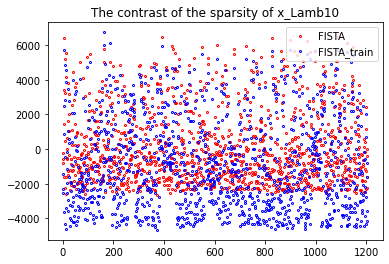

114
done 1 layers in 78.91ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[31029.50814495]


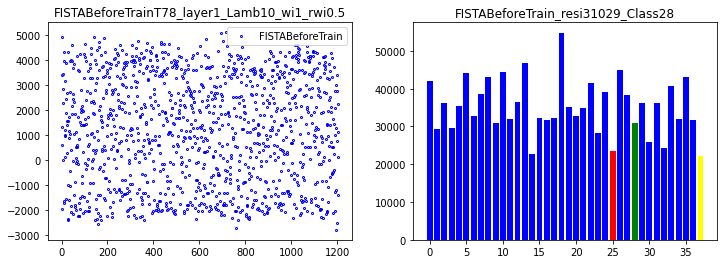

correct rate: 0.75
correct rate: 0.53125
correct rate: 0.625
correct rate: 0.65625
Epoch [ 10/100]: loss = 1307922874.6704,   lambda [max:10.0630], [min:9.9710], 
Epoch [ 20/100]: loss = 721077410.6874,   lambda [max:10.1029], [min:9.9714], 
Epoch [ 30/100]: loss = 569707262.6114,   lambda [max:10.1347], [min:9.9720], 
Epoch [ 40/100]: loss = 557454890.7144,   lambda [max:10.1625], [min:9.9720], 
Epoch [ 50/100]: loss = 600676539.6567,   lambda [max:10.1876], [min:9.9721], 
Epoch [ 60/100]: loss = 556354995.2912,   lambda [max:10.2108], [min:9.9721], 
Epoch [ 70/100]: loss = 466901291.3374,   lambda [max:10.2324], [min:9.9721], 
Epoch [ 80/100]: loss = 421377099.7877,   lambda [max:10.2527], [min:9.9718], 
Epoch [ 90/100]: loss = 458720666.0986,   lambda [max:10.2719], [min:9.9716], 
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 472110110.3795,   lambda [max:10.2902], [min:9.9713], 


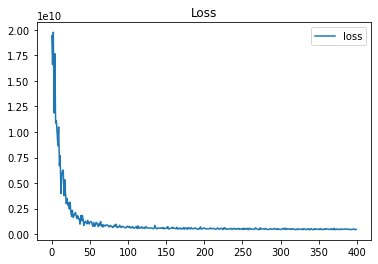

done 1 layers in 76.67ms
predict class: yaleB05
test image label: yaleB27
predict residuals label: 4
test residuals label: 25
[39102.67099397]


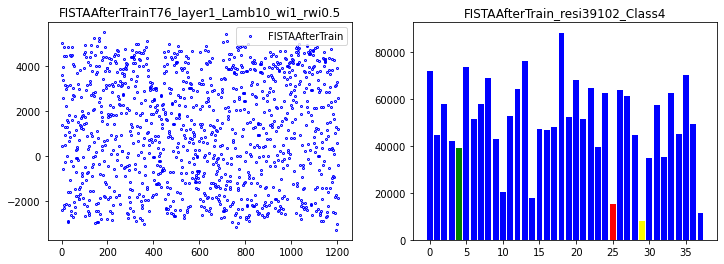

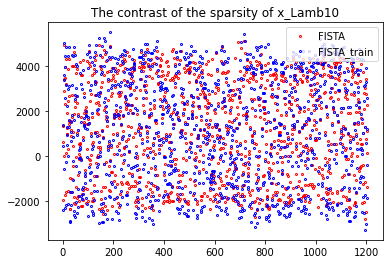

115
done 1 layers in 79.74ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[117197.18619119]


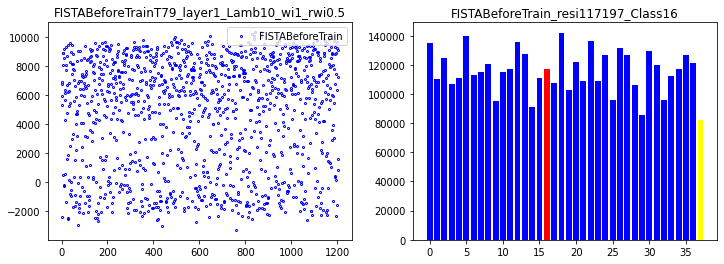

correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.46875
Epoch [ 10/100]: loss = 2096514168.4981,   lambda [max:10.0629], [min:9.9796], 
Epoch [ 20/100]: loss = 815568327.0998,   lambda [max:10.1029], [min:9.9836], 
Epoch [ 30/100]: loss = 616418982.2150,   lambda [max:10.1348], [min:9.9852], 
Epoch [ 40/100]: loss = 658759269.0843,   lambda [max:10.1626], [min:9.9862], 
Epoch [ 50/100]: loss = 702209693.2745,   lambda [max:10.1878], [min:9.9872], 
Epoch [ 60/100]: loss = 510174566.3738,   lambda [max:10.2109], [min:9.9881], 
Epoch [ 70/100]: loss = 479876035.6165,   lambda [max:10.2325], [min:9.9886], 
Epoch [ 80/100]: loss = 404875435.9154,   lambda [max:10.2527], [min:9.9889], 
Epoch [ 90/100]: loss = 523401881.8130,   lambda [max:10.2718], [min:9.9889], 
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.0625
Epoch [100/100]: loss = 476840954.8801,   lambda [max:10.2900], [min:9.9888], 


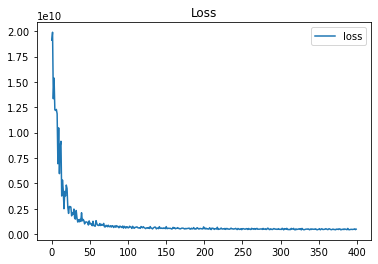

done 1 layers in 73.58ms
predict class: yaleB39
test image label: yaleB18
predict residuals label: 37
test residuals label: 16
[6291.95069604]


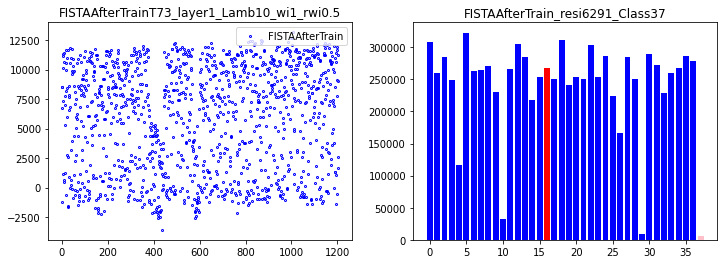

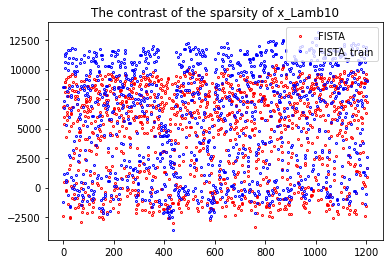

116
done 1 layers in 81.59ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[207823.02013693]


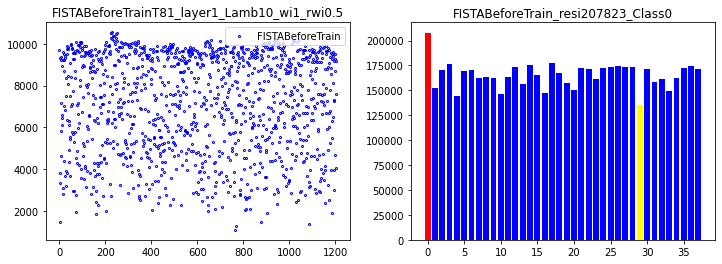

correct rate: 0.5
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.6875
Epoch [ 10/100]: loss = 1608884767.2363,   lambda [max:10.0630], [min:9.9685], 
Epoch [ 20/100]: loss = 722388973.7861,   lambda [max:10.1031], [min:9.9710], 
Epoch [ 30/100]: loss = 736105759.4982,   lambda [max:10.1352], [min:9.9711], 
Epoch [ 40/100]: loss = 692695460.0879,   lambda [max:10.1633], [min:9.9717], 
Epoch [ 50/100]: loss = 566462166.8013,   lambda [max:10.1887], [min:9.9718], 
Epoch [ 60/100]: loss = 488174621.6861,   lambda [max:10.2119], [min:9.9713], 
Epoch [ 70/100]: loss = 481028512.4313,   lambda [max:10.2336], [min:9.9714], 
Epoch [ 80/100]: loss = 457825489.8714,   lambda [max:10.2540], [min:9.9709], 
Epoch [ 90/100]: loss = 458030921.3219,   lambda [max:10.2732], [min:9.9709], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.0
correct rate: 0.09375
Epoch [100/100]: loss = 517140542.1332,   lambda [max:10.2916], [min:9.9710], 


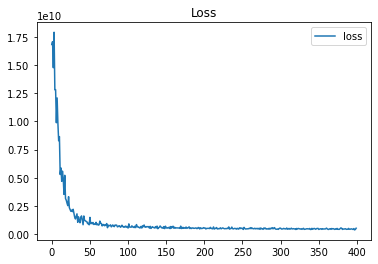

done 1 layers in 72.01ms
predict class: yaleB11
test image label: yaleB01
predict residuals label: 10
test residuals label: 0
[6331.51226946]


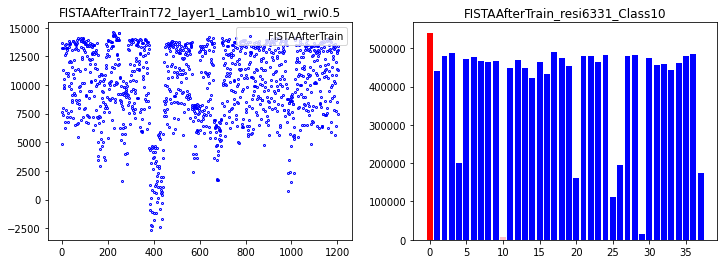

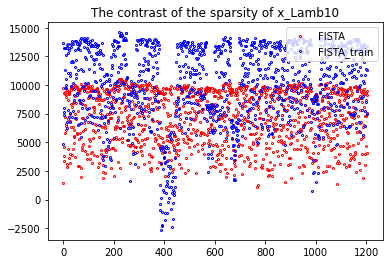

117
done 1 layers in 77.54ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[144025.54102348]


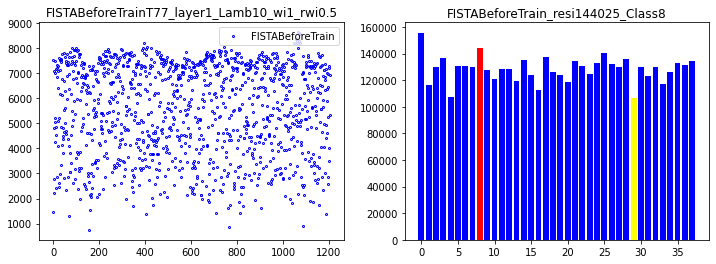

correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.65625
Epoch [ 10/100]: loss = 1669861258.7882,   lambda [max:10.0629], [min:9.9649], 
Epoch [ 20/100]: loss = 627328182.8183,   lambda [max:10.1029], [min:9.9658], 
Epoch [ 30/100]: loss = 534717002.0078,   lambda [max:10.1351], [min:9.9682], 
Epoch [ 40/100]: loss = 510510234.9455,   lambda [max:10.1633], [min:9.9705], 
Epoch [ 50/100]: loss = 451255652.7758,   lambda [max:10.1889], [min:9.9729], 
Epoch [ 60/100]: loss = 547188488.4625,   lambda [max:10.2125], [min:9.9758], 
Epoch [ 70/100]: loss = 443830013.5009,   lambda [max:10.2345], [min:9.9775], 
Epoch [ 80/100]: loss = 435940006.3928,   lambda [max:10.2552], [min:9.9780], 
Epoch [ 90/100]: loss = 452769803.9179,   lambda [max:10.2749], [min:9.9784], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.15625
correct rate: 0.03125
Epoch [100/100]: loss = 492592937.8429,   lambda [max:10.2935], [min:9.9793], 


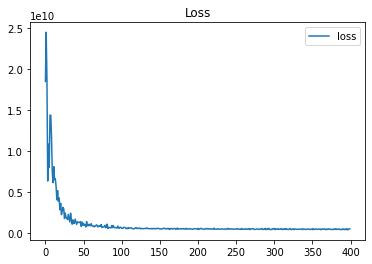

done 1 layers in 73.10ms
predict class: yaleB11
test image label: yaleB09
predict residuals label: 10
test residuals label: 8
[4954.83104927]


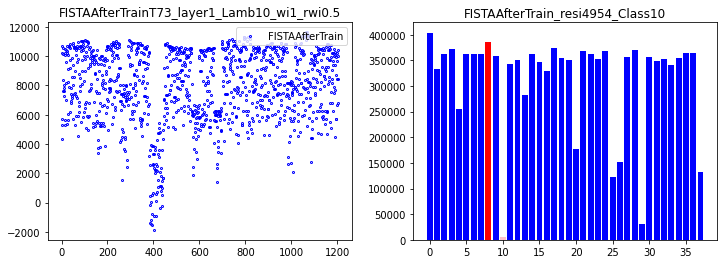

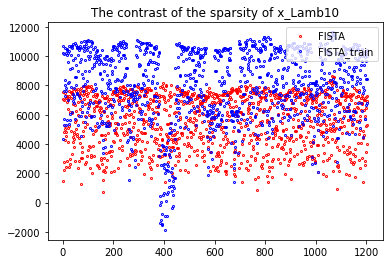

118
done 1 layers in 79.18ms
predict class: yaleB30
test image label: yaleB11
predict residuals label: 28
test residuals label: 10
[140785.74771459]


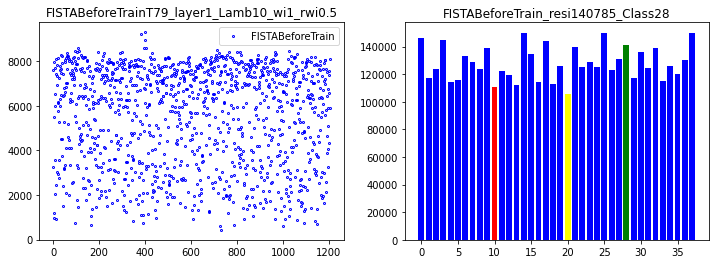

correct rate: 0.8125
correct rate: 0.59375
correct rate: 0.625
correct rate: 0.5625
Epoch [ 10/100]: loss = 1415932763.5691,   lambda [max:10.0629], [min:9.9682], 
Epoch [ 20/100]: loss = 723979604.2917,   lambda [max:10.1027], [min:9.9688], 
Epoch [ 30/100]: loss = 532153164.2956,   lambda [max:10.1347], [min:9.9621], 
Epoch [ 40/100]: loss = 457743674.0755,   lambda [max:10.1627], [min:9.9604], 
Epoch [ 50/100]: loss = 473105654.4632,   lambda [max:10.1883], [min:9.9646], 
Epoch [ 60/100]: loss = 471271810.4522,   lambda [max:10.2118], [min:9.9665], 
Epoch [ 70/100]: loss = 467316977.0272,   lambda [max:10.2337], [min:9.9688], 
Epoch [ 80/100]: loss = 462744602.6242,   lambda [max:10.2544], [min:9.9703], 
Epoch [ 90/100]: loss = 433379961.5796,   lambda [max:10.2740], [min:9.9699], 
correct rate: 0.1875
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.03125
Epoch [100/100]: loss = 471713859.3706,   lambda [max:10.2926], [min:9.9700], 


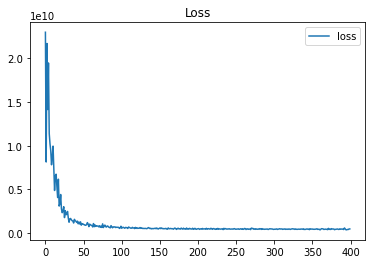

done 1 layers in 77.76ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[4508.93843432]


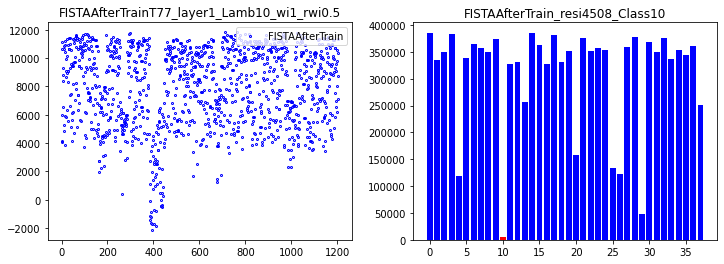

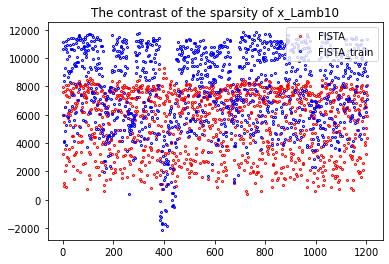

119
done 1 layers in 76.67ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[56893.779385]


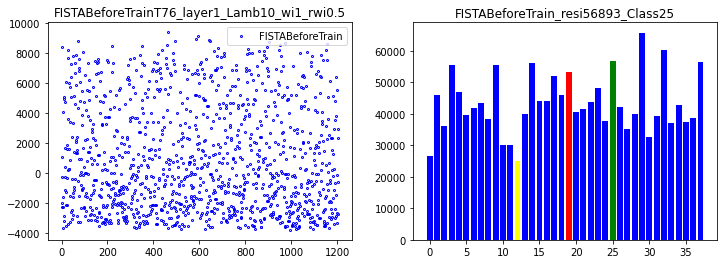

correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.5625
correct rate: 0.59375
Epoch [ 10/100]: loss = 1073134696.6162,   lambda [max:10.0627], [min:9.9634], 
Epoch [ 20/100]: loss = 844006146.1555,   lambda [max:10.1025], [min:9.9659], 
Epoch [ 30/100]: loss = 595268854.3795,   lambda [max:10.1343], [min:9.9654], 
Epoch [ 40/100]: loss = 595509542.0256,   lambda [max:10.1622], [min:9.9660], 
Epoch [ 50/100]: loss = 572908239.4795,   lambda [max:10.1874], [min:9.9668], 
Epoch [ 60/100]: loss = 484700010.0761,   lambda [max:10.2106], [min:9.9667], 
Epoch [ 70/100]: loss = 495945512.4845,   lambda [max:10.2322], [min:9.9672], 
Epoch [ 80/100]: loss = 475730398.9941,   lambda [max:10.2524], [min:9.9675], 
Epoch [ 90/100]: loss = 431236460.9473,   lambda [max:10.2717], [min:9.9680], 
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.0625
Epoch [100/100]: loss = 462573910.7058,   lambda [max:10.2899], [min:9.9685], 


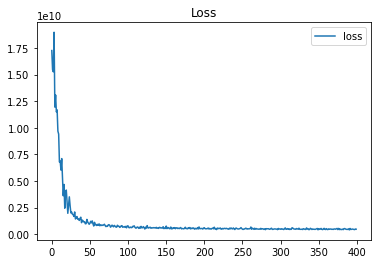

done 1 layers in 88.69ms
predict class: yaleB39
test image label: yaleB21
predict residuals label: 37
test residuals label: 19
[121073.55324882]


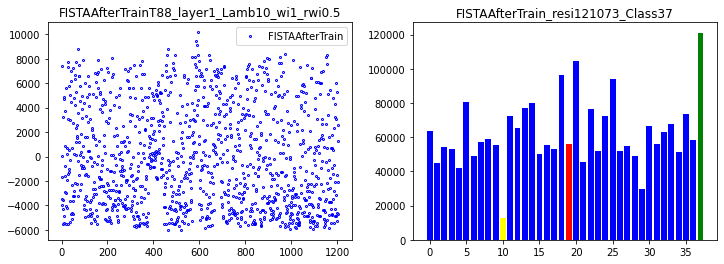

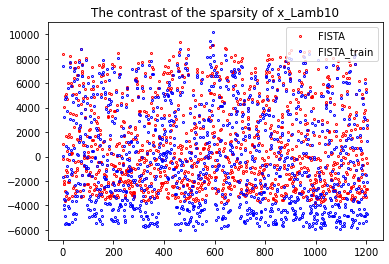

120
done 10 layers in 86.47ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[13940.52443046]


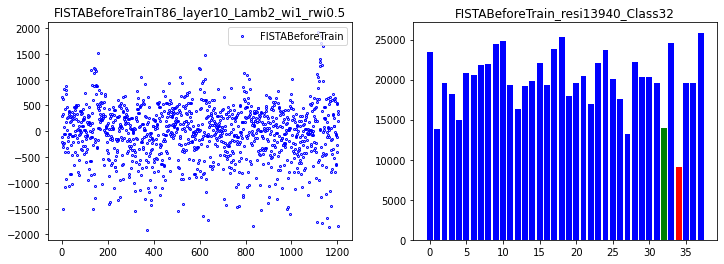

correct rate: 0.5625
correct rate: 0.625
correct rate: 0.625
correct rate: 0.625
Epoch [ 10/100]: loss = 40612582.0461,   lambda [max:2.0479], [min:1.9542], 
Epoch [ 20/100]: loss = 26132540.7708,   lambda [max:2.0664], [min:1.9317], 
Epoch [ 30/100]: loss = 19328052.6452,   lambda [max:2.0709], [min:1.9185], 
Epoch [ 40/100]: loss = 16192916.4484,   lambda [max:2.0739], [min:1.9101], 
Epoch [ 50/100]: loss = 14564414.7909,   lambda [max:2.0764], [min:1.9035], 
Epoch [ 60/100]: loss = 12812864.4278,   lambda [max:2.0815], [min:1.8992], 
Epoch [ 70/100]: loss = 10965639.2945,   lambda [max:2.0924], [min:1.8948], 
Epoch [ 80/100]: loss = 9022338.2657,   lambda [max:2.1029], [min:1.8918], 
Epoch [ 90/100]: loss = 8910771.5325,   lambda [max:2.1133], [min:1.8894], 
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.6875
Epoch [100/100]: loss = 7008082.9982,   lambda [max:2.1239], [min:1.8873], 


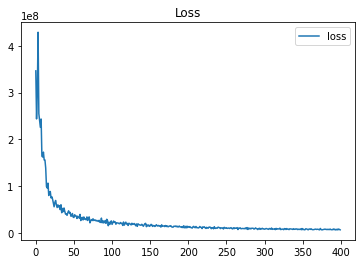

done 10 layers in 90.38ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[1238.98751207]


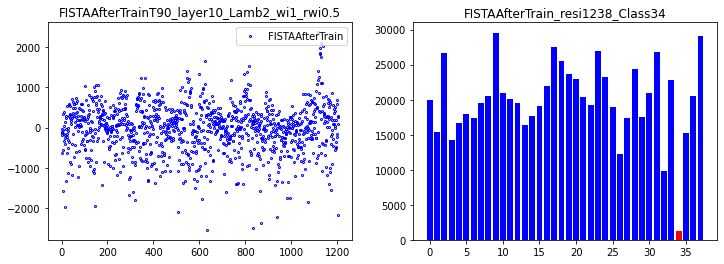

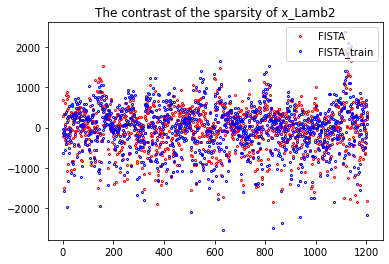

121
done 10 layers in 94.38ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[8822.25222553]


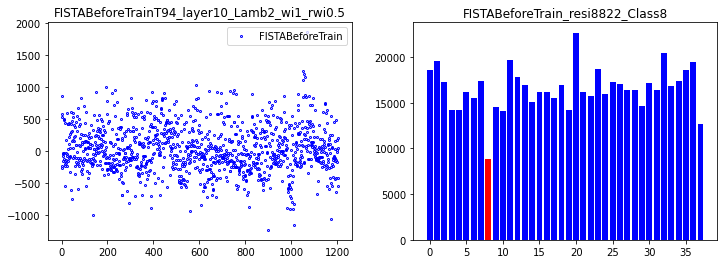

correct rate: 0.59375
correct rate: 0.625
correct rate: 0.625
correct rate: 0.625
Epoch [ 10/100]: loss = 45391870.4545,   lambda [max:2.0494], [min:1.9629], 
Epoch [ 20/100]: loss = 27376951.2475,   lambda [max:2.0606], [min:1.9413], 
Epoch [ 30/100]: loss = 20416176.8447,   lambda [max:2.0680], [min:1.9278], 
Epoch [ 40/100]: loss = 11954676.5140,   lambda [max:2.0744], [min:1.9194], 
Epoch [ 50/100]: loss = 12834143.7658,   lambda [max:2.0848], [min:1.9132], 
Epoch [ 60/100]: loss = 11205871.9862,   lambda [max:2.0915], [min:1.9079], 
Epoch [ 70/100]: loss = 10195016.1473,   lambda [max:2.0969], [min:1.9037], 
Epoch [ 80/100]: loss = 9095184.1304,   lambda [max:2.1015], [min:1.9000], 
Epoch [ 90/100]: loss = 8724369.4773,   lambda [max:2.1058], [min:1.8970], 
correct rate: 0.625
correct rate: 0.75
correct rate: 0.625
correct rate: 0.625
Epoch [100/100]: loss = 6951925.7809,   lambda [max:2.1094], [min:1.8939], 


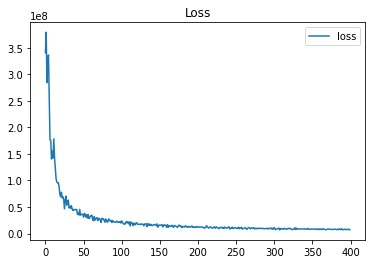

done 10 layers in 88.36ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1409.95208046]


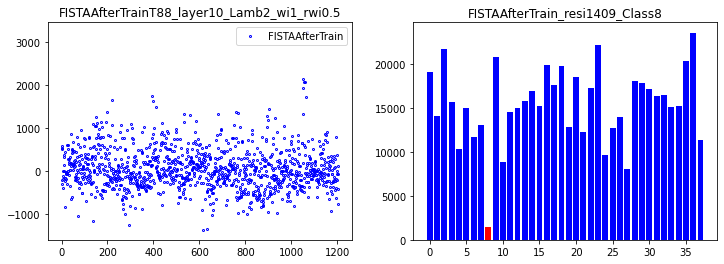

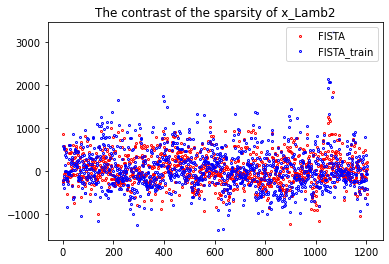

122
done 10 layers in 90.13ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6060.17098924]


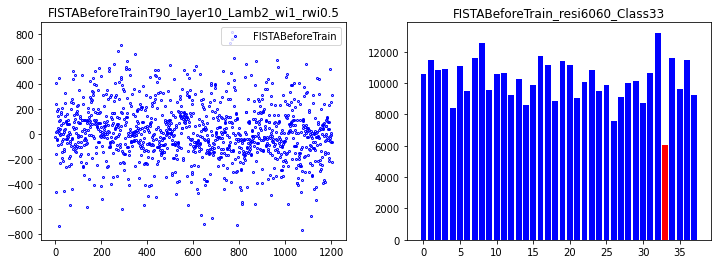

correct rate: 0.625
correct rate: 0.625
correct rate: 0.625
correct rate: 0.625
Epoch [ 10/100]: loss = 44362670.2307,   lambda [max:2.0493], [min:1.9635], 
Epoch [ 20/100]: loss = 27752455.0728,   lambda [max:2.0645], [min:1.9452], 
Epoch [ 30/100]: loss = 19172657.8270,   lambda [max:2.0715], [min:1.9295], 
Epoch [ 40/100]: loss = 13976324.7766,   lambda [max:2.0804], [min:1.9178], 
Epoch [ 50/100]: loss = 11619562.1761,   lambda [max:2.0880], [min:1.9085], 
Epoch [ 60/100]: loss = 11062861.7376,   lambda [max:2.0942], [min:1.9007], 
Epoch [ 70/100]: loss = 10203315.8662,   lambda [max:2.0990], [min:1.8943], 
Epoch [ 80/100]: loss = 9004457.8678,   lambda [max:2.1035], [min:1.8891], 
Epoch [ 90/100]: loss = 7523241.8622,   lambda [max:2.1070], [min:1.8847], 
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.625
Epoch [100/100]: loss = 7527558.4428,   lambda [max:2.1156], [min:1.8805], 


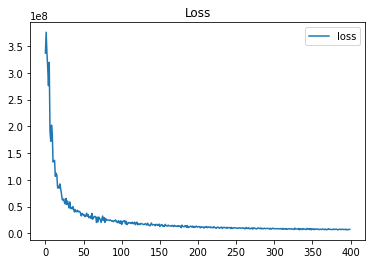

done 10 layers in 95.03ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[1168.64428672]


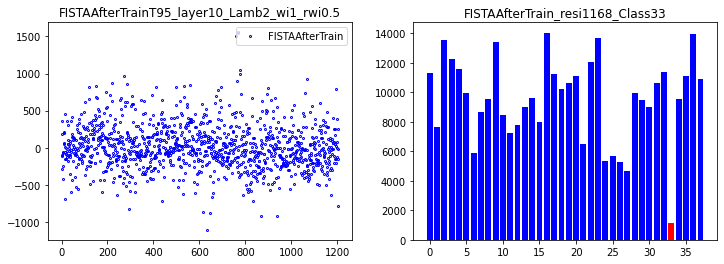

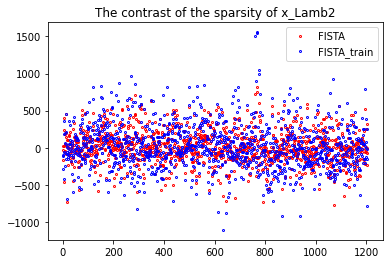

123
done 10 layers in 88.07ms
predict class: yaleB31
test image label: yaleB19
predict residuals label: 29
test residuals label: 17
[7793.78350232]


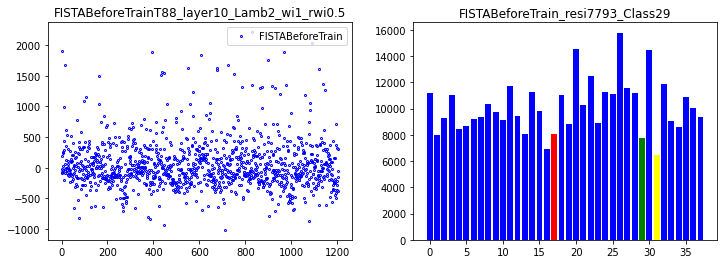

correct rate: 0.625
correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 36174466.1016,   lambda [max:2.0478], [min:1.9676], 
Epoch [ 20/100]: loss = 22728023.9526,   lambda [max:2.0673], [min:1.9508], 
Epoch [ 30/100]: loss = 18251341.3609,   lambda [max:2.0718], [min:1.9377], 
Epoch [ 40/100]: loss = 15486371.7455,   lambda [max:2.0750], [min:1.9291], 
Epoch [ 50/100]: loss = 11868534.0526,   lambda [max:2.0771], [min:1.9221], 
Epoch [ 60/100]: loss = 9726901.3402,   lambda [max:2.0793], [min:1.9165], 
Epoch [ 70/100]: loss = 9694047.0379,   lambda [max:2.0879], [min:1.9121], 
Epoch [ 80/100]: loss = 8303591.0397,   lambda [max:2.0979], [min:1.9083], 
Epoch [ 90/100]: loss = 7337333.1817,   lambda [max:2.1080], [min:1.9051], 
correct rate: 0.84375
correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.53125
Epoch [100/100]: loss = 7557326.4573,   lambda [max:2.1179], [min:1.9021], 


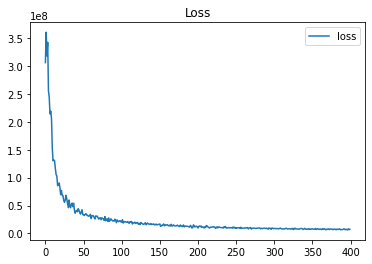

done 10 layers in 86.23ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[2295.16708897]


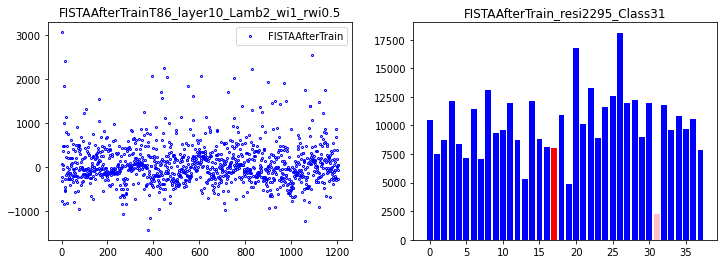

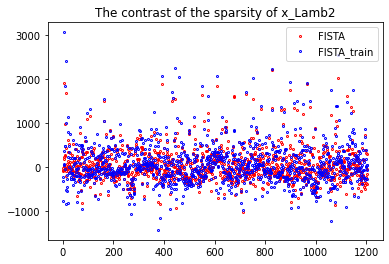

124
done 10 layers in 87.54ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[7972.95029419]


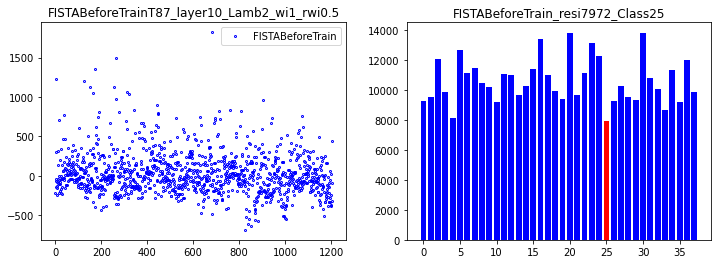

correct rate: 0.4375
correct rate: 0.75
correct rate: 0.59375
correct rate: 0.71875
Epoch [ 10/100]: loss = 41390151.1651,   lambda [max:2.0499], [min:1.9578], 
Epoch [ 20/100]: loss = 28506878.5781,   lambda [max:2.0677], [min:1.9369], 
Epoch [ 30/100]: loss = 19765656.3374,   lambda [max:2.0722], [min:1.9248], 
Epoch [ 40/100]: loss = 15276479.0558,   lambda [max:2.0755], [min:1.9158], 
Epoch [ 50/100]: loss = 14425226.9935,   lambda [max:2.0872], [min:1.9088], 
Epoch [ 60/100]: loss = 10184723.4488,   lambda [max:2.1005], [min:1.9038], 
Epoch [ 70/100]: loss = 9250669.9799,   lambda [max:2.1131], [min:1.8989], 
Epoch [ 80/100]: loss = 6727078.9897,   lambda [max:2.1252], [min:1.8955], 
Epoch [ 90/100]: loss = 7525275.1449,   lambda [max:2.1367], [min:1.8920], 
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.625
Epoch [100/100]: loss = 7102051.0155,   lambda [max:2.1483], [min:1.8889], 


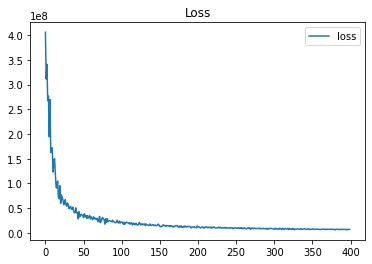

done 10 layers in 92.19ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[919.29991019]


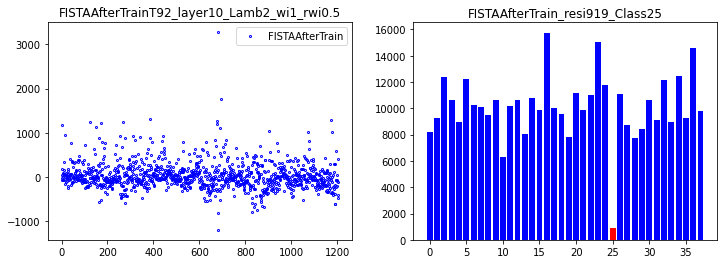

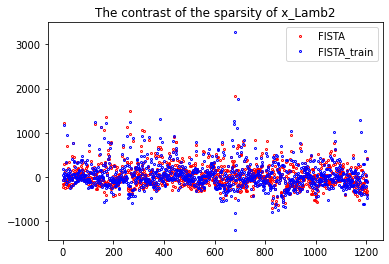

125
done 10 layers in 88.29ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[10511.60811205]


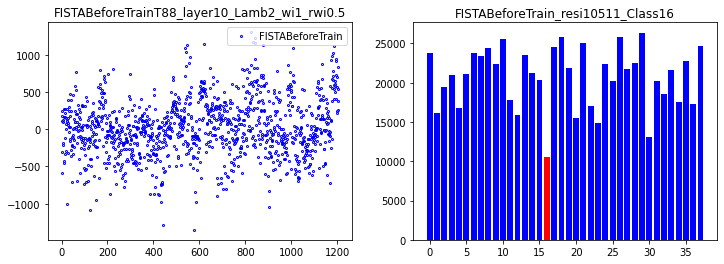

correct rate: 0.4375
correct rate: 0.53125
correct rate: 0.875
correct rate: 0.59375
Epoch [ 10/100]: loss = 47949673.1755,   lambda [max:2.0491], [min:1.9654], 
Epoch [ 20/100]: loss = 24006292.6811,   lambda [max:2.0649], [min:1.9478], 
Epoch [ 30/100]: loss = 18999003.0019,   lambda [max:2.0695], [min:1.9366], 
Epoch [ 40/100]: loss = 13731946.0047,   lambda [max:2.0724], [min:1.9281], 
Epoch [ 50/100]: loss = 9884062.5709,   lambda [max:2.0746], [min:1.9219], 
Epoch [ 60/100]: loss = 10739808.8766,   lambda [max:2.0816], [min:1.9167], 
Epoch [ 70/100]: loss = 9289903.2659,   lambda [max:2.0917], [min:1.9126], 
Epoch [ 80/100]: loss = 7898532.6638,   lambda [max:2.1018], [min:1.9094], 
Epoch [ 90/100]: loss = 7339150.0059,   lambda [max:2.1113], [min:1.9061], 
correct rate: 0.625
correct rate: 0.5
correct rate: 0.71875
correct rate: 0.8125
Epoch [100/100]: loss = 6991069.7116,   lambda [max:2.1208], [min:1.9030], 


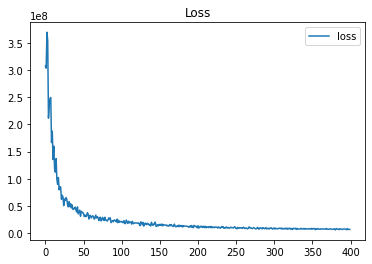

done 10 layers in 86.48ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[502.5402956]


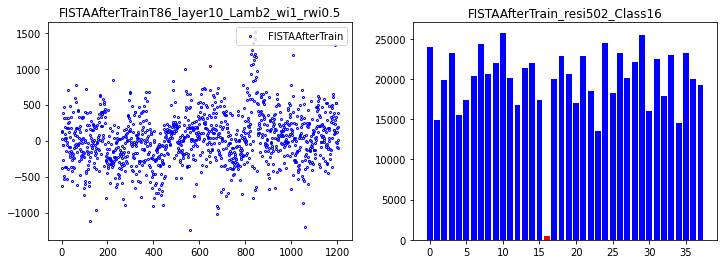

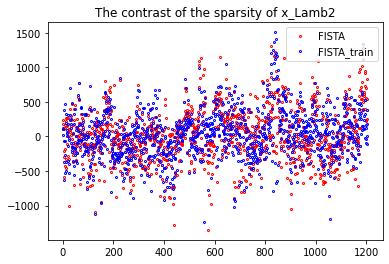

126
done 10 layers in 89.19ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[8533.40620913]


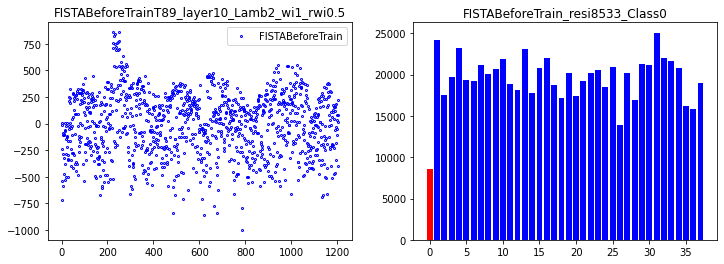

correct rate: 0.625
correct rate: 0.53125
correct rate: 0.78125
correct rate: 0.5625
Epoch [ 10/100]: loss = 39364837.9080,   lambda [max:2.0495], [min:1.9596], 
Epoch [ 20/100]: loss = 27973776.5505,   lambda [max:2.0617], [min:1.9467], 
Epoch [ 30/100]: loss = 20024846.5744,   lambda [max:2.0671], [min:1.9357], 
Epoch [ 40/100]: loss = 13728241.4732,   lambda [max:2.0699], [min:1.9281], 
Epoch [ 50/100]: loss = 12558554.5307,   lambda [max:2.0749], [min:1.9223], 
Epoch [ 60/100]: loss = 9906513.5375,   lambda [max:2.0812], [min:1.9175], 
Epoch [ 70/100]: loss = 9779564.1306,   lambda [max:2.0875], [min:1.9138], 
Epoch [ 80/100]: loss = 9019119.1926,   lambda [max:2.0938], [min:1.9106], 
Epoch [ 90/100]: loss = 7692807.8591,   lambda [max:2.1044], [min:1.9075], 
correct rate: 0.75
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.625
Epoch [100/100]: loss = 7821350.8297,   lambda [max:2.1155], [min:1.9049], 


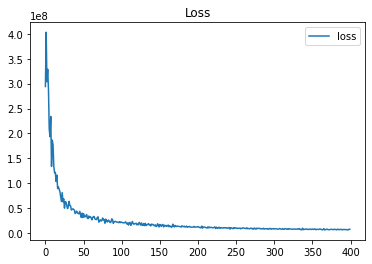

done 10 layers in 88.28ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1019.17353196]


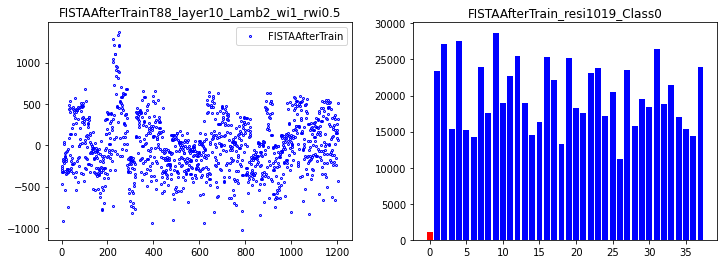

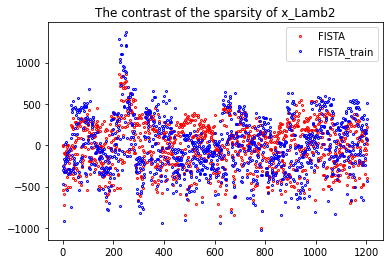

127
done 10 layers in 87.39ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2517.91581253]


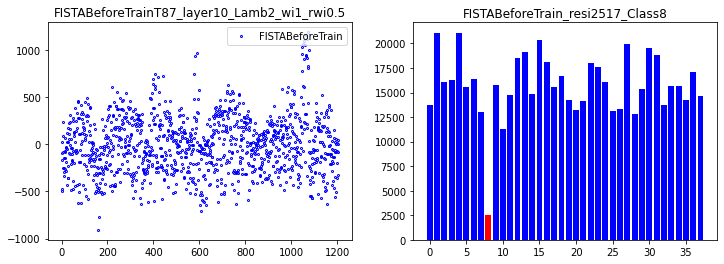

correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.78125
correct rate: 0.5
Epoch [ 10/100]: loss = 53161400.7495,   lambda [max:2.0482], [min:1.9655], 
Epoch [ 20/100]: loss = 26242133.7845,   lambda [max:2.0645], [min:1.9452], 
Epoch [ 30/100]: loss = 19853120.2504,   lambda [max:2.0696], [min:1.9293], 
Epoch [ 40/100]: loss = 14681186.0387,   lambda [max:2.0725], [min:1.9176], 
Epoch [ 50/100]: loss = 12573800.9922,   lambda [max:2.0753], [min:1.9080], 
Epoch [ 60/100]: loss = 10708522.6460,   lambda [max:2.0777], [min:1.9000], 
Epoch [ 70/100]: loss = 9289937.9341,   lambda [max:2.0811], [min:1.8939], 
Epoch [ 80/100]: loss = 8676990.7301,   lambda [max:2.0852], [min:1.8884], 
Epoch [ 90/100]: loss = 8622001.0815,   lambda [max:2.0901], [min:1.8838], 
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.71875
Epoch [100/100]: loss = 7415820.5435,   lambda [max:2.0960], [min:1.8797], 


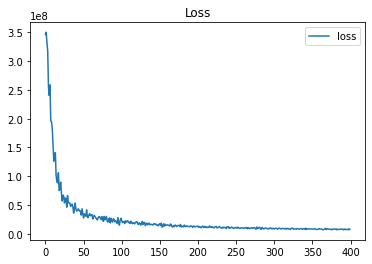

done 10 layers in 85.63ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1731.3423613]


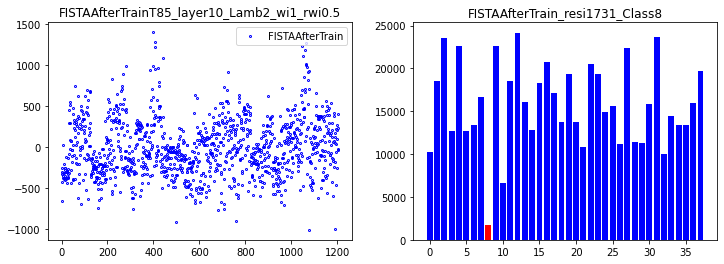

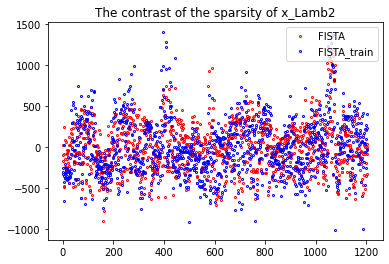

128
done 10 layers in 88.74ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[9766.92064843]


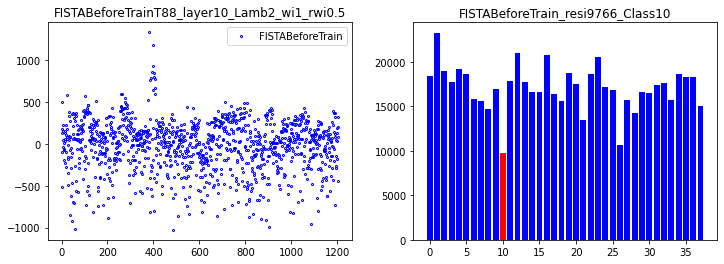

correct rate: 0.625
correct rate: 0.5
correct rate: 0.65625
correct rate: 0.59375
Epoch [ 10/100]: loss = 45100495.7841,   lambda [max:2.0512], [min:1.9693], 
Epoch [ 20/100]: loss = 28294357.0590,   lambda [max:2.0638], [min:1.9498], 
Epoch [ 30/100]: loss = 17527961.7505,   lambda [max:2.0678], [min:1.9341], 
Epoch [ 40/100]: loss = 16393407.8118,   lambda [max:2.0706], [min:1.9223], 
Epoch [ 50/100]: loss = 12840665.1791,   lambda [max:2.0730], [min:1.9130], 
Epoch [ 60/100]: loss = 10668384.7802,   lambda [max:2.0749], [min:1.9054], 
Epoch [ 70/100]: loss = 10771835.6781,   lambda [max:2.0830], [min:1.8991], 
Epoch [ 80/100]: loss = 9318291.4532,   lambda [max:2.0921], [min:1.8933], 
Epoch [ 90/100]: loss = 9206212.6875,   lambda [max:2.1011], [min:1.8883], 
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.75
Epoch [100/100]: loss = 7266187.9118,   lambda [max:2.1103], [min:1.8836], 


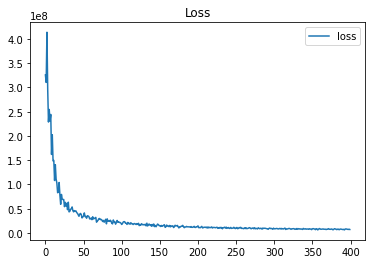

done 10 layers in 89.80ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1436.96927585]


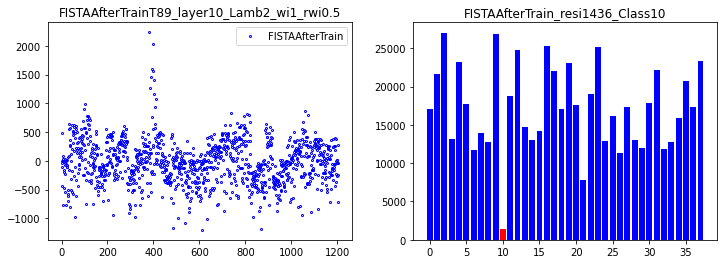

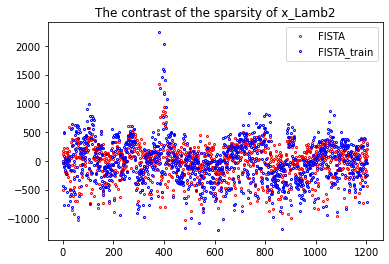

129
done 10 layers in 88.04ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[9010.09097018]


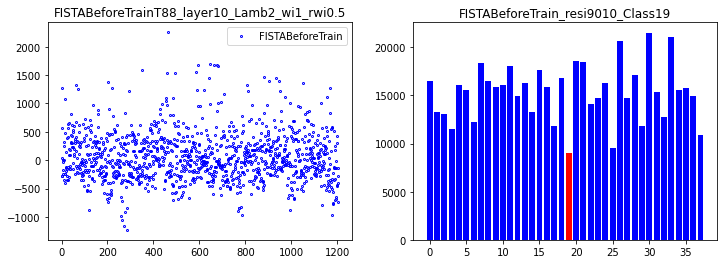

correct rate: 0.75
correct rate: 0.53125
correct rate: 0.625
correct rate: 0.53125
Epoch [ 10/100]: loss = 36533984.3711,   lambda [max:2.0518], [min:1.9651], 
Epoch [ 20/100]: loss = 27890002.2743,   lambda [max:2.0624], [min:1.9498], 
Epoch [ 30/100]: loss = 16633604.4697,   lambda [max:2.0698], [min:1.9372], 
Epoch [ 40/100]: loss = 15418891.1031,   lambda [max:2.0765], [min:1.9288], 
Epoch [ 50/100]: loss = 13156871.2293,   lambda [max:2.0819], [min:1.9225], 
Epoch [ 60/100]: loss = 10365704.4771,   lambda [max:2.0865], [min:1.9172], 
Epoch [ 70/100]: loss = 9165988.0023,   lambda [max:2.0916], [min:1.9125], 
Epoch [ 80/100]: loss = 8378513.1384,   lambda [max:2.0969], [min:1.9086], 
Epoch [ 90/100]: loss = 8258140.0536,   lambda [max:2.1034], [min:1.9052], 
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.53125
Epoch [100/100]: loss = 7621313.2661,   lambda [max:2.1123], [min:1.9022], 


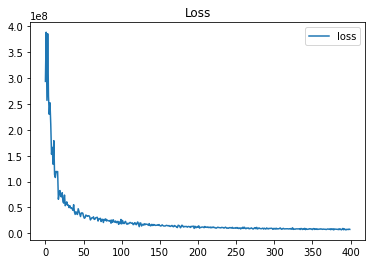

done 10 layers in 91.65ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[2847.04754018]


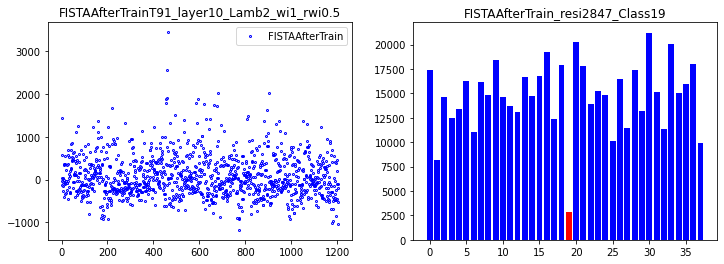

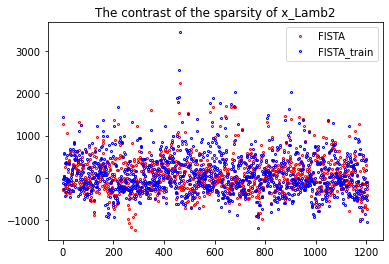

130
done 5 layers in 82.41ms
predict class: yaleB05
test image label: yaleB36
predict residuals label: 4
test residuals label: 34
[16737.76588462]


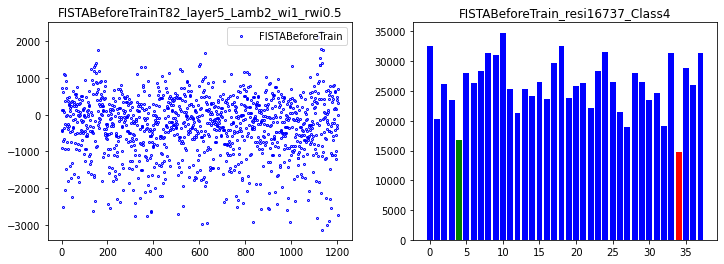

correct rate: 0.53125
correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.34375
Epoch [ 10/100]: loss = 54822561.0333,   lambda [max:2.0367], [min:1.9754], 
Epoch [ 20/100]: loss = 37036781.6178,   lambda [max:2.0515], [min:1.9659], 
Epoch [ 30/100]: loss = 27176808.6469,   lambda [max:2.0668], [min:1.9540], 
Epoch [ 40/100]: loss = 23331980.1966,   lambda [max:2.0910], [min:1.9448], 
Epoch [ 50/100]: loss = 19993116.4998,   lambda [max:2.1139], [min:1.9399], 
Epoch [ 60/100]: loss = 18015365.0768,   lambda [max:2.1355], [min:1.9358], 
Epoch [ 70/100]: loss = 17226097.0757,   lambda [max:2.1564], [min:1.9331], 
Epoch [ 80/100]: loss = 14404619.1392,   lambda [max:2.1762], [min:1.9303], 
Epoch [ 90/100]: loss = 13360921.3370,   lambda [max:2.1952], [min:1.9288], 
correct rate: 0.4375
correct rate: 0.21875
correct rate: 0.3125
correct rate: 0.3125
Epoch [100/100]: loss = 14089776.4314,   lambda [max:2.2130], [min:1.9272], 


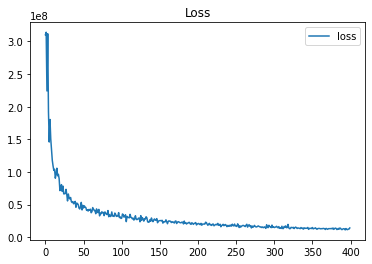

done 5 layers in 81.86ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[1413.39480655]


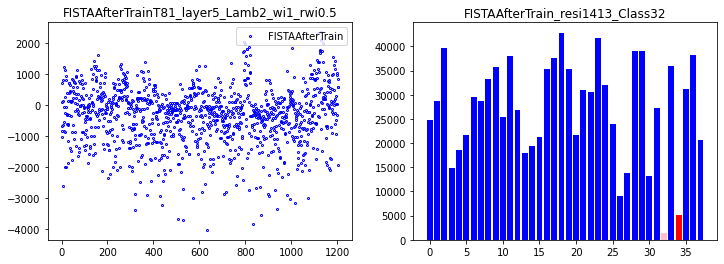

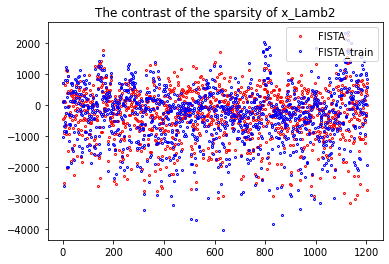

131
done 5 layers in 88.24ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[4445.81433131]


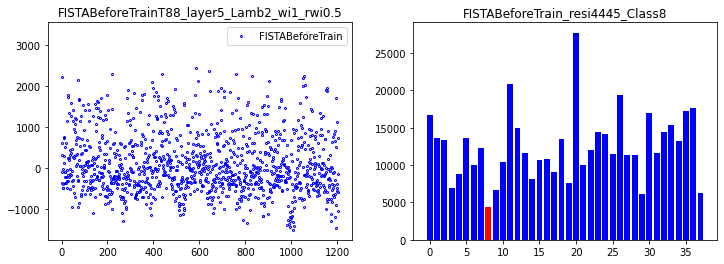

correct rate: 0.40625
correct rate: 0.3125
correct rate: 0.59375
correct rate: 0.3125
Epoch [ 10/100]: loss = 49353383.3114,   lambda [max:2.0381], [min:1.9619], 
Epoch [ 20/100]: loss = 34899880.3277,   lambda [max:2.0469], [min:1.9506], 
Epoch [ 30/100]: loss = 28119406.9401,   lambda [max:2.0628], [min:1.9423], 
Epoch [ 40/100]: loss = 21558210.4108,   lambda [max:2.0816], [min:1.9344], 
Epoch [ 50/100]: loss = 22266968.5061,   lambda [max:2.1004], [min:1.9283], 
Epoch [ 60/100]: loss = 19052191.1029,   lambda [max:2.1188], [min:1.9242], 
Epoch [ 70/100]: loss = 15546182.4405,   lambda [max:2.1364], [min:1.9194], 
Epoch [ 80/100]: loss = 14939361.6448,   lambda [max:2.1536], [min:1.9169], 
Epoch [ 90/100]: loss = 13415602.2764,   lambda [max:2.1706], [min:1.9146], 
correct rate: 0.34375
correct rate: 0.34375
correct rate: 0.34375
correct rate: 0.25
Epoch [100/100]: loss = 12461698.8306,   lambda [max:2.1868], [min:1.9123], 


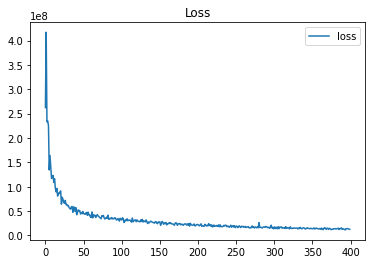

done 5 layers in 81.47ms
predict class: yaleB39
test image label: yaleB09
predict residuals label: 37
test residuals label: 8
[4363.0900463]


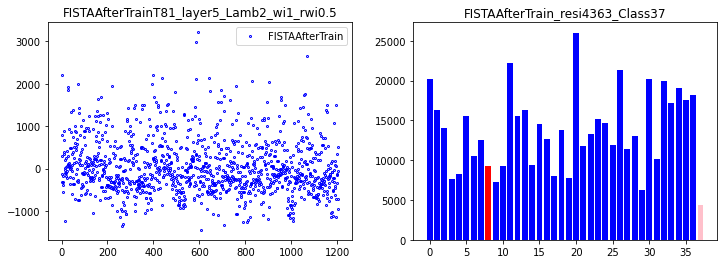

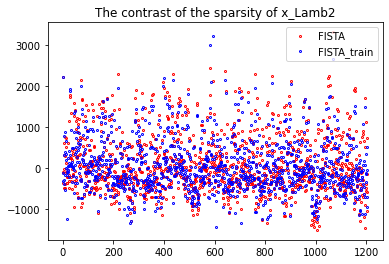

132
done 5 layers in 81.00ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4656.20968395]


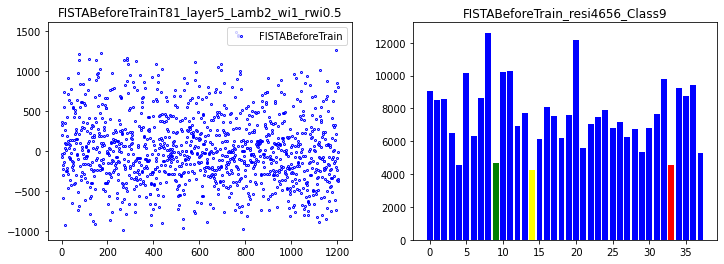

correct rate: 0.375
correct rate: 0.46875
correct rate: 0.5
correct rate: 0.375
Epoch [ 10/100]: loss = 57537326.3913,   lambda [max:2.0398], [min:1.9684], 
Epoch [ 20/100]: loss = 33943747.9435,   lambda [max:2.0519], [min:1.9559], 
Epoch [ 30/100]: loss = 28946695.9550,   lambda [max:2.0721], [min:1.9478], 
Epoch [ 40/100]: loss = 22291581.5270,   lambda [max:2.0957], [min:1.9411], 
Epoch [ 50/100]: loss = 19833268.8426,   lambda [max:2.1179], [min:1.9367], 
Epoch [ 60/100]: loss = 17610843.5559,   lambda [max:2.1397], [min:1.9321], 
Epoch [ 70/100]: loss = 18626294.7808,   lambda [max:2.1611], [min:1.9307], 
Epoch [ 80/100]: loss = 13997309.4720,   lambda [max:2.1805], [min:1.9295], 
Epoch [ 90/100]: loss = 12026139.8855,   lambda [max:2.1998], [min:1.9277], 
correct rate: 0.34375
correct rate: 0.25
correct rate: 0.21875
correct rate: 0.3125
Epoch [100/100]: loss = 14008194.0842,   lambda [max:2.2181], [min:1.9276], 


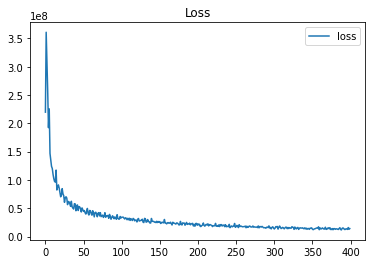

done 5 layers in 84.64ms
predict class: yaleB16
test image label: yaleB35
predict residuals label: 14
test residuals label: 33
[4197.76337856]


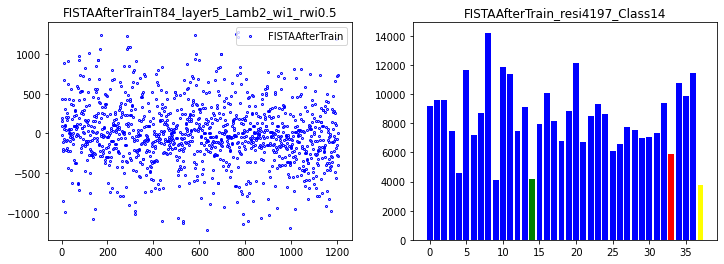

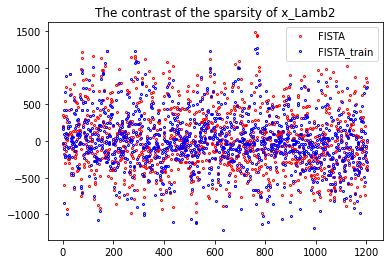

133
done 5 layers in 77.81ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[4966.87152919]


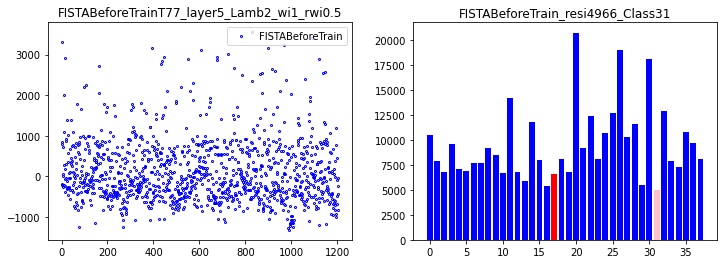

correct rate: 0.40625
correct rate: 0.40625
correct rate: 0.375
correct rate: 0.40625
Epoch [ 10/100]: loss = 55511496.0157,   lambda [max:2.0384], [min:1.9691], 
Epoch [ 20/100]: loss = 40661509.8056,   lambda [max:2.0580], [min:1.9622], 
Epoch [ 30/100]: loss = 29192642.7267,   lambda [max:2.0680], [min:1.9546], 
Epoch [ 40/100]: loss = 27212773.7789,   lambda [max:2.0791], [min:1.9498], 
Epoch [ 50/100]: loss = 20694048.3098,   lambda [max:2.0922], [min:1.9467], 
Epoch [ 60/100]: loss = 18242876.2417,   lambda [max:2.1045], [min:1.9445], 
Epoch [ 70/100]: loss = 17135742.0686,   lambda [max:2.1159], [min:1.9437], 
Epoch [ 80/100]: loss = 17848238.0084,   lambda [max:2.1262], [min:1.9433], 
Epoch [ 90/100]: loss = 13478465.5114,   lambda [max:2.1381], [min:1.9428], 
correct rate: 0.21875
correct rate: 0.21875
correct rate: 0.28125
correct rate: 0.4375
Epoch [100/100]: loss = 16729460.1490,   lambda [max:2.1524], [min:1.9432], 


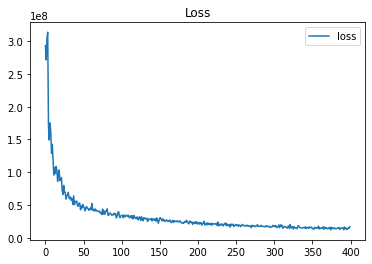

done 5 layers in 81.54ms
predict class: yaleB19
test image label: yaleB19
predict residuals label: 17
test residuals label: 17
[5605.46595049]


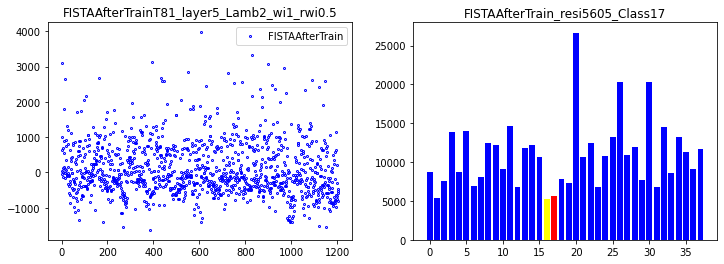

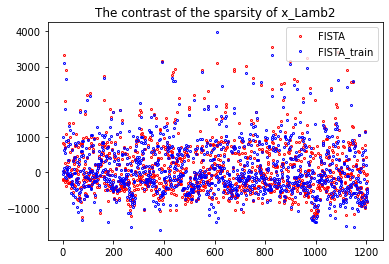

134
done 5 layers in 82.49ms
predict class: yaleB11
test image label: yaleB27
predict residuals label: 10
test residuals label: 25
[5465.60149539]


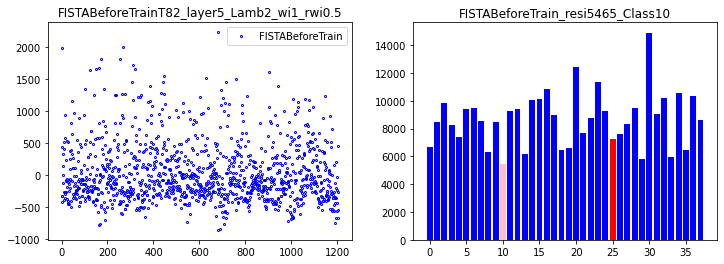

correct rate: 0.46875
correct rate: 0.4375
correct rate: 0.5
correct rate: 0.3125
Epoch [ 10/100]: loss = 57216268.5278,   lambda [max:2.0402], [min:1.9693], 
Epoch [ 20/100]: loss = 37933489.0323,   lambda [max:2.0558], [min:1.9558], 
Epoch [ 30/100]: loss = 29569588.8128,   lambda [max:2.0864], [min:1.9461], 
Epoch [ 40/100]: loss = 26933586.3294,   lambda [max:2.0999], [min:1.9401], 
Epoch [ 50/100]: loss = 19782255.3178,   lambda [max:2.1157], [min:1.9342], 
Epoch [ 60/100]: loss = 17038935.5181,   lambda [max:2.1343], [min:1.9303], 
Epoch [ 70/100]: loss = 15753314.1881,   lambda [max:2.1529], [min:1.9272], 
Epoch [ 80/100]: loss = 16417554.2236,   lambda [max:2.1699], [min:1.9252], 
Epoch [ 90/100]: loss = 14517638.1173,   lambda [max:2.1864], [min:1.9238], 
correct rate: 0.375
correct rate: 0.25
correct rate: 0.3125
correct rate: 0.25
Epoch [100/100]: loss = 12843885.0518,   lambda [max:2.2024], [min:1.9220], 


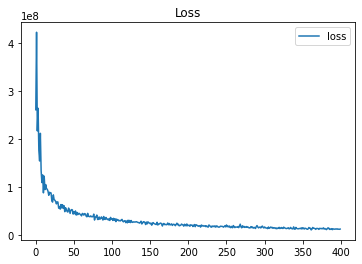

done 5 layers in 84.31ms
predict class: yaleB09
test image label: yaleB27
predict residuals label: 8
test residuals label: 25
[2894.58086044]


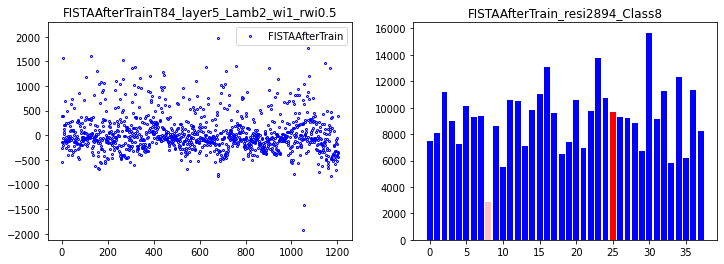

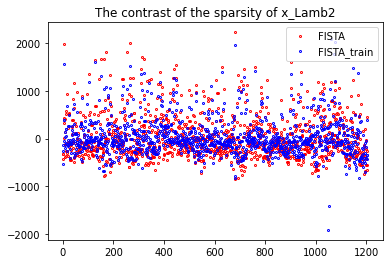

135
done 5 layers in 83.98ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[7226.74164134]


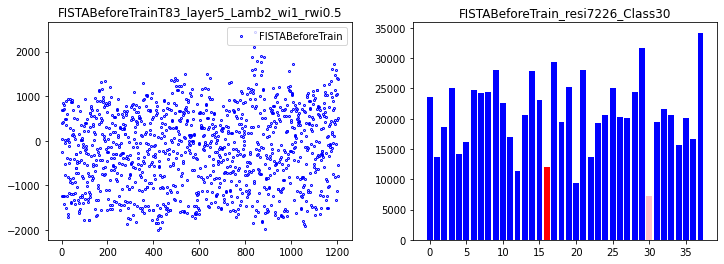

correct rate: 0.53125
correct rate: 0.375
correct rate: 0.5
correct rate: 0.375
Epoch [ 10/100]: loss = 51550470.9232,   lambda [max:2.0423], [min:1.9607], 
Epoch [ 20/100]: loss = 37534398.5305,   lambda [max:2.0574], [min:1.9538], 
Epoch [ 30/100]: loss = 30717118.8744,   lambda [max:2.0793], [min:1.9412], 
Epoch [ 40/100]: loss = 24951810.4594,   lambda [max:2.1027], [min:1.9339], 
Epoch [ 50/100]: loss = 21585557.6923,   lambda [max:2.1238], [min:1.9310], 
Epoch [ 60/100]: loss = 20741677.8290,   lambda [max:2.1440], [min:1.9304], 
Epoch [ 70/100]: loss = 17848925.6885,   lambda [max:2.1629], [min:1.9255], 
Epoch [ 80/100]: loss = 15735435.6269,   lambda [max:2.1814], [min:1.9227], 
Epoch [ 90/100]: loss = 15524196.5698,   lambda [max:2.1987], [min:1.9196], 
correct rate: 0.34375
correct rate: 0.1875
correct rate: 0.3125
correct rate: 0.25
Epoch [100/100]: loss = 13773190.4616,   lambda [max:2.2158], [min:1.9174], 


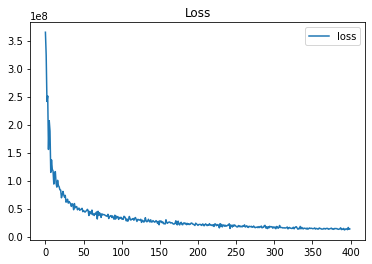

done 5 layers in 78.89ms
predict class: yaleB22
test image label: yaleB18
predict residuals label: 20
test residuals label: 16
[859.9652823]


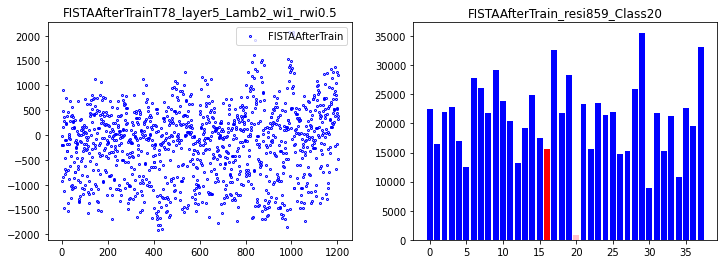

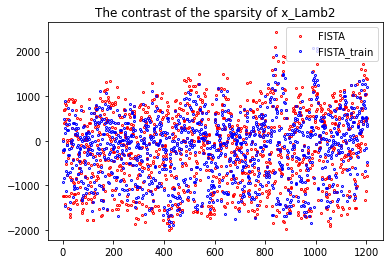

136
done 5 layers in 84.42ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[16822.41249805]


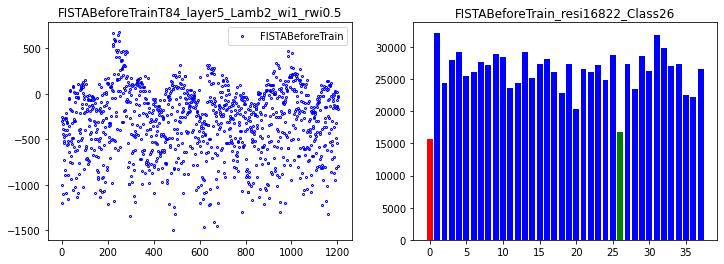

correct rate: 0.65625
correct rate: 0.4375
correct rate: 0.375
correct rate: 0.3125
Epoch [ 10/100]: loss = 55473033.0810,   lambda [max:2.0430], [min:1.9623], 
Epoch [ 20/100]: loss = 46841829.2771,   lambda [max:2.0590], [min:1.9492], 
Epoch [ 30/100]: loss = 26864948.4027,   lambda [max:2.0663], [min:1.9364], 
Epoch [ 40/100]: loss = 22852334.0460,   lambda [max:2.0874], [min:1.9289], 
Epoch [ 50/100]: loss = 21853890.3525,   lambda [max:2.1074], [min:1.9243], 
Epoch [ 60/100]: loss = 19086704.7022,   lambda [max:2.1267], [min:1.9232], 
Epoch [ 70/100]: loss = 18447838.0090,   lambda [max:2.1455], [min:1.9237], 
Epoch [ 80/100]: loss = 15547474.6429,   lambda [max:2.1633], [min:1.9244], 
Epoch [ 90/100]: loss = 13862227.4554,   lambda [max:2.1803], [min:1.9265], 
correct rate: 0.28125
correct rate: 0.25
correct rate: 0.34375
correct rate: 0.3125
Epoch [100/100]: loss = 13624383.8376,   lambda [max:2.1969], [min:1.9287], 


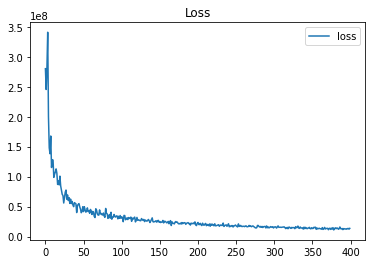

done 5 layers in 83.81ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1727.2129108]


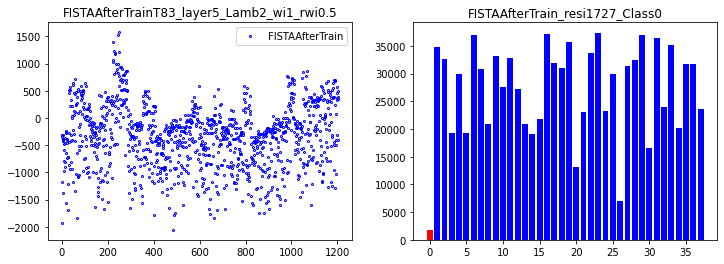

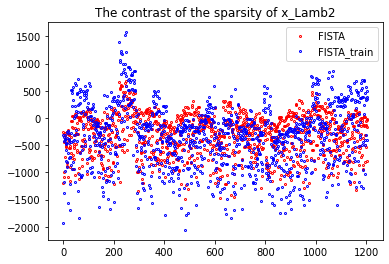

137
done 5 layers in 88.28ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[5129.07752112]


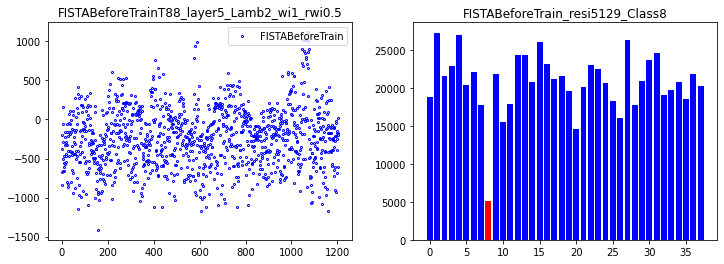

correct rate: 0.3125
correct rate: 0.34375
correct rate: 0.53125
correct rate: 0.46875
Epoch [ 10/100]: loss = 44296550.5701,   lambda [max:2.0418], [min:1.9627], 
Epoch [ 20/100]: loss = 39431901.5189,   lambda [max:2.0651], [min:1.9512], 
Epoch [ 30/100]: loss = 28049271.9470,   lambda [max:2.0801], [min:1.9398], 
Epoch [ 40/100]: loss = 26732648.3872,   lambda [max:2.0949], [min:1.9276], 
Epoch [ 50/100]: loss = 20928547.1747,   lambda [max:2.1171], [min:1.9201], 
Epoch [ 60/100]: loss = 17624274.0243,   lambda [max:2.1378], [min:1.9140], 
Epoch [ 70/100]: loss = 16329800.4353,   lambda [max:2.1573], [min:1.9106], 
Epoch [ 80/100]: loss = 17033230.7324,   lambda [max:2.1759], [min:1.9083], 
Epoch [ 90/100]: loss = 13637949.4970,   lambda [max:2.1937], [min:1.9054], 
correct rate: 0.34375
correct rate: 0.28125
correct rate: 0.3125
correct rate: 0.15625
Epoch [100/100]: loss = 13676860.3301,   lambda [max:2.2105], [min:1.9039], 


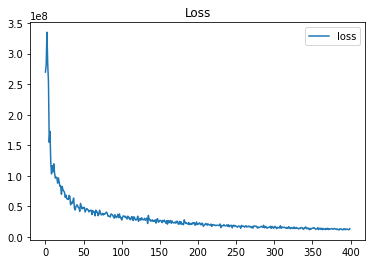

done 5 layers in 83.00ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1955.75068456]


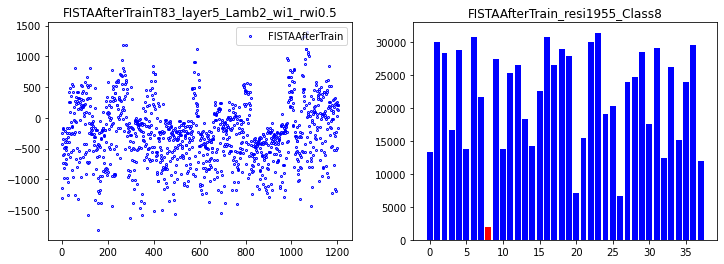

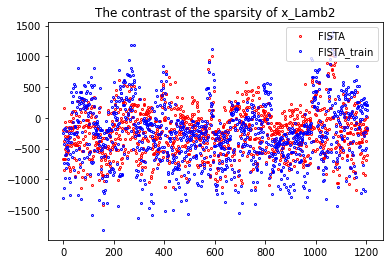

138
done 5 layers in 82.29ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[15796.94470236]


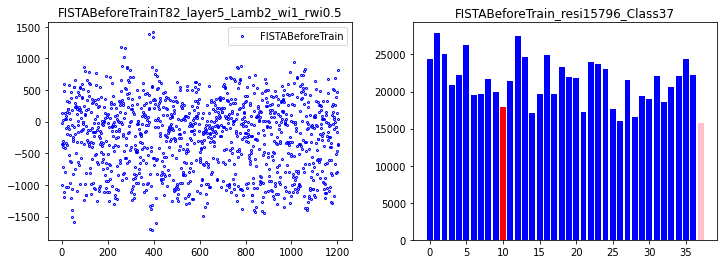

correct rate: 0.4375
correct rate: 0.375
correct rate: 0.53125
correct rate: 0.3125
Epoch [ 10/100]: loss = 58156399.0755,   lambda [max:2.0408], [min:1.9759], 
Epoch [ 20/100]: loss = 40819383.1551,   lambda [max:2.0530], [min:1.9704], 
Epoch [ 30/100]: loss = 30584437.5260,   lambda [max:2.0761], [min:1.9612], 
Epoch [ 40/100]: loss = 25418277.1511,   lambda [max:2.0986], [min:1.9527], 
Epoch [ 50/100]: loss = 21156570.0740,   lambda [max:2.1198], [min:1.9449], 
Epoch [ 60/100]: loss = 16901597.7130,   lambda [max:2.1400], [min:1.9393], 
Epoch [ 70/100]: loss = 16582894.1276,   lambda [max:2.1590], [min:1.9340], 
Epoch [ 80/100]: loss = 16020398.3569,   lambda [max:2.1773], [min:1.9310], 
Epoch [ 90/100]: loss = 14395167.5895,   lambda [max:2.1955], [min:1.9278], 
correct rate: 0.21875
correct rate: 0.3125
correct rate: 0.34375
correct rate: 0.21875
Epoch [100/100]: loss = 12344377.1182,   lambda [max:2.2129], [min:1.9261], 


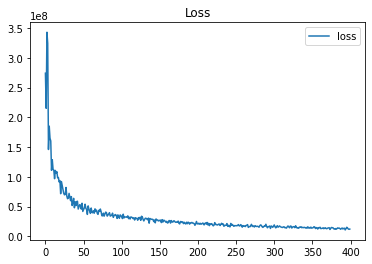

done 5 layers in 83.40ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1905.48481216]


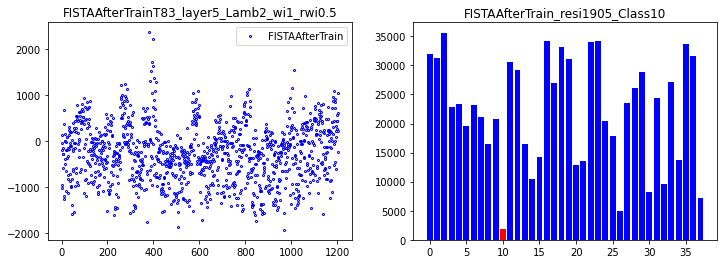

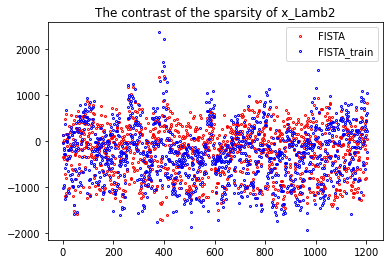

139
done 5 layers in 84.02ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[4730.73998406]


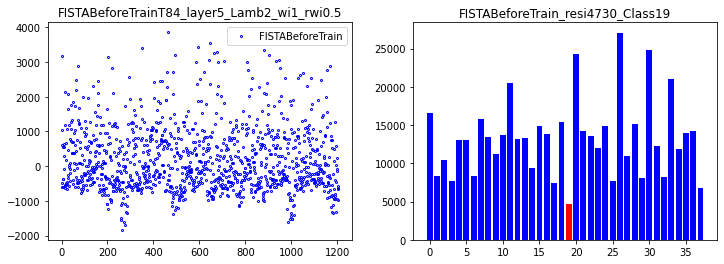

correct rate: 0.53125
correct rate: 0.59375
correct rate: 0.3125
correct rate: 0.3125
Epoch [ 10/100]: loss = 54064194.3449,   lambda [max:2.0411], [min:1.9630], 
Epoch [ 20/100]: loss = 34162431.1595,   lambda [max:2.0575], [min:1.9463], 
Epoch [ 30/100]: loss = 27647184.3495,   lambda [max:2.0635], [min:1.9349], 
Epoch [ 40/100]: loss = 21748821.2903,   lambda [max:2.0800], [min:1.9269], 
Epoch [ 50/100]: loss = 20533531.3568,   lambda [max:2.1024], [min:1.9203], 
Epoch [ 60/100]: loss = 16415337.2045,   lambda [max:2.1231], [min:1.9148], 
Epoch [ 70/100]: loss = 13777810.1493,   lambda [max:2.1425], [min:1.9110], 
Epoch [ 80/100]: loss = 12832068.3206,   lambda [max:2.1618], [min:1.9076], 
Epoch [ 90/100]: loss = 13226793.9968,   lambda [max:2.1798], [min:1.9045], 
correct rate: 0.28125
correct rate: 0.5
correct rate: 0.25
correct rate: 0.375
Epoch [100/100]: loss = 11367216.6163,   lambda [max:2.1975], [min:1.9037], 


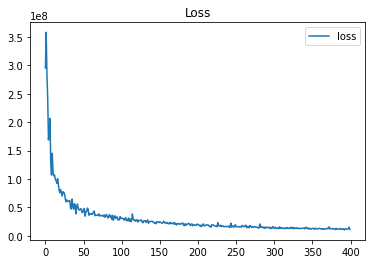

done 5 layers in 83.22ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[5556.87788542]


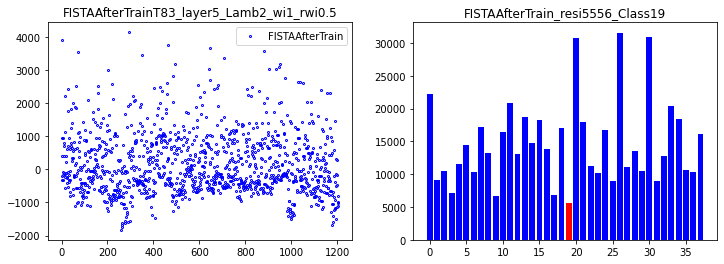

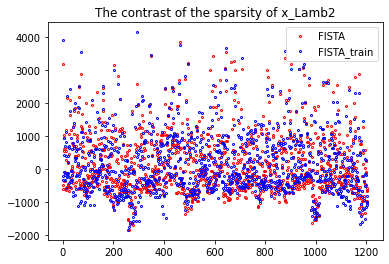

140
done 1 layers in 76.21ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[165030.00428363]


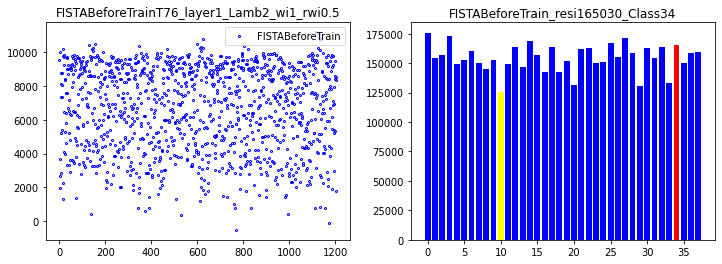

correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.6875
Epoch [ 10/100]: loss = 1317932712.4498,   lambda [max:2.0630], [min:1.9828], 
Epoch [ 20/100]: loss = 402923140.2437,   lambda [max:2.1032], [min:1.9847], 
Epoch [ 30/100]: loss = 265505689.7428,   lambda [max:2.1355], [min:1.9849], 
Epoch [ 40/100]: loss = 240557593.6373,   lambda [max:2.1639], [min:1.9851], 
Epoch [ 50/100]: loss = 262190394.6394,   lambda [max:2.1898], [min:1.9853], 
Epoch [ 60/100]: loss = 191816318.8060,   lambda [max:2.2138], [min:1.9855], 
Epoch [ 70/100]: loss = 174115991.3523,   lambda [max:2.2364], [min:1.9857], 
Epoch [ 80/100]: loss = 195287472.2200,   lambda [max:2.2577], [min:1.9859], 
Epoch [ 90/100]: loss = 170433430.0024,   lambda [max:2.2781], [min:1.9861], 
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.0625
correct rate: 0.0
Epoch [100/100]: loss = 167554844.5408,   lambda [max:2.2976], [min:1.9863], 


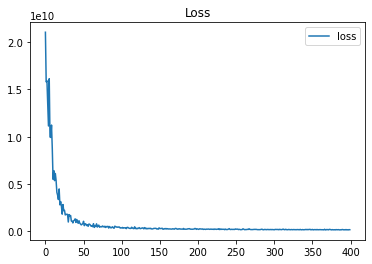

done 1 layers in 75.71ms
predict class: yaleB11
test image label: yaleB36
predict residuals label: 10
test residuals label: 34
[6287.28771873]


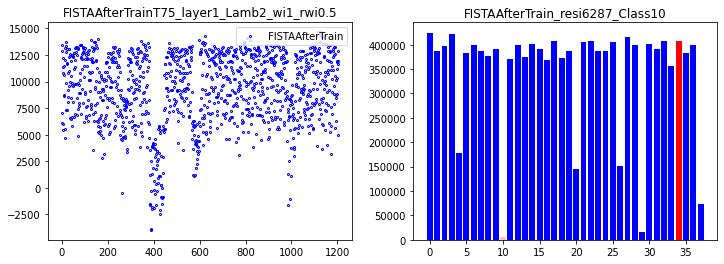

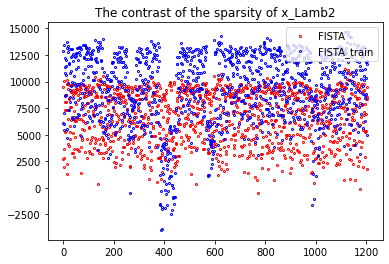

141
done 1 layers in 86.68ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[55240.62144772]


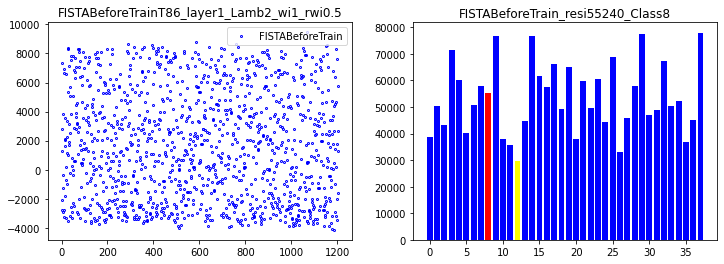

correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.5625
Epoch [ 10/100]: loss = 1901937928.0280,   lambda [max:2.0629], [min:1.9700], 
Epoch [ 20/100]: loss = 486924817.6150,   lambda [max:2.1029], [min:1.9707], 
Epoch [ 30/100]: loss = 276629377.9800,   lambda [max:2.1353], [min:1.9692], 
Epoch [ 40/100]: loss = 298629195.6776,   lambda [max:2.1637], [min:1.9678], 
Epoch [ 50/100]: loss = 232720224.1859,   lambda [max:2.1896], [min:1.9676], 
Epoch [ 60/100]: loss = 216813432.5929,   lambda [max:2.2137], [min:1.9681], 
Epoch [ 70/100]: loss = 185962051.1397,   lambda [max:2.2363], [min:1.9674], 
Epoch [ 80/100]: loss = 183733355.0208,   lambda [max:2.2577], [min:1.9670], 
Epoch [ 90/100]: loss = 194089854.8111,   lambda [max:2.2782], [min:1.9668], 
correct rate: 0.03125
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.0
Epoch [100/100]: loss = 177437376.7517,   lambda [max:2.2978], [min:1.9667], 


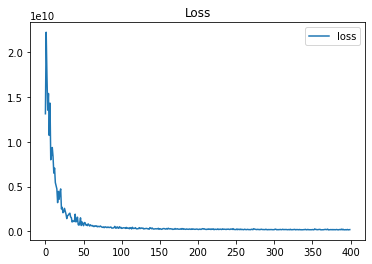

done 1 layers in 74.92ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[97010.08793032]


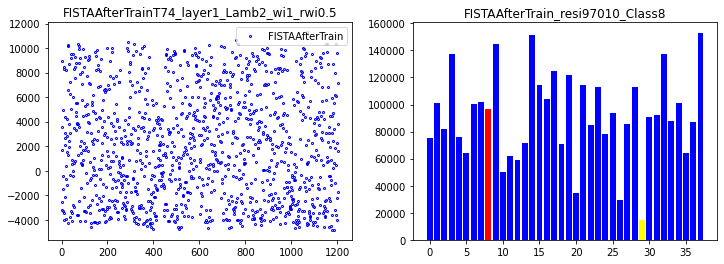

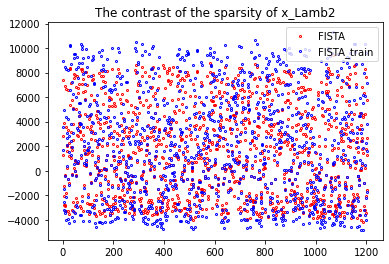

142
done 1 layers in 92.85ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[46018.72914558]


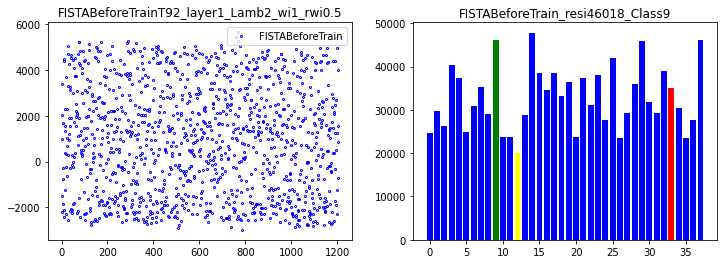

correct rate: 0.78125
correct rate: 0.46875
correct rate: 0.625
correct rate: 0.53125
Epoch [ 10/100]: loss = 1009758830.7212,   lambda [max:2.0630], [min:1.9676], 
Epoch [ 20/100]: loss = 494385754.7025,   lambda [max:2.1032], [min:1.9692], 
Epoch [ 30/100]: loss = 258648875.0973,   lambda [max:2.1356], [min:1.9688], 
Epoch [ 40/100]: loss = 270983955.9991,   lambda [max:2.1641], [min:1.9687], 
Epoch [ 50/100]: loss = 220505049.7079,   lambda [max:2.1900], [min:1.9682], 
Epoch [ 60/100]: loss = 193714302.3767,   lambda [max:2.2141], [min:1.9674], 
Epoch [ 70/100]: loss = 213698247.7580,   lambda [max:2.2367], [min:1.9669], 
Epoch [ 80/100]: loss = 178409350.9747,   lambda [max:2.2581], [min:1.9667], 
Epoch [ 90/100]: loss = 191640764.7436,   lambda [max:2.2786], [min:1.9671], 
correct rate: 0.03125
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.0625
Epoch [100/100]: loss = 173901572.0765,   lambda [max:2.2983], [min:1.9671], 


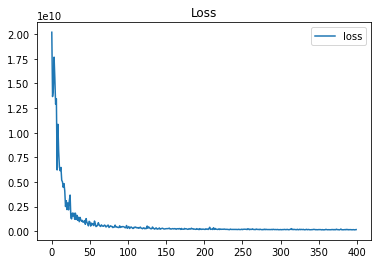

done 1 layers in 78.29ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[53107.14476554]


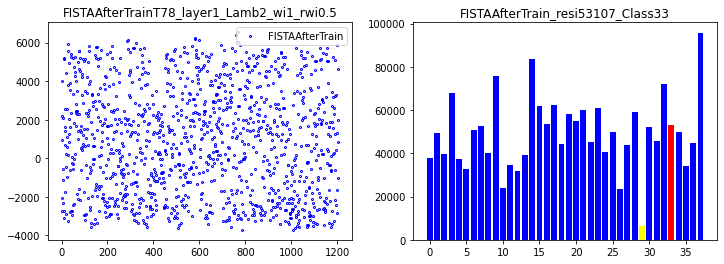

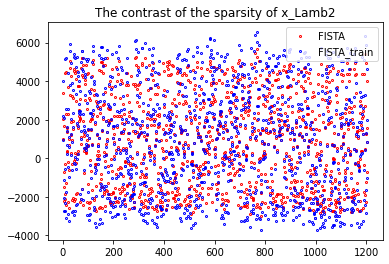

143
done 1 layers in 78.98ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[27569.88345457]


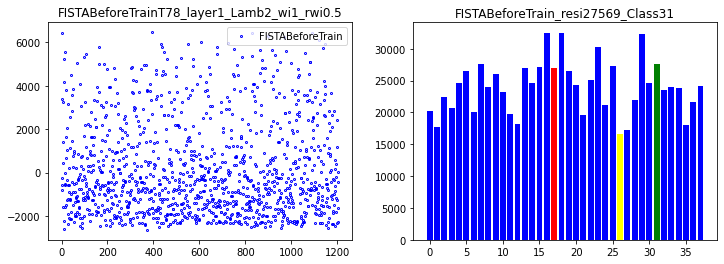

correct rate: 0.75
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.625
Epoch [ 10/100]: loss = 796564659.6023,   lambda [max:2.0630], [min:1.9684], 
Epoch [ 20/100]: loss = 561699535.0581,   lambda [max:2.1034], [min:1.9684], 
Epoch [ 30/100]: loss = 236011561.8692,   lambda [max:2.1361], [min:1.9692], 
Epoch [ 40/100]: loss = 237613700.4380,   lambda [max:2.1649], [min:1.9686], 
Epoch [ 50/100]: loss = 176402293.9266,   lambda [max:2.1911], [min:1.9686], 
Epoch [ 60/100]: loss = 179076132.7313,   lambda [max:2.2154], [min:1.9689], 
Epoch [ 70/100]: loss = 153171514.6402,   lambda [max:2.2383], [min:1.9690], 
Epoch [ 80/100]: loss = 147296590.4631,   lambda [max:2.2600], [min:1.9696], 
Epoch [ 90/100]: loss = 149800566.2755,   lambda [max:2.2807], [min:1.9698], 
correct rate: 0.03125
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.09375
Epoch [100/100]: loss = 129325393.6890,   lambda [max:2.3005], [min:1.9696], 


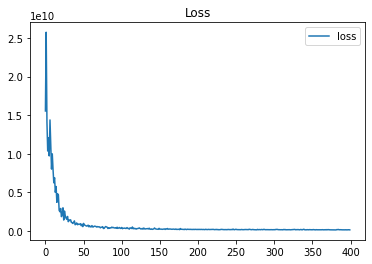

done 1 layers in 80.43ms
predict class: yaleB05
test image label: yaleB19
predict residuals label: 4
test residuals label: 17
[30409.69467677]


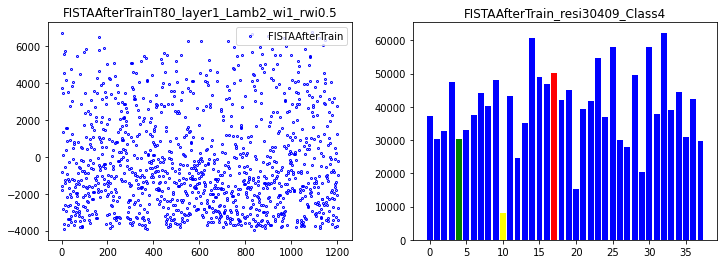

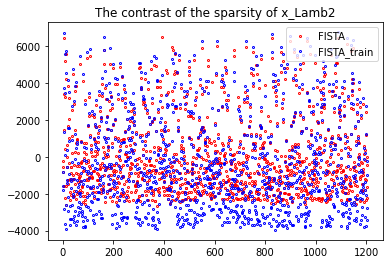

144
done 1 layers in 83.26ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[31029.61963336]


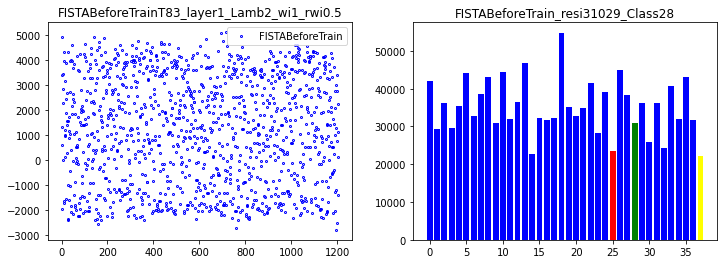

correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.53125
Epoch [ 10/100]: loss = 1288131038.9313,   lambda [max:2.0630], [min:1.9683], 
Epoch [ 20/100]: loss = 589903869.9058,   lambda [max:2.1028], [min:1.9683], 
Epoch [ 30/100]: loss = 281185376.5823,   lambda [max:2.1348], [min:1.9695], 
Epoch [ 40/100]: loss = 306327673.1818,   lambda [max:2.1630], [min:1.9694], 
Epoch [ 50/100]: loss = 317175369.7538,   lambda [max:2.1886], [min:1.9693], 
Epoch [ 60/100]: loss = 178814404.1493,   lambda [max:2.2124], [min:1.9689], 
Epoch [ 70/100]: loss = 187982897.5607,   lambda [max:2.2348], [min:1.9690], 
Epoch [ 80/100]: loss = 178648314.3963,   lambda [max:2.2560], [min:1.9692], 
Epoch [ 90/100]: loss = 170445639.6692,   lambda [max:2.2763], [min:1.9696], 
correct rate: 0.03125
correct rate: 0.0
correct rate: 0.0
correct rate: 0.15625
Epoch [100/100]: loss = 183610189.4350,   lambda [max:2.2957], [min:1.9689], 


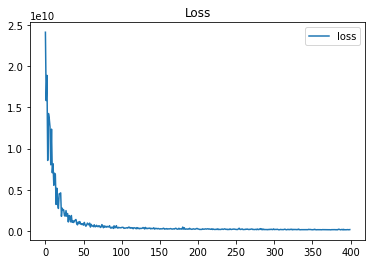

done 1 layers in 73.16ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[50066.70397296]


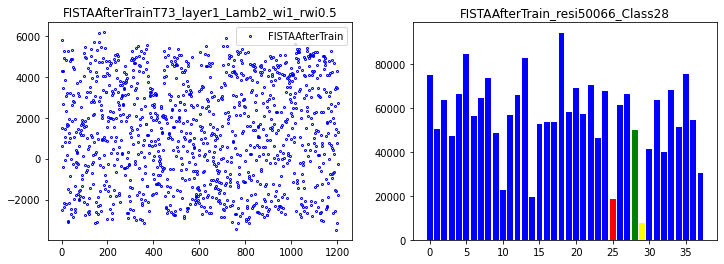

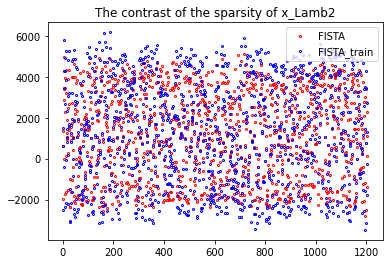

145
done 1 layers in 77.30ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[117197.29986484]


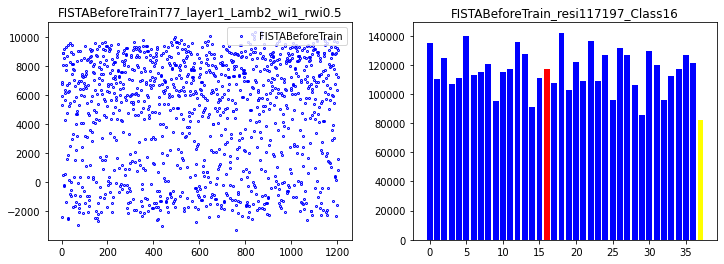

correct rate: 0.6875
correct rate: 0.625
correct rate: 0.53125
correct rate: 0.59375
Epoch [ 10/100]: loss = 1660931218.6091,   lambda [max:2.0631], [min:1.9699], 
Epoch [ 20/100]: loss = 541941682.3608,   lambda [max:2.1032], [min:1.9721], 
Epoch [ 30/100]: loss = 515231883.7932,   lambda [max:2.1356], [min:1.9733], 
Epoch [ 40/100]: loss = 289258869.6750,   lambda [max:2.1641], [min:1.9726], 
Epoch [ 50/100]: loss = 257059916.2925,   lambda [max:2.1900], [min:1.9736], 
Epoch [ 60/100]: loss = 195342834.2968,   lambda [max:2.2140], [min:1.9737], 
Epoch [ 70/100]: loss = 268659427.1410,   lambda [max:2.2366], [min:1.9734], 
Epoch [ 80/100]: loss = 184802156.4826,   lambda [max:2.2579], [min:1.9737], 
Epoch [ 90/100]: loss = 168776380.2103,   lambda [max:2.2783], [min:1.9738], 
correct rate: 0.0
correct rate: 0.125
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 154587914.8912,   lambda [max:2.2980], [min:1.9743], 


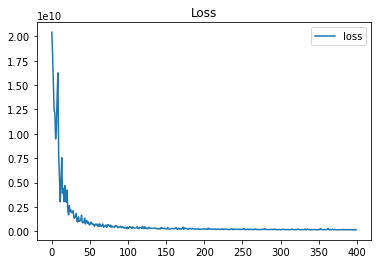

done 1 layers in 78.69ms
predict class: yaleB39
test image label: yaleB18
predict residuals label: 37
test residuals label: 16
[5023.05956072]


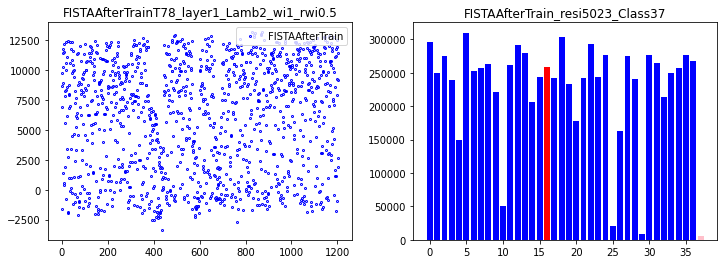

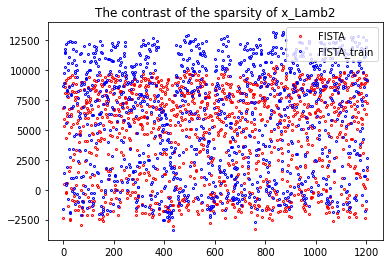

146
done 1 layers in 77.93ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[207823.17555821]


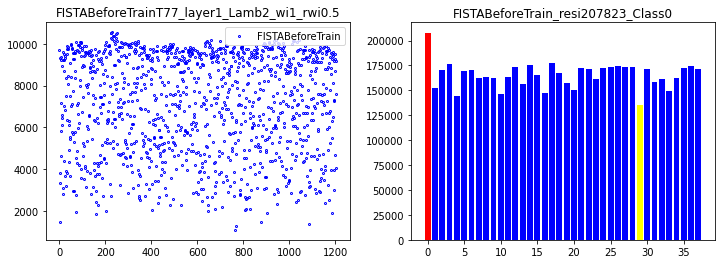

correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.5
correct rate: 0.6875
Epoch [ 10/100]: loss = 1462357738.0989,   lambda [max:2.0630], [min:1.9692], 
Epoch [ 20/100]: loss = 371413472.6429,   lambda [max:2.1033], [min:1.9711], 
Epoch [ 30/100]: loss = 362949063.1941,   lambda [max:2.1357], [min:1.9700], 
Epoch [ 40/100]: loss = 216427693.7415,   lambda [max:2.1643], [min:1.9702], 
Epoch [ 50/100]: loss = 168954673.1531,   lambda [max:2.1903], [min:1.9698], 
Epoch [ 60/100]: loss = 192255614.3245,   lambda [max:2.2144], [min:1.9700], 
Epoch [ 70/100]: loss = 155611598.1118,   lambda [max:2.2370], [min:1.9694], 
Epoch [ 80/100]: loss = 152615728.3694,   lambda [max:2.2585], [min:1.9693], 
Epoch [ 90/100]: loss = 149282328.8489,   lambda [max:2.2790], [min:1.9692], 
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.03125
Epoch [100/100]: loss = 142971826.8071,   lambda [max:2.2987], [min:1.9685], 


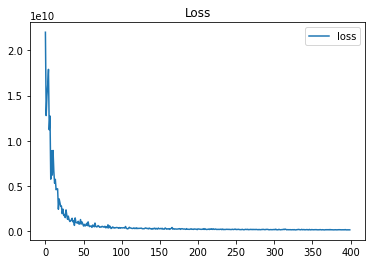

done 1 layers in 73.67ms
predict class: yaleB11
test image label: yaleB01
predict residuals label: 10
test residuals label: 0
[6488.16751737]


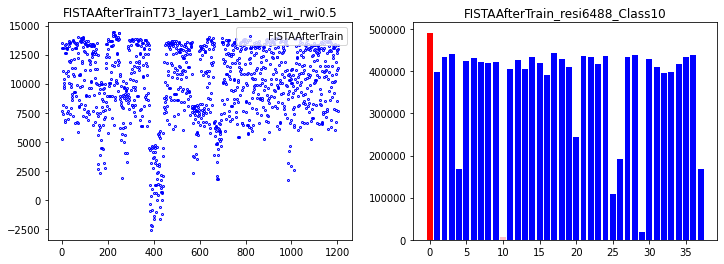

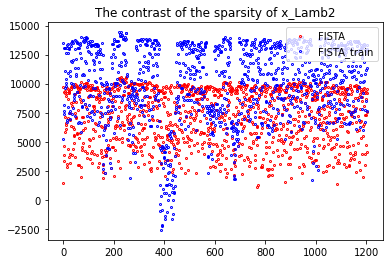

147
done 1 layers in 78.00ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[144025.68679775]


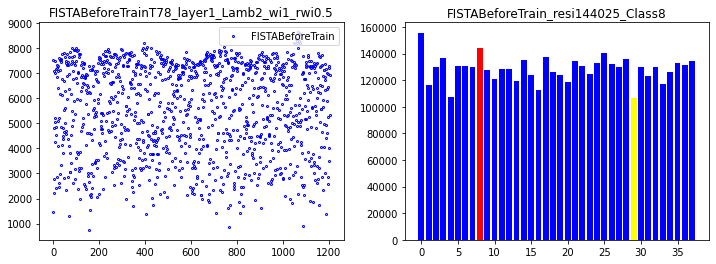

correct rate: 0.625
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.59375
Epoch [ 10/100]: loss = 1122884388.3951,   lambda [max:2.0630], [min:1.9700], 
Epoch [ 20/100]: loss = 348826998.9677,   lambda [max:2.1031], [min:1.9697], 
Epoch [ 30/100]: loss = 317634452.6592,   lambda [max:2.1355], [min:1.9715], 
Epoch [ 40/100]: loss = 243452000.0498,   lambda [max:2.1639], [min:1.9709], 
Epoch [ 50/100]: loss = 199166237.0117,   lambda [max:2.1899], [min:1.9704], 
Epoch [ 60/100]: loss = 257774329.0335,   lambda [max:2.2140], [min:1.9689], 
Epoch [ 70/100]: loss = 170780973.5100,   lambda [max:2.2367], [min:1.9686], 
Epoch [ 80/100]: loss = 152534845.1415,   lambda [max:2.2582], [min:1.9683], 
Epoch [ 90/100]: loss = 164888298.4433,   lambda [max:2.2788], [min:1.9680], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.0
Epoch [100/100]: loss = 150532340.1708,   lambda [max:2.2985], [min:1.9677], 


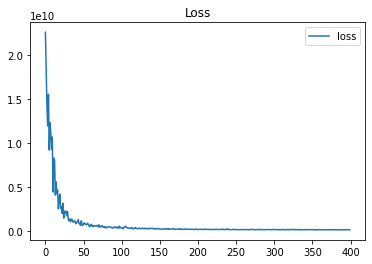

done 1 layers in 73.95ms
predict class: yaleB11
test image label: yaleB09
predict residuals label: 10
test residuals label: 8
[5240.86442456]


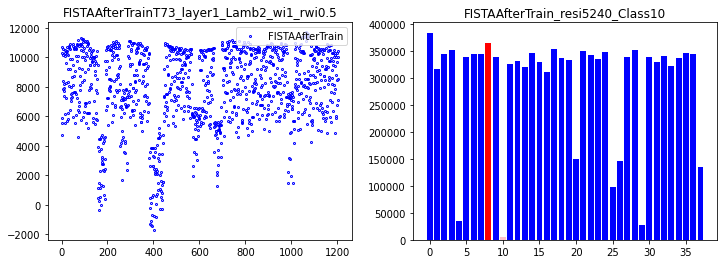

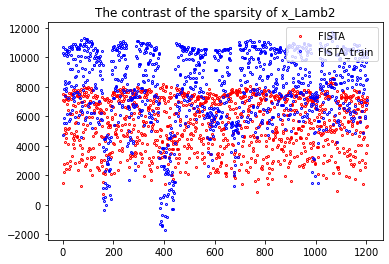

148
done 1 layers in 76.22ms
predict class: yaleB30
test image label: yaleB11
predict residuals label: 28
test residuals label: 10
[140785.89735658]


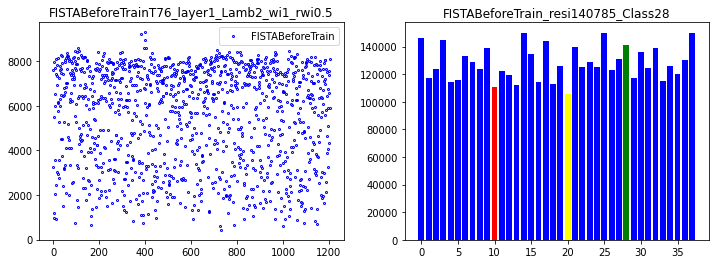

correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.59375
Epoch [ 10/100]: loss = 850805037.7271,   lambda [max:2.0629], [min:1.9697], 
Epoch [ 20/100]: loss = 423658707.9791,   lambda [max:2.1031], [min:1.9662], 
Epoch [ 30/100]: loss = 385885608.7114,   lambda [max:2.1355], [min:1.9678], 
Epoch [ 40/100]: loss = 230452163.6297,   lambda [max:2.1640], [min:1.9695], 
Epoch [ 50/100]: loss = 215994661.7789,   lambda [max:2.1899], [min:1.9706], 
Epoch [ 60/100]: loss = 187950478.3494,   lambda [max:2.2139], [min:1.9704], 
Epoch [ 70/100]: loss = 190448305.5810,   lambda [max:2.2365], [min:1.9696], 
Epoch [ 80/100]: loss = 155618466.8819,   lambda [max:2.2579], [min:1.9692], 
Epoch [ 90/100]: loss = 151311633.0129,   lambda [max:2.2783], [min:1.9695], 
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.09375
Epoch [100/100]: loss = 157677369.4722,   lambda [max:2.2980], [min:1.9691], 


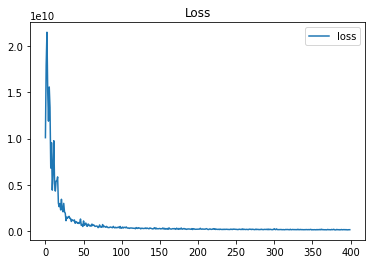

done 1 layers in 83.70ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[4725.99554421]


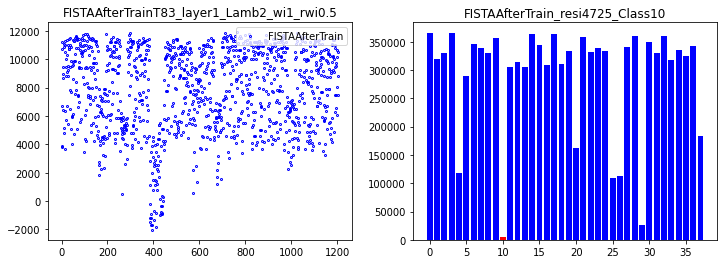

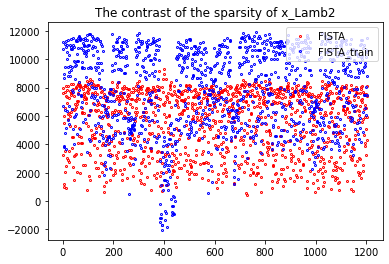

149
done 1 layers in 74.11ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[56893.90229373]


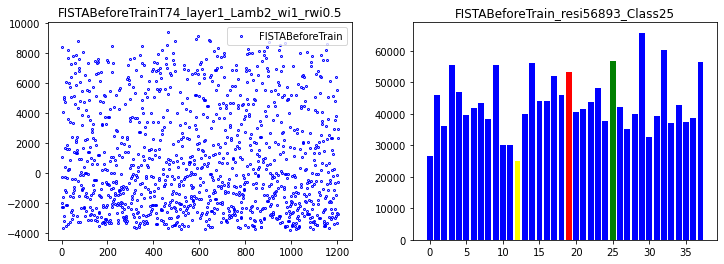

correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.59375
Epoch [ 10/100]: loss = 994375800.0614,   lambda [max:2.0628], [min:1.9693], 
Epoch [ 20/100]: loss = 451542001.3888,   lambda [max:2.1028], [min:1.9715], 
Epoch [ 30/100]: loss = 372955613.7555,   lambda [max:2.1351], [min:1.9713], 
Epoch [ 40/100]: loss = 188621548.2014,   lambda [max:2.1637], [min:1.9704], 
Epoch [ 50/100]: loss = 213938090.9303,   lambda [max:2.1897], [min:1.9710], 
Epoch [ 60/100]: loss = 174077501.3045,   lambda [max:2.2138], [min:1.9707], 
Epoch [ 70/100]: loss = 146862228.2217,   lambda [max:2.2366], [min:1.9701], 
Epoch [ 80/100]: loss = 145504049.2197,   lambda [max:2.2582], [min:1.9698], 
Epoch [ 90/100]: loss = 153393996.0456,   lambda [max:2.2788], [min:1.9697], 
correct rate: 0.125
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.0625
Epoch [100/100]: loss = 135755780.1509,   lambda [max:2.2985], [min:1.9694], 


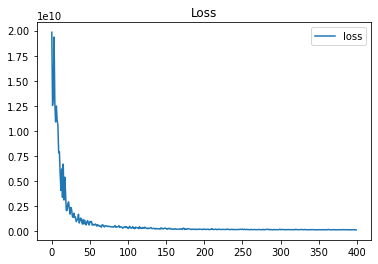

done 1 layers in 80.52ms
predict class: yaleB31
test image label: yaleB21
predict residuals label: 29
test residuals label: 19
[58105.97584093]


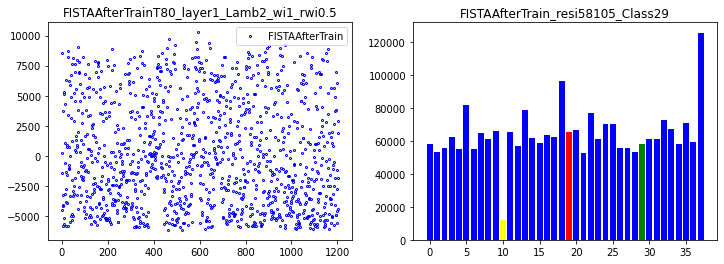

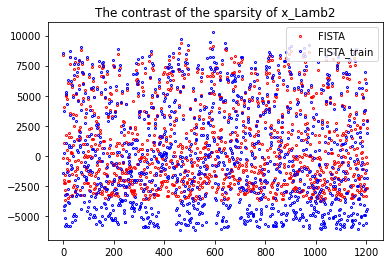

150
done 10 layers in 88.81ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[13940.33060953]


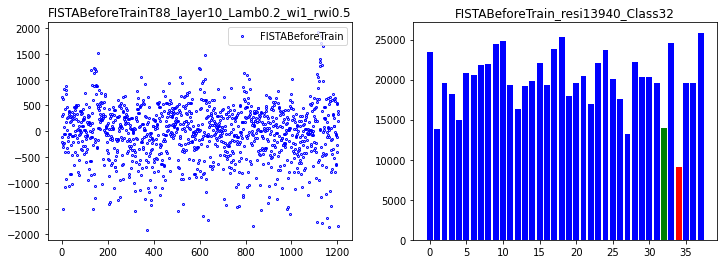

correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.6875
Epoch [ 10/100]: loss = 35515769.3187,   lambda [max:0.2486], [min:0.1667], 
Epoch [ 20/100]: loss = 29571871.6722,   lambda [max:0.2602], [min:0.1537], 
Epoch [ 30/100]: loss = 15796201.8695,   lambda [max:0.2624], [min:0.1435], 
Epoch [ 40/100]: loss = 12534252.0720,   lambda [max:0.2628], [min:0.1350], 
Epoch [ 50/100]: loss = 9917108.7857,   lambda [max:0.2631], [min:0.1284], 
Epoch [ 60/100]: loss = 7196644.4504,   lambda [max:0.2635], [min:0.1229], 
Epoch [ 70/100]: loss = 6160468.4773,   lambda [max:0.2652], [min:0.1179], 
Epoch [ 80/100]: loss = 3988515.9793,   lambda [max:0.2661], [min:0.1137], 
Epoch [ 90/100]: loss = 3510327.4078,   lambda [max:0.2669], [min:0.1093], 
correct rate: 0.75
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.625
Epoch [100/100]: loss = 3790256.9865,   lambda [max:0.2677], [min:0.1050], 


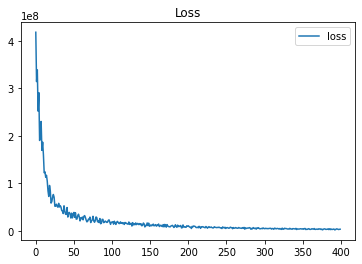

done 10 layers in 96.84ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[1007.55522172]


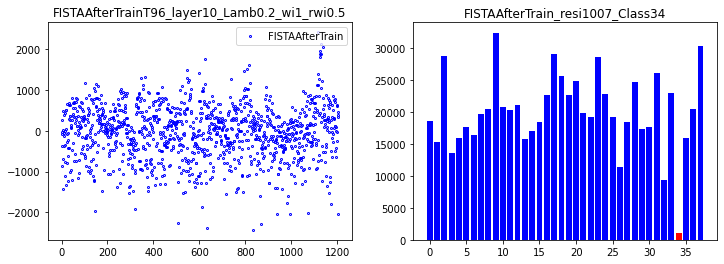

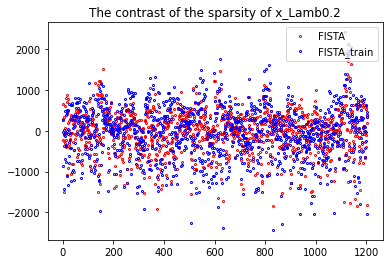

151
done 10 layers in 90.46ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[8822.14116408]


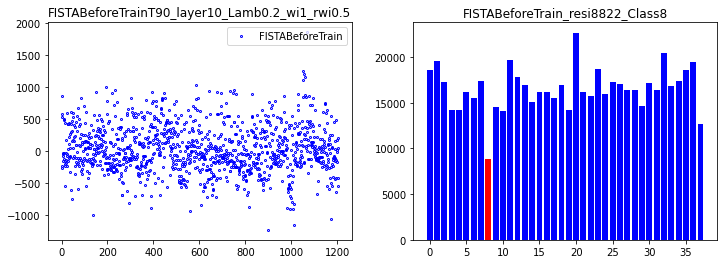

correct rate: 0.625
correct rate: 0.53125
correct rate: 0.59375
correct rate: 0.6875
Epoch [ 10/100]: loss = 41645777.4590,   lambda [max:0.2516], [min:0.1650], 
Epoch [ 20/100]: loss = 20149580.9755,   lambda [max:0.2686], [min:0.1539], 
Epoch [ 30/100]: loss = 15208259.6632,   lambda [max:0.2714], [min:0.1380], 
Epoch [ 40/100]: loss = 9503130.2150,   lambda [max:0.2725], [min:0.1260], 
Epoch [ 50/100]: loss = 7422841.1036,   lambda [max:0.2728], [min:0.1169], 
Epoch [ 60/100]: loss = 6292516.4381,   lambda [max:0.2726], [min:0.1094], 
Epoch [ 70/100]: loss = 6315218.6521,   lambda [max:0.2729], [min:0.1029], 
Epoch [ 80/100]: loss = 4640056.4358,   lambda [max:0.2744], [min:0.0975], 
Epoch [ 90/100]: loss = 4826550.8101,   lambda [max:0.2758], [min:0.0931], 
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.625
Epoch [100/100]: loss = 2478806.7211,   lambda [max:0.2772], [min:0.0889], 


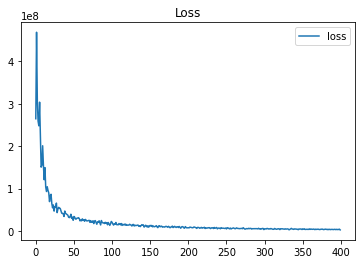

done 10 layers in 88.16ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1374.17428055]


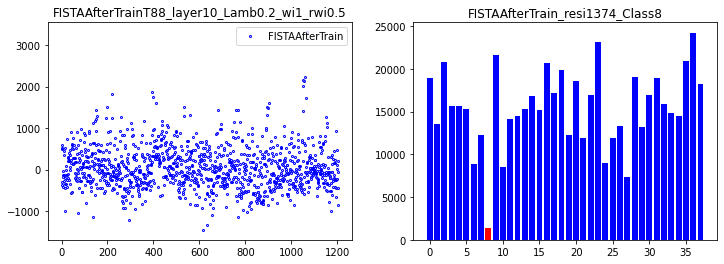

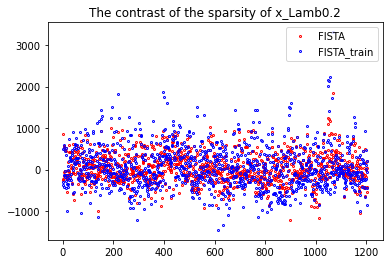

152
done 10 layers in 91.83ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6060.02514802]


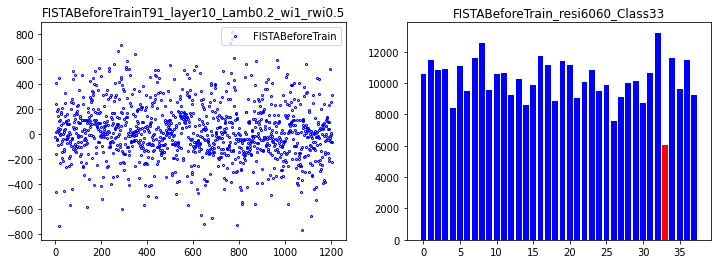

correct rate: 0.75
correct rate: 0.53125
correct rate: 0.5625
correct rate: 0.65625
Epoch [ 10/100]: loss = 46994936.3404,   lambda [max:0.2482], [min:0.1612], 
Epoch [ 20/100]: loss = 18365922.2396,   lambda [max:0.2642], [min:0.1486], 
Epoch [ 30/100]: loss = 13661702.5395,   lambda [max:0.2664], [min:0.1351], 
Epoch [ 40/100]: loss = 10048495.9944,   lambda [max:0.2664], [min:0.1255], 
Epoch [ 50/100]: loss = 7722873.8111,   lambda [max:0.2709], [min:0.1174], 
Epoch [ 60/100]: loss = 7543706.7307,   lambda [max:0.2757], [min:0.1112], 
Epoch [ 70/100]: loss = 5966368.6668,   lambda [max:0.2779], [min:0.1056], 
Epoch [ 80/100]: loss = 2866417.5700,   lambda [max:0.2797], [min:0.1011], 
Epoch [ 90/100]: loss = 3394470.1952,   lambda [max:0.2808], [min:0.0966], 
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.59375
Epoch [100/100]: loss = 3421073.6818,   lambda [max:0.2815], [min:0.0931], 


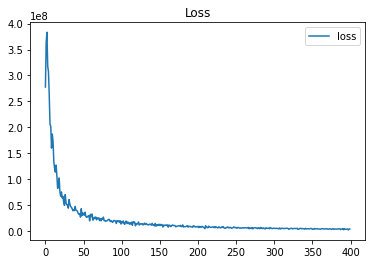

done 10 layers in 85.81ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[1287.62452045]


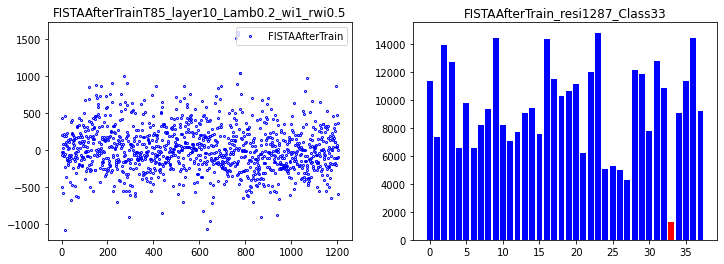

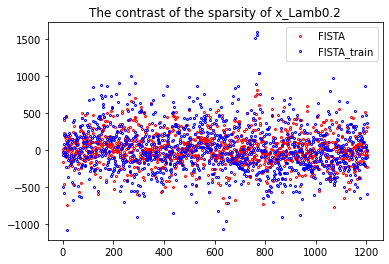

153
done 10 layers in 91.21ms
predict class: yaleB31
test image label: yaleB19
predict residuals label: 29
test residuals label: 17
[7793.67296069]


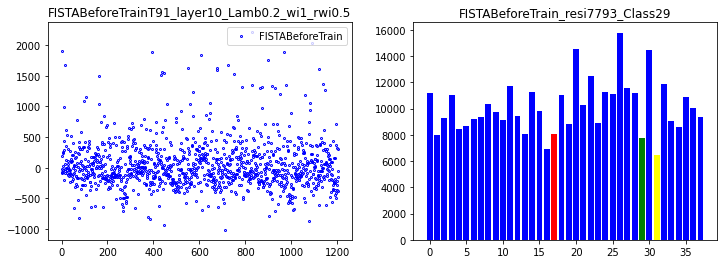

correct rate: 0.59375
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 41973841.6378,   lambda [max:0.2490], [min:0.1638], 
Epoch [ 20/100]: loss = 23809187.5185,   lambda [max:0.2612], [min:0.1515], 
Epoch [ 30/100]: loss = 15275194.7238,   lambda [max:0.2638], [min:0.1381], 
Epoch [ 40/100]: loss = 9772494.6664,   lambda [max:0.2649], [min:0.1293], 
Epoch [ 50/100]: loss = 8240206.5609,   lambda [max:0.2701], [min:0.1222], 
Epoch [ 60/100]: loss = 6488339.5583,   lambda [max:0.2745], [min:0.1166], 
Epoch [ 70/100]: loss = 5624224.1964,   lambda [max:0.2768], [min:0.1111], 
Epoch [ 80/100]: loss = 3440970.8655,   lambda [max:0.2788], [min:0.1070], 
Epoch [ 90/100]: loss = 3851895.7007,   lambda [max:0.2797], [min:0.1030], 
correct rate: 0.53125
correct rate: 0.75
correct rate: 0.6875
correct rate: 0.65625
Epoch [100/100]: loss = 3333559.2187,   lambda [max:0.2806], [min:0.1001], 


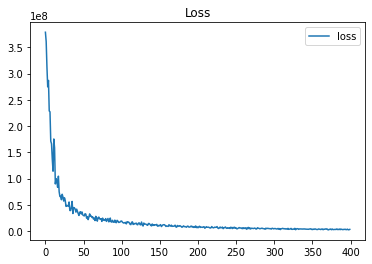

done 10 layers in 95.62ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[2118.36824483]


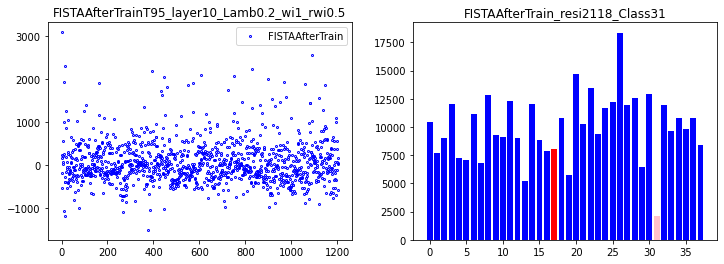

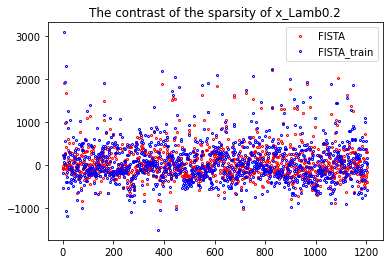

154
done 10 layers in 90.81ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[7972.84785787]


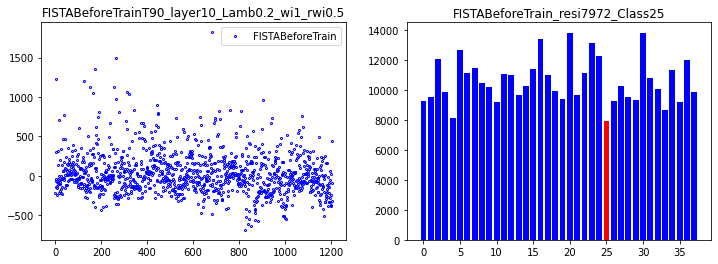

correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.5
Epoch [ 10/100]: loss = 42465669.7558,   lambda [max:0.2505], [min:0.1657], 
Epoch [ 20/100]: loss = 18073746.4831,   lambda [max:0.2598], [min:0.1498], 
Epoch [ 30/100]: loss = 14236728.7788,   lambda [max:0.2654], [min:0.1346], 
Epoch [ 40/100]: loss = 11428580.0783,   lambda [max:0.2703], [min:0.1231], 
Epoch [ 50/100]: loss = 7244240.7211,   lambda [max:0.2739], [min:0.1143], 
Epoch [ 60/100]: loss = 7308689.5552,   lambda [max:0.2762], [min:0.1071], 
Epoch [ 70/100]: loss = 5757919.0117,   lambda [max:0.2782], [min:0.1008], 
Epoch [ 80/100]: loss = 3446689.2276,   lambda [max:0.2797], [min:0.0953], 
Epoch [ 90/100]: loss = 4122298.1501,   lambda [max:0.2810], [min:0.0901], 
correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.5625
Epoch [100/100]: loss = 4088617.0240,   lambda [max:0.2820], [min:0.0858], 


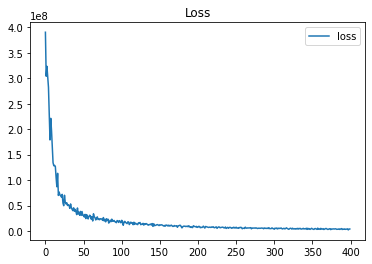

done 10 layers in 88.27ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[988.81221285]


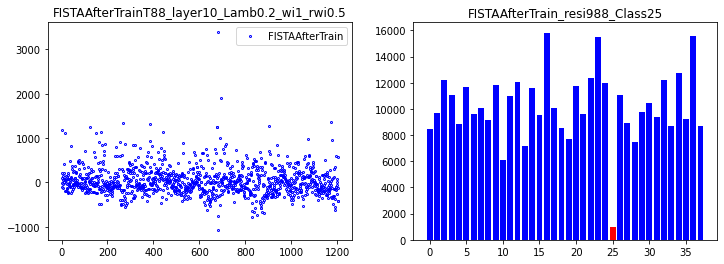

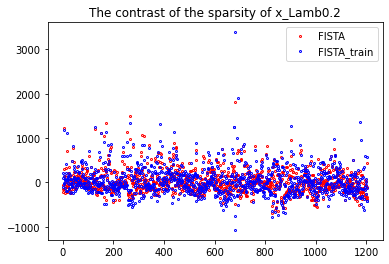

155
done 10 layers in 89.90ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[10511.46048008]


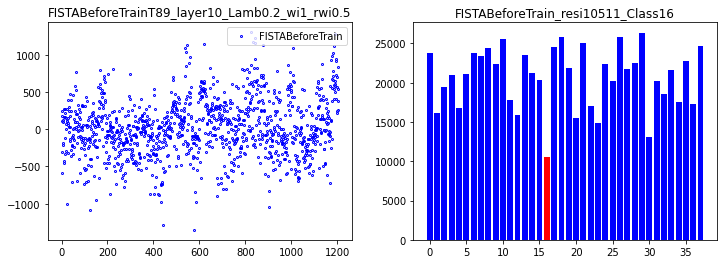

correct rate: 0.53125
correct rate: 0.75
correct rate: 0.71875
correct rate: 0.40625
Epoch [ 10/100]: loss = 42411671.8426,   lambda [max:0.2479], [min:0.1627], 
Epoch [ 20/100]: loss = 19593602.9776,   lambda [max:0.2589], [min:0.1511], 
Epoch [ 30/100]: loss = 13407451.0407,   lambda [max:0.2618], [min:0.1353], 
Epoch [ 40/100]: loss = 10905502.9193,   lambda [max:0.2631], [min:0.1236], 
Epoch [ 50/100]: loss = 8547696.3126,   lambda [max:0.2714], [min:0.1144], 
Epoch [ 60/100]: loss = 6493324.9016,   lambda [max:0.2763], [min:0.1065], 
Epoch [ 70/100]: loss = 6223098.4936,   lambda [max:0.2791], [min:0.0998], 
Epoch [ 80/100]: loss = 5199924.0664,   lambda [max:0.2814], [min:0.0943], 
Epoch [ 90/100]: loss = 3968536.8860,   lambda [max:0.2826], [min:0.0898], 
correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.71875
Epoch [100/100]: loss = 3601024.7257,   lambda [max:0.2841], [min:0.0852], 


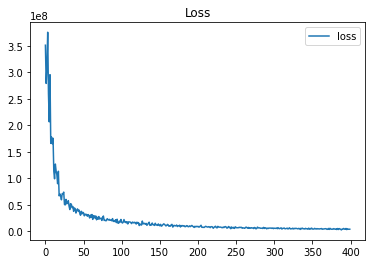

done 10 layers in 93.15ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[534.14711549]


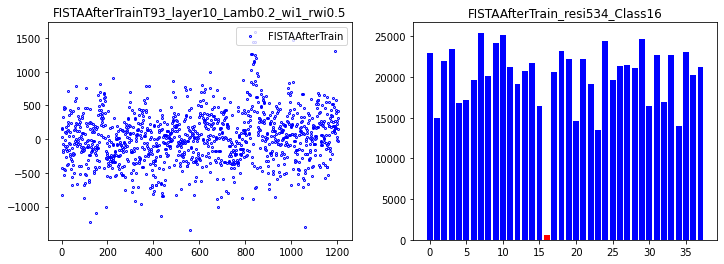

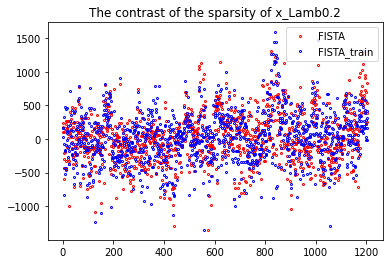

156
done 10 layers in 89.07ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[8533.09062643]


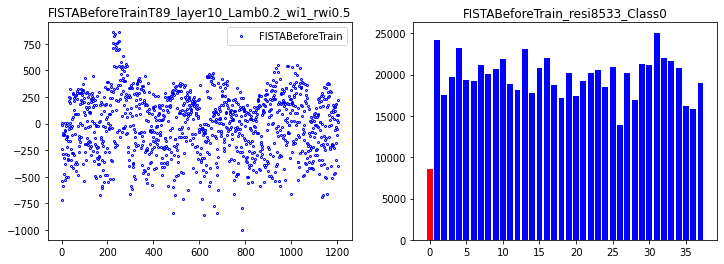

correct rate: 0.625
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.65625
Epoch [ 10/100]: loss = 37851279.6255,   lambda [max:0.2487], [min:0.1624], 
Epoch [ 20/100]: loss = 20698061.3134,   lambda [max:0.2597], [min:0.1512], 
Epoch [ 30/100]: loss = 16066454.7421,   lambda [max:0.2648], [min:0.1364], 
Epoch [ 40/100]: loss = 11122091.7658,   lambda [max:0.2711], [min:0.1248], 
Epoch [ 50/100]: loss = 8233958.8734,   lambda [max:0.2757], [min:0.1155], 
Epoch [ 60/100]: loss = 6282157.8574,   lambda [max:0.2790], [min:0.1078], 
Epoch [ 70/100]: loss = 6069669.1811,   lambda [max:0.2811], [min:0.1015], 
Epoch [ 80/100]: loss = 4915042.2530,   lambda [max:0.2822], [min:0.0958], 
Epoch [ 90/100]: loss = 3694156.0268,   lambda [max:0.2827], [min:0.0908], 
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.75
correct rate: 0.59375
Epoch [100/100]: loss = 4945391.8234,   lambda [max:0.2831], [min:0.0864], 


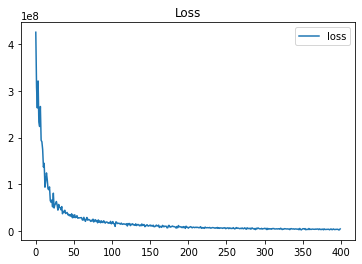

done 10 layers in 86.58ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1113.03110799]


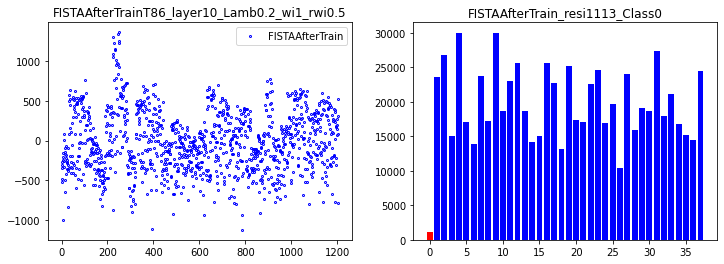

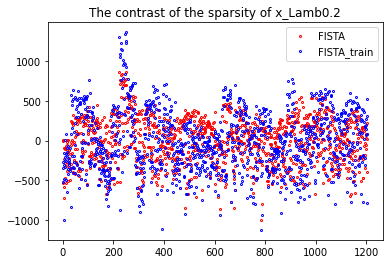

157
done 10 layers in 90.14ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2517.92268771]


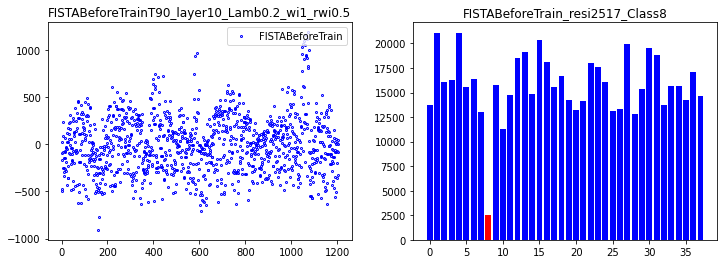

correct rate: 0.59375
correct rate: 0.5
correct rate: 0.625
correct rate: 0.71875
Epoch [ 10/100]: loss = 34755260.0610,   lambda [max:0.2468], [min:0.1574], 
Epoch [ 20/100]: loss = 27153826.4543,   lambda [max:0.2635], [min:0.1413], 
Epoch [ 30/100]: loss = 16349825.1606,   lambda [max:0.2668], [min:0.1294], 
Epoch [ 40/100]: loss = 13381562.2575,   lambda [max:0.2675], [min:0.1214], 
Epoch [ 50/100]: loss = 9656297.0609,   lambda [max:0.2675], [min:0.1157], 
Epoch [ 60/100]: loss = 6525268.6199,   lambda [max:0.2672], [min:0.1107], 
Epoch [ 70/100]: loss = 6058356.4401,   lambda [max:0.2665], [min:0.1069], 
Epoch [ 80/100]: loss = 4346005.6667,   lambda [max:0.2666], [min:0.1040], 
Epoch [ 90/100]: loss = 4309976.6839,   lambda [max:0.2665], [min:0.1012], 
correct rate: 0.65625
correct rate: 0.5
correct rate: 0.78125
correct rate: 0.6875
Epoch [100/100]: loss = 2591133.0483,   lambda [max:0.2665], [min:0.0987], 


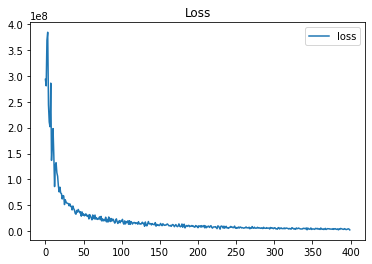

done 10 layers in 88.24ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1755.40329331]


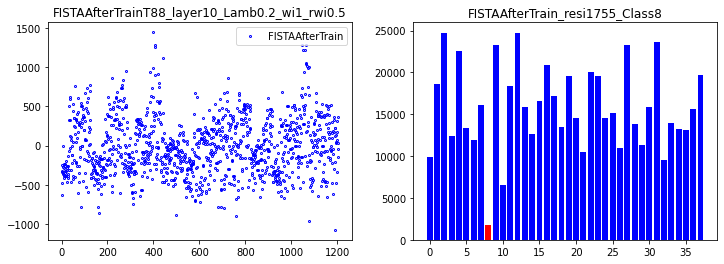

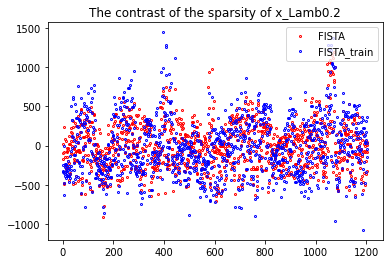

158
done 10 layers in 92.75ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[9766.77429531]


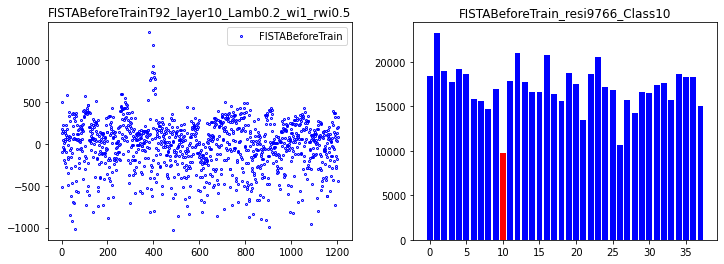

correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.59375
Epoch [ 10/100]: loss = 40397293.9212,   lambda [max:0.2490], [min:0.1595], 
Epoch [ 20/100]: loss = 18005547.7978,   lambda [max:0.2642], [min:0.1414], 
Epoch [ 30/100]: loss = 15559010.7408,   lambda [max:0.2669], [min:0.1252], 
Epoch [ 40/100]: loss = 11058342.4881,   lambda [max:0.2678], [min:0.1134], 
Epoch [ 50/100]: loss = 9226233.1813,   lambda [max:0.2675], [min:0.1039], 
Epoch [ 60/100]: loss = 8603995.2296,   lambda [max:0.2674], [min:0.0960], 
Epoch [ 70/100]: loss = 5653213.0237,   lambda [max:0.2671], [min:0.0899], 
Epoch [ 80/100]: loss = 4324553.7889,   lambda [max:0.2662], [min:0.0850], 
Epoch [ 90/100]: loss = 4673581.7932,   lambda [max:0.2655], [min:0.0802], 
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.71875
Epoch [100/100]: loss = 3470544.6372,   lambda [max:0.2650], [min:0.0760], 


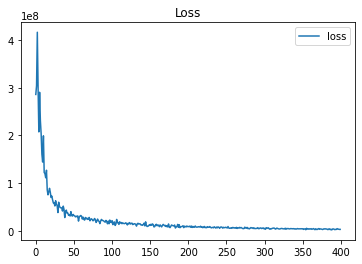

done 10 layers in 84.41ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1309.53770567]


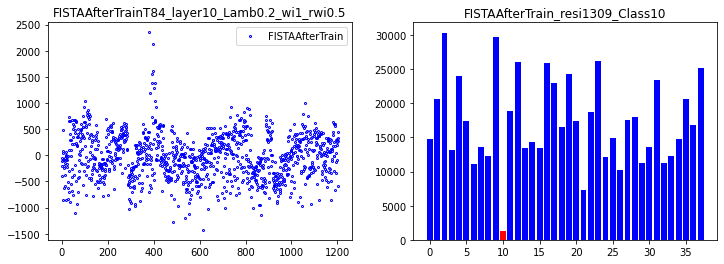

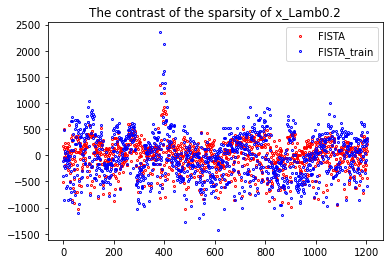

159
done 10 layers in 90.30ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[9009.93165632]


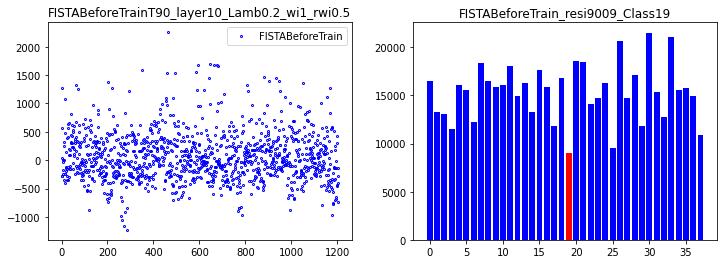

correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.625
correct rate: 0.6875
Epoch [ 10/100]: loss = 46273852.7220,   lambda [max:0.2482], [min:0.1647], 
Epoch [ 20/100]: loss = 21621170.1872,   lambda [max:0.2624], [min:0.1445], 
Epoch [ 30/100]: loss = 13514448.1693,   lambda [max:0.2642], [min:0.1299], 
Epoch [ 40/100]: loss = 11683789.8560,   lambda [max:0.2659], [min:0.1193], 
Epoch [ 50/100]: loss = 10088161.9166,   lambda [max:0.2661], [min:0.1109], 
Epoch [ 60/100]: loss = 7144903.1601,   lambda [max:0.2661], [min:0.1036], 
Epoch [ 70/100]: loss = 6776193.2695,   lambda [max:0.2660], [min:0.0970], 
Epoch [ 80/100]: loss = 5193456.0701,   lambda [max:0.2696], [min:0.0916], 
Epoch [ 90/100]: loss = 5214796.8297,   lambda [max:0.2731], [min:0.0868], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.71875
Epoch [100/100]: loss = 4092487.5749,   lambda [max:0.2761], [min:0.0829], 


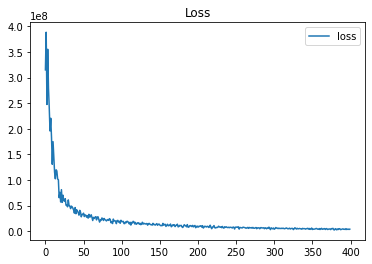

done 10 layers in 92.02ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[2922.94726226]


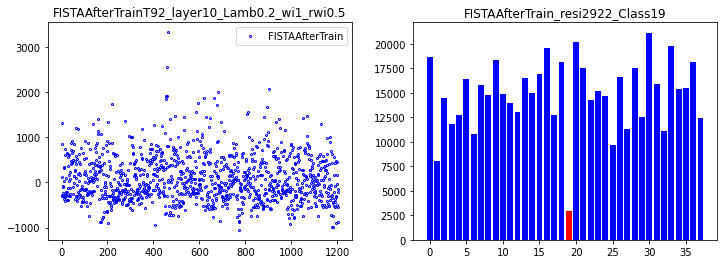

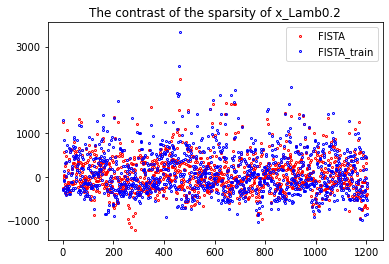

160
done 5 layers in 84.87ms
predict class: yaleB05
test image label: yaleB36
predict residuals label: 4
test residuals label: 34
[16737.71593264]


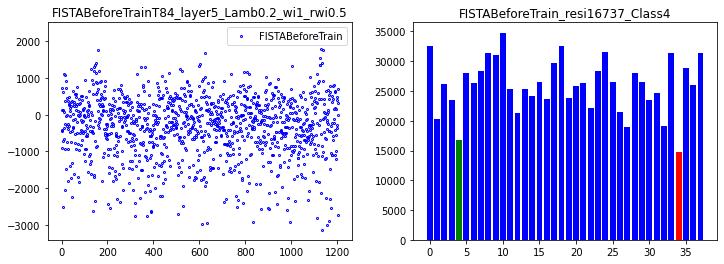

correct rate: 0.40625
correct rate: 0.40625
correct rate: 0.46875
correct rate: 0.40625
Epoch [ 10/100]: loss = 49781904.6738,   lambda [max:0.2373], [min:0.1632], 
Epoch [ 20/100]: loss = 27812831.8298,   lambda [max:0.2519], [min:0.1610], 
Epoch [ 30/100]: loss = 26212211.1985,   lambda [max:0.2574], [min:0.1546], 
Epoch [ 40/100]: loss = 17890531.9622,   lambda [max:0.2592], [min:0.1493], 
Epoch [ 50/100]: loss = 16205027.1397,   lambda [max:0.2600], [min:0.1447], 
Epoch [ 60/100]: loss = 11422357.5078,   lambda [max:0.2664], [min:0.1368], 
Epoch [ 70/100]: loss = 10410884.2910,   lambda [max:0.2699], [min:0.1321], 
Epoch [ 80/100]: loss = 8067445.2980,   lambda [max:0.2696], [min:0.1291], 
Epoch [ 90/100]: loss = 9160933.7211,   lambda [max:0.2734], [min:0.1275], 
correct rate: 0.25
correct rate: 0.28125
correct rate: 0.15625
correct rate: 0.34375
Epoch [100/100]: loss = 5838413.2236,   lambda [max:0.2760], [min:0.1265], 


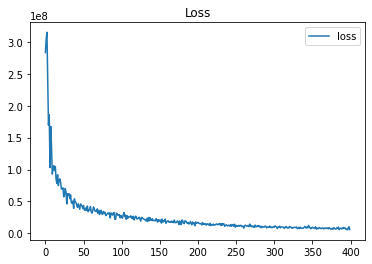

done 5 layers in 87.52ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[1540.01582741]


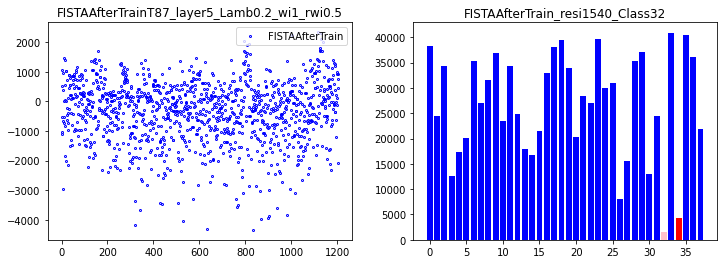

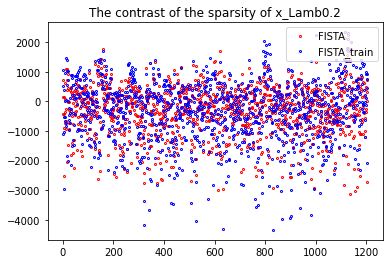

161
done 5 layers in 83.41ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[4445.81503993]


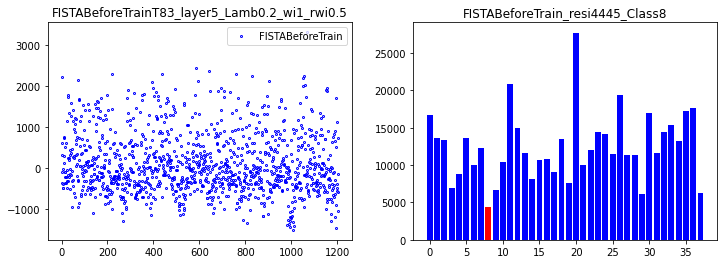

correct rate: 0.4375
correct rate: 0.34375
correct rate: 0.4375
correct rate: 0.5
Epoch [ 10/100]: loss = 44827605.6929,   lambda [max:0.2423], [min:0.1736], 
Epoch [ 20/100]: loss = 32922317.2468,   lambda [max:0.2513], [min:0.1618], 
Epoch [ 30/100]: loss = 26685504.9065,   lambda [max:0.2599], [min:0.1572], 
Epoch [ 40/100]: loss = 15950656.1335,   lambda [max:0.2712], [min:0.1499], 
Epoch [ 50/100]: loss = 14032684.9279,   lambda [max:0.2768], [min:0.1430], 
Epoch [ 60/100]: loss = 10566671.7877,   lambda [max:0.2793], [min:0.1401], 
Epoch [ 70/100]: loss = 8119376.2654,   lambda [max:0.2801], [min:0.1383], 
Epoch [ 80/100]: loss = 10272272.7066,   lambda [max:0.2813], [min:0.1360], 
Epoch [ 90/100]: loss = 7505648.3898,   lambda [max:0.2818], [min:0.1347], 
correct rate: 0.09375
correct rate: 0.3125
correct rate: 0.28125
correct rate: 0.34375
Epoch [100/100]: loss = 4572748.6936,   lambda [max:0.2828], [min:0.1310], 


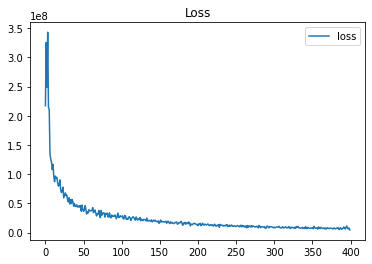

done 5 layers in 86.68ms
predict class: yaleB10
test image label: yaleB09
predict residuals label: 9
test residuals label: 8
[4582.65249421]


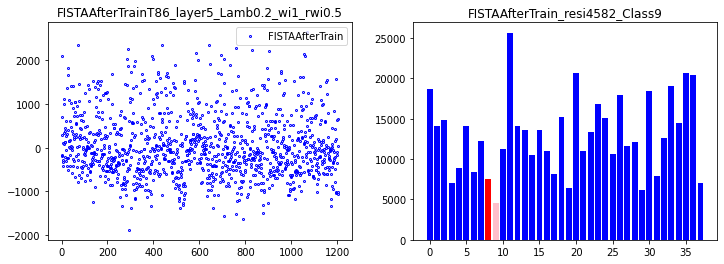

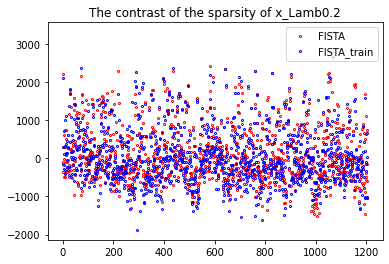

162
done 5 layers in 84.16ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4656.14716689]


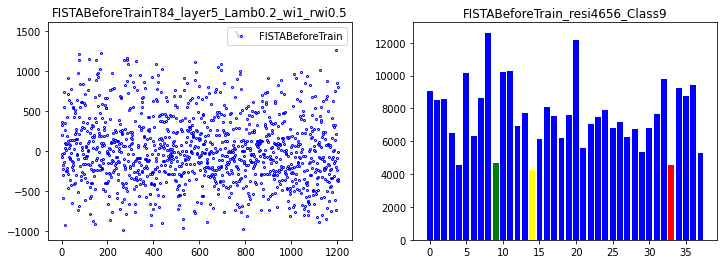

correct rate: 0.4375
correct rate: 0.46875
correct rate: 0.3125
correct rate: 0.46875
Epoch [ 10/100]: loss = 46566692.9566,   lambda [max:0.2439], [min:0.1689], 
Epoch [ 20/100]: loss = 26991600.8659,   lambda [max:0.2591], [min:0.1541], 
Epoch [ 30/100]: loss = 22413384.8296,   lambda [max:0.2654], [min:0.1444], 
Epoch [ 40/100]: loss = 16906184.7482,   lambda [max:0.2696], [min:0.1371], 
Epoch [ 50/100]: loss = 16288865.2895,   lambda [max:0.2722], [min:0.1319], 
Epoch [ 60/100]: loss = 10659515.8515,   lambda [max:0.2729], [min:0.1268], 
Epoch [ 70/100]: loss = 10637413.8155,   lambda [max:0.2744], [min:0.1239], 
Epoch [ 80/100]: loss = 9118649.0154,   lambda [max:0.2812], [min:0.1212], 
Epoch [ 90/100]: loss = 8447797.6069,   lambda [max:0.2830], [min:0.1197], 
correct rate: 0.21875
correct rate: 0.25
correct rate: 0.1875
correct rate: 0.34375
Epoch [100/100]: loss = 7477269.8980,   lambda [max:0.2837], [min:0.1188], 


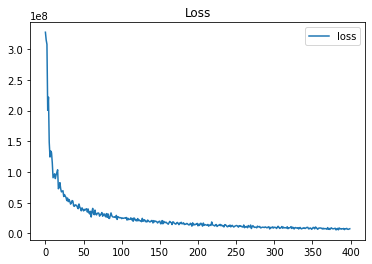

done 5 layers in 85.68ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4087.16809825]


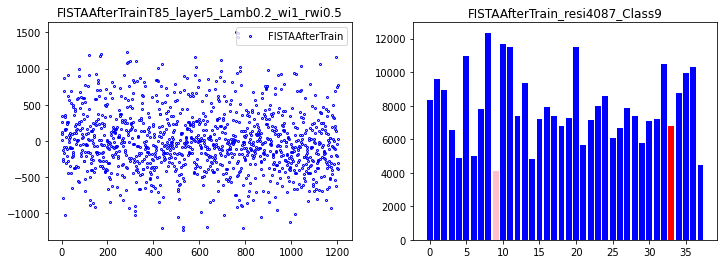

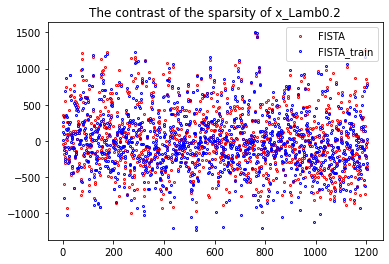

163
done 5 layers in 83.51ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[4966.88562122]


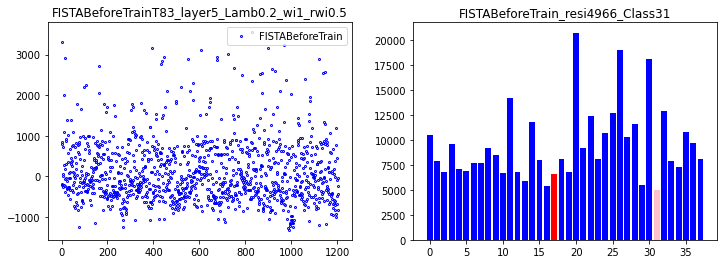

correct rate: 0.53125
correct rate: 0.40625
correct rate: 0.4375
correct rate: 0.375
Epoch [ 10/100]: loss = 39563893.9349,   lambda [max:0.2404], [min:0.1613], 
Epoch [ 20/100]: loss = 27649858.7019,   lambda [max:0.2523], [min:0.1577], 
Epoch [ 30/100]: loss = 21604937.6624,   lambda [max:0.2607], [min:0.1486], 
Epoch [ 40/100]: loss = 18371653.0490,   lambda [max:0.2662], [min:0.1414], 
Epoch [ 50/100]: loss = 13125514.4192,   lambda [max:0.2692], [min:0.1363], 
Epoch [ 60/100]: loss = 11338825.4027,   lambda [max:0.2723], [min:0.1316], 
Epoch [ 70/100]: loss = 10522620.9507,   lambda [max:0.2800], [min:0.1290], 
Epoch [ 80/100]: loss = 8016969.5796,   lambda [max:0.2848], [min:0.1258], 
Epoch [ 90/100]: loss = 7297526.0318,   lambda [max:0.2884], [min:0.1249], 
correct rate: 0.34375
correct rate: 0.3125
correct rate: 0.40625
correct rate: 0.25
Epoch [100/100]: loss = 5473712.3106,   lambda [max:0.2917], [min:0.1231], 


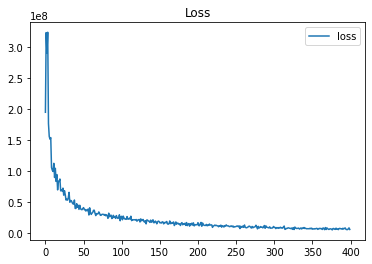

done 5 layers in 85.61ms
predict class: yaleB02
test image label: yaleB19
predict residuals label: 1
test residuals label: 17
[4485.42829497]


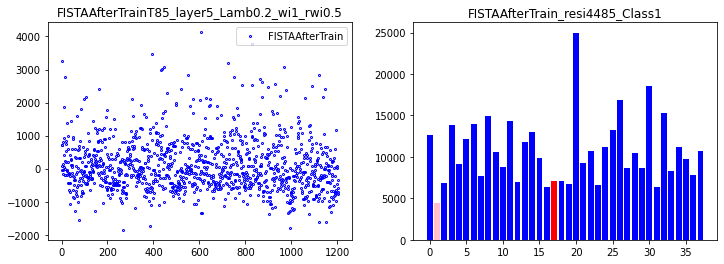

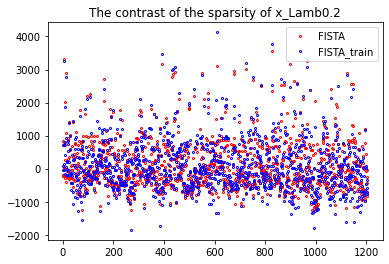

164
done 5 layers in 87.21ms
predict class: yaleB11
test image label: yaleB27
predict residuals label: 10
test residuals label: 25
[5465.57805095]


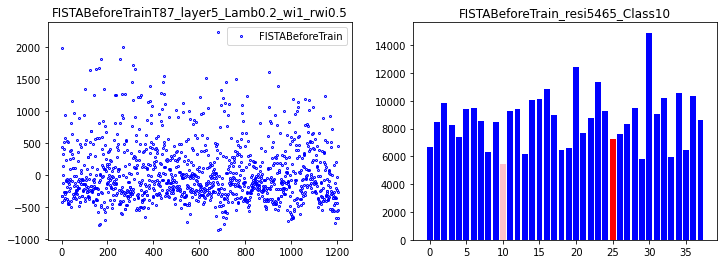

correct rate: 0.375
correct rate: 0.5
correct rate: 0.5
correct rate: 0.40625
Epoch [ 10/100]: loss = 48553706.6382,   lambda [max:0.2388], [min:0.1681], 
Epoch [ 20/100]: loss = 30992746.6653,   lambda [max:0.2549], [min:0.1451], 
Epoch [ 30/100]: loss = 23238735.5808,   lambda [max:0.2638], [min:0.1403], 
Epoch [ 40/100]: loss = 20511708.2241,   lambda [max:0.2694], [min:0.1380], 
Epoch [ 50/100]: loss = 14262414.2429,   lambda [max:0.2719], [min:0.1369], 
Epoch [ 60/100]: loss = 9655307.4230,   lambda [max:0.2743], [min:0.1368], 
Epoch [ 70/100]: loss = 11886868.7739,   lambda [max:0.2784], [min:0.1379], 
Epoch [ 80/100]: loss = 9815281.7985,   lambda [max:0.2847], [min:0.1381], 
Epoch [ 90/100]: loss = 9118204.7366,   lambda [max:0.2871], [min:0.1364], 
correct rate: 0.375
correct rate: 0.25
correct rate: 0.25
correct rate: 0.1875
Epoch [100/100]: loss = 7967147.0491,   lambda [max:0.2885], [min:0.1342], 


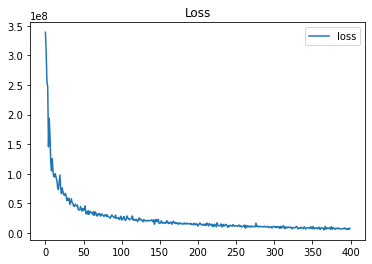

done 5 layers in 86.41ms
predict class: yaleB09
test image label: yaleB27
predict residuals label: 8
test residuals label: 25
[3142.29538267]


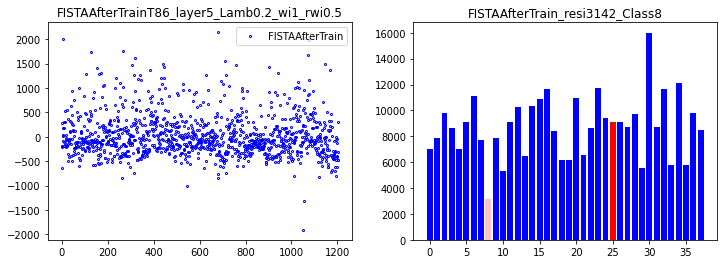

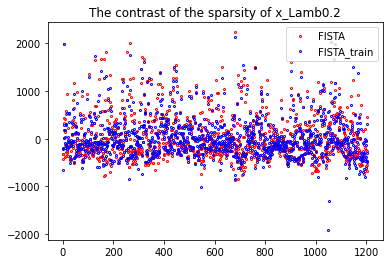

165
done 5 layers in 87.59ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[7226.71541855]


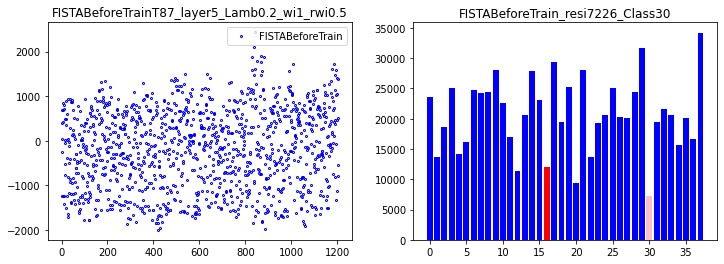

correct rate: 0.375
correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.46875
Epoch [ 10/100]: loss = 47205152.7755,   lambda [max:0.2396], [min:0.1574], 
Epoch [ 20/100]: loss = 26394709.7429,   lambda [max:0.2475], [min:0.1380], 
Epoch [ 30/100]: loss = 19397381.8438,   lambda [max:0.2566], [min:0.1240], 
Epoch [ 40/100]: loss = 17690225.2854,   lambda [max:0.2627], [min:0.1138], 
Epoch [ 50/100]: loss = 20049763.4510,   lambda [max:0.2674], [min:0.1064], 
Epoch [ 60/100]: loss = 12406125.3456,   lambda [max:0.2702], [min:0.1006], 
Epoch [ 70/100]: loss = 11606664.4574,   lambda [max:0.2718], [min:0.0976], 
Epoch [ 80/100]: loss = 8006139.3917,   lambda [max:0.2750], [min:0.0951], 
Epoch [ 90/100]: loss = 8092349.7340,   lambda [max:0.2783], [min:0.0929], 
correct rate: 0.28125
correct rate: 0.3125
correct rate: 0.34375
correct rate: 0.1875
Epoch [100/100]: loss = 8003110.8910,   lambda [max:0.2807], [min:0.0906], 


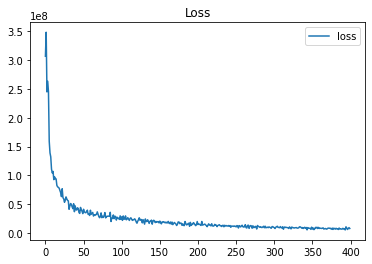

done 5 layers in 84.26ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[171.88891125]


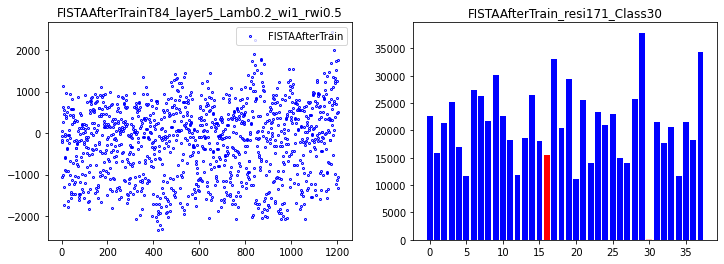

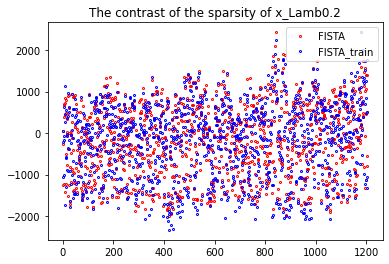

166
done 5 layers in 81.18ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[16822.34600901]


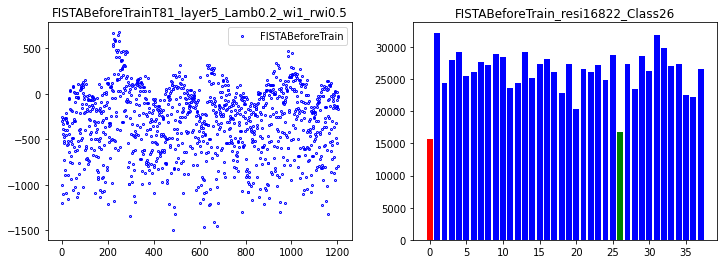

correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.375
correct rate: 0.5
Epoch [ 10/100]: loss = 45564438.6087,   lambda [max:0.2375], [min:0.1683], 
Epoch [ 20/100]: loss = 30336772.4123,   lambda [max:0.2535], [min:0.1442], 
Epoch [ 30/100]: loss = 21478470.2063,   lambda [max:0.2593], [min:0.1389], 
Epoch [ 40/100]: loss = 17701602.0938,   lambda [max:0.2603], [min:0.1363], 
Epoch [ 50/100]: loss = 10848372.1139,   lambda [max:0.2632], [min:0.1342], 
Epoch [ 60/100]: loss = 11721821.3332,   lambda [max:0.2641], [min:0.1294], 
Epoch [ 70/100]: loss = 8781205.9551,   lambda [max:0.2660], [min:0.1267], 
Epoch [ 80/100]: loss = 9617358.1013,   lambda [max:0.2710], [min:0.1243], 
Epoch [ 90/100]: loss = 6654947.8853,   lambda [max:0.2741], [min:0.1233], 
correct rate: 0.375
correct rate: 0.1875
correct rate: 0.21875
correct rate: 0.34375
Epoch [100/100]: loss = 6834109.3676,   lambda [max:0.2774], [min:0.1227], 


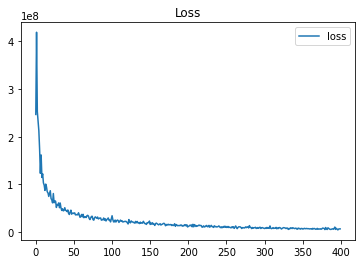

done 5 layers in 84.75ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1686.62409857]


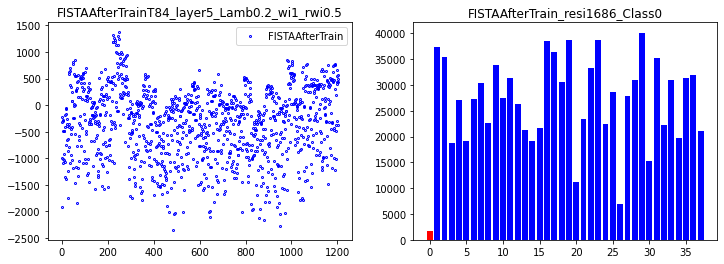

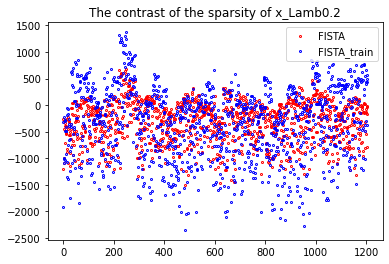

167
done 5 layers in 84.28ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[5129.02896833]


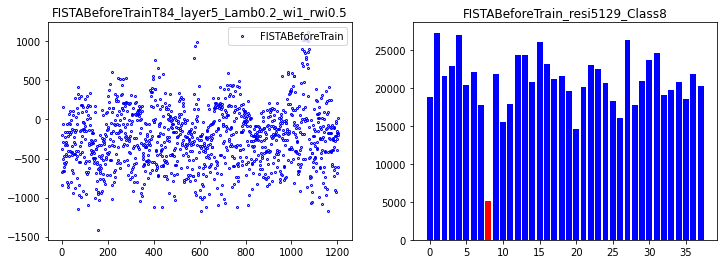

correct rate: 0.5
correct rate: 0.5625
correct rate: 0.3125
correct rate: 0.3125
Epoch [ 10/100]: loss = 43638678.7223,   lambda [max:0.2394], [min:0.1740], 
Epoch [ 20/100]: loss = 30815951.9784,   lambda [max:0.2482], [min:0.1640], 
Epoch [ 30/100]: loss = 19176704.9600,   lambda [max:0.2549], [min:0.1550], 
Epoch [ 40/100]: loss = 17717609.9071,   lambda [max:0.2600], [min:0.1486], 
Epoch [ 50/100]: loss = 17722982.3535,   lambda [max:0.2642], [min:0.1440], 
Epoch [ 60/100]: loss = 14174380.6299,   lambda [max:0.2668], [min:0.1398], 
Epoch [ 70/100]: loss = 9905087.8310,   lambda [max:0.2698], [min:0.1367], 
Epoch [ 80/100]: loss = 8826335.0146,   lambda [max:0.2726], [min:0.1337], 
Epoch [ 90/100]: loss = 10263996.9762,   lambda [max:0.2743], [min:0.1323], 
correct rate: 0.375
correct rate: 0.1875
correct rate: 0.28125
correct rate: 0.1875
Epoch [100/100]: loss = 9364871.8059,   lambda [max:0.2757], [min:0.1308], 


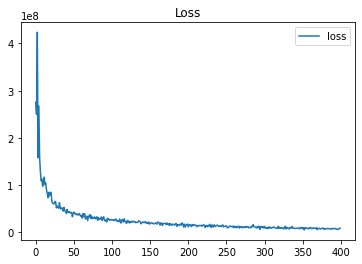

done 5 layers in 85.30ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2184.68452079]


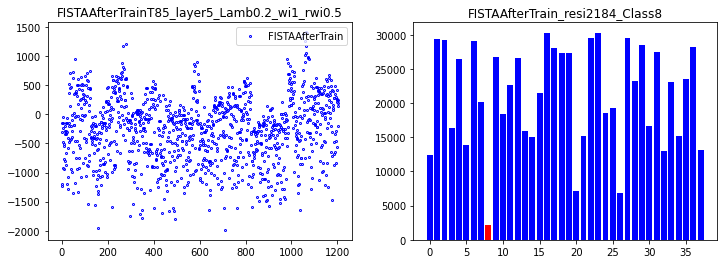

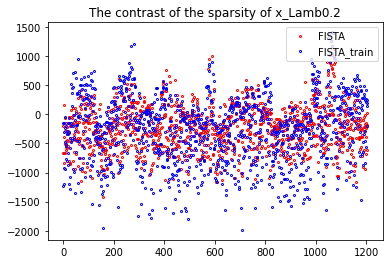

168
done 5 layers in 83.62ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[15796.90633677]


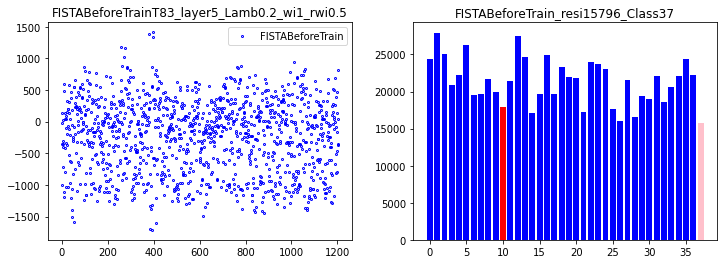

correct rate: 0.375
correct rate: 0.46875
correct rate: 0.53125
correct rate: 0.34375
Epoch [ 10/100]: loss = 44897280.1214,   lambda [max:0.2419], [min:0.1607], 
Epoch [ 20/100]: loss = 28769131.1380,   lambda [max:0.2528], [min:0.1485], 
Epoch [ 30/100]: loss = 25854984.6327,   lambda [max:0.2644], [min:0.1359], 
Epoch [ 40/100]: loss = 13552818.5167,   lambda [max:0.2700], [min:0.1276], 
Epoch [ 50/100]: loss = 14076650.3560,   lambda [max:0.2741], [min:0.1234], 
Epoch [ 60/100]: loss = 12638431.0603,   lambda [max:0.2773], [min:0.1201], 
Epoch [ 70/100]: loss = 9100640.4166,   lambda [max:0.2794], [min:0.1195], 
Epoch [ 80/100]: loss = 6392073.5715,   lambda [max:0.2816], [min:0.1191], 
Epoch [ 90/100]: loss = 7282041.7451,   lambda [max:0.2824], [min:0.1186], 
correct rate: 0.25
correct rate: 0.21875
correct rate: 0.25
correct rate: 0.375
Epoch [100/100]: loss = 6442631.0008,   lambda [max:0.2830], [min:0.1178], 


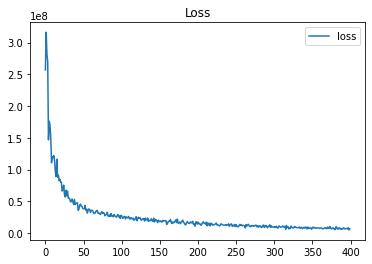

done 5 layers in 82.20ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[2050.48189966]


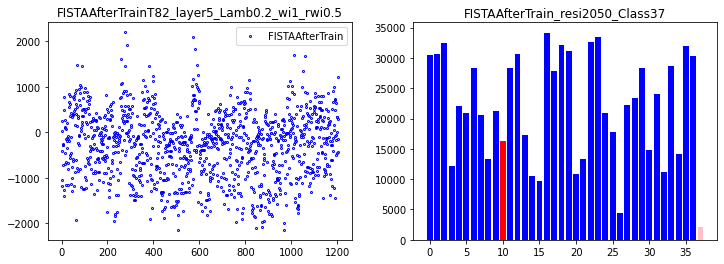

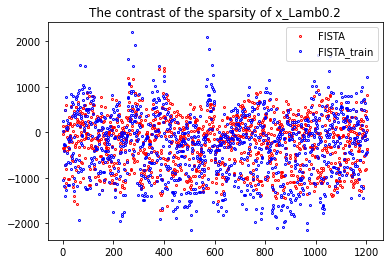

169
done 5 layers in 85.18ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[4730.73330457]


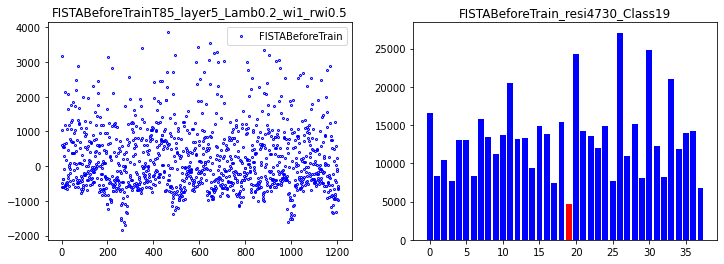

correct rate: 0.53125
correct rate: 0.40625
correct rate: 0.28125
correct rate: 0.53125
Epoch [ 10/100]: loss = 48320313.5314,   lambda [max:0.2395], [min:0.1637], 
Epoch [ 20/100]: loss = 35496320.8239,   lambda [max:0.2502], [min:0.1495], 
Epoch [ 30/100]: loss = 23684416.0709,   lambda [max:0.2534], [min:0.1375], 
Epoch [ 40/100]: loss = 17232056.8003,   lambda [max:0.2566], [min:0.1291], 
Epoch [ 50/100]: loss = 13297878.7942,   lambda [max:0.2590], [min:0.1237], 
Epoch [ 60/100]: loss = 12712063.0603,   lambda [max:0.2683], [min:0.1185], 
Epoch [ 70/100]: loss = 8771468.8320,   lambda [max:0.2755], [min:0.1144], 
Epoch [ 80/100]: loss = 7254306.8659,   lambda [max:0.2808], [min:0.1121], 
Epoch [ 90/100]: loss = 7781741.6649,   lambda [max:0.2846], [min:0.1099], 
correct rate: 0.15625
correct rate: 0.21875
correct rate: 0.25
correct rate: 0.40625
Epoch [100/100]: loss = 4752625.7487,   lambda [max:0.2857], [min:0.1082], 


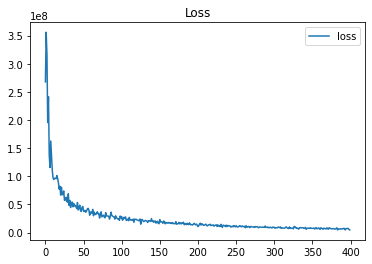

done 5 layers in 86.15ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[7529.73954195]


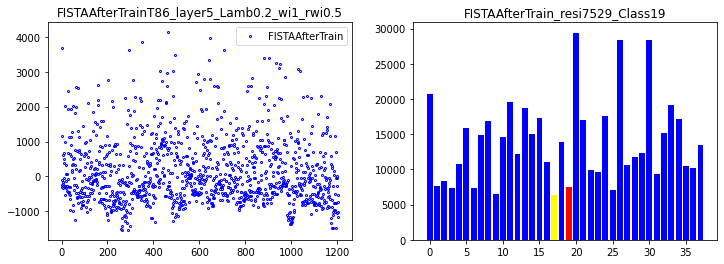

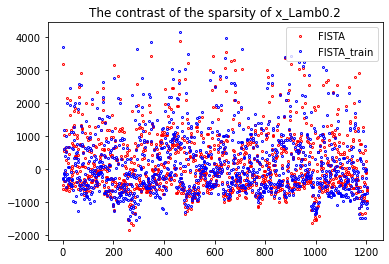

170
done 1 layers in 78.20ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[165030.03702222]


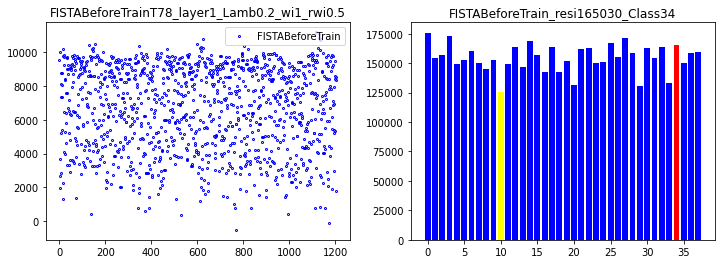

correct rate: 0.5625
correct rate: 0.59375
correct rate: 0.75
correct rate: 0.53125
Epoch [ 10/100]: loss = 1198538535.5682,   lambda [max:0.2629], [min:0.1698], 
Epoch [ 20/100]: loss = 428800683.2596,   lambda [max:0.3032], [min:0.1721], 
Epoch [ 30/100]: loss = 262319213.3460,   lambda [max:0.3357], [min:0.1715], 
Epoch [ 40/100]: loss = 201651201.8024,   lambda [max:0.3644], [min:0.1712], 
Epoch [ 50/100]: loss = 207786322.0263,   lambda [max:0.3906], [min:0.1715], 
Epoch [ 60/100]: loss = 128591021.2844,   lambda [max:0.4149], [min:0.1712], 
Epoch [ 70/100]: loss = 106004236.3068,   lambda [max:0.4377], [min:0.1704], 
Epoch [ 80/100]: loss = 119899008.9436,   lambda [max:0.4594], [min:0.1702], 
Epoch [ 90/100]: loss = 74004748.4692,   lambda [max:0.4802], [min:0.1693], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.09375
Epoch [100/100]: loss = 79362174.5379,   lambda [max:0.5001], [min:0.1691], 


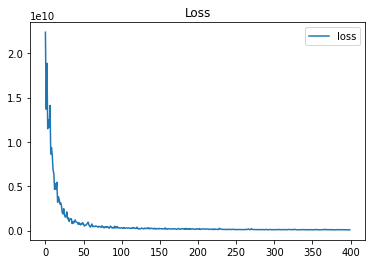

done 1 layers in 72.09ms
predict class: yaleB11
test image label: yaleB36
predict residuals label: 10
test residuals label: 34
[6163.64695435]


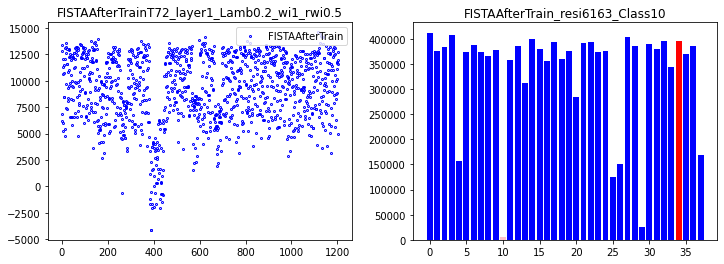

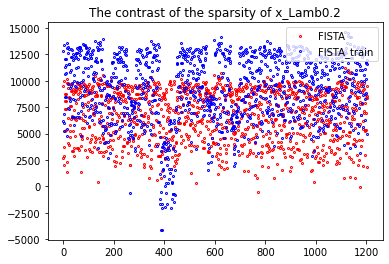

171
done 1 layers in 80.48ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[55240.64813281]


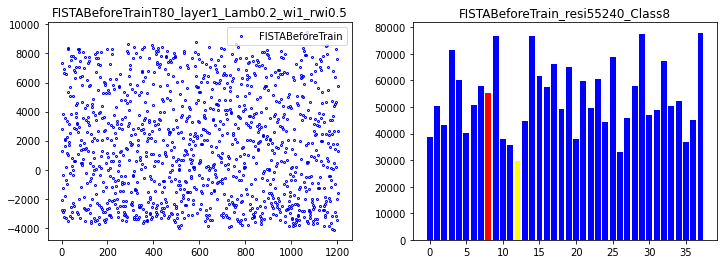

correct rate: 0.75
correct rate: 0.625
correct rate: 0.46875
correct rate: 0.59375
Epoch [ 10/100]: loss = 917729933.6083,   lambda [max:0.2629], [min:0.1670], 
Epoch [ 20/100]: loss = 359842000.5397,   lambda [max:0.3032], [min:0.1674], 
Epoch [ 30/100]: loss = 250042306.4520,   lambda [max:0.3357], [min:0.1668], 
Epoch [ 40/100]: loss = 187310102.1524,   lambda [max:0.3644], [min:0.1679], 
Epoch [ 50/100]: loss = 190498662.2916,   lambda [max:0.3905], [min:0.1699], 
Epoch [ 60/100]: loss = 121152448.0348,   lambda [max:0.4148], [min:0.1695], 
Epoch [ 70/100]: loss = 125393139.8777,   lambda [max:0.4377], [min:0.1706], 
Epoch [ 80/100]: loss = 102364821.7597,   lambda [max:0.4594], [min:0.1705], 
Epoch [ 90/100]: loss = 120561011.1433,   lambda [max:0.4801], [min:0.1707], 
correct rate: 0.125
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.0
Epoch [100/100]: loss = 133602328.3960,   lambda [max:0.5001], [min:0.1719], 


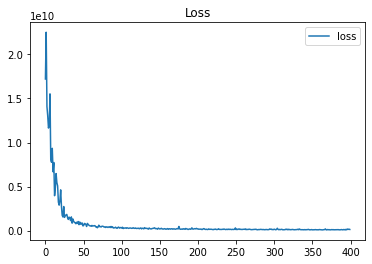

done 1 layers in 80.46ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[90247.16633091]


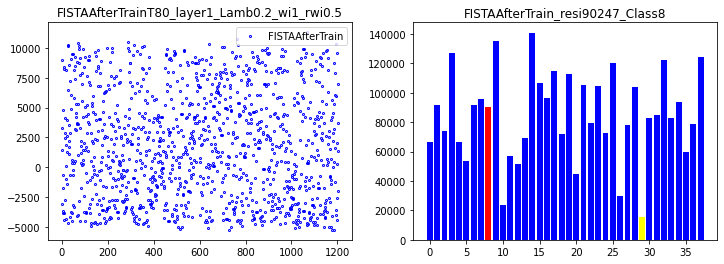

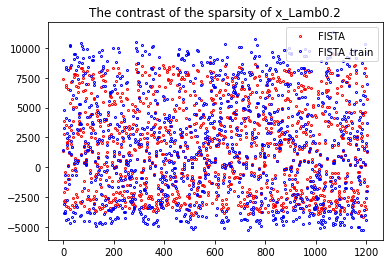

172
done 1 layers in 77.44ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[46018.76226547]


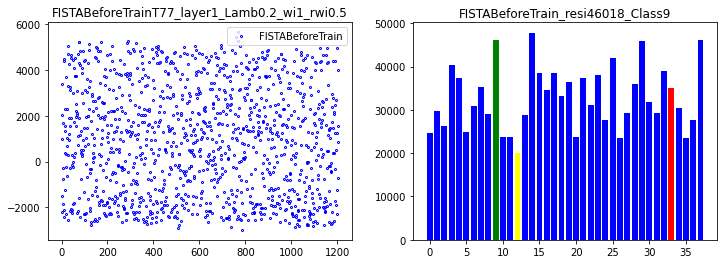

correct rate: 0.53125
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.65625
Epoch [ 10/100]: loss = 976439758.9275,   lambda [max:0.2629], [min:0.1702], 
Epoch [ 20/100]: loss = 428227667.3770,   lambda [max:0.3029], [min:0.1720], 
Epoch [ 30/100]: loss = 383642309.7347,   lambda [max:0.3353], [min:0.1695], 
Epoch [ 40/100]: loss = 178499839.9384,   lambda [max:0.3639], [min:0.1689], 
Epoch [ 50/100]: loss = 156003160.1571,   lambda [max:0.3899], [min:0.1673], 
Epoch [ 60/100]: loss = 181116269.4987,   lambda [max:0.4141], [min:0.1660], 
Epoch [ 70/100]: loss = 184533379.6807,   lambda [max:0.4369], [min:0.1660], 
Epoch [ 80/100]: loss = 99082746.7832,   lambda [max:0.4586], [min:0.1651], 
Epoch [ 90/100]: loss = 140454212.9841,   lambda [max:0.4793], [min:0.1648], 
correct rate: 0.125
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.0
Epoch [100/100]: loss = 96039069.8839,   lambda [max:0.4992], [min:0.1645], 


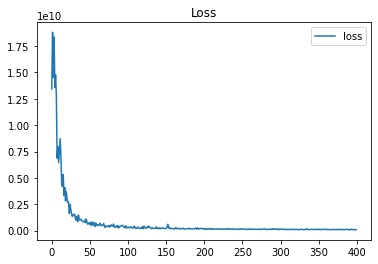

done 1 layers in 76.32ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[48755.891588]


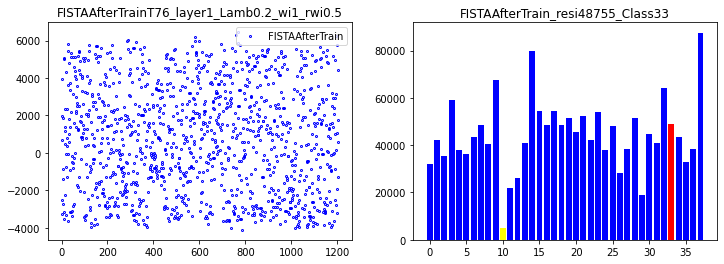

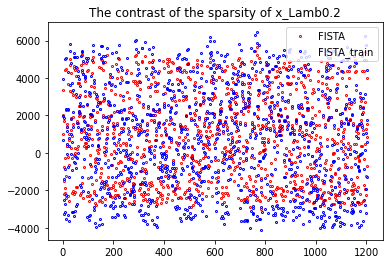

173
done 1 layers in 82.16ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[27569.91323808]


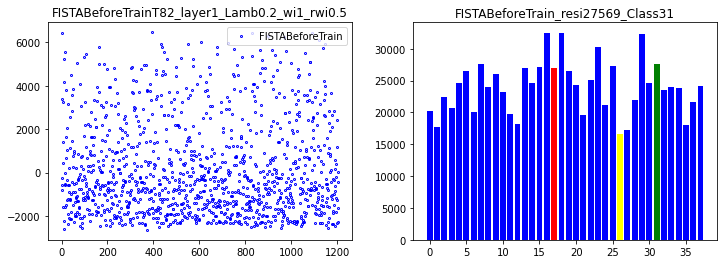

correct rate: 0.625
correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.53125
Epoch [ 10/100]: loss = 788457918.4174,   lambda [max:0.2629], [min:0.1763], 
Epoch [ 20/100]: loss = 324019409.7830,   lambda [max:0.3029], [min:0.1759], 
Epoch [ 30/100]: loss = 259911774.7802,   lambda [max:0.3353], [min:0.1741], 
Epoch [ 40/100]: loss = 254185917.3045,   lambda [max:0.3638], [min:0.1729], 
Epoch [ 50/100]: loss = 139144276.6955,   lambda [max:0.3899], [min:0.1720], 
Epoch [ 60/100]: loss = 111825588.2819,   lambda [max:0.4141], [min:0.1706], 
Epoch [ 70/100]: loss = 102995396.8488,   lambda [max:0.4370], [min:0.1696], 
Epoch [ 80/100]: loss = 92292433.6722,   lambda [max:0.4587], [min:0.1695], 
Epoch [ 90/100]: loss = 81438597.4803,   lambda [max:0.4796], [min:0.1691], 
correct rate: 0.15625
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.0
Epoch [100/100]: loss = 86145575.6764,   lambda [max:0.4996], [min:0.1686], 


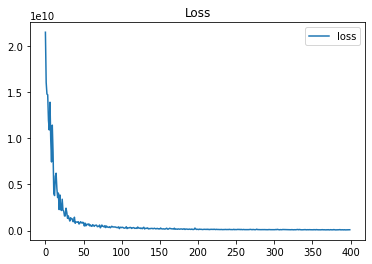

done 1 layers in 78.62ms
predict class: yaleB15
test image label: yaleB19
predict residuals label: 13
test residuals label: 17
[46804.1755814]


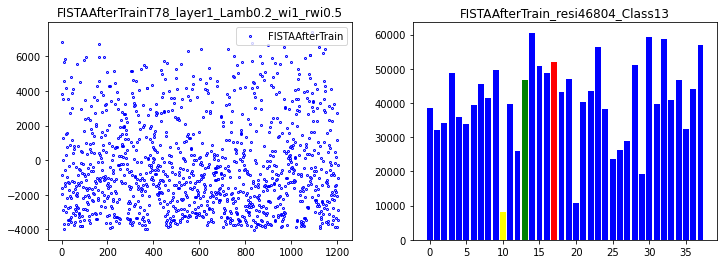

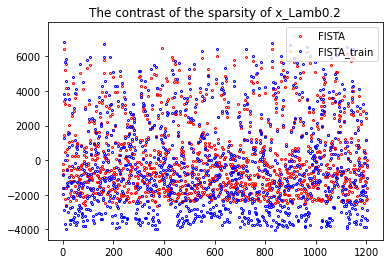

174
done 1 layers in 90.56ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[31029.64471825]


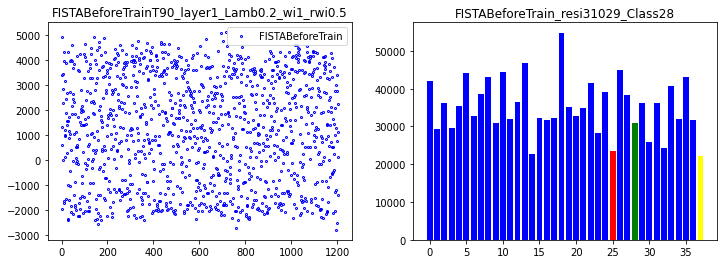

correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.75
Epoch [ 10/100]: loss = 1097835021.7796,   lambda [max:0.2629], [min:0.1717], 
Epoch [ 20/100]: loss = 482583247.0883,   lambda [max:0.3030], [min:0.1715], 
Epoch [ 30/100]: loss = 308884589.7413,   lambda [max:0.3353], [min:0.1700], 
Epoch [ 40/100]: loss = 184548716.4073,   lambda [max:0.3639], [min:0.1700], 
Epoch [ 50/100]: loss = 141058428.7182,   lambda [max:0.3900], [min:0.1695], 
Epoch [ 60/100]: loss = 93661678.6195,   lambda [max:0.4142], [min:0.1692], 
Epoch [ 70/100]: loss = 91875923.5782,   lambda [max:0.4370], [min:0.1685], 
Epoch [ 80/100]: loss = 83681652.5159,   lambda [max:0.4587], [min:0.1688], 
Epoch [ 90/100]: loss = 90865316.3685,   lambda [max:0.4794], [min:0.1687], 
correct rate: 0.0
correct rate: 0.03125
correct rate: 0.125
correct rate: 0.09375
Epoch [100/100]: loss = 109422459.5635,   lambda [max:0.4993], [min:0.1689], 


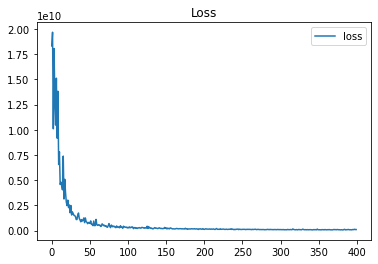

done 1 layers in 72.69ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[58810.02590965]


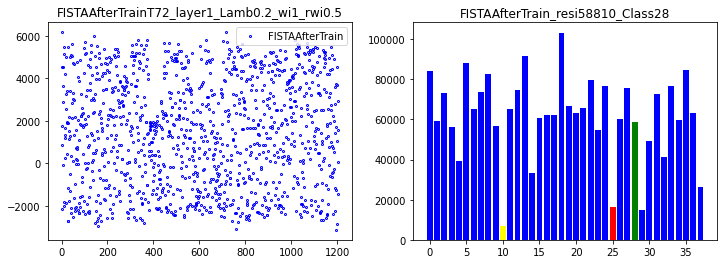

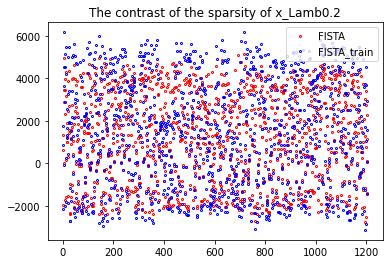

175
done 1 layers in 76.70ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[117197.32544141]


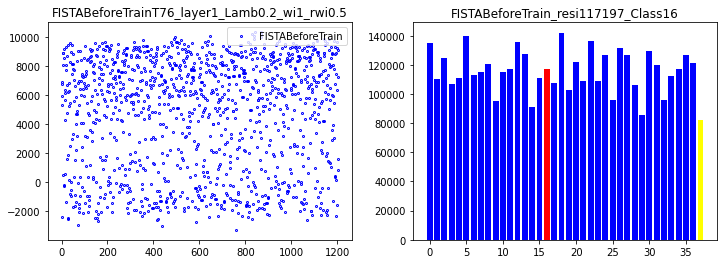

correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.5
Epoch [ 10/100]: loss = 649906845.6502,   lambda [max:0.2630], [min:0.1679], 
Epoch [ 20/100]: loss = 370932311.5498,   lambda [max:0.3032], [min:0.1663], 
Epoch [ 30/100]: loss = 203477463.7383,   lambda [max:0.3356], [min:0.1661], 
Epoch [ 40/100]: loss = 162591819.1051,   lambda [max:0.3643], [min:0.1652], 
Epoch [ 50/100]: loss = 127316344.9303,   lambda [max:0.3905], [min:0.1652], 
Epoch [ 60/100]: loss = 145928094.9734,   lambda [max:0.4149], [min:0.1641], 
Epoch [ 70/100]: loss = 165866549.9128,   lambda [max:0.4378], [min:0.1644], 
Epoch [ 80/100]: loss = 135996662.4299,   lambda [max:0.4595], [min:0.1646], 
Epoch [ 90/100]: loss = 91777928.7513,   lambda [max:0.4803], [min:0.1631], 
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.03125
Epoch [100/100]: loss = 83140811.6333,   lambda [max:0.5003], [min:0.1623], 


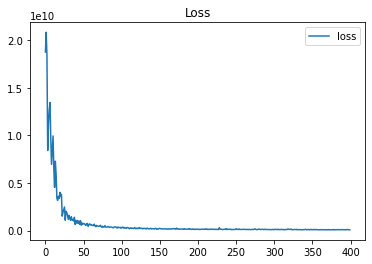

done 1 layers in 75.79ms
predict class: yaleB39
test image label: yaleB18
predict residuals label: 37
test residuals label: 16
[5952.2209703]


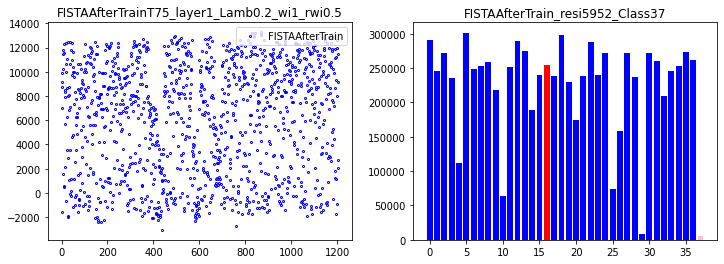

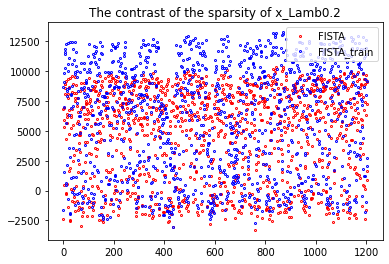

176
done 1 layers in 78.28ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[207823.21052799]


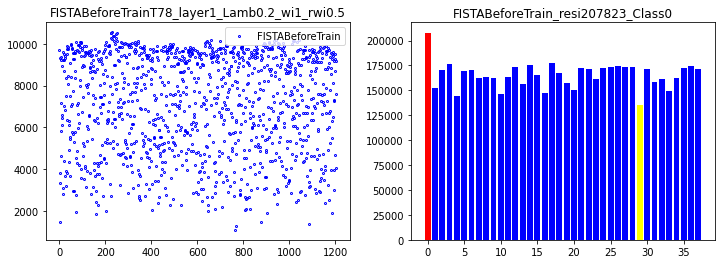

correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.46875
correct rate: 0.65625
Epoch [ 10/100]: loss = 1151953047.0047,   lambda [max:0.2630], [min:0.1688], 
Epoch [ 20/100]: loss = 457046471.9140,   lambda [max:0.3034], [min:0.1703], 
Epoch [ 30/100]: loss = 324026651.7368,   lambda [max:0.3359], [min:0.1693], 
Epoch [ 40/100]: loss = 250044551.8156,   lambda [max:0.3646], [min:0.1686], 
Epoch [ 50/100]: loss = 183190673.5610,   lambda [max:0.3907], [min:0.1683], 
Epoch [ 60/100]: loss = 147819689.5298,   lambda [max:0.4149], [min:0.1673], 
Epoch [ 70/100]: loss = 154048736.5292,   lambda [max:0.4377], [min:0.1668], 
Epoch [ 80/100]: loss = 139165968.1891,   lambda [max:0.4593], [min:0.1664], 
Epoch [ 90/100]: loss = 99778498.1655,   lambda [max:0.4799], [min:0.1658], 
correct rate: 0.03125
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 95414602.0955,   lambda [max:0.4998], [min:0.1658], 


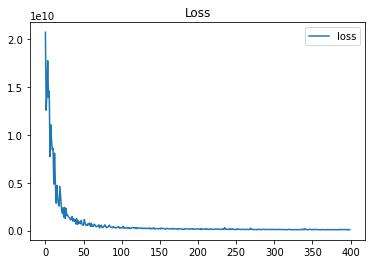

done 1 layers in 78.20ms
predict class: yaleB31
test image label: yaleB01
predict residuals label: 29
test residuals label: 0
[7950.37212169]


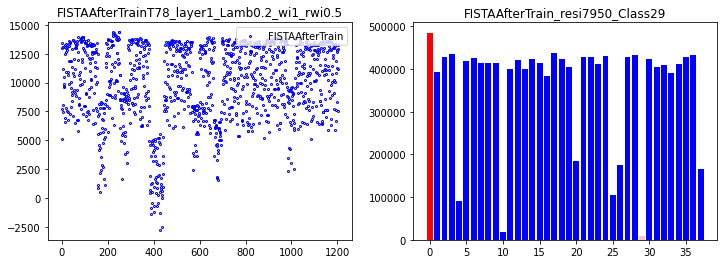

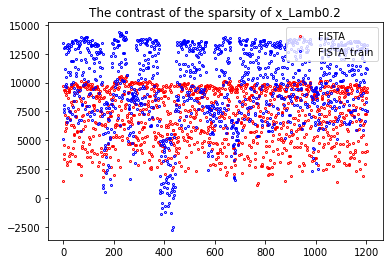

177
done 1 layers in 78.60ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[144025.71959696]


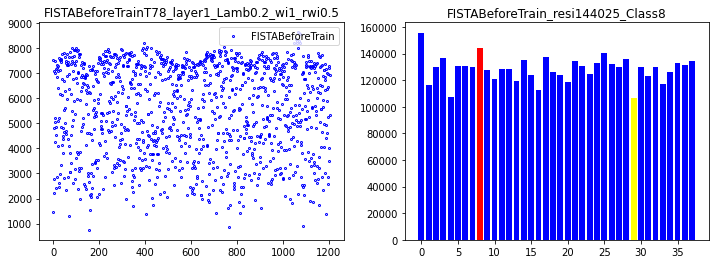

correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.59375
Epoch [ 10/100]: loss = 888220873.3527,   lambda [max:0.2629], [min:0.1723], 
Epoch [ 20/100]: loss = 394891128.3883,   lambda [max:0.3032], [min:0.1738], 
Epoch [ 30/100]: loss = 340102286.0683,   lambda [max:0.3357], [min:0.1720], 
Epoch [ 40/100]: loss = 180729959.6676,   lambda [max:0.3645], [min:0.1722], 
Epoch [ 50/100]: loss = 136248450.3240,   lambda [max:0.3907], [min:0.1723], 
Epoch [ 60/100]: loss = 98388971.0508,   lambda [max:0.4150], [min:0.1715], 
Epoch [ 70/100]: loss = 123215332.7980,   lambda [max:0.4379], [min:0.1711], 
Epoch [ 80/100]: loss = 109388261.4699,   lambda [max:0.4596], [min:0.1713], 
Epoch [ 90/100]: loss = 82770759.1665,   lambda [max:0.4804], [min:0.1704], 
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.09375
correct rate: 0.03125
Epoch [100/100]: loss = 88147797.3803,   lambda [max:0.5003], [min:0.1696], 


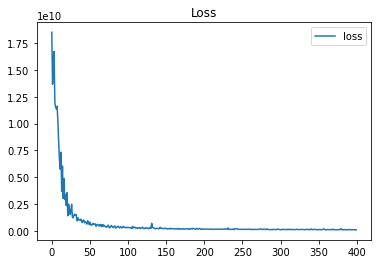

done 1 layers in 82.21ms
predict class: yaleB31
test image label: yaleB09
predict residuals label: 29
test residuals label: 8
[6002.96800952]


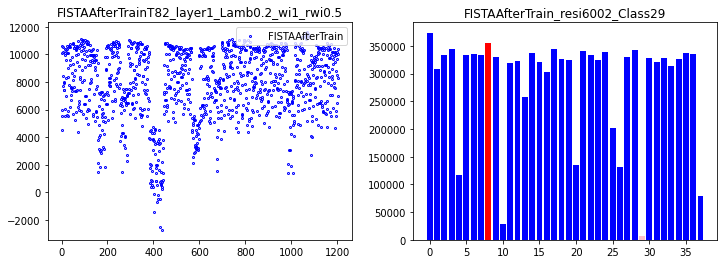

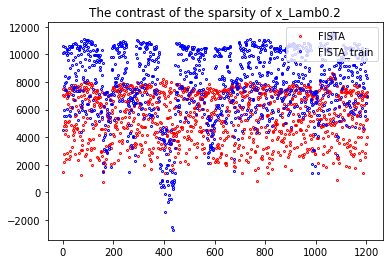

178
done 1 layers in 80.51ms
predict class: yaleB30
test image label: yaleB11
predict residuals label: 28
test residuals label: 10
[140785.93102603]


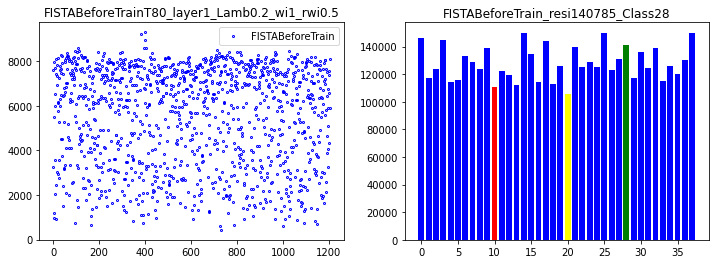

correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.625
Epoch [ 10/100]: loss = 934350520.7531,   lambda [max:0.2630], [min:0.1701], 
Epoch [ 20/100]: loss = 381632332.0682,   lambda [max:0.3034], [min:0.1703], 
Epoch [ 30/100]: loss = 285577836.3649,   lambda [max:0.3361], [min:0.1677], 
Epoch [ 40/100]: loss = 172969244.6965,   lambda [max:0.3650], [min:0.1669], 
Epoch [ 50/100]: loss = 135364373.3485,   lambda [max:0.3913], [min:0.1651], 
Epoch [ 60/100]: loss = 106977018.5052,   lambda [max:0.4157], [min:0.1648], 
Epoch [ 70/100]: loss = 103637134.4866,   lambda [max:0.4386], [min:0.1635], 
Epoch [ 80/100]: loss = 93059393.2410,   lambda [max:0.4604], [min:0.1630], 
Epoch [ 90/100]: loss = 87071273.6898,   lambda [max:0.4813], [min:0.1628], 
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.0625
Epoch [100/100]: loss = 85801719.7021,   lambda [max:0.5013], [min:0.1624], 


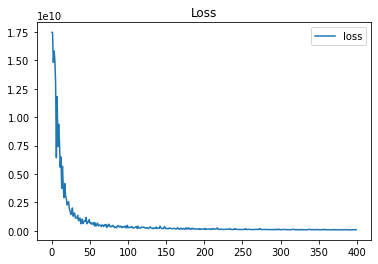

done 1 layers in 76.52ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[4651.39625415]


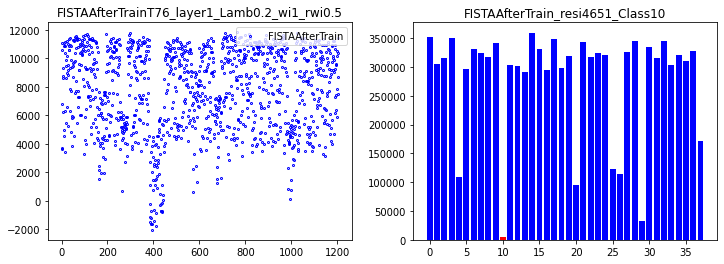

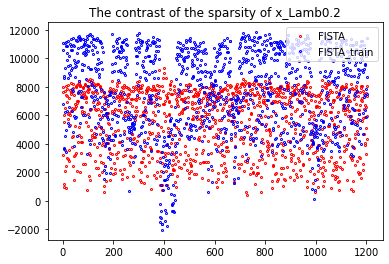

179
done 1 layers in 75.40ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[56893.9299482]


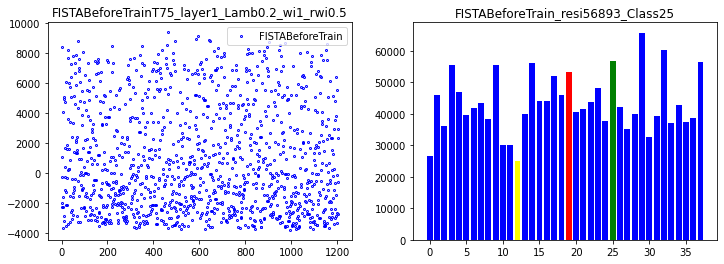

correct rate: 0.71875
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.5625
Epoch [ 10/100]: loss = 1019810054.9382,   lambda [max:0.2631], [min:0.1679], 
Epoch [ 20/100]: loss = 368001264.1561,   lambda [max:0.3035], [min:0.1662], 
Epoch [ 30/100]: loss = 229656101.3770,   lambda [max:0.3362], [min:0.1666], 
Epoch [ 40/100]: loss = 177125870.8289,   lambda [max:0.3651], [min:0.1654], 
Epoch [ 50/100]: loss = 159659922.8628,   lambda [max:0.3915], [min:0.1667], 
Epoch [ 60/100]: loss = 132554411.6747,   lambda [max:0.4160], [min:0.1667], 
Epoch [ 70/100]: loss = 133559174.1116,   lambda [max:0.4391], [min:0.1661], 
Epoch [ 80/100]: loss = 85686619.8760,   lambda [max:0.4611], [min:0.1659], 
Epoch [ 90/100]: loss = 91185056.9894,   lambda [max:0.4820], [min:0.1659], 
correct rate: 0.0
correct rate: 0.125
correct rate: 0.0625
correct rate: 0.0625
Epoch [100/100]: loss = 84112898.5724,   lambda [max:0.5021], [min:0.1661], 


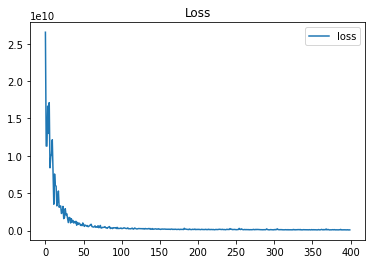

done 1 layers in 82.97ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[75005.98195098]


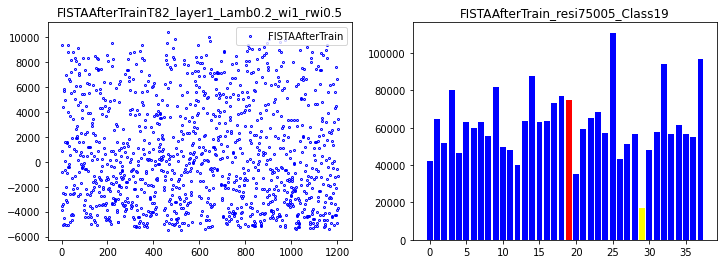

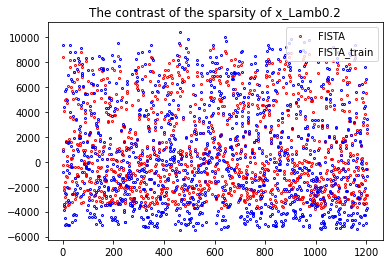

180
done 10 layers in 89.89ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[13941.38586987]


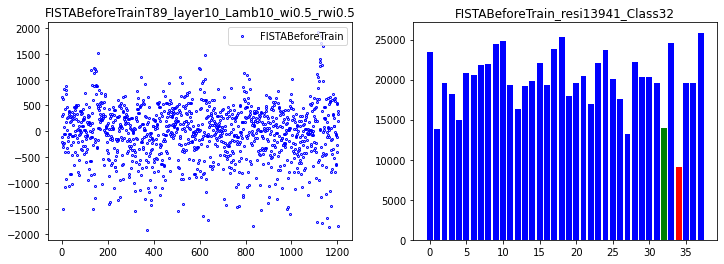

correct rate: 0.5625
correct rate: 0.5625
correct rate: 0.625
correct rate: 0.6875
Epoch [ 10/100]: loss = 62544465.0750,   lambda [max:10.0530], [min:9.9653], 
Epoch [ 20/100]: loss = 43733322.4842,   lambda [max:10.0807], [min:9.9523], 
Epoch [ 30/100]: loss = 35726894.7086,   lambda [max:10.1072], [min:9.9452], 
Epoch [ 40/100]: loss = 30663235.7016,   lambda [max:10.1327], [min:9.9384], 
Epoch [ 50/100]: loss = 28265172.3300,   lambda [max:10.1555], [min:9.9323], 
Epoch [ 60/100]: loss = 24861864.5036,   lambda [max:10.1776], [min:9.9270], 
Epoch [ 70/100]: loss = 22920971.3905,   lambda [max:10.1983], [min:9.9229], 
Epoch [ 80/100]: loss = 21691614.7602,   lambda [max:10.2185], [min:9.9196], 
Epoch [ 90/100]: loss = 20772029.7019,   lambda [max:10.2375], [min:9.9172], 
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.625
Epoch [100/100]: loss = 18462671.9410,   lambda [max:10.2559], [min:9.9148], 


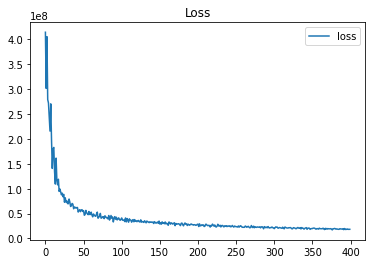

done 10 layers in 86.83ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[1143.90084787]


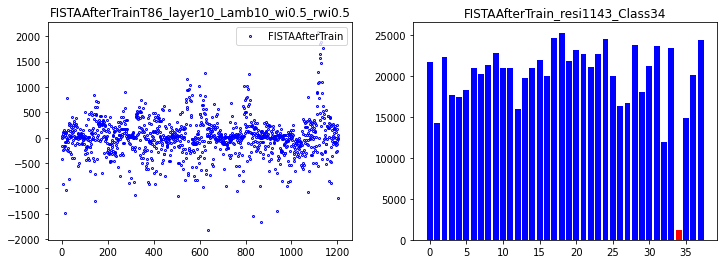

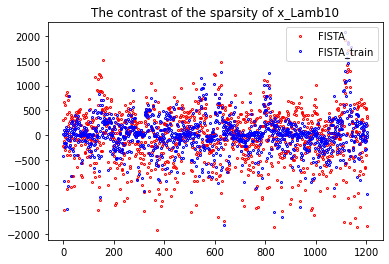

181
done 10 layers in 92.31ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[8822.74593575]


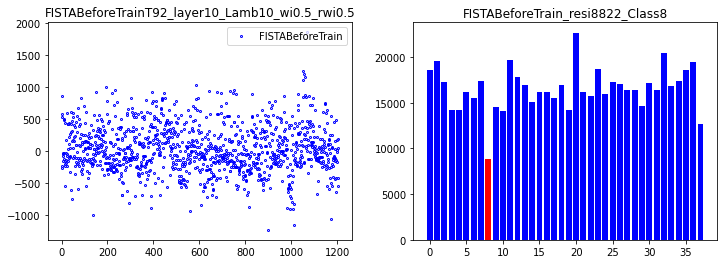

correct rate: 0.53125
correct rate: 0.5625
correct rate: 0.53125
correct rate: 0.6875
Epoch [ 10/100]: loss = 56300135.9894,   lambda [max:10.0553], [min:9.9664], 
Epoch [ 20/100]: loss = 37963927.1481,   lambda [max:10.0903], [min:9.9504], 
Epoch [ 30/100]: loss = 34500176.6509,   lambda [max:10.1201], [min:9.9412], 
Epoch [ 40/100]: loss = 30666426.8394,   lambda [max:10.1479], [min:9.9350], 
Epoch [ 50/100]: loss = 27012214.6371,   lambda [max:10.1708], [min:9.9306], 
Epoch [ 60/100]: loss = 24404978.5219,   lambda [max:10.1910], [min:9.9275], 
Epoch [ 70/100]: loss = 22591898.7969,   lambda [max:10.2098], [min:9.9248], 
Epoch [ 80/100]: loss = 21389830.6431,   lambda [max:10.2288], [min:9.9225], 
Epoch [ 90/100]: loss = 20000650.2213,   lambda [max:10.2484], [min:9.9206], 
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.5
correct rate: 0.75
Epoch [100/100]: loss = 17387866.5526,   lambda [max:10.2652], [min:9.9187], 


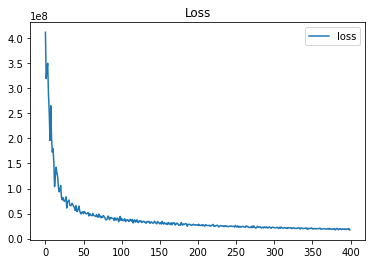

done 10 layers in 85.36ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1606.11364275]


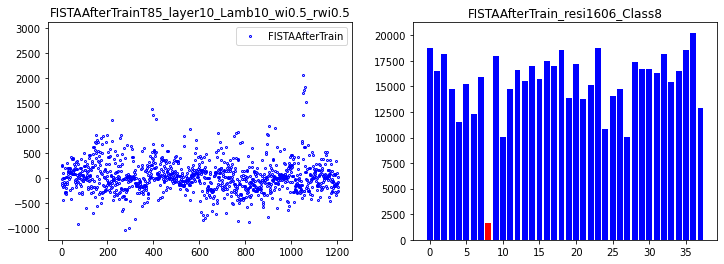

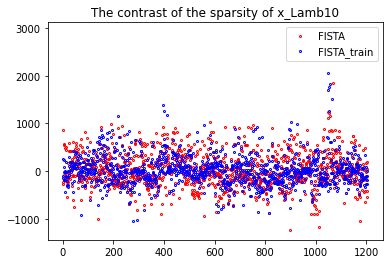

182
done 10 layers in 94.33ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6060.81923272]


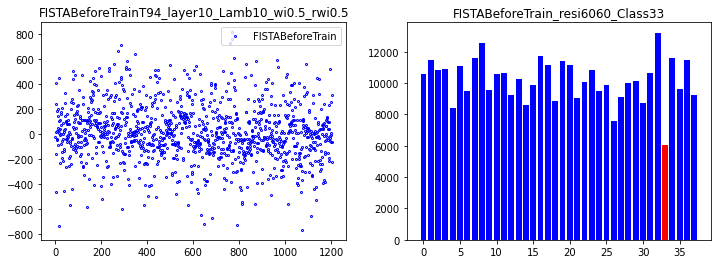

correct rate: 0.5
correct rate: 0.53125
correct rate: 0.75
correct rate: 0.59375
Epoch [ 10/100]: loss = 60524152.3951,   lambda [max:10.0549], [min:9.9635], 
Epoch [ 20/100]: loss = 42135065.0609,   lambda [max:10.0869], [min:9.9543], 
Epoch [ 30/100]: loss = 35097752.4641,   lambda [max:10.1160], [min:9.9460], 
Epoch [ 40/100]: loss = 32528375.8397,   lambda [max:10.1442], [min:9.9395], 
Epoch [ 50/100]: loss = 27507313.2732,   lambda [max:10.1696], [min:9.9346], 
Epoch [ 60/100]: loss = 23811692.4012,   lambda [max:10.1929], [min:9.9301], 
Epoch [ 70/100]: loss = 22786680.5228,   lambda [max:10.2147], [min:9.9261], 
Epoch [ 80/100]: loss = 21839268.3734,   lambda [max:10.2355], [min:9.9225], 
Epoch [ 90/100]: loss = 20945906.9250,   lambda [max:10.2554], [min:9.9195], 
correct rate: 0.75
correct rate: 0.46875
correct rate: 0.5625
correct rate: 0.8125
Epoch [100/100]: loss = 18942162.2805,   lambda [max:10.2745], [min:9.9170], 


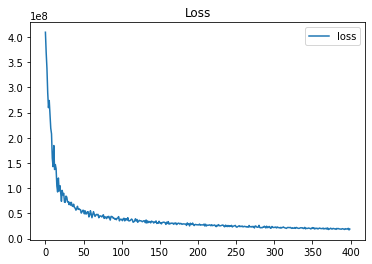

done 10 layers in 91.02ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[1282.03348868]


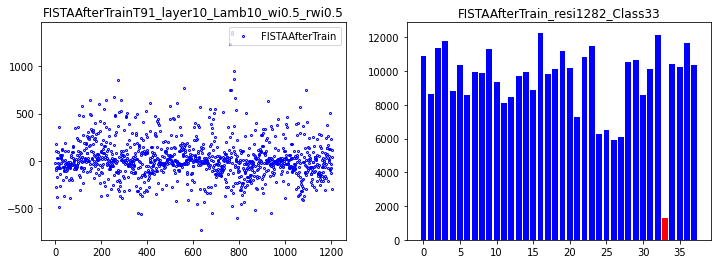

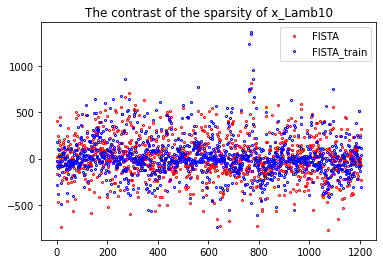

183
done 10 layers in 98.16ms
predict class: yaleB31
test image label: yaleB19
predict residuals label: 29
test residuals label: 17
[7794.27484626]


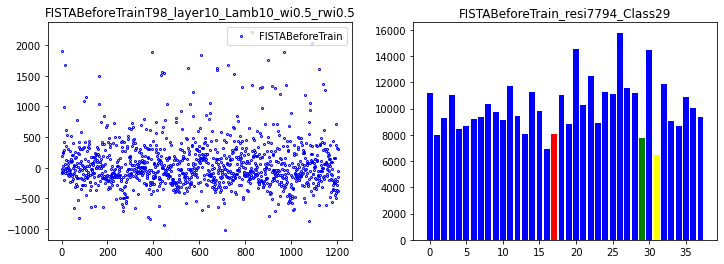

correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.5
correct rate: 0.65625
Epoch [ 10/100]: loss = 58638398.0553,   lambda [max:10.0567], [min:9.9620], 
Epoch [ 20/100]: loss = 40945072.1607,   lambda [max:10.0820], [min:9.9562], 
Epoch [ 30/100]: loss = 36393836.2752,   lambda [max:10.1191], [min:9.9474], 
Epoch [ 40/100]: loss = 32068445.5488,   lambda [max:10.1516], [min:9.9375], 
Epoch [ 50/100]: loss = 29426834.5592,   lambda [max:10.1805], [min:9.9296], 
Epoch [ 60/100]: loss = 24062042.5122,   lambda [max:10.2062], [min:9.9236], 
Epoch [ 70/100]: loss = 20746802.1847,   lambda [max:10.2290], [min:9.9183], 
Epoch [ 80/100]: loss = 20299668.3609,   lambda [max:10.2505], [min:9.9136], 
Epoch [ 90/100]: loss = 20407723.0426,   lambda [max:10.2703], [min:9.9099], 
correct rate: 0.625
correct rate: 0.625
correct rate: 0.625
correct rate: 0.75
Epoch [100/100]: loss = 18611901.6704,   lambda [max:10.2882], [min:9.9065], 


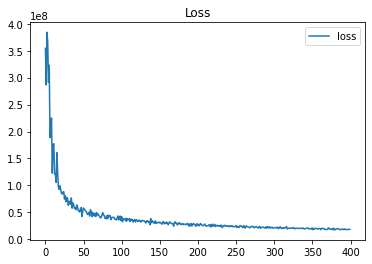

done 10 layers in 89.84ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[2960.61259181]


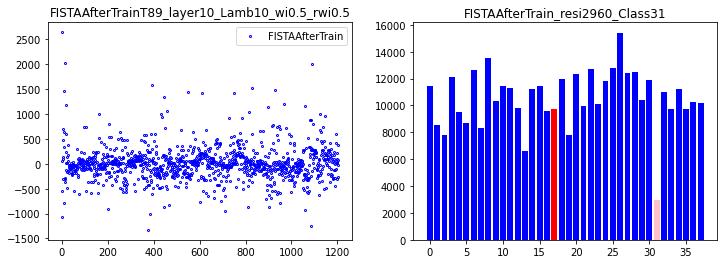

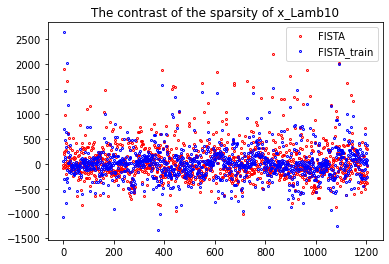

184
done 10 layers in 95.85ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[7973.40559981]


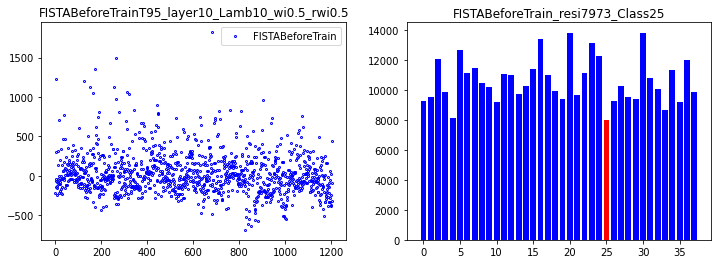

correct rate: 0.59375
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.59375
Epoch [ 10/100]: loss = 61769320.0352,   lambda [max:10.0500], [min:9.9625], 
Epoch [ 20/100]: loss = 41890045.8747,   lambda [max:10.0770], [min:9.9547], 
Epoch [ 30/100]: loss = 36157363.5478,   lambda [max:10.1061], [min:9.9447], 
Epoch [ 40/100]: loss = 30454469.4970,   lambda [max:10.1336], [min:9.9360], 
Epoch [ 50/100]: loss = 26116767.9651,   lambda [max:10.1581], [min:9.9290], 
Epoch [ 60/100]: loss = 26460837.4813,   lambda [max:10.1801], [min:9.9236], 
Epoch [ 70/100]: loss = 23111804.7439,   lambda [max:10.2002], [min:9.9183], 
Epoch [ 80/100]: loss = 22497013.6270,   lambda [max:10.2185], [min:9.9135], 
Epoch [ 90/100]: loss = 20364067.2375,   lambda [max:10.2354], [min:9.9090], 
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.5
correct rate: 0.65625
Epoch [100/100]: loss = 19031013.4859,   lambda [max:10.2506], [min:9.9050], 


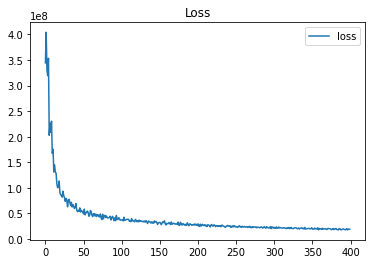

done 10 layers in 88.40ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[1169.70605724]


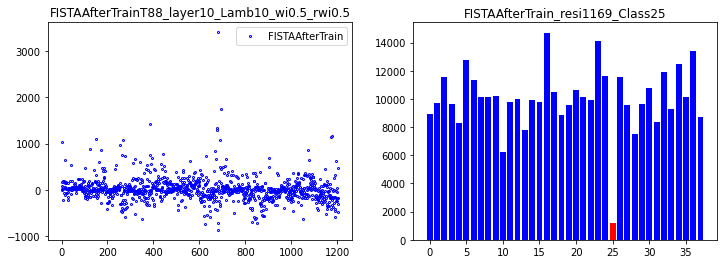

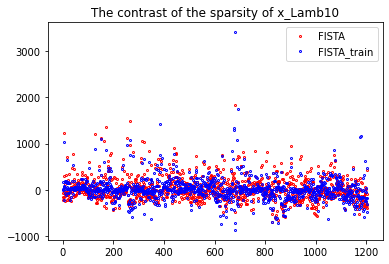

185
done 10 layers in 95.11ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[10512.26431666]


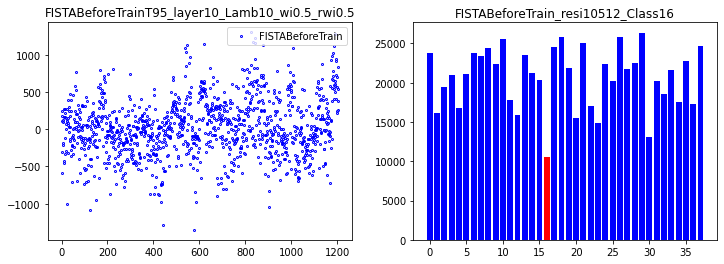

correct rate: 0.625
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.625
Epoch [ 10/100]: loss = 61338859.1688,   lambda [max:10.0524], [min:9.9620], 
Epoch [ 20/100]: loss = 42257258.4999,   lambda [max:10.0793], [min:9.9481], 
Epoch [ 30/100]: loss = 34937302.9961,   lambda [max:10.1048], [min:9.9333], 
Epoch [ 40/100]: loss = 30448623.4850,   lambda [max:10.1327], [min:9.9228], 
Epoch [ 50/100]: loss = 27080044.0796,   lambda [max:10.1584], [min:9.9147], 
Epoch [ 60/100]: loss = 24418008.9561,   lambda [max:10.1821], [min:9.9084], 
Epoch [ 70/100]: loss = 23658004.2979,   lambda [max:10.2046], [min:9.9029], 
Epoch [ 80/100]: loss = 22203796.5155,   lambda [max:10.2247], [min:9.8981], 
Epoch [ 90/100]: loss = 19122227.4584,   lambda [max:10.2424], [min:9.8945], 
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.75
Epoch [100/100]: loss = 17164879.1345,   lambda [max:10.2592], [min:9.8910], 


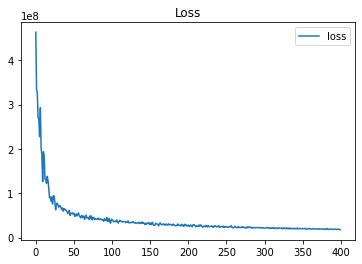

done 10 layers in 97.74ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[611.48166291]


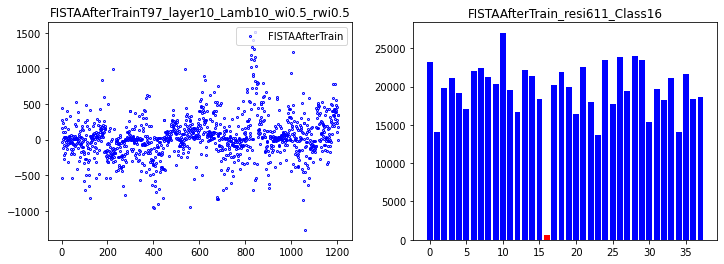

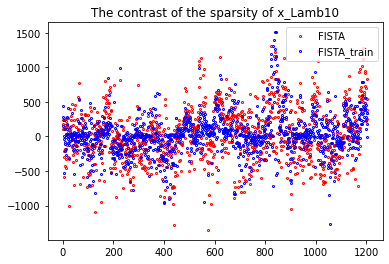

186
done 10 layers in 91.50ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[8534.80881601]


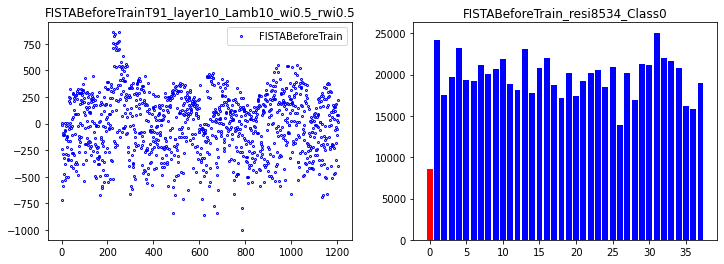

correct rate: 0.625
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.71875
Epoch [ 10/100]: loss = 61336583.6109,   lambda [max:10.0573], [min:9.9644], 
Epoch [ 20/100]: loss = 42261744.0930,   lambda [max:10.0921], [min:9.9501], 
Epoch [ 30/100]: loss = 35002156.4881,   lambda [max:10.1218], [min:9.9419], 
Epoch [ 40/100]: loss = 33053261.3240,   lambda [max:10.1479], [min:9.9366], 
Epoch [ 50/100]: loss = 29368180.1239,   lambda [max:10.1726], [min:9.9324], 
Epoch [ 60/100]: loss = 26249269.0028,   lambda [max:10.1948], [min:9.9296], 
Epoch [ 70/100]: loss = 21650397.4285,   lambda [max:10.2156], [min:9.9274], 
Epoch [ 80/100]: loss = 21592029.7607,   lambda [max:10.2350], [min:9.9261], 
Epoch [ 90/100]: loss = 20664936.4178,   lambda [max:10.2545], [min:9.9253], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.78125
correct rate: 0.5625
Epoch [100/100]: loss = 17550456.8466,   lambda [max:10.2725], [min:9.9243], 


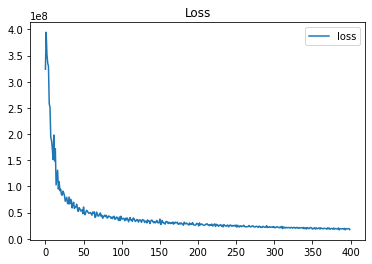

done 10 layers in 91.88ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1211.57615809]


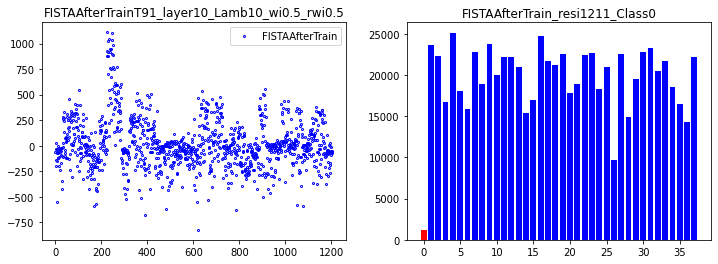

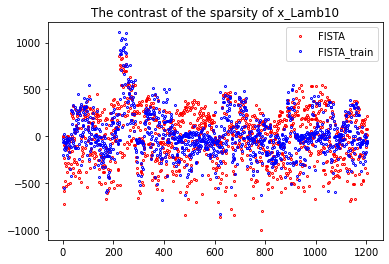

187
done 10 layers in 87.47ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2517.8860613]


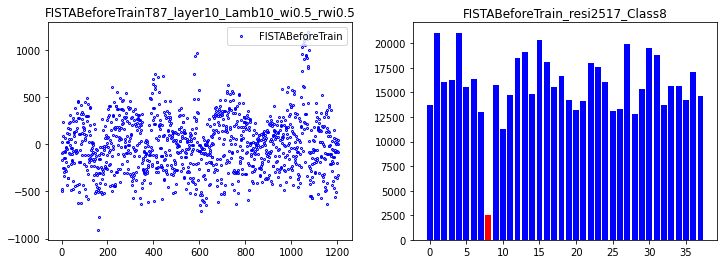

correct rate: 0.625
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.46875
Epoch [ 10/100]: loss = 70694322.7813,   lambda [max:10.0566], [min:9.9616], 
Epoch [ 20/100]: loss = 45256456.9585,   lambda [max:10.0870], [min:9.9462], 
Epoch [ 30/100]: loss = 35966067.7518,   lambda [max:10.1166], [min:9.9376], 
Epoch [ 40/100]: loss = 30055575.9930,   lambda [max:10.1485], [min:9.9315], 
Epoch [ 50/100]: loss = 26618167.0069,   lambda [max:10.1777], [min:9.9273], 
Epoch [ 60/100]: loss = 24499548.5989,   lambda [max:10.2038], [min:9.9241], 
Epoch [ 70/100]: loss = 21535664.6960,   lambda [max:10.2282], [min:9.9222], 
Epoch [ 80/100]: loss = 20956127.2383,   lambda [max:10.2512], [min:9.9207], 
Epoch [ 90/100]: loss = 21118686.8118,   lambda [max:10.2724], [min:9.9193], 
correct rate: 0.5625
correct rate: 0.84375
correct rate: 0.5625
correct rate: 0.59375
Epoch [100/100]: loss = 18241776.6829,   lambda [max:10.2911], [min:9.9184], 


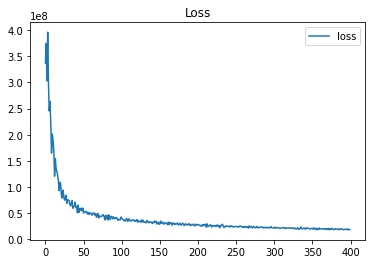

done 10 layers in 86.73ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1885.79546997]


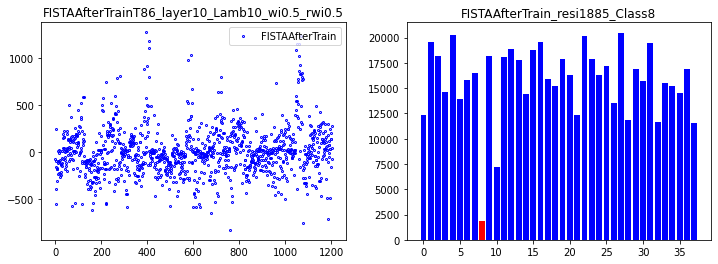

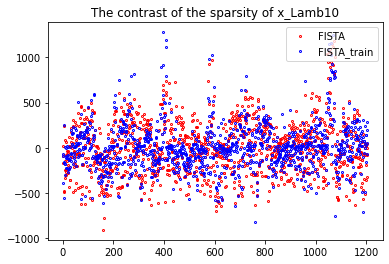

188
done 10 layers in 95.18ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[9767.57112045]


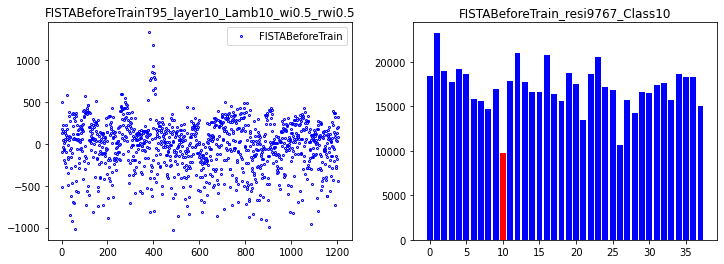

correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.71875
Epoch [ 10/100]: loss = 59362022.1234,   lambda [max:10.0542], [min:9.9661], 
Epoch [ 20/100]: loss = 47259012.9948,   lambda [max:10.0766], [min:9.9561], 
Epoch [ 30/100]: loss = 34286964.4582,   lambda [max:10.1005], [min:9.9456], 
Epoch [ 40/100]: loss = 28259780.0423,   lambda [max:10.1260], [min:9.9389], 
Epoch [ 50/100]: loss = 28124651.7246,   lambda [max:10.1489], [min:9.9342], 
Epoch [ 60/100]: loss = 25981164.8079,   lambda [max:10.1705], [min:9.9308], 
Epoch [ 70/100]: loss = 22613976.5091,   lambda [max:10.1891], [min:9.9273], 
Epoch [ 80/100]: loss = 20790622.5286,   lambda [max:10.2073], [min:9.9251], 
Epoch [ 90/100]: loss = 19706609.6879,   lambda [max:10.2233], [min:9.9230], 
correct rate: 0.625
correct rate: 0.8125
correct rate: 0.5625
correct rate: 0.625
Epoch [100/100]: loss = 19607772.4457,   lambda [max:10.2390], [min:9.9214], 


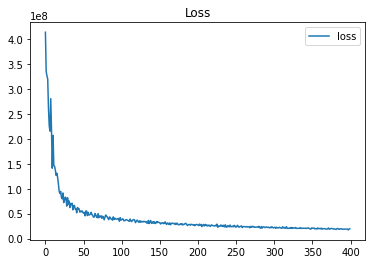

done 10 layers in 98.39ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1581.78904134]


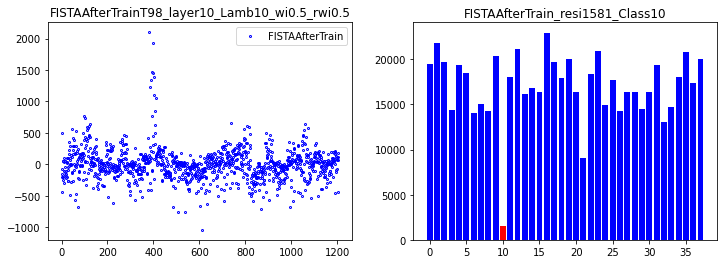

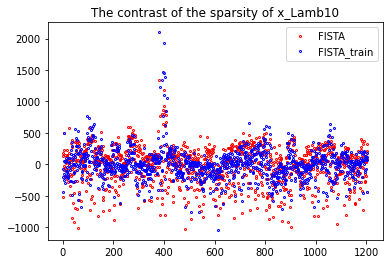

189
done 10 layers in 95.97ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[9010.79906215]


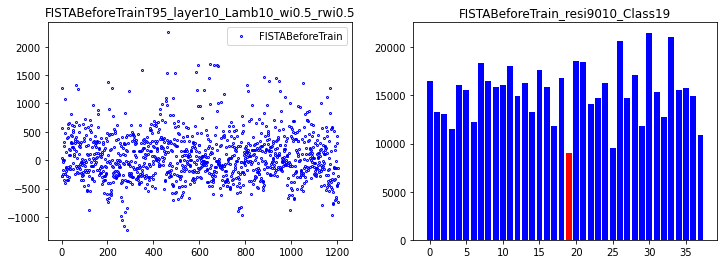

correct rate: 0.625
correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.65625
Epoch [ 10/100]: loss = 64055065.0517,   lambda [max:10.0529], [min:9.9596], 
Epoch [ 20/100]: loss = 43323126.0173,   lambda [max:10.0815], [min:9.9482], 
Epoch [ 30/100]: loss = 37592544.4208,   lambda [max:10.1089], [min:9.9396], 
Epoch [ 40/100]: loss = 32223411.4671,   lambda [max:10.1355], [min:9.9338], 
Epoch [ 50/100]: loss = 26281450.3690,   lambda [max:10.1591], [min:9.9296], 
Epoch [ 60/100]: loss = 24287189.2357,   lambda [max:10.1806], [min:9.9233], 
Epoch [ 70/100]: loss = 22102094.9193,   lambda [max:10.2003], [min:9.9194], 
Epoch [ 80/100]: loss = 20823981.7132,   lambda [max:10.2177], [min:9.9168], 
Epoch [ 90/100]: loss = 19882507.9685,   lambda [max:10.2339], [min:9.9152], 
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.5625
Epoch [100/100]: loss = 18064924.2750,   lambda [max:10.2507], [min:9.9135], 


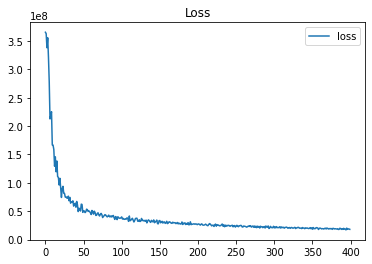

done 10 layers in 86.49ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[2952.5514336]


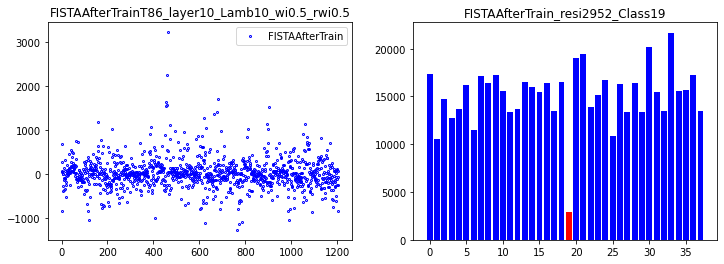

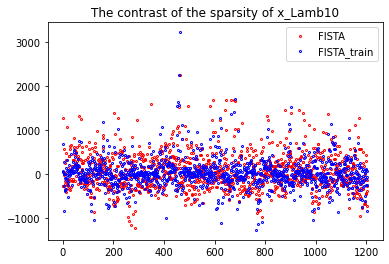

190
done 5 layers in 79.52ms
predict class: yaleB05
test image label: yaleB36
predict residuals label: 4
test residuals label: 34
[16737.98789477]


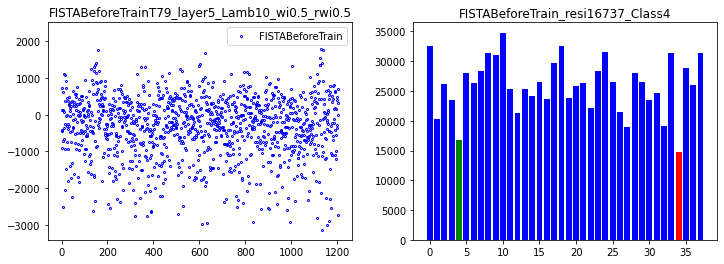

correct rate: 0.46875
correct rate: 0.4375
correct rate: 0.375
correct rate: 0.4375
Epoch [ 10/100]: loss = 85066959.2330,   lambda [max:10.0612], [min:9.9652], 
Epoch [ 20/100]: loss = 63281974.4450,   lambda [max:10.1038], [min:9.9502], 
Epoch [ 30/100]: loss = 60264498.5376,   lambda [max:10.1389], [min:9.9421], 
Epoch [ 40/100]: loss = 47824343.2372,   lambda [max:10.1677], [min:9.9369], 
Epoch [ 50/100]: loss = 43967625.1052,   lambda [max:10.1933], [min:9.9345], 
Epoch [ 60/100]: loss = 41785254.0663,   lambda [max:10.2157], [min:9.9320], 
Epoch [ 70/100]: loss = 34965923.9434,   lambda [max:10.2366], [min:9.9297], 
Epoch [ 80/100]: loss = 34185022.6004,   lambda [max:10.2558], [min:9.9302], 
Epoch [ 90/100]: loss = 36787923.9479,   lambda [max:10.2726], [min:9.9296], 
correct rate: 0.375
correct rate: 0.28125
correct rate: 0.21875
correct rate: 0.1875
Epoch [100/100]: loss = 32523297.3463,   lambda [max:10.2870], [min:9.9316], 


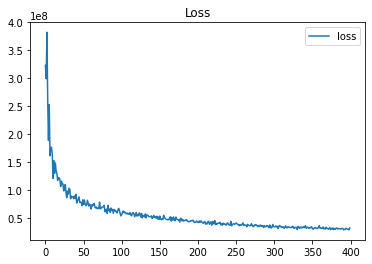

done 5 layers in 79.56ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[1761.94319026]


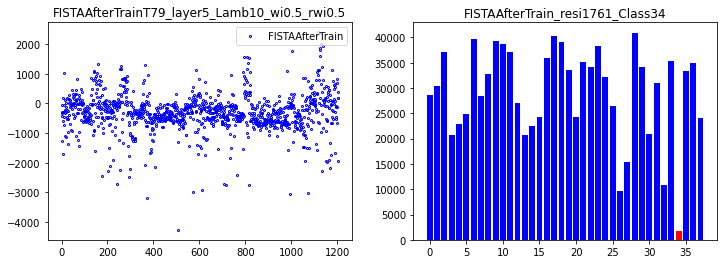

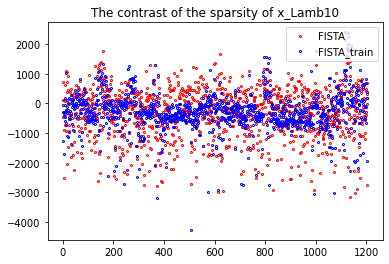

191
done 5 layers in 81.82ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[4445.81119946]


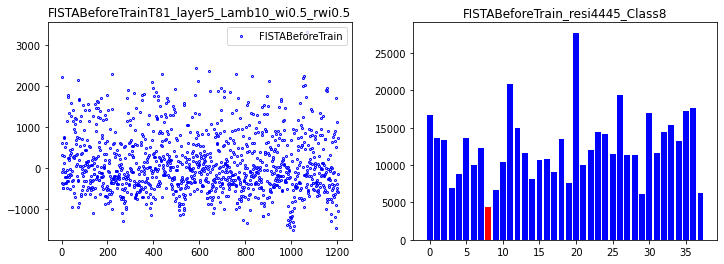

correct rate: 0.46875
correct rate: 0.4375
correct rate: 0.3125
correct rate: 0.4375
Epoch [ 10/100]: loss = 82651462.8009,   lambda [max:10.0617], [min:9.9637], 
Epoch [ 20/100]: loss = 71446370.8119,   lambda [max:10.1020], [min:9.9526], 
Epoch [ 30/100]: loss = 60543894.2558,   lambda [max:10.1330], [min:9.9443], 
Epoch [ 40/100]: loss = 47057716.6753,   lambda [max:10.1613], [min:9.9363], 
Epoch [ 50/100]: loss = 44969439.8824,   lambda [max:10.1869], [min:9.9316], 
Epoch [ 60/100]: loss = 40718717.5068,   lambda [max:10.2095], [min:9.9281], 
Epoch [ 70/100]: loss = 39563868.4748,   lambda [max:10.2301], [min:9.9244], 
Epoch [ 80/100]: loss = 35296767.2837,   lambda [max:10.2488], [min:9.9245], 
Epoch [ 90/100]: loss = 33254730.2621,   lambda [max:10.2657], [min:9.9242], 
correct rate: 0.21875
correct rate: 0.21875
correct rate: 0.34375
correct rate: 0.40625
Epoch [100/100]: loss = 32136401.8926,   lambda [max:10.2805], [min:9.9243], 


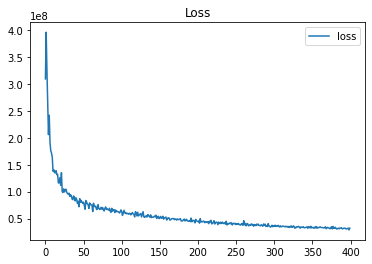

done 5 layers in 79.29ms
predict class: yaleB10
test image label: yaleB09
predict residuals label: 9
test residuals label: 8
[2838.4700069]


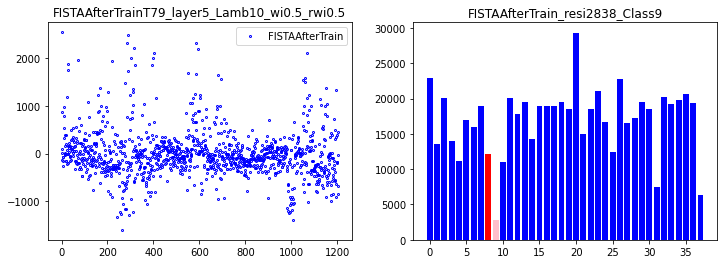

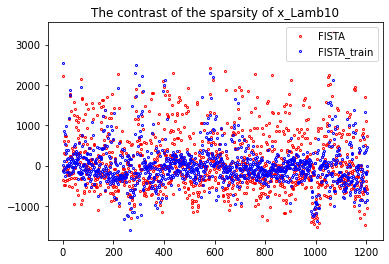

192
done 5 layers in 80.70ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4656.48754402]


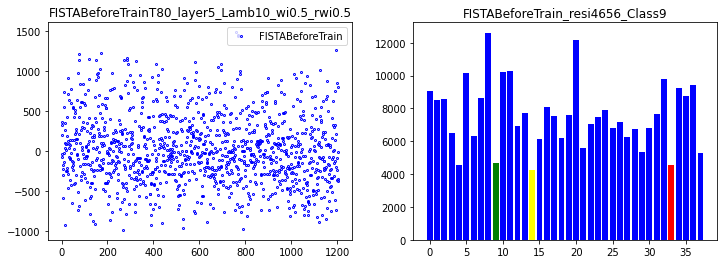

correct rate: 0.4375
correct rate: 0.5625
correct rate: 0.4375
correct rate: 0.34375
Epoch [ 10/100]: loss = 83547468.1770,   lambda [max:10.0571], [min:9.9778], 
Epoch [ 20/100]: loss = 60458628.1521,   lambda [max:10.1018], [min:9.9691], 
Epoch [ 30/100]: loss = 57199912.2545,   lambda [max:10.1366], [min:9.9573], 
Epoch [ 40/100]: loss = 51624227.5160,   lambda [max:10.1642], [min:9.9504], 
Epoch [ 50/100]: loss = 46801737.0242,   lambda [max:10.1884], [min:9.9451], 
Epoch [ 60/100]: loss = 41817547.5017,   lambda [max:10.2111], [min:9.9419], 
Epoch [ 70/100]: loss = 36830079.8079,   lambda [max:10.2318], [min:9.9425], 
Epoch [ 80/100]: loss = 33846463.5685,   lambda [max:10.2512], [min:9.9443], 
Epoch [ 90/100]: loss = 30093139.9185,   lambda [max:10.2683], [min:9.9456], 
correct rate: 0.3125
correct rate: 0.34375
correct rate: 0.1875
correct rate: 0.21875
Epoch [100/100]: loss = 30021029.0198,   lambda [max:10.2832], [min:9.9475], 


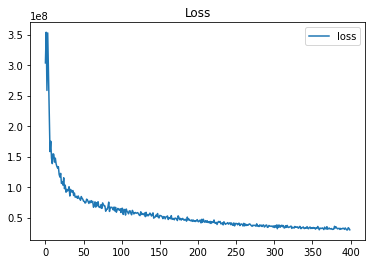

done 5 layers in 85.67ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[2744.44522874]


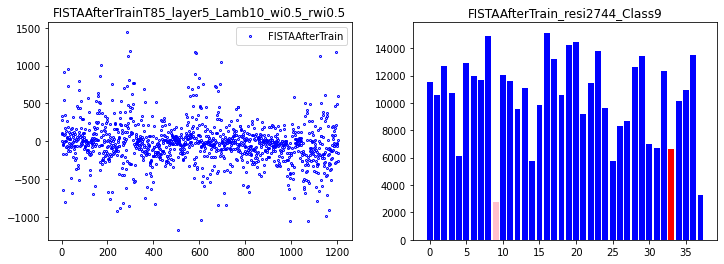

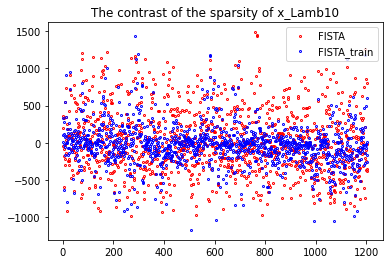

193
done 5 layers in 83.02ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[4966.80891396]


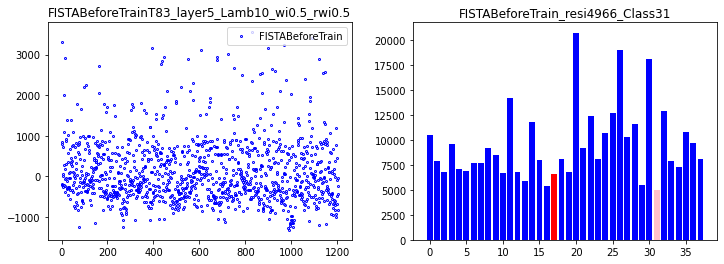

correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.40625
correct rate: 0.40625
Epoch [ 10/100]: loss = 79044288.9897,   lambda [max:10.0592], [min:9.9658], 
Epoch [ 20/100]: loss = 65657391.9480,   lambda [max:10.1049], [min:9.9526], 
Epoch [ 30/100]: loss = 58804926.1971,   lambda [max:10.1393], [min:9.9441], 
Epoch [ 40/100]: loss = 51309176.9487,   lambda [max:10.1685], [min:9.9387], 
Epoch [ 50/100]: loss = 47185041.4188,   lambda [max:10.1937], [min:9.9357], 
Epoch [ 60/100]: loss = 38756425.7921,   lambda [max:10.2167], [min:9.9336], 
Epoch [ 70/100]: loss = 35565052.4253,   lambda [max:10.2379], [min:9.9313], 
Epoch [ 80/100]: loss = 35403696.5457,   lambda [max:10.2575], [min:9.9317], 
Epoch [ 90/100]: loss = 33660558.5083,   lambda [max:10.2748], [min:9.9319], 
correct rate: 0.21875
correct rate: 0.4375
correct rate: 0.21875
correct rate: 0.25
Epoch [100/100]: loss = 30831646.0474,   lambda [max:10.2901], [min:9.9316], 


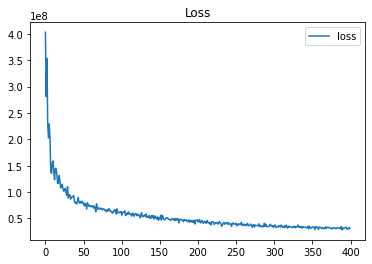

done 5 layers in 80.22ms
predict class: yaleB02
test image label: yaleB19
predict residuals label: 1
test residuals label: 17
[3181.78954273]


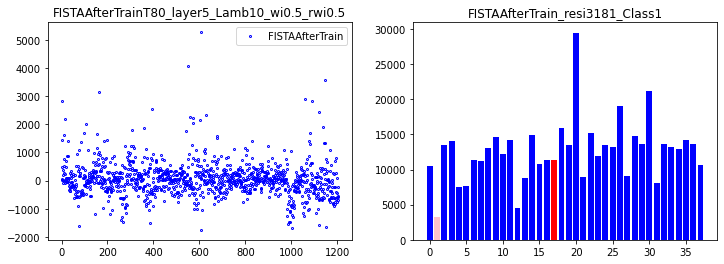

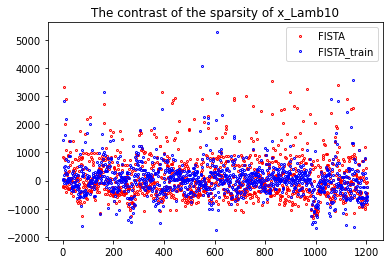

194
done 5 layers in 80.29ms
predict class: yaleB11
test image label: yaleB27
predict residuals label: 10
test residuals label: 25
[5465.70571366]


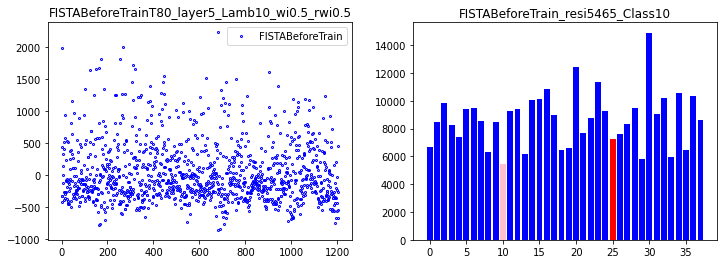

correct rate: 0.59375
correct rate: 0.5
correct rate: 0.21875
correct rate: 0.375
Epoch [ 10/100]: loss = 85226233.2782,   lambda [max:10.0594], [min:9.9756], 
Epoch [ 20/100]: loss = 67417365.0313,   lambda [max:10.1055], [min:9.9615], 
Epoch [ 30/100]: loss = 58945449.3814,   lambda [max:10.1409], [min:9.9551], 
Epoch [ 40/100]: loss = 52103300.3571,   lambda [max:10.1698], [min:9.9495], 
Epoch [ 50/100]: loss = 42861648.8608,   lambda [max:10.1947], [min:9.9466], 
Epoch [ 60/100]: loss = 41471991.8290,   lambda [max:10.2183], [min:9.9437], 
Epoch [ 70/100]: loss = 36974411.0586,   lambda [max:10.2392], [min:9.9392], 
Epoch [ 80/100]: loss = 33753641.7109,   lambda [max:10.2576], [min:9.9351], 
Epoch [ 90/100]: loss = 32991032.8113,   lambda [max:10.2747], [min:9.9323], 
correct rate: 0.28125
correct rate: 0.21875
correct rate: 0.3125
correct rate: 0.375
Epoch [100/100]: loss = 31901457.3638,   lambda [max:10.2899], [min:9.9299], 


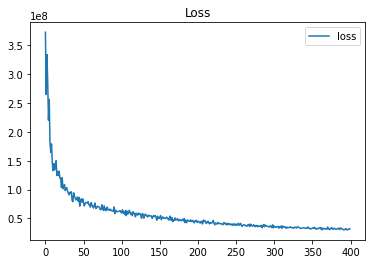

done 5 layers in 81.14ms
predict class: yaleB09
test image label: yaleB27
predict residuals label: 8
test residuals label: 25
[2239.73657926]


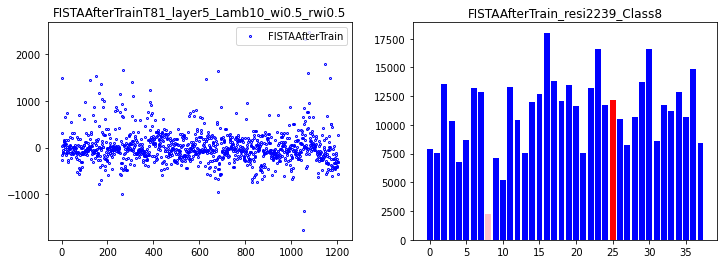

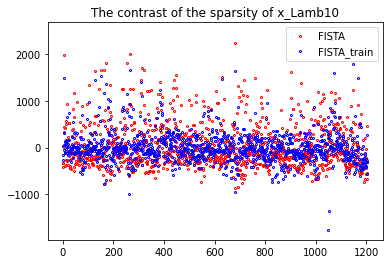

195
done 5 layers in 84.72ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[7226.85819751]


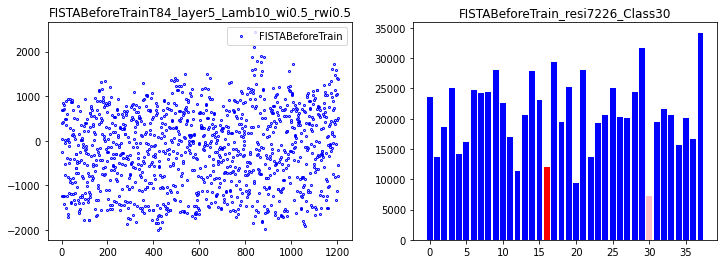

correct rate: 0.3125
correct rate: 0.53125
correct rate: 0.3125
correct rate: 0.53125
Epoch [ 10/100]: loss = 94277812.7804,   lambda [max:10.0573], [min:9.9738], 
Epoch [ 20/100]: loss = 69432353.9165,   lambda [max:10.1041], [min:9.9652], 
Epoch [ 30/100]: loss = 57357420.5260,   lambda [max:10.1393], [min:9.9581], 
Epoch [ 40/100]: loss = 47939493.8931,   lambda [max:10.1681], [min:9.9527], 
Epoch [ 50/100]: loss = 45393934.7652,   lambda [max:10.1933], [min:9.9478], 
Epoch [ 60/100]: loss = 39559245.7481,   lambda [max:10.2158], [min:9.9451], 
Epoch [ 70/100]: loss = 38161157.9184,   lambda [max:10.2358], [min:9.9425], 
Epoch [ 80/100]: loss = 33504692.0695,   lambda [max:10.2543], [min:9.9421], 
Epoch [ 90/100]: loss = 33027586.4863,   lambda [max:10.2712], [min:9.9416], 
correct rate: 0.4375
correct rate: 0.34375
correct rate: 0.125
correct rate: 0.25
Epoch [100/100]: loss = 29812913.1735,   lambda [max:10.2858], [min:9.9422], 


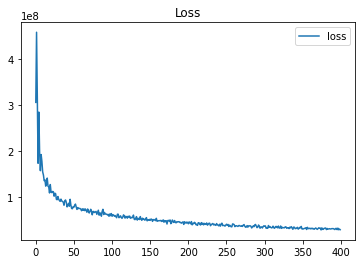

done 5 layers in 84.96ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[841.74186491]


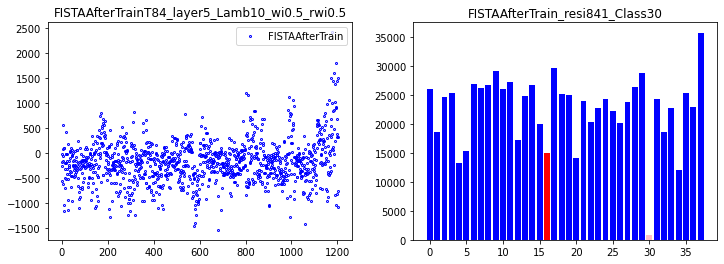

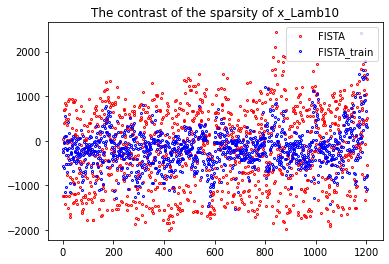

196
done 5 layers in 83.43ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[16822.70800562]


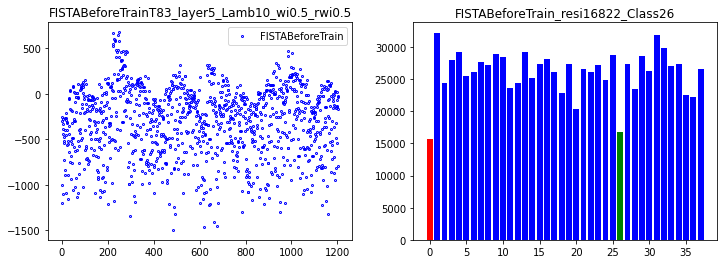

correct rate: 0.53125
correct rate: 0.5
correct rate: 0.3125
correct rate: 0.34375
Epoch [ 10/100]: loss = 84941929.2860,   lambda [max:10.0585], [min:9.9716], 
Epoch [ 20/100]: loss = 61587303.3158,   lambda [max:10.1037], [min:9.9573], 
Epoch [ 30/100]: loss = 55108368.6924,   lambda [max:10.1384], [min:9.9503], 
Epoch [ 40/100]: loss = 48718060.7127,   lambda [max:10.1669], [min:9.9439], 
Epoch [ 50/100]: loss = 46802196.5062,   lambda [max:10.1921], [min:9.9399], 
Epoch [ 60/100]: loss = 39597680.6087,   lambda [max:10.2152], [min:9.9375], 
Epoch [ 70/100]: loss = 38621898.3942,   lambda [max:10.2361], [min:9.9361], 
Epoch [ 80/100]: loss = 36230109.5231,   lambda [max:10.2548], [min:9.9352], 
Epoch [ 90/100]: loss = 32079767.3848,   lambda [max:10.2715], [min:9.9344], 
correct rate: 0.34375
correct rate: 0.34375
correct rate: 0.25
correct rate: 0.40625
Epoch [100/100]: loss = 33072561.7002,   lambda [max:10.2863], [min:9.9343], 


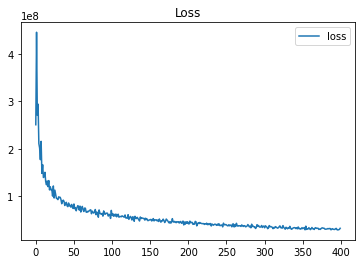

done 5 layers in 79.81ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[2452.9448184]


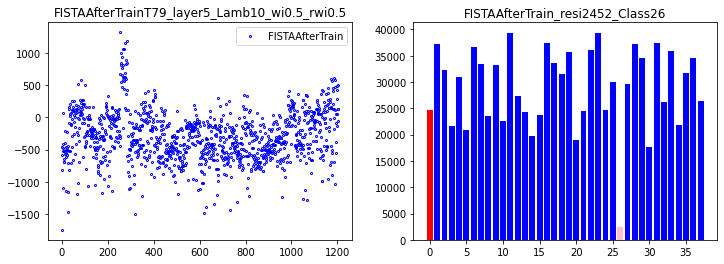

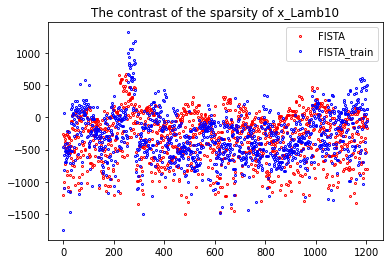

197
done 5 layers in 82.96ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[5129.29331545]


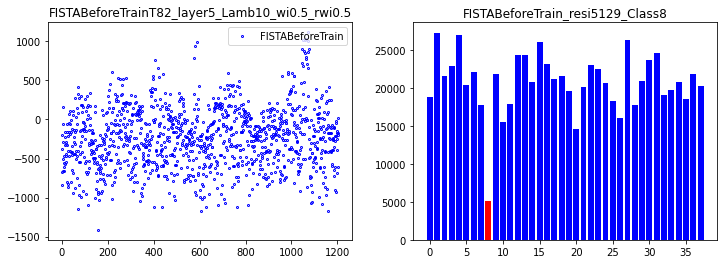

correct rate: 0.25
correct rate: 0.375
correct rate: 0.46875
correct rate: 0.5625
Epoch [ 10/100]: loss = 88039035.4860,   lambda [max:10.0615], [min:9.9710], 
Epoch [ 20/100]: loss = 65765445.4313,   lambda [max:10.1046], [min:9.9580], 
Epoch [ 30/100]: loss = 53727953.9654,   lambda [max:10.1392], [min:9.9469], 
Epoch [ 40/100]: loss = 50990364.7695,   lambda [max:10.1678], [min:9.9413], 
Epoch [ 50/100]: loss = 49310808.6949,   lambda [max:10.1924], [min:9.9399], 
Epoch [ 60/100]: loss = 40062681.4200,   lambda [max:10.2147], [min:9.9415], 
Epoch [ 70/100]: loss = 38289816.8241,   lambda [max:10.2353], [min:9.9427], 
Epoch [ 80/100]: loss = 32254528.9918,   lambda [max:10.2547], [min:9.9470], 
Epoch [ 90/100]: loss = 31664830.0448,   lambda [max:10.2719], [min:9.9496], 
correct rate: 0.1875
correct rate: 0.25
correct rate: 0.28125
correct rate: 0.3125
Epoch [100/100]: loss = 30574337.6774,   lambda [max:10.2863], [min:9.9474], 


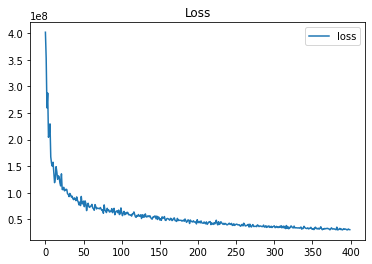

done 5 layers in 81.34ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1901.62406213]


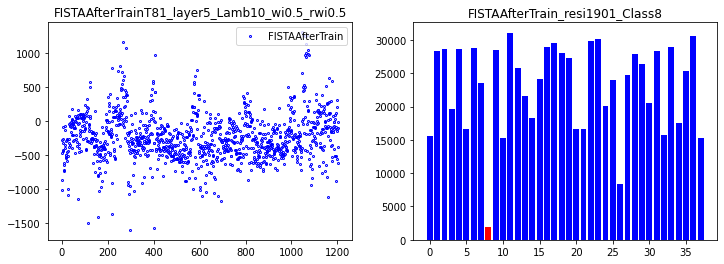

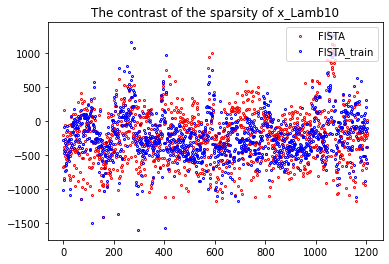

198
done 5 layers in 81.84ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[15797.11521824]


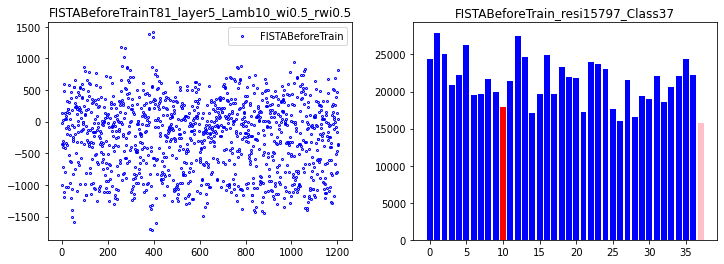

correct rate: 0.5625
correct rate: 0.40625
correct rate: 0.375
correct rate: 0.4375
Epoch [ 10/100]: loss = 91920921.2351,   lambda [max:10.0577], [min:9.9715], 
Epoch [ 20/100]: loss = 63688194.6546,   lambda [max:10.0979], [min:9.9645], 
Epoch [ 30/100]: loss = 55586850.6761,   lambda [max:10.1320], [min:9.9596], 
Epoch [ 40/100]: loss = 44317764.6585,   lambda [max:10.1607], [min:9.9551], 
Epoch [ 50/100]: loss = 40656090.2184,   lambda [max:10.1861], [min:9.9508], 
Epoch [ 60/100]: loss = 38795631.6378,   lambda [max:10.2085], [min:9.9471], 
Epoch [ 70/100]: loss = 35736246.6307,   lambda [max:10.2287], [min:9.9433], 
Epoch [ 80/100]: loss = 34422296.1046,   lambda [max:10.2484], [min:9.9393], 
Epoch [ 90/100]: loss = 34833116.6826,   lambda [max:10.2660], [min:9.9361], 
correct rate: 0.25
correct rate: 0.1875
correct rate: 0.375
correct rate: 0.375
Epoch [100/100]: loss = 30436165.2025,   lambda [max:10.2805], [min:9.9333], 


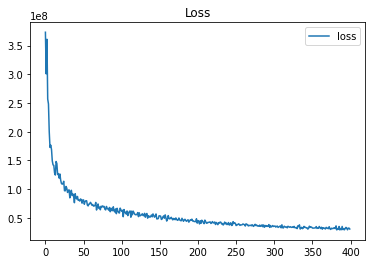

done 5 layers in 85.72ms
predict class: yaleB28
test image label: yaleB11
predict residuals label: 26
test residuals label: 10
[2429.53342056]


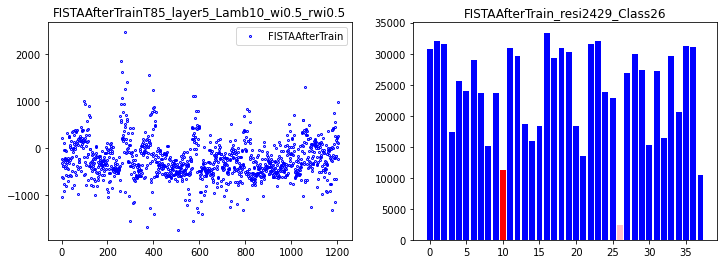

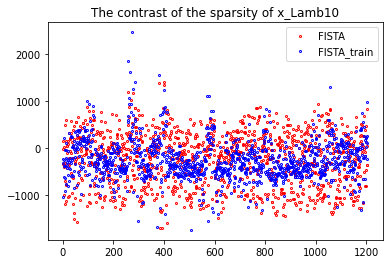

199
done 5 layers in 83.58ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[4730.76968357]


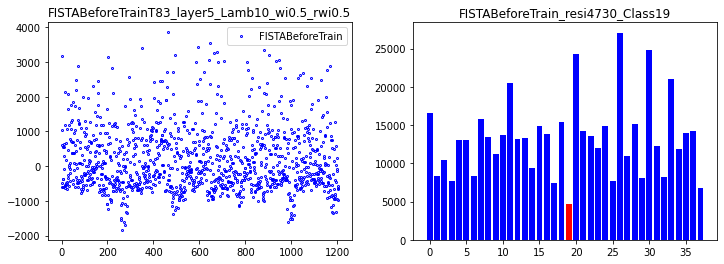

correct rate: 0.3125
correct rate: 0.46875
correct rate: 0.46875
correct rate: 0.40625
Epoch [ 10/100]: loss = 85451077.4583,   lambda [max:10.0587], [min:9.9764], 
Epoch [ 20/100]: loss = 61962365.2912,   lambda [max:10.1046], [min:9.9709], 
Epoch [ 30/100]: loss = 59293567.0595,   lambda [max:10.1398], [min:9.9675], 
Epoch [ 40/100]: loss = 50845251.1683,   lambda [max:10.1693], [min:9.9629], 
Epoch [ 50/100]: loss = 44198347.1351,   lambda [max:10.1949], [min:9.9599], 
Epoch [ 60/100]: loss = 39103941.9789,   lambda [max:10.2181], [min:9.9574], 
Epoch [ 70/100]: loss = 35256902.8807,   lambda [max:10.2393], [min:9.9534], 
Epoch [ 80/100]: loss = 37865913.2998,   lambda [max:10.2594], [min:9.9500], 
Epoch [ 90/100]: loss = 33446598.2823,   lambda [max:10.2771], [min:9.9472], 
correct rate: 0.34375
correct rate: 0.25
correct rate: 0.3125
correct rate: 0.25
Epoch [100/100]: loss = 31148824.6670,   lambda [max:10.2921], [min:9.9445], 


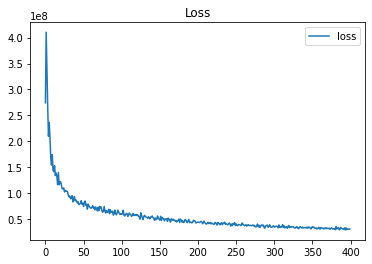

done 5 layers in 84.21ms
predict class: yaleB10
test image label: yaleB21
predict residuals label: 9
test residuals label: 19
[4315.08471733]


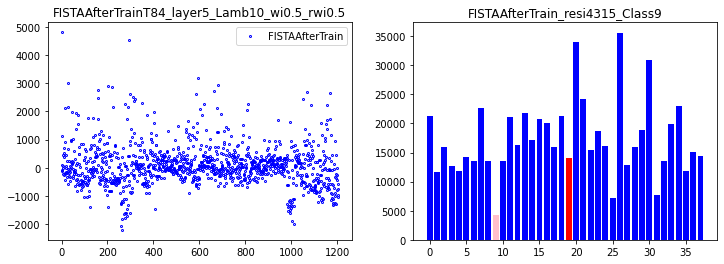

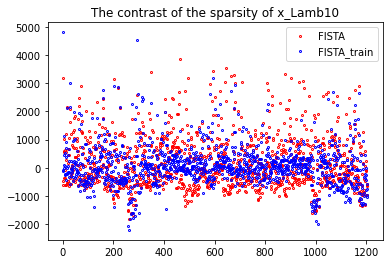

200
done 1 layers in 81.48ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[165029.85877878]


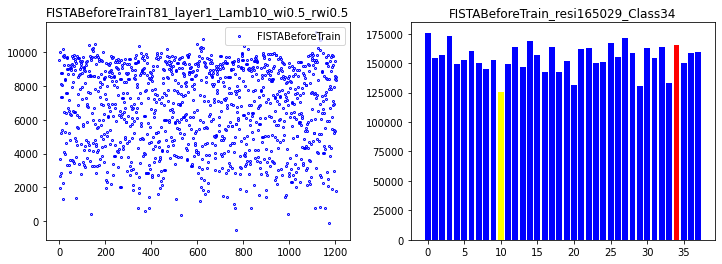

correct rate: 0.5
correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.6875
Epoch [ 10/100]: loss = 1491693209.5821,   lambda [max:10.0628], [min:9.9620], 
Epoch [ 20/100]: loss = 822864497.0045,   lambda [max:10.1026], [min:9.9632], 
Epoch [ 30/100]: loss = 514514994.3980,   lambda [max:10.1346], [min:9.9647], 
Epoch [ 40/100]: loss = 446187641.9536,   lambda [max:10.1625], [min:9.9645], 
Epoch [ 50/100]: loss = 507875742.0055,   lambda [max:10.1878], [min:9.9615], 
Epoch [ 60/100]: loss = 491734385.0409,   lambda [max:10.2111], [min:9.9624], 
Epoch [ 70/100]: loss = 465602879.7862,   lambda [max:10.2328], [min:9.9622], 
Epoch [ 80/100]: loss = 460689742.5169,   lambda [max:10.2532], [min:9.9624], 
Epoch [ 90/100]: loss = 464389430.7612,   lambda [max:10.2725], [min:9.9630], 
correct rate: 0.03125
correct rate: 0.0
correct rate: 0.125
correct rate: 0.09375
Epoch [100/100]: loss = 438596158.9703,   lambda [max:10.2909], [min:9.9623], 


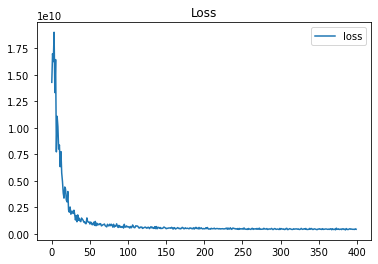

done 1 layers in 84.76ms
predict class: yaleB11
test image label: yaleB36
predict residuals label: 10
test residuals label: 34
[5893.69311933]


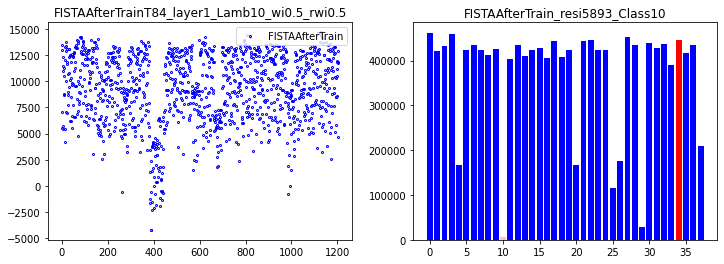

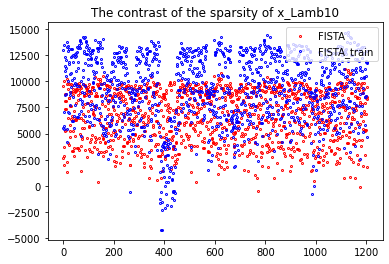

201
done 1 layers in 77.62ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[55240.5028473]


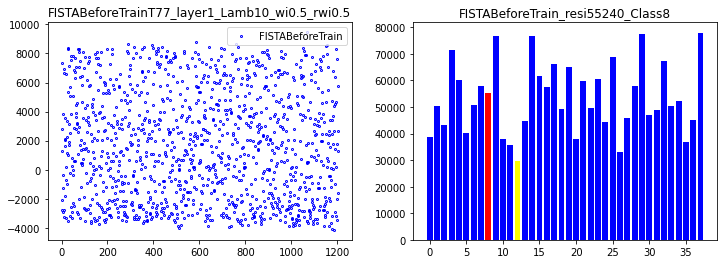

correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.75
correct rate: 0.53125
Epoch [ 10/100]: loss = 1034924208.6917,   lambda [max:10.0630], [min:9.9704], 
Epoch [ 20/100]: loss = 714140106.1061,   lambda [max:10.1029], [min:9.9713], 
Epoch [ 30/100]: loss = 587008326.2021,   lambda [max:10.1350], [min:9.9718], 
Epoch [ 40/100]: loss = 487676194.7966,   lambda [max:10.1630], [min:9.9712], 
Epoch [ 50/100]: loss = 496674362.5334,   lambda [max:10.1885], [min:9.9707], 
Epoch [ 60/100]: loss = 487475232.6646,   lambda [max:10.2118], [min:9.9712], 
Epoch [ 70/100]: loss = 494804007.7131,   lambda [max:10.2337], [min:9.9715], 
Epoch [ 80/100]: loss = 423295193.9396,   lambda [max:10.2543], [min:9.9708], 
Epoch [ 90/100]: loss = 404964631.5632,   lambda [max:10.2737], [min:9.9705], 
correct rate: 0.0625
correct rate: 0.0
correct rate: 0.125
correct rate: 0.0625
Epoch [100/100]: loss = 460482718.8421,   lambda [max:10.2923], [min:9.9703], 


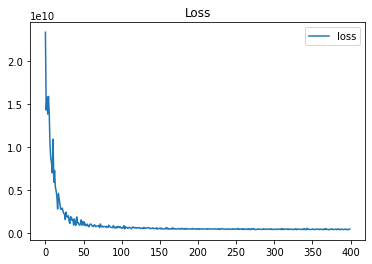

done 1 layers in 84.09ms
predict class: yaleB31
test image label: yaleB09
predict residuals label: 29
test residuals label: 8
[67542.06120189]


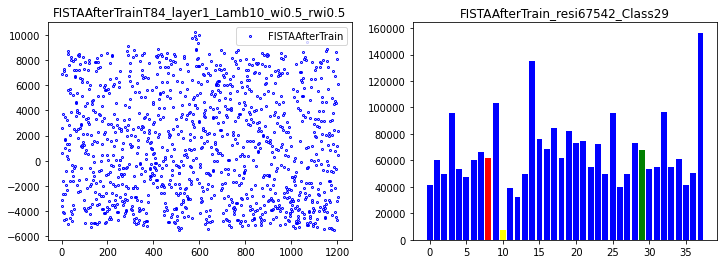

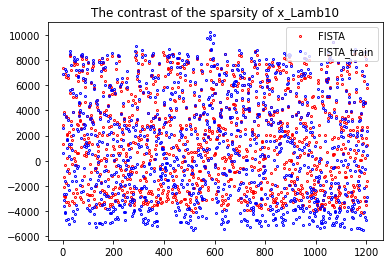

202
done 1 layers in 84.17ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[46018.58194607]


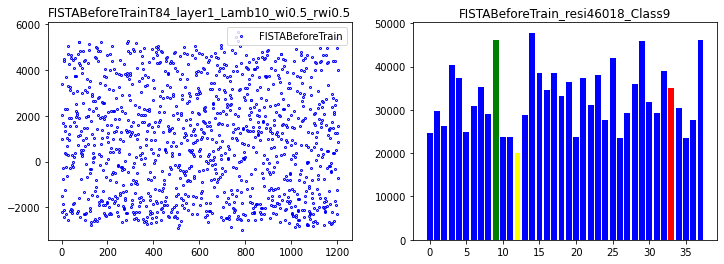

correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.53125
Epoch [ 10/100]: loss = 1009925985.9359,   lambda [max:10.0629], [min:9.9784], 
Epoch [ 20/100]: loss = 994862194.7837,   lambda [max:10.1028], [min:9.9835], 
Epoch [ 30/100]: loss = 522554411.5069,   lambda [max:10.1349], [min:9.9856], 
Epoch [ 40/100]: loss = 520841384.7698,   lambda [max:10.1629], [min:9.9861], 
Epoch [ 50/100]: loss = 609500240.8045,   lambda [max:10.1882], [min:9.9865], 
Epoch [ 60/100]: loss = 476632057.5561,   lambda [max:10.2114], [min:9.9869], 
Epoch [ 70/100]: loss = 425238006.6369,   lambda [max:10.2331], [min:9.9873], 
Epoch [ 80/100]: loss = 502831284.1156,   lambda [max:10.2535], [min:9.9878], 
Epoch [ 90/100]: loss = 492697854.9035,   lambda [max:10.2728], [min:9.9882], 
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.0625
correct rate: 0.0
Epoch [100/100]: loss = 408915372.3529,   lambda [max:10.2911], [min:9.9886], 


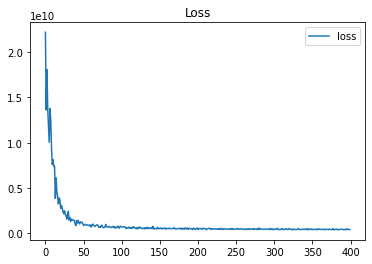

done 1 layers in 76.28ms
predict class: yaleB11
test image label: yaleB35
predict residuals label: 10
test residuals label: 33
[4159.92184502]


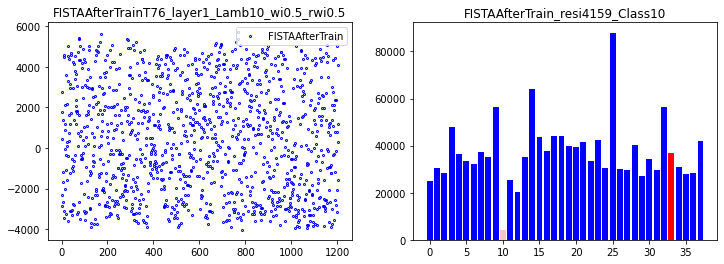

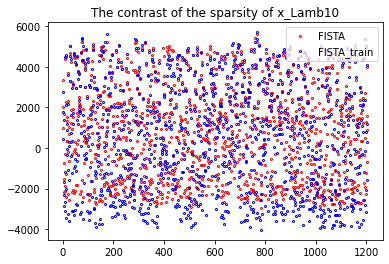

203
done 1 layers in 78.52ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[27569.75108349]


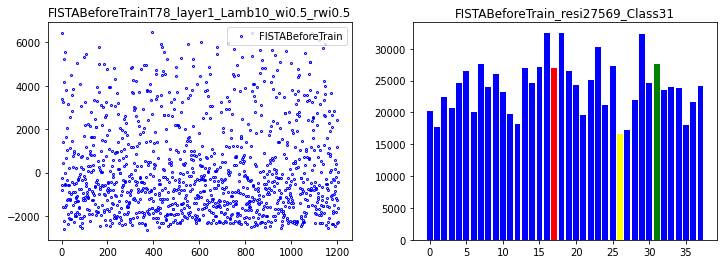

correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.625
correct rate: 0.53125
Epoch [ 10/100]: loss = 1853921969.6165,   lambda [max:10.0629], [min:9.9694], 
Epoch [ 20/100]: loss = 661686060.9714,   lambda [max:10.1030], [min:9.9711], 
Epoch [ 30/100]: loss = 570357975.9021,   lambda [max:10.1351], [min:9.9722], 
Epoch [ 40/100]: loss = 489938417.9656,   lambda [max:10.1632], [min:9.9711], 
Epoch [ 50/100]: loss = 504495267.0335,   lambda [max:10.1887], [min:9.9719], 
Epoch [ 60/100]: loss = 546850003.0033,   lambda [max:10.2121], [min:9.9712], 
Epoch [ 70/100]: loss = 431936325.9744,   lambda [max:10.2339], [min:9.9708], 
Epoch [ 80/100]: loss = 535070928.0561,   lambda [max:10.2544], [min:9.9707], 
Epoch [ 90/100]: loss = 440579080.3025,   lambda [max:10.2739], [min:9.9708], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.03125
Epoch [100/100]: loss = 438369378.8434,   lambda [max:10.2924], [min:9.9709], 


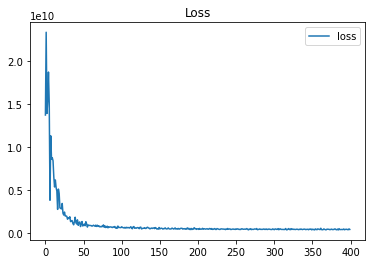

done 1 layers in 76.08ms
predict class: yaleB15
test image label: yaleB19
predict residuals label: 13
test residuals label: 17
[40008.25718403]


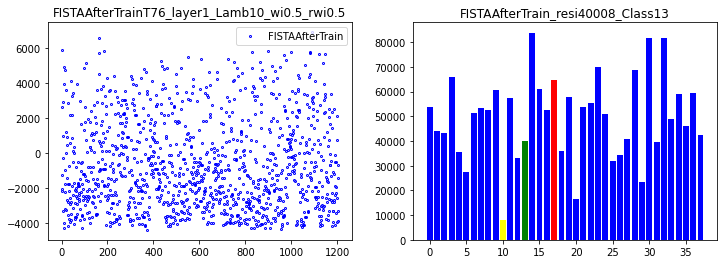

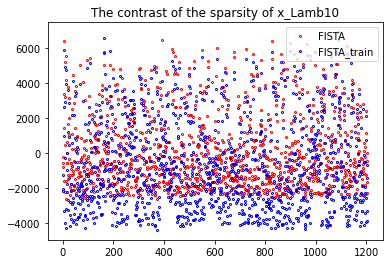

204
done 1 layers in 75.13ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[31029.50814495]


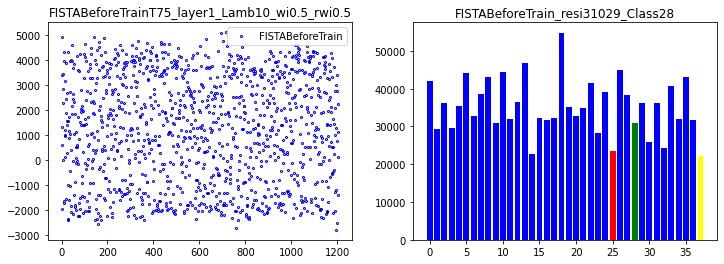

correct rate: 0.8125
correct rate: 0.6875
correct rate: 0.40625
correct rate: 0.5625
Epoch [ 10/100]: loss = 958544479.5682,   lambda [max:10.0628], [min:9.9727], 
Epoch [ 20/100]: loss = 767374189.2501,   lambda [max:10.1024], [min:9.9707], 
Epoch [ 30/100]: loss = 620069454.7106,   lambda [max:10.1340], [min:9.9696], 
Epoch [ 40/100]: loss = 730254276.6479,   lambda [max:10.1617], [min:9.9679], 
Epoch [ 50/100]: loss = 526642488.6130,   lambda [max:10.1868], [min:9.9665], 
Epoch [ 60/100]: loss = 479395969.8570,   lambda [max:10.2098], [min:9.9653], 
Epoch [ 70/100]: loss = 445793376.6406,   lambda [max:10.2313], [min:9.9646], 
Epoch [ 80/100]: loss = 459162790.3241,   lambda [max:10.2516], [min:9.9639], 
Epoch [ 90/100]: loss = 445779655.4476,   lambda [max:10.2708], [min:9.9633], 
correct rate: 0.125
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.0625
Epoch [100/100]: loss = 496756771.3316,   lambda [max:10.2891], [min:9.9626], 


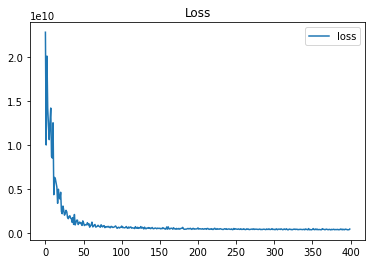

done 1 layers in 74.31ms
predict class: yaleB05
test image label: yaleB27
predict residuals label: 4
test residuals label: 25
[39338.42213809]


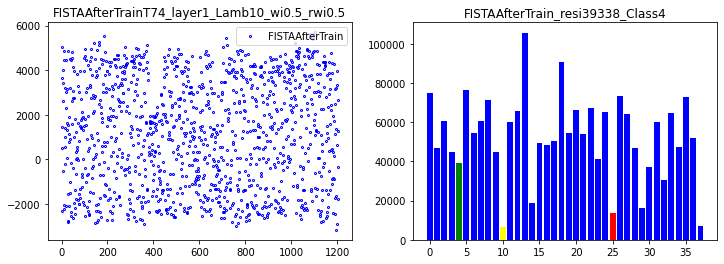

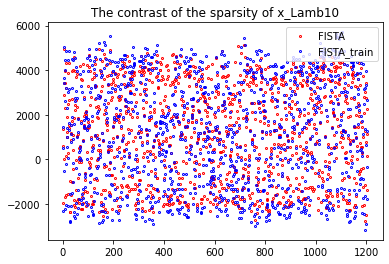

205
done 1 layers in 80.25ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[117197.18619119]


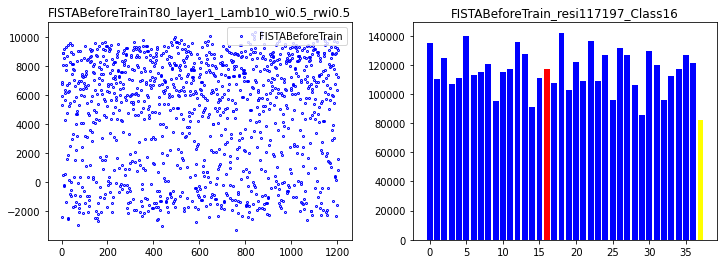

correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.5
Epoch [ 10/100]: loss = 1316059017.3497,   lambda [max:10.0632], [min:9.9712], 
Epoch [ 20/100]: loss = 683330374.6258,   lambda [max:10.1035], [min:9.9732], 
Epoch [ 30/100]: loss = 647740010.0130,   lambda [max:10.1358], [min:9.9709], 
Epoch [ 40/100]: loss = 511432477.8625,   lambda [max:10.1641], [min:9.9689], 
Epoch [ 50/100]: loss = 488015581.2447,   lambda [max:10.1896], [min:9.9684], 
Epoch [ 60/100]: loss = 490888734.3157,   lambda [max:10.2131], [min:9.9668], 
Epoch [ 70/100]: loss = 448342921.4046,   lambda [max:10.2349], [min:9.9665], 
Epoch [ 80/100]: loss = 402605979.4307,   lambda [max:10.2555], [min:9.9661], 
Epoch [ 90/100]: loss = 412967183.0816,   lambda [max:10.2749], [min:9.9657], 
correct rate: 0.0
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 462201741.2578,   lambda [max:10.2935], [min:9.9655], 


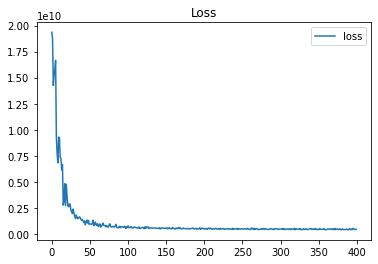

done 1 layers in 82.35ms
predict class: yaleB39
test image label: yaleB18
predict residuals label: 37
test residuals label: 16
[5793.0314359]


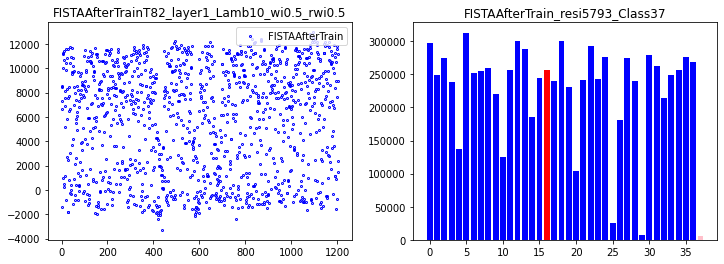

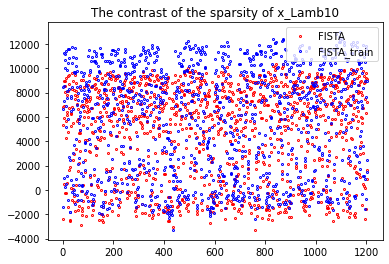

206
done 1 layers in 76.62ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[207823.02013693]


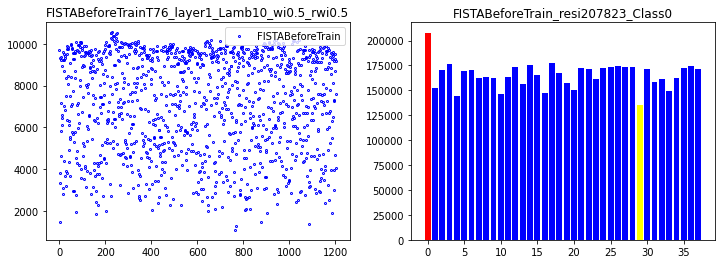

correct rate: 0.65625
correct rate: 0.625
correct rate: 0.71875
correct rate: 0.53125
Epoch [ 10/100]: loss = 1032646706.6080,   lambda [max:10.0629], [min:9.9700], 
Epoch [ 20/100]: loss = 614527570.6314,   lambda [max:10.1029], [min:9.9717], 
Epoch [ 30/100]: loss = 611596603.9522,   lambda [max:10.1349], [min:9.9718], 
Epoch [ 40/100]: loss = 652520084.8923,   lambda [max:10.1629], [min:9.9716], 
Epoch [ 50/100]: loss = 562122622.5000,   lambda [max:10.1881], [min:9.9717], 
Epoch [ 60/100]: loss = 465457316.0826,   lambda [max:10.2113], [min:9.9711], 
Epoch [ 70/100]: loss = 459327660.4755,   lambda [max:10.2329], [min:9.9708], 
Epoch [ 80/100]: loss = 481993913.0911,   lambda [max:10.2532], [min:9.9710], 
Epoch [ 90/100]: loss = 463912734.7023,   lambda [max:10.2725], [min:9.9716], 
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.09375
correct rate: 0.0
Epoch [100/100]: loss = 441810663.1146,   lambda [max:10.2907], [min:9.9711], 


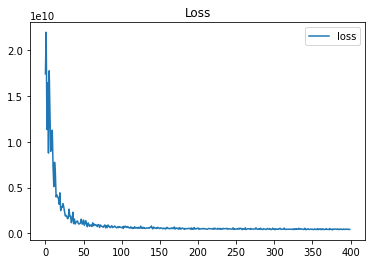

done 1 layers in 77.60ms
predict class: yaleB31
test image label: yaleB01
predict residuals label: 29
test residuals label: 0
[7459.69652487]


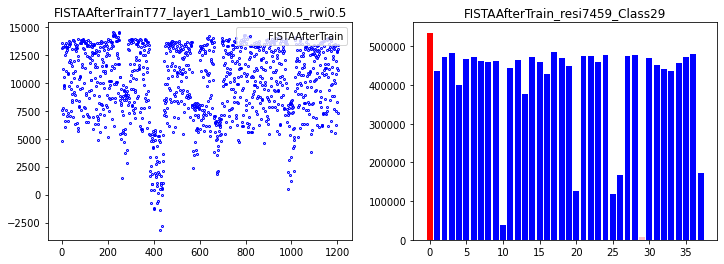

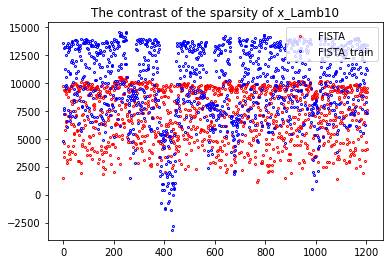

207
done 1 layers in 75.87ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[144025.54102348]


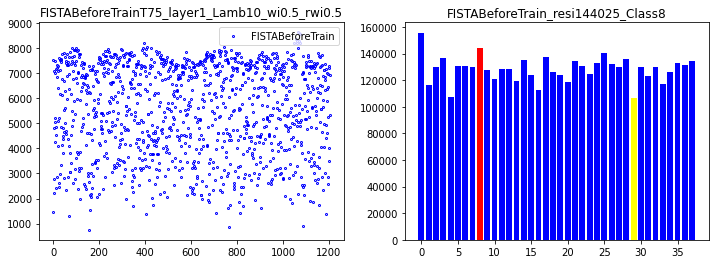

correct rate: 0.65625
correct rate: 0.625
correct rate: 0.46875
correct rate: 0.71875
Epoch [ 10/100]: loss = 1695079218.3605,   lambda [max:10.0630], [min:9.9686], 
Epoch [ 20/100]: loss = 833123920.1270,   lambda [max:10.1032], [min:9.9711], 
Epoch [ 30/100]: loss = 710220984.3600,   lambda [max:10.1355], [min:9.9716], 
Epoch [ 40/100]: loss = 472132288.3822,   lambda [max:10.1637], [min:9.9715], 
Epoch [ 50/100]: loss = 476495286.3870,   lambda [max:10.1891], [min:9.9704], 
Epoch [ 60/100]: loss = 430219804.4155,   lambda [max:10.2125], [min:9.9707], 
Epoch [ 70/100]: loss = 548548824.4919,   lambda [max:10.2344], [min:9.9702], 
Epoch [ 80/100]: loss = 425972591.9737,   lambda [max:10.2549], [min:9.9703], 
Epoch [ 90/100]: loss = 495151434.9804,   lambda [max:10.2744], [min:9.9701], 
correct rate: 0.03125
correct rate: 0.0
correct rate: 0.125
correct rate: 0.03125
Epoch [100/100]: loss = 425033810.2189,   lambda [max:10.2928], [min:9.9704], 


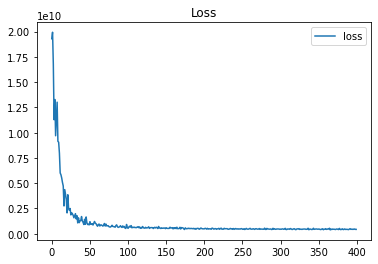

done 1 layers in 76.95ms
predict class: yaleB11
test image label: yaleB09
predict residuals label: 10
test residuals label: 8
[5155.13507527]


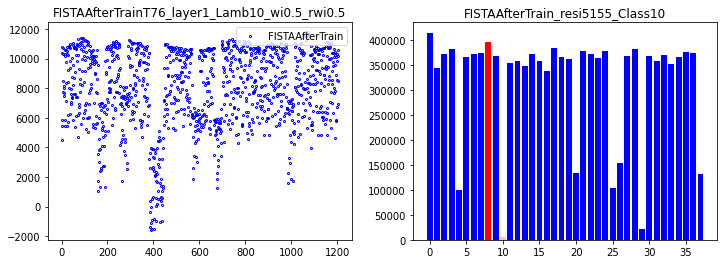

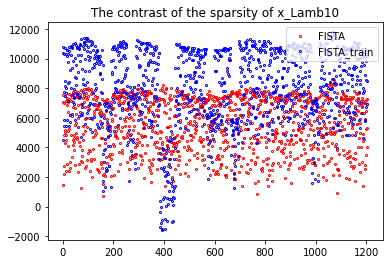

208
done 1 layers in 77.28ms
predict class: yaleB30
test image label: yaleB11
predict residuals label: 28
test residuals label: 10
[140785.74771459]


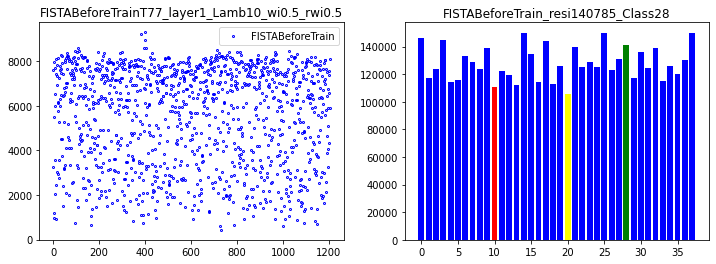

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.625
Epoch [ 10/100]: loss = 1342477247.0024,   lambda [max:10.0629], [min:9.9702], 
Epoch [ 20/100]: loss = 704891797.3310,   lambda [max:10.1029], [min:9.9721], 
Epoch [ 30/100]: loss = 738033373.2773,   lambda [max:10.1349], [min:9.9702], 
Epoch [ 40/100]: loss = 499275160.1258,   lambda [max:10.1630], [min:9.9691], 
Epoch [ 50/100]: loss = 535447255.7723,   lambda [max:10.1882], [min:9.9675], 
Epoch [ 60/100]: loss = 550332636.9914,   lambda [max:10.2115], [min:9.9661], 
Epoch [ 70/100]: loss = 542103451.5790,   lambda [max:10.2331], [min:9.9650], 
Epoch [ 80/100]: loss = 445005835.3117,   lambda [max:10.2535], [min:9.9639], 
Epoch [ 90/100]: loss = 443877555.0817,   lambda [max:10.2728], [min:9.9637], 
correct rate: 0.0
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.0625
Epoch [100/100]: loss = 446265345.0652,   lambda [max:10.2911], [min:9.9629], 


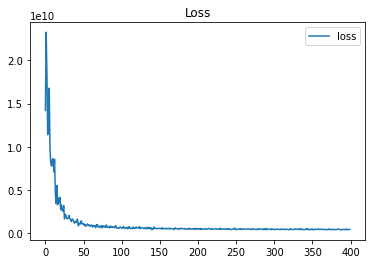

done 1 layers in 77.37ms
predict class: yaleB31
test image label: yaleB11
predict residuals label: 29
test residuals label: 10
[7846.48104273]


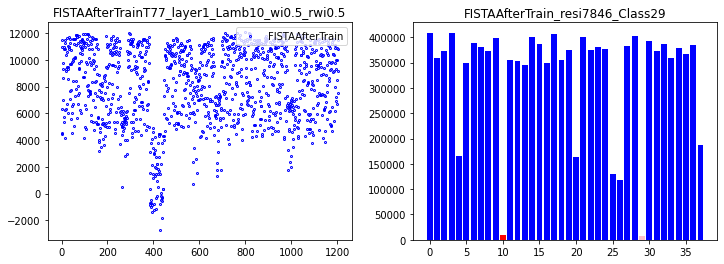

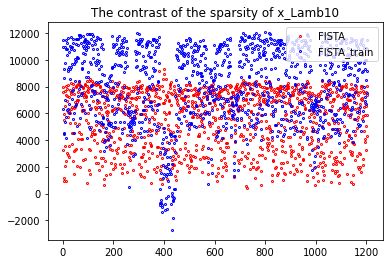

209
done 1 layers in 78.43ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[56893.779385]


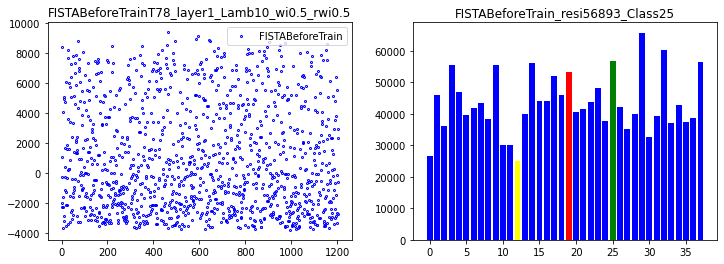

correct rate: 0.625
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.65625
Epoch [ 10/100]: loss = 1236498095.0625,   lambda [max:10.0630], [min:9.9681], 
Epoch [ 20/100]: loss = 699249114.6795,   lambda [max:10.1030], [min:9.9696], 
Epoch [ 30/100]: loss = 786762992.4490,   lambda [max:10.1351], [min:9.9696], 
Epoch [ 40/100]: loss = 498012254.3894,   lambda [max:10.1631], [min:9.9700], 
Epoch [ 50/100]: loss = 446331219.9281,   lambda [max:10.1885], [min:9.9686], 
Epoch [ 60/100]: loss = 438433999.9643,   lambda [max:10.2118], [min:9.9685], 
Epoch [ 70/100]: loss = 441552553.6471,   lambda [max:10.2336], [min:9.9688], 
Epoch [ 80/100]: loss = 458104731.2759,   lambda [max:10.2540], [min:9.9684], 
Epoch [ 90/100]: loss = 433742165.0747,   lambda [max:10.2734], [min:9.9684], 
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.125
Epoch [100/100]: loss = 429399507.0592,   lambda [max:10.2919], [min:9.9685], 


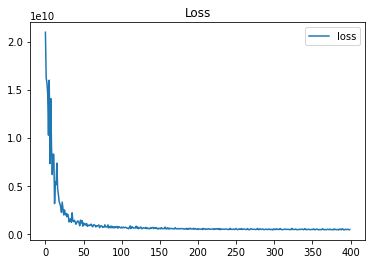

done 1 layers in 83.08ms
predict class: yaleB31
test image label: yaleB21
predict residuals label: 29
test residuals label: 19
[45142.99600957]


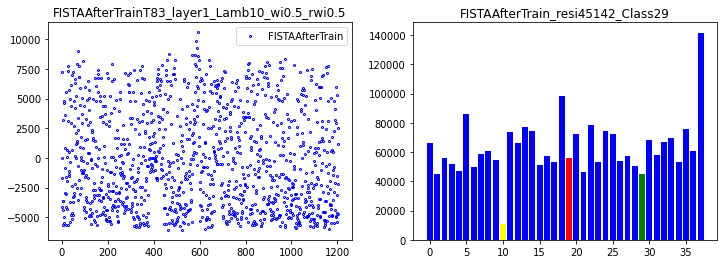

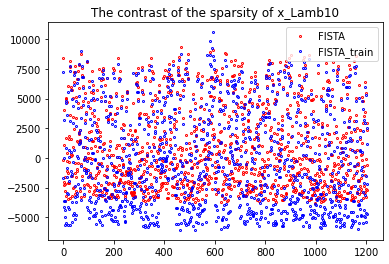

210
done 10 layers in 90.48ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[13940.52443046]


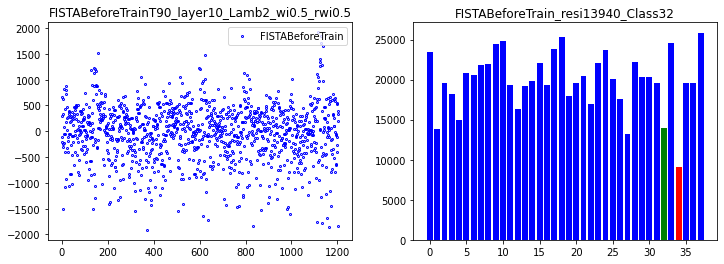

correct rate: 0.53125
correct rate: 0.71875
correct rate: 0.625
correct rate: 0.53125
Epoch [ 10/100]: loss = 47132203.3741,   lambda [max:2.0482], [min:1.9635], 
Epoch [ 20/100]: loss = 33322823.6239,   lambda [max:2.0632], [min:1.9509], 
Epoch [ 30/100]: loss = 19199061.2729,   lambda [max:2.0692], [min:1.9376], 
Epoch [ 40/100]: loss = 13703254.5769,   lambda [max:2.0730], [min:1.9283], 
Epoch [ 50/100]: loss = 12427428.4147,   lambda [max:2.0747], [min:1.9208], 
Epoch [ 60/100]: loss = 11153435.0655,   lambda [max:2.0770], [min:1.9151], 
Epoch [ 70/100]: loss = 9105003.5941,   lambda [max:2.0823], [min:1.9099], 
Epoch [ 80/100]: loss = 8374855.1504,   lambda [max:2.0876], [min:1.9056], 
Epoch [ 90/100]: loss = 8217332.4180,   lambda [max:2.0941], [min:1.9019], 
correct rate: 0.625
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.65625
Epoch [100/100]: loss = 7371332.5953,   lambda [max:2.1033], [min:1.8986], 


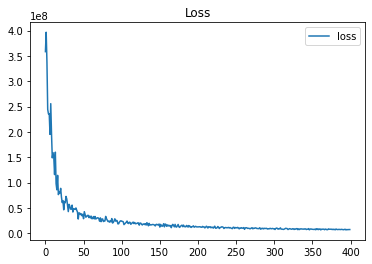

done 10 layers in 89.81ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[1096.6329224]


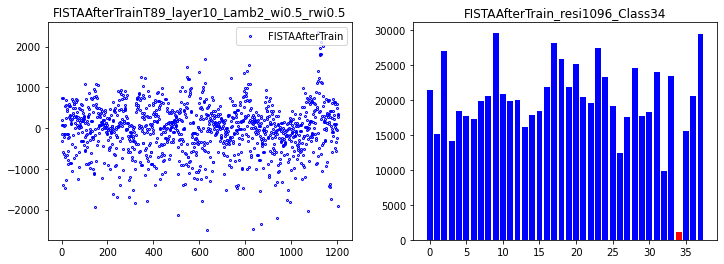

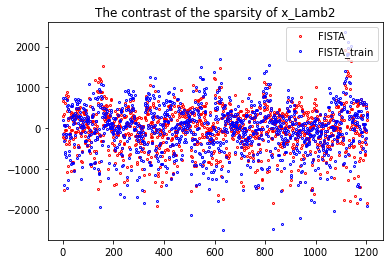

211
done 10 layers in 88.46ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[8822.25222553]


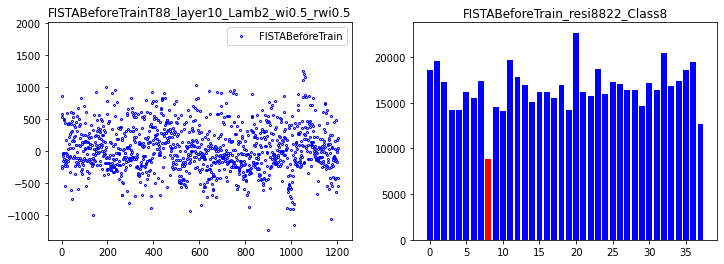

correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.71875
Epoch [ 10/100]: loss = 46740067.9768,   lambda [max:2.0479], [min:1.9610], 
Epoch [ 20/100]: loss = 25325429.8939,   lambda [max:2.0627], [min:1.9502], 
Epoch [ 30/100]: loss = 19925044.3438,   lambda [max:2.0669], [min:1.9365], 
Epoch [ 40/100]: loss = 14751420.4732,   lambda [max:2.0778], [min:1.9248], 
Epoch [ 50/100]: loss = 11835087.0669,   lambda [max:2.0880], [min:1.9152], 
Epoch [ 60/100]: loss = 8184972.4398,   lambda [max:2.0952], [min:1.9078], 
Epoch [ 70/100]: loss = 9565326.8183,   lambda [max:2.1001], [min:1.9014], 
Epoch [ 80/100]: loss = 7427765.4724,   lambda [max:2.1052], [min:1.8962], 
Epoch [ 90/100]: loss = 7923220.9834,   lambda [max:2.1094], [min:1.8921], 
correct rate: 0.78125
correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.59375
Epoch [100/100]: loss = 7121307.0319,   lambda [max:2.1142], [min:1.8879], 


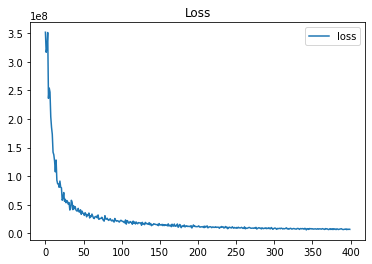

done 10 layers in 87.73ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1552.69436018]


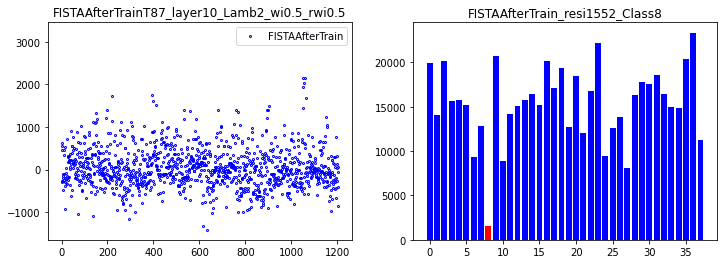

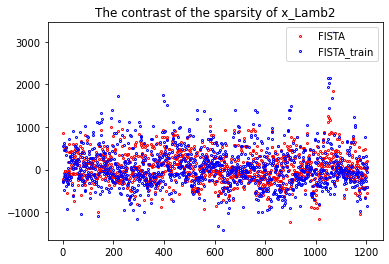

212
done 10 layers in 91.52ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6060.17098924]


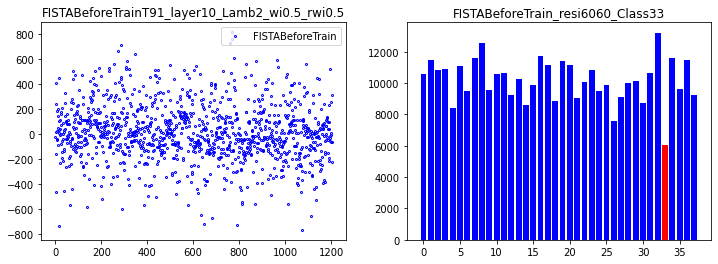

correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.5625
Epoch [ 10/100]: loss = 48530146.3695,   lambda [max:2.0501], [min:1.9625], 
Epoch [ 20/100]: loss = 21997042.6726,   lambda [max:2.0627], [min:1.9489], 
Epoch [ 30/100]: loss = 18407814.7782,   lambda [max:2.0662], [min:1.9355], 
Epoch [ 40/100]: loss = 16241217.9457,   lambda [max:2.0692], [min:1.9266], 
Epoch [ 50/100]: loss = 12014243.3383,   lambda [max:2.0711], [min:1.9192], 
Epoch [ 60/100]: loss = 9674243.1892,   lambda [max:2.0772], [min:1.9134], 
Epoch [ 70/100]: loss = 9642355.8216,   lambda [max:2.0866], [min:1.9084], 
Epoch [ 80/100]: loss = 8123420.9810,   lambda [max:2.0958], [min:1.9042], 
Epoch [ 90/100]: loss = 7785840.3753,   lambda [max:2.1050], [min:1.9007], 
correct rate: 0.625
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.6875
Epoch [100/100]: loss = 7889788.5751,   lambda [max:2.1140], [min:1.8976], 


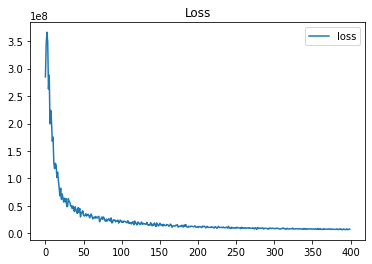

done 10 layers in 88.01ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[1158.39886783]


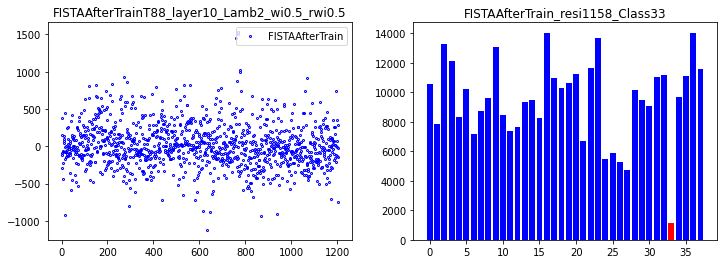

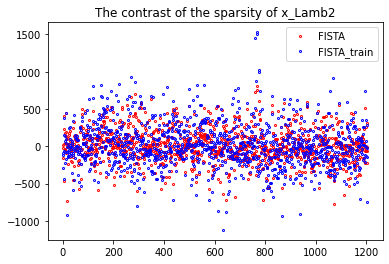

213
done 10 layers in 87.90ms
predict class: yaleB31
test image label: yaleB19
predict residuals label: 29
test residuals label: 17
[7793.78350232]


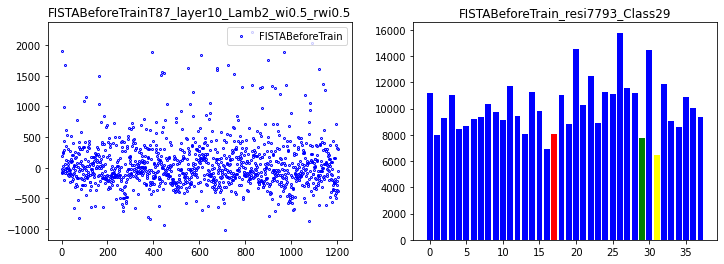

correct rate: 0.5625
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.65625
Epoch [ 10/100]: loss = 48305284.5284,   lambda [max:2.0472], [min:1.9631], 
Epoch [ 20/100]: loss = 26564025.1801,   lambda [max:2.0680], [min:1.9448], 
Epoch [ 30/100]: loss = 19403774.9350,   lambda [max:2.0730], [min:1.9333], 
Epoch [ 40/100]: loss = 15046665.3787,   lambda [max:2.0767], [min:1.9237], 
Epoch [ 50/100]: loss = 12391497.5663,   lambda [max:2.0794], [min:1.9161], 
Epoch [ 60/100]: loss = 11708512.7880,   lambda [max:2.0818], [min:1.9094], 
Epoch [ 70/100]: loss = 10909110.8382,   lambda [max:2.0840], [min:1.9039], 
Epoch [ 80/100]: loss = 10093890.6004,   lambda [max:2.0880], [min:1.8993], 
Epoch [ 90/100]: loss = 7785363.3499,   lambda [max:2.0972], [min:1.8952], 
correct rate: 0.625
correct rate: 0.75
correct rate: 0.75
correct rate: 0.46875
Epoch [100/100]: loss = 6876730.0596,   lambda [max:2.1065], [min:1.8916], 


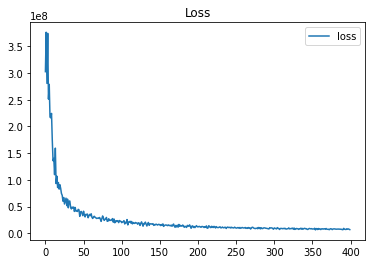

done 10 layers in 88.15ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[2062.58621292]


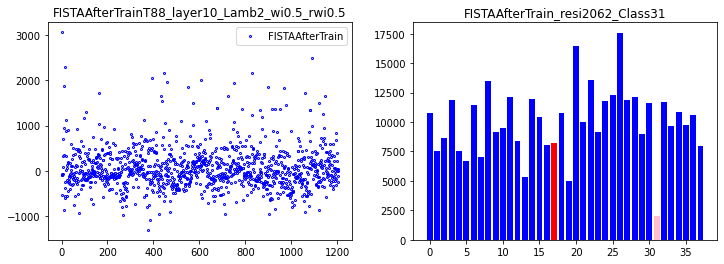

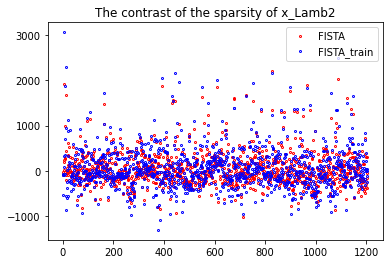

214
done 10 layers in 86.55ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[7972.95029419]


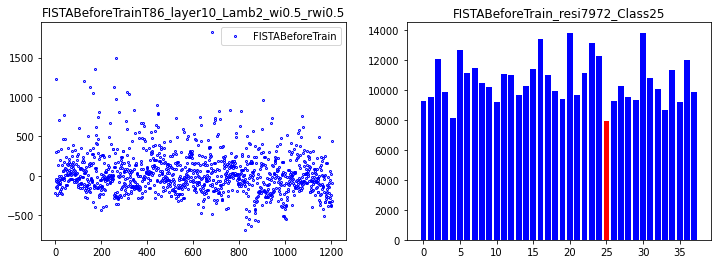

correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.46875
correct rate: 0.75
Epoch [ 10/100]: loss = 47565265.4016,   lambda [max:2.0481], [min:1.9616], 
Epoch [ 20/100]: loss = 24984178.4103,   lambda [max:2.0646], [min:1.9446], 
Epoch [ 30/100]: loss = 18472699.2942,   lambda [max:2.0690], [min:1.9303], 
Epoch [ 40/100]: loss = 14081122.6628,   lambda [max:2.0721], [min:1.9207], 
Epoch [ 50/100]: loss = 12118634.3037,   lambda [max:2.0748], [min:1.9132], 
Epoch [ 60/100]: loss = 9591565.0840,   lambda [max:2.0787], [min:1.9073], 
Epoch [ 70/100]: loss = 9455127.0214,   lambda [max:2.0828], [min:1.9026], 
Epoch [ 80/100]: loss = 8524715.4926,   lambda [max:2.0892], [min:1.8982], 
Epoch [ 90/100]: loss = 7284877.3686,   lambda [max:2.0978], [min:1.8941], 
correct rate: 0.59375
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.71875
Epoch [100/100]: loss = 6485308.9193,   lambda [max:2.1068], [min:1.8916], 


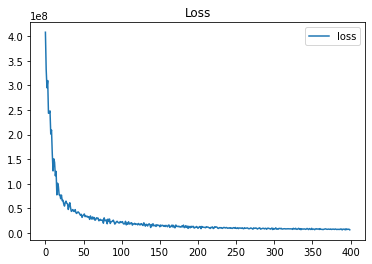

done 10 layers in 85.28ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[896.66285997]


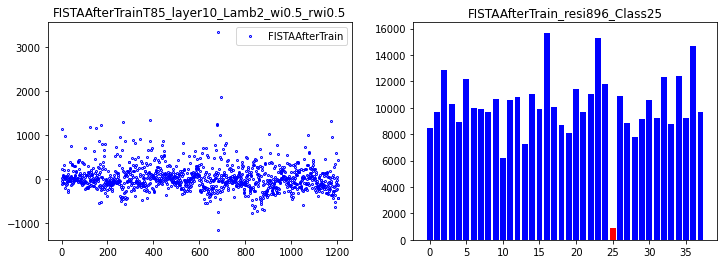

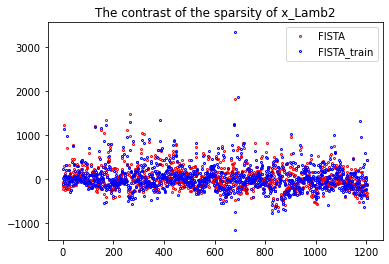

215
done 10 layers in 85.95ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[10511.60811205]


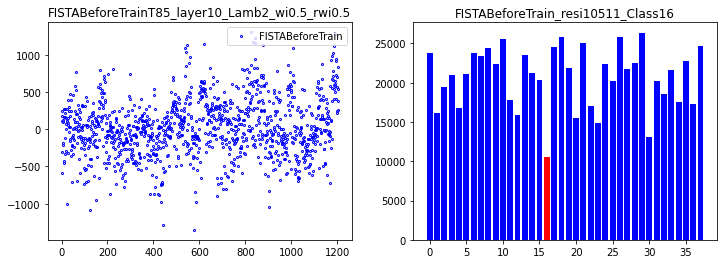

correct rate: 0.5
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.71875
Epoch [ 10/100]: loss = 41855066.9223,   lambda [max:2.0482], [min:1.9654], 
Epoch [ 20/100]: loss = 27138030.0813,   lambda [max:2.0693], [min:1.9497], 
Epoch [ 30/100]: loss = 18692970.4578,   lambda [max:2.0743], [min:1.9358], 
Epoch [ 40/100]: loss = 16418522.7193,   lambda [max:2.0819], [min:1.9256], 
Epoch [ 50/100]: loss = 11891982.4687,   lambda [max:2.0895], [min:1.9173], 
Epoch [ 60/100]: loss = 10847111.1572,   lambda [max:2.0957], [min:1.9102], 
Epoch [ 70/100]: loss = 9927826.2223,   lambda [max:2.1010], [min:1.9048], 
Epoch [ 80/100]: loss = 7696825.2277,   lambda [max:2.1055], [min:1.9001], 
Epoch [ 90/100]: loss = 7203105.4919,   lambda [max:2.1143], [min:1.8963], 
correct rate: 0.625
correct rate: 0.75
correct rate: 0.59375
correct rate: 0.71875
Epoch [100/100]: loss = 7968094.5009,   lambda [max:2.1255], [min:1.8929], 


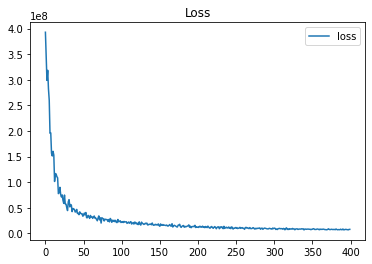

done 10 layers in 87.58ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[608.37916632]


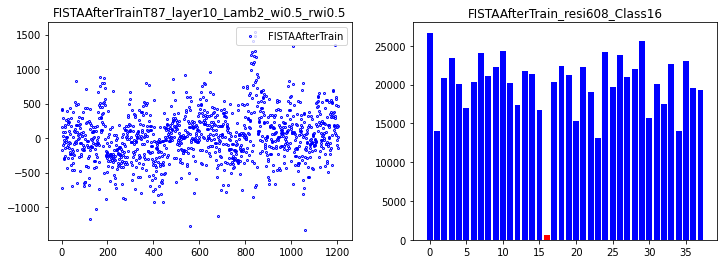

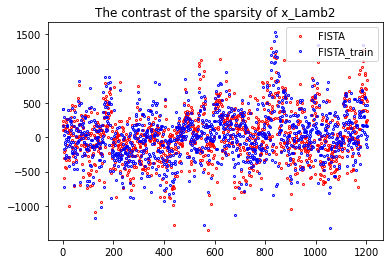

216
done 10 layers in 86.20ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[8533.40620913]


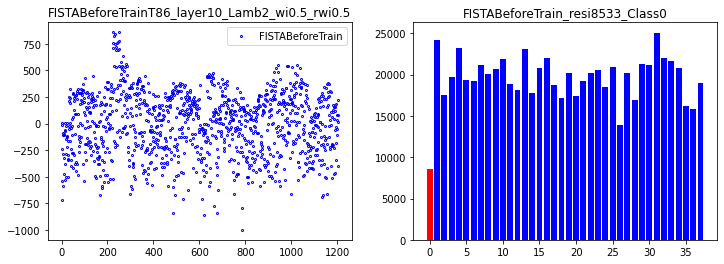

correct rate: 0.65625
correct rate: 0.5
correct rate: 0.59375
correct rate: 0.75
Epoch [ 10/100]: loss = 41340749.0655,   lambda [max:2.0499], [min:1.9606], 
Epoch [ 20/100]: loss = 28003108.7691,   lambda [max:2.0651], [min:1.9498], 
Epoch [ 30/100]: loss = 18859409.1153,   lambda [max:2.0693], [min:1.9396], 
Epoch [ 40/100]: loss = 13182148.2903,   lambda [max:2.0719], [min:1.9314], 
Epoch [ 50/100]: loss = 13393458.4332,   lambda [max:2.0775], [min:1.9245], 
Epoch [ 60/100]: loss = 11788403.2913,   lambda [max:2.0874], [min:1.9191], 
Epoch [ 70/100]: loss = 10393864.3259,   lambda [max:2.0970], [min:1.9140], 
Epoch [ 80/100]: loss = 8836662.2386,   lambda [max:2.1070], [min:1.9096], 
Epoch [ 90/100]: loss = 9336937.9888,   lambda [max:2.1168], [min:1.9057], 
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.78125
correct rate: 0.53125
Epoch [100/100]: loss = 8408742.2512,   lambda [max:2.1265], [min:1.9024], 


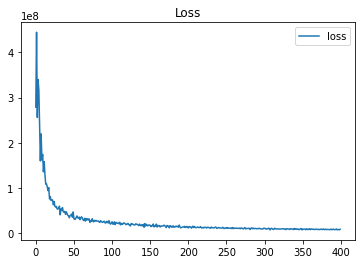

done 10 layers in 97.87ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[940.40579509]


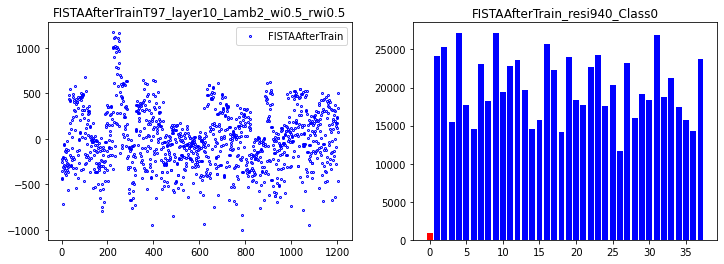

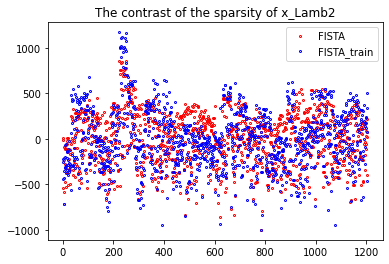

217
done 10 layers in 88.12ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2517.91581253]


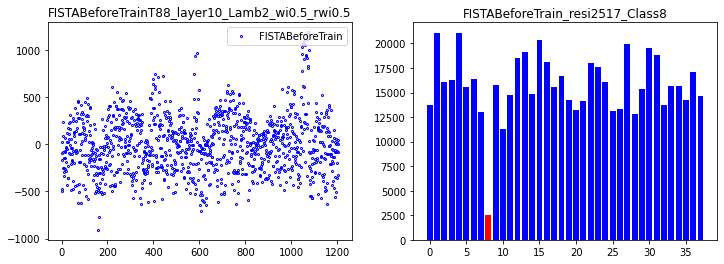

correct rate: 0.5625
correct rate: 0.5625
correct rate: 0.53125
correct rate: 0.71875
Epoch [ 10/100]: loss = 40373040.3327,   lambda [max:2.0522], [min:1.9623], 
Epoch [ 20/100]: loss = 22163889.3628,   lambda [max:2.0649], [min:1.9452], 
Epoch [ 30/100]: loss = 18625303.7186,   lambda [max:2.0657], [min:1.9382], 
Epoch [ 40/100]: loss = 15089265.4678,   lambda [max:2.0757], [min:1.9292], 
Epoch [ 50/100]: loss = 13567710.2593,   lambda [max:2.0853], [min:1.9221], 
Epoch [ 60/100]: loss = 9687028.5590,   lambda [max:2.0920], [min:1.9160], 
Epoch [ 70/100]: loss = 9941826.9970,   lambda [max:2.0969], [min:1.9114], 
Epoch [ 80/100]: loss = 7760086.7820,   lambda [max:2.1017], [min:1.9074], 
Epoch [ 90/100]: loss = 7746817.0595,   lambda [max:2.1083], [min:1.9040], 
correct rate: 0.6875
correct rate: 0.53125
correct rate: 0.625
correct rate: 0.65625
Epoch [100/100]: loss = 7564280.9693,   lambda [max:2.1172], [min:1.9006], 


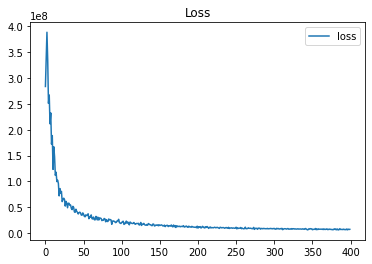

done 10 layers in 95.50ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1636.5739737]


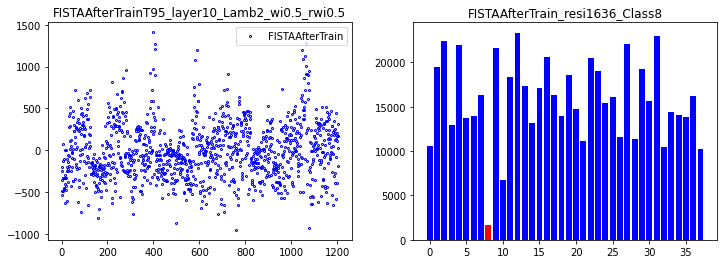

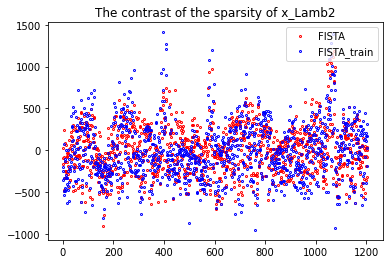

218
done 10 layers in 89.52ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[9766.92064843]


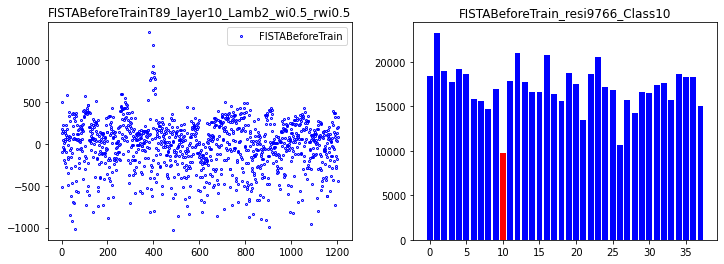

correct rate: 0.5625
correct rate: 0.625
correct rate: 0.71875
correct rate: 0.59375
Epoch [ 10/100]: loss = 48841299.5590,   lambda [max:2.0494], [min:1.9665], 
Epoch [ 20/100]: loss = 26008636.5569,   lambda [max:2.0617], [min:1.9449], 
Epoch [ 30/100]: loss = 16060127.4414,   lambda [max:2.0631], [min:1.9332], 
Epoch [ 40/100]: loss = 14490944.2253,   lambda [max:2.0656], [min:1.9244], 
Epoch [ 50/100]: loss = 12109320.3524,   lambda [max:2.0716], [min:1.9174], 
Epoch [ 60/100]: loss = 9325391.1097,   lambda [max:2.0768], [min:1.9116], 
Epoch [ 70/100]: loss = 9922998.4853,   lambda [max:2.0818], [min:1.9069], 
Epoch [ 80/100]: loss = 7943509.1013,   lambda [max:2.0871], [min:1.9026], 
Epoch [ 90/100]: loss = 7772907.5677,   lambda [max:2.0918], [min:1.8991], 
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.78125
correct rate: 0.625
Epoch [100/100]: loss = 8051236.0119,   lambda [max:2.0962], [min:1.8960], 


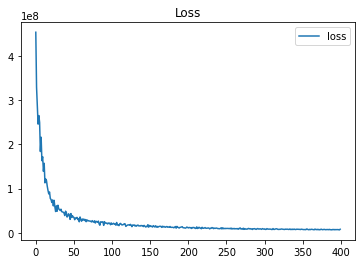

done 10 layers in 88.80ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1415.12031374]


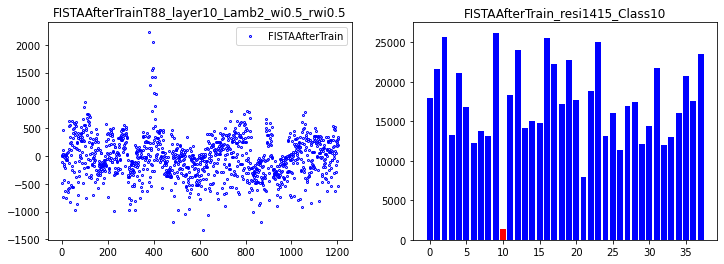

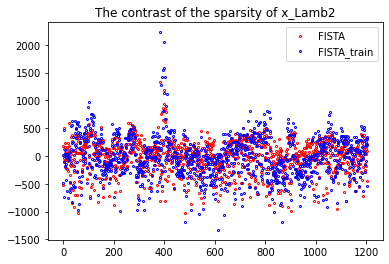

219
done 10 layers in 89.50ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[9010.09097018]


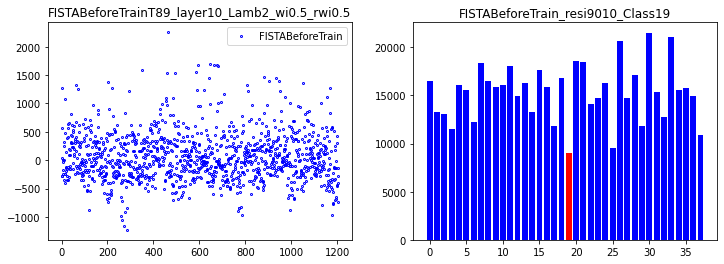

correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.5
correct rate: 0.75
Epoch [ 10/100]: loss = 45283117.3565,   lambda [max:2.0514], [min:1.9650], 
Epoch [ 20/100]: loss = 23606773.3310,   lambda [max:2.0641], [min:1.9409], 
Epoch [ 30/100]: loss = 19172754.1277,   lambda [max:2.0685], [min:1.9286], 
Epoch [ 40/100]: loss = 15500162.9604,   lambda [max:2.0712], [min:1.9201], 
Epoch [ 50/100]: loss = 11878149.9329,   lambda [max:2.0753], [min:1.9131], 
Epoch [ 60/100]: loss = 11023633.4042,   lambda [max:2.0819], [min:1.9076], 
Epoch [ 70/100]: loss = 9660283.1675,   lambda [max:2.0891], [min:1.9033], 
Epoch [ 80/100]: loss = 8276244.7279,   lambda [max:2.0980], [min:1.8992], 
Epoch [ 90/100]: loss = 7902165.5500,   lambda [max:2.1068], [min:1.8962], 
correct rate: 0.65625
correct rate: 0.75
correct rate: 0.625
correct rate: 0.59375
Epoch [100/100]: loss = 7190453.5583,   lambda [max:2.1157], [min:1.8932], 


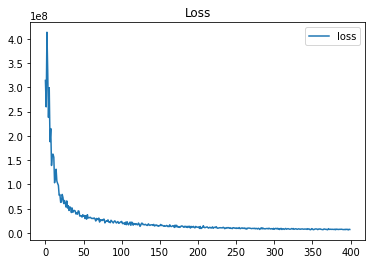

done 10 layers in 88.40ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[2614.73221902]


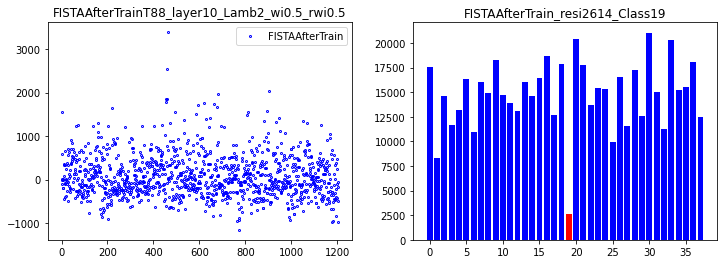

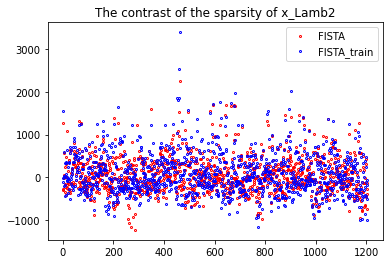

220
done 5 layers in 81.52ms
predict class: yaleB05
test image label: yaleB36
predict residuals label: 4
test residuals label: 34
[16737.76588462]


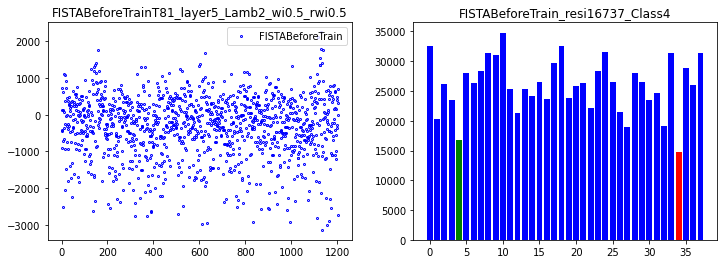

correct rate: 0.46875
correct rate: 0.53125
correct rate: 0.375
correct rate: 0.3125
Epoch [ 10/100]: loss = 54222566.3208,   lambda [max:2.0455], [min:1.9711], 
Epoch [ 20/100]: loss = 36001533.5217,   lambda [max:2.0520], [min:1.9575], 
Epoch [ 30/100]: loss = 28812668.3195,   lambda [max:2.0714], [min:1.9497], 
Epoch [ 40/100]: loss = 21235841.9785,   lambda [max:2.0914], [min:1.9427], 
Epoch [ 50/100]: loss = 21306895.3735,   lambda [max:2.1107], [min:1.9380], 
Epoch [ 60/100]: loss = 17066563.4171,   lambda [max:2.1290], [min:1.9340], 
Epoch [ 70/100]: loss = 14508239.5403,   lambda [max:2.1469], [min:1.9320], 
Epoch [ 80/100]: loss = 16179938.4046,   lambda [max:2.1643], [min:1.9296], 
Epoch [ 90/100]: loss = 14025987.5344,   lambda [max:2.1811], [min:1.9273], 
correct rate: 0.34375
correct rate: 0.1875
correct rate: 0.34375
correct rate: 0.28125
Epoch [100/100]: loss = 13092905.0174,   lambda [max:2.1980], [min:1.9257], 


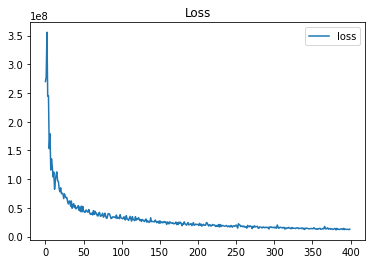

done 5 layers in 81.72ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[1914.56232704]


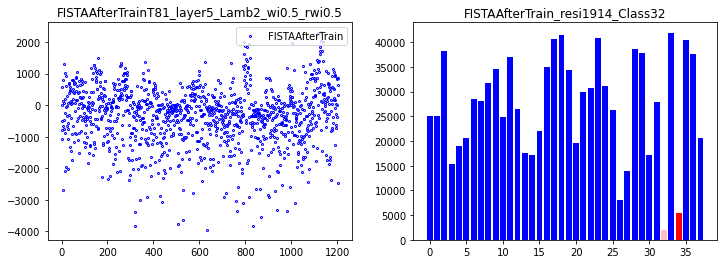

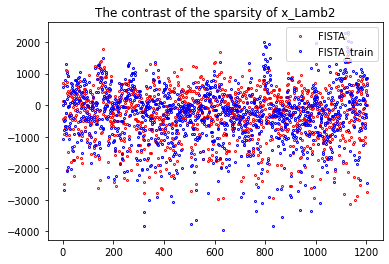

221
done 5 layers in 84.25ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[4445.81433131]


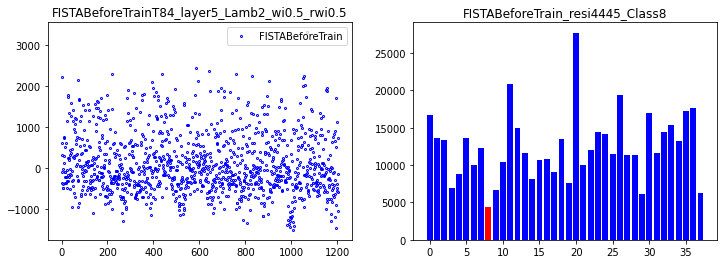

correct rate: 0.4375
correct rate: 0.46875
correct rate: 0.3125
correct rate: 0.40625
Epoch [ 10/100]: loss = 47455438.8721,   lambda [max:2.0388], [min:1.9736], 
Epoch [ 20/100]: loss = 35511666.6090,   lambda [max:2.0588], [min:1.9584], 
Epoch [ 30/100]: loss = 33834777.1490,   lambda [max:2.0855], [min:1.9459], 
Epoch [ 40/100]: loss = 25398834.3228,   lambda [max:2.1100], [min:1.9372], 
Epoch [ 50/100]: loss = 22935488.9405,   lambda [max:2.1323], [min:1.9305], 
Epoch [ 60/100]: loss = 18463131.6291,   lambda [max:2.1537], [min:1.9252], 
Epoch [ 70/100]: loss = 17569787.8307,   lambda [max:2.1741], [min:1.9216], 
Epoch [ 80/100]: loss = 14481368.2382,   lambda [max:2.1937], [min:1.9182], 
Epoch [ 90/100]: loss = 14318904.2111,   lambda [max:2.2124], [min:1.9163], 
correct rate: 0.3125
correct rate: 0.34375
correct rate: 0.21875
correct rate: 0.375
Epoch [100/100]: loss = 11960276.6973,   lambda [max:2.2300], [min:1.9143], 


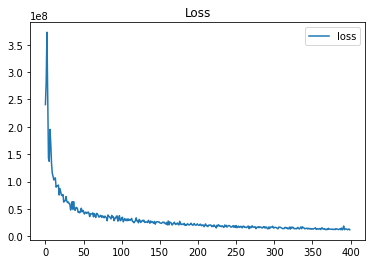

done 5 layers in 78.99ms
predict class: yaleB10
test image label: yaleB09
predict residuals label: 9
test residuals label: 8
[4680.61872105]


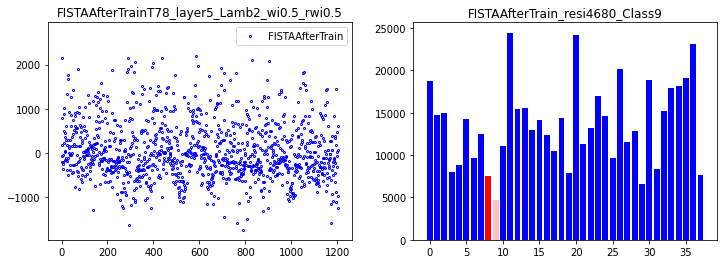

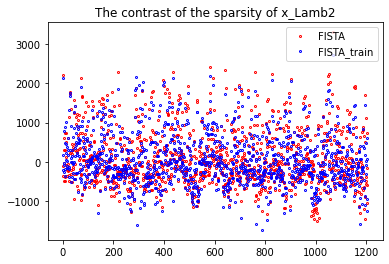

222
done 5 layers in 85.38ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4656.20968395]


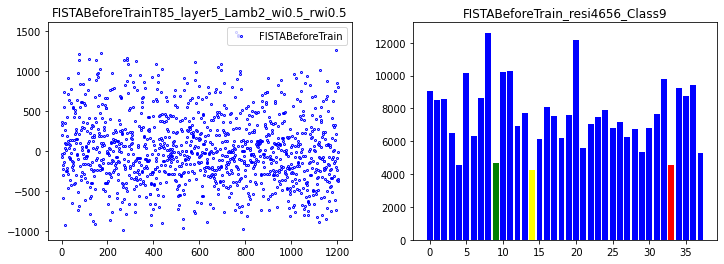

correct rate: 0.625
correct rate: 0.5
correct rate: 0.28125
correct rate: 0.34375
Epoch [ 10/100]: loss = 53949705.0473,   lambda [max:2.0413], [min:1.9652], 
Epoch [ 20/100]: loss = 35234974.0101,   lambda [max:2.0504], [min:1.9520], 
Epoch [ 30/100]: loss = 28145760.3393,   lambda [max:2.0604], [min:1.9405], 
Epoch [ 40/100]: loss = 27022692.5221,   lambda [max:2.0697], [min:1.9350], 
Epoch [ 50/100]: loss = 21984877.5296,   lambda [max:2.0880], [min:1.9320], 
Epoch [ 60/100]: loss = 18517652.9173,   lambda [max:2.1055], [min:1.9314], 
Epoch [ 70/100]: loss = 15263519.8421,   lambda [max:2.1231], [min:1.9321], 
Epoch [ 80/100]: loss = 15350684.6657,   lambda [max:2.1393], [min:1.9316], 
Epoch [ 90/100]: loss = 13759683.5666,   lambda [max:2.1557], [min:1.9317], 
correct rate: 0.1875
correct rate: 0.28125
correct rate: 0.25
correct rate: 0.40625
Epoch [100/100]: loss = 12215938.8521,   lambda [max:2.1716], [min:1.9299], 


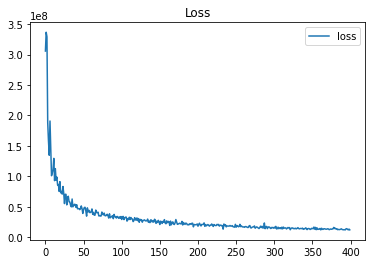

done 5 layers in 84.53ms
predict class: yaleB16
test image label: yaleB35
predict residuals label: 14
test residuals label: 33
[2967.29074213]


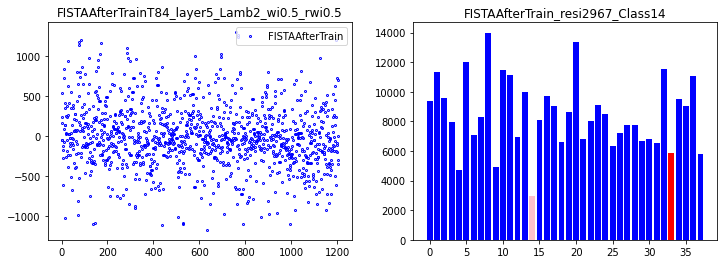

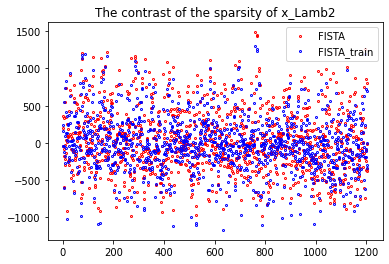

223
done 5 layers in 82.70ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[4966.87152919]


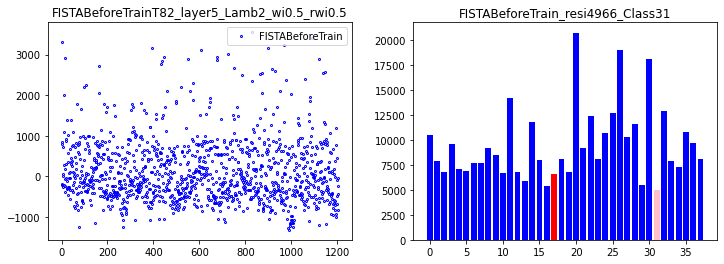

correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.46875
correct rate: 0.34375
Epoch [ 10/100]: loss = 57353543.6739,   lambda [max:2.0394], [min:1.9661], 
Epoch [ 20/100]: loss = 34681542.4345,   lambda [max:2.0556], [min:1.9564], 
Epoch [ 30/100]: loss = 27704780.7781,   lambda [max:2.0613], [min:1.9455], 
Epoch [ 40/100]: loss = 25940821.5179,   lambda [max:2.0751], [min:1.9361], 
Epoch [ 50/100]: loss = 30239674.8882,   lambda [max:2.0938], [min:1.9302], 
Epoch [ 60/100]: loss = 21191587.1654,   lambda [max:2.1117], [min:1.9241], 
Epoch [ 70/100]: loss = 16992634.0180,   lambda [max:2.1285], [min:1.9214], 
Epoch [ 80/100]: loss = 15220280.7832,   lambda [max:2.1455], [min:1.9183], 
Epoch [ 90/100]: loss = 14597788.2932,   lambda [max:2.1618], [min:1.9172], 
correct rate: 0.46875
correct rate: 0.21875
correct rate: 0.375
correct rate: 0.1875
Epoch [100/100]: loss = 18237807.7815,   lambda [max:2.1773], [min:1.9154], 


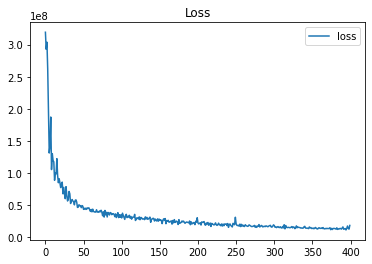

done 5 layers in 90.30ms
predict class: yaleB13
test image label: yaleB19
predict residuals label: 12
test residuals label: 17
[4256.58259385]


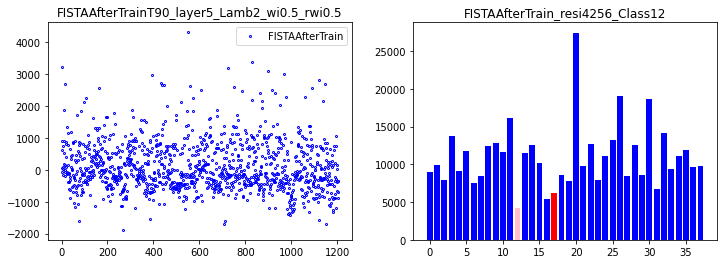

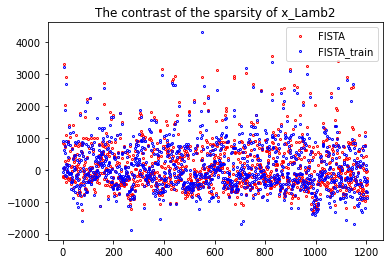

224
done 5 layers in 77.01ms
predict class: yaleB11
test image label: yaleB27
predict residuals label: 10
test residuals label: 25
[5465.60149539]


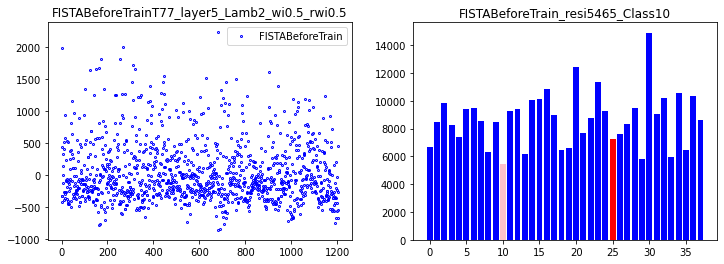

correct rate: 0.5
correct rate: 0.5625
correct rate: 0.34375
correct rate: 0.34375
Epoch [ 10/100]: loss = 54226965.6535,   lambda [max:2.0438], [min:1.9638], 
Epoch [ 20/100]: loss = 45269417.8621,   lambda [max:2.0547], [min:1.9664], 
Epoch [ 30/100]: loss = 27104816.6432,   lambda [max:2.0625], [min:1.9569], 
Epoch [ 40/100]: loss = 25063668.2241,   lambda [max:2.0739], [min:1.9504], 
Epoch [ 50/100]: loss = 21789627.1758,   lambda [max:2.0927], [min:1.9469], 
Epoch [ 60/100]: loss = 20066046.4730,   lambda [max:2.1118], [min:1.9450], 
Epoch [ 70/100]: loss = 14669947.0313,   lambda [max:2.1298], [min:1.9441], 
Epoch [ 80/100]: loss = 17546580.7454,   lambda [max:2.1477], [min:1.9445], 
Epoch [ 90/100]: loss = 14599678.7657,   lambda [max:2.1649], [min:1.9453], 
correct rate: 0.40625
correct rate: 0.34375
correct rate: 0.34375
correct rate: 0.1875
Epoch [100/100]: loss = 13672332.0330,   lambda [max:2.1813], [min:1.9456], 


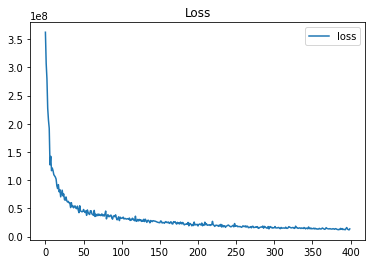

done 5 layers in 84.41ms
predict class: yaleB09
test image label: yaleB27
predict residuals label: 8
test residuals label: 25
[3259.52128894]


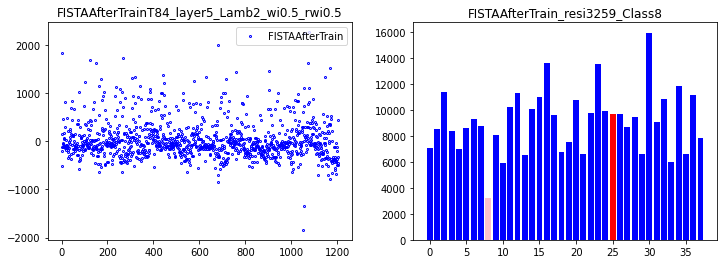

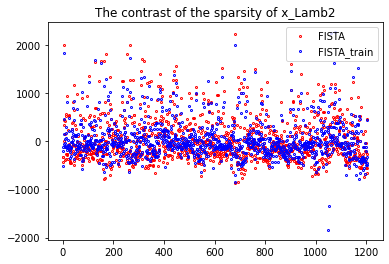

225
done 5 layers in 83.41ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[7226.74164134]


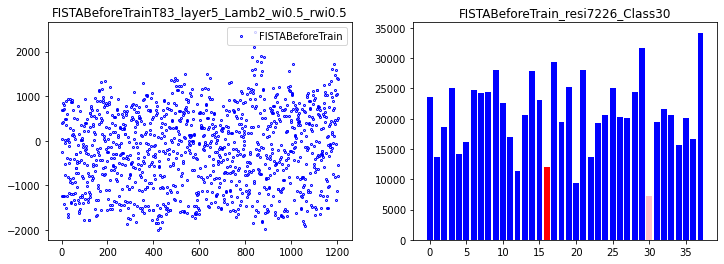

correct rate: 0.53125
correct rate: 0.3125
correct rate: 0.5
correct rate: 0.34375
Epoch [ 10/100]: loss = 46486574.2213,   lambda [max:2.0439], [min:1.9675], 
Epoch [ 20/100]: loss = 38339147.2330,   lambda [max:2.0679], [min:1.9523], 
Epoch [ 30/100]: loss = 30393146.7485,   lambda [max:2.0779], [min:1.9382], 
Epoch [ 40/100]: loss = 25009924.0767,   lambda [max:2.0945], [min:1.9312], 
Epoch [ 50/100]: loss = 23225652.5963,   lambda [max:2.1177], [min:1.9272], 
Epoch [ 60/100]: loss = 19621755.4271,   lambda [max:2.1390], [min:1.9251], 
Epoch [ 70/100]: loss = 16124741.3067,   lambda [max:2.1584], [min:1.9244], 
Epoch [ 80/100]: loss = 15604960.4402,   lambda [max:2.1773], [min:1.9246], 
Epoch [ 90/100]: loss = 15389358.9381,   lambda [max:2.1960], [min:1.9250], 
correct rate: 0.21875
correct rate: 0.3125
correct rate: 0.375
correct rate: 0.21875
Epoch [100/100]: loss = 15525690.1153,   lambda [max:2.2133], [min:1.9257], 


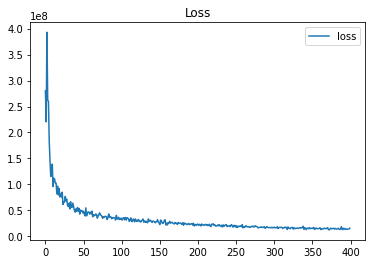

done 5 layers in 85.72ms
predict class: yaleB22
test image label: yaleB18
predict residuals label: 20
test residuals label: 16
[873.35977946]


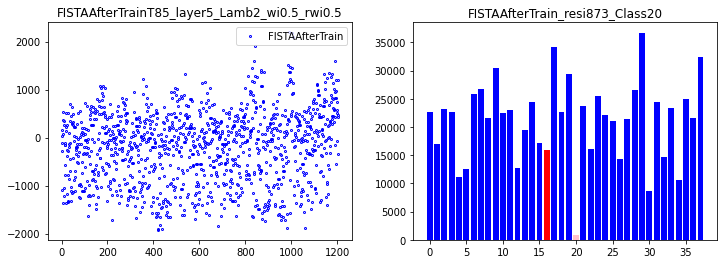

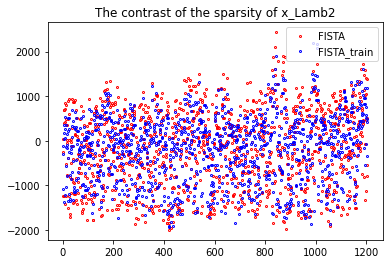

226
done 5 layers in 83.73ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[16822.41249805]


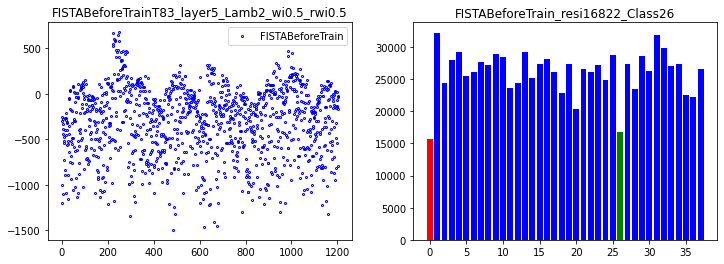

correct rate: 0.40625
correct rate: 0.375
correct rate: 0.3125
correct rate: 0.53125
Epoch [ 10/100]: loss = 53378034.5411,   lambda [max:2.0391], [min:1.9720], 
Epoch [ 20/100]: loss = 42882035.6358,   lambda [max:2.0576], [min:1.9554], 
Epoch [ 30/100]: loss = 29261374.8479,   lambda [max:2.0680], [min:1.9433], 
Epoch [ 40/100]: loss = 24569901.7713,   lambda [max:2.0871], [min:1.9348], 
Epoch [ 50/100]: loss = 21384337.4179,   lambda [max:2.1056], [min:1.9268], 
Epoch [ 60/100]: loss = 20900238.4280,   lambda [max:2.1238], [min:1.9219], 
Epoch [ 70/100]: loss = 18093664.7867,   lambda [max:2.1412], [min:1.9181], 
Epoch [ 80/100]: loss = 13775129.0424,   lambda [max:2.1584], [min:1.9173], 
Epoch [ 90/100]: loss = 13486687.6134,   lambda [max:2.1750], [min:1.9146], 
correct rate: 0.375
correct rate: 0.21875
correct rate: 0.28125
correct rate: 0.28125
Epoch [100/100]: loss = 13444647.2176,   lambda [max:2.1906], [min:1.9121], 


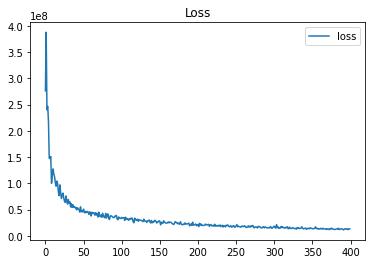

done 5 layers in 83.78ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[2446.73615591]


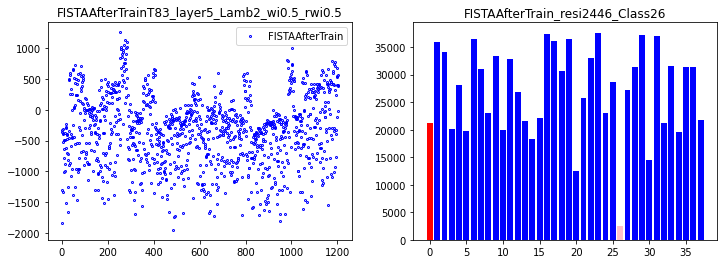

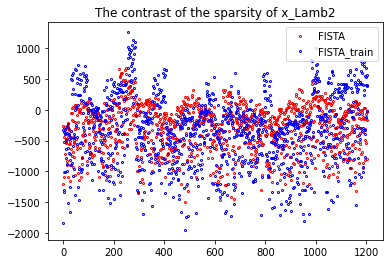

227
done 5 layers in 84.76ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[5129.07752112]


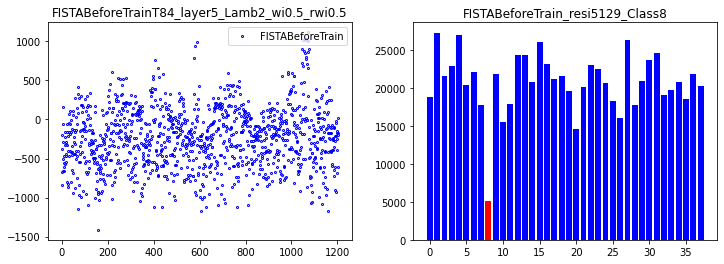

correct rate: 0.59375
correct rate: 0.4375
correct rate: 0.46875
correct rate: 0.28125
Epoch [ 10/100]: loss = 58136244.2975,   lambda [max:2.0399], [min:1.9781], 
Epoch [ 20/100]: loss = 37093445.5924,   lambda [max:2.0492], [min:1.9669], 
Epoch [ 30/100]: loss = 30730037.6261,   lambda [max:2.0685], [min:1.9649], 
Epoch [ 40/100]: loss = 25464930.7251,   lambda [max:2.0900], [min:1.9659], 
Epoch [ 50/100]: loss = 23275708.9447,   lambda [max:2.1105], [min:1.9664], 
Epoch [ 60/100]: loss = 18740692.8163,   lambda [max:2.1308], [min:1.9610], 
Epoch [ 70/100]: loss = 16804219.6734,   lambda [max:2.1506], [min:1.9602], 
Epoch [ 80/100]: loss = 12723636.9038,   lambda [max:2.1695], [min:1.9563], 
Epoch [ 90/100]: loss = 14778214.6821,   lambda [max:2.1870], [min:1.9566], 
correct rate: 0.25
correct rate: 0.25
correct rate: 0.21875
correct rate: 0.28125
Epoch [100/100]: loss = 12516301.2945,   lambda [max:2.2046], [min:1.9549], 


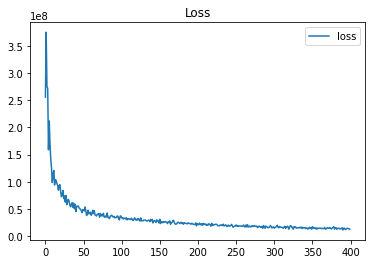

done 5 layers in 85.00ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1995.85098762]


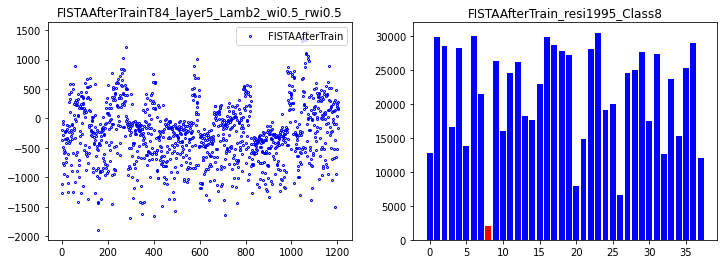

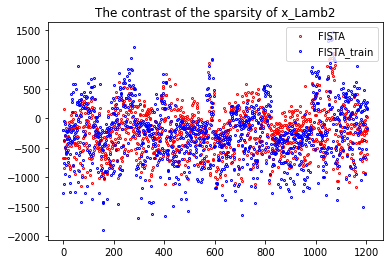

228
done 5 layers in 82.91ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[15796.94470236]


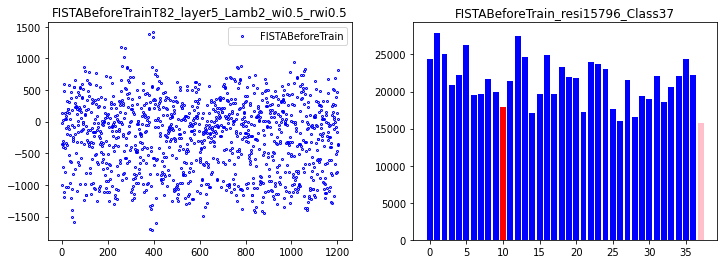

correct rate: 0.46875
correct rate: 0.40625
correct rate: 0.53125
correct rate: 0.34375
Epoch [ 10/100]: loss = 52028176.4264,   lambda [max:2.0402], [min:1.9638], 
Epoch [ 20/100]: loss = 38805972.0615,   lambda [max:2.0539], [min:1.9498], 
Epoch [ 30/100]: loss = 29610376.2148,   lambda [max:2.0619], [min:1.9391], 
Epoch [ 40/100]: loss = 24196681.9817,   lambda [max:2.0830], [min:1.9325], 
Epoch [ 50/100]: loss = 21185113.8468,   lambda [max:2.1032], [min:1.9257], 
Epoch [ 60/100]: loss = 18480870.3545,   lambda [max:2.1226], [min:1.9217], 
Epoch [ 70/100]: loss = 17658303.6586,   lambda [max:2.1411], [min:1.9182], 
Epoch [ 80/100]: loss = 13328059.1155,   lambda [max:2.1588], [min:1.9147], 
Epoch [ 90/100]: loss = 17678173.2922,   lambda [max:2.1761], [min:1.9141], 
correct rate: 0.28125
correct rate: 0.21875
correct rate: 0.40625
correct rate: 0.15625
Epoch [100/100]: loss = 15151884.3344,   lambda [max:2.1925], [min:1.9125], 


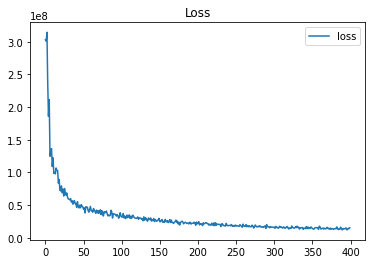

done 5 layers in 83.44ms
predict class: yaleB28
test image label: yaleB11
predict residuals label: 26
test residuals label: 10
[2575.3417729]


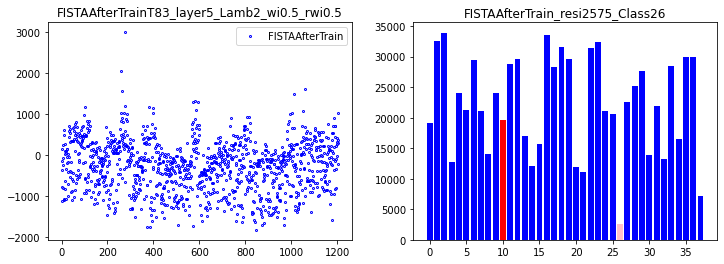

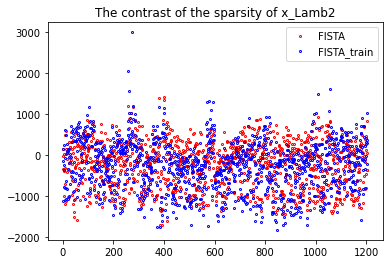

229
done 5 layers in 81.29ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[4730.73998406]


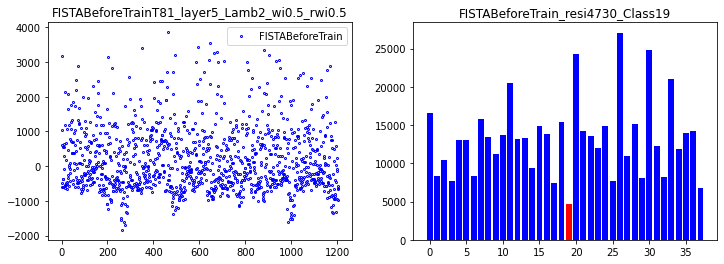

correct rate: 0.375
correct rate: 0.40625
correct rate: 0.40625
correct rate: 0.53125
Epoch [ 10/100]: loss = 46454639.0235,   lambda [max:2.0435], [min:1.9619], 
Epoch [ 20/100]: loss = 34902842.5942,   lambda [max:2.0577], [min:1.9639], 
Epoch [ 30/100]: loss = 26038735.6355,   lambda [max:2.0683], [min:1.9670], 
Epoch [ 40/100]: loss = 24618215.6629,   lambda [max:2.0886], [min:1.9659], 
Epoch [ 50/100]: loss = 22927778.6310,   lambda [max:2.1094], [min:1.9611], 
Epoch [ 60/100]: loss = 19354749.6507,   lambda [max:2.1293], [min:1.9568], 
Epoch [ 70/100]: loss = 15967280.6201,   lambda [max:2.1482], [min:1.9516], 
Epoch [ 80/100]: loss = 13314003.8509,   lambda [max:2.1662], [min:1.9475], 
Epoch [ 90/100]: loss = 11963861.3795,   lambda [max:2.1833], [min:1.9469], 
correct rate: 0.1875
correct rate: 0.1875
correct rate: 0.28125
correct rate: 0.4375
Epoch [100/100]: loss = 14158120.6521,   lambda [max:2.2003], [min:1.9461], 


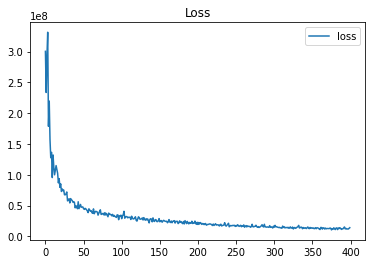

done 5 layers in 85.03ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[5031.42821336]


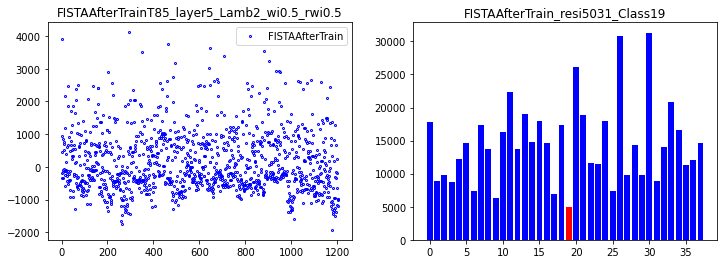

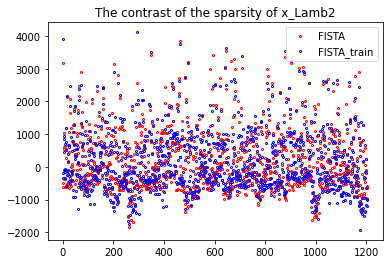

230
done 1 layers in 74.23ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[165030.00428363]


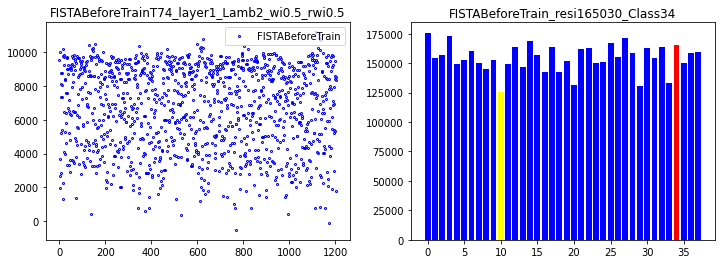

correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.5625
Epoch [ 10/100]: loss = 1179277039.3011,   lambda [max:2.0629], [min:1.9679], 
Epoch [ 20/100]: loss = 362110460.3291,   lambda [max:2.1030], [min:1.9707], 
Epoch [ 30/100]: loss = 293773289.9423,   lambda [max:2.1354], [min:1.9724], 
Epoch [ 40/100]: loss = 257402868.3842,   lambda [max:2.1640], [min:1.9737], 
Epoch [ 50/100]: loss = 178764563.0233,   lambda [max:2.1900], [min:1.9767], 
Epoch [ 60/100]: loss = 159574325.6561,   lambda [max:2.2142], [min:1.9764], 
Epoch [ 70/100]: loss = 160669456.4774,   lambda [max:2.2369], [min:1.9764], 
Epoch [ 80/100]: loss = 151451786.2798,   lambda [max:2.2584], [min:1.9766], 
Epoch [ 90/100]: loss = 186399269.5468,   lambda [max:2.2790], [min:1.9762], 
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.09375
correct rate: 0.09375
Epoch [100/100]: loss = 135750699.0882,   lambda [max:2.2988], [min:1.9765], 


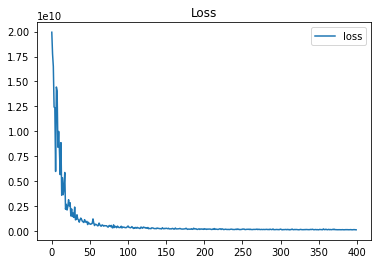

done 1 layers in 78.27ms
predict class: yaleB11
test image label: yaleB36
predict residuals label: 10
test residuals label: 34
[6087.30528154]


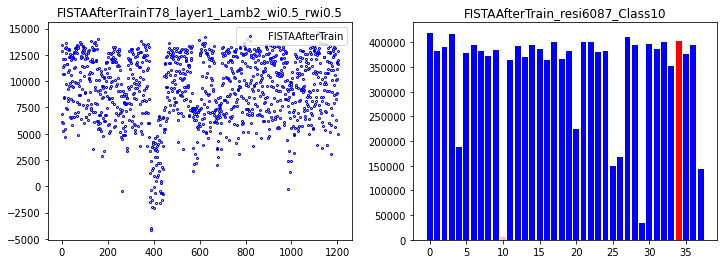

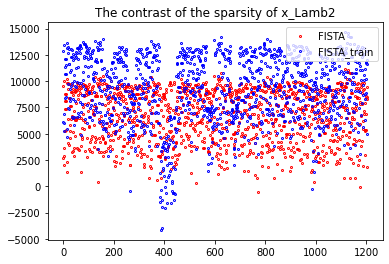

231
done 1 layers in 74.68ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[55240.62144772]


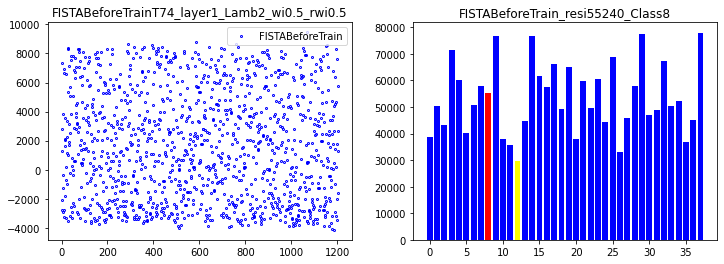

correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.59375
Epoch [ 10/100]: loss = 816502236.8748,   lambda [max:2.0636], [min:1.9686], 
Epoch [ 20/100]: loss = 549847192.3359,   lambda [max:2.1045], [min:1.9686], 
Epoch [ 30/100]: loss = 294632287.5965,   lambda [max:2.1374], [min:1.9683], 
Epoch [ 40/100]: loss = 276334040.7010,   lambda [max:2.1664], [min:1.9684], 
Epoch [ 50/100]: loss = 242315464.3458,   lambda [max:2.1927], [min:1.9681], 
Epoch [ 60/100]: loss = 172702746.3844,   lambda [max:2.2170], [min:1.9691], 
Epoch [ 70/100]: loss = 161331616.2355,   lambda [max:2.2399], [min:1.9691], 
Epoch [ 80/100]: loss = 185793476.9437,   lambda [max:2.2615], [min:1.9703], 
Epoch [ 90/100]: loss = 147885258.4031,   lambda [max:2.2822], [min:1.9703], 
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.125
correct rate: 0.03125
Epoch [100/100]: loss = 142527375.1556,   lambda [max:2.3021], [min:1.9706], 


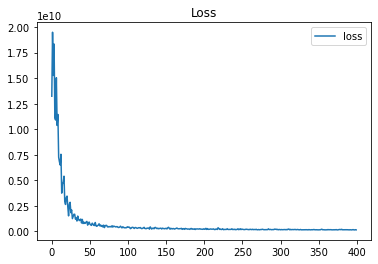

done 1 layers in 77.59ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[76363.16712477]


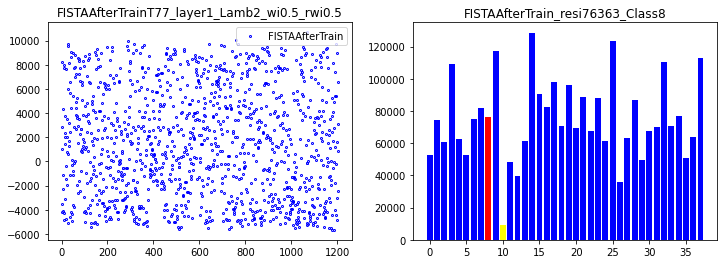

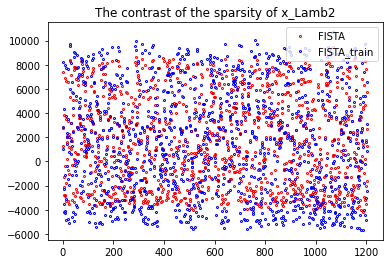

232
done 1 layers in 75.16ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[46018.72914558]


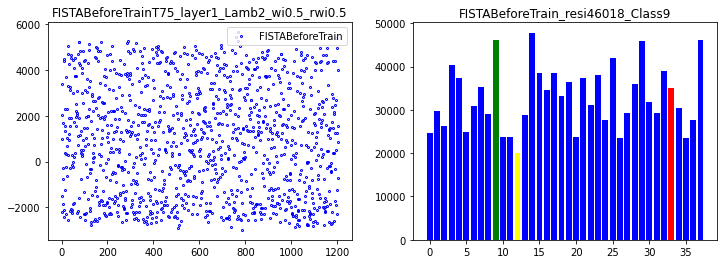

correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.59375
correct rate: 0.65625
Epoch [ 10/100]: loss = 1215207660.9862,   lambda [max:2.0628], [min:1.9699], 
Epoch [ 20/100]: loss = 456546207.4477,   lambda [max:2.1027], [min:1.9703], 
Epoch [ 30/100]: loss = 268998448.0635,   lambda [max:2.1350], [min:1.9711], 
Epoch [ 40/100]: loss = 225751828.2037,   lambda [max:2.1635], [min:1.9704], 
Epoch [ 50/100]: loss = 163093631.7975,   lambda [max:2.1894], [min:1.9705], 
Epoch [ 60/100]: loss = 156308416.7953,   lambda [max:2.2136], [min:1.9697], 
Epoch [ 70/100]: loss = 193690942.0786,   lambda [max:2.2363], [min:1.9691], 
Epoch [ 80/100]: loss = 152104764.2906,   lambda [max:2.2578], [min:1.9687], 
Epoch [ 90/100]: loss = 144047276.7025,   lambda [max:2.2784], [min:1.9682], 
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.09375
Epoch [100/100]: loss = 135054785.8994,   lambda [max:2.2982], [min:1.9678], 


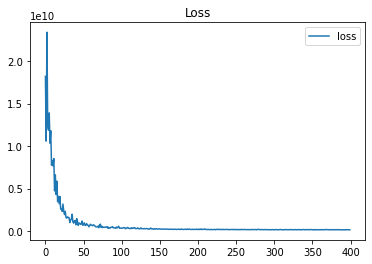

done 1 layers in 80.81ms
predict class: yaleB11
test image label: yaleB35
predict residuals label: 10
test residuals label: 33
[4167.34056311]


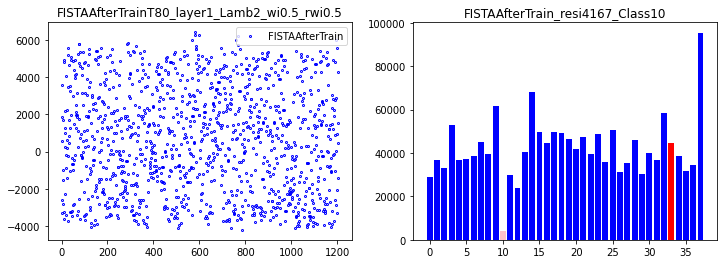

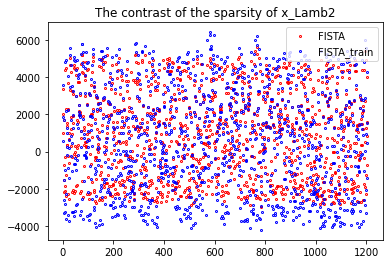

233
done 1 layers in 76.50ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[27569.88345457]


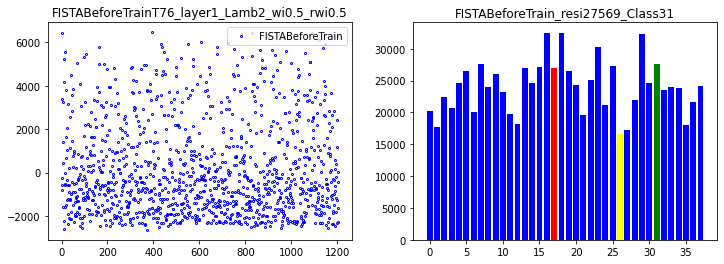

correct rate: 0.71875
correct rate: 0.53125
correct rate: 0.5625
correct rate: 0.625
Epoch [ 10/100]: loss = 1033309060.2466,   lambda [max:2.0630], [min:1.9815], 
Epoch [ 20/100]: loss = 585927279.2388,   lambda [max:2.1032], [min:1.9859], 
Epoch [ 30/100]: loss = 315540040.6951,   lambda [max:2.1355], [min:1.9875], 
Epoch [ 40/100]: loss = 217785282.5564,   lambda [max:2.1641], [min:1.9886], 
Epoch [ 50/100]: loss = 189823546.1029,   lambda [max:2.1901], [min:1.9902], 
Epoch [ 60/100]: loss = 164219445.5656,   lambda [max:2.2142], [min:1.9910], 
Epoch [ 70/100]: loss = 147305741.9057,   lambda [max:2.2369], [min:1.9911], 
Epoch [ 80/100]: loss = 161242069.3938,   lambda [max:2.2585], [min:1.9912], 
Epoch [ 90/100]: loss = 137688826.1928,   lambda [max:2.2791], [min:1.9914], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.125
correct rate: 0.0
Epoch [100/100]: loss = 146369298.1848,   lambda [max:2.2990], [min:1.9915], 


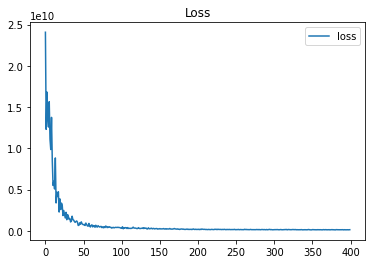

done 1 layers in 73.28ms
predict class: yaleB05
test image label: yaleB19
predict residuals label: 4
test residuals label: 17
[33234.04335767]


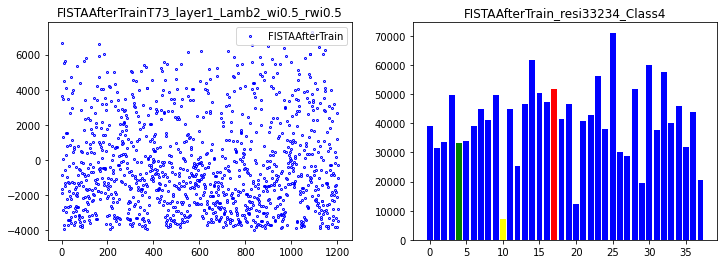

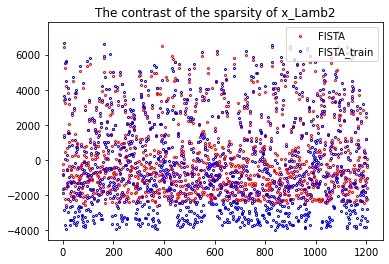

234
done 1 layers in 91.80ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[31029.61963336]


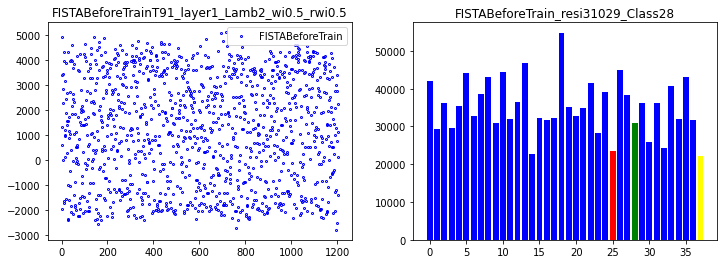

correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.625
correct rate: 0.65625
Epoch [ 10/100]: loss = 1086774019.7138,   lambda [max:2.0628], [min:1.9646], 
Epoch [ 20/100]: loss = 469186751.8081,   lambda [max:2.1026], [min:1.9660], 
Epoch [ 30/100]: loss = 456482802.1080,   lambda [max:2.1349], [min:1.9675], 
Epoch [ 40/100]: loss = 226183942.1054,   lambda [max:2.1634], [min:1.9699], 
Epoch [ 50/100]: loss = 200993660.5795,   lambda [max:2.1895], [min:1.9715], 
Epoch [ 60/100]: loss = 188062733.6324,   lambda [max:2.2138], [min:1.9727], 
Epoch [ 70/100]: loss = 185631069.8474,   lambda [max:2.2366], [min:1.9725], 
Epoch [ 80/100]: loss = 154021741.2544,   lambda [max:2.2582], [min:1.9725], 
Epoch [ 90/100]: loss = 138492766.7662,   lambda [max:2.2788], [min:1.9722], 
correct rate: 0.09375
correct rate: 0.0625
correct rate: 0.0
correct rate: 0.125
Epoch [100/100]: loss = 151086150.2647,   lambda [max:2.2987], [min:1.9724], 


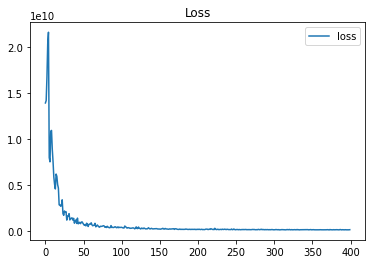

done 1 layers in 82.38ms
predict class: yaleB05
test image label: yaleB27
predict residuals label: 4
test residuals label: 25
[40059.27493111]


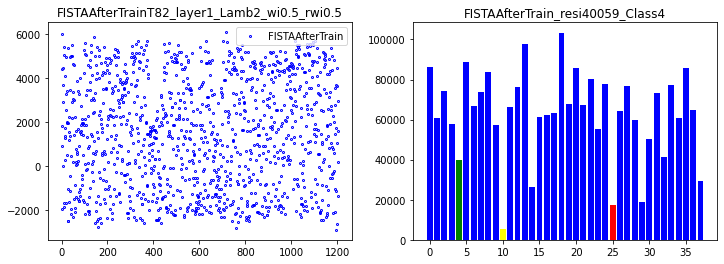

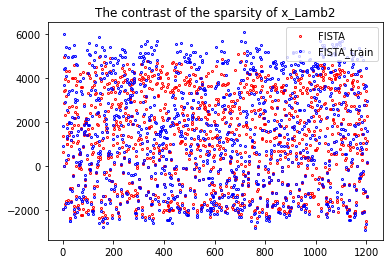

235
done 1 layers in 77.09ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[117197.29986484]


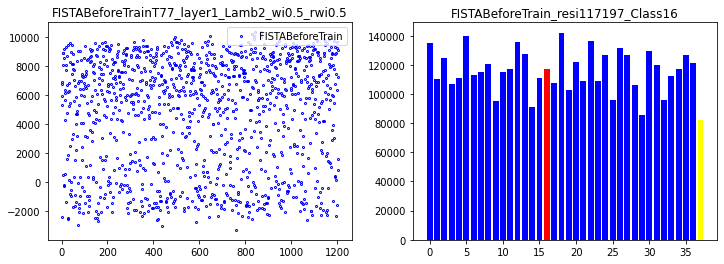

correct rate: 0.75
correct rate: 0.6875
correct rate: 0.53125
correct rate: 0.5
Epoch [ 10/100]: loss = 960582119.1171,   lambda [max:2.0631], [min:1.9804], 
Epoch [ 20/100]: loss = 502447576.0428,   lambda [max:2.1034], [min:1.9830], 
Epoch [ 30/100]: loss = 368173409.7651,   lambda [max:2.1358], [min:1.9842], 
Epoch [ 40/100]: loss = 226670360.9993,   lambda [max:2.1643], [min:1.9854], 
Epoch [ 50/100]: loss = 222038961.5730,   lambda [max:2.1903], [min:1.9865], 
Epoch [ 60/100]: loss = 192310763.9231,   lambda [max:2.2143], [min:1.9866], 
Epoch [ 70/100]: loss = 220599041.3139,   lambda [max:2.2368], [min:1.9867], 
Epoch [ 80/100]: loss = 174980562.3499,   lambda [max:2.2582], [min:1.9868], 
Epoch [ 90/100]: loss = 150395213.9411,   lambda [max:2.2786], [min:1.9869], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.0625
Epoch [100/100]: loss = 161251104.5935,   lambda [max:2.2982], [min:1.9871], 


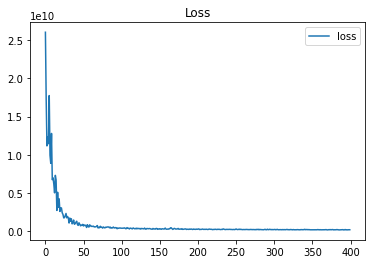

done 1 layers in 73.65ms
predict class: yaleB39
test image label: yaleB18
predict residuals label: 37
test residuals label: 16
[5699.77212129]


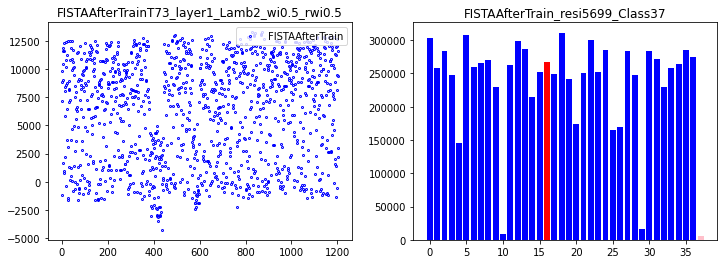

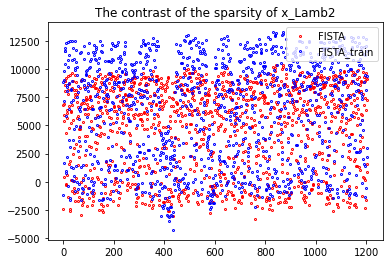

236
done 1 layers in 83.25ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[207823.17555821]


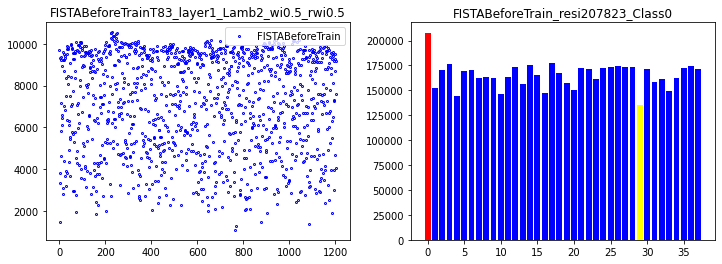

correct rate: 0.71875
correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.53125
Epoch [ 10/100]: loss = 969250232.6317,   lambda [max:2.0627], [min:1.9683], 
Epoch [ 20/100]: loss = 477400653.5417,   lambda [max:2.1025], [min:1.9667], 
Epoch [ 30/100]: loss = 281134432.8778,   lambda [max:2.1347], [min:1.9663], 
Epoch [ 40/100]: loss = 227988683.7273,   lambda [max:2.1632], [min:1.9661], 
Epoch [ 50/100]: loss = 218300772.2046,   lambda [max:2.1890], [min:1.9661], 
Epoch [ 60/100]: loss = 180351111.9619,   lambda [max:2.2131], [min:1.9664], 
Epoch [ 70/100]: loss = 150201545.9377,   lambda [max:2.2358], [min:1.9670], 
Epoch [ 80/100]: loss = 144526810.7455,   lambda [max:2.2573], [min:1.9667], 
Epoch [ 90/100]: loss = 141607758.4703,   lambda [max:2.2778], [min:1.9673], 
correct rate: 0.03125
correct rate: 0.1875
correct rate: 0.03125
correct rate: 0.0625
Epoch [100/100]: loss = 144759451.0563,   lambda [max:2.2975], [min:1.9673], 


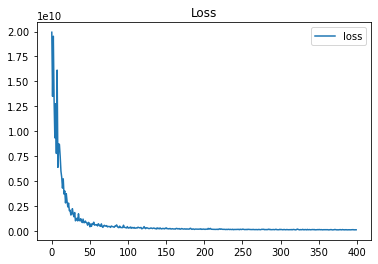

done 1 layers in 79.22ms
predict class: yaleB11
test image label: yaleB01
predict residuals label: 10
test residuals label: 0
[6087.98865395]


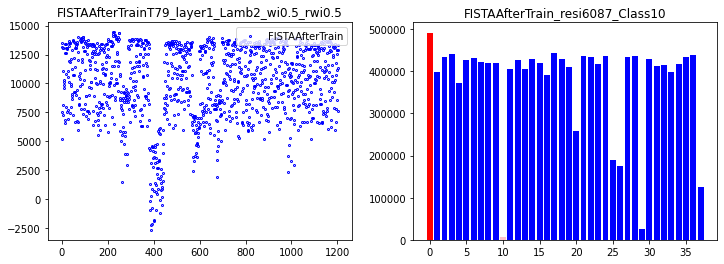

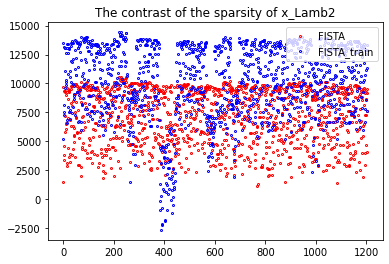

237
done 1 layers in 72.61ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[144025.68679775]


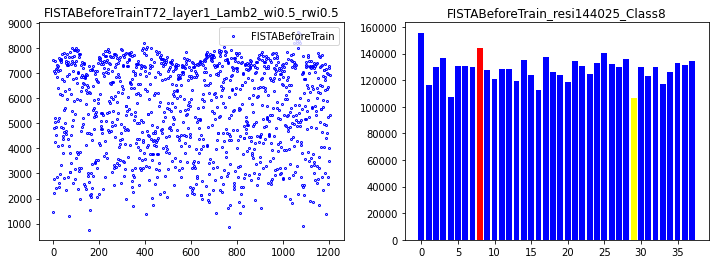

correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.53125
correct rate: 0.625
Epoch [ 10/100]: loss = 951180353.5904,   lambda [max:2.0630], [min:1.9675], 
Epoch [ 20/100]: loss = 486081711.1700,   lambda [max:2.1034], [min:1.9692], 
Epoch [ 30/100]: loss = 337462048.1139,   lambda [max:2.1360], [min:1.9693], 
Epoch [ 40/100]: loss = 254064961.3456,   lambda [max:2.1647], [min:1.9697], 
Epoch [ 50/100]: loss = 192365075.1688,   lambda [max:2.1908], [min:1.9695], 
Epoch [ 60/100]: loss = 212096835.7942,   lambda [max:2.2151], [min:1.9700], 
Epoch [ 70/100]: loss = 170545165.4667,   lambda [max:2.2379], [min:1.9697], 
Epoch [ 80/100]: loss = 176770657.1191,   lambda [max:2.2595], [min:1.9703], 
Epoch [ 90/100]: loss = 167167768.6926,   lambda [max:2.2801], [min:1.9703], 
correct rate: 0.09375
correct rate: 0.09375
correct rate: 0.0
correct rate: 0.03125
Epoch [100/100]: loss = 136955940.2978,   lambda [max:2.2999], [min:1.9709], 


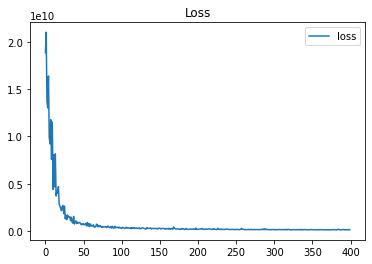

done 1 layers in 72.54ms
predict class: yaleB11
test image label: yaleB09
predict residuals label: 10
test residuals label: 8
[5116.23554634]


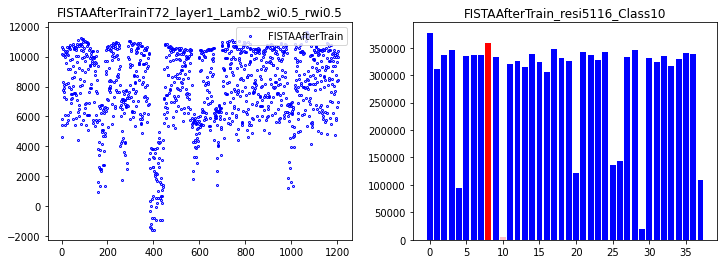

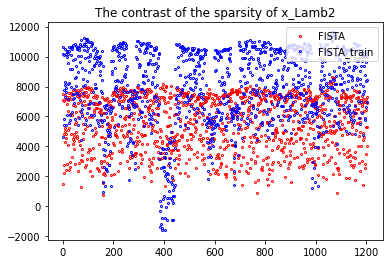

238
done 1 layers in 78.06ms
predict class: yaleB30
test image label: yaleB11
predict residuals label: 28
test residuals label: 10
[140785.89735658]


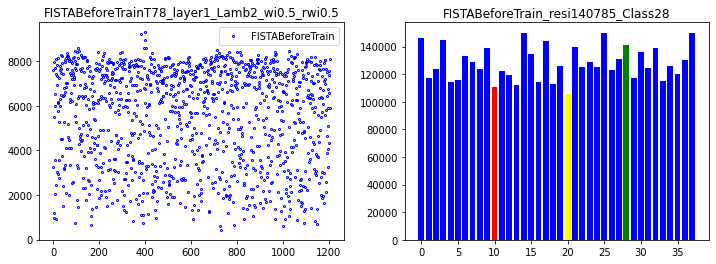

correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.40625
Epoch [ 10/100]: loss = 1032822218.3637,   lambda [max:2.0632], [min:1.9711], 
Epoch [ 20/100]: loss = 502702453.7627,   lambda [max:2.1037], [min:1.9726], 
Epoch [ 30/100]: loss = 315068024.6744,   lambda [max:2.1364], [min:1.9722], 
Epoch [ 40/100]: loss = 199883230.7467,   lambda [max:2.1651], [min:1.9723], 
Epoch [ 50/100]: loss = 258640883.2289,   lambda [max:2.1913], [min:1.9714], 
Epoch [ 60/100]: loss = 228315771.9785,   lambda [max:2.2155], [min:1.9719], 
Epoch [ 70/100]: loss = 211969732.0015,   lambda [max:2.2383], [min:1.9716], 
Epoch [ 80/100]: loss = 168895968.5216,   lambda [max:2.2599], [min:1.9703], 
Epoch [ 90/100]: loss = 162557297.1682,   lambda [max:2.2805], [min:1.9700], 
correct rate: 0.0
correct rate: 0.09375
correct rate: 0.0625
correct rate: 0.03125
Epoch [100/100]: loss = 166750886.1501,   lambda [max:2.3003], [min:1.9693], 


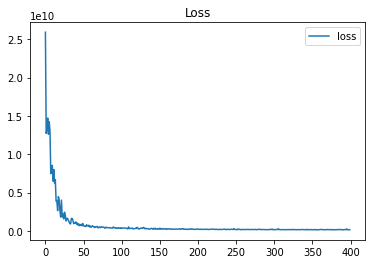

done 1 layers in 72.92ms
predict class: yaleB31
test image label: yaleB11
predict residuals label: 29
test residuals label: 10
[6891.57089586]


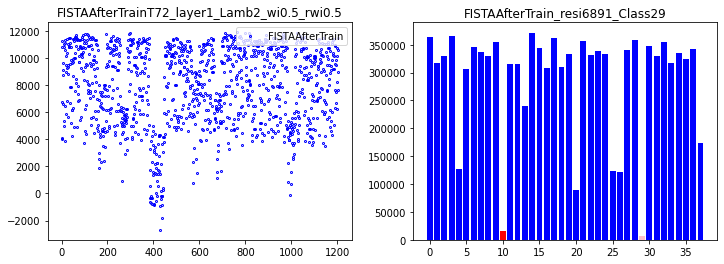

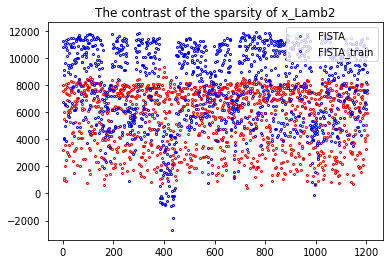

239
done 1 layers in 82.43ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[56893.90229373]


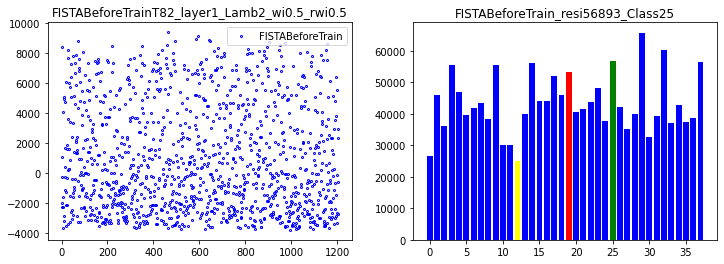

correct rate: 0.625
correct rate: 0.59375
correct rate: 0.625
correct rate: 0.6875
Epoch [ 10/100]: loss = 1526042779.3260,   lambda [max:2.0629], [min:1.9724], 
Epoch [ 20/100]: loss = 424980428.5195,   lambda [max:2.1030], [min:1.9733], 
Epoch [ 30/100]: loss = 272305902.6598,   lambda [max:2.1353], [min:1.9720], 
Epoch [ 40/100]: loss = 506190845.5299,   lambda [max:2.1637], [min:1.9715], 
Epoch [ 50/100]: loss = 267328745.3658,   lambda [max:2.1897], [min:1.9720], 
Epoch [ 60/100]: loss = 179553310.2301,   lambda [max:2.2137], [min:1.9713], 
Epoch [ 70/100]: loss = 189821673.9272,   lambda [max:2.2363], [min:1.9717], 
Epoch [ 80/100]: loss = 163839150.2750,   lambda [max:2.2578], [min:1.9711], 
Epoch [ 90/100]: loss = 241960002.0070,   lambda [max:2.2782], [min:1.9705], 
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.0
correct rate: 0.09375
Epoch [100/100]: loss = 154482100.9394,   lambda [max:2.2979], [min:1.9701], 


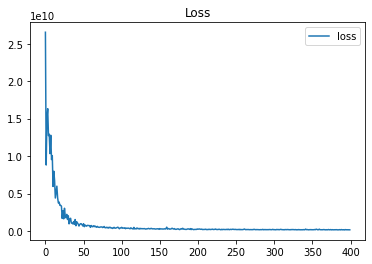

done 1 layers in 77.71ms
predict class: yaleB16
test image label: yaleB21
predict residuals label: 14
test residuals label: 19
[79345.90962345]


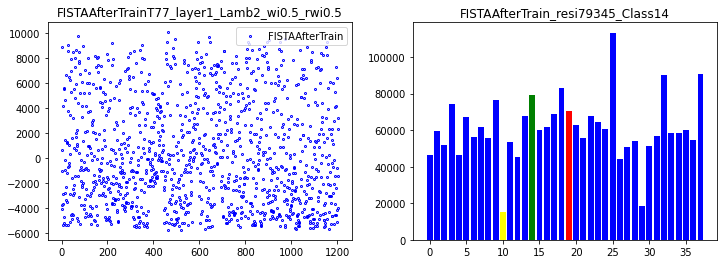

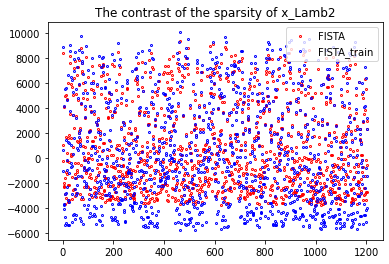

240
done 10 layers in 90.27ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[13940.33060953]


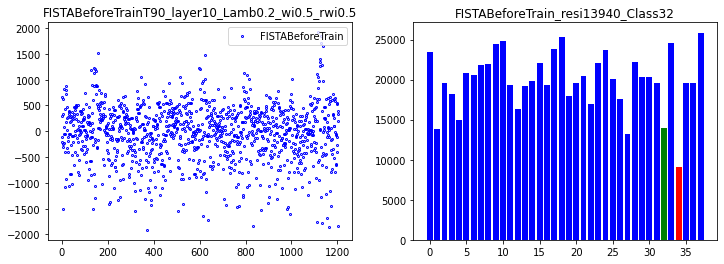

correct rate: 0.4375
correct rate: 0.6875
correct rate: 0.8125
correct rate: 0.65625
Epoch [ 10/100]: loss = 39836937.9379,   lambda [max:0.2494], [min:0.1622], 
Epoch [ 20/100]: loss = 21607834.4953,   lambda [max:0.2603], [min:0.1479], 
Epoch [ 30/100]: loss = 13594451.8225,   lambda [max:0.2624], [min:0.1321], 
Epoch [ 40/100]: loss = 11279718.8766,   lambda [max:0.2678], [min:0.1205], 
Epoch [ 50/100]: loss = 8691343.6425,   lambda [max:0.2722], [min:0.1120], 
Epoch [ 60/100]: loss = 6438760.6547,   lambda [max:0.2753], [min:0.1047], 
Epoch [ 70/100]: loss = 6326365.5228,   lambda [max:0.2770], [min:0.0992], 
Epoch [ 80/100]: loss = 4724659.2421,   lambda [max:0.2780], [min:0.0943], 
Epoch [ 90/100]: loss = 4366546.9038,   lambda [max:0.2786], [min:0.0905], 
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.65625
Epoch [100/100]: loss = 3541867.9224,   lambda [max:0.2787], [min:0.0871], 


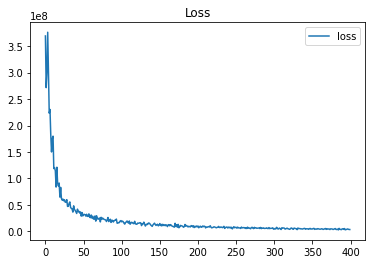

done 10 layers in 88.68ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[1141.47888281]


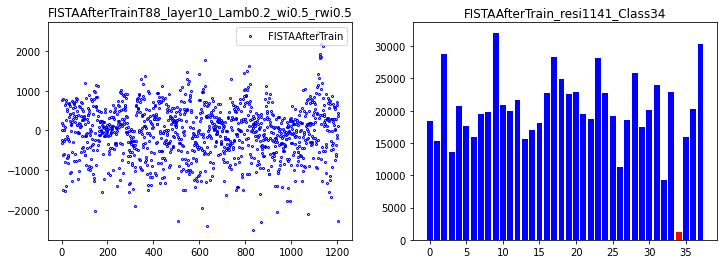

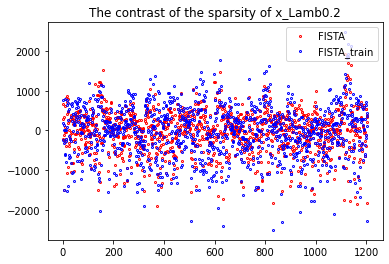

241
done 10 layers in 88.28ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[8822.14116408]


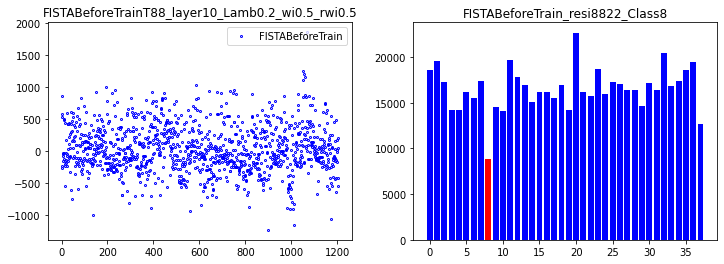

correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.59375
Epoch [ 10/100]: loss = 36681322.7280,   lambda [max:0.2494], [min:0.1611], 
Epoch [ 20/100]: loss = 20333323.0692,   lambda [max:0.2683], [min:0.1487], 
Epoch [ 30/100]: loss = 15830153.3211,   lambda [max:0.2705], [min:0.1326], 
Epoch [ 40/100]: loss = 11308202.2370,   lambda [max:0.2710], [min:0.1206], 
Epoch [ 50/100]: loss = 9120675.7008,   lambda [max:0.2707], [min:0.1114], 
Epoch [ 60/100]: loss = 4543745.3516,   lambda [max:0.2707], [min:0.1038], 
Epoch [ 70/100]: loss = 5537652.6856,   lambda [max:0.2706], [min:0.0972], 
Epoch [ 80/100]: loss = 3581569.5270,   lambda [max:0.2705], [min:0.0919], 
Epoch [ 90/100]: loss = 3276285.5673,   lambda [max:0.2714], [min:0.0871], 
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.6875
Epoch [100/100]: loss = 3649095.3638,   lambda [max:0.2728], [min:0.0832], 


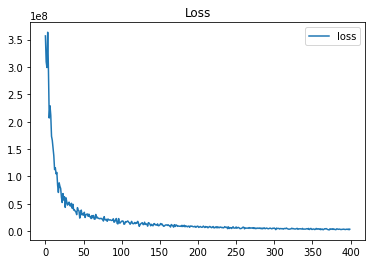

done 10 layers in 89.07ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1307.19777503]


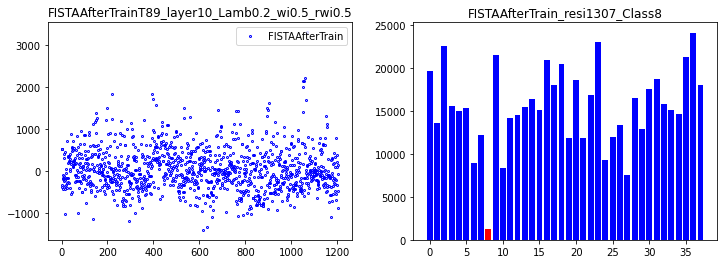

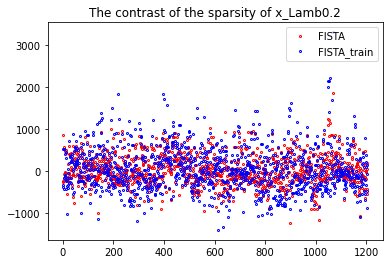

242
done 10 layers in 87.55ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6060.02514802]


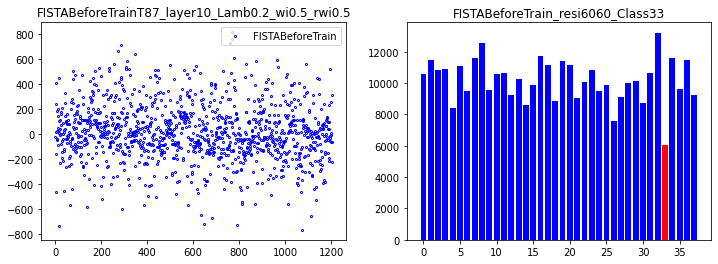

correct rate: 0.5625
correct rate: 0.625
correct rate: 0.5625
correct rate: 0.65625
Epoch [ 10/100]: loss = 39903367.9512,   lambda [max:0.2498], [min:0.1654], 
Epoch [ 20/100]: loss = 22971931.8774,   lambda [max:0.2609], [min:0.1444], 
Epoch [ 30/100]: loss = 15356544.8925,   lambda [max:0.2642], [min:0.1322], 
Epoch [ 40/100]: loss = 9138234.6760,   lambda [max:0.2642], [min:0.1225], 
Epoch [ 50/100]: loss = 7932075.4044,   lambda [max:0.2664], [min:0.1146], 
Epoch [ 60/100]: loss = 6281581.8934,   lambda [max:0.2723], [min:0.1081], 
Epoch [ 70/100]: loss = 5536933.9707,   lambda [max:0.2771], [min:0.1024], 
Epoch [ 80/100]: loss = 5479821.6981,   lambda [max:0.2815], [min:0.0977], 
Epoch [ 90/100]: loss = 4806191.7047,   lambda [max:0.2853], [min:0.0938], 
correct rate: 0.75
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.59375
Epoch [100/100]: loss = 3351990.1480,   lambda [max:0.2886], [min:0.0901], 


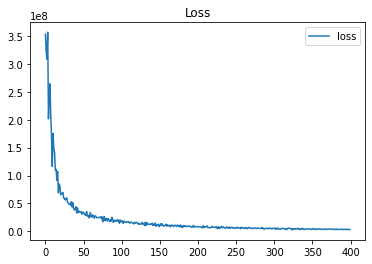

done 10 layers in 89.01ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[1233.45673378]


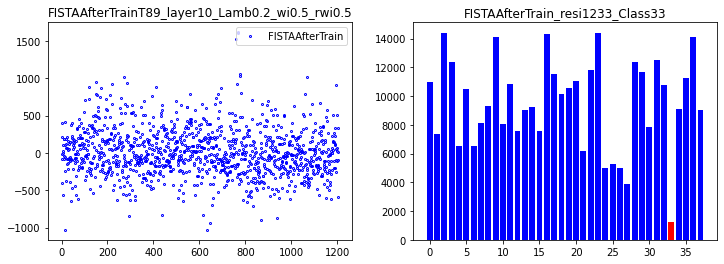

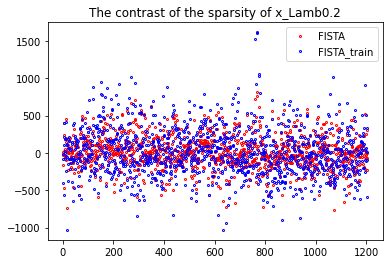

243
done 10 layers in 92.47ms
predict class: yaleB31
test image label: yaleB19
predict residuals label: 29
test residuals label: 17
[7793.67296069]


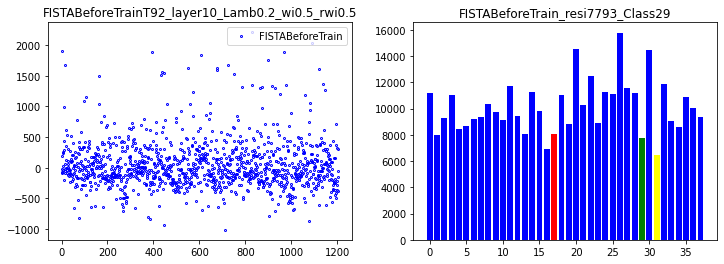

correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.53125
correct rate: 0.65625
Epoch [ 10/100]: loss = 43549282.9133,   lambda [max:0.2491], [min:0.1662], 
Epoch [ 20/100]: loss = 23399085.5019,   lambda [max:0.2607], [min:0.1500], 
Epoch [ 30/100]: loss = 15718924.9127,   lambda [max:0.2626], [min:0.1335], 
Epoch [ 40/100]: loss = 8719637.3252,   lambda [max:0.2632], [min:0.1215], 
Epoch [ 50/100]: loss = 7625705.9866,   lambda [max:0.2636], [min:0.1122], 
Epoch [ 60/100]: loss = 8179905.6595,   lambda [max:0.2636], [min:0.1045], 
Epoch [ 70/100]: loss = 6589188.6661,   lambda [max:0.2634], [min:0.0979], 
Epoch [ 80/100]: loss = 5174651.4765,   lambda [max:0.2628], [min:0.0922], 
Epoch [ 90/100]: loss = 3572472.0626,   lambda [max:0.2626], [min:0.0874], 
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.71875
Epoch [100/100]: loss = 4179786.7161,   lambda [max:0.2625], [min:0.0834], 


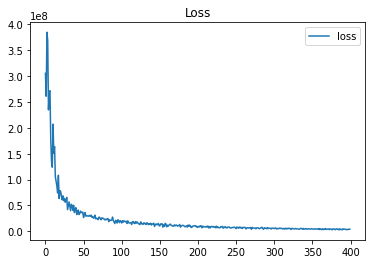

done 10 layers in 87.94ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[1947.31927071]


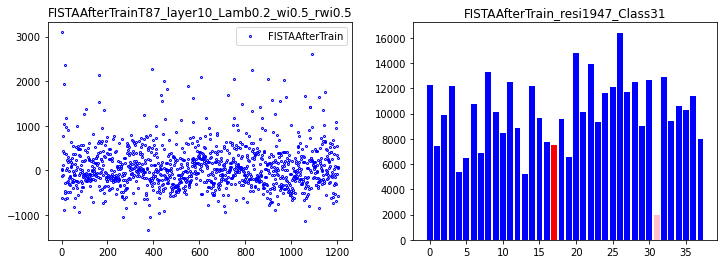

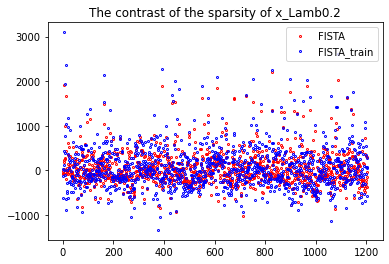

244
done 10 layers in 93.90ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[7972.84785787]


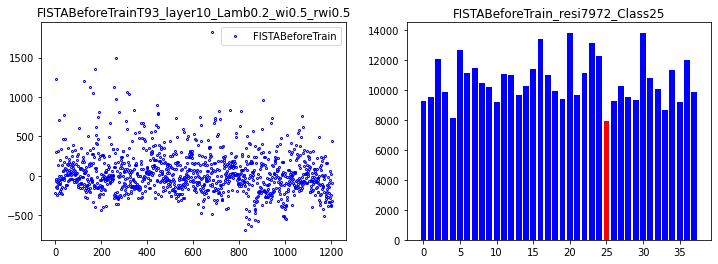

correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.59375
Epoch [ 10/100]: loss = 38930690.1516,   lambda [max:0.2487], [min:0.1594], 
Epoch [ 20/100]: loss = 26263163.1402,   lambda [max:0.2598], [min:0.1488], 
Epoch [ 30/100]: loss = 17755892.8638,   lambda [max:0.2627], [min:0.1417], 
Epoch [ 40/100]: loss = 13411800.8348,   lambda [max:0.2640], [min:0.1342], 
Epoch [ 50/100]: loss = 8827459.9822,   lambda [max:0.2644], [min:0.1264], 
Epoch [ 60/100]: loss = 7342456.2351,   lambda [max:0.2656], [min:0.1181], 
Epoch [ 70/100]: loss = 5343244.4601,   lambda [max:0.2685], [min:0.1115], 
Epoch [ 80/100]: loss = 5879771.1823,   lambda [max:0.2699], [min:0.1059], 
Epoch [ 90/100]: loss = 2837968.4285,   lambda [max:0.2714], [min:0.1018], 
correct rate: 0.75
correct rate: 0.625
correct rate: 0.625
correct rate: 0.65625
Epoch [100/100]: loss = 3704655.4211,   lambda [max:0.2731], [min:0.0978], 


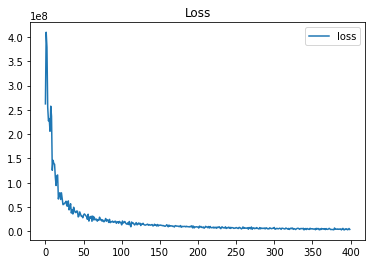

done 10 layers in 91.52ms
predict class: yaleB27
test image label: yaleB27
predict residuals label: 25
test residuals label: 25
[928.83316116]


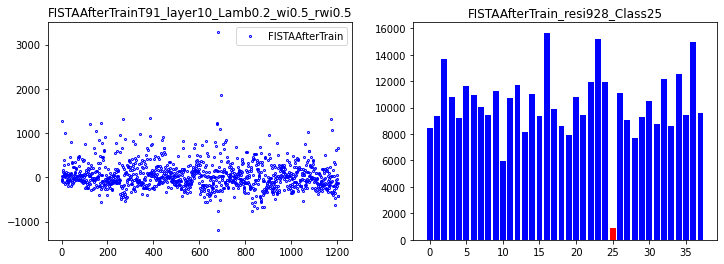

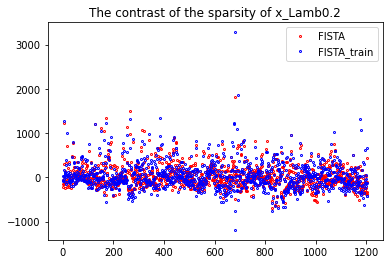

245
done 10 layers in 89.44ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[10511.46048008]


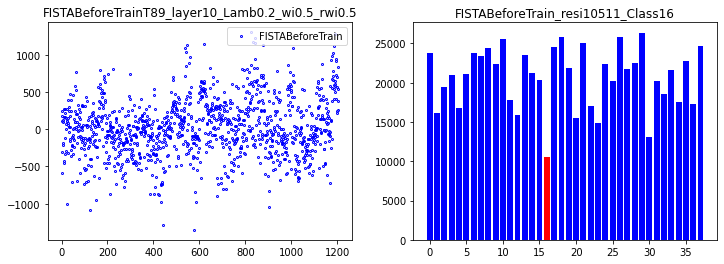

correct rate: 0.65625
correct rate: 0.4375
correct rate: 0.59375
correct rate: 0.65625
Epoch [ 10/100]: loss = 42350597.4425,   lambda [max:0.2467], [min:0.1610], 
Epoch [ 20/100]: loss = 22360283.2000,   lambda [max:0.2635], [min:0.1502], 
Epoch [ 30/100]: loss = 13127251.2332,   lambda [max:0.2664], [min:0.1452], 
Epoch [ 40/100]: loss = 11774384.6812,   lambda [max:0.2696], [min:0.1386], 
Epoch [ 50/100]: loss = 8807028.8847,   lambda [max:0.2746], [min:0.1272], 
Epoch [ 60/100]: loss = 6703757.3429,   lambda [max:0.2782], [min:0.1178], 
Epoch [ 70/100]: loss = 6240721.7486,   lambda [max:0.2803], [min:0.1103], 
Epoch [ 80/100]: loss = 5374854.6501,   lambda [max:0.2816], [min:0.1041], 
Epoch [ 90/100]: loss = 5070113.7896,   lambda [max:0.2822], [min:0.0988], 
correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.6875
Epoch [100/100]: loss = 3671428.0987,   lambda [max:0.2824], [min:0.0942], 


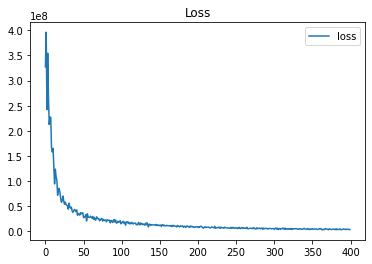

done 10 layers in 91.26ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[573.28252042]


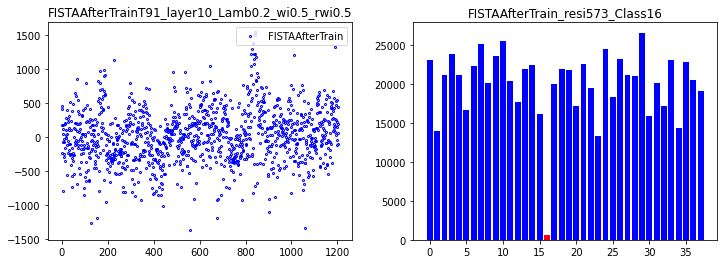

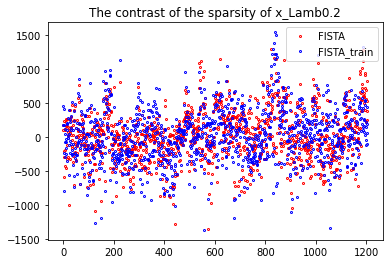

246
done 10 layers in 93.14ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[8533.09062643]


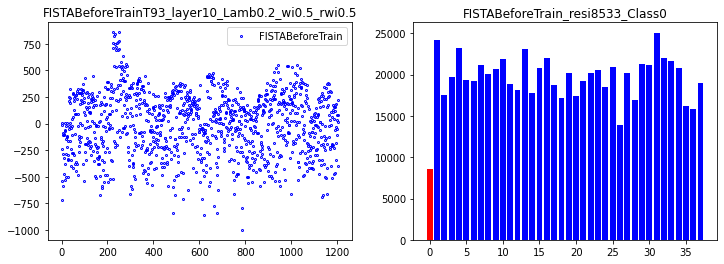

correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.53125
Epoch [ 10/100]: loss = 30245205.0753,   lambda [max:0.2495], [min:0.1616], 
Epoch [ 20/100]: loss = 16950448.2065,   lambda [max:0.2608], [min:0.1455], 
Epoch [ 30/100]: loss = 12998067.2884,   lambda [max:0.2632], [min:0.1294], 
Epoch [ 40/100]: loss = 12340483.1610,   lambda [max:0.2637], [min:0.1171], 
Epoch [ 50/100]: loss = 10493110.3227,   lambda [max:0.2685], [min:0.1076], 
Epoch [ 60/100]: loss = 8544256.8918,   lambda [max:0.2718], [min:0.0995], 
Epoch [ 70/100]: loss = 6619229.0648,   lambda [max:0.2744], [min:0.0928], 
Epoch [ 80/100]: loss = 4720186.4668,   lambda [max:0.2764], [min:0.0867], 
Epoch [ 90/100]: loss = 4969325.7289,   lambda [max:0.2785], [min:0.0818], 
correct rate: 0.71875
correct rate: 0.75
correct rate: 0.5
correct rate: 0.6875
Epoch [100/100]: loss = 3592123.2787,   lambda [max:0.2796], [min:0.0776], 


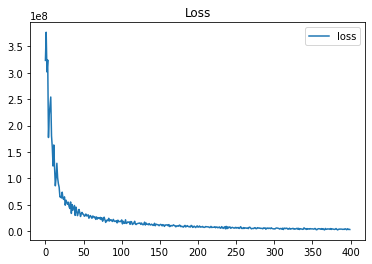

done 10 layers in 92.14ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1040.591698]


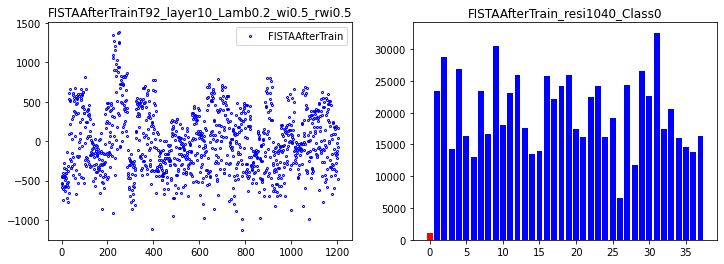

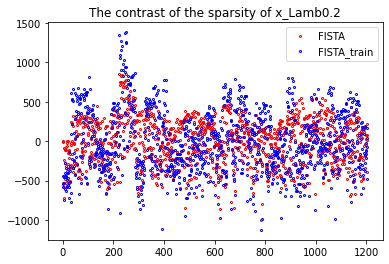

247
done 10 layers in 91.94ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[2517.92268771]


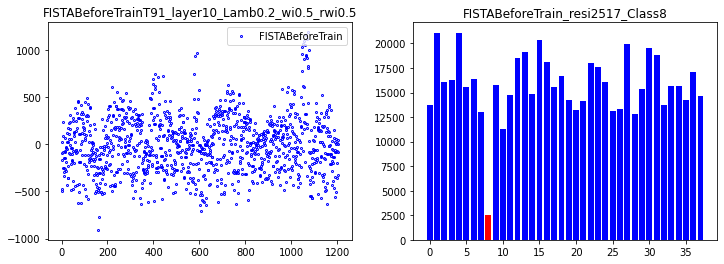

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.59375
Epoch [ 10/100]: loss = 38983874.6715,   lambda [max:0.2499], [min:0.1624], 
Epoch [ 20/100]: loss = 17907854.1328,   lambda [max:0.2602], [min:0.1500], 
Epoch [ 30/100]: loss = 17853410.4338,   lambda [max:0.2625], [min:0.1351], 
Epoch [ 40/100]: loss = 12074278.9430,   lambda [max:0.2634], [min:0.1243], 
Epoch [ 50/100]: loss = 8164108.4003,   lambda [max:0.2639], [min:0.1158], 
Epoch [ 60/100]: loss = 5747679.7513,   lambda [max:0.2657], [min:0.1086], 
Epoch [ 70/100]: loss = 5975646.0944,   lambda [max:0.2685], [min:0.1024], 
Epoch [ 80/100]: loss = 4676020.7461,   lambda [max:0.2705], [min:0.0969], 
Epoch [ 90/100]: loss = 4086245.9888,   lambda [max:0.2730], [min:0.0927], 
correct rate: 0.90625
correct rate: 0.5625
correct rate: 0.59375
correct rate: 0.625
Epoch [100/100]: loss = 3493460.8157,   lambda [max:0.2745], [min:0.0887], 


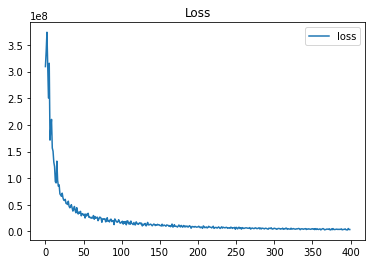

done 10 layers in 88.68ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1760.88550514]


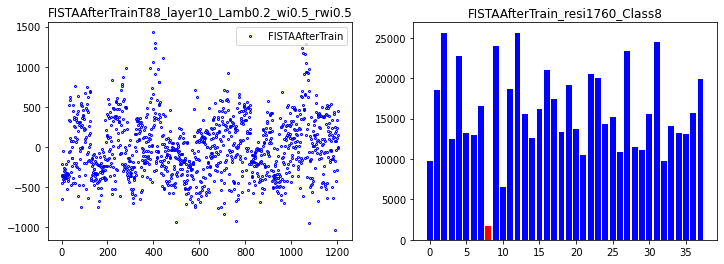

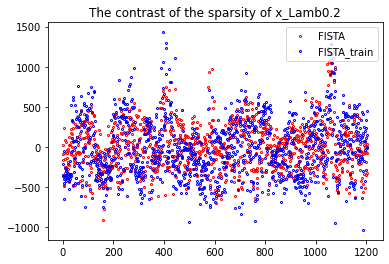

248
done 10 layers in 87.57ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[9766.77429531]


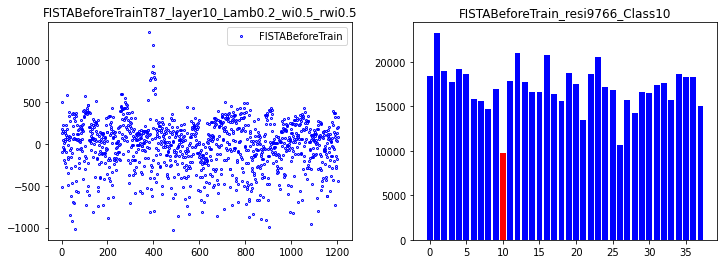

correct rate: 0.6875
correct rate: 0.53125
correct rate: 0.5
correct rate: 0.71875
Epoch [ 10/100]: loss = 35292631.7724,   lambda [max:0.2501], [min:0.1601], 
Epoch [ 20/100]: loss = 21440199.1413,   lambda [max:0.2616], [min:0.1439], 
Epoch [ 30/100]: loss = 15939230.1527,   lambda [max:0.2639], [min:0.1346], 
Epoch [ 40/100]: loss = 10805774.4027,   lambda [max:0.2646], [min:0.1258], 
Epoch [ 50/100]: loss = 10976993.2219,   lambda [max:0.2647], [min:0.1182], 
Epoch [ 60/100]: loss = 4575028.1437,   lambda [max:0.2645], [min:0.1111], 
Epoch [ 70/100]: loss = 3379183.4064,   lambda [max:0.2647], [min:0.1055], 
Epoch [ 80/100]: loss = 5021690.2555,   lambda [max:0.2644], [min:0.1004], 
Epoch [ 90/100]: loss = 3255478.3116,   lambda [max:0.2652], [min:0.0958], 
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.65625
Epoch [100/100]: loss = 3618685.9335,   lambda [max:0.2662], [min:0.0919], 


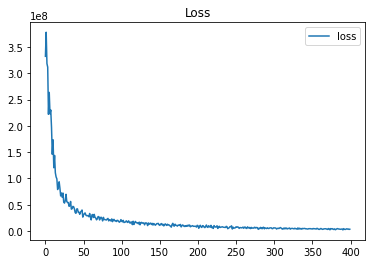

done 10 layers in 93.07ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[1317.67874978]


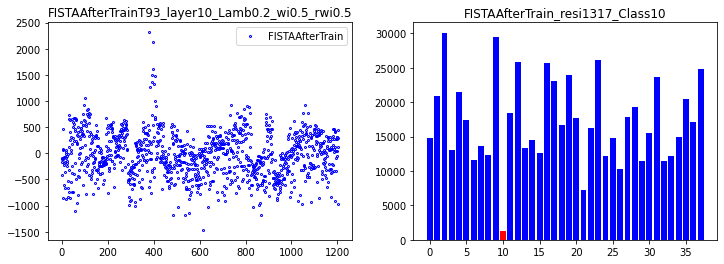

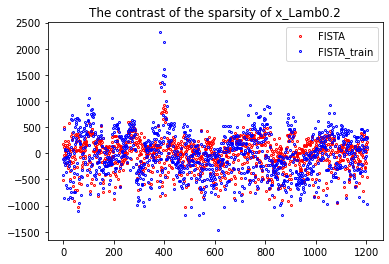

249
done 10 layers in 92.28ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[9009.93165632]


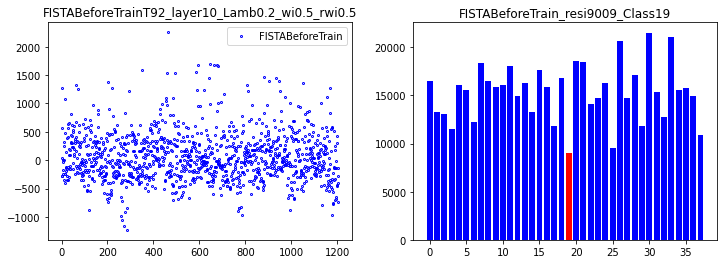

correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.59375
Epoch [ 10/100]: loss = 35219778.9507,   lambda [max:0.2490], [min:0.1620], 
Epoch [ 20/100]: loss = 21046157.6548,   lambda [max:0.2577], [min:0.1480], 
Epoch [ 30/100]: loss = 10605267.7755,   lambda [max:0.2599], [min:0.1335], 
Epoch [ 40/100]: loss = 10878519.7798,   lambda [max:0.2605], [min:0.1236], 
Epoch [ 50/100]: loss = 9322093.7513,   lambda [max:0.2627], [min:0.1152], 
Epoch [ 60/100]: loss = 7140372.3011,   lambda [max:0.2659], [min:0.1080], 
Epoch [ 70/100]: loss = 6629576.7805,   lambda [max:0.2684], [min:0.1022], 
Epoch [ 80/100]: loss = 5693857.1299,   lambda [max:0.2703], [min:0.0965], 
Epoch [ 90/100]: loss = 3952189.1503,   lambda [max:0.2717], [min:0.0917], 
correct rate: 0.78125
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.625
Epoch [100/100]: loss = 3535040.3833,   lambda [max:0.2728], [min:0.0876], 


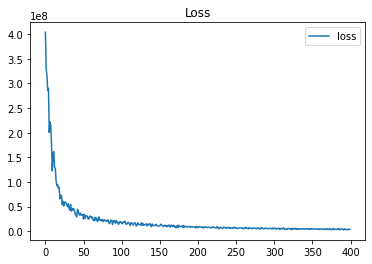

done 10 layers in 88.99ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[2819.74291728]


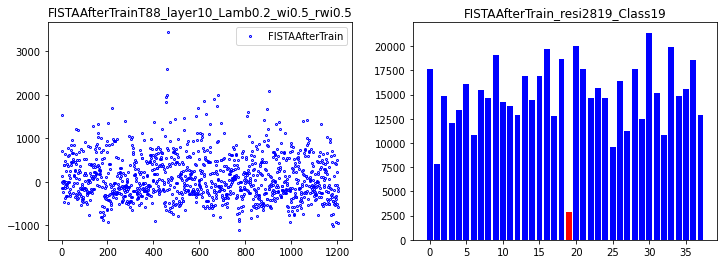

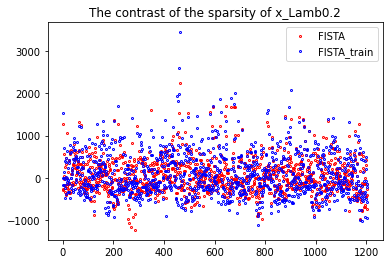

250
done 5 layers in 86.79ms
predict class: yaleB05
test image label: yaleB36
predict residuals label: 4
test residuals label: 34
[16737.71593264]


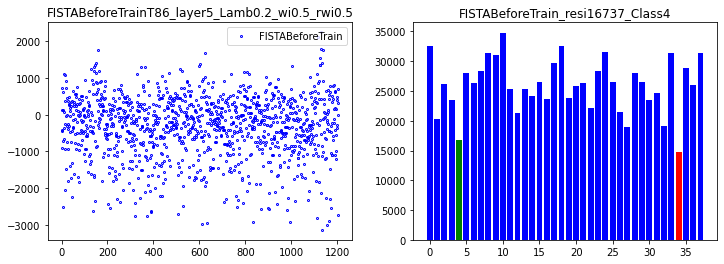

correct rate: 0.4375
correct rate: 0.28125
correct rate: 0.5625
correct rate: 0.4375
Epoch [ 10/100]: loss = 46116208.7760,   lambda [max:0.2392], [min:0.1639], 
Epoch [ 20/100]: loss = 29463921.1421,   lambda [max:0.2500], [min:0.1556], 
Epoch [ 30/100]: loss = 26613868.8882,   lambda [max:0.2544], [min:0.1479], 
Epoch [ 40/100]: loss = 16059165.6184,   lambda [max:0.2568], [min:0.1431], 
Epoch [ 50/100]: loss = 13068674.3462,   lambda [max:0.2603], [min:0.1361], 
Epoch [ 60/100]: loss = 12858114.5995,   lambda [max:0.2622], [min:0.1321], 
Epoch [ 70/100]: loss = 9960821.4842,   lambda [max:0.2644], [min:0.1283], 
Epoch [ 80/100]: loss = 9501469.2578,   lambda [max:0.2670], [min:0.1255], 
Epoch [ 90/100]: loss = 6046544.8443,   lambda [max:0.2740], [min:0.1229], 
correct rate: 0.34375
correct rate: 0.40625
correct rate: 0.15625
correct rate: 0.15625
Epoch [100/100]: loss = 7079945.4440,   lambda [max:0.2796], [min:0.1236], 


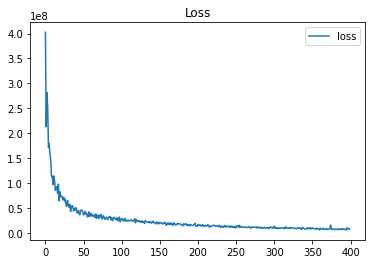

done 5 layers in 80.56ms
predict class: yaleB34
test image label: yaleB36
predict residuals label: 32
test residuals label: 34
[1458.38299504]


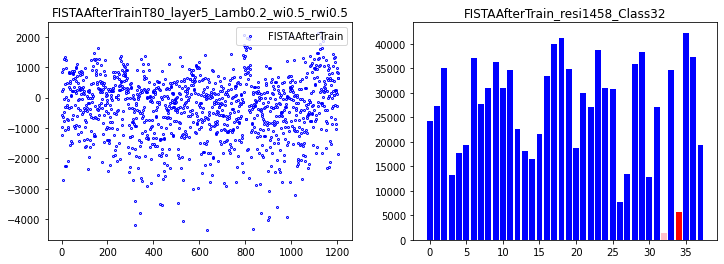

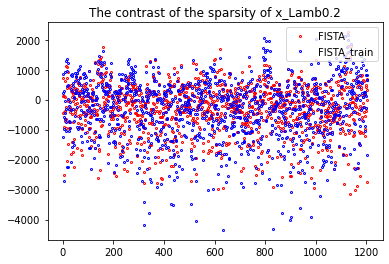

251
done 5 layers in 85.43ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[4445.81503993]


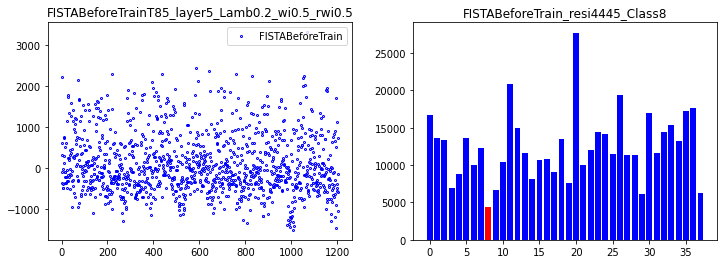

correct rate: 0.46875
correct rate: 0.46875
correct rate: 0.375
correct rate: 0.375
Epoch [ 10/100]: loss = 41409818.8951,   lambda [max:0.2403], [min:0.1639], 
Epoch [ 20/100]: loss = 29660082.4695,   lambda [max:0.2539], [min:0.1501], 
Epoch [ 30/100]: loss = 21147259.2265,   lambda [max:0.2661], [min:0.1416], 
Epoch [ 40/100]: loss = 16484328.9764,   lambda [max:0.2719], [min:0.1354], 
Epoch [ 50/100]: loss = 14828267.5368,   lambda [max:0.2758], [min:0.1312], 
Epoch [ 60/100]: loss = 9150224.7672,   lambda [max:0.2790], [min:0.1284], 
Epoch [ 70/100]: loss = 10325316.6038,   lambda [max:0.2809], [min:0.1258], 
Epoch [ 80/100]: loss = 8766664.4815,   lambda [max:0.2822], [min:0.1240], 
Epoch [ 90/100]: loss = 6818164.5181,   lambda [max:0.2845], [min:0.1236], 
correct rate: 0.34375
correct rate: 0.34375
correct rate: 0.25
correct rate: 0.34375
Epoch [100/100]: loss = 5998557.7923,   lambda [max:0.2847], [min:0.1227], 


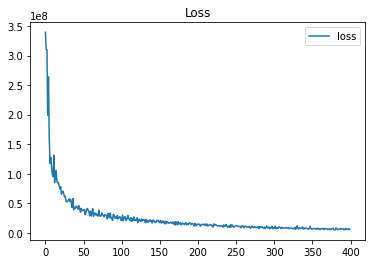

done 5 layers in 83.26ms
predict class: yaleB39
test image label: yaleB09
predict residuals label: 37
test residuals label: 8
[4382.78427968]


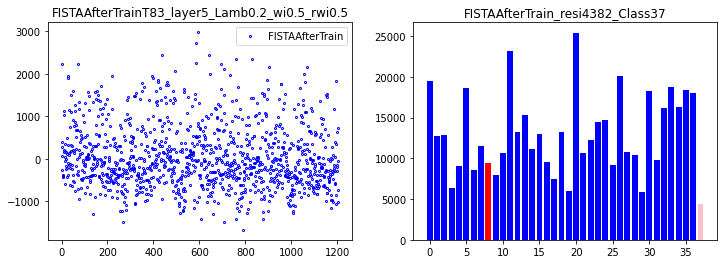

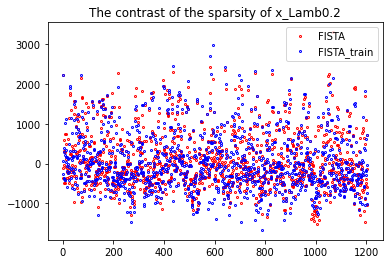

252
done 5 layers in 86.67ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[4656.14716689]


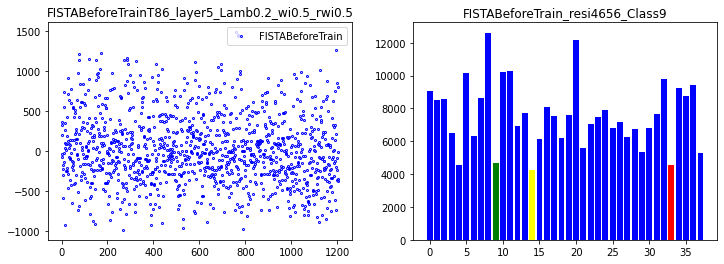

correct rate: 0.5
correct rate: 0.4375
correct rate: 0.3125
correct rate: 0.46875
Epoch [ 10/100]: loss = 41465140.8313,   lambda [max:0.2404], [min:0.1621], 
Epoch [ 20/100]: loss = 27260504.9552,   lambda [max:0.2495], [min:0.1470], 
Epoch [ 30/100]: loss = 24437430.5843,   lambda [max:0.2549], [min:0.1357], 
Epoch [ 40/100]: loss = 18699997.2897,   lambda [max:0.2584], [min:0.1258], 
Epoch [ 50/100]: loss = 15310963.3874,   lambda [max:0.2711], [min:0.1186], 
Epoch [ 60/100]: loss = 11220589.3182,   lambda [max:0.2801], [min:0.1125], 
Epoch [ 70/100]: loss = 10410507.0333,   lambda [max:0.2870], [min:0.1092], 
Epoch [ 80/100]: loss = 8683185.1724,   lambda [max:0.2927], [min:0.1056], 
Epoch [ 90/100]: loss = 9507605.6321,   lambda [max:0.2976], [min:0.1040], 
correct rate: 0.3125
correct rate: 0.25
correct rate: 0.3125
correct rate: 0.21875
Epoch [100/100]: loss = 5655264.2668,   lambda [max:0.3009], [min:0.1027], 


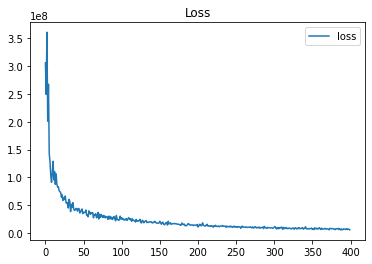

done 5 layers in 81.27ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[3900.52066481]


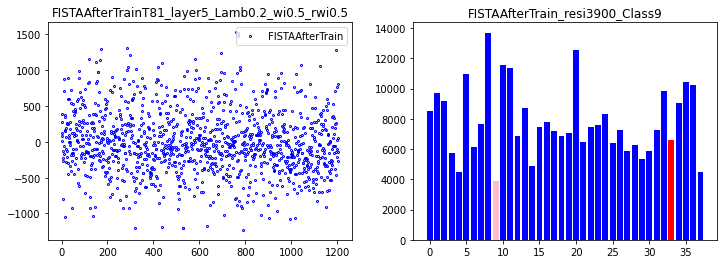

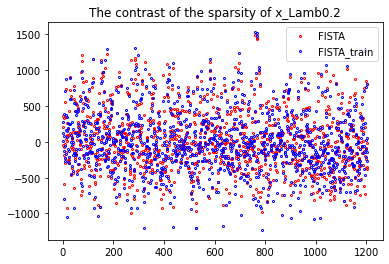

253
done 5 layers in 87.56ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[4966.88562122]


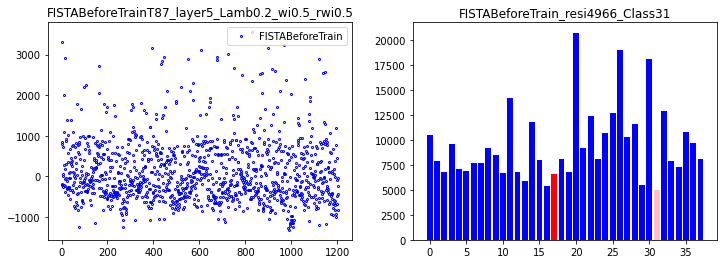

correct rate: 0.625
correct rate: 0.34375
correct rate: 0.3125
correct rate: 0.4375
Epoch [ 10/100]: loss = 45687491.5755,   lambda [max:0.2390], [min:0.1608], 
Epoch [ 20/100]: loss = 34753898.2628,   lambda [max:0.2497], [min:0.1551], 
Epoch [ 30/100]: loss = 25921975.5855,   lambda [max:0.2557], [min:0.1455], 
Epoch [ 40/100]: loss = 15742137.3791,   lambda [max:0.2594], [min:0.1394], 
Epoch [ 50/100]: loss = 15694769.6742,   lambda [max:0.2641], [min:0.1329], 
Epoch [ 60/100]: loss = 10657678.2745,   lambda [max:0.2664], [min:0.1300], 
Epoch [ 70/100]: loss = 10097737.0974,   lambda [max:0.2680], [min:0.1270], 
Epoch [ 80/100]: loss = 8446232.1555,   lambda [max:0.2689], [min:0.1263], 
Epoch [ 90/100]: loss = 7003063.9274,   lambda [max:0.2715], [min:0.1255], 
correct rate: 0.28125
correct rate: 0.3125
correct rate: 0.25
correct rate: 0.21875
Epoch [100/100]: loss = 5196917.5719,   lambda [max:0.2716], [min:0.1256], 


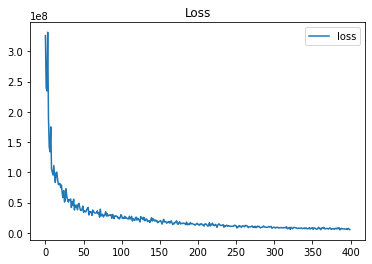

done 5 layers in 82.67ms
predict class: yaleB13
test image label: yaleB19
predict residuals label: 12
test residuals label: 17
[5669.12752413]


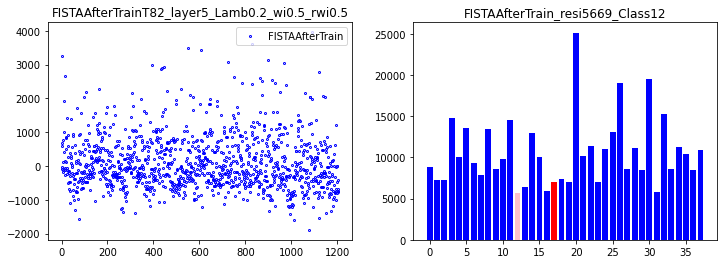

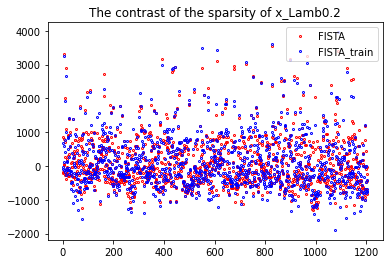

254
done 5 layers in 81.83ms
predict class: yaleB11
test image label: yaleB27
predict residuals label: 10
test residuals label: 25
[5465.57805095]


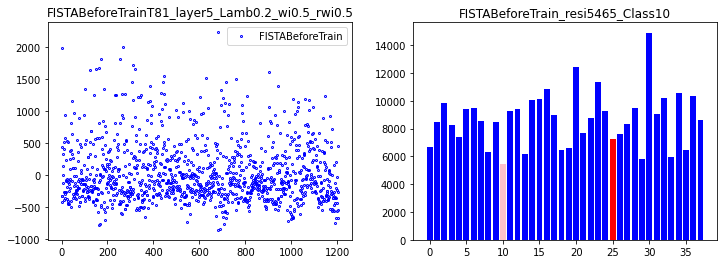

correct rate: 0.5
correct rate: 0.46875
correct rate: 0.4375
correct rate: 0.375
Epoch [ 10/100]: loss = 45577813.7207,   lambda [max:0.2380], [min:0.1753], 
Epoch [ 20/100]: loss = 30637654.2576,   lambda [max:0.2508], [min:0.1573], 
Epoch [ 30/100]: loss = 25318807.3887,   lambda [max:0.2552], [min:0.1529], 
Epoch [ 40/100]: loss = 17387370.1543,   lambda [max:0.2587], [min:0.1499], 
Epoch [ 50/100]: loss = 16097600.3616,   lambda [max:0.2628], [min:0.1446], 
Epoch [ 60/100]: loss = 10704625.5028,   lambda [max:0.2651], [min:0.1403], 
Epoch [ 70/100]: loss = 11037773.7016,   lambda [max:0.2680], [min:0.1380], 
Epoch [ 80/100]: loss = 8416106.3270,   lambda [max:0.2720], [min:0.1367], 
Epoch [ 90/100]: loss = 8223517.7917,   lambda [max:0.2784], [min:0.1363], 
correct rate: 0.28125
correct rate: 0.375
correct rate: 0.34375
correct rate: 0.28125
Epoch [100/100]: loss = 5321307.3442,   lambda [max:0.2779], [min:0.1355], 


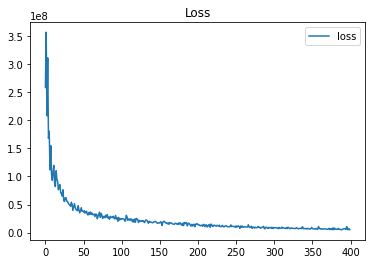

done 5 layers in 83.56ms
predict class: yaleB09
test image label: yaleB27
predict residuals label: 8
test residuals label: 25
[3228.4654039]


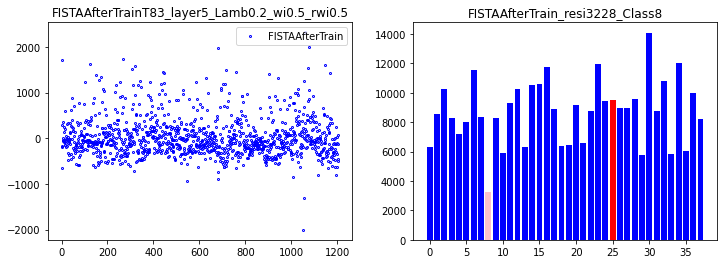

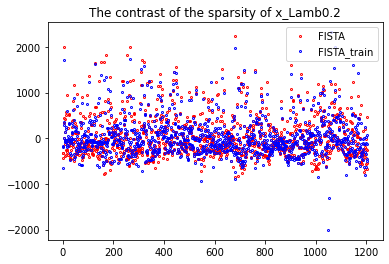

255
done 5 layers in 84.56ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[7226.71541855]


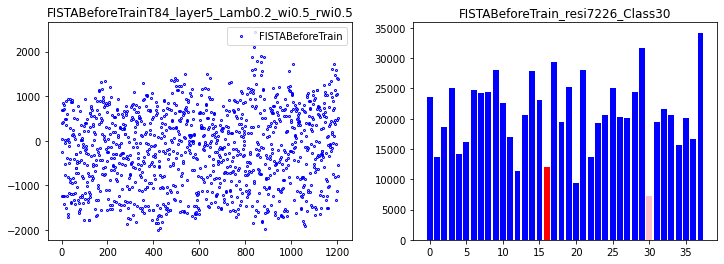

correct rate: 0.5
correct rate: 0.5625
correct rate: 0.40625
correct rate: 0.28125
Epoch [ 10/100]: loss = 41310388.7768,   lambda [max:0.2440], [min:0.1681], 
Epoch [ 20/100]: loss = 30337577.6006,   lambda [max:0.2565], [min:0.1491], 
Epoch [ 30/100]: loss = 24184879.9443,   lambda [max:0.2615], [min:0.1430], 
Epoch [ 40/100]: loss = 17762000.3984,   lambda [max:0.2644], [min:0.1396], 
Epoch [ 50/100]: loss = 15145535.6984,   lambda [max:0.2694], [min:0.1338], 
Epoch [ 60/100]: loss = 12263475.9008,   lambda [max:0.2740], [min:0.1299], 
Epoch [ 70/100]: loss = 10580357.2300,   lambda [max:0.2756], [min:0.1264], 
Epoch [ 80/100]: loss = 8797905.2671,   lambda [max:0.2801], [min:0.1252], 
Epoch [ 90/100]: loss = 6715339.6683,   lambda [max:0.2834], [min:0.1233], 
correct rate: 0.1875
correct rate: 0.3125
correct rate: 0.3125
correct rate: 0.3125
Epoch [100/100]: loss = 5496977.0220,   lambda [max:0.2862], [min:0.1222], 


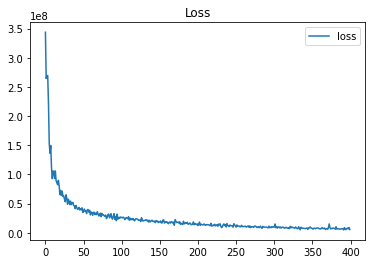

done 5 layers in 90.20ms
predict class: yaleB32
test image label: yaleB18
predict residuals label: 30
test residuals label: 16
[472.31953367]


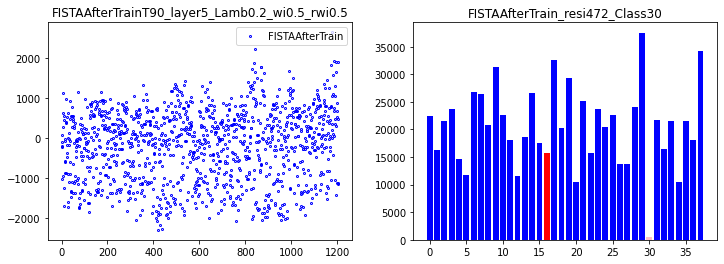

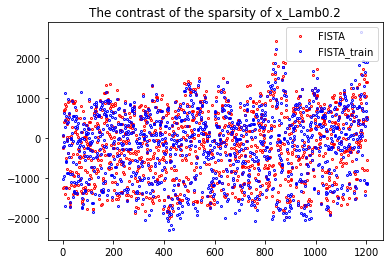

256
done 5 layers in 84.90ms
predict class: yaleB28
test image label: yaleB01
predict residuals label: 26
test residuals label: 0
[16822.34600901]


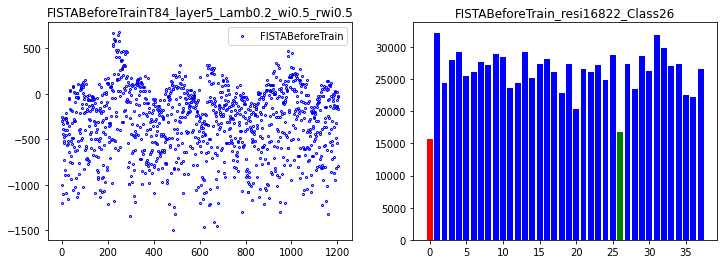

correct rate: 0.3125
correct rate: 0.34375
correct rate: 0.53125
correct rate: 0.5
Epoch [ 10/100]: loss = 48306194.0366,   lambda [max:0.2387], [min:0.1719], 
Epoch [ 20/100]: loss = 31587768.5467,   lambda [max:0.2515], [min:0.1567], 
Epoch [ 30/100]: loss = 20548404.3300,   lambda [max:0.2540], [min:0.1497], 
Epoch [ 40/100]: loss = 18083104.8940,   lambda [max:0.2556], [min:0.1459], 
Epoch [ 50/100]: loss = 14075187.1536,   lambda [max:0.2573], [min:0.1394], 
Epoch [ 60/100]: loss = 11317710.2695,   lambda [max:0.2623], [min:0.1352], 
Epoch [ 70/100]: loss = 12135001.9235,   lambda [max:0.2636], [min:0.1321], 
Epoch [ 80/100]: loss = 8808990.8613,   lambda [max:0.2673], [min:0.1298], 
Epoch [ 90/100]: loss = 7609704.7557,   lambda [max:0.2705], [min:0.1283], 
correct rate: 0.34375
correct rate: 0.15625
correct rate: 0.34375
correct rate: 0.28125
Epoch [100/100]: loss = 7236358.2888,   lambda [max:0.2730], [min:0.1281], 


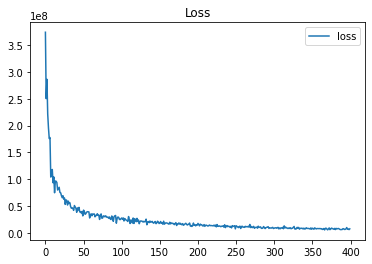

done 5 layers in 92.91ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[1858.53994418]


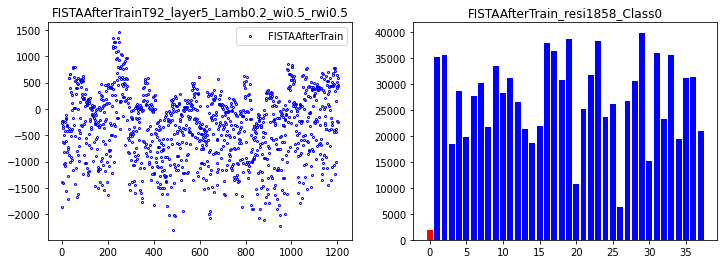

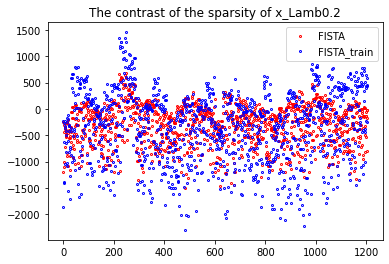

257
done 5 layers in 81.34ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[5129.02896833]


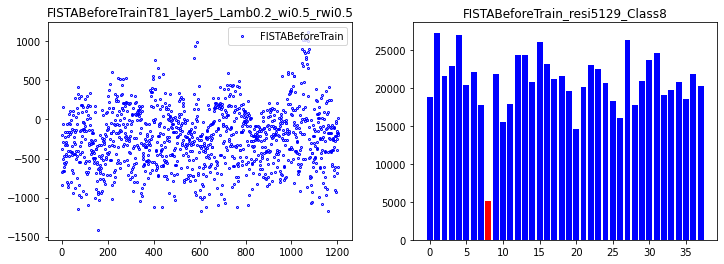

correct rate: 0.53125
correct rate: 0.46875
correct rate: 0.5
correct rate: 0.375
Epoch [ 10/100]: loss = 52508395.3974,   lambda [max:0.2431], [min:0.1691], 
Epoch [ 20/100]: loss = 29952652.5423,   lambda [max:0.2559], [min:0.1554], 
Epoch [ 30/100]: loss = 24709522.6281,   lambda [max:0.2621], [min:0.1461], 
Epoch [ 40/100]: loss = 14233362.9440,   lambda [max:0.2672], [min:0.1402], 
Epoch [ 50/100]: loss = 12639653.0830,   lambda [max:0.2697], [min:0.1350], 
Epoch [ 60/100]: loss = 11024556.8716,   lambda [max:0.2724], [min:0.1331], 
Epoch [ 70/100]: loss = 10842295.9705,   lambda [max:0.2742], [min:0.1302], 
Epoch [ 80/100]: loss = 7880478.1518,   lambda [max:0.2751], [min:0.1290], 
Epoch [ 90/100]: loss = 6987335.7925,   lambda [max:0.2788], [min:0.1303], 
correct rate: 0.34375
correct rate: 0.21875
correct rate: 0.375
correct rate: 0.34375
Epoch [100/100]: loss = 6129941.4969,   lambda [max:0.2810], [min:0.1298], 


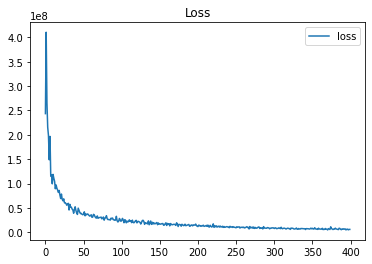

done 5 layers in 97.38ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[1482.88250029]


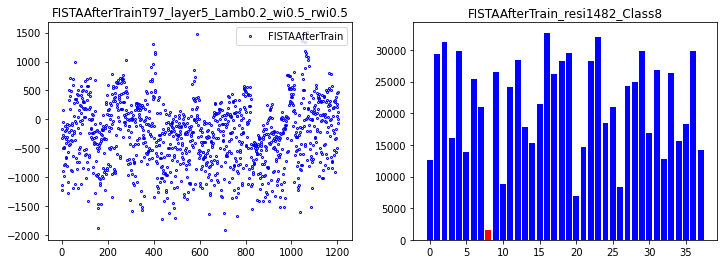

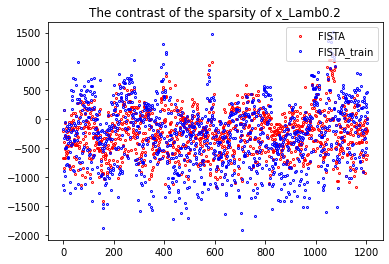

258
done 5 layers in 81.86ms
predict class: yaleB39
test image label: yaleB11
predict residuals label: 37
test residuals label: 10
[15796.90633677]


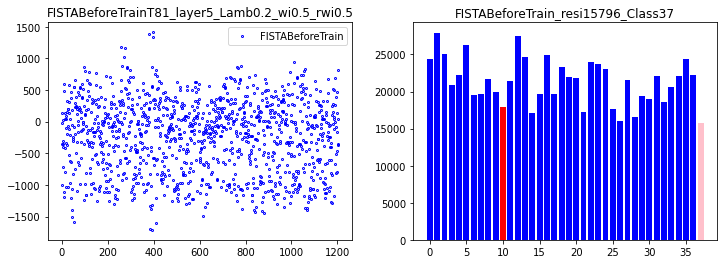

correct rate: 0.375
correct rate: 0.4375
correct rate: 0.625
correct rate: 0.3125
Epoch [ 10/100]: loss = 46618249.3057,   lambda [max:0.2412], [min:0.1721], 
Epoch [ 20/100]: loss = 32751834.7282,   lambda [max:0.2523], [min:0.1618], 
Epoch [ 30/100]: loss = 21557684.7405,   lambda [max:0.2609], [min:0.1497], 
Epoch [ 40/100]: loss = 18578414.4975,   lambda [max:0.2661], [min:0.1421], 
Epoch [ 50/100]: loss = 13303554.8940,   lambda [max:0.2678], [min:0.1369], 
Epoch [ 60/100]: loss = 13940554.2470,   lambda [max:0.2686], [min:0.1355], 
Epoch [ 70/100]: loss = 9750121.0055,   lambda [max:0.2701], [min:0.1346], 
Epoch [ 80/100]: loss = 7615301.6158,   lambda [max:0.2709], [min:0.1331], 
Epoch [ 90/100]: loss = 8569289.5427,   lambda [max:0.2716], [min:0.1344], 
correct rate: 0.21875
correct rate: 0.1875
correct rate: 0.375
correct rate: 0.3125
Epoch [100/100]: loss = 7826694.7907,   lambda [max:0.2715], [min:0.1343], 


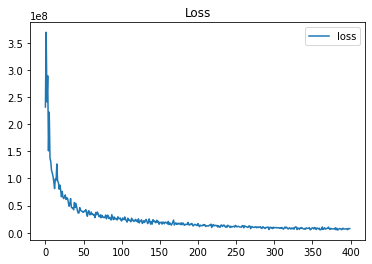

done 5 layers in 86.29ms
predict class: yaleB28
test image label: yaleB11
predict residuals label: 26
test residuals label: 10
[2616.64087622]


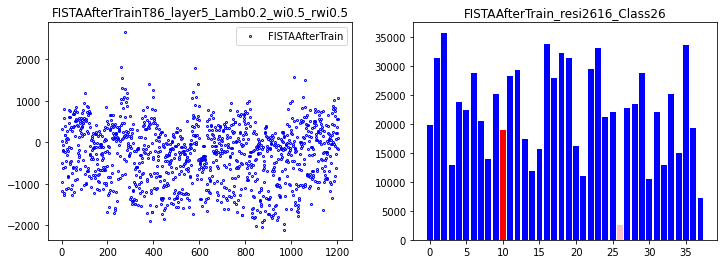

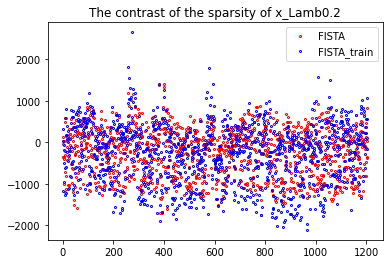

259
done 5 layers in 82.08ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[4730.73330457]


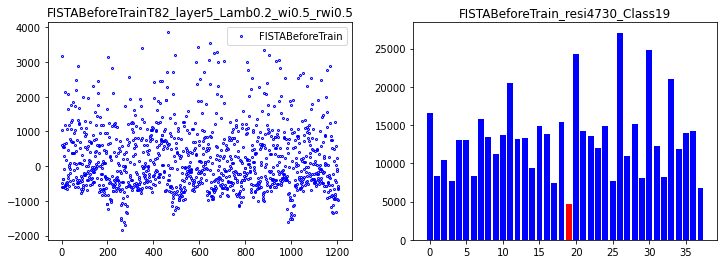

correct rate: 0.59375
correct rate: 0.375
correct rate: 0.3125
correct rate: 0.53125
Epoch [ 10/100]: loss = 48108177.5337,   lambda [max:0.2390], [min:0.1619], 
Epoch [ 20/100]: loss = 30358148.2633,   lambda [max:0.2504], [min:0.1600], 
Epoch [ 30/100]: loss = 21458595.7317,   lambda [max:0.2672], [min:0.1509], 
Epoch [ 40/100]: loss = 17337724.9900,   lambda [max:0.2744], [min:0.1447], 
Epoch [ 50/100]: loss = 16661421.5505,   lambda [max:0.2782], [min:0.1417], 
Epoch [ 60/100]: loss = 12105983.2740,   lambda [max:0.2813], [min:0.1370], 
Epoch [ 70/100]: loss = 10686054.5887,   lambda [max:0.2863], [min:0.1336], 
Epoch [ 80/100]: loss = 9612192.8628,   lambda [max:0.2902], [min:0.1313], 
Epoch [ 90/100]: loss = 7996457.3617,   lambda [max:0.2932], [min:0.1284], 
correct rate: 0.25
correct rate: 0.28125
correct rate: 0.21875
correct rate: 0.3125
Epoch [100/100]: loss = 7332325.8907,   lambda [max:0.2942], [min:0.1272], 


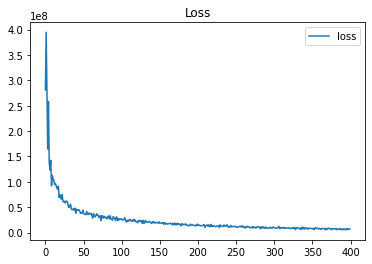

done 5 layers in 81.49ms
predict class: yaleB21
test image label: yaleB21
predict residuals label: 19
test residuals label: 19
[7350.46925078]


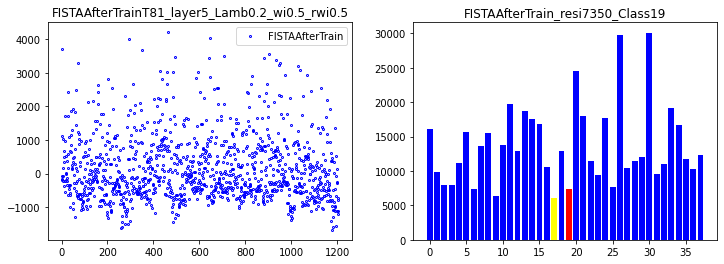

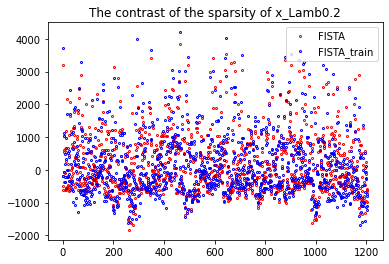

260
done 1 layers in 79.03ms
predict class: yaleB36
test image label: yaleB36
predict residuals label: 34
test residuals label: 34
[165030.03702222]


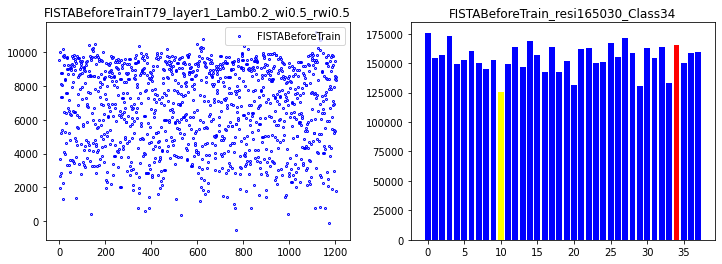

correct rate: 0.625
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.5
Epoch [ 10/100]: loss = 746906401.3322,   lambda [max:0.2628], [min:0.1810], 
Epoch [ 20/100]: loss = 354666019.0022,   lambda [max:0.3029], [min:0.1844], 
Epoch [ 30/100]: loss = 212691144.2765,   lambda [max:0.3353], [min:0.1845], 
Epoch [ 40/100]: loss = 157073900.0641,   lambda [max:0.3639], [min:0.1845], 
Epoch [ 50/100]: loss = 119697938.1844,   lambda [max:0.3901], [min:0.1845], 
Epoch [ 60/100]: loss = 116599284.6898,   lambda [max:0.4144], [min:0.1845], 
Epoch [ 70/100]: loss = 124174601.7576,   lambda [max:0.4373], [min:0.1845], 
Epoch [ 80/100]: loss = 114685124.7109,   lambda [max:0.4591], [min:0.1845], 
Epoch [ 90/100]: loss = 85586042.1269,   lambda [max:0.4799], [min:0.1846], 
correct rate: 0.09375
correct rate: 0.0625
correct rate: 0.03125
correct rate: 0.09375
Epoch [100/100]: loss = 79744577.3340,   lambda [max:0.4999], [min:0.1846], 


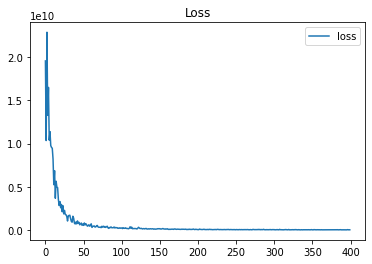

done 1 layers in 76.01ms
predict class: yaleB11
test image label: yaleB36
predict residuals label: 10
test residuals label: 34
[6049.09236351]


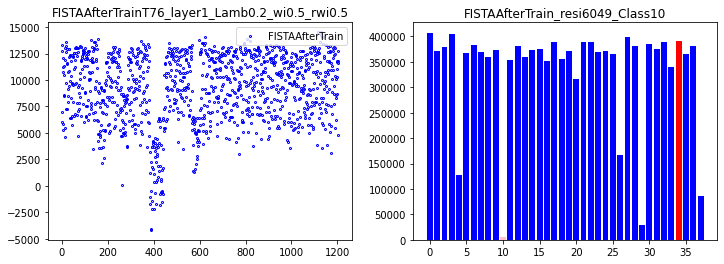

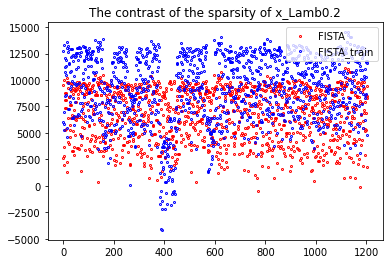

261
done 1 layers in 81.13ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[55240.64813281]


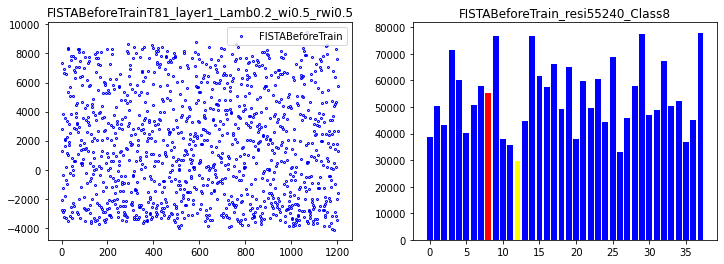

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.625
Epoch [ 10/100]: loss = 801904319.2191,   lambda [max:0.2629], [min:0.1667], 
Epoch [ 20/100]: loss = 345762073.3874,   lambda [max:0.3031], [min:0.1686], 
Epoch [ 30/100]: loss = 275649691.2131,   lambda [max:0.3356], [min:0.1709], 
Epoch [ 40/100]: loss = 222137867.9653,   lambda [max:0.3644], [min:0.1726], 
Epoch [ 50/100]: loss = 145607320.9177,   lambda [max:0.3905], [min:0.1734], 
Epoch [ 60/100]: loss = 130909829.6249,   lambda [max:0.4148], [min:0.1730], 
Epoch [ 70/100]: loss = 118889093.9035,   lambda [max:0.4376], [min:0.1743], 
Epoch [ 80/100]: loss = 97263627.4835,   lambda [max:0.4593], [min:0.1747], 
Epoch [ 90/100]: loss = 86212549.0204,   lambda [max:0.4801], [min:0.1753], 
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.125
Epoch [100/100]: loss = 123062066.6977,   lambda [max:0.5000], [min:0.1765], 


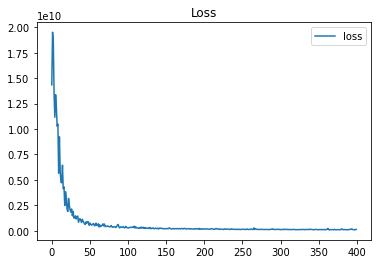

done 1 layers in 77.78ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[90473.05225265]


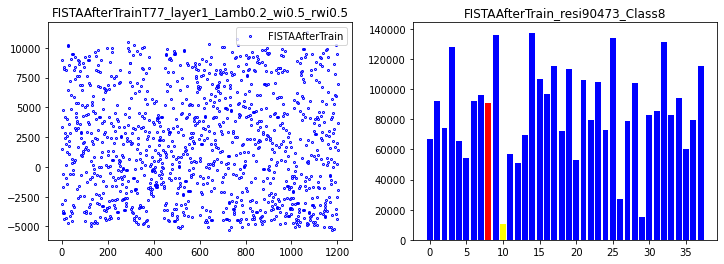

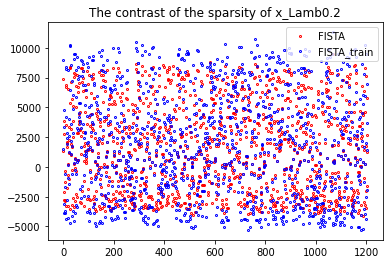

262
done 1 layers in 86.34ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[46018.76226547]


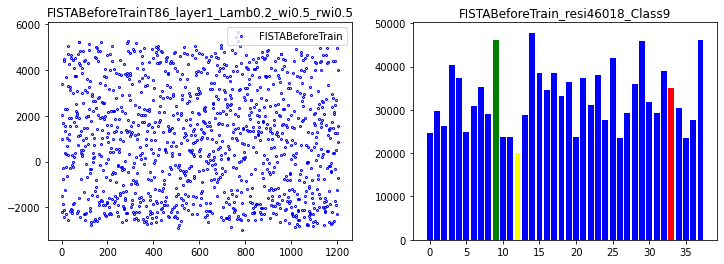

correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.53125
Epoch [ 10/100]: loss = 916373517.9772,   lambda [max:0.2630], [min:0.1692], 
Epoch [ 20/100]: loss = 455277783.8737,   lambda [max:0.3033], [min:0.1700], 
Epoch [ 30/100]: loss = 272697858.2103,   lambda [max:0.3359], [min:0.1721], 
Epoch [ 40/100]: loss = 204054614.5646,   lambda [max:0.3646], [min:0.1726], 
Epoch [ 50/100]: loss = 173064599.9267,   lambda [max:0.3908], [min:0.1750], 
Epoch [ 60/100]: loss = 194241275.5986,   lambda [max:0.4151], [min:0.1749], 
Epoch [ 70/100]: loss = 141472184.3890,   lambda [max:0.4380], [min:0.1763], 
Epoch [ 80/100]: loss = 86603712.6564,   lambda [max:0.4598], [min:0.1768], 
Epoch [ 90/100]: loss = 81309915.0694,   lambda [max:0.4805], [min:0.1772], 
correct rate: 0.0625
correct rate: 0.0
correct rate: 0.1875
correct rate: 0.09375
Epoch [100/100]: loss = 99955448.4491,   lambda [max:0.5005], [min:0.1774], 


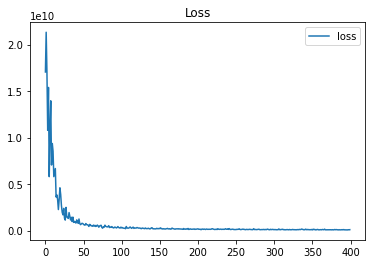

done 1 layers in 73.28ms
predict class: yaleB10
test image label: yaleB35
predict residuals label: 9
test residuals label: 33
[65703.06530666]


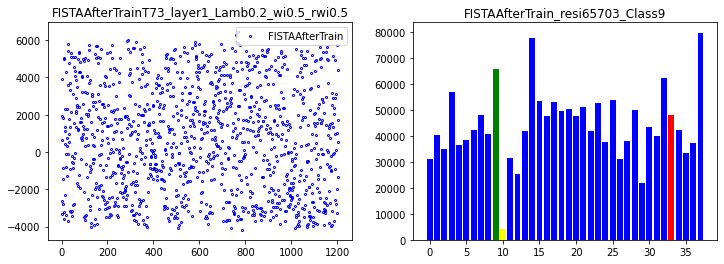

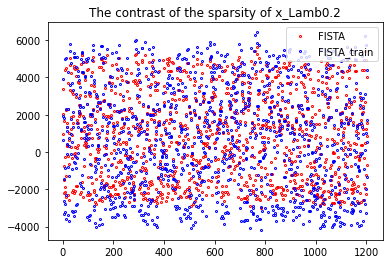

263
done 1 layers in 77.84ms
predict class: yaleB33
test image label: yaleB19
predict residuals label: 31
test residuals label: 17
[27569.91323808]


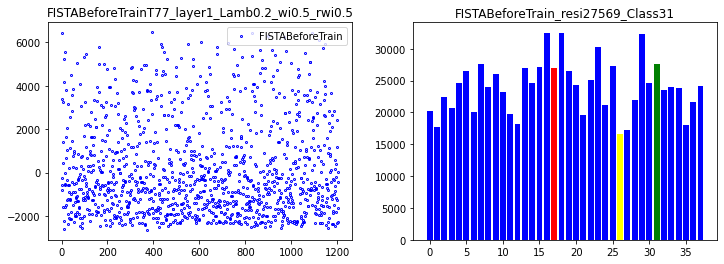

correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.59375
correct rate: 0.625
Epoch [ 10/100]: loss = 1088029376.7971,   lambda [max:0.2629], [min:0.1689], 
Epoch [ 20/100]: loss = 278898761.3579,   lambda [max:0.3031], [min:0.1681], 
Epoch [ 30/100]: loss = 274759594.6125,   lambda [max:0.3357], [min:0.1682], 
Epoch [ 40/100]: loss = 195805702.9600,   lambda [max:0.3645], [min:0.1682], 
Epoch [ 50/100]: loss = 135613753.0672,   lambda [max:0.3908], [min:0.1679], 
Epoch [ 60/100]: loss = 100724791.7438,   lambda [max:0.4151], [min:0.1689], 
Epoch [ 70/100]: loss = 121659629.6082,   lambda [max:0.4381], [min:0.1689], 
Epoch [ 80/100]: loss = 85771391.8538,   lambda [max:0.4599], [min:0.1688], 
Epoch [ 90/100]: loss = 77834012.7760,   lambda [max:0.4808], [min:0.1686], 
correct rate: 0.125
correct rate: 0.125
correct rate: 0.09375
correct rate: 0.0625
Epoch [100/100]: loss = 85003317.0535,   lambda [max:0.5009], [min:0.1685], 


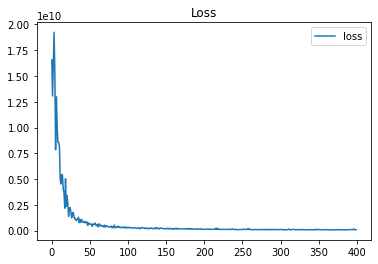

done 1 layers in 85.47ms
predict class: yaleB15
test image label: yaleB19
predict residuals label: 13
test residuals label: 17
[46692.90159242]


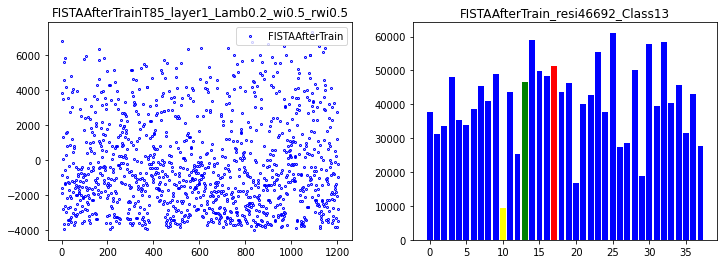

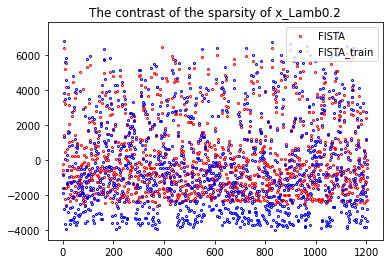

264
done 1 layers in 76.53ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[31029.64471825]


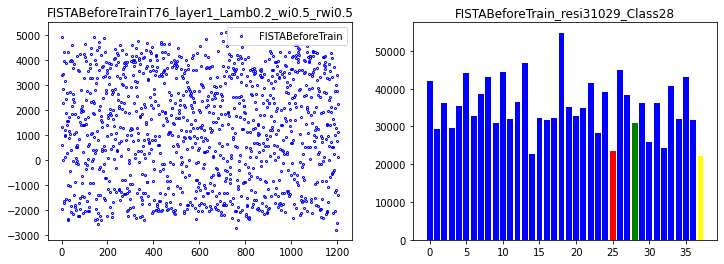

correct rate: 0.53125
correct rate: 0.5625
correct rate: 0.59375
correct rate: 0.78125
Epoch [ 10/100]: loss = 1196789770.3489,   lambda [max:0.2628], [min:0.1668], 
Epoch [ 20/100]: loss = 412828759.3375,   lambda [max:0.3029], [min:0.1689], 
Epoch [ 30/100]: loss = 356650509.9834,   lambda [max:0.3354], [min:0.1679], 
Epoch [ 40/100]: loss = 222960503.5283,   lambda [max:0.3641], [min:0.1681], 
Epoch [ 50/100]: loss = 202571431.3131,   lambda [max:0.3901], [min:0.1664], 
Epoch [ 60/100]: loss = 135552457.8754,   lambda [max:0.4144], [min:0.1646], 
Epoch [ 70/100]: loss = 135904439.4779,   lambda [max:0.4372], [min:0.1639], 
Epoch [ 80/100]: loss = 114634828.7237,   lambda [max:0.4589], [min:0.1622], 
Epoch [ 90/100]: loss = 144294837.8979,   lambda [max:0.4796], [min:0.1619], 
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.03125
correct rate: 0.09375
Epoch [100/100]: loss = 98577443.4902,   lambda [max:0.4995], [min:0.1614], 


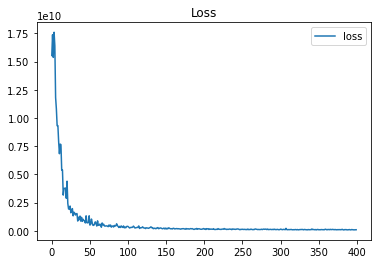

done 1 layers in 82.54ms
predict class: yaleB30
test image label: yaleB27
predict residuals label: 28
test residuals label: 25
[51577.59125179]


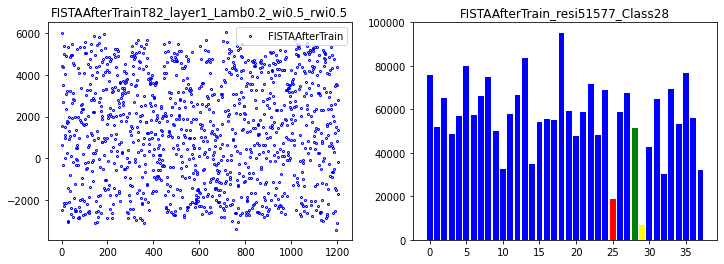

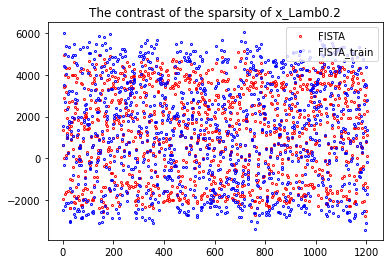

265
done 1 layers in 77.14ms
predict class: yaleB18
test image label: yaleB18
predict residuals label: 16
test residuals label: 16
[117197.32544141]


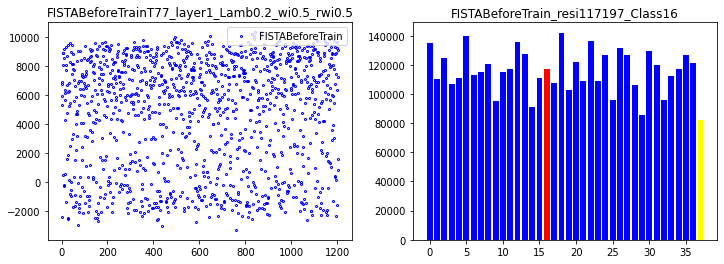

correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.46875
Epoch [ 10/100]: loss = 934718020.9509,   lambda [max:0.2630], [min:0.1692], 
Epoch [ 20/100]: loss = 295503728.1688,   lambda [max:0.3032], [min:0.1709], 
Epoch [ 30/100]: loss = 201464605.3805,   lambda [max:0.3358], [min:0.1701], 
Epoch [ 40/100]: loss = 219743787.9451,   lambda [max:0.3646], [min:0.1697], 
Epoch [ 50/100]: loss = 165391279.1409,   lambda [max:0.3908], [min:0.1702], 
Epoch [ 60/100]: loss = 109520102.3195,   lambda [max:0.4151], [min:0.1695], 
Epoch [ 70/100]: loss = 107310030.4831,   lambda [max:0.4381], [min:0.1688], 
Epoch [ 80/100]: loss = 92972470.1494,   lambda [max:0.4599], [min:0.1680], 
Epoch [ 90/100]: loss = 79246063.6469,   lambda [max:0.4807], [min:0.1678], 
correct rate: 0.03125
correct rate: 0.0625
correct rate: 0.0625
correct rate: 0.03125
Epoch [100/100]: loss = 88355545.9801,   lambda [max:0.5008], [min:0.1672], 


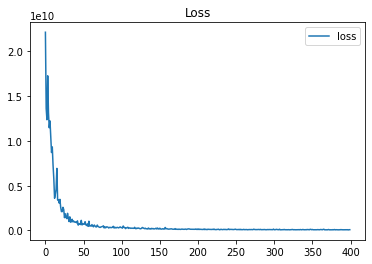

done 1 layers in 78.22ms
predict class: yaleB11
test image label: yaleB18
predict residuals label: 10
test residuals label: 16
[5196.11334452]


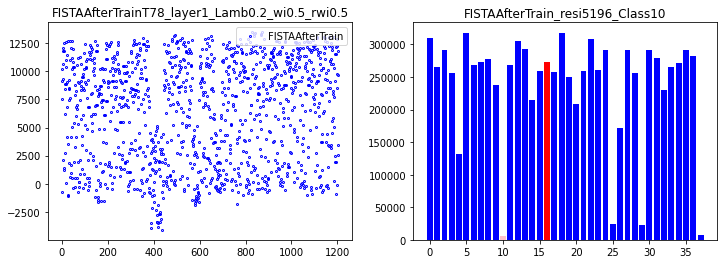

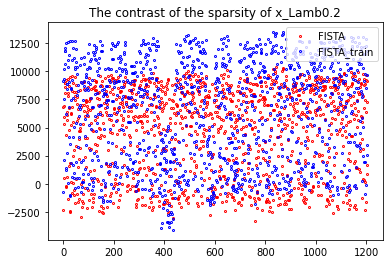

266
done 1 layers in 77.33ms
predict class: yaleB01
test image label: yaleB01
predict residuals label: 0
test residuals label: 0
[207823.21052799]


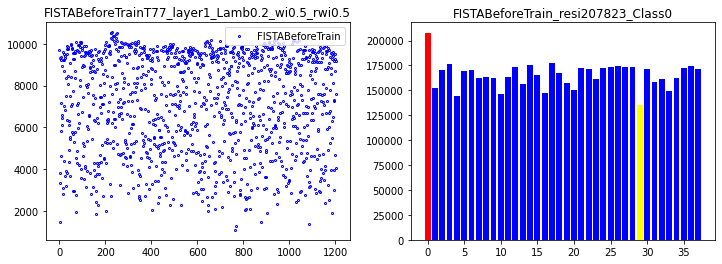

correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.53125
Epoch [ 10/100]: loss = 1196964530.5899,   lambda [max:0.2631], [min:0.1694], 
Epoch [ 20/100]: loss = 372752899.3704,   lambda [max:0.3034], [min:0.1680], 
Epoch [ 30/100]: loss = 261034672.9065,   lambda [max:0.3359], [min:0.1684], 
Epoch [ 40/100]: loss = 236295340.6111,   lambda [max:0.3647], [min:0.1678], 
Epoch [ 50/100]: loss = 164453500.8622,   lambda [max:0.3909], [min:0.1691], 
Epoch [ 60/100]: loss = 142476245.3239,   lambda [max:0.4152], [min:0.1685], 
Epoch [ 70/100]: loss = 255280163.2791,   lambda [max:0.4381], [min:0.1690], 
Epoch [ 80/100]: loss = 106547316.8022,   lambda [max:0.4599], [min:0.1698], 
Epoch [ 90/100]: loss = 91847397.7494,   lambda [max:0.4808], [min:0.1691], 
correct rate: 0.0625
correct rate: 0.09375
correct rate: 0.03125
correct rate: 0.0625
Epoch [100/100]: loss = 130694779.2168,   lambda [max:0.5008], [min:0.1697], 


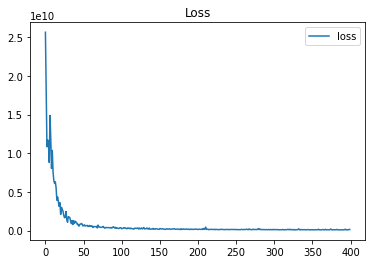

done 1 layers in 76.73ms
predict class: yaleB31
test image label: yaleB01
predict residuals label: 29
test residuals label: 0
[7103.51028718]


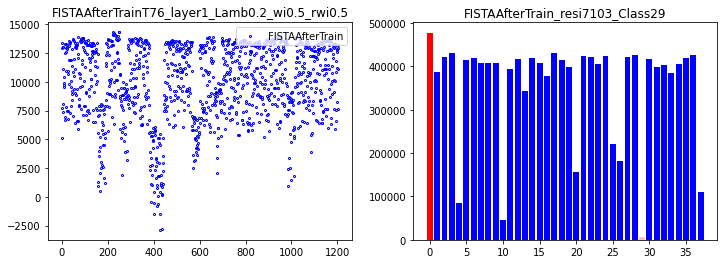

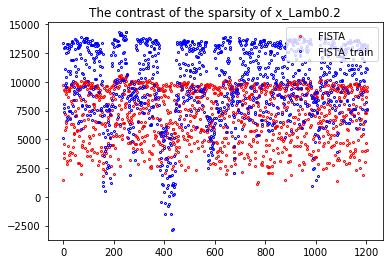

267
done 1 layers in 76.28ms
predict class: yaleB09
test image label: yaleB09
predict residuals label: 8
test residuals label: 8
[144025.71959696]


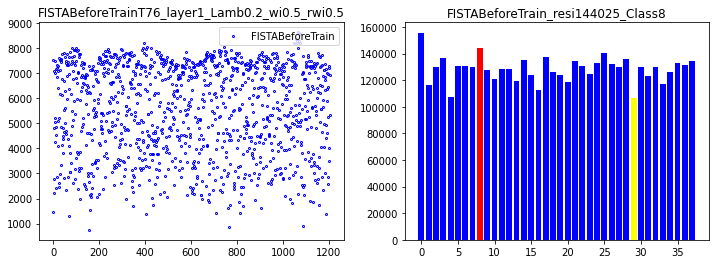

correct rate: 0.8125
correct rate: 0.5
correct rate: 0.65625
correct rate: 0.59375
Epoch [ 10/100]: loss = 676553553.7664,   lambda [max:0.2629], [min:0.1688], 
Epoch [ 20/100]: loss = 696714048.1826,   lambda [max:0.3031], [min:0.1714], 
Epoch [ 30/100]: loss = 268172342.0030,   lambda [max:0.3355], [min:0.1699], 
Epoch [ 40/100]: loss = 150774941.6387,   lambda [max:0.3641], [min:0.1692], 
Epoch [ 50/100]: loss = 123254436.1632,   lambda [max:0.3902], [min:0.1682], 
Epoch [ 60/100]: loss = 115913943.6286,   lambda [max:0.4144], [min:0.1673], 
Epoch [ 70/100]: loss = 109453404.3209,   lambda [max:0.4373], [min:0.1674], 
Epoch [ 80/100]: loss = 78699304.0510,   lambda [max:0.4590], [min:0.1671], 
Epoch [ 90/100]: loss = 81592300.0562,   lambda [max:0.4798], [min:0.1669], 
correct rate: 0.0625
correct rate: 0.0
correct rate: 0.15625
correct rate: 0.0
Epoch [100/100]: loss = 71642260.4523,   lambda [max:0.4998], [min:0.1667], 


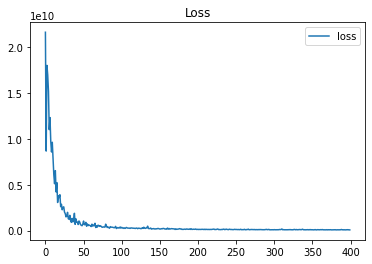

done 1 layers in 81.16ms
predict class: yaleB11
test image label: yaleB09
predict residuals label: 10
test residuals label: 8
[5240.29524822]


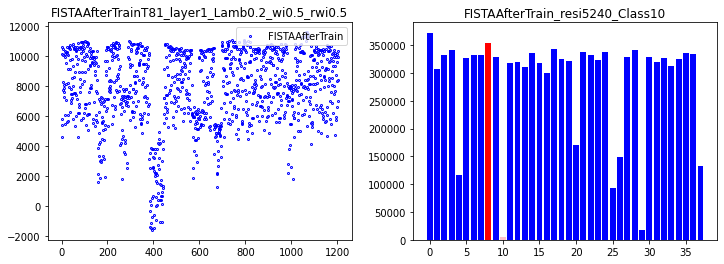

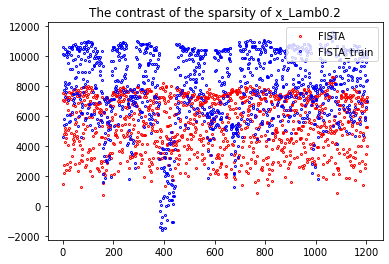

268
done 1 layers in 75.86ms
predict class: yaleB30
test image label: yaleB11
predict residuals label: 28
test residuals label: 10
[140785.93102603]


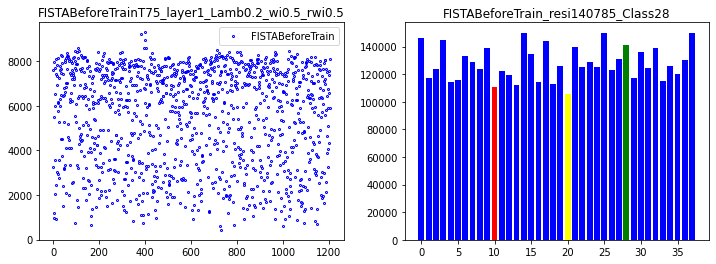

correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.5
Epoch [ 10/100]: loss = 700207648.7814,   lambda [max:0.2628], [min:0.1780], 
Epoch [ 20/100]: loss = 461254345.1291,   lambda [max:0.3025], [min:0.1818], 
Epoch [ 30/100]: loss = 277333787.3169,   lambda [max:0.3344], [min:0.1830], 
Epoch [ 40/100]: loss = 219399705.2930,   lambda [max:0.3625], [min:0.1831], 
Epoch [ 50/100]: loss = 186410461.7343,   lambda [max:0.3882], [min:0.1832], 
Epoch [ 60/100]: loss = 161753090.2755,   lambda [max:0.4121], [min:0.1827], 
Epoch [ 70/100]: loss = 134353746.1449,   lambda [max:0.4345], [min:0.1833], 
Epoch [ 80/100]: loss = 115648963.0102,   lambda [max:0.4559], [min:0.1834], 
Epoch [ 90/100]: loss = 94583921.0006,   lambda [max:0.4762], [min:0.1835], 
correct rate: 0.09375
correct rate: 0.0
correct rate: 0.03125
correct rate: 0.03125
Epoch [100/100]: loss = 92366681.9050,   lambda [max:0.4959], [min:0.1836], 


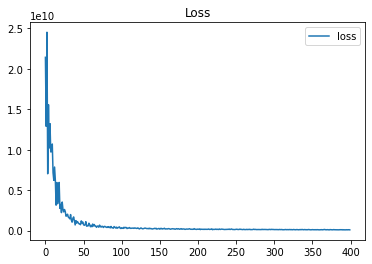

done 1 layers in 73.50ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[5383.71166001]


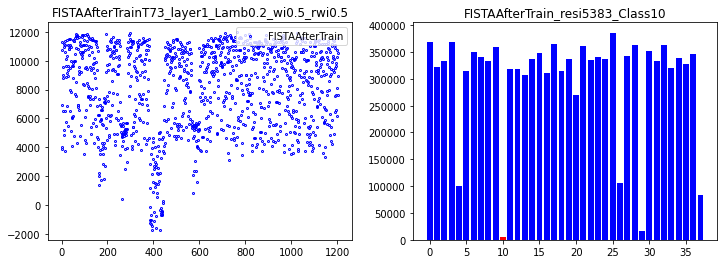

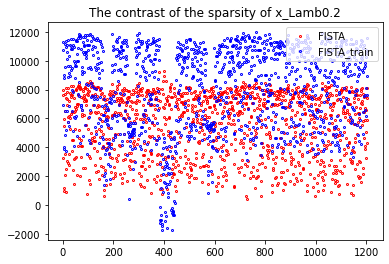

269
done 1 layers in 77.33ms
predict class: yaleB27
test image label: yaleB21
predict residuals label: 25
test residuals label: 19
[56893.9299482]


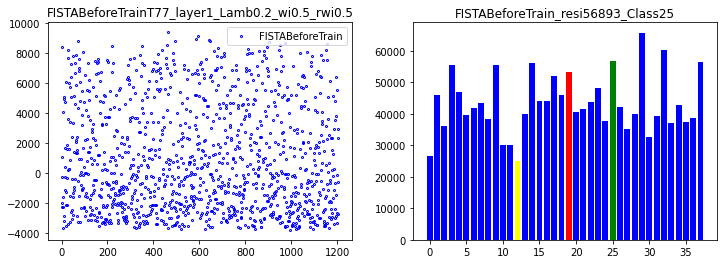

correct rate: 0.53125
correct rate: 0.8125
correct rate: 0.625
correct rate: 0.625
Epoch [ 10/100]: loss = 863102516.1094,   lambda [max:0.2629], [min:0.1675], 
Epoch [ 20/100]: loss = 550833390.4879,   lambda [max:0.3032], [min:0.1692], 
Epoch [ 30/100]: loss = 220402259.1309,   lambda [max:0.3358], [min:0.1692], 
Epoch [ 40/100]: loss = 160742194.3528,   lambda [max:0.3646], [min:0.1687], 
Epoch [ 50/100]: loss = 122340391.8289,   lambda [max:0.3910], [min:0.1685], 
Epoch [ 60/100]: loss = 88934009.6669,   lambda [max:0.4155], [min:0.1685], 
Epoch [ 70/100]: loss = 134384702.9321,   lambda [max:0.4386], [min:0.1680], 
Epoch [ 80/100]: loss = 79128170.0166,   lambda [max:0.4606], [min:0.1681], 
Epoch [ 90/100]: loss = 72981228.5039,   lambda [max:0.4815], [min:0.1680], 
correct rate: 0.03125
correct rate: 0.09375
correct rate: 0.0
correct rate: 0.125
Epoch [100/100]: loss = 79563928.9823,   lambda [max:0.5017], [min:0.1681], 


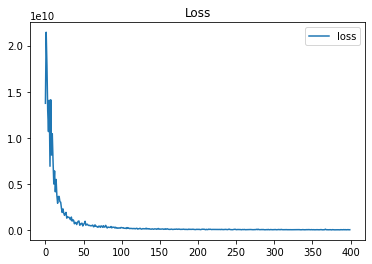

done 1 layers in 79.38ms
predict class: yaleB31
test image label: yaleB21
predict residuals label: 29
test residuals label: 19
[59637.04057894]


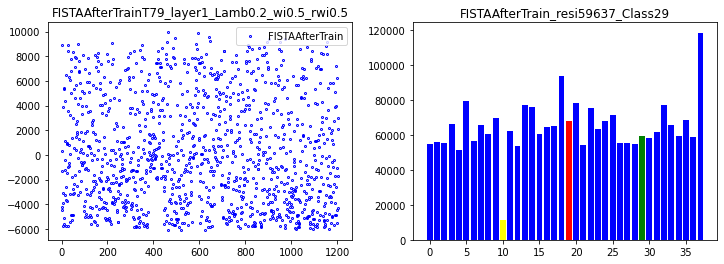

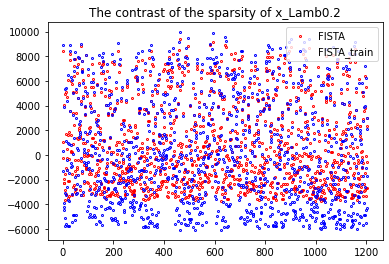

270


In [32]:
cout = 0
tit = "FISTA"
rwi = 0.5
for wi in w:
  #for rwi in rew:
    for l in la:
      lam = np.ones((Dn,1)) * l
      for lay in layer:
        for i in range(10):
          input_y = input_y_example[:,i]
          input_y_label = val_example_label[i]
          input_y = tf.convert_to_tensor(input_y)
          input_y = tf.reshape(input_y,(input_y.shape[0],1))

          # plot 1
          model_obj = model_choose(tit, lay, lam, 0)
          x_model = model_test(model_obj, input_y, input_y_label, lay, l, wi, rwi, tit+"BeforeTrain")
        
          # train
          train(model_obj, l, wi, rwi, tit, cout)
          # plot after train
          x_model_tr = model_test(model_obj, input_y, input_y_label, lay, l, wi,rwi, tit + "AfterTrain")
          # plot contrast of before train and after train
          x_p = [x_model, x_model_tr]
          title_p = [tit, tit+"_train"]
          co_p = ['red', 'blue']
          for o_x, o_tit, o_co in zip(x_p, title_p, co_p):
            plt.plot(np.arange(o_x.shape[0]), o_x, 'ro', mfc = 'None', markersize=2, mec=o_co, mew=1, label=o_tit)
            plt.legend(loc= 'upper right')
          plt.title("The contrast of the sparsity of x" + '_Lamb' + str(l))
          plt.savefig(savePath +'/' + tit + 'Contrast_layer' + str(lay) + '_Lamb' + str(la) +"_wi"+ str(wi)+"_Rwi"+ str(rwi) + '.png')
          plt.show()

          cout = cout+1
          print(cout)    


In [33]:
outPath = '/tmp/savezip'
if not os.path.exists(outPath):
  print(outPath)
  os.makedirs(outPath)
  print('create' + outPath + 'success！\n')
zip_path(savePath, outPath, 'save'+class_to_num[0] + '.zip')

/tmp/savezip
create/tmp/savezipsuccess！



'/tmp/savezip/saveyaleB01.zip'

### testing1 for FISTA Rwi and wi == 100, 10 lamb == 10

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 118.84ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6135.43966325]


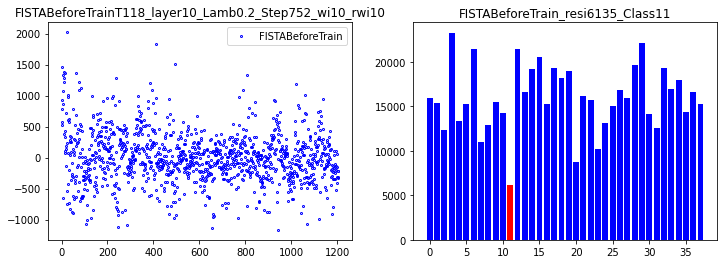

correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 401070380.8688,   lambda [max:0.1596], [min:0.1526], 
Epoch [ 20/100]: loss = 59423778.5312,   lambda [max:0.1343], [min:0.1185], 
Epoch [ 30/100]: loss = 37611963.7349,   lambda [max:0.1156], [min:0.0948], 
Epoch [ 40/100]: loss = 23128415.9576,   lambda [max:0.0988], [min:0.0728], 
Epoch [ 50/100]: loss = 15147278.7701,   lambda [max:0.0829], [min:0.0516], 
Epoch [ 60/100]: loss = 12222422.1372,   lambda [max:0.0678], [min:0.0316], 
Epoch [ 70/100]: loss = 10304515.2032,   lambda [max:0.0530], [min:0.0124], 
Epoch [ 80/100]: loss = 8176809.8342,   lambda [max:0.0387], [min:-0.0061], 
Epoch [ 90/100]: loss = 6951554.3915,   lambda [max:0.0246], [min:-0.0240], 
correct rate: 0.90625
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.625
Epoch [100/100]: loss = 6138852.2989,   lambda [max:0.0110], [min:-0.0414], 


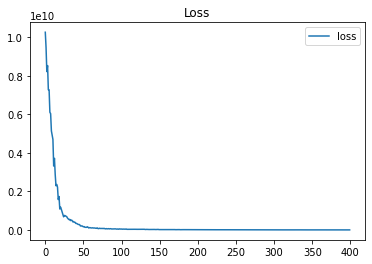

done 10 layers in 130.93ms
predict class: yaleB25
test image label: yaleB12
predict residuals label: 23
test residuals label: 11
[13530.42791961]


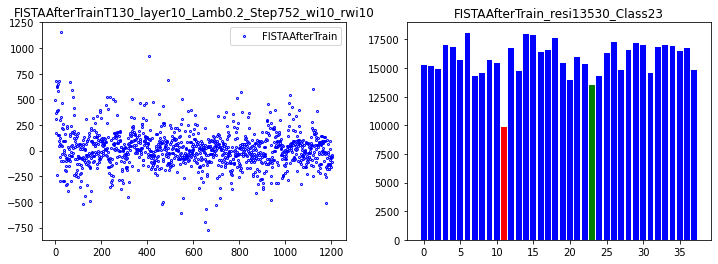

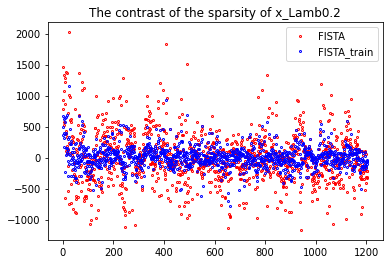

1


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 104.41ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6904.23254266]


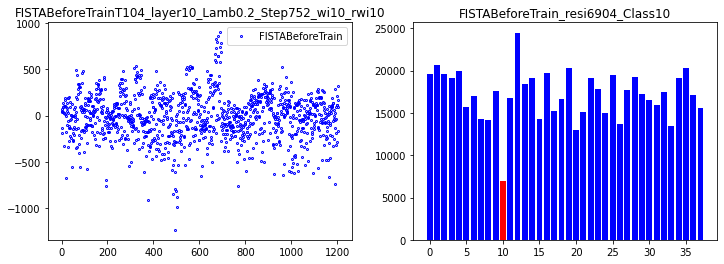

correct rate: 0.75
correct rate: 0.75
correct rate: 0.53125
correct rate: 0.6875
Epoch [ 10/100]: loss = 328939487.9325,   lambda [max:0.1507], [min:0.1426], 
Epoch [ 20/100]: loss = 45491527.1102,   lambda [max:0.1222], [min:0.1043], 
Epoch [ 30/100]: loss = 23405170.2834,   lambda [max:0.1007], [min:0.0736], 
Epoch [ 40/100]: loss = 14805425.5097,   lambda [max:0.0811], [min:0.0465], 
Epoch [ 50/100]: loss = 11566926.6362,   lambda [max:0.0627], [min:0.0217], 
Epoch [ 60/100]: loss = 9360192.3515,   lambda [max:0.0452], [min:-0.0014], 
Epoch [ 70/100]: loss = 7128779.1127,   lambda [max:0.0282], [min:-0.0232], 
Epoch [ 80/100]: loss = 6535844.0059,   lambda [max:0.0118], [min:-0.0440], 
Epoch [ 90/100]: loss = 5507886.4174,   lambda [max:-0.0042], [min:-0.0639], 
correct rate: 0.625
correct rate: 0.8125
correct rate: 0.625
correct rate: 0.71875
Epoch [100/100]: loss = 4273110.4199,   lambda [max:-0.0198], [min:-0.0831], 


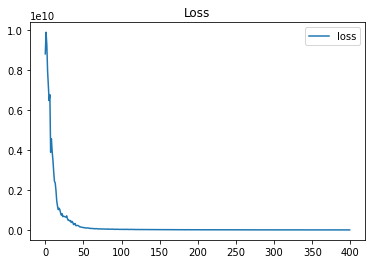

done 10 layers in 116.34ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[10861.46544239]


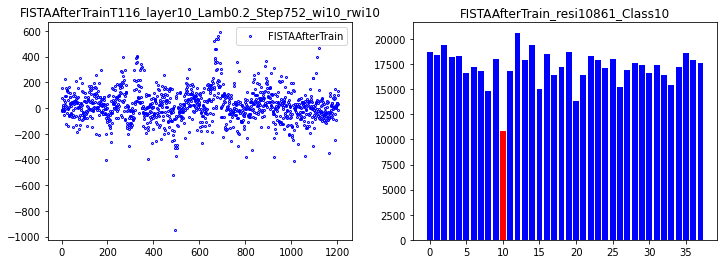

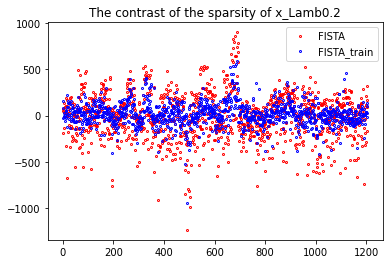

2


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 121.05ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.11572183]


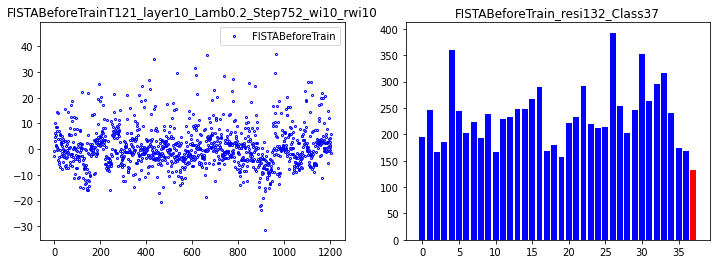

correct rate: 0.75
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.625
Epoch [ 10/100]: loss = 183413392.0046,   lambda [max:0.1457], [min:0.1365], 
Epoch [ 20/100]: loss = 42670663.9327,   lambda [max:0.1152], [min:0.0952], 
Epoch [ 30/100]: loss = 19468077.3906,   lambda [max:0.0920], [min:0.0612], 
Epoch [ 40/100]: loss = 13251821.2384,   lambda [max:0.0706], [min:0.0309], 
Epoch [ 50/100]: loss = 10063774.1448,   lambda [max:0.0507], [min:0.0034], 
Epoch [ 60/100]: loss = 7961398.5830,   lambda [max:0.0315], [min:-0.0219], 
Epoch [ 70/100]: loss = 5716133.1114,   lambda [max:0.0132], [min:-0.0456], 
Epoch [ 80/100]: loss = 5693495.0482,   lambda [max:-0.0045], [min:-0.0680], 
Epoch [ 90/100]: loss = 4266119.2971,   lambda [max:-0.0217], [min:-0.0893], 
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.71875
Epoch [100/100]: loss = 3725811.1831,   lambda [max:-0.0384], [min:-0.1098], 


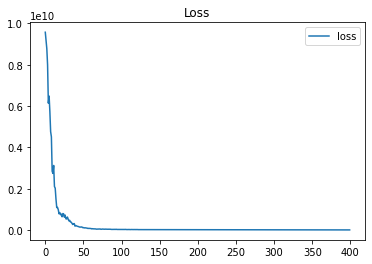

done 10 layers in 119.92ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[170.34751172]


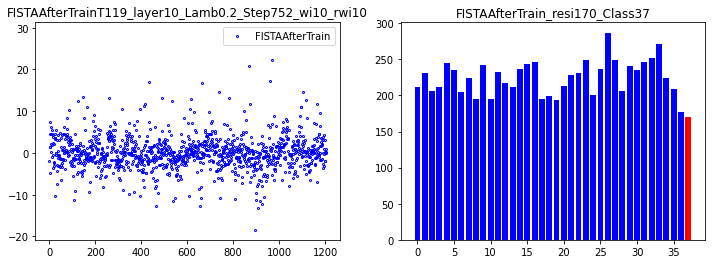

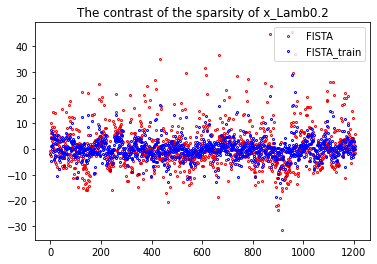

3


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 104.06ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4726.46574361]


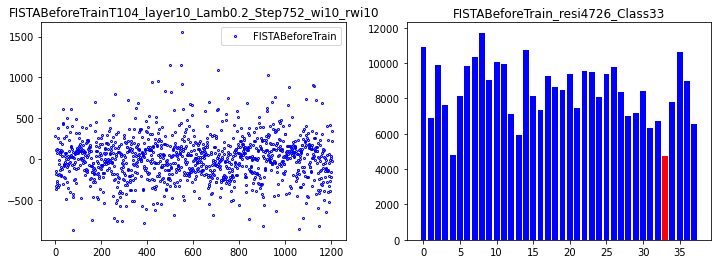

correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.71875
Epoch [ 10/100]: loss = 230856169.3587,   lambda [max:0.1430], [min:0.1323], 
Epoch [ 20/100]: loss = 32804227.5109,   lambda [max:0.1121], [min:0.0883], 
Epoch [ 30/100]: loss = 17737220.1671,   lambda [max:0.0877], [min:0.0524], 
Epoch [ 40/100]: loss = 12045495.6202,   lambda [max:0.0654], [min:0.0209], 
Epoch [ 50/100]: loss = 9004096.4050,   lambda [max:0.0444], [min:-0.0074], 
Epoch [ 60/100]: loss = 7051153.7027,   lambda [max:0.0244], [min:-0.0335], 
Epoch [ 70/100]: loss = 5431973.6943,   lambda [max:0.0052], [min:-0.0579], 
Epoch [ 80/100]: loss = 5047408.5116,   lambda [max:-0.0132], [min:-0.0808], 
Epoch [ 90/100]: loss = 4427871.8947,   lambda [max:-0.0311], [min:-0.1027], 
correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.8125
correct rate: 0.65625
Epoch [100/100]: loss = 3854244.5819,   lambda [max:-0.0486], [min:-0.1236], 


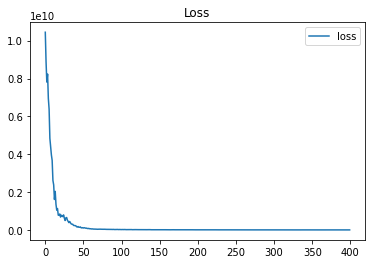

done 10 layers in 109.95ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6847.28969278]


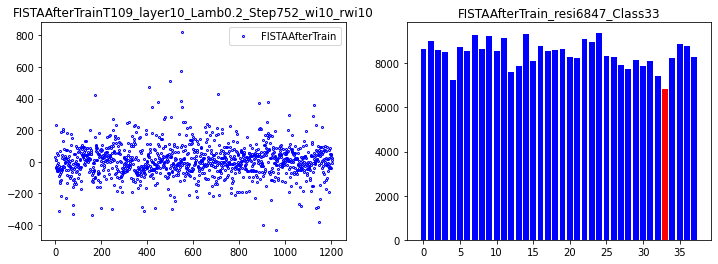

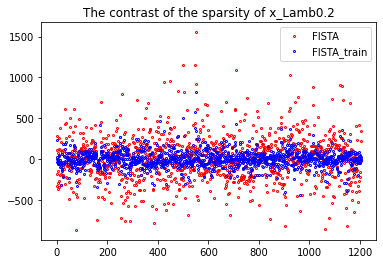

4


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 104.70ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5982.98608124]


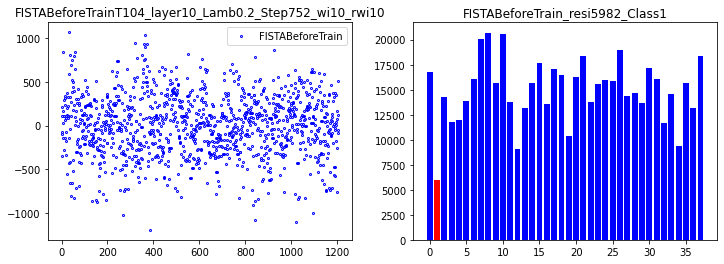

correct rate: 0.625
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.71875
Epoch [ 10/100]: loss = 251989224.3091,   lambda [max:0.1408], [min:0.1302], 
Epoch [ 20/100]: loss = 30682986.3990,   lambda [max:0.1086], [min:0.0845], 
Epoch [ 30/100]: loss = 16630275.3975,   lambda [max:0.0833], [min:0.0470], 
Epoch [ 40/100]: loss = 11514580.5375,   lambda [max:0.0601], [min:0.0142], 
Epoch [ 50/100]: loss = 9084359.8031,   lambda [max:0.0382], [min:-0.0153], 
Epoch [ 60/100]: loss = 6365773.2790,   lambda [max:0.0175], [min:-0.0424], 
Epoch [ 70/100]: loss = 5619988.2330,   lambda [max:-0.0023], [min:-0.0676], 
Epoch [ 80/100]: loss = 4682839.5218,   lambda [max:-0.0213], [min:-0.0914], 
Epoch [ 90/100]: loss = 3982514.5578,   lambda [max:-0.0397], [min:-0.1140], 
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.75
correct rate: 0.625
Epoch [100/100]: loss = 3467559.6474,   lambda [max:-0.0576], [min:-0.1356], 


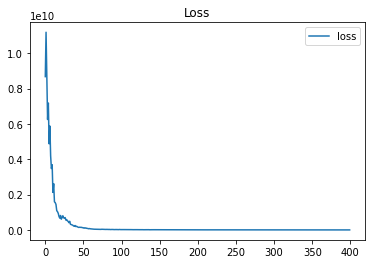

done 10 layers in 98.56ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[11444.69332982]


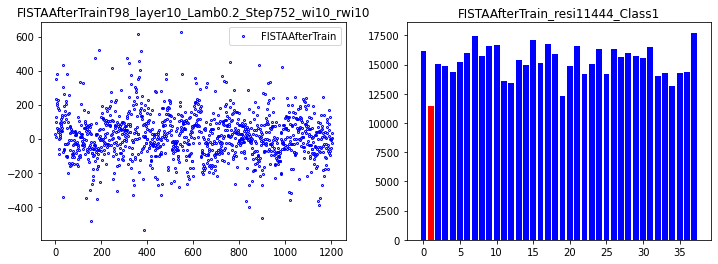

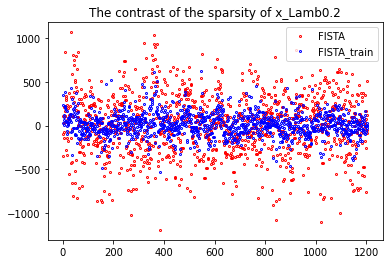

5


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 103.58ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.91111018]


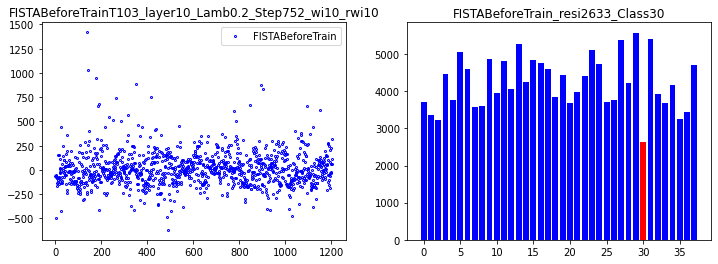

correct rate: 0.6875
correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.78125
Epoch [ 10/100]: loss = 215482397.6480,   lambda [max:0.1399], [min:0.1289], 
Epoch [ 20/100]: loss = 30593185.3581,   lambda [max:0.1071], [min:0.0821], 
Epoch [ 30/100]: loss = 15446337.9622,   lambda [max:0.0819], [min:0.0434], 
Epoch [ 40/100]: loss = 12056652.5332,   lambda [max:0.0587], [min:0.0092], 
Epoch [ 50/100]: loss = 8588481.5914,   lambda [max:0.0369], [min:-0.0214], 
Epoch [ 60/100]: loss = 6500852.9084,   lambda [max:0.0163], [min:-0.0493], 
Epoch [ 70/100]: loss = 5121438.3103,   lambda [max:-0.0036], [min:-0.0752], 
Epoch [ 80/100]: loss = 4284873.3438,   lambda [max:-0.0227], [min:-0.0995], 
Epoch [ 90/100]: loss = 3881553.4107,   lambda [max:-0.0412], [min:-0.1225], 
correct rate: 0.46875
correct rate: 0.875
correct rate: 0.6875
correct rate: 0.53125
Epoch [100/100]: loss = 3667266.8910,   lambda [max:-0.0592], [min:-0.1444], 


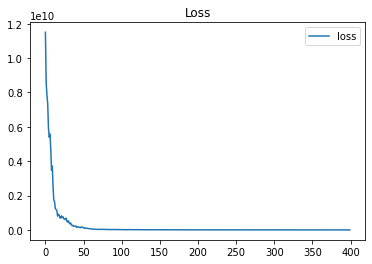

done 10 layers in 100.48ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3067.51554384]


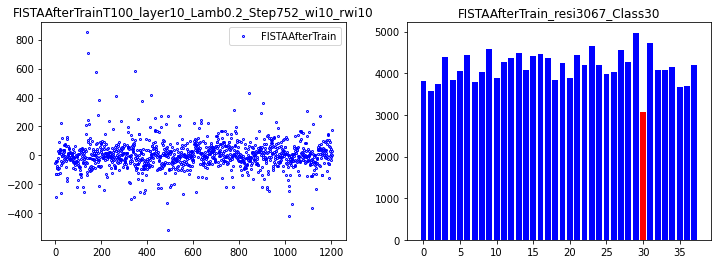

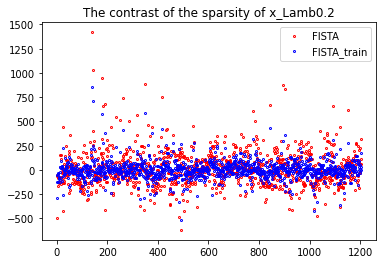

6


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 104.01ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6125.4037645]


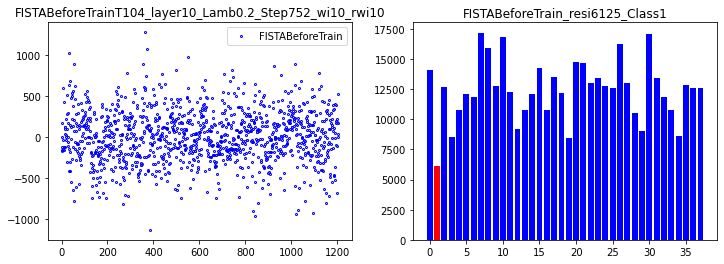

correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.6875
Epoch [ 10/100]: loss = 220100344.9203,   lambda [max:0.1386], [min:0.1288], 
Epoch [ 20/100]: loss = 33136565.5194,   lambda [max:0.1052], [min:0.0808], 
Epoch [ 30/100]: loss = 15330351.2985,   lambda [max:0.0784], [min:0.0416], 
Epoch [ 40/100]: loss = 10940320.3181,   lambda [max:0.0538], [min:0.0072], 
Epoch [ 50/100]: loss = 8334195.9951,   lambda [max:0.0307], [min:-0.0235], 
Epoch [ 60/100]: loss = 6272373.6521,   lambda [max:0.0090], [min:-0.0515], 
Epoch [ 70/100]: loss = 4964173.4479,   lambda [max:-0.0119], [min:-0.0775], 
Epoch [ 80/100]: loss = 4474408.9560,   lambda [max:-0.0318], [min:-0.1018], 
Epoch [ 90/100]: loss = 3643426.0074,   lambda [max:-0.0512], [min:-0.1249], 
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.6875
Epoch [100/100]: loss = 3343878.0333,   lambda [max:-0.0700], [min:-0.1470], 


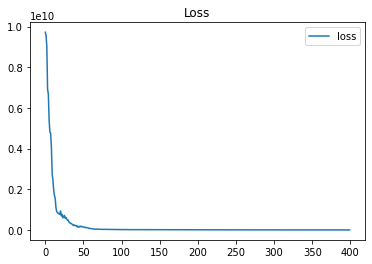

done 10 layers in 103.12ms
predict class: yaleB36
test image label: yaleB02
predict residuals label: 34
test residuals label: 1
[10375.60069299]


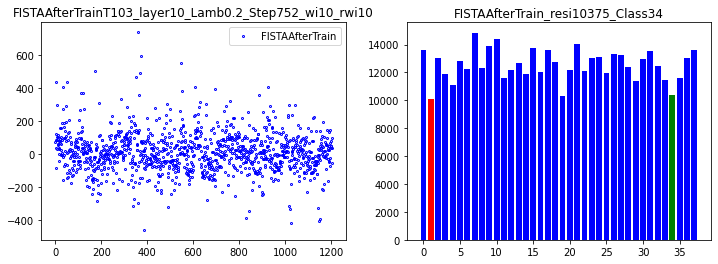

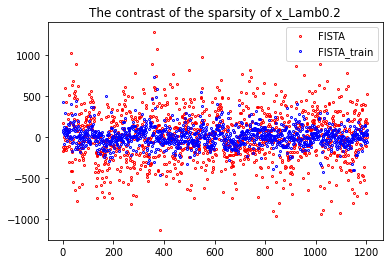

7


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 113.00ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.5421843]


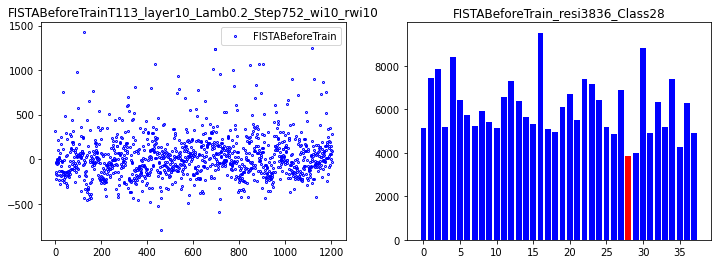

correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.75
correct rate: 0.71875
Epoch [ 10/100]: loss = 202842737.8936,   lambda [max:0.1387], [min:0.1274], 
Epoch [ 20/100]: loss = 29891745.6397,   lambda [max:0.1056], [min:0.0788], 
Epoch [ 30/100]: loss = 15907792.1079,   lambda [max:0.0791], [min:0.0390], 
Epoch [ 40/100]: loss = 10281380.7023,   lambda [max:0.0545], [min:0.0041], 
Epoch [ 50/100]: loss = 7278501.4532,   lambda [max:0.0315], [min:-0.0270], 
Epoch [ 60/100]: loss = 5580942.9042,   lambda [max:0.0097], [min:-0.0553], 
Epoch [ 70/100]: loss = 5113591.8683,   lambda [max:-0.0111], [min:-0.0814], 
Epoch [ 80/100]: loss = 4241916.6456,   lambda [max:-0.0311], [min:-0.1059], 
Epoch [ 90/100]: loss = 3722215.2284,   lambda [max:-0.0505], [min:-0.1292], 
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.4375
correct rate: 0.75
Epoch [100/100]: loss = 3024440.9479,   lambda [max:-0.0692], [min:-0.1513], 


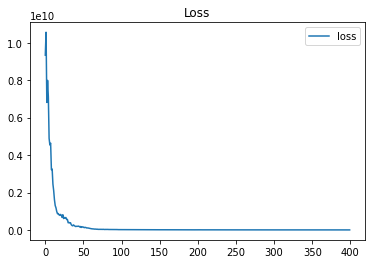

done 10 layers in 113.30ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4733.42543795]


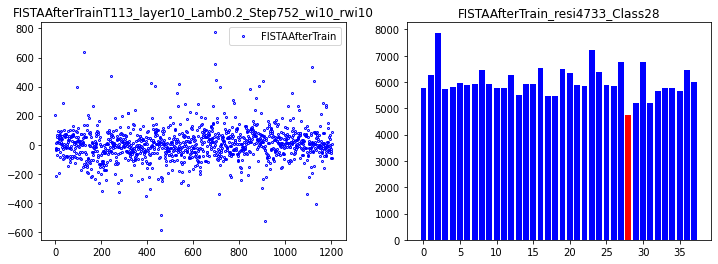

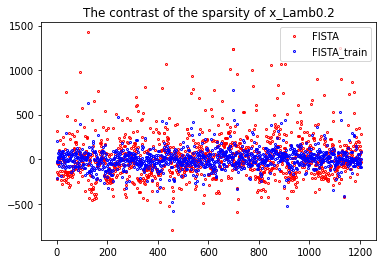

8


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 94.84ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11038.75418564]


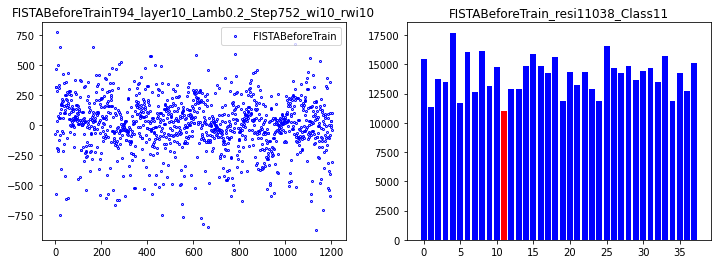

correct rate: 0.75
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.71875
Epoch [ 10/100]: loss = 221510733.4221,   lambda [max:0.1386], [min:0.1273], 
Epoch [ 20/100]: loss = 30126725.7708,   lambda [max:0.1057], [min:0.0786], 
Epoch [ 30/100]: loss = 14739155.3683,   lambda [max:0.0792], [min:0.0386], 
Epoch [ 40/100]: loss = 10204725.8947,   lambda [max:0.0549], [min:0.0037], 
Epoch [ 50/100]: loss = 7544212.3616,   lambda [max:0.0320], [min:-0.0275], 
Epoch [ 60/100]: loss = 5737660.4792,   lambda [max:0.0104], [min:-0.0559], 
Epoch [ 70/100]: loss = 5072447.3050,   lambda [max:-0.0103], [min:-0.0822], 
Epoch [ 80/100]: loss = 4236318.1866,   lambda [max:-0.0302], [min:-0.1069], 
Epoch [ 90/100]: loss = 3465647.8403,   lambda [max:-0.0494], [min:-0.1303], 
correct rate: 0.5625
correct rate: 0.59375
correct rate: 0.75
correct rate: 0.625
Epoch [100/100]: loss = 3101123.1969,   lambda [max:-0.0681], [min:-0.1525], 


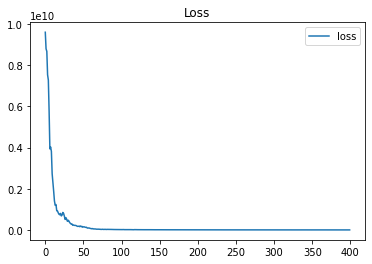

done 10 layers in 102.51ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11360.6691894]


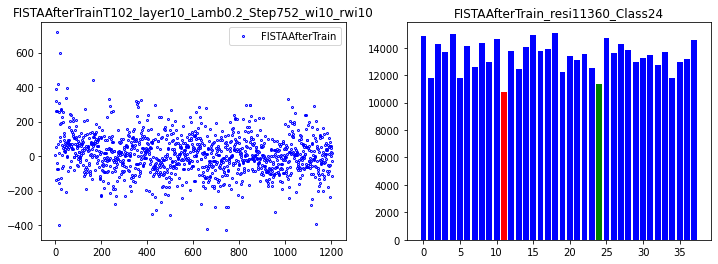

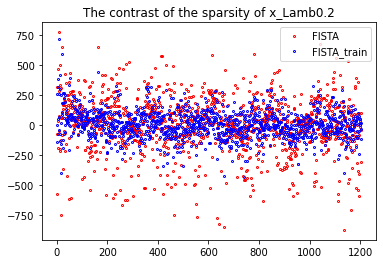

9


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 109.52ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16511.1576364]


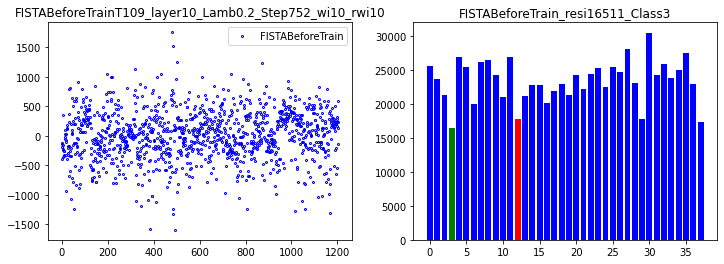

correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.8125
Epoch [ 10/100]: loss = 208415682.4947,   lambda [max:0.1379], [min:0.1270], 
Epoch [ 20/100]: loss = 27651517.8936,   lambda [max:0.1040], [min:0.0779], 
Epoch [ 30/100]: loss = 15670712.2783,   lambda [max:0.0770], [min:0.0371], 
Epoch [ 40/100]: loss = 10368699.3524,   lambda [max:0.0521], [min:0.0015], 
Epoch [ 50/100]: loss = 7833863.8923,   lambda [max:0.0287], [min:-0.0301], 
Epoch [ 60/100]: loss = 5894308.5984,   lambda [max:0.0066], [min:-0.0589], 
Epoch [ 70/100]: loss = 5180864.3786,   lambda [max:-0.0145], [min:-0.0856], 
Epoch [ 80/100]: loss = 4211264.8147,   lambda [max:-0.0347], [min:-0.1106], 
Epoch [ 90/100]: loss = 3733578.0217,   lambda [max:-0.0542], [min:-0.1342], 
correct rate: 0.75
correct rate: 0.75
correct rate: 0.53125
correct rate: 0.53125
Epoch [100/100]: loss = 3363856.7519,   lambda [max:-0.0731], [min:-0.1567], 


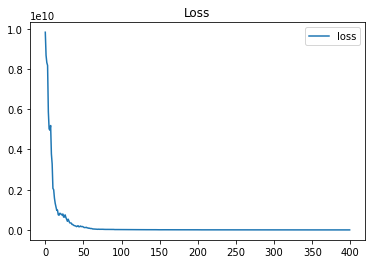

done 10 layers in 97.17ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21768.75948446]


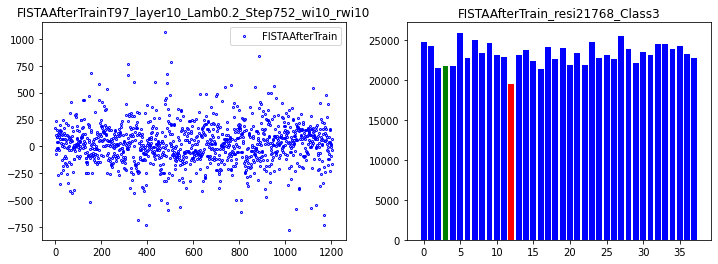

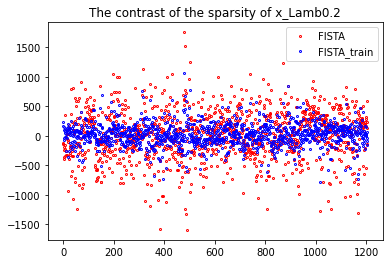

10


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.15ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6135.27056371]


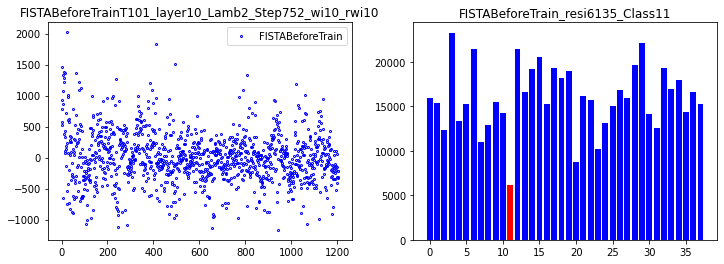

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.6875
Epoch [ 10/100]: loss = 217202973.3368,   lambda [max:1.9378], [min:1.9269], 
Epoch [ 20/100]: loss = 28623205.7029,   lambda [max:1.9040], [min:1.8767], 
Epoch [ 30/100]: loss = 14970251.1231,   lambda [max:1.8771], [min:1.8369], 
Epoch [ 40/100]: loss = 10303140.7089,   lambda [max:1.8523], [min:1.8019], 
Epoch [ 50/100]: loss = 8490048.9574,   lambda [max:1.8291], [min:1.7708], 
Epoch [ 60/100]: loss = 7249776.4542,   lambda [max:1.8070], [min:1.7425], 
Epoch [ 70/100]: loss = 5986257.0894,   lambda [max:1.7861], [min:1.7164], 
Epoch [ 80/100]: loss = 5622229.8986,   lambda [max:1.7659], [min:1.6920], 
Epoch [ 90/100]: loss = 4819702.1560,   lambda [max:1.7464], [min:1.6688], 
correct rate: 0.53125
correct rate: 0.625
correct rate: 0.75
correct rate: 0.625
Epoch [100/100]: loss = 4567699.3829,   lambda [max:1.7275], [min:1.6468], 


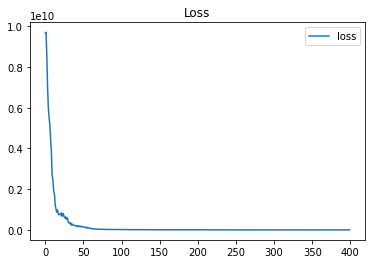

done 10 layers in 117.70ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[14080.7866022]


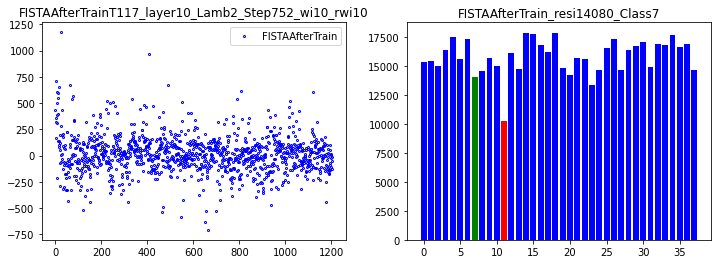

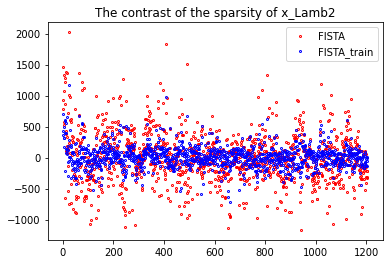

11


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 110.22ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6904.66862168]


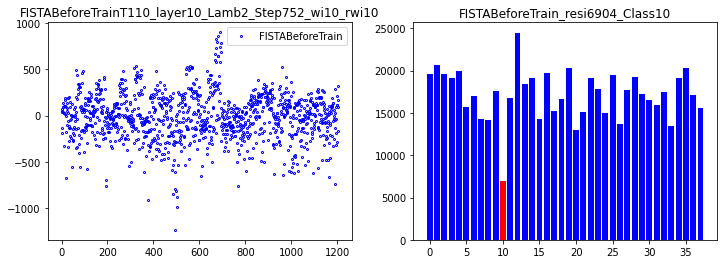

correct rate: 0.75
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.625
Epoch [ 10/100]: loss = 227272676.9270,   lambda [max:1.9371], [min:1.9261], 
Epoch [ 20/100]: loss = 32025545.5241,   lambda [max:1.9037], [min:1.8771], 
Epoch [ 30/100]: loss = 14930106.1671,   lambda [max:1.8770], [min:1.8371], 
Epoch [ 40/100]: loss = 10596858.7918,   lambda [max:1.8525], [min:1.8019], 
Epoch [ 50/100]: loss = 9012326.5397,   lambda [max:1.8296], [min:1.7707], 
Epoch [ 60/100]: loss = 7739303.5264,   lambda [max:1.8081], [min:1.7422], 
Epoch [ 70/100]: loss = 5928091.6646,   lambda [max:1.7874], [min:1.7159], 
Epoch [ 80/100]: loss = 5631165.2425,   lambda [max:1.7676], [min:1.6911], 
Epoch [ 90/100]: loss = 4948069.6456,   lambda [max:1.7484], [min:1.6677], 
correct rate: 0.59375
correct rate: 0.78125
correct rate: 0.625
correct rate: 0.5
Epoch [100/100]: loss = 4595781.4277,   lambda [max:1.7298], [min:1.6454], 


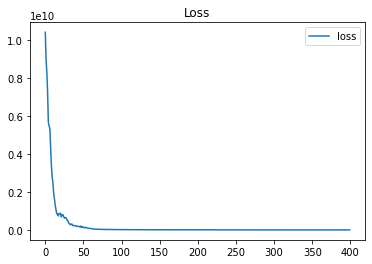

done 10 layers in 96.03ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[11050.21491502]


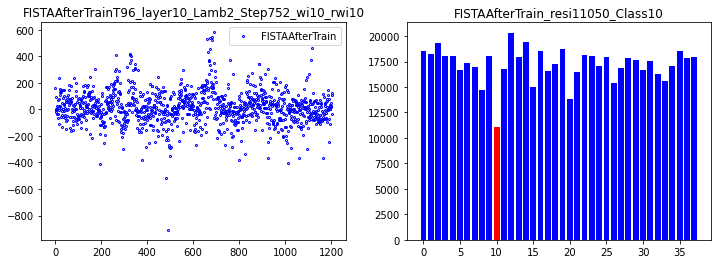

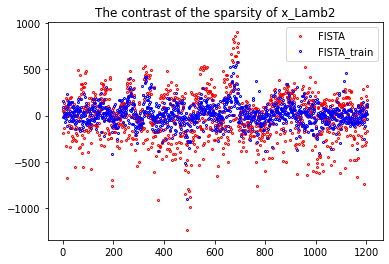

12


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 106.73ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.14730092]


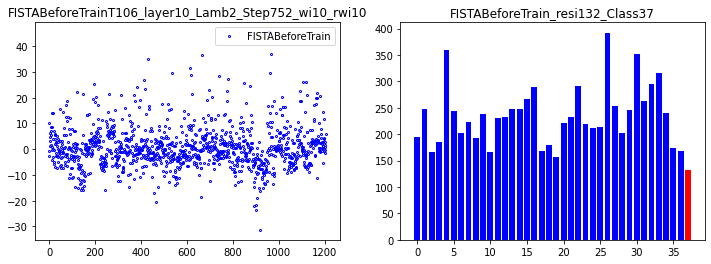

correct rate: 0.625
correct rate: 0.78125
correct rate: 0.6875
correct rate: 0.59375
Epoch [ 10/100]: loss = 214071577.1555,   lambda [max:1.9375], [min:1.9267], 
Epoch [ 20/100]: loss = 28244489.0018,   lambda [max:1.9036], [min:1.8767], 
Epoch [ 30/100]: loss = 15795828.4239,   lambda [max:1.8767], [min:1.8357], 
Epoch [ 40/100]: loss = 10340158.7810,   lambda [max:1.8520], [min:1.8000], 
Epoch [ 50/100]: loss = 8400908.8465,   lambda [max:1.8290], [min:1.7683], 
Epoch [ 60/100]: loss = 7220936.0897,   lambda [max:1.8073], [min:1.7395], 
Epoch [ 70/100]: loss = 5962257.8439,   lambda [max:1.7865], [min:1.7130], 
Epoch [ 80/100]: loss = 5374666.3714,   lambda [max:1.7666], [min:1.6882], 
Epoch [ 90/100]: loss = 4781360.8902,   lambda [max:1.7473], [min:1.6647], 
correct rate: 0.71875
correct rate: 0.46875
correct rate: 0.59375
correct rate: 0.71875
Epoch [100/100]: loss = 4345982.0793,   lambda [max:1.7286], [min:1.6424], 


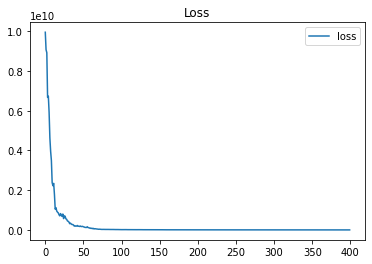

done 10 layers in 94.35ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[171.68673792]


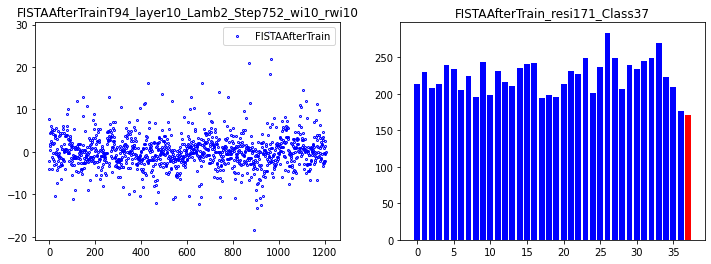

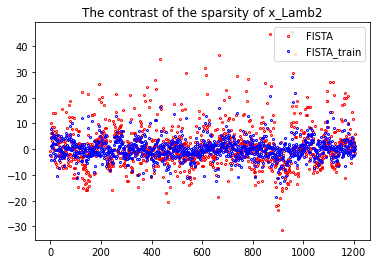

13


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.28ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4726.57002266]


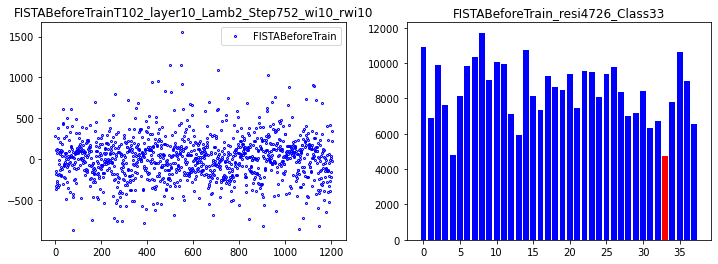

correct rate: 0.53125
correct rate: 0.875
correct rate: 0.6875
correct rate: 0.65625
Epoch [ 10/100]: loss = 213776750.6944,   lambda [max:1.9370], [min:1.9260], 
Epoch [ 20/100]: loss = 32710201.4412,   lambda [max:1.9036], [min:1.8781], 
Epoch [ 30/100]: loss = 16521871.2558,   lambda [max:1.8775], [min:1.8385], 
Epoch [ 40/100]: loss = 11428196.9930,   lambda [max:1.8535], [min:1.8038], 
Epoch [ 50/100]: loss = 9225253.2939,   lambda [max:1.8312], [min:1.7727], 
Epoch [ 60/100]: loss = 7825369.9546,   lambda [max:1.8099], [min:1.7444], 
Epoch [ 70/100]: loss = 6215637.8580,   lambda [max:1.7896], [min:1.7181], 
Epoch [ 80/100]: loss = 5916048.0308,   lambda [max:1.7701], [min:1.6934], 
Epoch [ 90/100]: loss = 5108497.9430,   lambda [max:1.7512], [min:1.6694], 
correct rate: 0.6875
correct rate: 0.5
correct rate: 0.71875
correct rate: 0.65625
Epoch [100/100]: loss = 4805256.3291,   lambda [max:1.7329], [min:1.6466], 


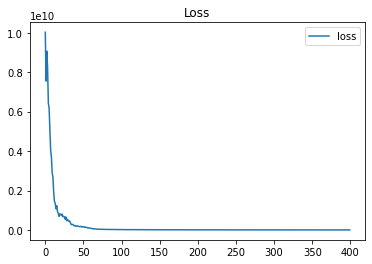

done 10 layers in 95.65ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6938.45742552]


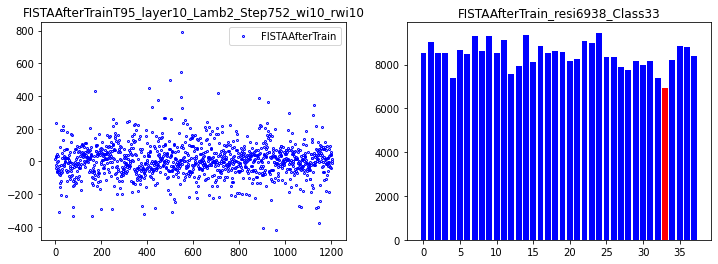

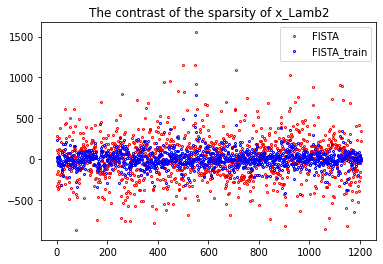

14


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.86ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5983.44513674]


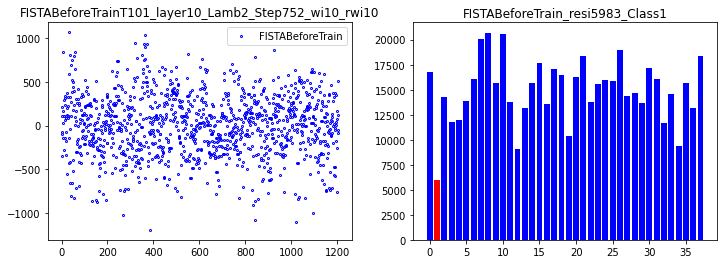

correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.65625
Epoch [ 10/100]: loss = 235908407.9267,   lambda [max:1.9378], [min:1.9262], 
Epoch [ 20/100]: loss = 35042742.6631,   lambda [max:1.9036], [min:1.8781], 
Epoch [ 30/100]: loss = 15891586.4057,   lambda [max:1.8766], [min:1.8382], 
Epoch [ 40/100]: loss = 11580914.5139,   lambda [max:1.8518], [min:1.8034], 
Epoch [ 50/100]: loss = 9036679.0167,   lambda [max:1.8285], [min:1.7721], 
Epoch [ 60/100]: loss = 7219897.2077,   lambda [max:1.8065], [min:1.7437], 
Epoch [ 70/100]: loss = 6479756.5179,   lambda [max:1.7856], [min:1.7174], 
Epoch [ 80/100]: loss = 5777272.4529,   lambda [max:1.7655], [min:1.6925], 
Epoch [ 90/100]: loss = 4839476.7985,   lambda [max:1.7461], [min:1.6684], 
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.625
Epoch [100/100]: loss = 4293414.9205,   lambda [max:1.7273], [min:1.6456], 


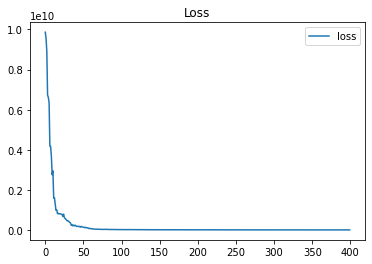

done 10 layers in 109.52ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[11696.3108359]


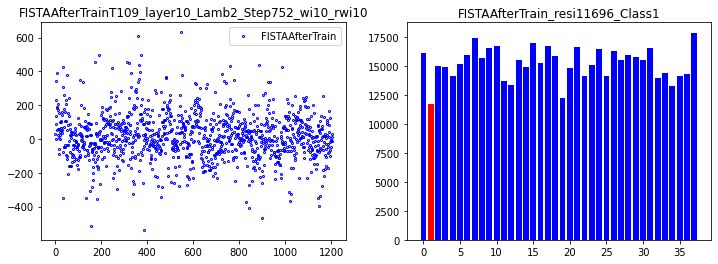

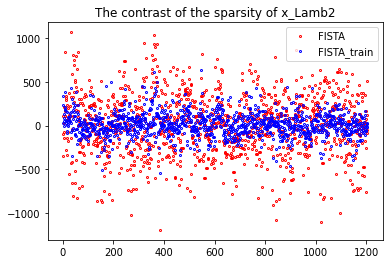

15


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 116.33ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.88200257]


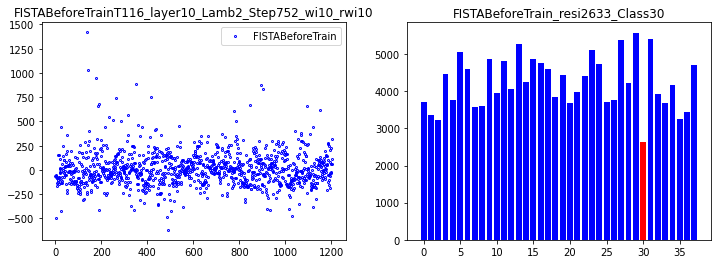

correct rate: 0.78125
correct rate: 0.75
correct rate: 0.59375
correct rate: 0.625
Epoch [ 10/100]: loss = 228096441.1590,   lambda [max:1.9377], [min:1.9255], 
Epoch [ 20/100]: loss = 31163686.2384,   lambda [max:1.9035], [min:1.8769], 
Epoch [ 30/100]: loss = 15650623.2241,   lambda [max:1.8765], [min:1.8365], 
Epoch [ 40/100]: loss = 11538807.6575,   lambda [max:1.8518], [min:1.8011], 
Epoch [ 50/100]: loss = 8831685.3285,   lambda [max:1.8286], [min:1.7696], 
Epoch [ 60/100]: loss = 7348553.5118,   lambda [max:1.8068], [min:1.7409], 
Epoch [ 70/100]: loss = 5950084.3263,   lambda [max:1.7859], [min:1.7143], 
Epoch [ 80/100]: loss = 5586373.9242,   lambda [max:1.7658], [min:1.6894], 
Epoch [ 90/100]: loss = 5186198.9308,   lambda [max:1.7465], [min:1.6658], 
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.625
Epoch [100/100]: loss = 4307113.8559,   lambda [max:1.7277], [min:1.6434], 


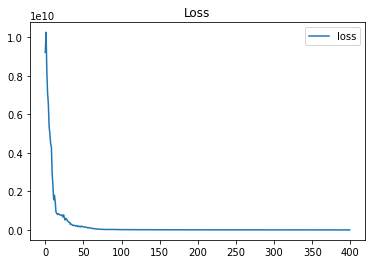

done 10 layers in 97.59ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3091.26010009]


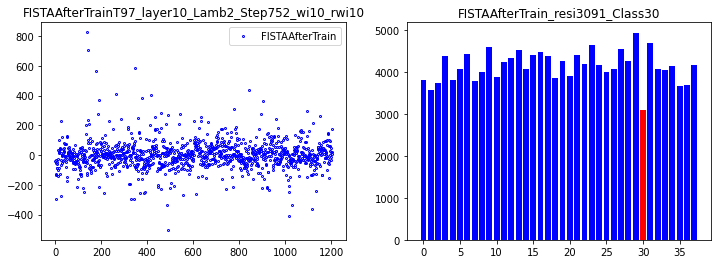

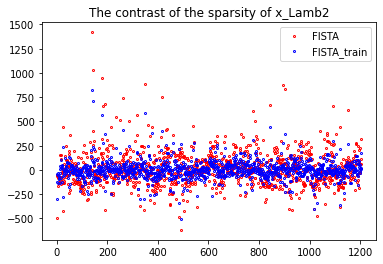

16


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 100.26ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6125.85516692]


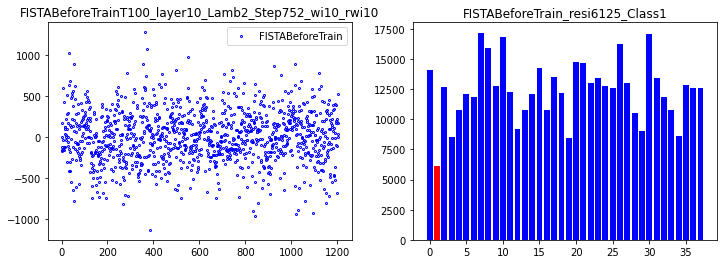

correct rate: 0.6875
correct rate: 0.625
correct rate: 0.75
correct rate: 0.6875
Epoch [ 10/100]: loss = 247867193.5122,   lambda [max:1.9374], [min:1.9265], 
Epoch [ 20/100]: loss = 28337139.3139,   lambda [max:1.9039], [min:1.8760], 
Epoch [ 30/100]: loss = 17408875.6195,   lambda [max:1.8772], [min:1.8353], 
Epoch [ 40/100]: loss = 11181174.7857,   lambda [max:1.8525], [min:1.7997], 
Epoch [ 50/100]: loss = 7819691.0785,   lambda [max:1.8294], [min:1.7681], 
Epoch [ 60/100]: loss = 7396626.6973,   lambda [max:1.8075], [min:1.7394], 
Epoch [ 70/100]: loss = 6225032.0151,   lambda [max:1.7866], [min:1.7128], 
Epoch [ 80/100]: loss = 5524834.9892,   lambda [max:1.7666], [min:1.6879], 
Epoch [ 90/100]: loss = 4567823.2832,   lambda [max:1.7473], [min:1.6644], 
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.65625
Epoch [100/100]: loss = 4482757.9425,   lambda [max:1.7287], [min:1.6420], 


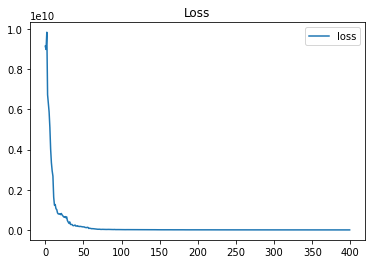

done 10 layers in 109.38ms
predict class: yaleB36
test image label: yaleB02
predict residuals label: 34
test residuals label: 1
[10354.16929022]


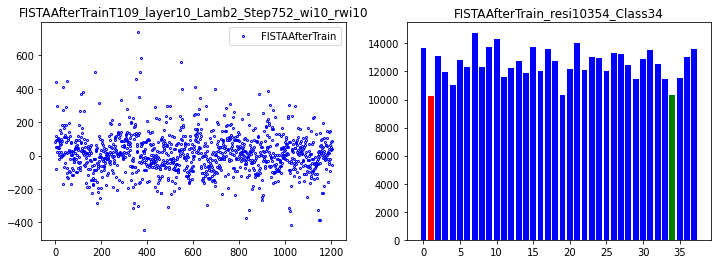

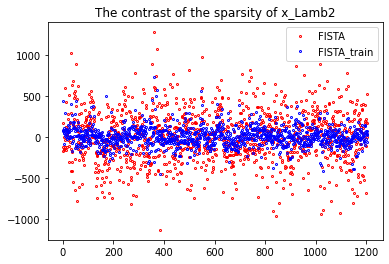

17


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 94.66ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.58414072]


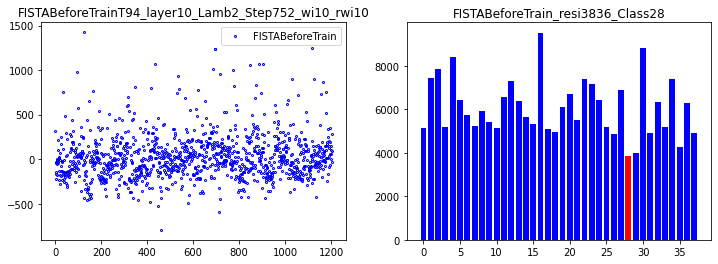

correct rate: 0.65625
correct rate: 0.78125
correct rate: 0.625
correct rate: 0.71875
Epoch [ 10/100]: loss = 206768224.2661,   lambda [max:1.9373], [min:1.9266], 
Epoch [ 20/100]: loss = 26467647.8665,   lambda [max:1.9030], [min:1.8773], 
Epoch [ 30/100]: loss = 15686027.1711,   lambda [max:1.8758], [min:1.8371], 
Epoch [ 40/100]: loss = 10492107.3682,   lambda [max:1.8510], [min:1.8019], 
Epoch [ 50/100]: loss = 8934950.2653,   lambda [max:1.8277], [min:1.7706], 
Epoch [ 60/100]: loss = 7282094.9284,   lambda [max:1.8058], [min:1.7421], 
Epoch [ 70/100]: loss = 6233472.0836,   lambda [max:1.7849], [min:1.7156], 
Epoch [ 80/100]: loss = 5572913.0831,   lambda [max:1.7648], [min:1.6908], 
Epoch [ 90/100]: loss = 5024138.1799,   lambda [max:1.7453], [min:1.6674], 
correct rate: 0.625
correct rate: 0.8125
correct rate: 0.46875
correct rate: 0.625
Epoch [100/100]: loss = 4285548.1271,   lambda [max:1.7264], [min:1.6446], 


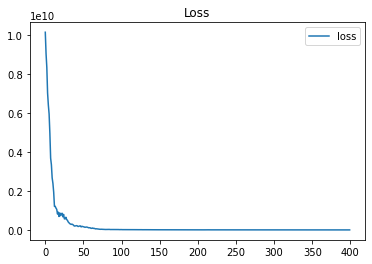

done 10 layers in 96.37ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4736.26720701]


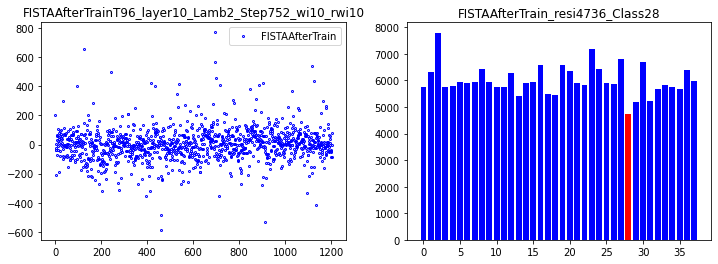

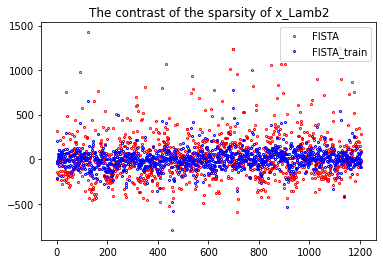

18


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.69ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11038.90506418]


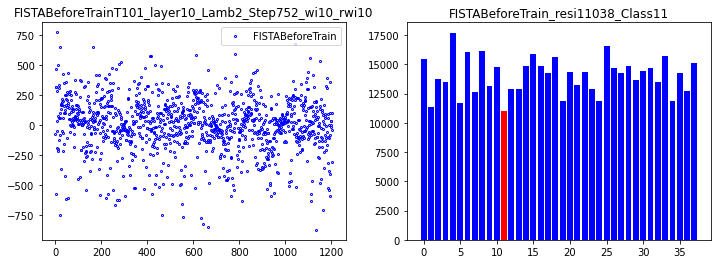

correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.75
Epoch [ 10/100]: loss = 172907202.6252,   lambda [max:1.9372], [min:1.9261], 
Epoch [ 20/100]: loss = 31964715.1947,   lambda [max:1.9029], [min:1.8777], 
Epoch [ 30/100]: loss = 15532878.0441,   lambda [max:1.8761], [min:1.8380], 
Epoch [ 40/100]: loss = 11353442.0975,   lambda [max:1.8514], [min:1.8033], 
Epoch [ 50/100]: loss = 8816541.4386,   lambda [max:1.8283], [min:1.7723], 
Epoch [ 60/100]: loss = 7368417.1296,   lambda [max:1.8065], [min:1.7442], 
Epoch [ 70/100]: loss = 6108518.0322,   lambda [max:1.7857], [min:1.7182], 
Epoch [ 80/100]: loss = 5644912.2733,   lambda [max:1.7656], [min:1.6937], 
Epoch [ 90/100]: loss = 4917124.9645,   lambda [max:1.7462], [min:1.6706], 
correct rate: 0.53125
correct rate: 0.8125
correct rate: 0.6875
correct rate: 0.59375
Epoch [100/100]: loss = 4361417.8658,   lambda [max:1.7275], [min:1.6482], 


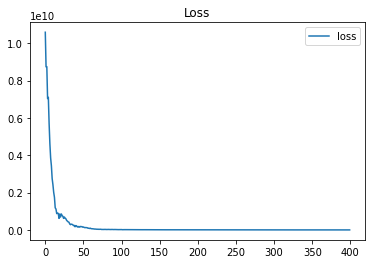

done 10 layers in 97.55ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11405.47484144]


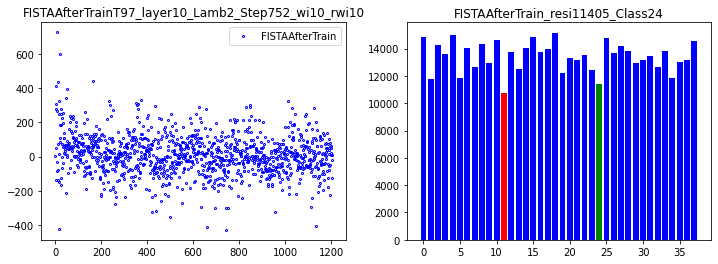

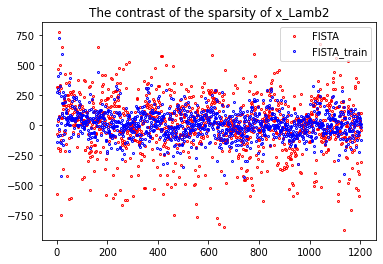

19


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 98.63ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16511.55223475]


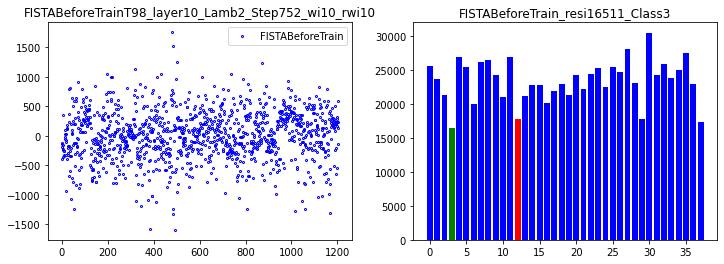

correct rate: 0.5625
correct rate: 0.625
correct rate: 0.78125
correct rate: 0.65625
Epoch [ 10/100]: loss = 200130077.9793,   lambda [max:1.9372], [min:1.9260], 
Epoch [ 20/100]: loss = 27081778.9221,   lambda [max:1.9034], [min:1.8775], 
Epoch [ 30/100]: loss = 17539660.4878,   lambda [max:1.8765], [min:1.8374], 
Epoch [ 40/100]: loss = 10827710.8965,   lambda [max:1.8518], [min:1.8026], 
Epoch [ 50/100]: loss = 8310945.9952,   lambda [max:1.8287], [min:1.7717], 
Epoch [ 60/100]: loss = 7713417.8010,   lambda [max:1.8068], [min:1.7436], 
Epoch [ 70/100]: loss = 6172823.0901,   lambda [max:1.7858], [min:1.7177], 
Epoch [ 80/100]: loss = 5211449.3557,   lambda [max:1.7657], [min:1.6933], 
Epoch [ 90/100]: loss = 4790493.4369,   lambda [max:1.7463], [min:1.6702], 
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.5
correct rate: 0.625
Epoch [100/100]: loss = 4356800.9324,   lambda [max:1.7275], [min:1.6482], 


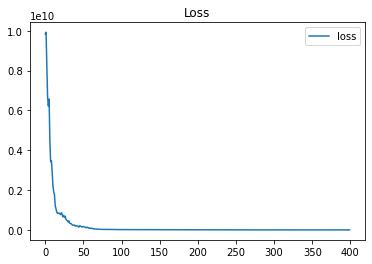

done 10 layers in 106.29ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21878.59332898]


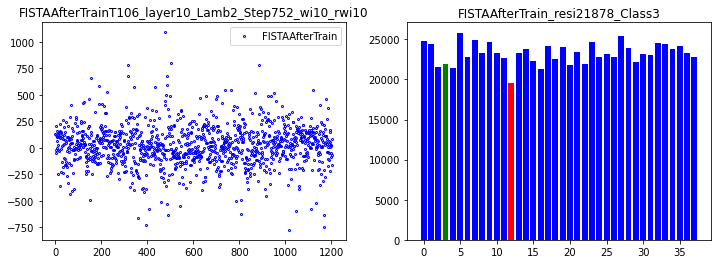

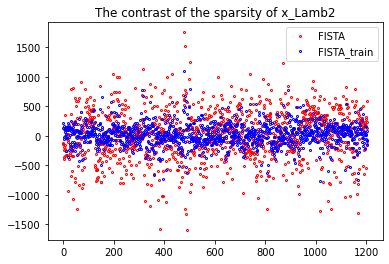

20


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.31ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6134.51951648]


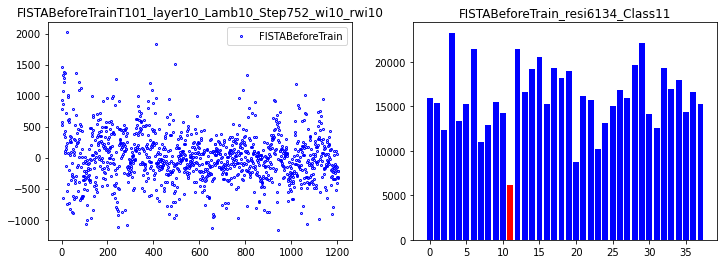

correct rate: 0.59375
correct rate: 0.78125
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 223284519.1700,   lambda [max:9.9374], [min:9.9259], 
Epoch [ 20/100]: loss = 36575019.8299,   lambda [max:9.9040], [min:9.8776], 
Epoch [ 30/100]: loss = 22004043.2017,   lambda [max:9.8777], [min:9.8376], 
Epoch [ 40/100]: loss = 17951431.4380,   lambda [max:9.8538], [min:9.8028], 
Epoch [ 50/100]: loss = 14395066.3413,   lambda [max:9.8314], [min:9.7719], 
Epoch [ 60/100]: loss = 12613275.0456,   lambda [max:9.8102], [min:9.7438], 
Epoch [ 70/100]: loss = 12110622.2937,   lambda [max:9.7900], [min:9.7178], 
Epoch [ 80/100]: loss = 10964701.2791,   lambda [max:9.7707], [min:9.6935], 
Epoch [ 90/100]: loss = 10446073.1867,   lambda [max:9.7519], [min:9.6699], 
correct rate: 0.5
correct rate: 0.53125
correct rate: 0.71875
correct rate: 0.75
Epoch [100/100]: loss = 9294571.3559,   lambda [max:9.7338], [min:9.6473], 


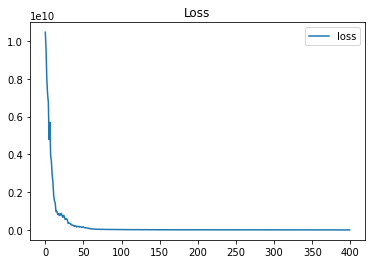

done 10 layers in 100.69ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[14126.72687724]


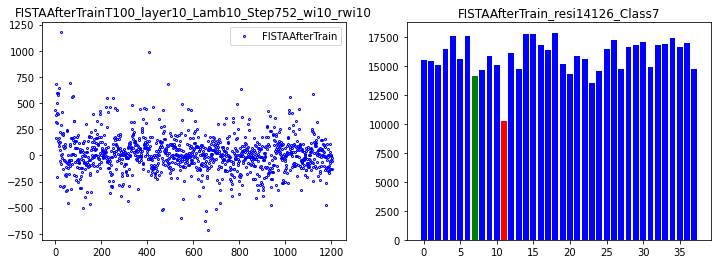

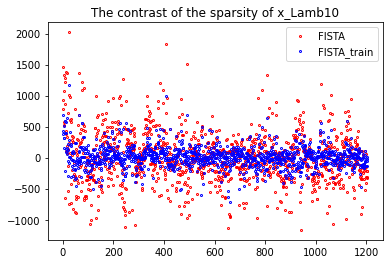

21


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.32ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6906.60745131]


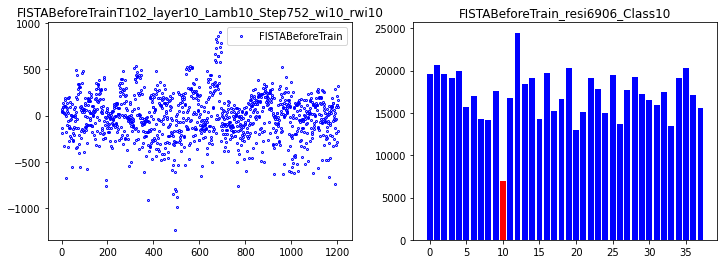

correct rate: 0.625
correct rate: 0.78125
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 199602587.4671,   lambda [max:9.9372], [min:9.9268], 
Epoch [ 20/100]: loss = 36707819.7972,   lambda [max:9.9036], [min:9.8768], 
Epoch [ 30/100]: loss = 21762074.8140,   lambda [max:9.8768], [min:9.8372], 
Epoch [ 40/100]: loss = 16173610.6797,   lambda [max:9.8525], [min:9.8025], 
Epoch [ 50/100]: loss = 13844776.3316,   lambda [max:9.8297], [min:9.7717], 
Epoch [ 60/100]: loss = 12758584.8370,   lambda [max:9.8083], [min:9.7437], 
Epoch [ 70/100]: loss = 11118250.0541,   lambda [max:9.7878], [min:9.7179], 
Epoch [ 80/100]: loss = 11282400.7190,   lambda [max:9.7682], [min:9.6937], 
Epoch [ 90/100]: loss = 11102023.6941,   lambda [max:9.7493], [min:9.6710], 
correct rate: 0.53125
correct rate: 0.625
correct rate: 0.625
correct rate: 0.78125
Epoch [100/100]: loss = 9937629.3485,   lambda [max:9.7310], [min:9.6493], 


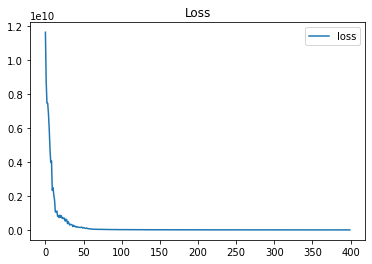

done 10 layers in 109.01ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[11058.93604456]


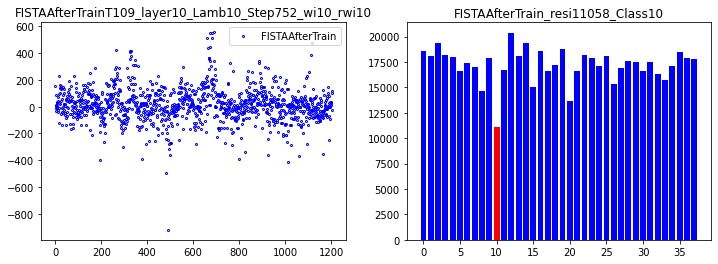

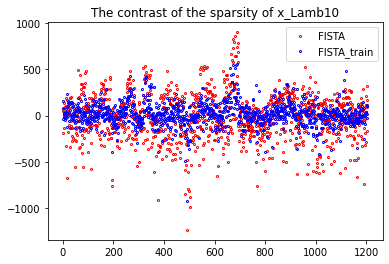

22


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 117.36ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.29430182]


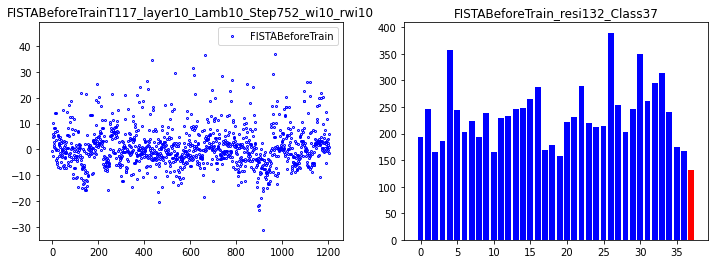

correct rate: 0.6875
correct rate: 0.75
correct rate: 0.71875
correct rate: 0.59375
Epoch [ 10/100]: loss = 236927348.2941,   lambda [max:9.9377], [min:9.9267], 
Epoch [ 20/100]: loss = 33939665.7257,   lambda [max:9.9044], [min:9.8772], 
Epoch [ 30/100]: loss = 21971958.9595,   lambda [max:9.8779], [min:9.8370], 
Epoch [ 40/100]: loss = 16681445.5078,   lambda [max:9.8535], [min:9.8020], 
Epoch [ 50/100]: loss = 13902574.5802,   lambda [max:9.8307], [min:9.7709], 
Epoch [ 60/100]: loss = 12875360.4067,   lambda [max:9.8092], [min:9.7427], 
Epoch [ 70/100]: loss = 11477182.3877,   lambda [max:9.7887], [min:9.7166], 
Epoch [ 80/100]: loss = 11426017.0245,   lambda [max:9.7690], [min:9.6922], 
Epoch [ 90/100]: loss = 10244641.3519,   lambda [max:9.7501], [min:9.6693], 
correct rate: 0.53125
correct rate: 0.625
correct rate: 0.78125
correct rate: 0.625
Epoch [100/100]: loss = 10916873.7592,   lambda [max:9.7318], [min:9.6474], 


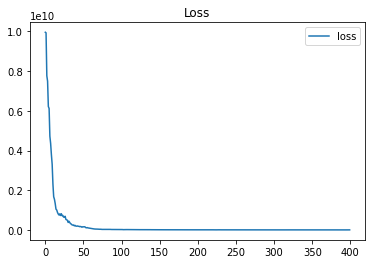

done 10 layers in 111.17ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[171.8064574]


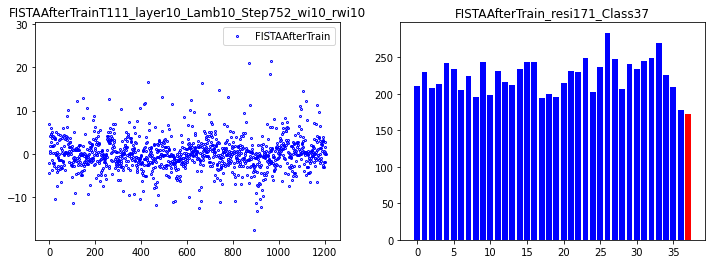

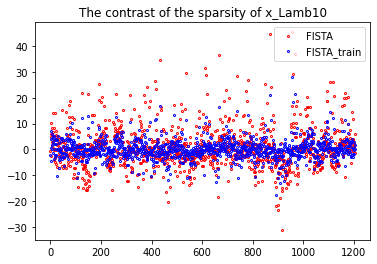

23


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 108.96ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4727.03378325]


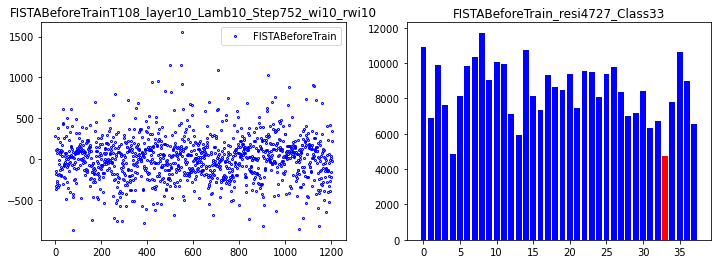

correct rate: 0.59375
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.71875
Epoch [ 10/100]: loss = 203447925.9881,   lambda [max:9.9374], [min:9.9258], 
Epoch [ 20/100]: loss = 35837411.6450,   lambda [max:9.9043], [min:9.8774], 
Epoch [ 30/100]: loss = 22573135.4808,   lambda [max:9.8778], [min:9.8374], 
Epoch [ 40/100]: loss = 17435413.9076,   lambda [max:9.8535], [min:9.8027], 
Epoch [ 50/100]: loss = 14074248.7781,   lambda [max:9.8308], [min:9.7717], 
Epoch [ 60/100]: loss = 12497328.3125,   lambda [max:9.8094], [min:9.7428], 
Epoch [ 70/100]: loss = 10829573.4422,   lambda [max:9.7891], [min:9.7156], 
Epoch [ 80/100]: loss = 10858953.4006,   lambda [max:9.7695], [min:9.6903], 
Epoch [ 90/100]: loss = 10203735.6356,   lambda [max:9.7506], [min:9.6663], 
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.6875
Epoch [100/100]: loss = 9652383.3570,   lambda [max:9.7324], [min:9.6435], 


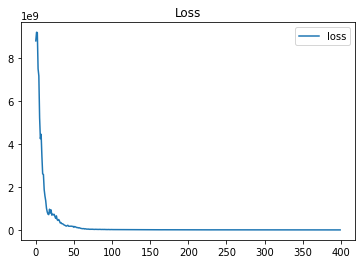

done 10 layers in 95.28ms
predict class: yaleB13
test image label: yaleB35
predict residuals label: 12
test residuals label: 33
[7500.13502227]


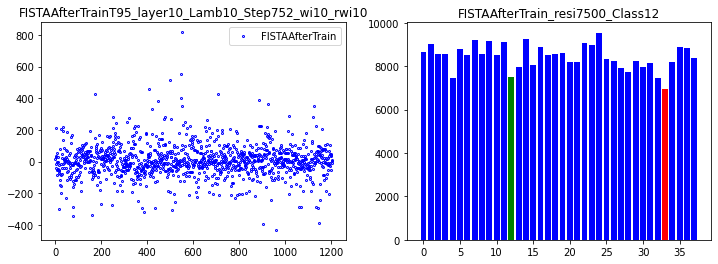

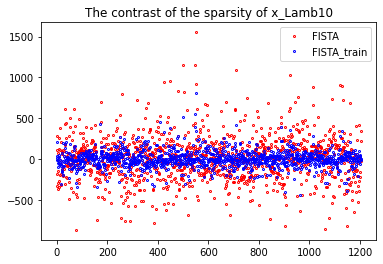

24


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 100.10ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5985.48640629]


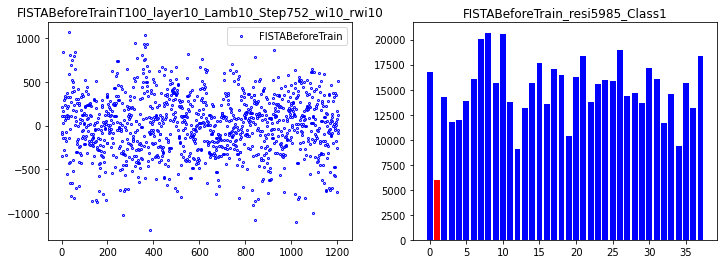

correct rate: 0.59375
correct rate: 0.75
correct rate: 0.75
correct rate: 0.65625
Epoch [ 10/100]: loss = 238285387.5152,   lambda [max:9.9375], [min:9.9256], 
Epoch [ 20/100]: loss = 35327750.4220,   lambda [max:9.9040], [min:9.8771], 
Epoch [ 30/100]: loss = 20559487.6982,   lambda [max:9.8775], [min:9.8373], 
Epoch [ 40/100]: loss = 17644259.0593,   lambda [max:9.8533], [min:9.8025], 
Epoch [ 50/100]: loss = 14358698.7399,   lambda [max:9.8306], [min:9.7717], 
Epoch [ 60/100]: loss = 12605942.5497,   lambda [max:9.8092], [min:9.7436], 
Epoch [ 70/100]: loss = 11843097.6294,   lambda [max:9.7889], [min:9.7177], 
Epoch [ 80/100]: loss = 11000360.2674,   lambda [max:9.7693], [min:9.6935], 
Epoch [ 90/100]: loss = 10198507.5255,   lambda [max:9.7504], [min:9.6706], 
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.71875
Epoch [100/100]: loss = 10512136.6389,   lambda [max:9.7321], [min:9.6489], 


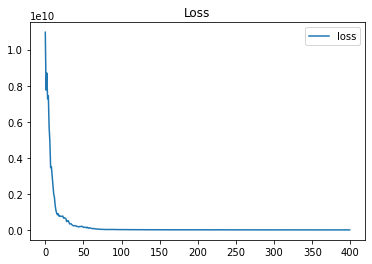

done 10 layers in 110.58ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[11474.98229798]


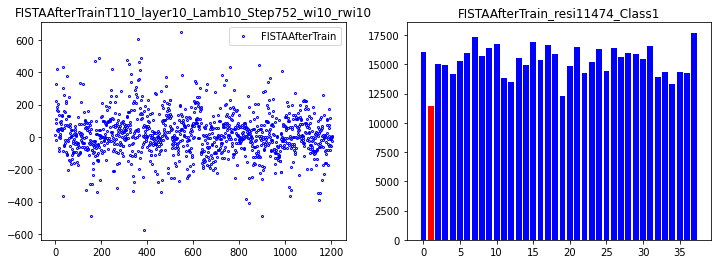

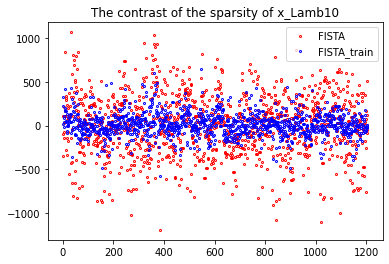

25


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.48ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.75313704]


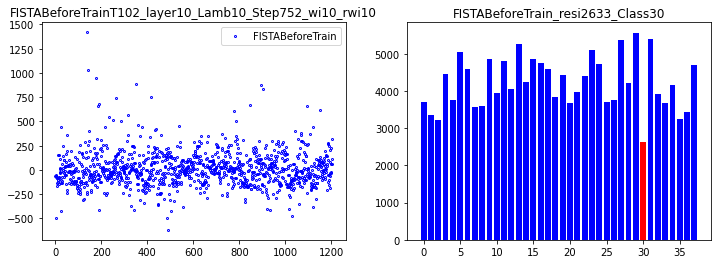

correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.625
Epoch [ 10/100]: loss = 243000812.1345,   lambda [max:9.9376], [min:9.9264], 
Epoch [ 20/100]: loss = 36947372.3417,   lambda [max:9.9038], [min:9.8782], 
Epoch [ 30/100]: loss = 22694116.5659,   lambda [max:9.8772], [min:9.8377], 
Epoch [ 40/100]: loss = 17229422.2660,   lambda [max:9.8531], [min:9.8025], 
Epoch [ 50/100]: loss = 14262614.2606,   lambda [max:9.8301], [min:9.7711], 
Epoch [ 60/100]: loss = 13111314.0728,   lambda [max:9.8084], [min:9.7427], 
Epoch [ 70/100]: loss = 12404035.7464,   lambda [max:9.7879], [min:9.7164], 
Epoch [ 80/100]: loss = 10961574.5704,   lambda [max:9.7681], [min:9.6917], 
Epoch [ 90/100]: loss = 10832285.8540,   lambda [max:9.7491], [min:9.6685], 
correct rate: 0.46875
correct rate: 0.65625
correct rate: 0.75
correct rate: 0.6875
Epoch [100/100]: loss = 9872873.9616,   lambda [max:9.7306], [min:9.6464], 


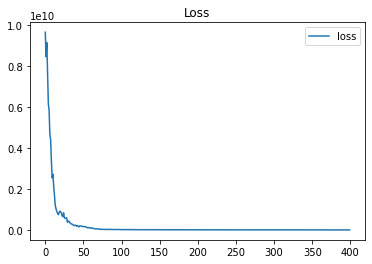

done 10 layers in 94.67ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3072.35859076]


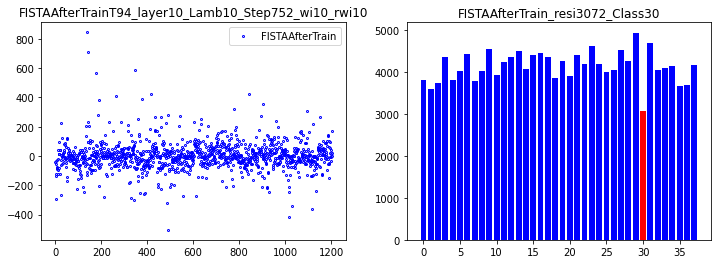

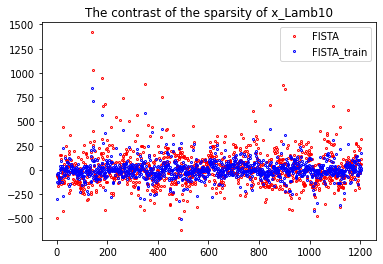

26


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 100.09ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6127.86149992]


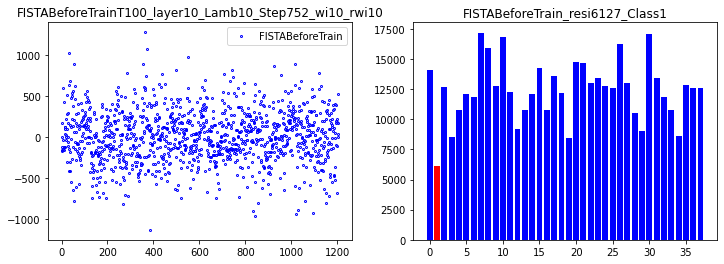

correct rate: 0.5625
correct rate: 0.84375
correct rate: 0.6875
correct rate: 0.625
Epoch [ 10/100]: loss = 202803134.1891,   lambda [max:9.9374], [min:9.9264], 
Epoch [ 20/100]: loss = 37082367.1926,   lambda [max:9.9037], [min:9.8779], 
Epoch [ 30/100]: loss = 22414241.3925,   lambda [max:9.8767], [min:9.8380], 
Epoch [ 40/100]: loss = 17236091.3891,   lambda [max:9.8520], [min:9.8031], 
Epoch [ 50/100]: loss = 14505272.9715,   lambda [max:9.8291], [min:9.7722], 
Epoch [ 60/100]: loss = 12676893.6651,   lambda [max:9.8073], [min:9.7440], 
Epoch [ 70/100]: loss = 11642692.9947,   lambda [max:9.7866], [min:9.7178], 
Epoch [ 80/100]: loss = 10485089.4216,   lambda [max:9.7668], [min:9.6933], 
Epoch [ 90/100]: loss = 9939740.2196,   lambda [max:9.7476], [min:9.6702], 
correct rate: 0.75
correct rate: 0.59375
correct rate: 0.53125
correct rate: 0.625
Epoch [100/100]: loss = 9507721.3662,   lambda [max:9.7291], [min:9.6482], 


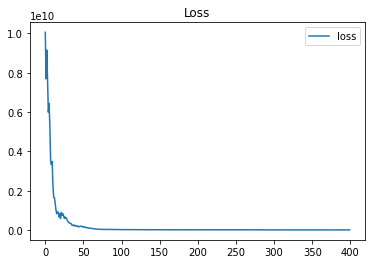

done 10 layers in 96.75ms
predict class: yaleB36
test image label: yaleB02
predict residuals label: 34
test residuals label: 1
[10512.12783825]


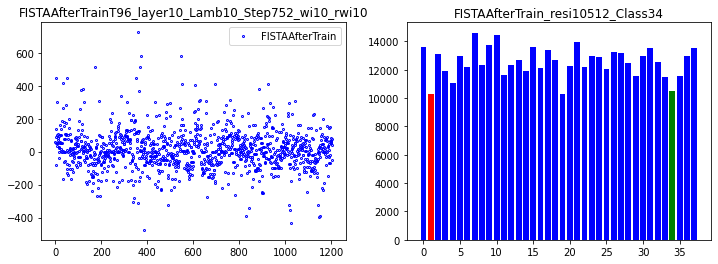

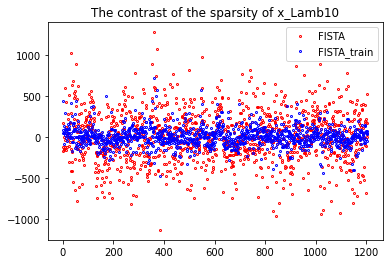

27


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 118.46ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.77151891]


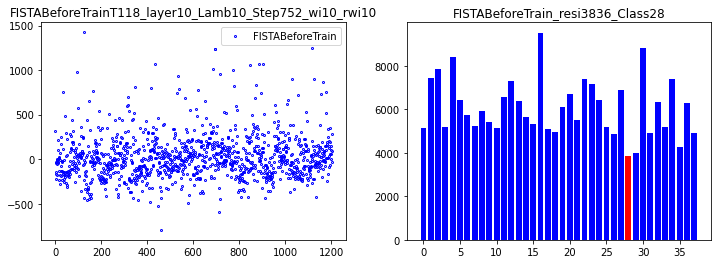

correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.6875
Epoch [ 10/100]: loss = 207046989.2138,   lambda [max:9.9373], [min:9.9258], 
Epoch [ 20/100]: loss = 38740429.1551,   lambda [max:9.9043], [min:9.8768], 
Epoch [ 30/100]: loss = 22611133.1678,   lambda [max:9.8784], [min:9.8369], 
Epoch [ 40/100]: loss = 17848133.2316,   lambda [max:9.8546], [min:9.8019], 
Epoch [ 50/100]: loss = 14657284.7536,   lambda [max:9.8323], [min:9.7707], 
Epoch [ 60/100]: loss = 13372539.6330,   lambda [max:9.8113], [min:9.7424], 
Epoch [ 70/100]: loss = 11641303.6536,   lambda [max:9.7912], [min:9.7163], 
Epoch [ 80/100]: loss = 10612709.7930,   lambda [max:9.7720], [min:9.6918], 
Epoch [ 90/100]: loss = 11004345.6518,   lambda [max:9.7534], [min:9.6687], 
correct rate: 0.6875
correct rate: 0.53125
correct rate: 0.75
correct rate: 0.71875
Epoch [100/100]: loss = 9649050.4431,   lambda [max:9.7355], [min:9.6468], 


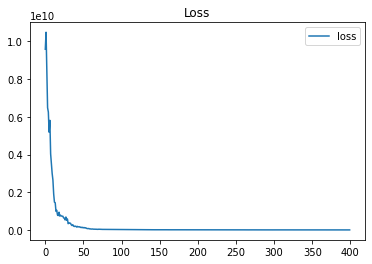

done 10 layers in 111.24ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4736.78865706]


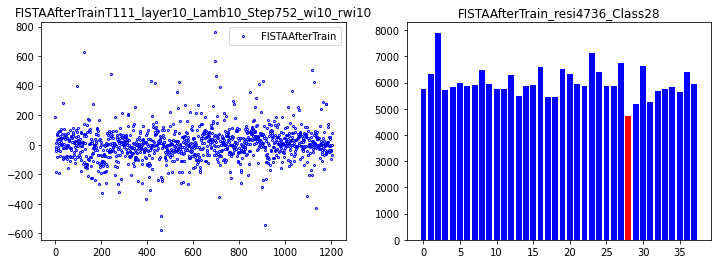

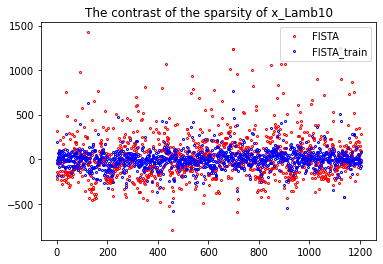

28


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 105.03ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11039.5768946]


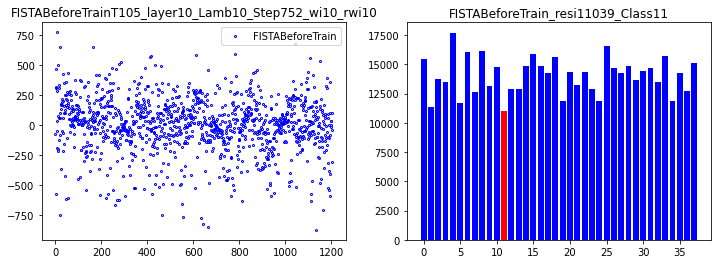

correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.75
Epoch [ 10/100]: loss = 197683924.1391,   lambda [max:9.9372], [min:9.9261], 
Epoch [ 20/100]: loss = 39661030.5828,   lambda [max:9.9041], [min:9.8771], 
Epoch [ 30/100]: loss = 22253993.5822,   lambda [max:9.8776], [min:9.8366], 
Epoch [ 40/100]: loss = 18010756.6551,   lambda [max:9.8534], [min:9.8014], 
Epoch [ 50/100]: loss = 13566365.6199,   lambda [max:9.8307], [min:9.7701], 
Epoch [ 60/100]: loss = 13016603.8888,   lambda [max:9.8093], [min:9.7417], 
Epoch [ 70/100]: loss = 11956906.3374,   lambda [max:9.7888], [min:9.7155], 
Epoch [ 80/100]: loss = 10682210.0797,   lambda [max:9.7692], [min:9.6910], 
Epoch [ 90/100]: loss = 10371207.3119,   lambda [max:9.7504], [min:9.6680], 
correct rate: 0.5
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.78125
Epoch [100/100]: loss = 9975311.9727,   lambda [max:9.7320], [min:9.6460], 


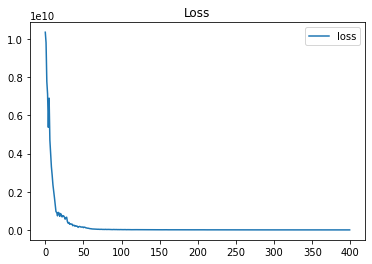

done 10 layers in 95.68ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11483.25630839]


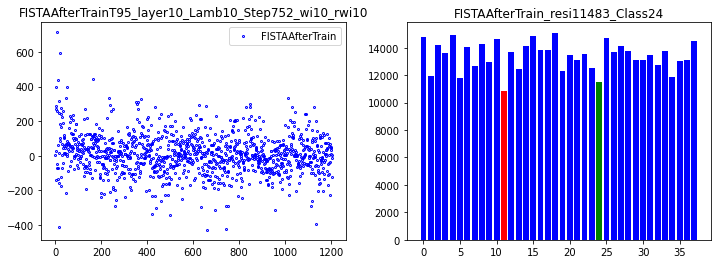

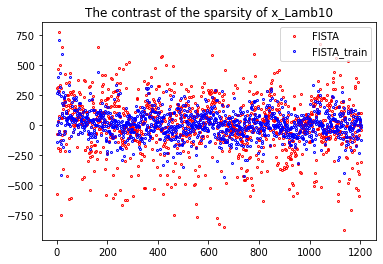

29


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 110.87ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16513.30609801]


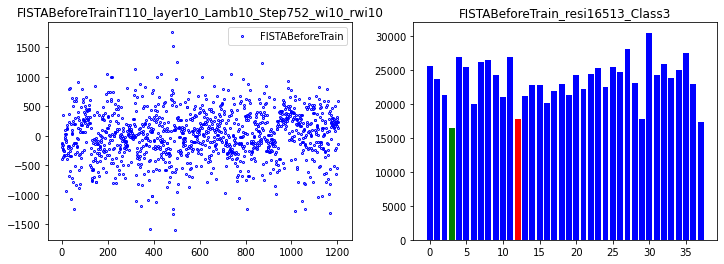

correct rate: 0.8125
correct rate: 0.53125
correct rate: 0.75
correct rate: 0.59375
Epoch [ 10/100]: loss = 211575251.0499,   lambda [max:9.9379], [min:9.9256], 
Epoch [ 20/100]: loss = 33776132.0718,   lambda [max:9.9047], [min:9.8768], 
Epoch [ 30/100]: loss = 21543039.9411,   lambda [max:9.8781], [min:9.8365], 
Epoch [ 40/100]: loss = 16228481.5086,   lambda [max:9.8536], [min:9.8013], 
Epoch [ 50/100]: loss = 14543858.4168,   lambda [max:9.8306], [min:9.7700], 
Epoch [ 60/100]: loss = 13078874.1244,   lambda [max:9.8090], [min:9.7416], 
Epoch [ 70/100]: loss = 11779692.0227,   lambda [max:9.7883], [min:9.7153], 
Epoch [ 80/100]: loss = 10936372.1766,   lambda [max:9.7686], [min:9.6907], 
Epoch [ 90/100]: loss = 10050368.1432,   lambda [max:9.7495], [min:9.6675], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.46875
correct rate: 0.75
Epoch [100/100]: loss = 9874843.9277,   lambda [max:9.7311], [min:9.6453], 


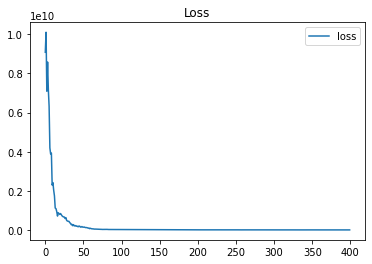

done 10 layers in 95.80ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21818.1497477]


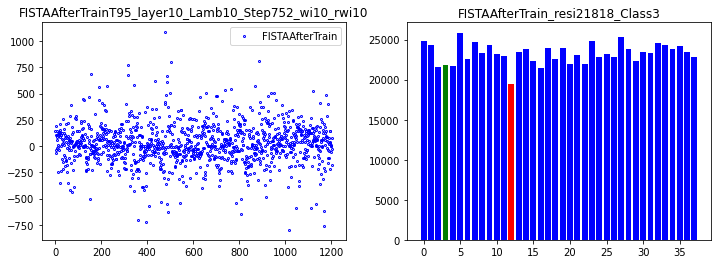

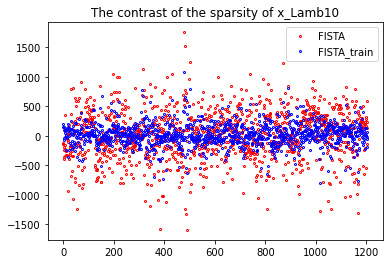

30


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.20ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6135.43966325]


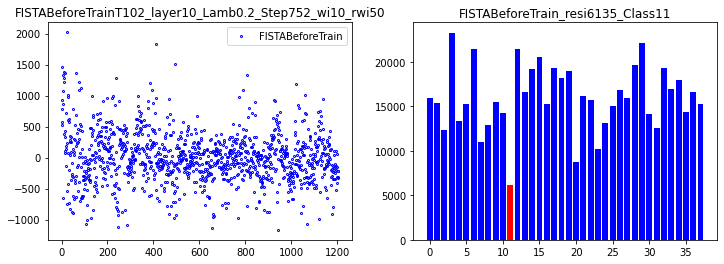

correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.625
correct rate: 0.75
Epoch [ 10/100]: loss = 259319584.9843,   lambda [max:0.1373], [min:0.1265], 
Epoch [ 20/100]: loss = 30942584.9395,   lambda [max:0.1032], [min:0.0772], 
Epoch [ 30/100]: loss = 17479752.1459,   lambda [max:0.0759], [min:0.0368], 
Epoch [ 40/100]: loss = 11695782.0549,   lambda [max:0.0507], [min:0.0014], 
Epoch [ 50/100]: loss = 10409957.9196,   lambda [max:0.0272], [min:-0.0302], 
Epoch [ 60/100]: loss = 8751290.6908,   lambda [max:0.0049], [min:-0.0589], 
Epoch [ 70/100]: loss = 7556787.8142,   lambda [max:-0.0164], [min:-0.0855], 
Epoch [ 80/100]: loss = 7053187.4806,   lambda [max:-0.0368], [min:-0.1105], 
Epoch [ 90/100]: loss = 6203853.2457,   lambda [max:-0.0565], [min:-0.1341], 
correct rate: 0.78125
correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.75
Epoch [100/100]: loss = 5637105.1099,   lambda [max:-0.0757], [min:-0.1566], 


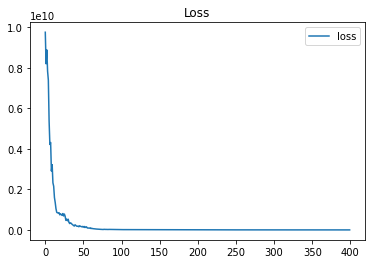

done 10 layers in 119.44ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[14029.86536442]


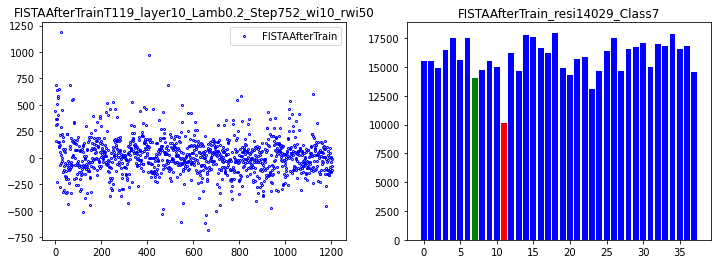

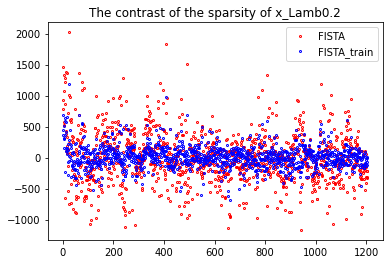

31


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 116.80ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6904.23254266]


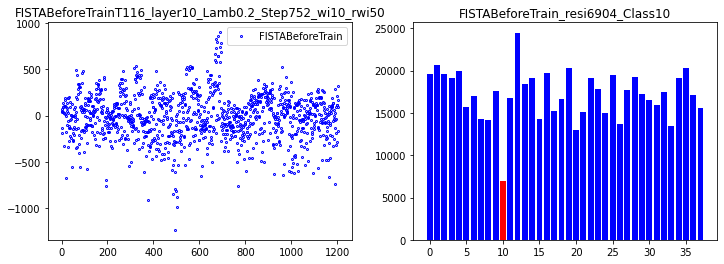

correct rate: 0.625
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.75
Epoch [ 10/100]: loss = 245511630.2830,   lambda [max:0.1375], [min:0.1266], 
Epoch [ 20/100]: loss = 34399184.3725,   lambda [max:0.1034], [min:0.0766], 
Epoch [ 30/100]: loss = 15066602.7977,   lambda [max:0.0759], [min:0.0362], 
Epoch [ 40/100]: loss = 11653507.9593,   lambda [max:0.0508], [min:0.0012], 
Epoch [ 50/100]: loss = 9572586.2205,   lambda [max:0.0272], [min:-0.0301], 
Epoch [ 60/100]: loss = 7863066.1747,   lambda [max:0.0049], [min:-0.0586], 
Epoch [ 70/100]: loss = 7527530.1348,   lambda [max:-0.0165], [min:-0.0849], 
Epoch [ 80/100]: loss = 6676453.1423,   lambda [max:-0.0371], [min:-0.1095], 
Epoch [ 90/100]: loss = 5971732.7706,   lambda [max:-0.0570], [min:-0.1329], 
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.78125
correct rate: 0.5625
Epoch [100/100]: loss = 5579576.8363,   lambda [max:-0.0763], [min:-0.1551], 


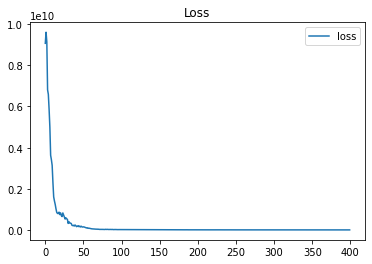

done 10 layers in 96.12ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[10823.62621387]


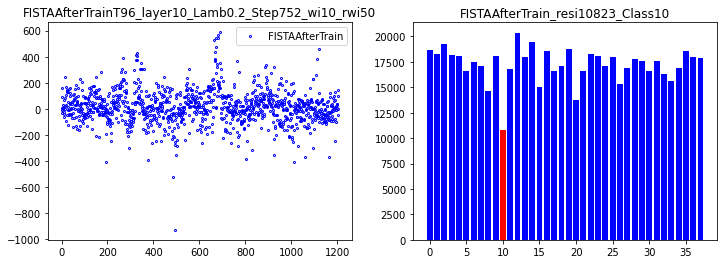

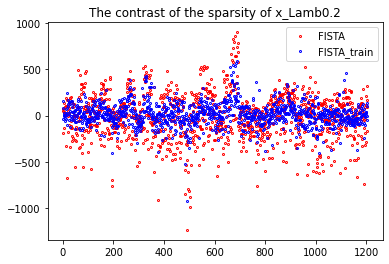

32


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 116.20ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.11572183]


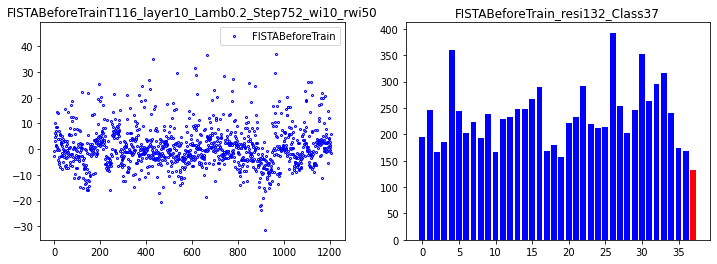

correct rate: 0.65625
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.75
Epoch [ 10/100]: loss = 206628321.6535,   lambda [max:0.1374], [min:0.1262], 
Epoch [ 20/100]: loss = 30565509.5510,   lambda [max:0.1040], [min:0.0769], 
Epoch [ 30/100]: loss = 16722071.2813,   lambda [max:0.0772], [min:0.0367], 
Epoch [ 40/100]: loss = 12544973.4191,   lambda [max:0.0523], [min:0.0017], 
Epoch [ 50/100]: loss = 10374427.2626,   lambda [max:0.0290], [min:-0.0297], 
Epoch [ 60/100]: loss = 8205673.2424,   lambda [max:0.0069], [min:-0.0583], 
Epoch [ 70/100]: loss = 7487115.2338,   lambda [max:-0.0144], [min:-0.0847], 
Epoch [ 80/100]: loss = 6892689.5099,   lambda [max:-0.0348], [min:-0.1096], 
Epoch [ 90/100]: loss = 6131620.9945,   lambda [max:-0.0545], [min:-0.1331], 
correct rate: 0.71875
correct rate: 0.75
correct rate: 0.59375
correct rate: 0.71875
Epoch [100/100]: loss = 5679271.3858,   lambda [max:-0.0737], [min:-0.1555], 


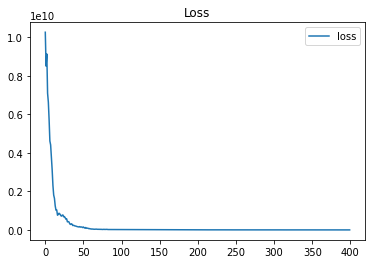

done 10 layers in 109.75ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[170.96611671]


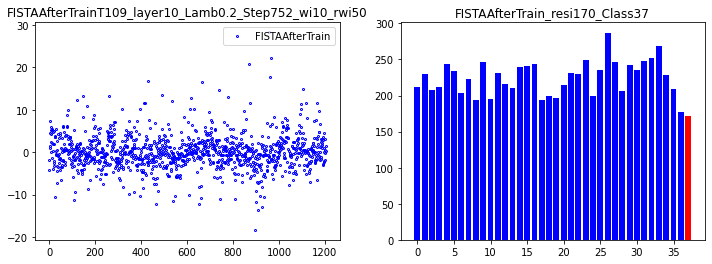

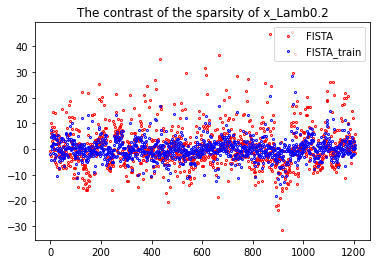

33


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 119.31ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4726.46574361]


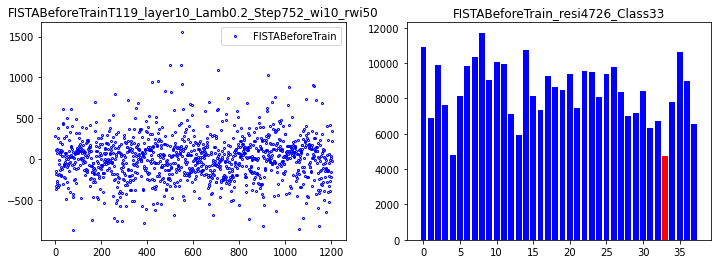

correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.84375
Epoch [ 10/100]: loss = 201312448.2693,   lambda [max:0.1374], [min:0.1264], 
Epoch [ 20/100]: loss = 27905596.6868,   lambda [max:0.1040], [min:0.0777], 
Epoch [ 30/100]: loss = 17474747.4347,   lambda [max:0.0775], [min:0.0376], 
Epoch [ 40/100]: loss = 12224098.1888,   lambda [max:0.0530], [min:0.0026], 
Epoch [ 50/100]: loss = 10857856.7917,   lambda [max:0.0301], [min:-0.0288], 
Epoch [ 60/100]: loss = 8110165.0142,   lambda [max:0.0082], [min:-0.0573], 
Epoch [ 70/100]: loss = 7328111.4129,   lambda [max:-0.0127], [min:-0.0837], 
Epoch [ 80/100]: loss = 5984239.2261,   lambda [max:-0.0329], [min:-0.1085], 
Epoch [ 90/100]: loss = 5897443.4371,   lambda [max:-0.0524], [min:-0.1320], 
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.65625
Epoch [100/100]: loss = 5826739.0103,   lambda [max:-0.0714], [min:-0.1543], 


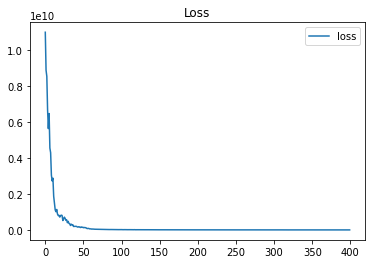

done 10 layers in 97.22ms
predict class: yaleB13
test image label: yaleB35
predict residuals label: 12
test residuals label: 33
[7503.55729833]


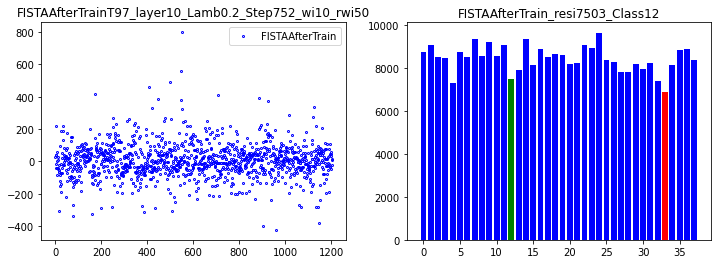

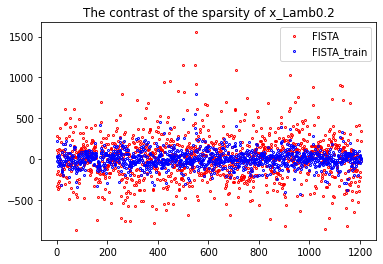

34


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 112.27ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5982.98608124]


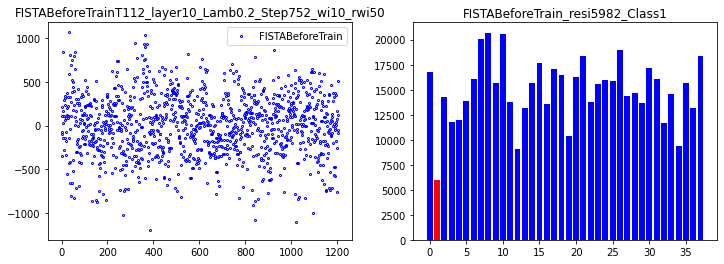

correct rate: 0.75
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.59375
Epoch [ 10/100]: loss = 229623204.0760,   lambda [max:0.1380], [min:0.1259], 
Epoch [ 20/100]: loss = 29440754.9775,   lambda [max:0.1042], [min:0.0777], 
Epoch [ 30/100]: loss = 15776599.0848,   lambda [max:0.0768], [min:0.0374], 
Epoch [ 40/100]: loss = 11754822.7206,   lambda [max:0.0517], [min:0.0020], 
Epoch [ 50/100]: loss = 9655043.1591,   lambda [max:0.0280], [min:-0.0295], 
Epoch [ 60/100]: loss = 8794462.1992,   lambda [max:0.0057], [min:-0.0582], 
Epoch [ 70/100]: loss = 7541670.5489,   lambda [max:-0.0157], [min:-0.0848], 
Epoch [ 80/100]: loss = 6257151.3032,   lambda [max:-0.0363], [min:-0.1097], 
Epoch [ 90/100]: loss = 5911258.2893,   lambda [max:-0.0561], [min:-0.1332], 
correct rate: 0.75
correct rate: 0.625
correct rate: 0.75
correct rate: 0.71875
Epoch [100/100]: loss = 5657017.6123,   lambda [max:-0.0754], [min:-0.1556], 


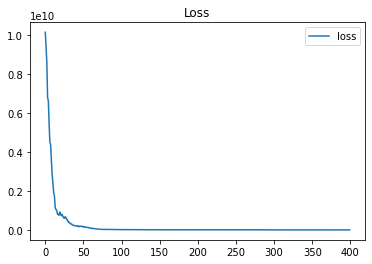

done 10 layers in 101.11ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[10953.14611473]


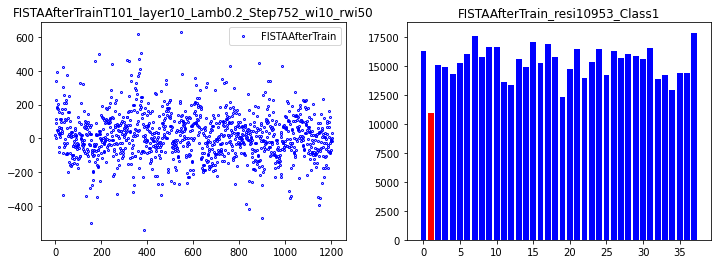

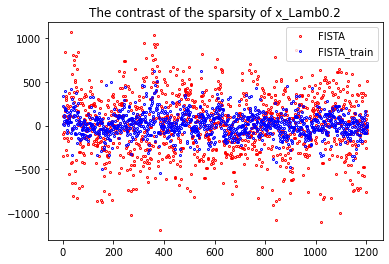

35


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.72ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.91111018]


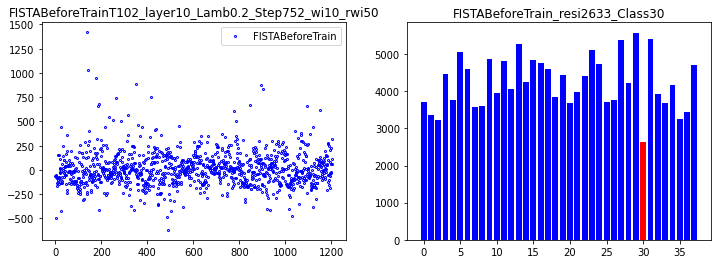

correct rate: 0.8125
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.59375
Epoch [ 10/100]: loss = 207006699.2727,   lambda [max:0.1371], [min:0.1258], 
Epoch [ 20/100]: loss = 30267764.6812,   lambda [max:0.1037], [min:0.0759], 
Epoch [ 30/100]: loss = 16906858.1252,   lambda [max:0.0765], [min:0.0350], 
Epoch [ 40/100]: loss = 12139291.1154,   lambda [max:0.0515], [min:-0.0006], 
Epoch [ 50/100]: loss = 10240102.3844,   lambda [max:0.0282], [min:-0.0325], 
Epoch [ 60/100]: loss = 8313044.0773,   lambda [max:0.0060], [min:-0.0613], 
Epoch [ 70/100]: loss = 7678895.4435,   lambda [max:-0.0152], [min:-0.0881], 
Epoch [ 80/100]: loss = 6757361.8623,   lambda [max:-0.0356], [min:-0.1132], 
Epoch [ 90/100]: loss = 6148694.3816,   lambda [max:-0.0553], [min:-0.1368], 
correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.78125
correct rate: 0.71875
Epoch [100/100]: loss = 5408286.6527,   lambda [max:-0.0745], [min:-0.1593], 


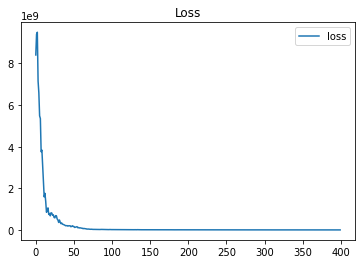

done 10 layers in 96.07ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3077.76191399]


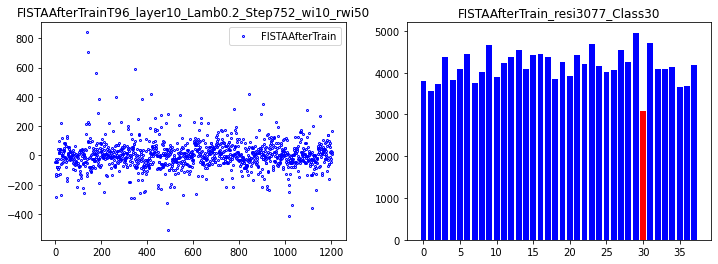

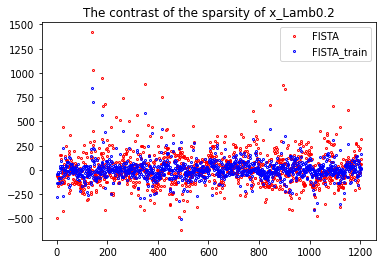

36


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 99.67ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6125.4037645]


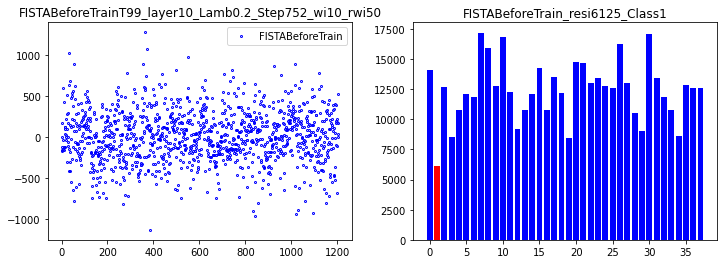

correct rate: 0.78125
correct rate: 0.59375
correct rate: 0.625
correct rate: 0.75
Epoch [ 10/100]: loss = 194198785.8602,   lambda [max:0.1373], [min:0.1264], 
Epoch [ 20/100]: loss = 29954513.1423,   lambda [max:0.1035], [min:0.0764], 
Epoch [ 30/100]: loss = 17540851.7399,   lambda [max:0.0765], [min:0.0359], 
Epoch [ 40/100]: loss = 12399557.0666,   lambda [max:0.0516], [min:0.0005], 
Epoch [ 50/100]: loss = 10297472.5338,   lambda [max:0.0282], [min:-0.0311], 
Epoch [ 60/100]: loss = 8557028.9436,   lambda [max:0.0061], [min:-0.0599], 
Epoch [ 70/100]: loss = 7367366.5099,   lambda [max:-0.0150], [min:-0.0866], 
Epoch [ 80/100]: loss = 6733454.3047,   lambda [max:-0.0354], [min:-0.1115], 
Epoch [ 90/100]: loss = 6574767.1052,   lambda [max:-0.0550], [min:-0.1351], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.71875
Epoch [100/100]: loss = 5403388.1931,   lambda [max:-0.0742], [min:-0.1576], 


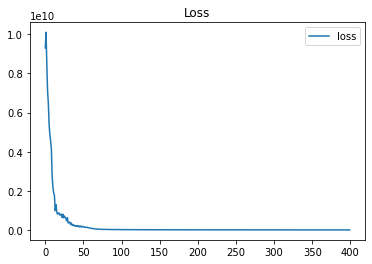

done 10 layers in 96.39ms
predict class: yaleB36
test image label: yaleB02
predict residuals label: 34
test residuals label: 1
[10194.31367194]


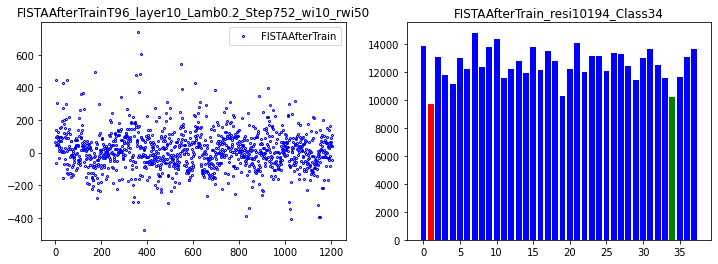

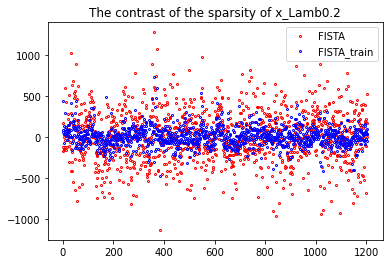

37


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 103.90ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.5421843]


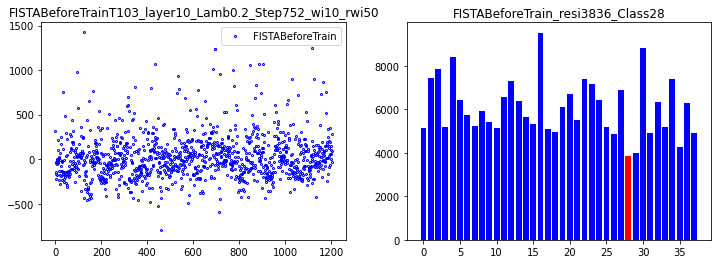

correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.8125
Epoch [ 10/100]: loss = 196240773.4511,   lambda [max:0.1374], [min:0.1260], 
Epoch [ 20/100]: loss = 29935002.3083,   lambda [max:0.1038], [min:0.0766], 
Epoch [ 30/100]: loss = 15651730.9229,   lambda [max:0.0769], [min:0.0363], 
Epoch [ 40/100]: loss = 12207498.7975,   lambda [max:0.0522], [min:0.0011], 
Epoch [ 50/100]: loss = 9796569.5093,   lambda [max:0.0289], [min:-0.0302], 
Epoch [ 60/100]: loss = 8409732.3506,   lambda [max:0.0069], [min:-0.0587], 
Epoch [ 70/100]: loss = 7231285.9055,   lambda [max:-0.0143], [min:-0.0851], 
Epoch [ 80/100]: loss = 6353027.1522,   lambda [max:-0.0347], [min:-0.1098], 
Epoch [ 90/100]: loss = 5854145.3660,   lambda [max:-0.0545], [min:-0.1331], 
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.78125
correct rate: 0.625
Epoch [100/100]: loss = 5537521.2840,   lambda [max:-0.0737], [min:-0.1554], 


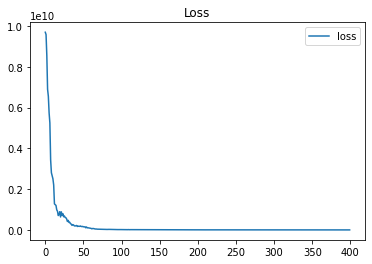

done 10 layers in 110.83ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4692.47092551]


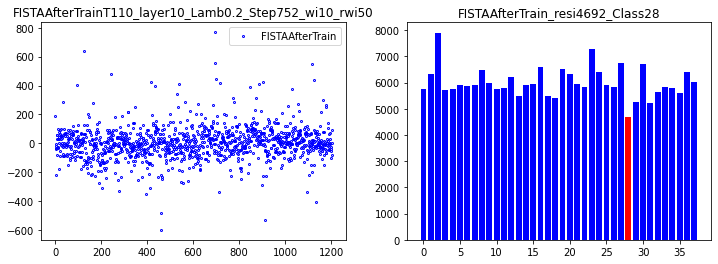

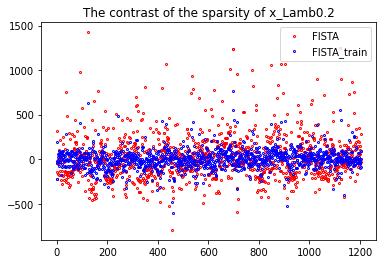

38


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.58ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11038.75418564]


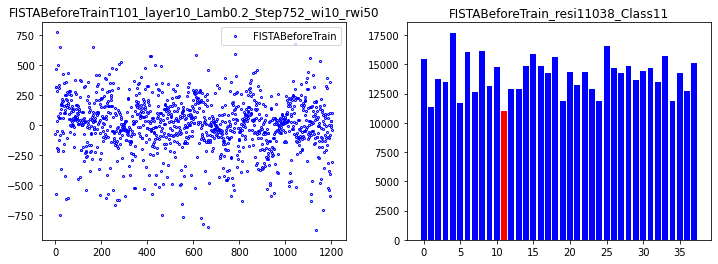

correct rate: 0.65625
correct rate: 0.8125
correct rate: 0.625
correct rate: 0.625
Epoch [ 10/100]: loss = 223383802.2951,   lambda [max:0.1378], [min:0.1265], 
Epoch [ 20/100]: loss = 26329347.8376,   lambda [max:0.1035], [min:0.0760], 
Epoch [ 30/100]: loss = 16710135.6504,   lambda [max:0.0764], [min:0.0353], 
Epoch [ 40/100]: loss = 12468747.1037,   lambda [max:0.0516], [min:-0.0001], 
Epoch [ 50/100]: loss = 9269337.2888,   lambda [max:0.0284], [min:-0.0314], 
Epoch [ 60/100]: loss = 8233338.0211,   lambda [max:0.0063], [min:-0.0598], 
Epoch [ 70/100]: loss = 7457484.5449,   lambda [max:-0.0147], [min:-0.0862], 
Epoch [ 80/100]: loss = 6509870.6716,   lambda [max:-0.0350], [min:-0.1109], 
Epoch [ 90/100]: loss = 6106239.0499,   lambda [max:-0.0547], [min:-0.1342], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.75
Epoch [100/100]: loss = 5520588.3009,   lambda [max:-0.0738], [min:-0.1565], 


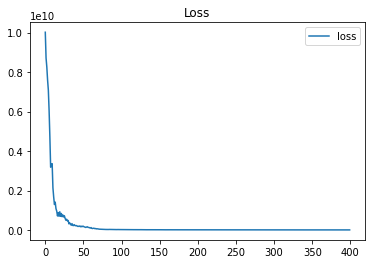

done 10 layers in 100.47ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11313.59026537]


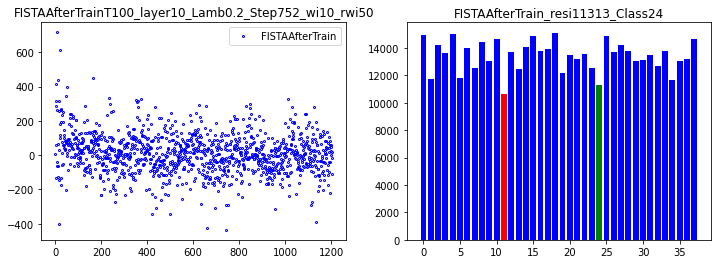

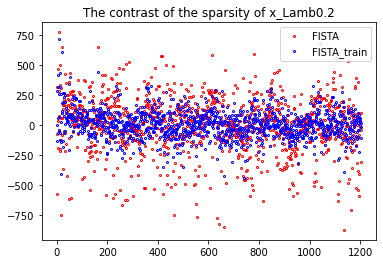

39


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.15ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16511.1576364]


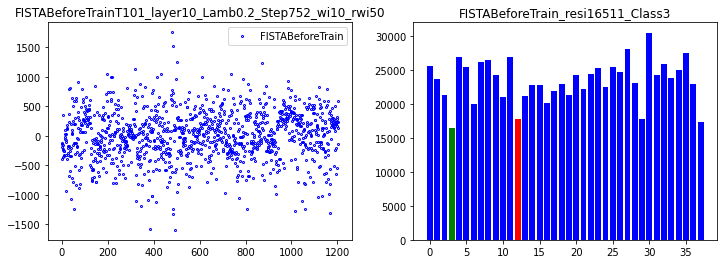

correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.71875
Epoch [ 10/100]: loss = 229132570.7062,   lambda [max:0.1375], [min:0.1268], 
Epoch [ 20/100]: loss = 33986990.5703,   lambda [max:0.1045], [min:0.0775], 
Epoch [ 30/100]: loss = 15935661.5875,   lambda [max:0.0780], [min:0.0373], 
Epoch [ 40/100]: loss = 13401012.9509,   lambda [max:0.0535], [min:0.0021], 
Epoch [ 50/100]: loss = 9643118.5718,   lambda [max:0.0302], [min:-0.0293], 
Epoch [ 60/100]: loss = 8005045.5313,   lambda [max:0.0082], [min:-0.0579], 
Epoch [ 70/100]: loss = 6942061.4345,   lambda [max:-0.0128], [min:-0.0843], 
Epoch [ 80/100]: loss = 6382401.4017,   lambda [max:-0.0331], [min:-0.1095], 
Epoch [ 90/100]: loss = 5815320.6645,   lambda [max:-0.0527], [min:-0.1330], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.8125
Epoch [100/100]: loss = 5556552.4804,   lambda [max:-0.0718], [min:-0.1554], 


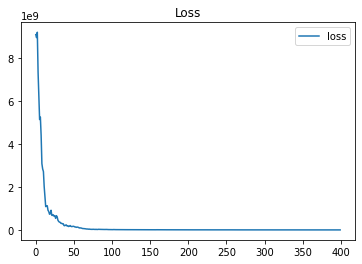

done 10 layers in 95.20ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21541.09210758]


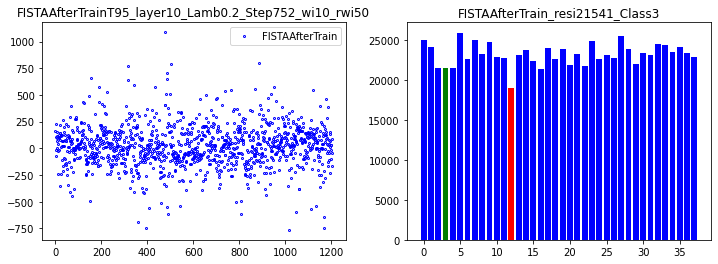

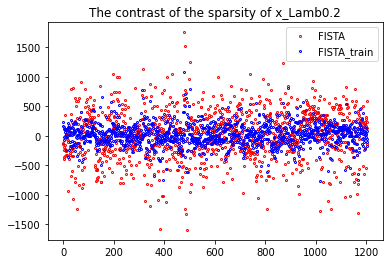

40


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 93.34ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6135.27056371]


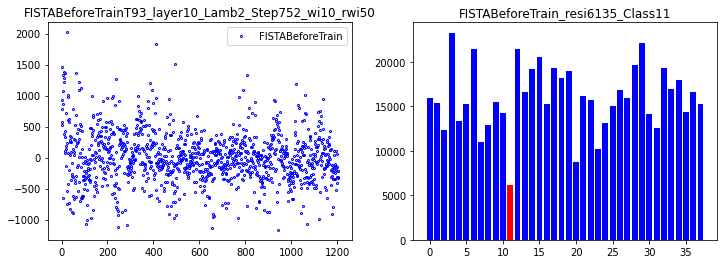

correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.6875
Epoch [ 10/100]: loss = 220544949.3720,   lambda [max:1.9374], [min:1.9265], 
Epoch [ 20/100]: loss = 32908623.2708,   lambda [max:1.9035], [min:1.8765], 
Epoch [ 30/100]: loss = 17326538.0840,   lambda [max:1.8768], [min:1.8357], 
Epoch [ 40/100]: loss = 13647446.3110,   lambda [max:1.8522], [min:1.8002], 
Epoch [ 50/100]: loss = 11399715.5265,   lambda [max:1.8292], [min:1.7685], 
Epoch [ 60/100]: loss = 9304382.9843,   lambda [max:1.8073], [min:1.7397], 
Epoch [ 70/100]: loss = 8690376.0540,   lambda [max:1.7864], [min:1.7130], 
Epoch [ 80/100]: loss = 8264788.1334,   lambda [max:1.7663], [min:1.6880], 
Epoch [ 90/100]: loss = 8231166.3401,   lambda [max:1.7468], [min:1.6644], 
correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.8125
correct rate: 0.78125
Epoch [100/100]: loss = 6796004.7721,   lambda [max:1.7279], [min:1.6419], 


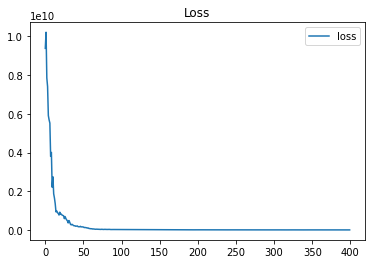

done 10 layers in 110.50ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[14053.89542627]


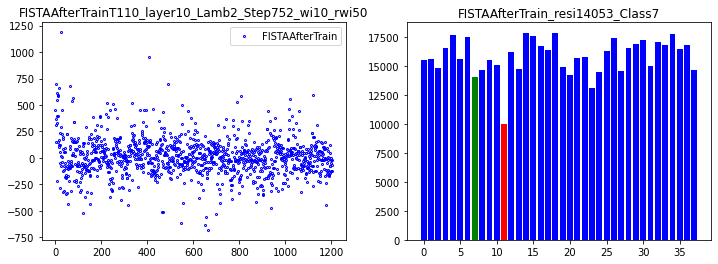

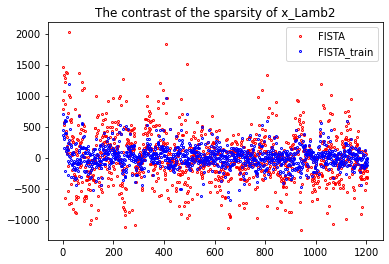

41


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.55ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6904.66862168]


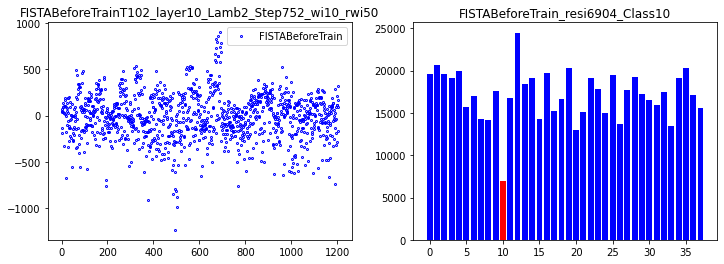

correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.6875
Epoch [ 10/100]: loss = 223543548.7185,   lambda [max:1.9375], [min:1.9264], 
Epoch [ 20/100]: loss = 34335462.4080,   lambda [max:1.9039], [min:1.8764], 
Epoch [ 30/100]: loss = 19961063.4795,   lambda [max:1.8771], [min:1.8362], 
Epoch [ 40/100]: loss = 13412998.1509,   lambda [max:1.8523], [min:1.8009], 
Epoch [ 50/100]: loss = 10193043.0393,   lambda [max:1.8290], [min:1.7695], 
Epoch [ 60/100]: loss = 10843116.9180,   lambda [max:1.8069], [min:1.7410], 
Epoch [ 70/100]: loss = 8599693.6696,   lambda [max:1.7858], [min:1.7146], 
Epoch [ 80/100]: loss = 7914250.9878,   lambda [max:1.7656], [min:1.6899], 
Epoch [ 90/100]: loss = 7233623.4561,   lambda [max:1.7459], [min:1.6665], 
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.75
Epoch [100/100]: loss = 7223072.7584,   lambda [max:1.7268], [min:1.6443], 


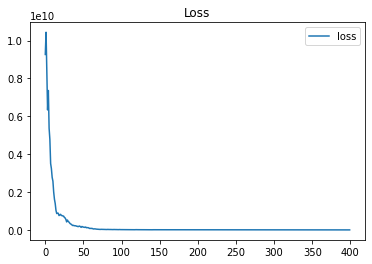

done 10 layers in 95.37ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[10856.84456385]


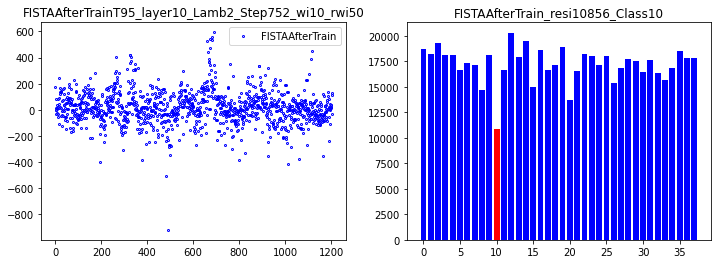

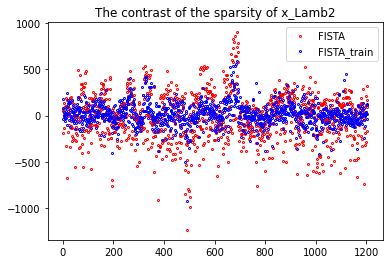

42


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 112.05ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.14730092]


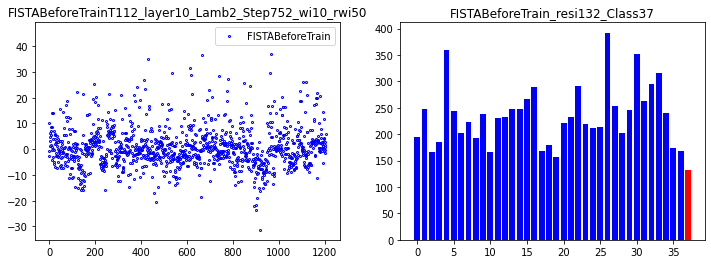

correct rate: 0.625
correct rate: 0.59375
correct rate: 0.8125
correct rate: 0.71875
Epoch [ 10/100]: loss = 207732543.2511,   lambda [max:1.9371], [min:1.9265], 
Epoch [ 20/100]: loss = 32709355.0163,   lambda [max:1.9040], [min:1.8768], 
Epoch [ 30/100]: loss = 18812900.6193,   lambda [max:1.8774], [min:1.8363], 
Epoch [ 40/100]: loss = 13777189.7317,   lambda [max:1.8527], [min:1.8009], 
Epoch [ 50/100]: loss = 12004183.0812,   lambda [max:1.8297], [min:1.7691], 
Epoch [ 60/100]: loss = 9594147.3473,   lambda [max:1.8078], [min:1.7402], 
Epoch [ 70/100]: loss = 8296017.2305,   lambda [max:1.7869], [min:1.7136], 
Epoch [ 80/100]: loss = 7884699.7150,   lambda [max:1.7668], [min:1.6886], 
Epoch [ 90/100]: loss = 7406988.8668,   lambda [max:1.7473], [min:1.6650], 
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.75
Epoch [100/100]: loss = 6825592.6958,   lambda [max:1.7284], [min:1.6425], 


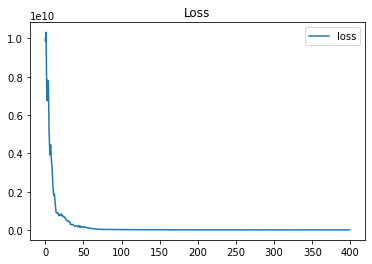

done 10 layers in 101.31ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[171.69092773]


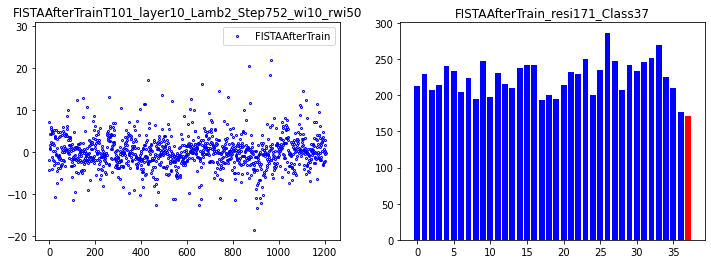

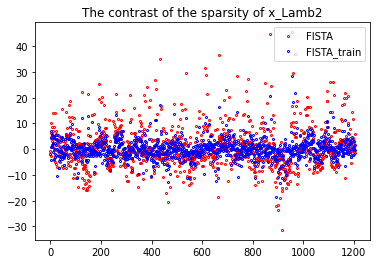

43


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.03ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4726.57002266]


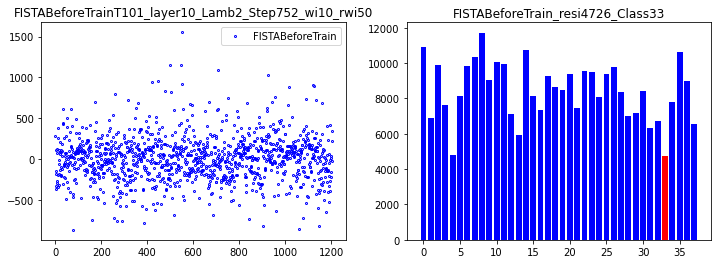

correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.78125
Epoch [ 10/100]: loss = 199598233.5166,   lambda [max:1.9375], [min:1.9259], 
Epoch [ 20/100]: loss = 32026337.0015,   lambda [max:1.9033], [min:1.8768], 
Epoch [ 30/100]: loss = 19447472.9858,   lambda [max:1.8762], [min:1.8367], 
Epoch [ 40/100]: loss = 13899646.2270,   lambda [max:1.8513], [min:1.8016], 
Epoch [ 50/100]: loss = 11579153.3894,   lambda [max:1.8278], [min:1.7704], 
Epoch [ 60/100]: loss = 9100919.1964,   lambda [max:1.8056], [min:1.7421], 
Epoch [ 70/100]: loss = 8619799.7954,   lambda [max:1.7844], [min:1.7159], 
Epoch [ 80/100]: loss = 7636442.6581,   lambda [max:1.7640], [min:1.6914], 
Epoch [ 90/100]: loss = 7182784.2445,   lambda [max:1.7442], [min:1.6683], 
correct rate: 0.71875
correct rate: 0.78125
correct rate: 0.78125
correct rate: 0.5625
Epoch [100/100]: loss = 7154649.7934,   lambda [max:1.7251], [min:1.6462], 


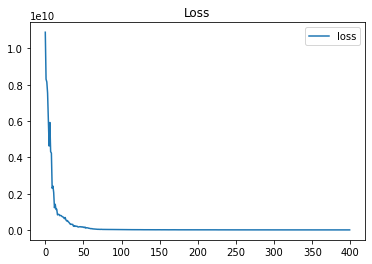

done 10 layers in 96.61ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6846.58558014]


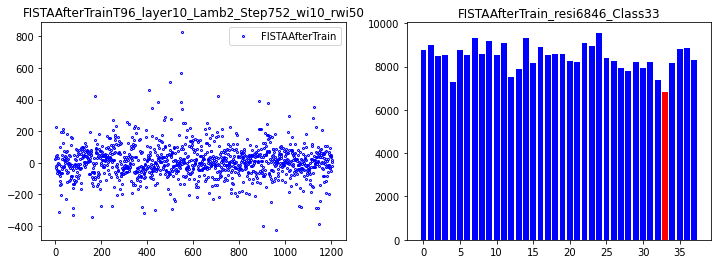

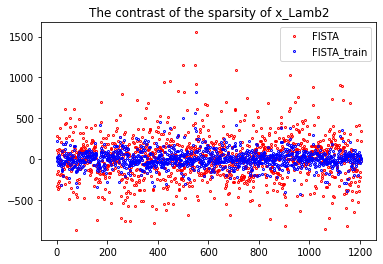

44


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.00ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5983.44513674]


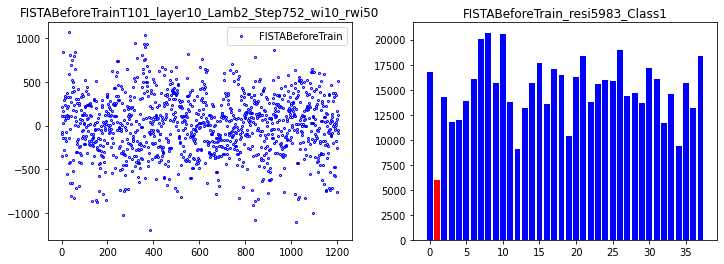

correct rate: 0.84375
correct rate: 0.71875
correct rate: 0.53125
correct rate: 0.65625
Epoch [ 10/100]: loss = 211697903.5613,   lambda [max:1.9376], [min:1.9263], 
Epoch [ 20/100]: loss = 31837751.1358,   lambda [max:1.9035], [min:1.8786], 
Epoch [ 30/100]: loss = 18915102.9447,   lambda [max:1.8763], [min:1.8379], 
Epoch [ 40/100]: loss = 13673437.2444,   lambda [max:1.8515], [min:1.8021], 
Epoch [ 50/100]: loss = 10501255.2990,   lambda [max:1.8282], [min:1.7702], 
Epoch [ 60/100]: loss = 9592993.2624,   lambda [max:1.8062], [min:1.7412], 
Epoch [ 70/100]: loss = 8833751.4616,   lambda [max:1.7851], [min:1.7144], 
Epoch [ 80/100]: loss = 7649970.2174,   lambda [max:1.7649], [min:1.6893], 
Epoch [ 90/100]: loss = 7227736.0728,   lambda [max:1.7454], [min:1.6655], 
correct rate: 0.71875
correct rate: 0.75
correct rate: 0.53125
correct rate: 0.8125
Epoch [100/100]: loss = 6462028.3109,   lambda [max:1.7264], [min:1.6430], 


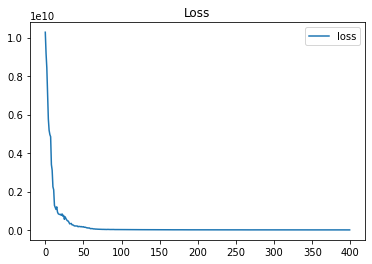

done 10 layers in 95.65ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[10939.39545451]


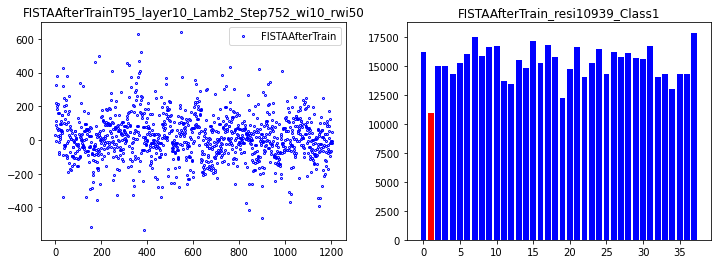

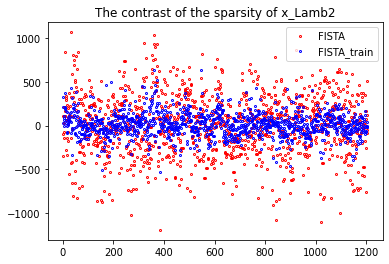

45


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 109.59ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.88200257]


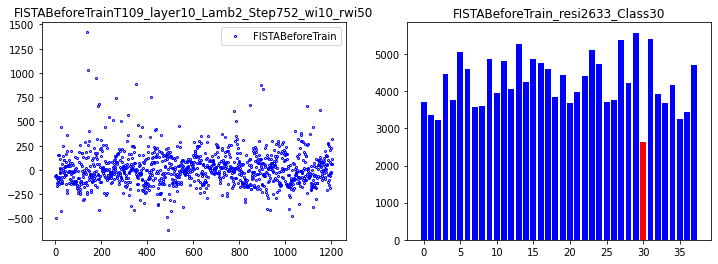

correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.625
correct rate: 0.84375
Epoch [ 10/100]: loss = 200980531.7116,   lambda [max:1.9373], [min:1.9258], 
Epoch [ 20/100]: loss = 29615423.0165,   lambda [max:1.9035], [min:1.8764], 
Epoch [ 30/100]: loss = 18206773.8799,   lambda [max:1.8764], [min:1.8357], 
Epoch [ 40/100]: loss = 13126959.4292,   lambda [max:1.8513], [min:1.8001], 
Epoch [ 50/100]: loss = 11477115.0639,   lambda [max:1.8277], [min:1.7684], 
Epoch [ 60/100]: loss = 10056785.4491,   lambda [max:1.8054], [min:1.7396], 
Epoch [ 70/100]: loss = 8714268.1235,   lambda [max:1.7841], [min:1.7130], 
Epoch [ 80/100]: loss = 8025538.4806,   lambda [max:1.7636], [min:1.6881], 
Epoch [ 90/100]: loss = 7427291.9679,   lambda [max:1.7438], [min:1.6645], 
correct rate: 0.65625
correct rate: 0.78125
correct rate: 0.78125
correct rate: 0.625
Epoch [100/100]: loss = 6838613.1283,   lambda [max:1.7246], [min:1.6420], 


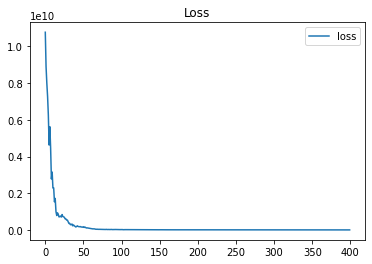

done 10 layers in 101.24ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3079.23869707]


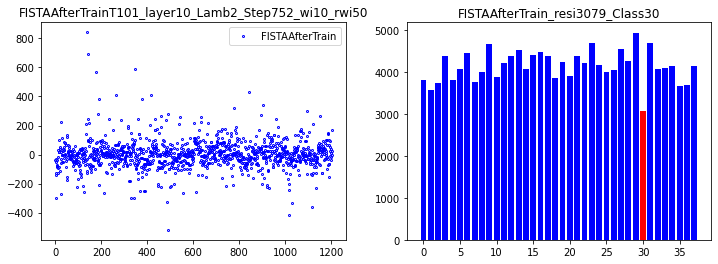

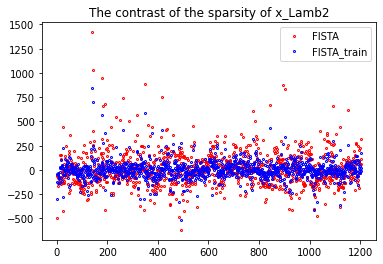

46


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 100.95ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6125.85516692]


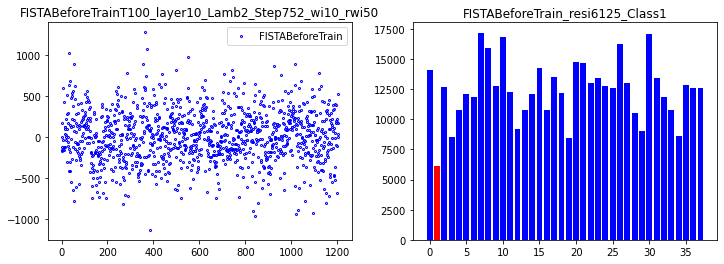

correct rate: 0.65625
correct rate: 0.75
correct rate: 0.625
correct rate: 0.75
Epoch [ 10/100]: loss = 196144377.3228,   lambda [max:1.9379], [min:1.9266], 
Epoch [ 20/100]: loss = 32550419.9606,   lambda [max:1.9048], [min:1.8766], 
Epoch [ 30/100]: loss = 17468617.1660,   lambda [max:1.8782], [min:1.8365], 
Epoch [ 40/100]: loss = 12240597.6457,   lambda [max:1.8536], [min:1.8015], 
Epoch [ 50/100]: loss = 11218969.8099,   lambda [max:1.8306], [min:1.7703], 
Epoch [ 60/100]: loss = 10262976.0277,   lambda [max:1.8087], [min:1.7420], 
Epoch [ 70/100]: loss = 8803040.4652,   lambda [max:1.7877], [min:1.7157], 
Epoch [ 80/100]: loss = 8341315.7198,   lambda [max:1.7675], [min:1.6911], 
Epoch [ 90/100]: loss = 7651411.3908,   lambda [max:1.7479], [min:1.6678], 
correct rate: 0.78125
correct rate: 0.53125
correct rate: 0.75
correct rate: 0.75
Epoch [100/100]: loss = 6806308.3015,   lambda [max:1.7288], [min:1.6455], 


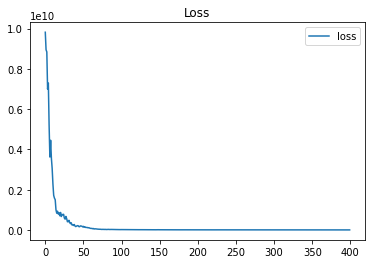

done 10 layers in 99.77ms
predict class: yaleB36
test image label: yaleB02
predict residuals label: 34
test residuals label: 1
[10179.48302605]


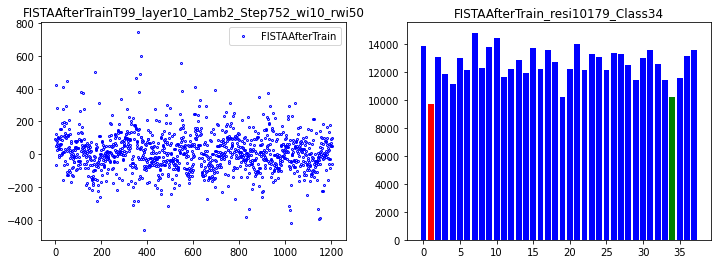

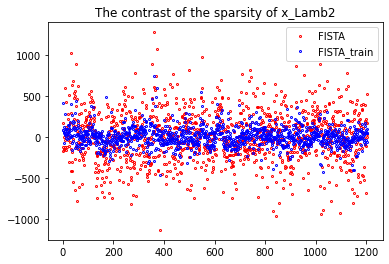

47


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 99.50ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.58414072]


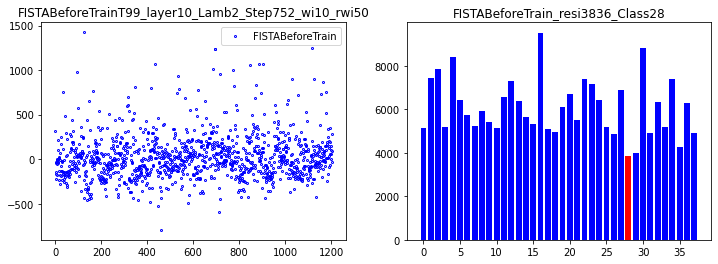

correct rate: 0.78125
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.625
Epoch [ 10/100]: loss = 224689307.3026,   lambda [max:1.9375], [min:1.9259], 
Epoch [ 20/100]: loss = 30905045.4242,   lambda [max:1.9035], [min:1.8769], 
Epoch [ 30/100]: loss = 19878755.8316,   lambda [max:1.8765], [min:1.8367], 
Epoch [ 40/100]: loss = 13473645.8407,   lambda [max:1.8519], [min:1.8015], 
Epoch [ 50/100]: loss = 11193712.9840,   lambda [max:1.8286], [min:1.7699], 
Epoch [ 60/100]: loss = 9761613.6286,   lambda [max:1.8066], [min:1.7411], 
Epoch [ 70/100]: loss = 8882956.6172,   lambda [max:1.7855], [min:1.7145], 
Epoch [ 80/100]: loss = 7791498.3218,   lambda [max:1.7651], [min:1.6895], 
Epoch [ 90/100]: loss = 7072404.2732,   lambda [max:1.7456], [min:1.6659], 
correct rate: 0.65625
correct rate: 0.78125
correct rate: 0.65625
correct rate: 0.75
Epoch [100/100]: loss = 7059992.6058,   lambda [max:1.7265], [min:1.6435], 


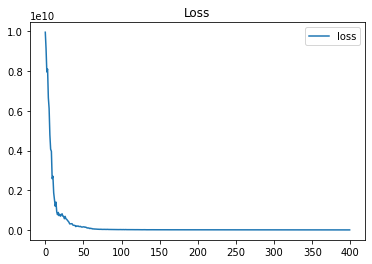

done 10 layers in 96.27ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4700.50374183]


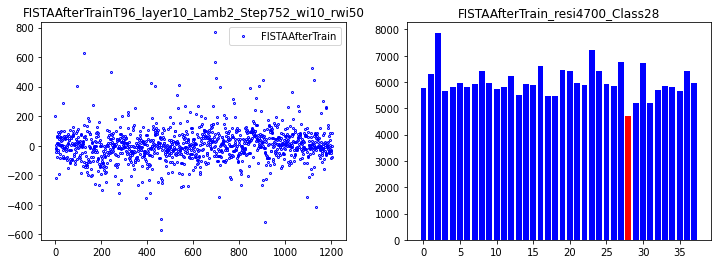

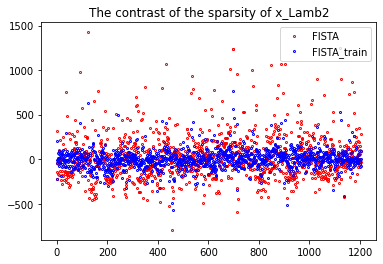

48


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 95.21ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11038.90506418]


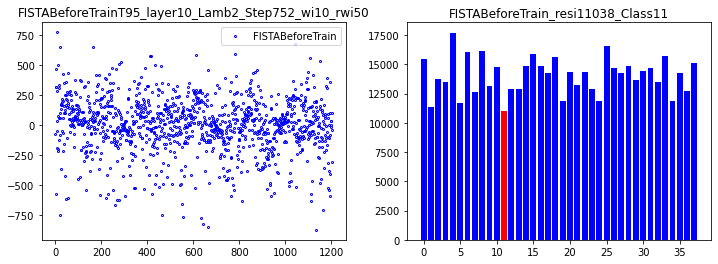

correct rate: 0.59375
correct rate: 0.78125
correct rate: 0.625
correct rate: 0.71875
Epoch [ 10/100]: loss = 218515818.7345,   lambda [max:1.9373], [min:1.9258], 
Epoch [ 20/100]: loss = 33098362.9342,   lambda [max:1.9035], [min:1.8768], 
Epoch [ 30/100]: loss = 18725729.7141,   lambda [max:1.8759], [min:1.8370], 
Epoch [ 40/100]: loss = 12631545.8560,   lambda [max:1.8505], [min:1.8021], 
Epoch [ 50/100]: loss = 11409762.3302,   lambda [max:1.8266], [min:1.7709], 
Epoch [ 60/100]: loss = 10247052.1426,   lambda [max:1.8040], [min:1.7424], 
Epoch [ 70/100]: loss = 9144278.7911,   lambda [max:1.7824], [min:1.7161], 
Epoch [ 80/100]: loss = 7474503.8770,   lambda [max:1.7617], [min:1.6914], 
Epoch [ 90/100]: loss = 7186808.5488,   lambda [max:1.7417], [min:1.6681], 
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.65625
Epoch [100/100]: loss = 6778406.7752,   lambda [max:1.7224], [min:1.6459], 


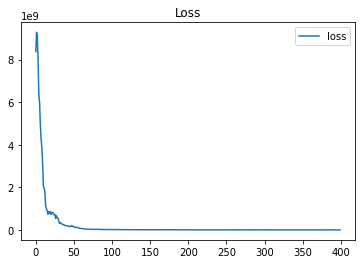

done 10 layers in 111.45ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11368.6548975]


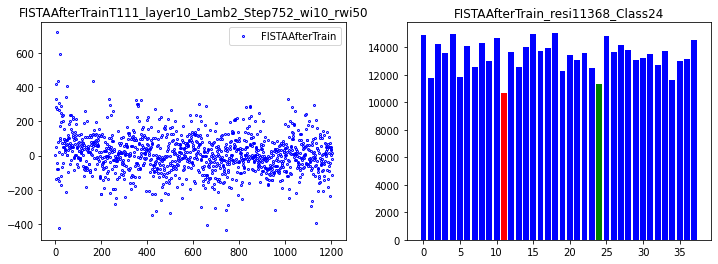

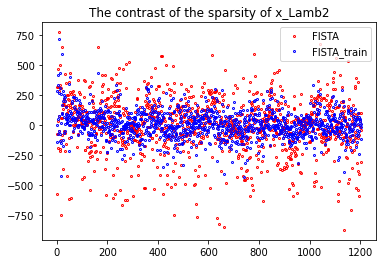

49


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 108.43ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16511.55223475]


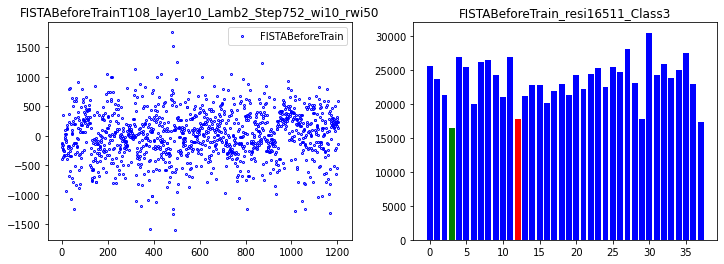

correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.8125
Epoch [ 10/100]: loss = 211435545.3229,   lambda [max:1.9377], [min:1.9257], 
Epoch [ 20/100]: loss = 36435042.0206,   lambda [max:1.9046], [min:1.8775], 
Epoch [ 30/100]: loss = 19288035.1330,   lambda [max:1.8778], [min:1.8375], 
Epoch [ 40/100]: loss = 14273411.8041,   lambda [max:1.8532], [min:1.8026], 
Epoch [ 50/100]: loss = 11662892.3740,   lambda [max:1.8300], [min:1.7712], 
Epoch [ 60/100]: loss = 8998785.3230,   lambda [max:1.8080], [min:1.7426], 
Epoch [ 70/100]: loss = 8756240.3290,   lambda [max:1.7869], [min:1.7161], 
Epoch [ 80/100]: loss = 7575138.1460,   lambda [max:1.7666], [min:1.6914], 
Epoch [ 90/100]: loss = 7421035.7640,   lambda [max:1.7470], [min:1.6679], 
correct rate: 0.625
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.78125
Epoch [100/100]: loss = 6914941.3273,   lambda [max:1.7280], [min:1.6455], 


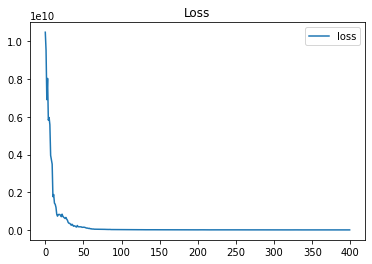

done 10 layers in 95.67ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21666.1582701]


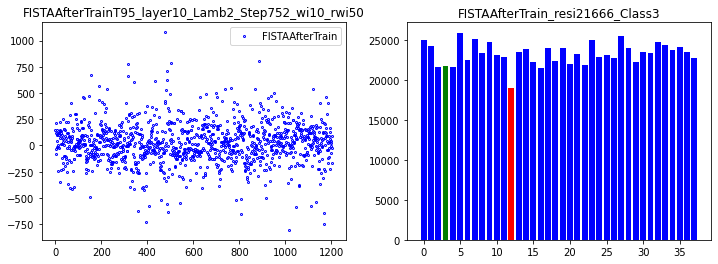

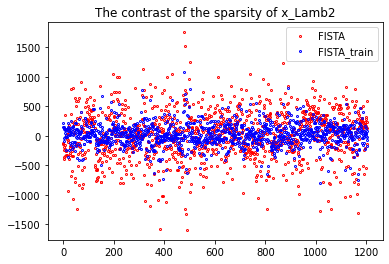

50


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 94.36ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6134.51951648]


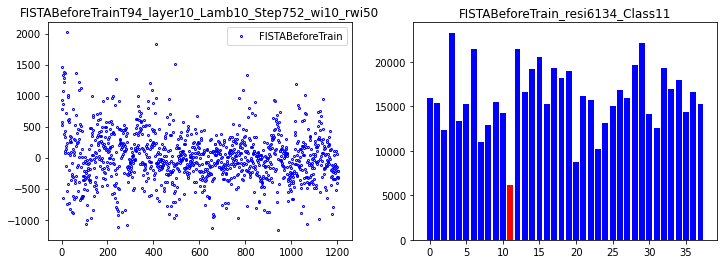

correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.625
Epoch [ 10/100]: loss = 196320741.5704,   lambda [max:9.9374], [min:9.9269], 
Epoch [ 20/100]: loss = 38558334.3371,   lambda [max:9.9037], [min:9.8774], 
Epoch [ 30/100]: loss = 23456346.8728,   lambda [max:9.8768], [min:9.8375], 
Epoch [ 40/100]: loss = 19250782.3070,   lambda [max:9.8520], [min:9.8027], 
Epoch [ 50/100]: loss = 17409377.4640,   lambda [max:9.8289], [min:9.7718], 
Epoch [ 60/100]: loss = 15391325.5835,   lambda [max:9.8069], [min:9.7437], 
Epoch [ 70/100]: loss = 13931028.1222,   lambda [max:9.7859], [min:9.7177], 
Epoch [ 80/100]: loss = 13511916.4627,   lambda [max:9.7658], [min:9.6935], 
Epoch [ 90/100]: loss = 12823889.1728,   lambda [max:9.7464], [min:9.6706], 
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.78125
Epoch [100/100]: loss = 12186988.1493,   lambda [max:9.7276], [min:9.6488], 


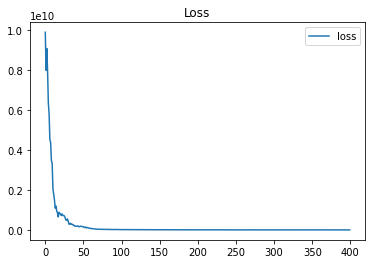

done 10 layers in 95.98ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[14162.46097956]


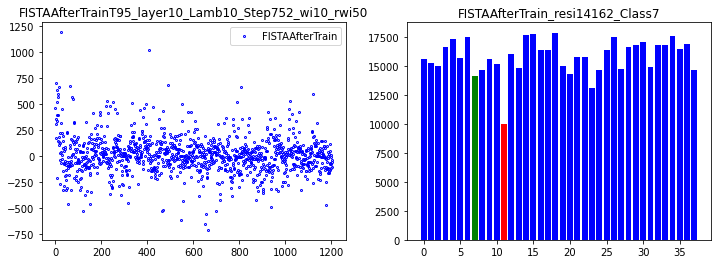

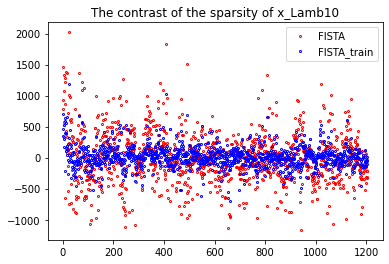

51


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 112.51ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6906.60745131]


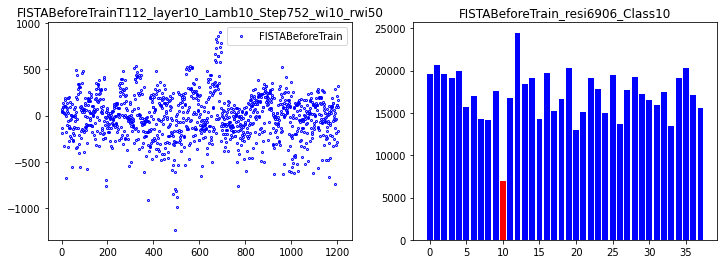

correct rate: 0.78125
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.5625
Epoch [ 10/100]: loss = 219982063.3085,   lambda [max:9.9372], [min:9.9275], 
Epoch [ 20/100]: loss = 38572465.1768,   lambda [max:9.9034], [min:9.8782], 
Epoch [ 30/100]: loss = 22991980.1507,   lambda [max:9.8768], [min:9.8382], 
Epoch [ 40/100]: loss = 18928118.1539,   lambda [max:9.8523], [min:9.8034], 
Epoch [ 50/100]: loss = 16670763.4532,   lambda [max:9.8294], [min:9.7724], 
Epoch [ 60/100]: loss = 15401996.8985,   lambda [max:9.8078], [min:9.7442], 
Epoch [ 70/100]: loss = 13987974.9947,   lambda [max:9.7871], [min:9.7182], 
Epoch [ 80/100]: loss = 13838796.1262,   lambda [max:9.7673], [min:9.6937], 
Epoch [ 90/100]: loss = 13357462.6483,   lambda [max:9.7482], [min:9.6707], 
correct rate: 0.75
correct rate: 0.625
correct rate: 0.71875
correct rate: 0.71875
Epoch [100/100]: loss = 12907588.9423,   lambda [max:9.7296], [min:9.6488], 


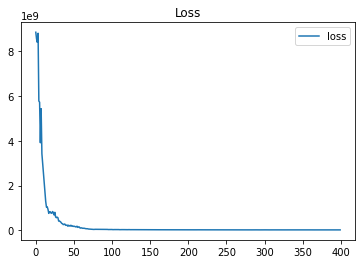

done 10 layers in 103.46ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[10902.58296177]


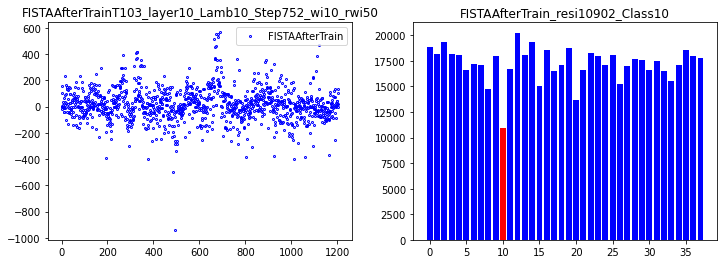

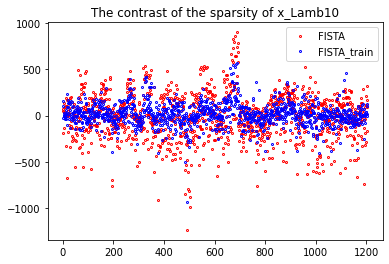

52


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 116.70ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.29430182]


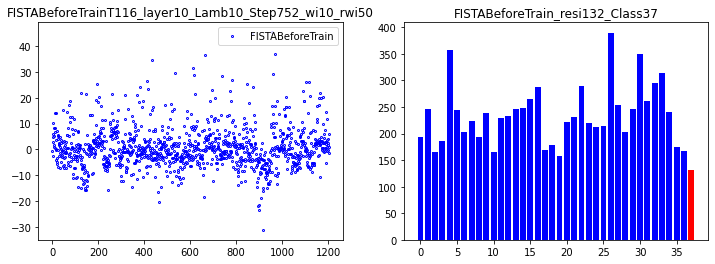

correct rate: 0.75
correct rate: 0.78125
correct rate: 0.65625
correct rate: 0.5625
Epoch [ 10/100]: loss = 228492887.0377,   lambda [max:9.9384], [min:9.9269], 
Epoch [ 20/100]: loss = 37607968.7139,   lambda [max:9.9039], [min:9.8783], 
Epoch [ 30/100]: loss = 22106106.9379,   lambda [max:9.8766], [min:9.8389], 
Epoch [ 40/100]: loss = 19490820.3870,   lambda [max:9.8516], [min:9.8044], 
Epoch [ 50/100]: loss = 17208277.2073,   lambda [max:9.8282], [min:9.7737], 
Epoch [ 60/100]: loss = 15000273.8180,   lambda [max:9.8063], [min:9.7455], 
Epoch [ 70/100]: loss = 14158799.4760,   lambda [max:9.7851], [min:9.7186], 
Epoch [ 80/100]: loss = 12783641.8527,   lambda [max:9.7649], [min:9.6934], 
Epoch [ 90/100]: loss = 12488098.5164,   lambda [max:9.7454], [min:9.6697], 
correct rate: 0.75
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.71875
Epoch [100/100]: loss = 12891368.3954,   lambda [max:9.7266], [min:9.6472], 


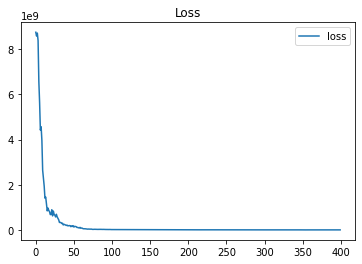

done 10 layers in 98.60ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[173.6129958]


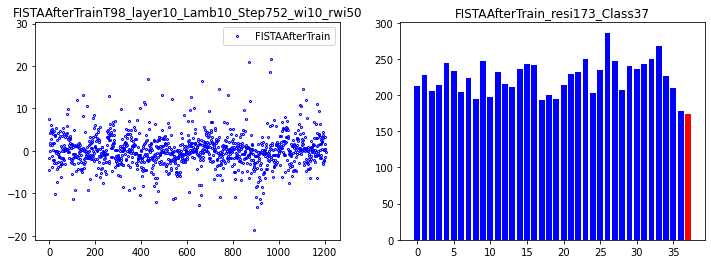

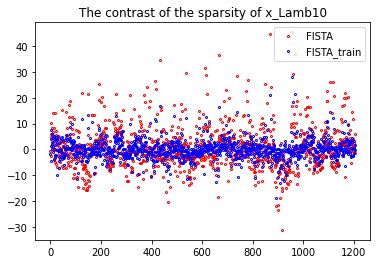

53


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 111.69ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4727.03378325]


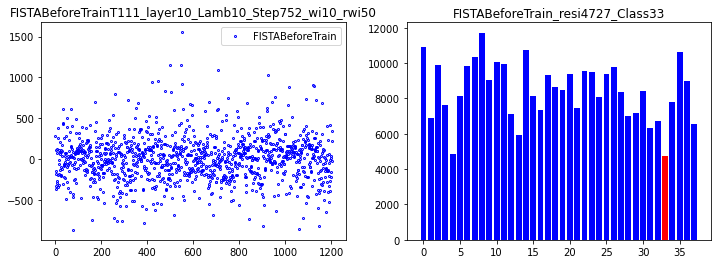

correct rate: 0.71875
correct rate: 0.875
correct rate: 0.53125
correct rate: 0.5625
Epoch [ 10/100]: loss = 220548805.9030,   lambda [max:9.9373], [min:9.9262], 
Epoch [ 20/100]: loss = 40909582.6339,   lambda [max:9.9034], [min:9.8776], 
Epoch [ 30/100]: loss = 22992828.8261,   lambda [max:9.8764], [min:9.8377], 
Epoch [ 40/100]: loss = 19424401.0249,   lambda [max:9.8516], [min:9.8029], 
Epoch [ 50/100]: loss = 16427376.8854,   lambda [max:9.8284], [min:9.7719], 
Epoch [ 60/100]: loss = 15044024.0439,   lambda [max:9.8066], [min:9.7438], 
Epoch [ 70/100]: loss = 14076476.7406,   lambda [max:9.7857], [min:9.7178], 
Epoch [ 80/100]: loss = 13441424.7083,   lambda [max:9.7657], [min:9.6934], 
Epoch [ 90/100]: loss = 13824056.0690,   lambda [max:9.7465], [min:9.6705], 
correct rate: 0.75
correct rate: 0.59375
correct rate: 0.8125
correct rate: 0.625
Epoch [100/100]: loss = 12955456.8498,   lambda [max:9.7278], [min:9.6487], 


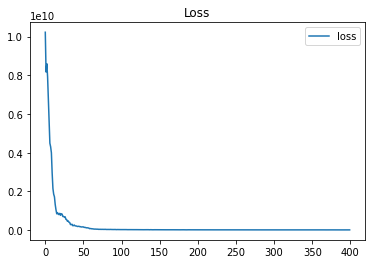

done 10 layers in 107.39ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6881.01909968]


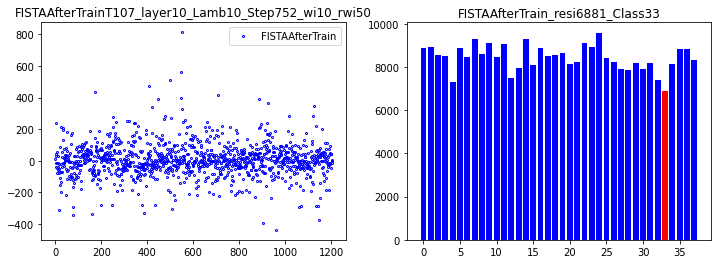

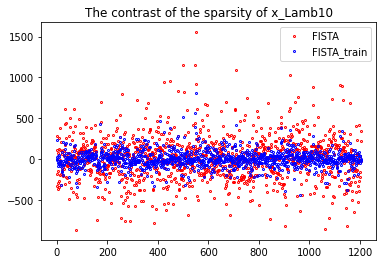

54


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 93.85ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5985.48640629]


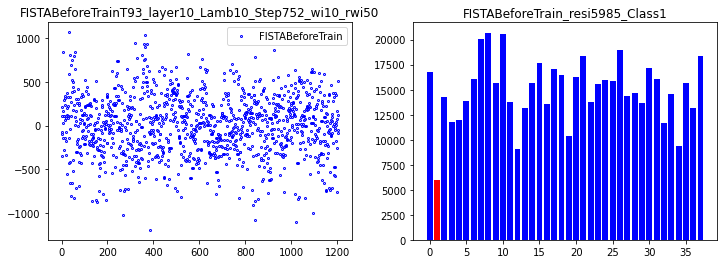

correct rate: 0.625
correct rate: 0.59375
correct rate: 0.84375
correct rate: 0.625
Epoch [ 10/100]: loss = 250479244.7211,   lambda [max:9.9373], [min:9.9259], 
Epoch [ 20/100]: loss = 40684581.6780,   lambda [max:9.9037], [min:9.8779], 
Epoch [ 30/100]: loss = 23387617.1687,   lambda [max:9.8767], [min:9.8380], 
Epoch [ 40/100]: loss = 20900084.2119,   lambda [max:9.8520], [min:9.8032], 
Epoch [ 50/100]: loss = 18265936.5966,   lambda [max:9.8288], [min:9.7721], 
Epoch [ 60/100]: loss = 16027893.9718,   lambda [max:9.8068], [min:9.7439], 
Epoch [ 70/100]: loss = 14111591.8511,   lambda [max:9.7859], [min:9.7177], 
Epoch [ 80/100]: loss = 13178204.2419,   lambda [max:9.7658], [min:9.6933], 
Epoch [ 90/100]: loss = 12173821.4980,   lambda [max:9.7465], [min:9.6702], 
correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.75
Epoch [100/100]: loss = 12185190.4360,   lambda [max:9.7277], [min:9.6483], 


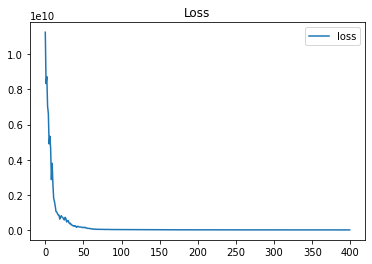

done 10 layers in 97.25ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[10969.64143015]


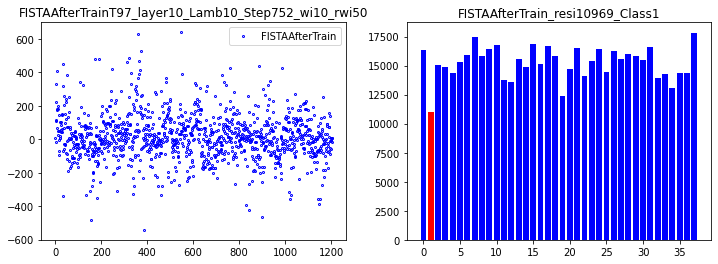

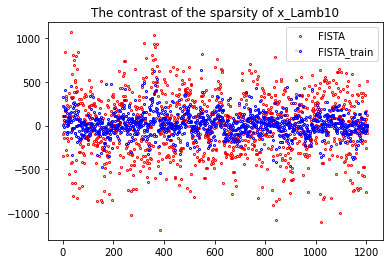

55


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.03ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.75313704]


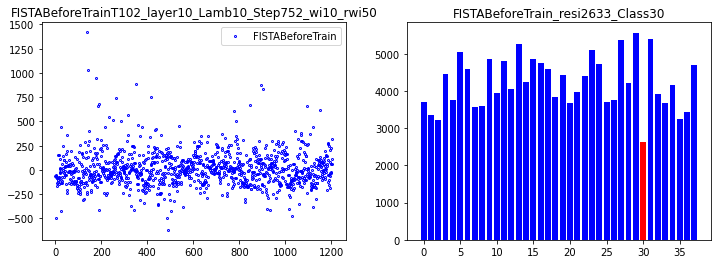

correct rate: 0.65625
correct rate: 0.75
correct rate: 0.6875
correct rate: 0.625
Epoch [ 10/100]: loss = 213791150.9366,   lambda [max:9.9373], [min:9.9256], 
Epoch [ 20/100]: loss = 35858329.7546,   lambda [max:9.9041], [min:9.8780], 
Epoch [ 30/100]: loss = 23262668.9171,   lambda [max:9.8777], [min:9.8387], 
Epoch [ 40/100]: loss = 19856791.6207,   lambda [max:9.8536], [min:9.8042], 
Epoch [ 50/100]: loss = 15983211.4617,   lambda [max:9.8309], [min:9.7736], 
Epoch [ 60/100]: loss = 15231986.7601,   lambda [max:9.8094], [min:9.7459], 
Epoch [ 70/100]: loss = 14297961.2590,   lambda [max:9.7888], [min:9.7202], 
Epoch [ 80/100]: loss = 12995358.7161,   lambda [max:9.7691], [min:9.6962], 
Epoch [ 90/100]: loss = 12534357.8818,   lambda [max:9.7499], [min:9.6735], 
correct rate: 0.75
correct rate: 0.84375
correct rate: 0.625
correct rate: 0.625
Epoch [100/100]: loss = 12739575.0809,   lambda [max:9.7315], [min:9.6521], 


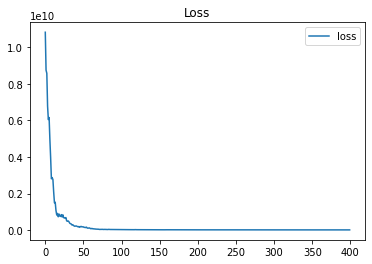

done 10 layers in 101.78ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3087.14258076]


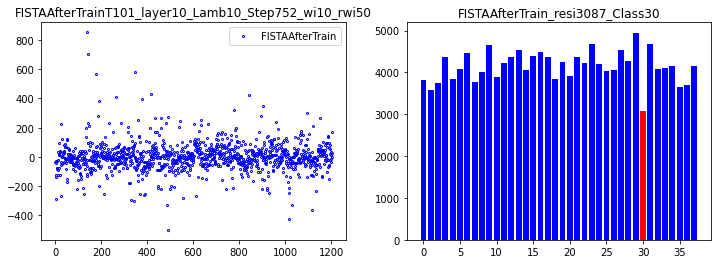

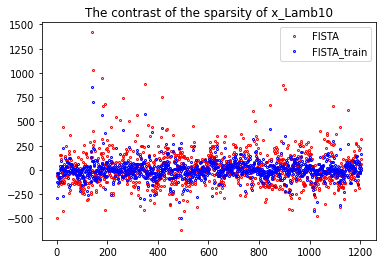

56


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 111.83ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6127.86149992]


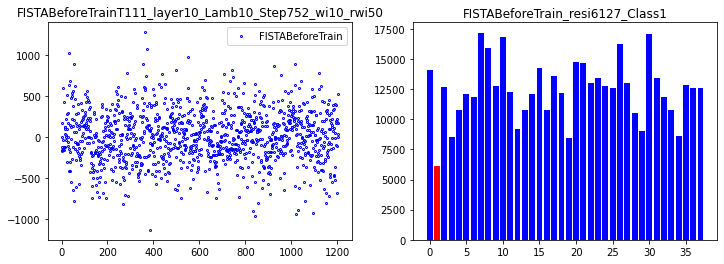

correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.78125
Epoch [ 10/100]: loss = 232099190.7959,   lambda [max:9.9373], [min:9.9272], 
Epoch [ 20/100]: loss = 32682535.8857,   lambda [max:9.9034], [min:9.8782], 
Epoch [ 30/100]: loss = 22319537.2432,   lambda [max:9.8762], [min:9.8384], 
Epoch [ 40/100]: loss = 19347290.1547,   lambda [max:9.8511], [min:9.8036], 
Epoch [ 50/100]: loss = 16638918.5826,   lambda [max:9.8278], [min:9.7724], 
Epoch [ 60/100]: loss = 15839634.8528,   lambda [max:9.8056], [min:9.7442], 
Epoch [ 70/100]: loss = 14284924.1623,   lambda [max:9.7846], [min:9.7181], 
Epoch [ 80/100]: loss = 13411268.1603,   lambda [max:9.7644], [min:9.6937], 
Epoch [ 90/100]: loss = 12647627.6041,   lambda [max:9.7450], [min:9.6698], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.78125
correct rate: 0.625
Epoch [100/100]: loss = 12917277.9827,   lambda [max:9.7262], [min:9.6471], 


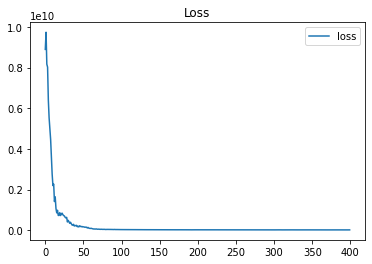

done 10 layers in 96.92ms
predict class: yaleB36
test image label: yaleB02
predict residuals label: 34
test residuals label: 1
[10299.33424859]


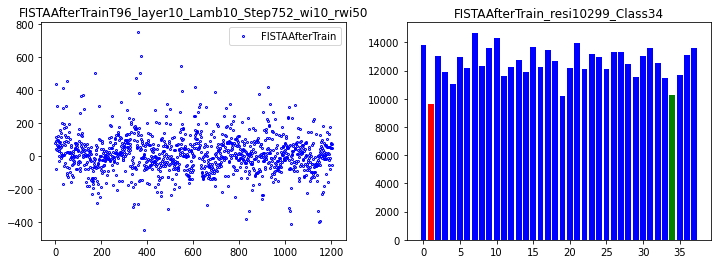

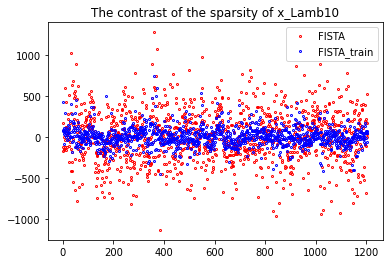

57


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 110.25ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.77151891]


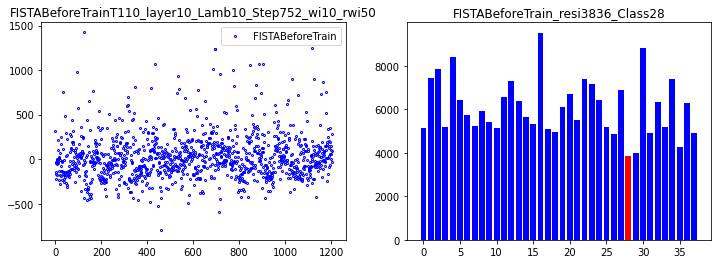

correct rate: 0.625
correct rate: 0.8125
correct rate: 0.75
correct rate: 0.59375
Epoch [ 10/100]: loss = 204112769.7487,   lambda [max:9.9372], [min:9.9256], 
Epoch [ 20/100]: loss = 38631470.0534,   lambda [max:9.9035], [min:9.8772], 
Epoch [ 30/100]: loss = 26522461.6815,   lambda [max:9.8771], [min:9.8375], 
Epoch [ 40/100]: loss = 19775027.2835,   lambda [max:9.8527], [min:9.8028], 
Epoch [ 50/100]: loss = 16566595.6145,   lambda [max:9.8300], [min:9.7717], 
Epoch [ 60/100]: loss = 15572879.6761,   lambda [max:9.8085], [min:9.7434], 
Epoch [ 70/100]: loss = 13538856.1754,   lambda [max:9.7879], [min:9.7172], 
Epoch [ 80/100]: loss = 14011237.1128,   lambda [max:9.7680], [min:9.6926], 
Epoch [ 90/100]: loss = 12857975.3259,   lambda [max:9.7489], [min:9.6695], 
correct rate: 0.65625
correct rate: 0.8125
correct rate: 0.625
correct rate: 0.6875
Epoch [100/100]: loss = 12600262.6404,   lambda [max:9.7303], [min:9.6474], 


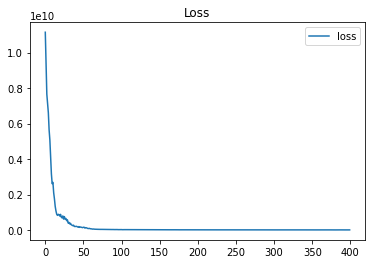

done 10 layers in 97.55ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4672.37757058]


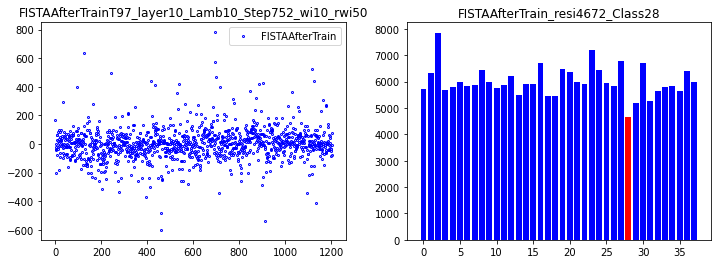

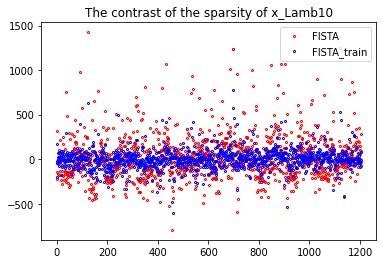

58


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 112.81ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11039.5768946]


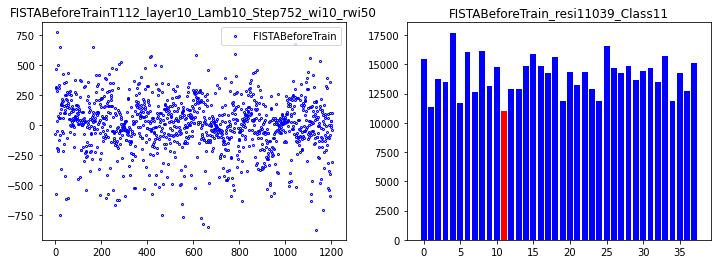

correct rate: 0.78125
correct rate: 0.71875
correct rate: 0.5
correct rate: 0.71875
Epoch [ 10/100]: loss = 242672923.0086,   lambda [max:9.9374], [min:9.9257], 
Epoch [ 20/100]: loss = 39845906.1635,   lambda [max:9.9038], [min:9.8765], 
Epoch [ 30/100]: loss = 21957438.6100,   lambda [max:9.8768], [min:9.8362], 
Epoch [ 40/100]: loss = 20106461.1581,   lambda [max:9.8519], [min:9.8008], 
Epoch [ 50/100]: loss = 15940027.2029,   lambda [max:9.8286], [min:9.7692], 
Epoch [ 60/100]: loss = 15410064.4151,   lambda [max:9.8067], [min:9.7406], 
Epoch [ 70/100]: loss = 14144550.5069,   lambda [max:9.7857], [min:9.7142], 
Epoch [ 80/100]: loss = 12763897.6997,   lambda [max:9.7656], [min:9.6896], 
Epoch [ 90/100]: loss = 13559434.2285,   lambda [max:9.7463], [min:9.6664], 
correct rate: 0.59375
correct rate: 0.8125
correct rate: 0.78125
correct rate: 0.625
Epoch [100/100]: loss = 12130669.6115,   lambda [max:9.7275], [min:9.6443], 


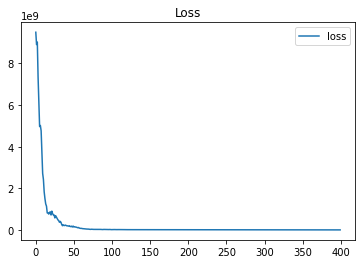

done 10 layers in 99.37ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11344.53766684]


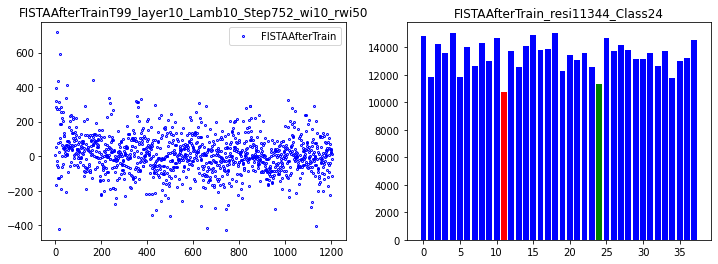

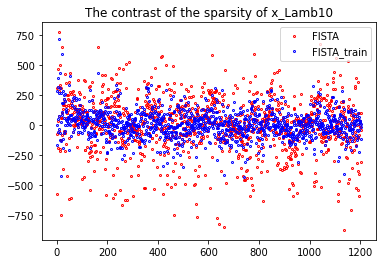

59


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 109.28ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16513.30609801]


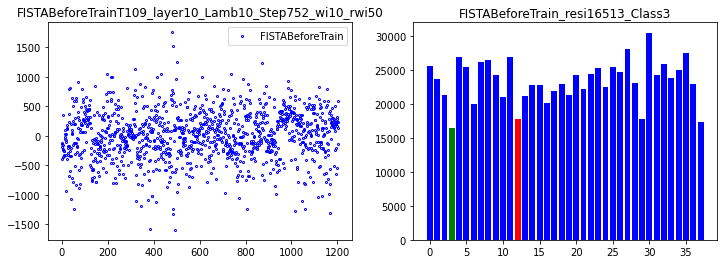

correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.75
correct rate: 0.71875
Epoch [ 10/100]: loss = 240887429.4075,   lambda [max:9.9377], [min:9.9261], 
Epoch [ 20/100]: loss = 37703928.8616,   lambda [max:9.9046], [min:9.8778], 
Epoch [ 30/100]: loss = 25452684.1123,   lambda [max:9.8785], [min:9.8375], 
Epoch [ 40/100]: loss = 18362281.6389,   lambda [max:9.8546], [min:9.8025], 
Epoch [ 50/100]: loss = 16372331.7206,   lambda [max:9.8321], [min:9.7714], 
Epoch [ 60/100]: loss = 14941223.3250,   lambda [max:9.8108], [min:9.7432], 
Epoch [ 70/100]: loss = 13695041.1571,   lambda [max:9.7905], [min:9.7171], 
Epoch [ 80/100]: loss = 13249610.3208,   lambda [max:9.7709], [min:9.6921], 
Epoch [ 90/100]: loss = 13432006.1225,   lambda [max:9.7520], [min:9.6683], 
correct rate: 0.71875
correct rate: 0.75
correct rate: 0.5625
correct rate: 0.75
Epoch [100/100]: loss = 12502365.4167,   lambda [max:9.7337], [min:9.6457], 


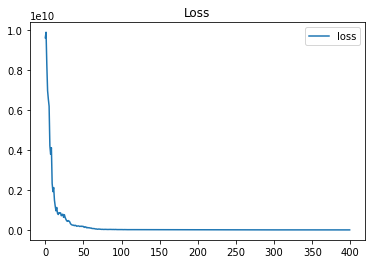

done 10 layers in 97.44ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21749.35160949]


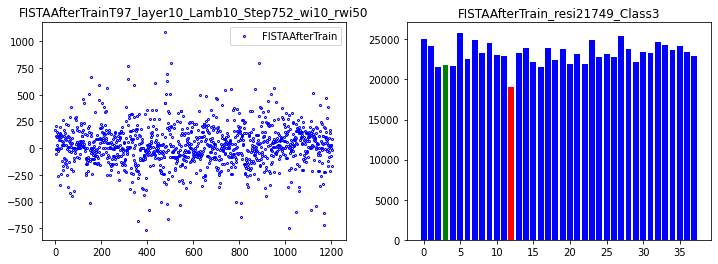

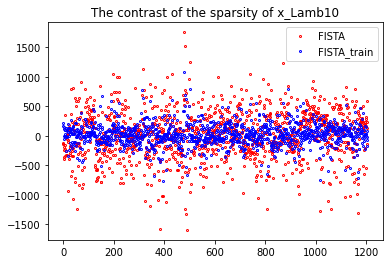

60


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 94.74ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6135.43966325]


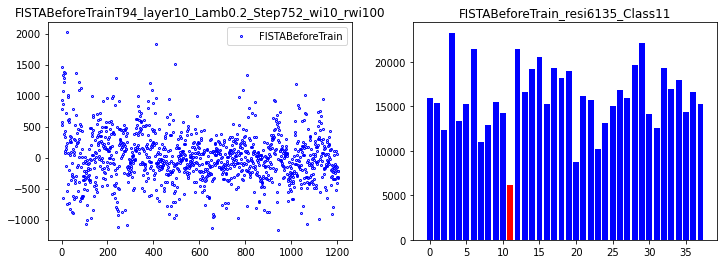

correct rate: 0.6875
correct rate: 0.78125
correct rate: 0.625
correct rate: 0.625
Epoch [ 10/100]: loss = 236887433.5022,   lambda [max:0.1382], [min:0.1265], 
Epoch [ 20/100]: loss = 35907572.3068,   lambda [max:0.1034], [min:0.0771], 
Epoch [ 30/100]: loss = 20867914.6830,   lambda [max:0.0763], [min:0.0365], 
Epoch [ 40/100]: loss = 15573482.1820,   lambda [max:0.0512], [min:0.0011], 
Epoch [ 50/100]: loss = 13435956.3534,   lambda [max:0.0277], [min:-0.0302], 
Epoch [ 60/100]: loss = 11130177.4189,   lambda [max:0.0053], [min:-0.0588], 
Epoch [ 70/100]: loss = 9868333.8987,   lambda [max:-0.0161], [min:-0.0852], 
Epoch [ 80/100]: loss = 9636712.0514,   lambda [max:-0.0368], [min:-0.1100], 
Epoch [ 90/100]: loss = 9082302.8582,   lambda [max:-0.0569], [min:-0.1333], 
correct rate: 0.8125
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.78125
Epoch [100/100]: loss = 8751232.4797,   lambda [max:-0.0764], [min:-0.1555], 


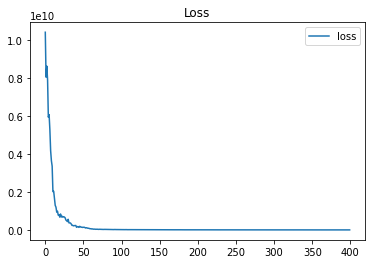

done 10 layers in 103.95ms
predict class: yaleB25
test image label: yaleB12
predict residuals label: 23
test residuals label: 11
[12718.91172879]


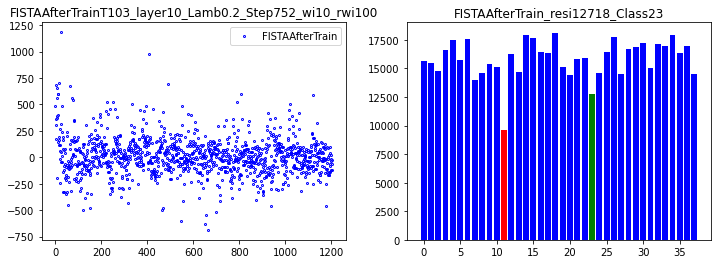

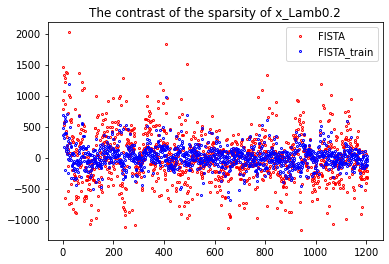

61


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.57ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6904.23254266]


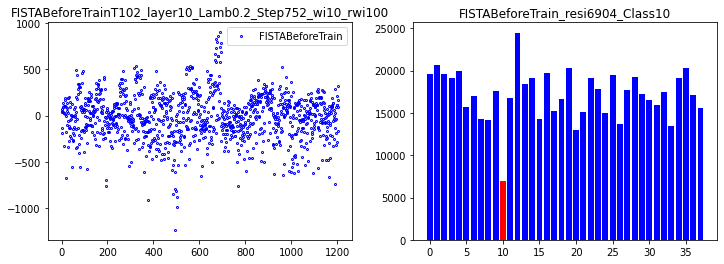

correct rate: 0.78125
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.5625
Epoch [ 10/100]: loss = 221249532.9033,   lambda [max:0.1372], [min:0.1267], 
Epoch [ 20/100]: loss = 36882160.8617,   lambda [max:0.1031], [min:0.0774], 
Epoch [ 30/100]: loss = 20803020.1572,   lambda [max:0.0757], [min:0.0370], 
Epoch [ 40/100]: loss = 14141224.8018,   lambda [max:0.0504], [min:0.0016], 
Epoch [ 50/100]: loss = 13085483.4327,   lambda [max:0.0267], [min:-0.0299], 
Epoch [ 60/100]: loss = 12162438.2471,   lambda [max:0.0042], [min:-0.0585], 
Epoch [ 70/100]: loss = 10135408.6304,   lambda [max:-0.0174], [min:-0.0851], 
Epoch [ 80/100]: loss = 10334491.0842,   lambda [max:-0.0382], [min:-0.1099], 
Epoch [ 90/100]: loss = 8785241.7541,   lambda [max:-0.0583], [min:-0.1334], 
correct rate: 0.78125
correct rate: 0.75
correct rate: 0.625
correct rate: 0.71875
Epoch [100/100]: loss = 8235044.2925,   lambda [max:-0.0779], [min:-0.1559], 


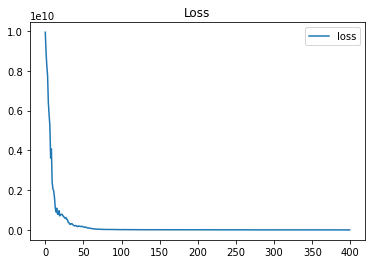

done 10 layers in 108.66ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[10529.19915725]


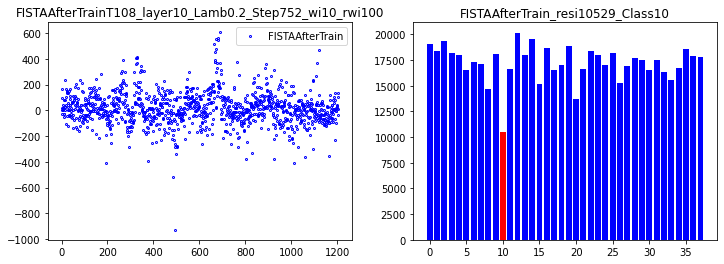

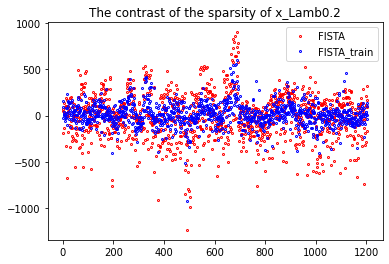

62


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 98.94ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.11572183]


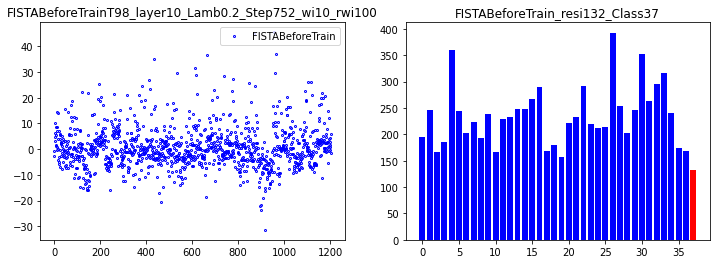

correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.8125
correct rate: 0.6875
Epoch [ 10/100]: loss = 206828970.0297,   lambda [max:0.1379], [min:0.1256], 
Epoch [ 20/100]: loss = 32308192.7655,   lambda [max:0.1040], [min:0.0766], 
Epoch [ 30/100]: loss = 20742720.4787,   lambda [max:0.0765], [min:0.0359], 
Epoch [ 40/100]: loss = 14666981.2735,   lambda [max:0.0510], [min:0.0004], 
Epoch [ 50/100]: loss = 13017928.8196,   lambda [max:0.0270], [min:-0.0310], 
Epoch [ 60/100]: loss = 12109696.6712,   lambda [max:0.0043], [min:-0.0595], 
Epoch [ 70/100]: loss = 10742084.4711,   lambda [max:-0.0175], [min:-0.0859], 
Epoch [ 80/100]: loss = 9620838.1679,   lambda [max:-0.0384], [min:-0.1107], 
Epoch [ 90/100]: loss = 8703596.4743,   lambda [max:-0.0586], [min:-0.1340], 
correct rate: 0.78125
correct rate: 0.75
correct rate: 0.625
correct rate: 0.6875
Epoch [100/100]: loss = 8684935.0925,   lambda [max:-0.0784], [min:-0.1563], 


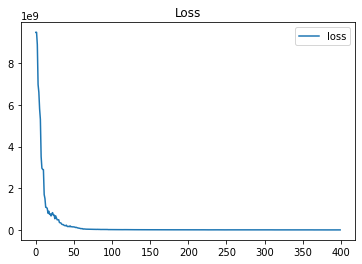

done 10 layers in 101.83ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[172.76649177]


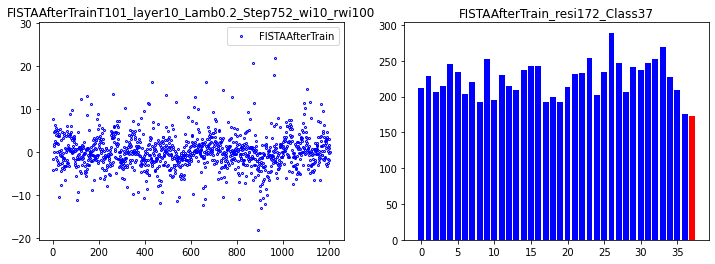

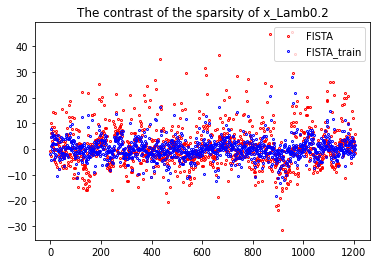

63


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.92ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4726.46574361]


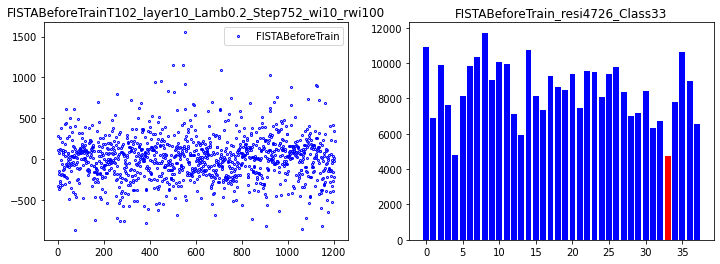

correct rate: 0.625
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.65625
Epoch [ 10/100]: loss = 236421252.8795,   lambda [max:0.1377], [min:0.1264], 
Epoch [ 20/100]: loss = 32493082.3355,   lambda [max:0.1031], [min:0.0763], 
Epoch [ 30/100]: loss = 19921841.7492,   lambda [max:0.0759], [min:0.0359], 
Epoch [ 40/100]: loss = 15604095.4023,   lambda [max:0.0508], [min:0.0006], 
Epoch [ 50/100]: loss = 13247109.1529,   lambda [max:0.0272], [min:-0.0308], 
Epoch [ 60/100]: loss = 11730787.5328,   lambda [max:0.0048], [min:-0.0595], 
Epoch [ 70/100]: loss = 10206254.9974,   lambda [max:-0.0166], [min:-0.0860], 
Epoch [ 80/100]: loss = 9536375.5451,   lambda [max:-0.0374], [min:-0.1109], 
Epoch [ 90/100]: loss = 8760908.3362,   lambda [max:-0.0575], [min:-0.1344], 
correct rate: 0.78125
correct rate: 0.59375
correct rate: 0.78125
correct rate: 0.75
Epoch [100/100]: loss = 8361134.0237,   lambda [max:-0.0770], [min:-0.1568], 


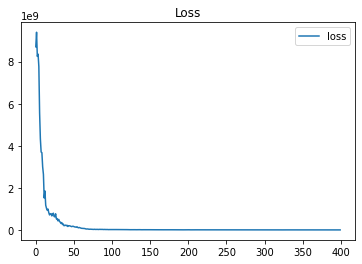

done 10 layers in 106.96ms
predict class: yaleB13
test image label: yaleB35
predict residuals label: 12
test residuals label: 33
[7345.43352319]


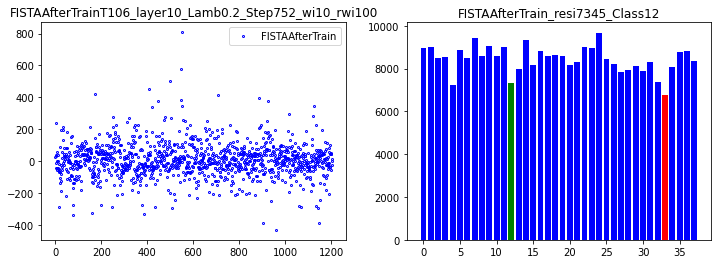

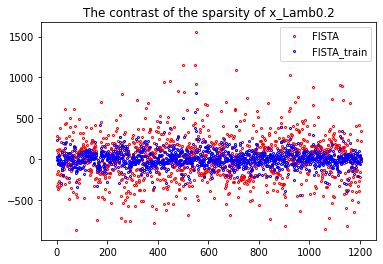

64


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 107.18ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5982.98608124]


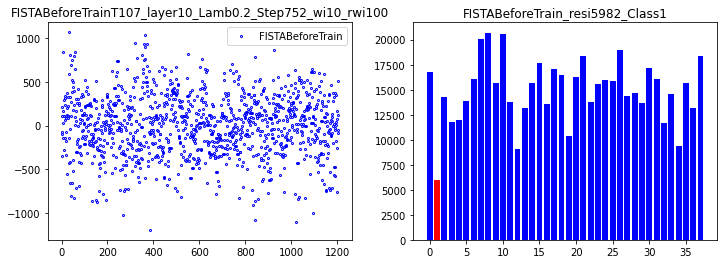

correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.8125
Epoch [ 10/100]: loss = 224789578.8956,   lambda [max:0.1380], [min:0.1256], 
Epoch [ 20/100]: loss = 38010848.5478,   lambda [max:0.1033], [min:0.0778], 
Epoch [ 30/100]: loss = 19119507.3466,   lambda [max:0.0760], [min:0.0375], 
Epoch [ 40/100]: loss = 15233322.0910,   lambda [max:0.0508], [min:0.0024], 
Epoch [ 50/100]: loss = 13442821.7999,   lambda [max:0.0272], [min:-0.0289], 
Epoch [ 60/100]: loss = 11720160.7121,   lambda [max:0.0047], [min:-0.0574], 
Epoch [ 70/100]: loss = 10005886.4404,   lambda [max:-0.0168], [min:-0.0838], 
Epoch [ 80/100]: loss = 8802444.0624,   lambda [max:-0.0376], [min:-0.1085], 
Epoch [ 90/100]: loss = 9081867.7011,   lambda [max:-0.0577], [min:-0.1319], 
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.8125
Epoch [100/100]: loss = 8677452.6122,   lambda [max:-0.0772], [min:-0.1541], 


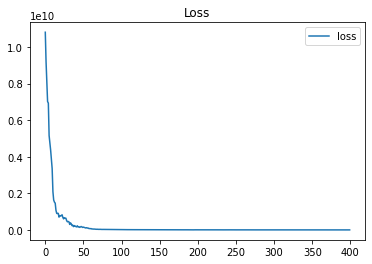

done 10 layers in 114.27ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[10262.79338015]


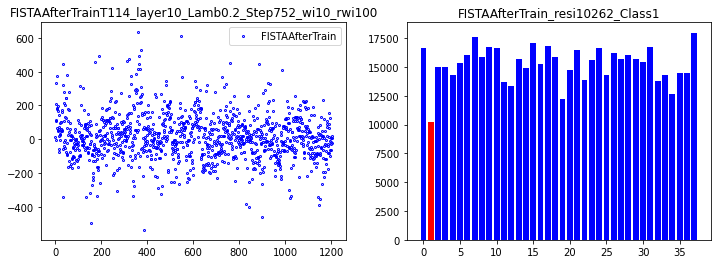

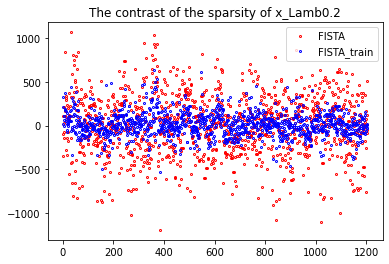

65


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 108.67ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.91111018]


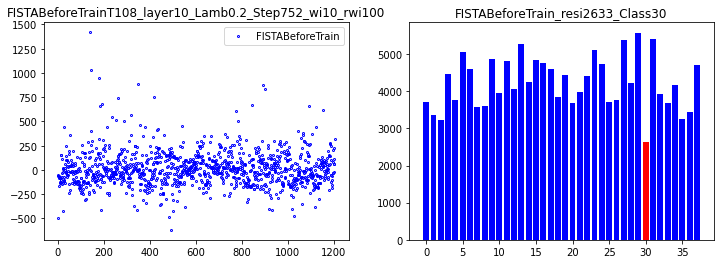

correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.78125
correct rate: 0.59375
Epoch [ 10/100]: loss = 214423044.2992,   lambda [max:0.1375], [min:0.1270], 
Epoch [ 20/100]: loss = 35297750.5947,   lambda [max:0.1039], [min:0.0774], 
Epoch [ 30/100]: loss = 19711948.2827,   lambda [max:0.0768], [min:0.0375], 
Epoch [ 40/100]: loss = 16903297.3583,   lambda [max:0.0515], [min:0.0026], 
Epoch [ 50/100]: loss = 13790141.0098,   lambda [max:0.0277], [min:-0.0287], 
Epoch [ 60/100]: loss = 11512358.0396,   lambda [max:0.0050], [min:-0.0571], 
Epoch [ 70/100]: loss = 10244570.4356,   lambda [max:-0.0168], [min:-0.0835], 
Epoch [ 80/100]: loss = 9067408.8935,   lambda [max:-0.0377], [min:-0.1082], 
Epoch [ 90/100]: loss = 9375311.9878,   lambda [max:-0.0579], [min:-0.1317], 
correct rate: 0.65625
correct rate: 0.875
correct rate: 0.71875
correct rate: 0.65625
Epoch [100/100]: loss = 8743100.8361,   lambda [max:-0.0776], [min:-0.1540], 


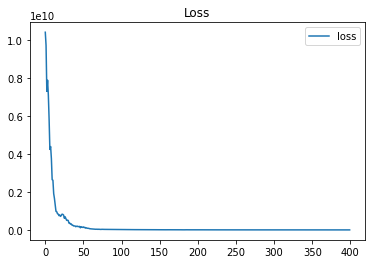

done 10 layers in 104.32ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3080.02018228]


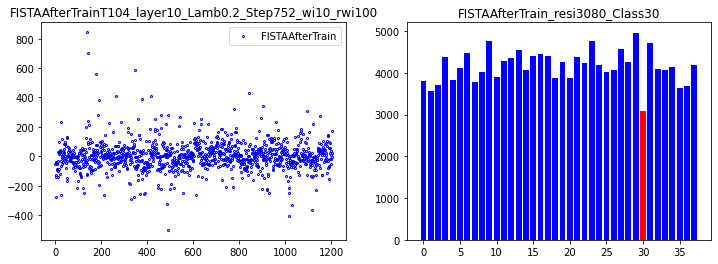

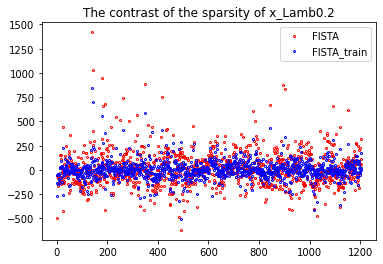

66


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 118.58ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6125.4037645]


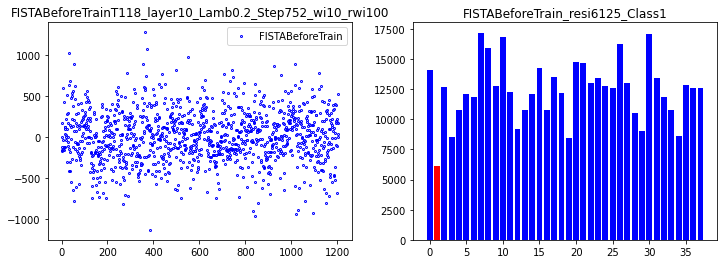

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.6875
Epoch [ 10/100]: loss = 231644994.0012,   lambda [max:0.1376], [min:0.1261], 
Epoch [ 20/100]: loss = 32633890.1009,   lambda [max:0.1036], [min:0.0780], 
Epoch [ 30/100]: loss = 20549528.0688,   lambda [max:0.0761], [min:0.0370], 
Epoch [ 40/100]: loss = 15320336.1818,   lambda [max:0.0506], [min:0.0011], 
Epoch [ 50/100]: loss = 13217926.5696,   lambda [max:0.0266], [min:-0.0309], 
Epoch [ 60/100]: loss = 11583765.3252,   lambda [max:0.0038], [min:-0.0599], 
Epoch [ 70/100]: loss = 9940229.8106,   lambda [max:-0.0180], [min:-0.0868], 
Epoch [ 80/100]: loss = 9594783.2016,   lambda [max:-0.0390], [min:-0.1119], 
Epoch [ 90/100]: loss = 9208445.4174,   lambda [max:-0.0594], [min:-0.1356], 
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.75
Epoch [100/100]: loss = 8742990.8392,   lambda [max:-0.0789], [min:-0.1582], 


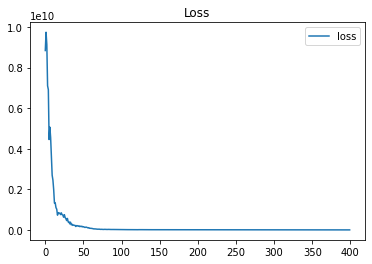

done 10 layers in 97.16ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[9133.94498411]


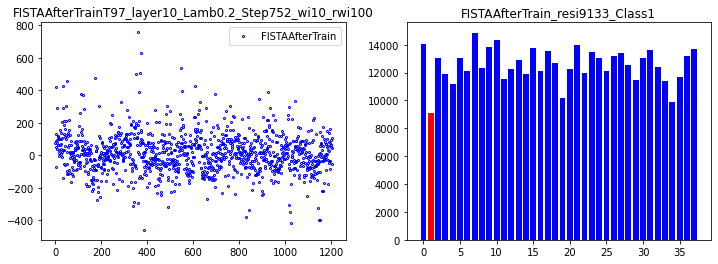

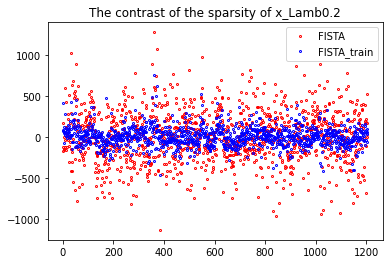

67


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 116.69ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.5421843]


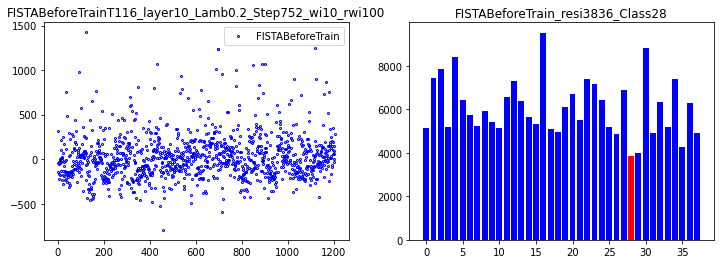

correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.78125
correct rate: 0.75
Epoch [ 10/100]: loss = 235781547.8743,   lambda [max:0.1372], [min:0.1266], 
Epoch [ 20/100]: loss = 32018755.3365,   lambda [max:0.1028], [min:0.0770], 
Epoch [ 30/100]: loss = 19537206.1251,   lambda [max:0.0757], [min:0.0366], 
Epoch [ 40/100]: loss = 15222795.9428,   lambda [max:0.0506], [min:0.0013], 
Epoch [ 50/100]: loss = 13087983.9900,   lambda [max:0.0270], [min:-0.0302], 
Epoch [ 60/100]: loss = 11165775.7764,   lambda [max:0.0046], [min:-0.0588], 
Epoch [ 70/100]: loss = 10958343.1913,   lambda [max:-0.0169], [min:-0.0852], 
Epoch [ 80/100]: loss = 10239784.1626,   lambda [max:-0.0376], [min:-0.1099], 
Epoch [ 90/100]: loss = 9846448.4932,   lambda [max:-0.0577], [min:-0.1334], 
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.78125
correct rate: 0.6875
Epoch [100/100]: loss = 9375527.3191,   lambda [max:-0.0771], [min:-0.1557], 


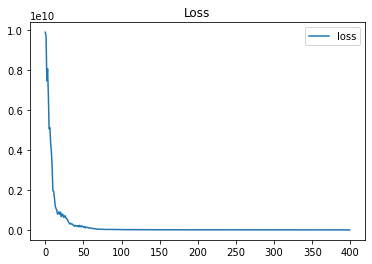

done 10 layers in 101.66ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4658.58744156]


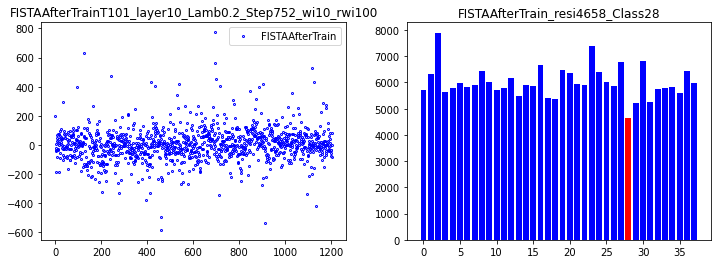

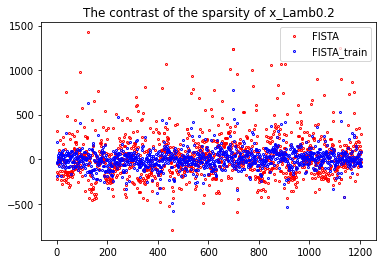

68


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 104.08ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11038.75418564]


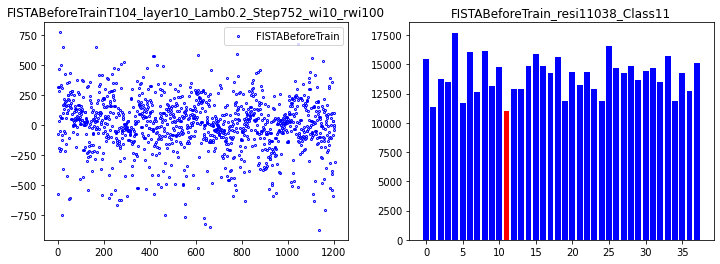

correct rate: 0.75
correct rate: 0.75
correct rate: 0.59375
correct rate: 0.65625
Epoch [ 10/100]: loss = 209727557.5932,   lambda [max:0.1374], [min:0.1269], 
Epoch [ 20/100]: loss = 31761418.0252,   lambda [max:0.1033], [min:0.0778], 
Epoch [ 30/100]: loss = 19171207.4759,   lambda [max:0.0761], [min:0.0379], 
Epoch [ 40/100]: loss = 14548707.5333,   lambda [max:0.0510], [min:0.0032], 
Epoch [ 50/100]: loss = 13507756.3907,   lambda [max:0.0272], [min:-0.0279], 
Epoch [ 60/100]: loss = 11366466.8101,   lambda [max:0.0048], [min:-0.0563], 
Epoch [ 70/100]: loss = 10581290.3500,   lambda [max:-0.0168], [min:-0.0826], 
Epoch [ 80/100]: loss = 9501731.9732,   lambda [max:-0.0376], [min:-0.1073], 
Epoch [ 90/100]: loss = 9292327.5304,   lambda [max:-0.0577], [min:-0.1306], 
correct rate: 0.8125
correct rate: 0.75
correct rate: 0.75
correct rate: 0.5625
Epoch [100/100]: loss = 8980249.8790,   lambda [max:-0.0773], [min:-0.1528], 


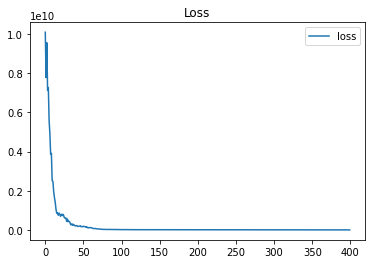

done 10 layers in 103.21ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11323.42505074]


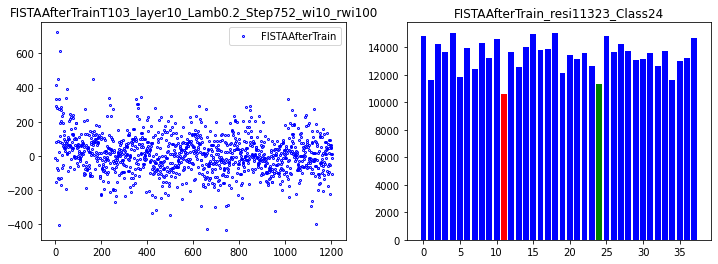

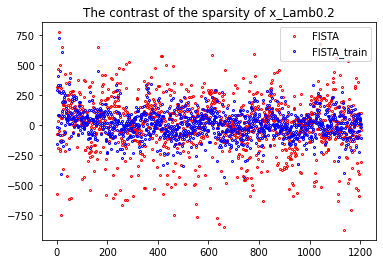

69


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 107.63ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16511.1576364]


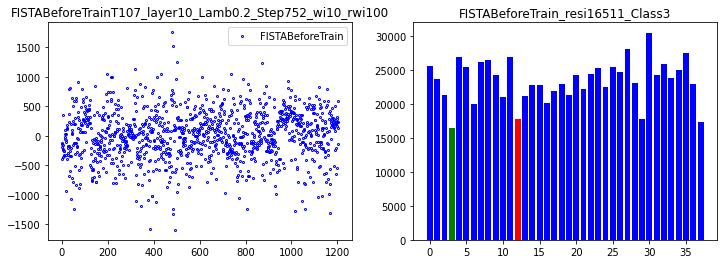

correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.625
Epoch [ 10/100]: loss = 221278328.2179,   lambda [max:0.1376], [min:0.1262], 
Epoch [ 20/100]: loss = 34287700.7320,   lambda [max:0.1044], [min:0.0772], 
Epoch [ 30/100]: loss = 19287570.7331,   lambda [max:0.0776], [min:0.0368], 
Epoch [ 40/100]: loss = 15845672.9095,   lambda [max:0.0528], [min:0.0015], 
Epoch [ 50/100]: loss = 14039470.2264,   lambda [max:0.0294], [min:-0.0299], 
Epoch [ 60/100]: loss = 11679793.8830,   lambda [max:0.0072], [min:-0.0585], 
Epoch [ 70/100]: loss = 9806668.0997,   lambda [max:-0.0141], [min:-0.0848], 
Epoch [ 80/100]: loss = 10049284.9568,   lambda [max:-0.0347], [min:-0.1094], 
Epoch [ 90/100]: loss = 9036588.1537,   lambda [max:-0.0547], [min:-0.1327], 
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.78125
correct rate: 0.71875
Epoch [100/100]: loss = 8788574.7555,   lambda [max:-0.0742], [min:-0.1549], 


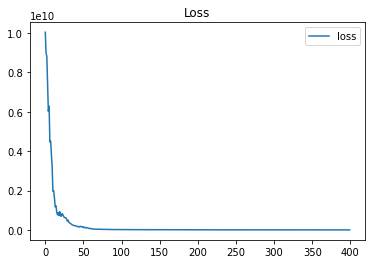

done 10 layers in 102.49ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21555.61102709]


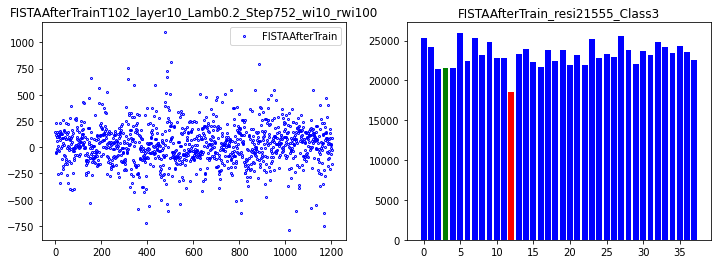

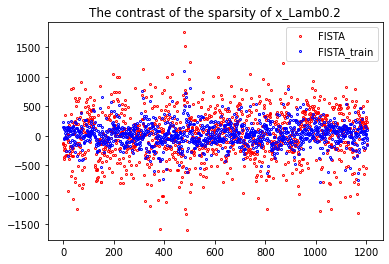

70


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 109.95ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6135.27056371]


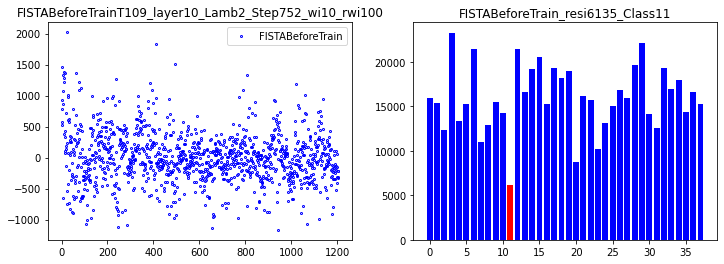

correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 241216292.2656,   lambda [max:1.9372], [min:1.9261], 
Epoch [ 20/100]: loss = 36600745.9358,   lambda [max:1.9032], [min:1.8769], 
Epoch [ 30/100]: loss = 20373770.7335,   lambda [max:1.8759], [min:1.8364], 
Epoch [ 40/100]: loss = 17376639.8491,   lambda [max:1.8506], [min:1.8010], 
Epoch [ 50/100]: loss = 13715201.7940,   lambda [max:1.8270], [min:1.7695], 
Epoch [ 60/100]: loss = 13272139.5311,   lambda [max:1.8045], [min:1.7408], 
Epoch [ 70/100]: loss = 10450694.9998,   lambda [max:1.7829], [min:1.7141], 
Epoch [ 80/100]: loss = 11107393.5108,   lambda [max:1.7620], [min:1.6888], 
Epoch [ 90/100]: loss = 10490458.1956,   lambda [max:1.7419], [min:1.6651], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.84375
Epoch [100/100]: loss = 10221528.9480,   lambda [max:1.7224], [min:1.6426], 


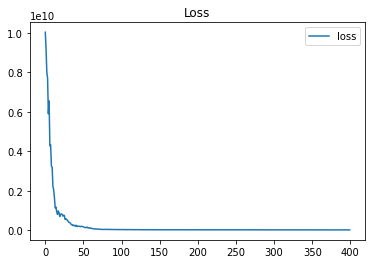

done 10 layers in 105.39ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[13902.9084775]


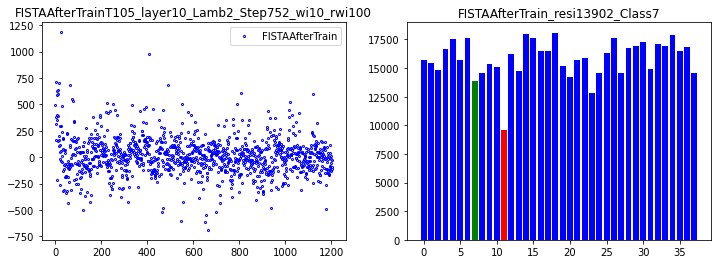

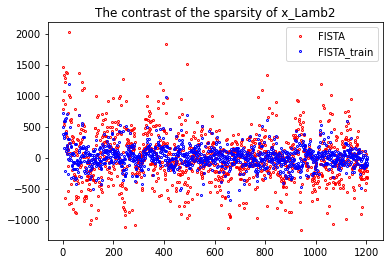

71


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 127.84ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6904.66862168]


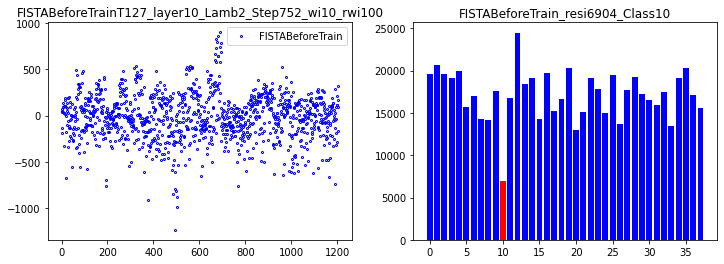

correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.78125
Epoch [ 10/100]: loss = 226566847.0436,   lambda [max:1.9377], [min:1.9264], 
Epoch [ 20/100]: loss = 39834770.5839,   lambda [max:1.9037], [min:1.8774], 
Epoch [ 30/100]: loss = 20956668.5641,   lambda [max:1.8763], [min:1.8373], 
Epoch [ 40/100]: loss = 16418378.9137,   lambda [max:1.8511], [min:1.8023], 
Epoch [ 50/100]: loss = 14066171.3165,   lambda [max:1.8274], [min:1.7711], 
Epoch [ 60/100]: loss = 12632617.8570,   lambda [max:1.8049], [min:1.7427], 
Epoch [ 70/100]: loss = 10908172.1304,   lambda [max:1.7834], [min:1.7165], 
Epoch [ 80/100]: loss = 11043597.0357,   lambda [max:1.7626], [min:1.6919], 
Epoch [ 90/100]: loss = 11039317.3560,   lambda [max:1.7425], [min:1.6687], 
correct rate: 0.625
correct rate: 0.53125
correct rate: 0.9375
correct rate: 0.8125
Epoch [100/100]: loss = 9723060.5626,   lambda [max:1.7229], [min:1.6465], 


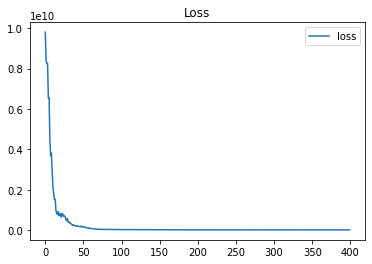

done 10 layers in 107.09ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[10533.97990447]


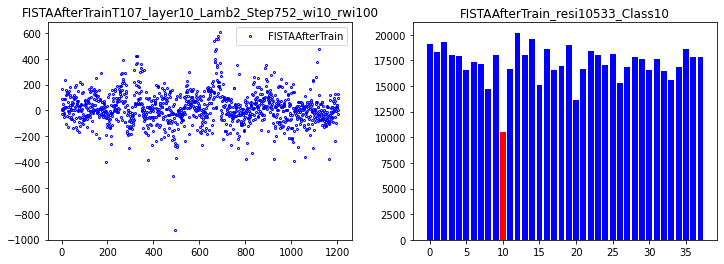

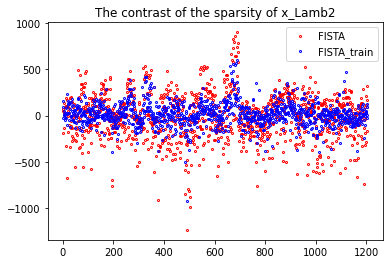

72


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.10ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.14730092]


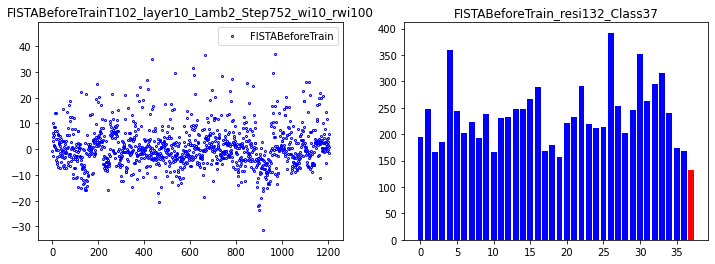

correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.625
Epoch [ 10/100]: loss = 215101839.8339,   lambda [max:1.9379], [min:1.9264], 
Epoch [ 20/100]: loss = 36630170.7995,   lambda [max:1.9045], [min:1.8776], 
Epoch [ 30/100]: loss = 23266943.6551,   lambda [max:1.8776], [min:1.8377], 
Epoch [ 40/100]: loss = 16341680.0628,   lambda [max:1.8526], [min:1.8029], 
Epoch [ 50/100]: loss = 14971117.7187,   lambda [max:1.8291], [min:1.7718], 
Epoch [ 60/100]: loss = 13166488.6634,   lambda [max:1.8067], [min:1.7435], 
Epoch [ 70/100]: loss = 11825441.4264,   lambda [max:1.7852], [min:1.7172], 
Epoch [ 80/100]: loss = 12130552.8906,   lambda [max:1.7645], [min:1.6926], 
Epoch [ 90/100]: loss = 10329853.2968,   lambda [max:1.7445], [min:1.6692], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.8125
Epoch [100/100]: loss = 9280962.4780,   lambda [max:1.7249], [min:1.6470], 


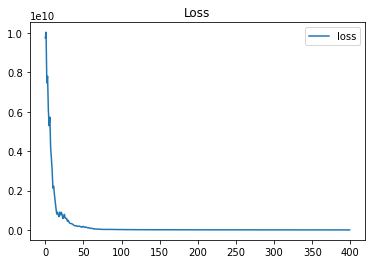

done 10 layers in 103.91ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[172.74462677]


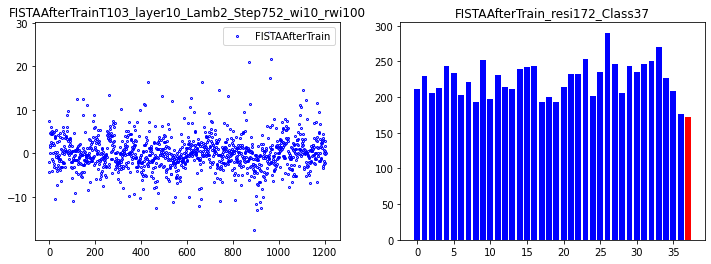

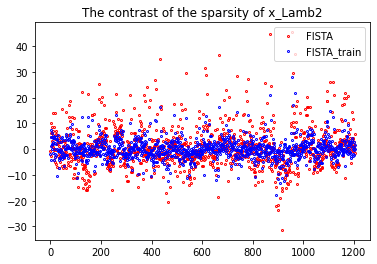

73


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 100.41ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4726.57002266]


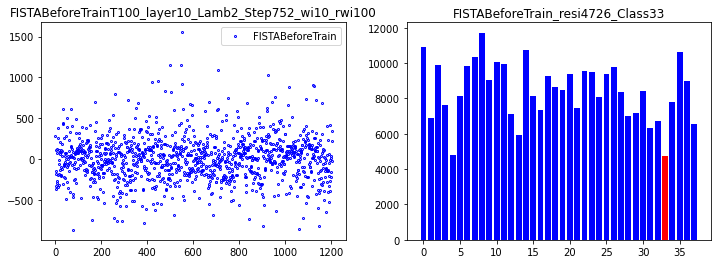

correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.75
correct rate: 0.625
Epoch [ 10/100]: loss = 211353280.0189,   lambda [max:1.9377], [min:1.9266], 
Epoch [ 20/100]: loss = 34337507.9792,   lambda [max:1.9036], [min:1.8785], 
Epoch [ 30/100]: loss = 20203912.7259,   lambda [max:1.8768], [min:1.8387], 
Epoch [ 40/100]: loss = 16628108.7827,   lambda [max:1.8522], [min:1.8040], 
Epoch [ 50/100]: loss = 13464239.0352,   lambda [max:1.8290], [min:1.7730], 
Epoch [ 60/100]: loss = 12557732.0265,   lambda [max:1.8071], [min:1.7448], 
Epoch [ 70/100]: loss = 11362769.2821,   lambda [max:1.7859], [min:1.7186], 
Epoch [ 80/100]: loss = 10701600.3520,   lambda [max:1.7656], [min:1.6940], 
Epoch [ 90/100]: loss = 10150585.9096,   lambda [max:1.7458], [min:1.6707], 
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.78125
correct rate: 0.65625
Epoch [100/100]: loss = 10134545.4816,   lambda [max:1.7265], [min:1.6483], 


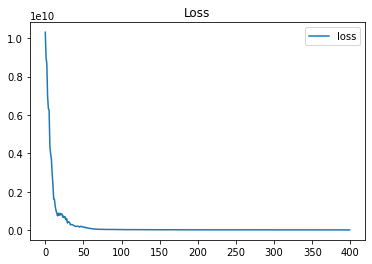

done 10 layers in 129.47ms
predict class: yaleB13
test image label: yaleB35
predict residuals label: 12
test residuals label: 33
[7374.09106503]


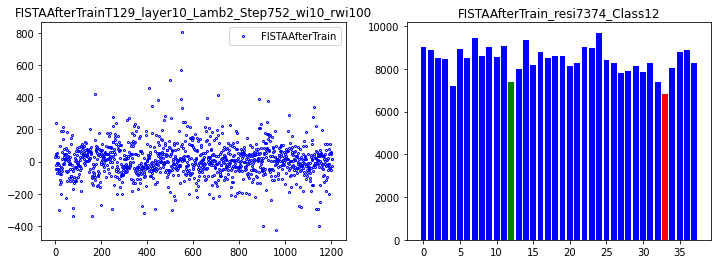

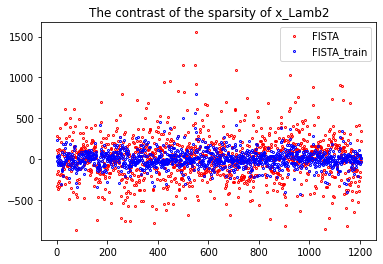

74


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 95.60ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5983.44513674]


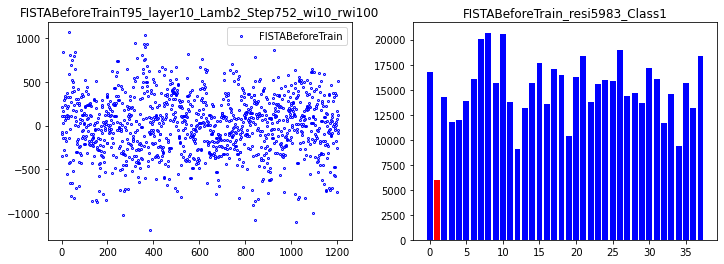

correct rate: 0.8125
correct rate: 0.625
correct rate: 0.625
correct rate: 0.625
Epoch [ 10/100]: loss = 236445206.9059,   lambda [max:1.9375], [min:1.9265], 
Epoch [ 20/100]: loss = 34912698.2114,   lambda [max:1.9038], [min:1.8771], 
Epoch [ 30/100]: loss = 20877116.0780,   lambda [max:1.8767], [min:1.8365], 
Epoch [ 40/100]: loss = 16296097.5447,   lambda [max:1.8515], [min:1.8011], 
Epoch [ 50/100]: loss = 13556710.2277,   lambda [max:1.8279], [min:1.7694], 
Epoch [ 60/100]: loss = 13013292.4225,   lambda [max:1.8055], [min:1.7408], 
Epoch [ 70/100]: loss = 11246954.2570,   lambda [max:1.7840], [min:1.7143], 
Epoch [ 80/100]: loss = 11217275.8424,   lambda [max:1.7633], [min:1.6889], 
Epoch [ 90/100]: loss = 10495144.8916,   lambda [max:1.7433], [min:1.6650], 
correct rate: 0.65625
correct rate: 0.75
correct rate: 0.75
correct rate: 0.75
Epoch [100/100]: loss = 9673556.5642,   lambda [max:1.7237], [min:1.6424], 


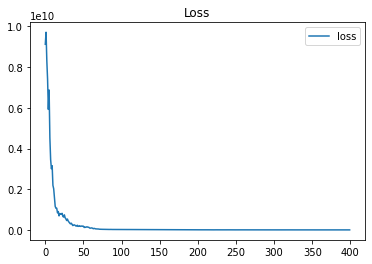

done 10 layers in 97.85ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[10247.11929179]


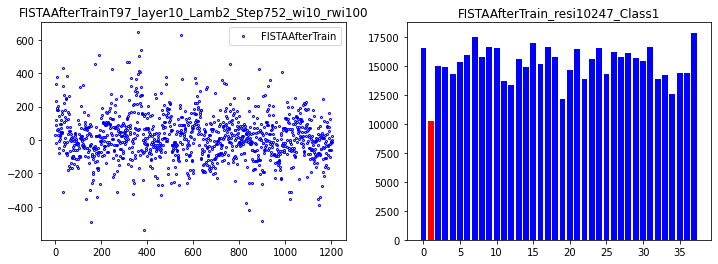

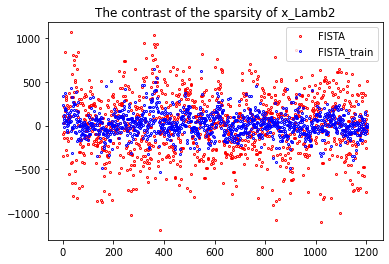

75


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 108.96ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.88200257]


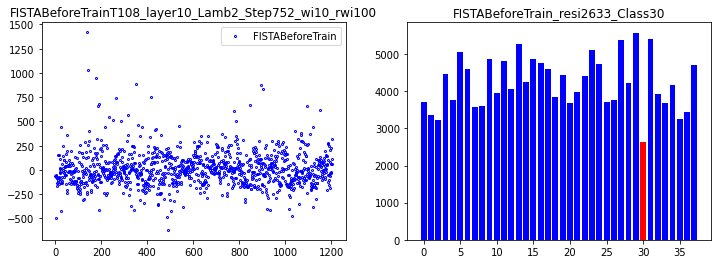

correct rate: 0.625
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 220071162.4391,   lambda [max:1.9380], [min:1.9263], 
Epoch [ 20/100]: loss = 34293447.7945,   lambda [max:1.9045], [min:1.8767], 
Epoch [ 30/100]: loss = 22621324.6086,   lambda [max:1.8775], [min:1.8366], 
Epoch [ 40/100]: loss = 15999614.1569,   lambda [max:1.8524], [min:1.8016], 
Epoch [ 50/100]: loss = 14674933.5202,   lambda [max:1.8287], [min:1.7703], 
Epoch [ 60/100]: loss = 13155182.3467,   lambda [max:1.8062], [min:1.7418], 
Epoch [ 70/100]: loss = 11772173.6479,   lambda [max:1.7847], [min:1.7154], 
Epoch [ 80/100]: loss = 11152711.7315,   lambda [max:1.7639], [min:1.6907], 
Epoch [ 90/100]: loss = 9984594.1826,   lambda [max:1.7440], [min:1.6674], 
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.8125
correct rate: 0.6875
Epoch [100/100]: loss = 9993701.2386,   lambda [max:1.7245], [min:1.6452], 


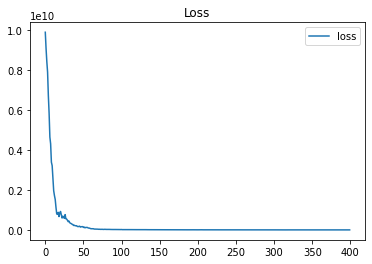

done 10 layers in 99.96ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3077.76096126]


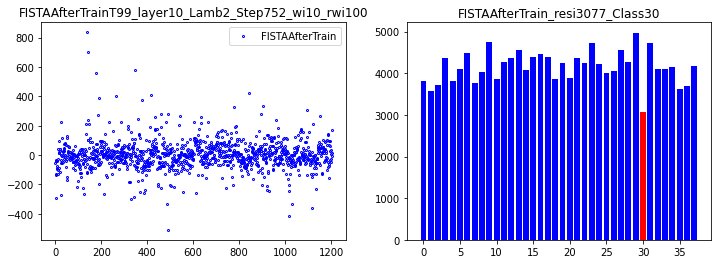

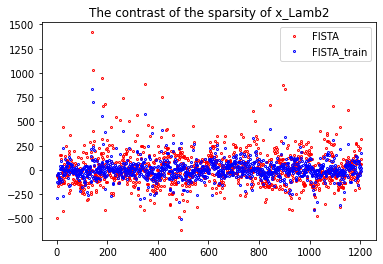

76


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 100.19ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6125.85516692]


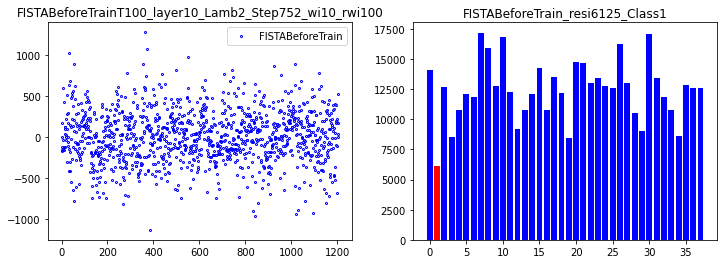

correct rate: 0.59375
correct rate: 0.78125
correct rate: 0.75
correct rate: 0.65625
Epoch [ 10/100]: loss = 218250970.3553,   lambda [max:1.9372], [min:1.9262], 
Epoch [ 20/100]: loss = 36120129.5679,   lambda [max:1.9036], [min:1.8766], 
Epoch [ 30/100]: loss = 20355342.0517,   lambda [max:1.8768], [min:1.8360], 
Epoch [ 40/100]: loss = 17583361.3083,   lambda [max:1.8522], [min:1.8007], 
Epoch [ 50/100]: loss = 13996278.1063,   lambda [max:1.8289], [min:1.7694], 
Epoch [ 60/100]: loss = 12813014.1049,   lambda [max:1.8068], [min:1.7410], 
Epoch [ 70/100]: loss = 11402632.2308,   lambda [max:1.7856], [min:1.7146], 
Epoch [ 80/100]: loss = 10326039.0862,   lambda [max:1.7651], [min:1.6900], 
Epoch [ 90/100]: loss = 10648418.5511,   lambda [max:1.7452], [min:1.6667], 
correct rate: 0.71875
correct rate: 0.625
correct rate: 0.75
correct rate: 0.78125
Epoch [100/100]: loss = 10160526.5355,   lambda [max:1.7259], [min:1.6445], 


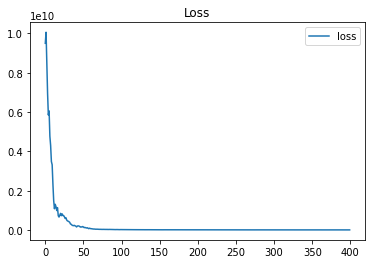

done 10 layers in 98.26ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[9129.92450869]


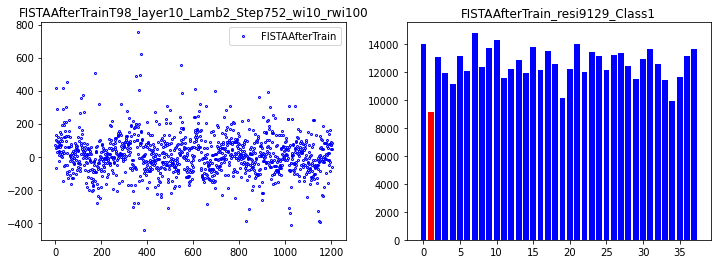

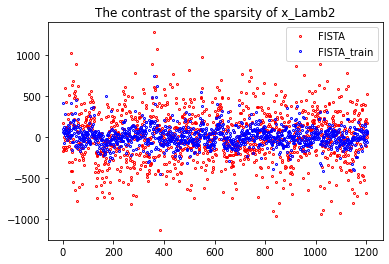

77


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 95.22ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.58414072]


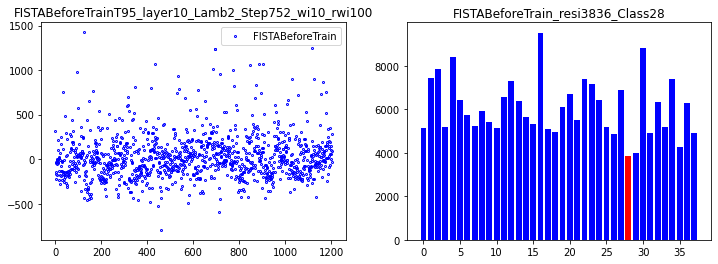

correct rate: 0.65625
correct rate: 0.625
correct rate: 0.75
correct rate: 0.6875
Epoch [ 10/100]: loss = 222572302.6125,   lambda [max:1.9376], [min:1.9265], 
Epoch [ 20/100]: loss = 31203641.1287,   lambda [max:1.9036], [min:1.8773], 
Epoch [ 30/100]: loss = 21492948.3930,   lambda [max:1.8765], [min:1.8375], 
Epoch [ 40/100]: loss = 15554052.4684,   lambda [max:1.8515], [min:1.8028], 
Epoch [ 50/100]: loss = 13808909.3633,   lambda [max:1.8280], [min:1.7720], 
Epoch [ 60/100]: loss = 13354506.7594,   lambda [max:1.8058], [min:1.7440], 
Epoch [ 70/100]: loss = 10649035.7840,   lambda [max:1.7843], [min:1.7180], 
Epoch [ 80/100]: loss = 10209564.4770,   lambda [max:1.7637], [min:1.6937], 
Epoch [ 90/100]: loss = 10109944.6650,   lambda [max:1.7437], [min:1.6706], 
correct rate: 0.59375
correct rate: 0.75
correct rate: 0.78125
correct rate: 0.8125
Epoch [100/100]: loss = 9738784.5866,   lambda [max:1.7243], [min:1.6486], 


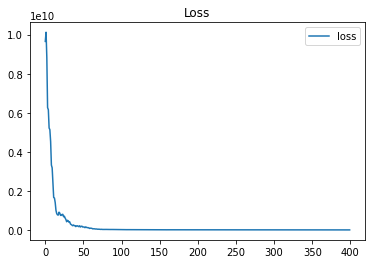

done 10 layers in 114.94ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4652.50416005]


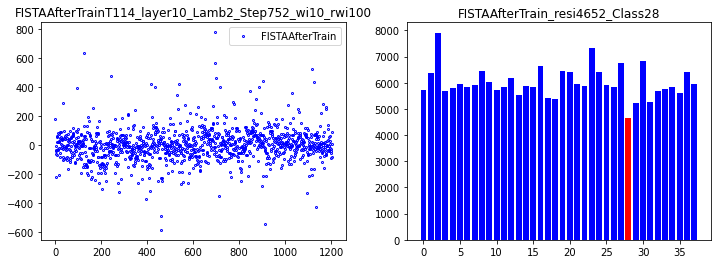

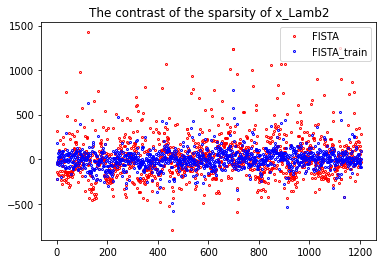

78


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.61ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11038.90506418]


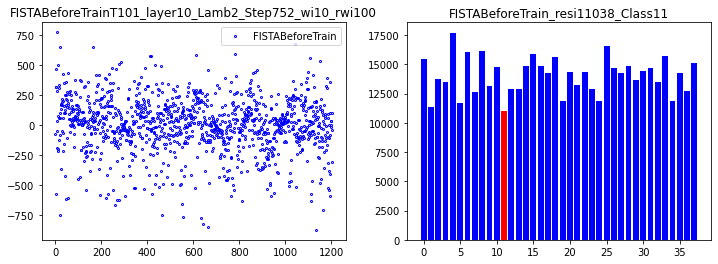

correct rate: 0.5625
correct rate: 0.8125
correct rate: 0.71875
correct rate: 0.65625
Epoch [ 10/100]: loss = 206281669.5776,   lambda [max:1.9375], [min:1.9258], 
Epoch [ 20/100]: loss = 37834326.7022,   lambda [max:1.9038], [min:1.8766], 
Epoch [ 30/100]: loss = 22274247.3617,   lambda [max:1.8766], [min:1.8365], 
Epoch [ 40/100]: loss = 15919070.3535,   lambda [max:1.8515], [min:1.8014], 
Epoch [ 50/100]: loss = 14309968.5809,   lambda [max:1.8279], [min:1.7701], 
Epoch [ 60/100]: loss = 12547293.0258,   lambda [max:1.8055], [min:1.7417], 
Epoch [ 70/100]: loss = 11566112.7901,   lambda [max:1.7840], [min:1.7154], 
Epoch [ 80/100]: loss = 10597569.1381,   lambda [max:1.7633], [min:1.6908], 
Epoch [ 90/100]: loss = 10076954.4021,   lambda [max:1.7431], [min:1.6675], 
correct rate: 0.75
correct rate: 0.75
correct rate: 0.8125
correct rate: 0.5625
Epoch [100/100]: loss = 10230813.0176,   lambda [max:1.7236], [min:1.6453], 


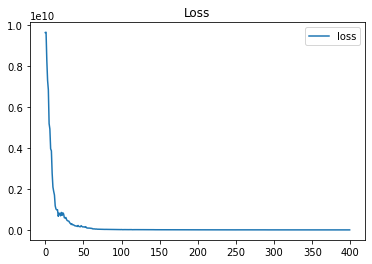

done 10 layers in 99.62ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11297.20489143]


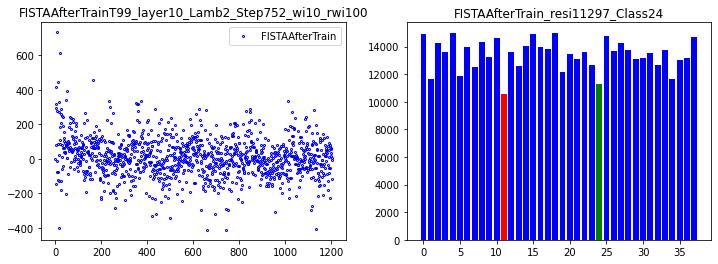

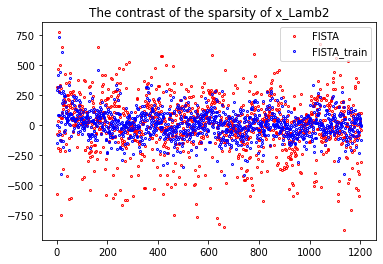

79


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.21ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16511.55223475]


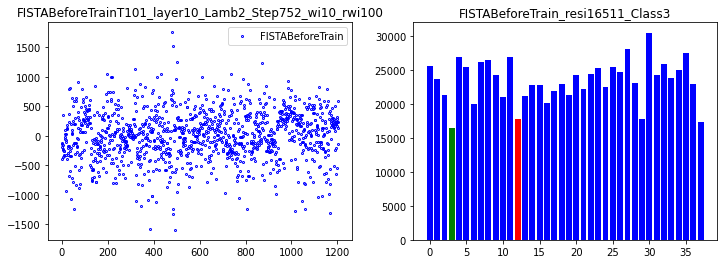

correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.75
Epoch [ 10/100]: loss = 217598706.1811,   lambda [max:1.9374], [min:1.9259], 
Epoch [ 20/100]: loss = 37142443.3813,   lambda [max:1.9032], [min:1.8766], 
Epoch [ 30/100]: loss = 21467819.7793,   lambda [max:1.8759], [min:1.8360], 
Epoch [ 40/100]: loss = 16294078.4071,   lambda [max:1.8507], [min:1.8005], 
Epoch [ 50/100]: loss = 13756024.2856,   lambda [max:1.8270], [min:1.7690], 
Epoch [ 60/100]: loss = 12855954.2714,   lambda [max:1.8045], [min:1.7404], 
Epoch [ 70/100]: loss = 11755352.6218,   lambda [max:1.7830], [min:1.7140], 
Epoch [ 80/100]: loss = 11322613.4560,   lambda [max:1.7621], [min:1.6893], 
Epoch [ 90/100]: loss = 10211410.1602,   lambda [max:1.7419], [min:1.6660], 
correct rate: 0.71875
correct rate: 0.78125
correct rate: 0.59375
correct rate: 0.8125
Epoch [100/100]: loss = 10037518.8485,   lambda [max:1.7222], [min:1.6437], 


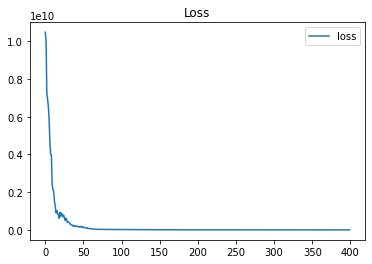

done 10 layers in 108.33ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21461.97198458]


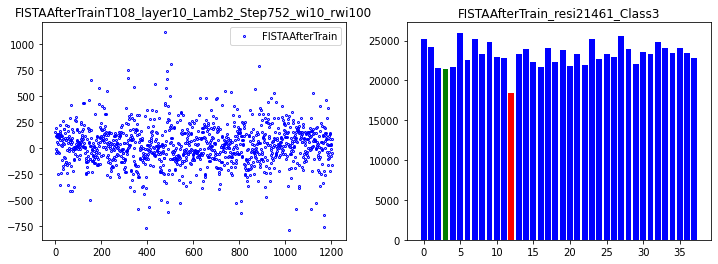

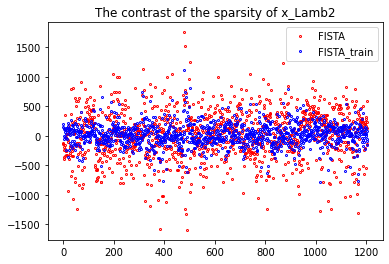

80


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 116.39ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6134.51951648]


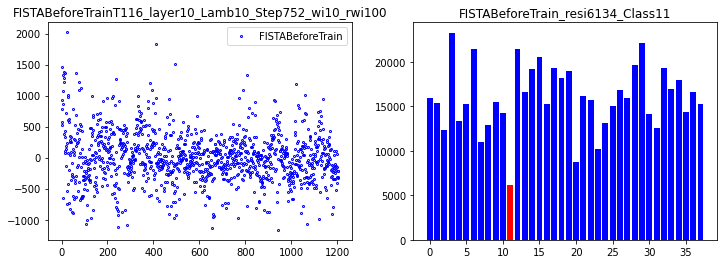

correct rate: 0.75
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.71875
Epoch [ 10/100]: loss = 195047105.2227,   lambda [max:9.9372], [min:9.9268], 
Epoch [ 20/100]: loss = 39154083.1391,   lambda [max:9.9034], [min:9.8774], 
Epoch [ 30/100]: loss = 27571140.8902,   lambda [max:9.8765], [min:9.8378], 
Epoch [ 40/100]: loss = 22919663.7740,   lambda [max:9.8517], [min:9.8032], 
Epoch [ 50/100]: loss = 19461168.7670,   lambda [max:9.8286], [min:9.7724], 
Epoch [ 60/100]: loss = 17856527.1400,   lambda [max:9.8066], [min:9.7444], 
Epoch [ 70/100]: loss = 17724275.4920,   lambda [max:9.7857], [min:9.7186], 
Epoch [ 80/100]: loss = 15648156.3870,   lambda [max:9.7654], [min:9.6943], 
Epoch [ 90/100]: loss = 15593515.7520,   lambda [max:9.7458], [min:9.6716], 
correct rate: 0.71875
correct rate: 0.78125
correct rate: 0.625
correct rate: 0.78125
Epoch [100/100]: loss = 15114290.7252,   lambda [max:9.7269], [min:9.6499], 


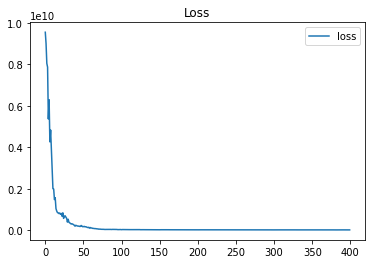

done 10 layers in 101.40ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[14007.60085057]


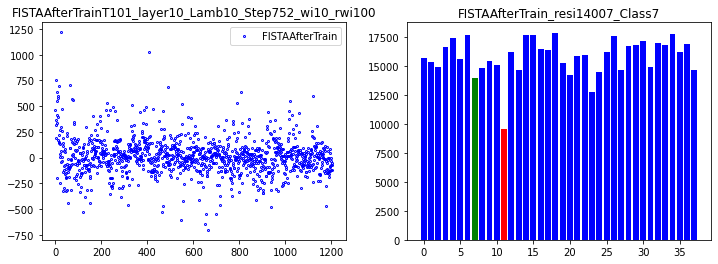

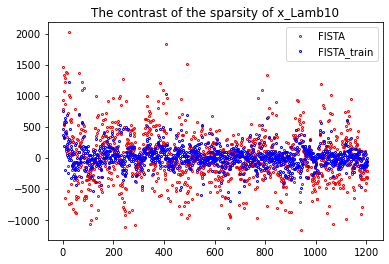

81


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 128.91ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6906.60745131]


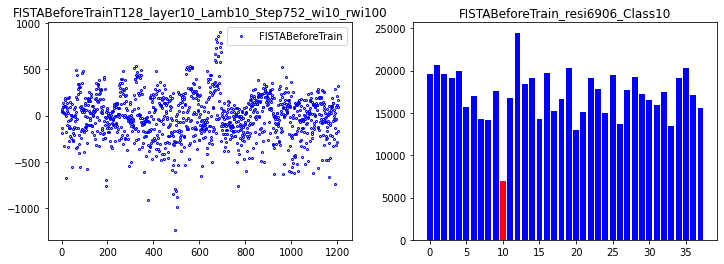

correct rate: 0.75
correct rate: 0.59375
correct rate: 0.75
correct rate: 0.6875
Epoch [ 10/100]: loss = 187760462.9946,   lambda [max:9.9371], [min:9.9259], 
Epoch [ 20/100]: loss = 37226443.9685,   lambda [max:9.9036], [min:9.8777], 
Epoch [ 30/100]: loss = 27151163.3076,   lambda [max:9.8766], [min:9.8375], 
Epoch [ 40/100]: loss = 21430825.4664,   lambda [max:9.8516], [min:9.8025], 
Epoch [ 50/100]: loss = 20935552.3140,   lambda [max:9.8282], [min:9.7716], 
Epoch [ 60/100]: loss = 18001374.0561,   lambda [max:9.8060], [min:9.7435], 
Epoch [ 70/100]: loss = 16404888.7071,   lambda [max:9.7848], [min:9.7176], 
Epoch [ 80/100]: loss = 16952407.8818,   lambda [max:9.7643], [min:9.6935], 
Epoch [ 90/100]: loss = 15158016.4193,   lambda [max:9.7445], [min:9.6707], 
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.78125
correct rate: 0.75
Epoch [100/100]: loss = 14455989.8998,   lambda [max:9.7269], [min:9.6491], 


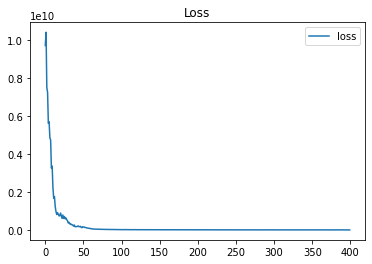

done 10 layers in 116.87ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[10519.22001955]


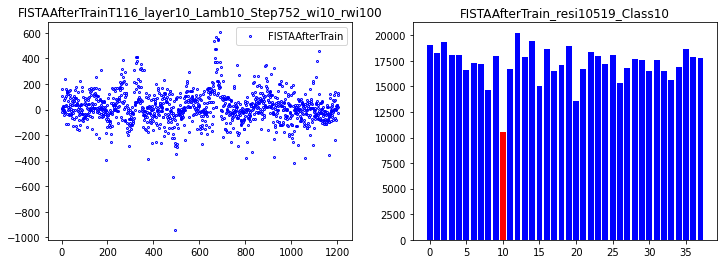

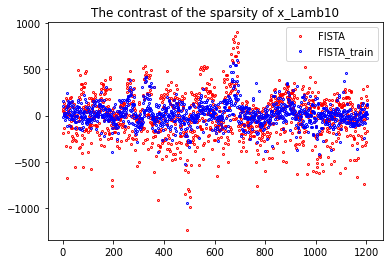

82


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 117.26ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.29430182]


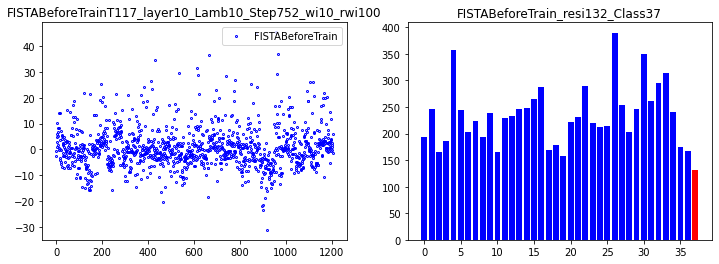

correct rate: 0.6875
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.65625
Epoch [ 10/100]: loss = 228835608.8401,   lambda [max:9.9383], [min:9.9263], 
Epoch [ 20/100]: loss = 41127984.1002,   lambda [max:9.9030], [min:9.8774], 
Epoch [ 30/100]: loss = 26091835.8576,   lambda [max:9.8759], [min:9.8376], 
Epoch [ 40/100]: loss = 22573990.5758,   lambda [max:9.8509], [min:9.8026], 
Epoch [ 50/100]: loss = 19175868.9644,   lambda [max:9.8275], [min:9.7716], 
Epoch [ 60/100]: loss = 18070633.8928,   lambda [max:9.8053], [min:9.7434], 
Epoch [ 70/100]: loss = 17499126.7886,   lambda [max:9.7842], [min:9.7174], 
Epoch [ 80/100]: loss = 16491342.4316,   lambda [max:9.7640], [min:9.6931], 
Epoch [ 90/100]: loss = 16291441.0398,   lambda [max:9.7444], [min:9.6703], 
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.78125
Epoch [100/100]: loss = 14724182.8291,   lambda [max:9.7274], [min:9.6485], 


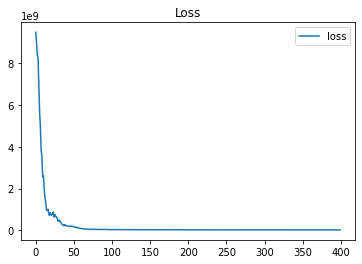

done 10 layers in 100.42ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[173.80243633]


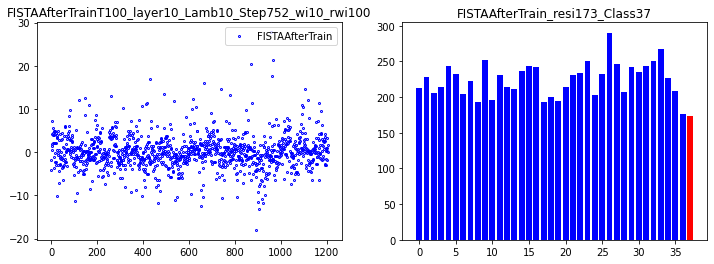

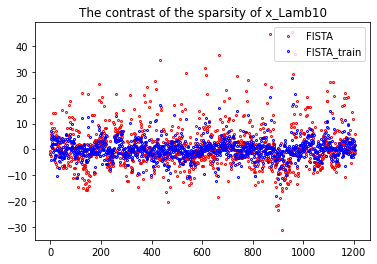

83


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 103.68ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4727.03378325]


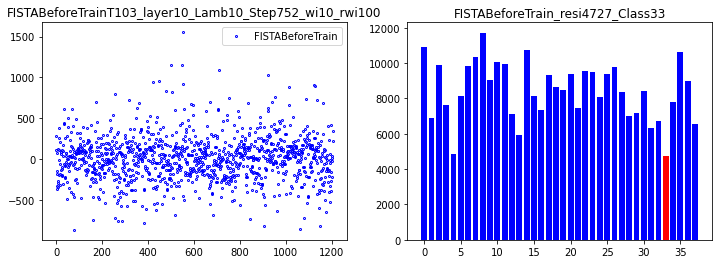

correct rate: 0.75
correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.71875
Epoch [ 10/100]: loss = 199726495.9075,   lambda [max:9.9377], [min:9.9265], 
Epoch [ 20/100]: loss = 44356210.7330,   lambda [max:9.9042], [min:9.8763], 
Epoch [ 30/100]: loss = 27948875.8422,   lambda [max:9.8771], [min:9.8353], 
Epoch [ 40/100]: loss = 21927078.4593,   lambda [max:9.8521], [min:9.7994], 
Epoch [ 50/100]: loss = 20359302.2668,   lambda [max:9.8288], [min:9.7674], 
Epoch [ 60/100]: loss = 17295400.2600,   lambda [max:9.8068], [min:9.7384], 
Epoch [ 70/100]: loss = 16895520.2864,   lambda [max:9.7857], [min:9.7116], 
Epoch [ 80/100]: loss = 16826843.8769,   lambda [max:9.7654], [min:9.6867], 
Epoch [ 90/100]: loss = 15978053.0868,   lambda [max:9.7458], [min:9.6631], 
correct rate: 0.71875
correct rate: 0.75
correct rate: 0.625
correct rate: 0.8125
Epoch [100/100]: loss = 15487945.9244,   lambda [max:9.7279], [min:9.6407], 


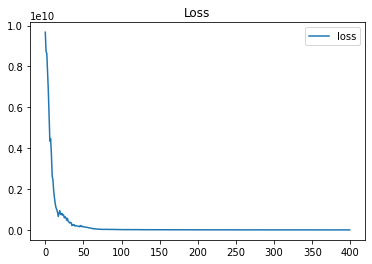

done 10 layers in 109.95ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6794.20651115]


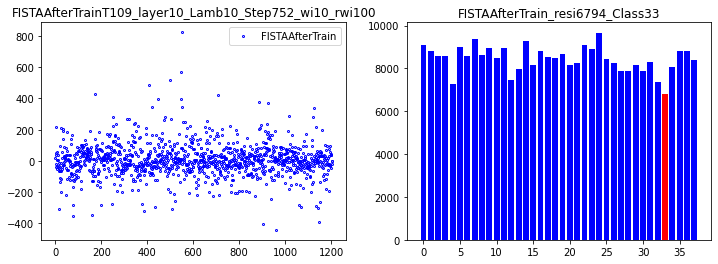

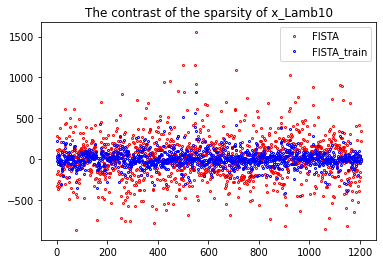

84


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 113.74ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5985.48640629]


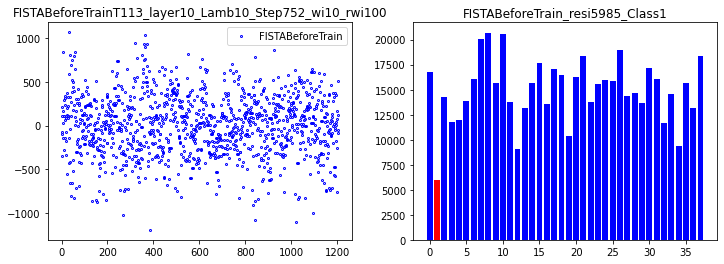

correct rate: 0.78125
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.65625
Epoch [ 10/100]: loss = 230977302.7640,   lambda [max:9.9374], [min:9.9265], 
Epoch [ 20/100]: loss = 37142660.8789,   lambda [max:9.9035], [min:9.8778], 
Epoch [ 30/100]: loss = 25043384.8759,   lambda [max:9.8765], [min:9.8376], 
Epoch [ 40/100]: loss = 22575012.9391,   lambda [max:9.8516], [min:9.8024], 
Epoch [ 50/100]: loss = 20762461.3063,   lambda [max:9.8282], [min:9.7712], 
Epoch [ 60/100]: loss = 18031539.8512,   lambda [max:9.8060], [min:9.7428], 
Epoch [ 70/100]: loss = 17856682.9801,   lambda [max:9.7849], [min:9.7165], 
Epoch [ 80/100]: loss = 16072969.0991,   lambda [max:9.7645], [min:9.6920], 
Epoch [ 90/100]: loss = 15390166.8522,   lambda [max:9.7448], [min:9.6688], 
correct rate: 0.625
correct rate: 0.75
correct rate: 0.71875
correct rate: 0.8125
Epoch [100/100]: loss = 15307082.5503,   lambda [max:9.7269], [min:9.6468], 


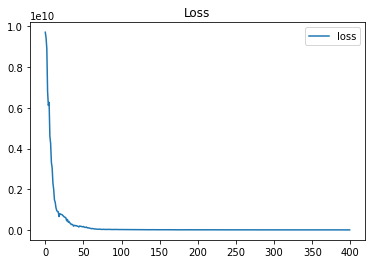

done 10 layers in 124.70ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[10199.60673647]


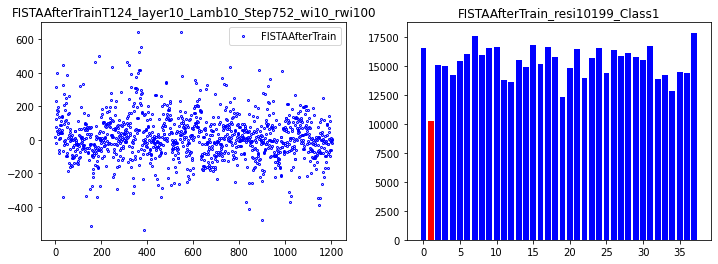

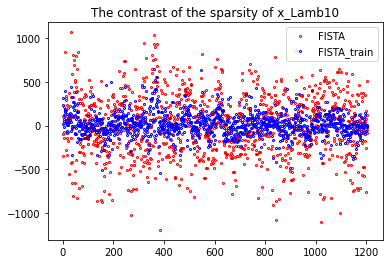

85


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 105.60ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.75313704]


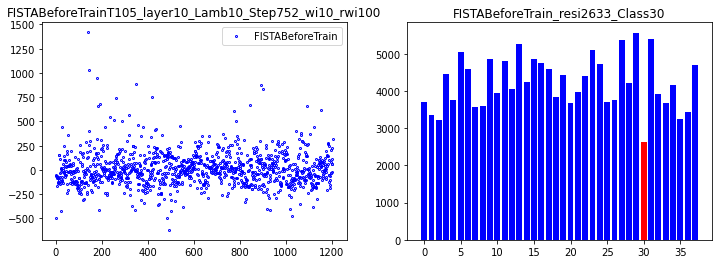

correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 197336668.7655,   lambda [max:9.9374], [min:9.9260], 
Epoch [ 20/100]: loss = 33931165.7846,   lambda [max:9.9039], [min:9.8773], 
Epoch [ 30/100]: loss = 25515186.3470,   lambda [max:9.8769], [min:9.8375], 
Epoch [ 40/100]: loss = 21945467.9235,   lambda [max:9.8522], [min:9.8029], 
Epoch [ 50/100]: loss = 20507804.2793,   lambda [max:9.8290], [min:9.7721], 
Epoch [ 60/100]: loss = 17482743.5490,   lambda [max:9.8071], [min:9.7442], 
Epoch [ 70/100]: loss = 17638123.2472,   lambda [max:9.7861], [min:9.7184], 
Epoch [ 80/100]: loss = 16131306.8072,   lambda [max:9.7659], [min:9.6942], 
Epoch [ 90/100]: loss = 15648911.8491,   lambda [max:9.7463], [min:9.6707], 
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.8125
correct rate: 0.75
Epoch [100/100]: loss = 15408735.2143,   lambda [max:9.7273], [min:9.6485], 


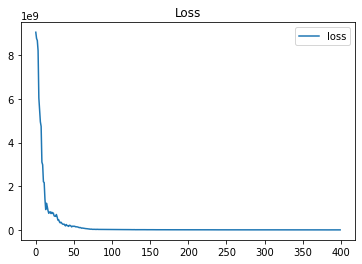

done 10 layers in 100.73ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3091.11238936]


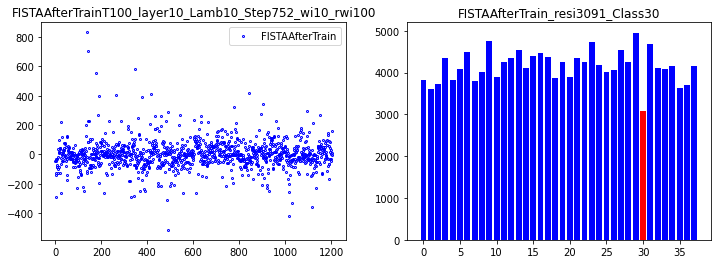

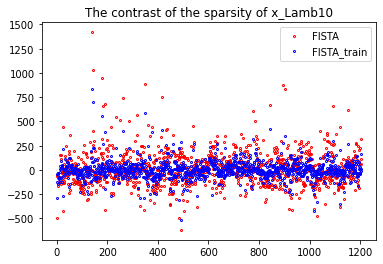

86


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 111.10ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6127.86149992]


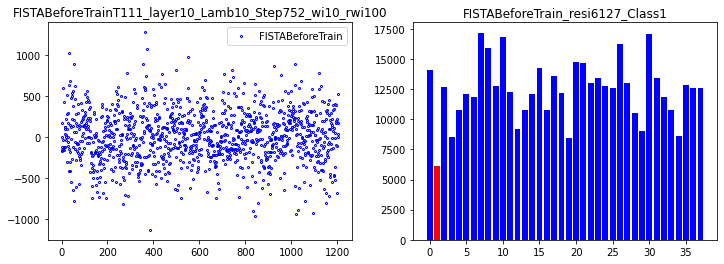

correct rate: 0.625
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.71875
Epoch [ 10/100]: loss = 212731457.8920,   lambda [max:9.9377], [min:9.9253], 
Epoch [ 20/100]: loss = 41475087.0913,   lambda [max:9.9035], [min:9.8778], 
Epoch [ 30/100]: loss = 27990198.1867,   lambda [max:9.8759], [min:9.8383], 
Epoch [ 40/100]: loss = 23181753.9617,   lambda [max:9.8509], [min:9.8037], 
Epoch [ 50/100]: loss = 18623348.6558,   lambda [max:9.8279], [min:9.7730], 
Epoch [ 60/100]: loss = 19028674.2022,   lambda [max:9.8058], [min:9.7451], 
Epoch [ 70/100]: loss = 17274994.9849,   lambda [max:9.7847], [min:9.7192], 
Epoch [ 80/100]: loss = 16067315.6103,   lambda [max:9.7644], [min:9.6951], 
Epoch [ 90/100]: loss = 15656816.7332,   lambda [max:9.7456], [min:9.6723], 
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.75
correct rate: 0.8125
Epoch [100/100]: loss = 15832405.2542,   lambda [max:9.7287], [min:9.6506], 


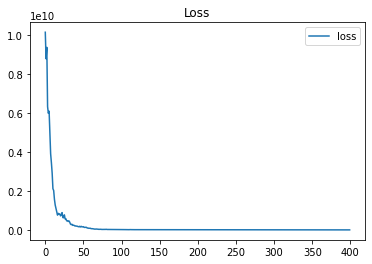

done 10 layers in 107.17ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[9197.13805278]


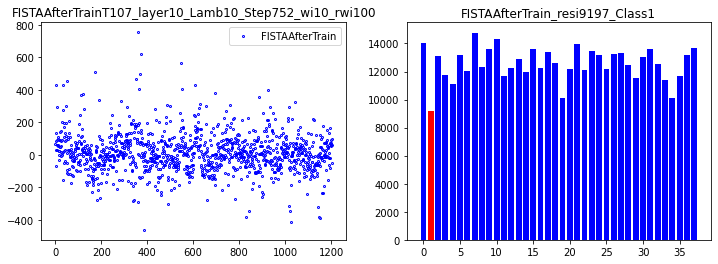

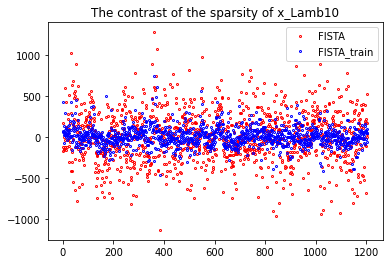

87


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 118.56ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.77151891]


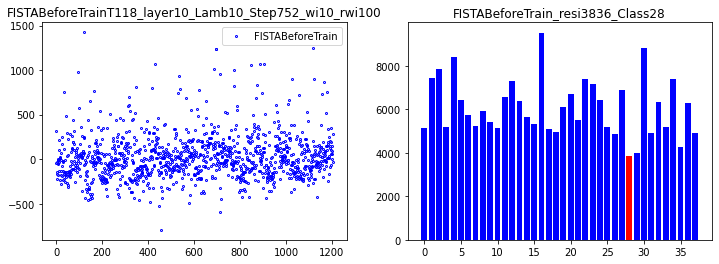

correct rate: 0.75
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 220875684.9757,   lambda [max:9.9372], [min:9.9255], 
Epoch [ 20/100]: loss = 41686495.7870,   lambda [max:9.9038], [min:9.8781], 
Epoch [ 30/100]: loss = 27267336.3931,   lambda [max:9.8771], [min:9.8381], 
Epoch [ 40/100]: loss = 22598205.8997,   lambda [max:9.8526], [min:9.8033], 
Epoch [ 50/100]: loss = 20016651.8188,   lambda [max:9.8295], [min:9.7723], 
Epoch [ 60/100]: loss = 17737815.0902,   lambda [max:9.8076], [min:9.7443], 
Epoch [ 70/100]: loss = 17363511.6257,   lambda [max:9.7868], [min:9.7178], 
Epoch [ 80/100]: loss = 15753791.7680,   lambda [max:9.7667], [min:9.6927], 
Epoch [ 90/100]: loss = 15247387.1639,   lambda [max:9.7472], [min:9.6692], 
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.8125
correct rate: 0.71875
Epoch [100/100]: loss = 14568146.0977,   lambda [max:9.7283], [min:9.6469], 


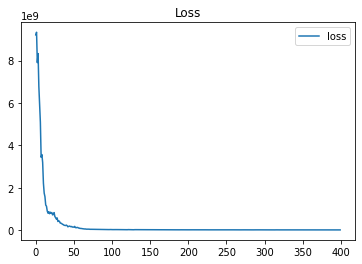

done 10 layers in 100.49ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4656.22690967]


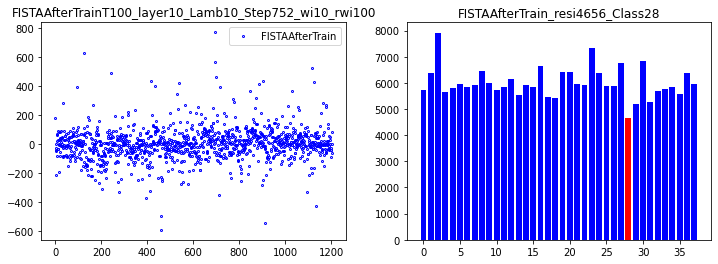

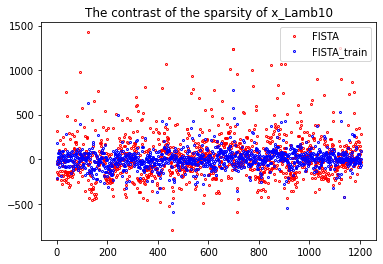

88


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 95.11ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11039.5768946]


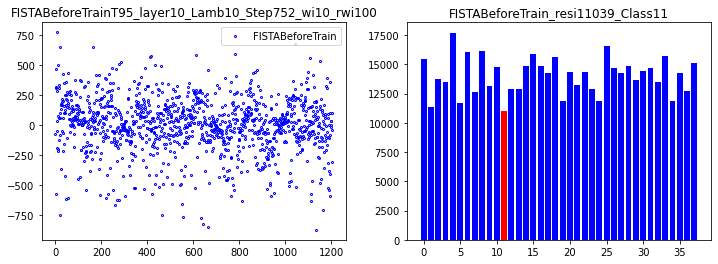

correct rate: 0.75
correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.71875
Epoch [ 10/100]: loss = 255456285.1036,   lambda [max:9.9376], [min:9.9257], 
Epoch [ 20/100]: loss = 40432230.1960,   lambda [max:9.9042], [min:9.8781], 
Epoch [ 30/100]: loss = 25956074.8986,   lambda [max:9.8774], [min:9.8389], 
Epoch [ 40/100]: loss = 21318454.8829,   lambda [max:9.8527], [min:9.8048], 
Epoch [ 50/100]: loss = 19450331.4773,   lambda [max:9.8296], [min:9.7744], 
Epoch [ 60/100]: loss = 17378579.3303,   lambda [max:9.8077], [min:9.7456], 
Epoch [ 70/100]: loss = 17662517.2929,   lambda [max:9.7867], [min:9.7188], 
Epoch [ 80/100]: loss = 15903058.6166,   lambda [max:9.7666], [min:9.6938], 
Epoch [ 90/100]: loss = 14920889.2244,   lambda [max:9.7470], [min:9.6703], 
correct rate: 0.78125
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.71875
Epoch [100/100]: loss = 15104649.9588,   lambda [max:9.7281], [min:9.6480], 


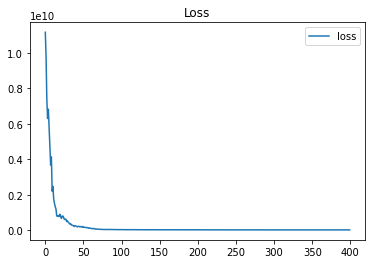

done 10 layers in 111.87ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11256.51496685]


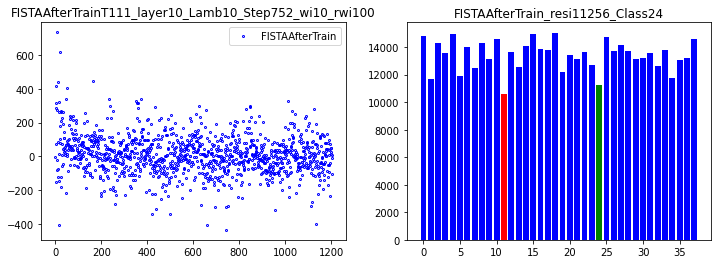

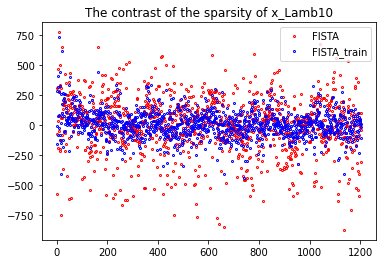

89


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 109.51ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16513.30609801]


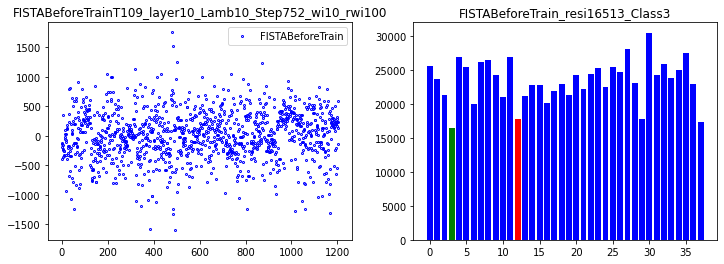

correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.6875
Epoch [ 10/100]: loss = 163828169.9414,   lambda [max:9.9370], [min:9.9266], 
Epoch [ 20/100]: loss = 43530399.3166,   lambda [max:9.9034], [min:9.8774], 
Epoch [ 30/100]: loss = 26607386.4912,   lambda [max:9.8766], [min:9.8371], 
Epoch [ 40/100]: loss = 22763802.9446,   lambda [max:9.8518], [min:9.8019], 
Epoch [ 50/100]: loss = 19988409.6698,   lambda [max:9.8287], [min:9.7705], 
Epoch [ 60/100]: loss = 17717362.8314,   lambda [max:9.8068], [min:9.7420], 
Epoch [ 70/100]: loss = 17521583.9684,   lambda [max:9.7859], [min:9.7157], 
Epoch [ 80/100]: loss = 17217392.8485,   lambda [max:9.7658], [min:9.6911], 
Epoch [ 90/100]: loss = 16336308.6223,   lambda [max:9.7467], [min:9.6679], 
correct rate: 0.75
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.78125
Epoch [100/100]: loss = 15970717.7345,   lambda [max:9.7298], [min:9.6459], 


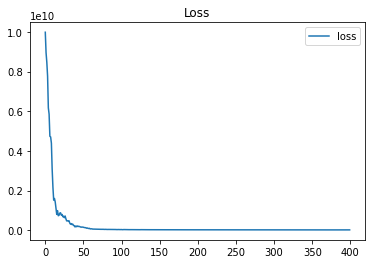

done 10 layers in 104.21ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21587.95880755]


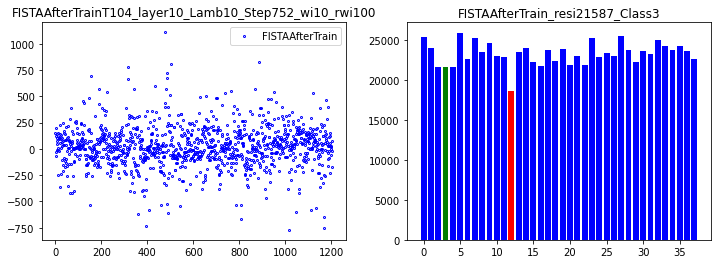

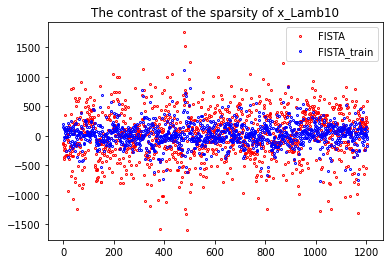

90


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 109.08ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6135.43966325]


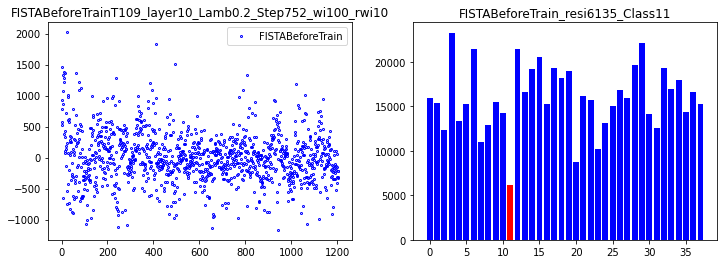

correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.625
correct rate: 0.59375
Epoch [ 10/100]: loss = 226309746.2479,   lambda [max:0.1376], [min:0.1260], 
Epoch [ 20/100]: loss = 26790017.0594,   lambda [max:0.1031], [min:0.0770], 
Epoch [ 30/100]: loss = 15015400.9899,   lambda [max:0.0759], [min:0.0362], 
Epoch [ 40/100]: loss = 10741695.9786,   lambda [max:0.0509], [min:0.0007], 
Epoch [ 50/100]: loss = 7071932.5975,   lambda [max:0.0277], [min:-0.0311], 
Epoch [ 60/100]: loss = 6169021.5717,   lambda [max:0.0057], [min:-0.0598], 
Epoch [ 70/100]: loss = 5051958.9844,   lambda [max:-0.0153], [min:-0.0865], 
Epoch [ 80/100]: loss = 4407808.8090,   lambda [max:-0.0354], [min:-0.1114], 
Epoch [ 90/100]: loss = 3819982.6934,   lambda [max:-0.0549], [min:-0.1350], 
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.5625
correct rate: 0.6875
Epoch [100/100]: loss = 3069945.6926,   lambda [max:-0.0737], [min:-0.1574], 


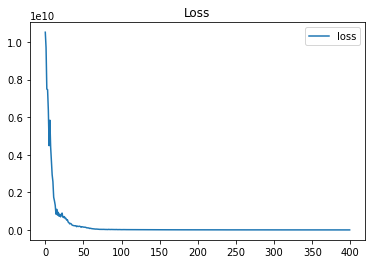

done 10 layers in 94.90ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[14042.49070091]


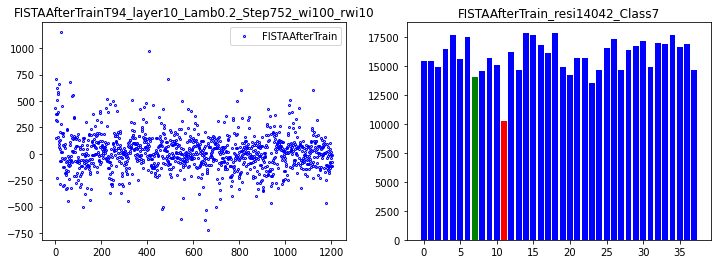

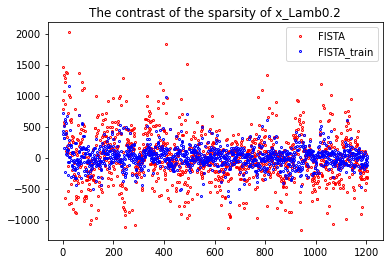

91


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 96.88ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6904.23254266]


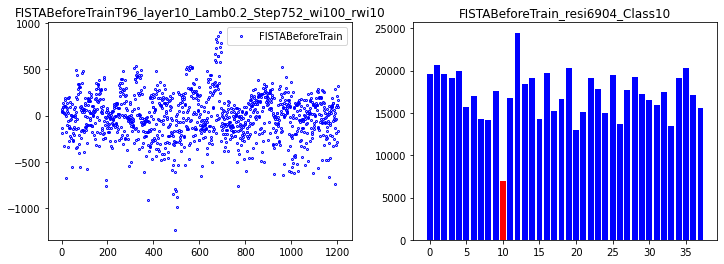

correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.78125
Epoch [ 10/100]: loss = 205237528.7527,   lambda [max:0.1375], [min:0.1263], 
Epoch [ 20/100]: loss = 28155927.3150,   lambda [max:0.1038], [min:0.0761], 
Epoch [ 30/100]: loss = 14603699.9124,   lambda [max:0.0769], [min:0.0354], 
Epoch [ 40/100]: loss = 10094037.6572,   lambda [max:0.0521], [min:-0.0003], 
Epoch [ 50/100]: loss = 7288697.6828,   lambda [max:0.0290], [min:-0.0320], 
Epoch [ 60/100]: loss = 6004935.4076,   lambda [max:0.0070], [min:-0.0609], 
Epoch [ 70/100]: loss = 5023978.7562,   lambda [max:-0.0139], [min:-0.0877], 
Epoch [ 80/100]: loss = 4111266.5695,   lambda [max:-0.0341], [min:-0.1127], 
Epoch [ 90/100]: loss = 3751448.2432,   lambda [max:-0.0536], [min:-0.1364], 
correct rate: 0.53125
correct rate: 0.6875
correct rate: 0.71875
correct rate: 0.6875
Epoch [100/100]: loss = 3298322.9260,   lambda [max:-0.0724], [min:-0.1589], 


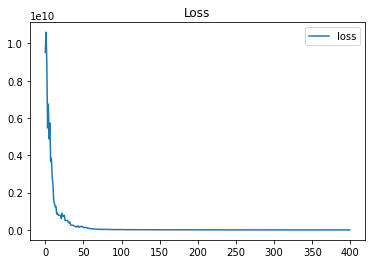

done 10 layers in 99.30ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[11100.53571545]


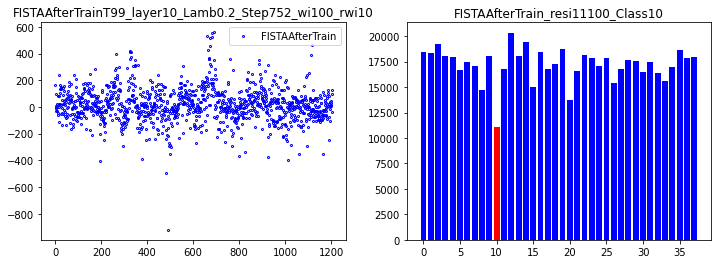

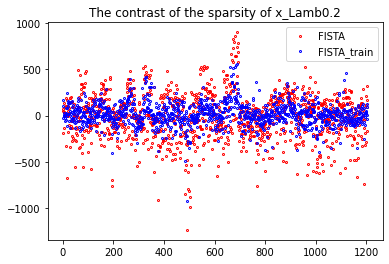

92


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 92.57ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.11572183]


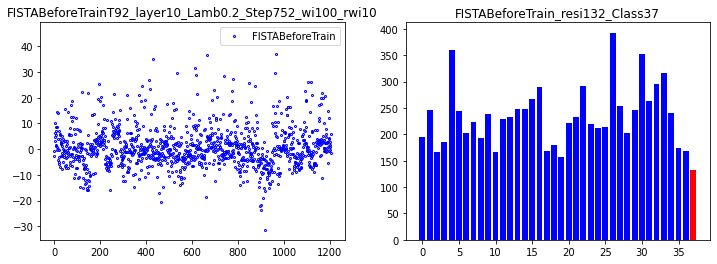

correct rate: 0.75
correct rate: 0.625
correct rate: 0.6875
correct rate: 0.625
Epoch [ 10/100]: loss = 209648977.2088,   lambda [max:0.1372], [min:0.1267], 
Epoch [ 20/100]: loss = 29471380.1233,   lambda [max:0.1038], [min:0.0764], 
Epoch [ 30/100]: loss = 14782897.7072,   lambda [max:0.0771], [min:0.0359], 
Epoch [ 40/100]: loss = 10278700.4965,   lambda [max:0.0525], [min:0.0006], 
Epoch [ 50/100]: loss = 7524548.1258,   lambda [max:0.0294], [min:-0.0308], 
Epoch [ 60/100]: loss = 6315509.0695,   lambda [max:0.0076], [min:-0.0594], 
Epoch [ 70/100]: loss = 4417101.8751,   lambda [max:-0.0133], [min:-0.0857], 
Epoch [ 80/100]: loss = 3870325.2516,   lambda [max:-0.0333], [min:-0.1104], 
Epoch [ 90/100]: loss = 3680617.1412,   lambda [max:-0.0527], [min:-0.1338], 
correct rate: 0.5
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.625
Epoch [100/100]: loss = 3049718.1155,   lambda [max:-0.0715], [min:-0.1560], 


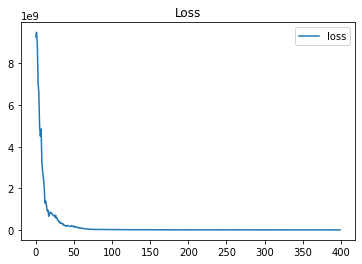

done 10 layers in 97.86ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[169.97518836]


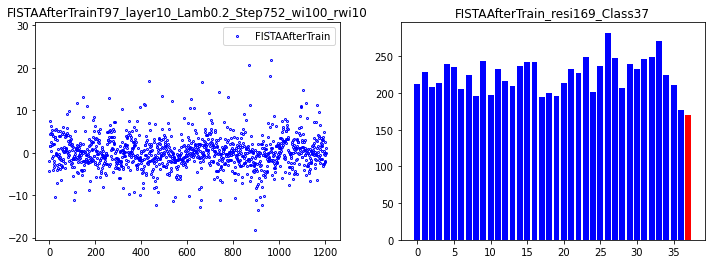

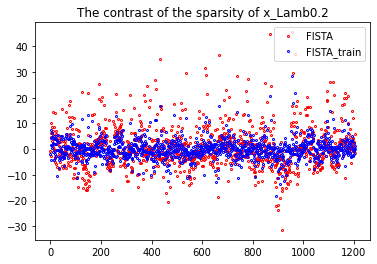

93


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.49ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4726.46574361]


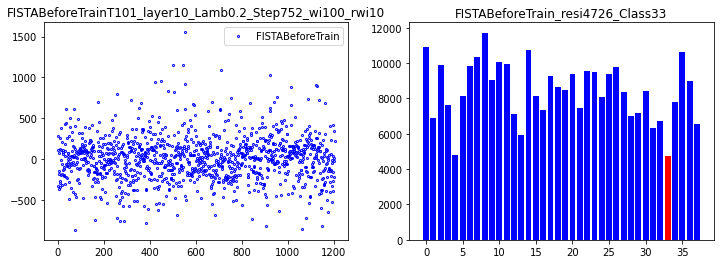

correct rate: 0.65625
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.65625
Epoch [ 10/100]: loss = 248703702.4620,   lambda [max:0.1373], [min:0.1262], 
Epoch [ 20/100]: loss = 31493077.2373,   lambda [max:0.1028], [min:0.0759], 
Epoch [ 30/100]: loss = 14570273.0276,   lambda [max:0.0757], [min:0.0349], 
Epoch [ 40/100]: loss = 10217081.1679,   lambda [max:0.0509], [min:-0.0010], 
Epoch [ 50/100]: loss = 7845466.5110,   lambda [max:0.0277], [min:-0.0329], 
Epoch [ 60/100]: loss = 5685322.0918,   lambda [max:0.0059], [min:-0.0619], 
Epoch [ 70/100]: loss = 4814088.1645,   lambda [max:-0.0150], [min:-0.0887], 
Epoch [ 80/100]: loss = 3953869.7814,   lambda [max:-0.0351], [min:-0.1137], 
Epoch [ 90/100]: loss = 3548695.4925,   lambda [max:-0.0545], [min:-0.1374], 
correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.65625
correct rate: 0.65625
Epoch [100/100]: loss = 3424798.4722,   lambda [max:-0.0733], [min:-0.1600], 


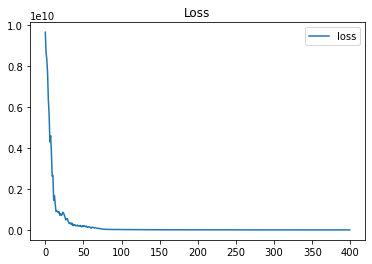

done 10 layers in 119.32ms
predict class: yaleB13
test image label: yaleB35
predict residuals label: 12
test residuals label: 33
[7484.91792988]


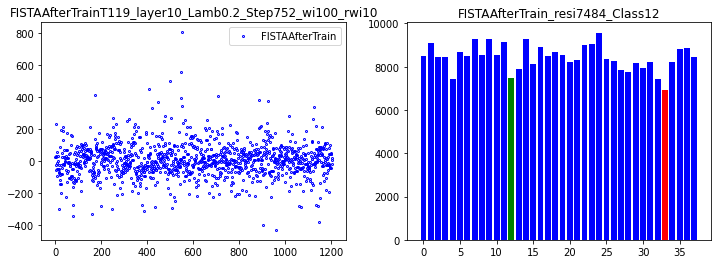

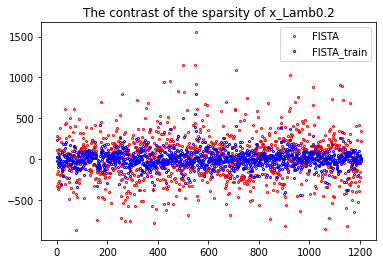

94


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 113.97ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5982.98608124]


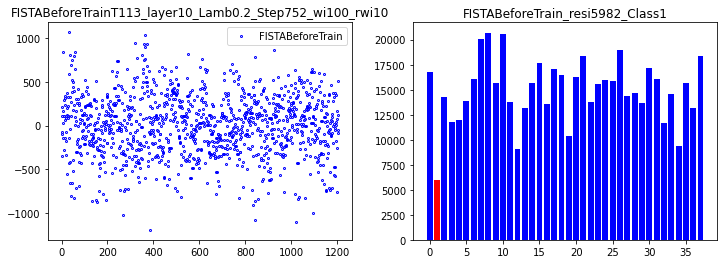

correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.78125
correct rate: 0.71875
Epoch [ 10/100]: loss = 212370495.5531,   lambda [max:0.1374], [min:0.1260], 
Epoch [ 20/100]: loss = 31619609.7178,   lambda [max:0.1032], [min:0.0769], 
Epoch [ 30/100]: loss = 14281426.9729,   lambda [max:0.0760], [min:0.0363], 
Epoch [ 40/100]: loss = 10284882.2365,   lambda [max:0.0510], [min:0.0008], 
Epoch [ 50/100]: loss = 7614668.4256,   lambda [max:0.0277], [min:-0.0307], 
Epoch [ 60/100]: loss = 5647995.0308,   lambda [max:0.0056], [min:-0.0594], 
Epoch [ 70/100]: loss = 4983486.0661,   lambda [max:-0.0155], [min:-0.0859], 
Epoch [ 80/100]: loss = 4187849.9799,   lambda [max:-0.0358], [min:-0.1107], 
Epoch [ 90/100]: loss = 3637906.5959,   lambda [max:-0.0554], [min:-0.1342], 
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.59375
Epoch [100/100]: loss = 3177415.2550,   lambda [max:-0.0744], [min:-0.1565], 


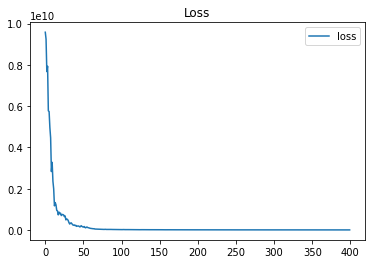

done 10 layers in 120.76ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[11532.46676588]


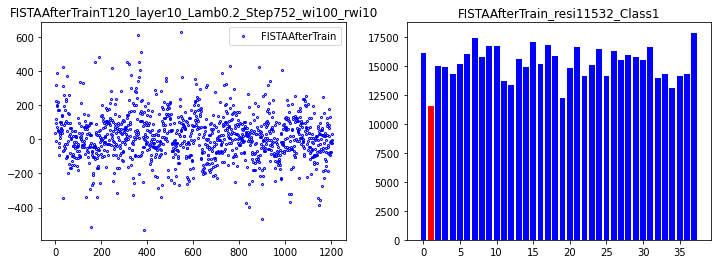

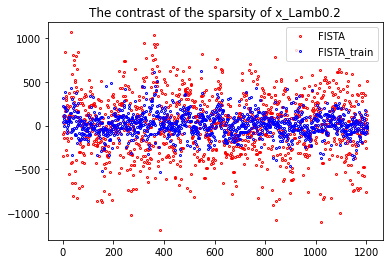

95


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 94.25ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.91111018]


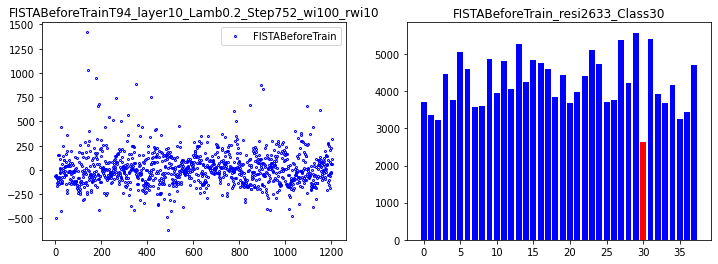

correct rate: 0.75
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.6875
Epoch [ 10/100]: loss = 224892572.6519,   lambda [max:0.1375], [min:0.1261], 
Epoch [ 20/100]: loss = 28562772.3444,   lambda [max:0.1034], [min:0.0768], 
Epoch [ 30/100]: loss = 15994445.9896,   lambda [max:0.0771], [min:0.0361], 
Epoch [ 40/100]: loss = 10159389.0762,   lambda [max:0.0530], [min:0.0005], 
Epoch [ 50/100]: loss = 8465535.1432,   lambda [max:0.0303], [min:-0.0313], 
Epoch [ 60/100]: loss = 6702203.7041,   lambda [max:0.0088], [min:-0.0602], 
Epoch [ 70/100]: loss = 5364198.9692,   lambda [max:-0.0117], [min:-0.0870], 
Epoch [ 80/100]: loss = 4557675.4611,   lambda [max:-0.0315], [min:-0.1121], 
Epoch [ 90/100]: loss = 3871446.2346,   lambda [max:-0.0506], [min:-0.1358], 
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.5
Epoch [100/100]: loss = 3147556.9502,   lambda [max:-0.0691], [min:-0.1584], 


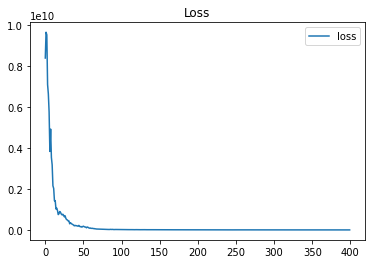

done 10 layers in 98.84ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3070.88313976]


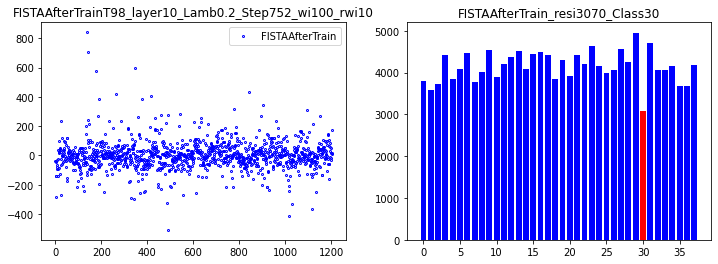

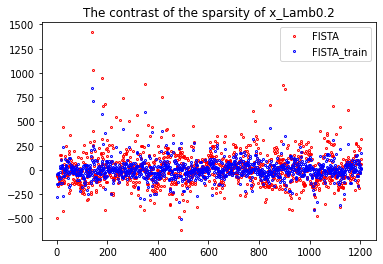

96


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 110.63ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6125.4037645]


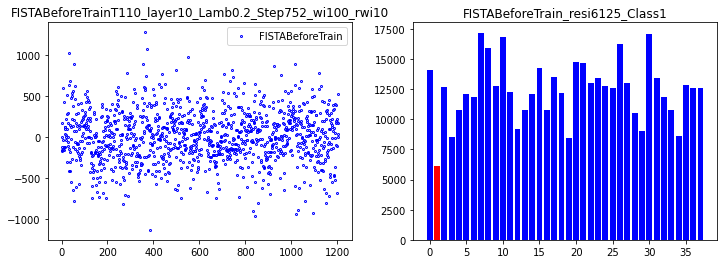

correct rate: 0.75
correct rate: 0.59375
correct rate: 0.625
correct rate: 0.75
Epoch [ 10/100]: loss = 201661605.9294,   lambda [max:0.1372], [min:0.1268], 
Epoch [ 20/100]: loss = 31786460.7203,   lambda [max:0.1033], [min:0.0769], 
Epoch [ 30/100]: loss = 14064084.2346,   lambda [max:0.0764], [min:0.0367], 
Epoch [ 40/100]: loss = 10623715.4292,   lambda [max:0.0517], [min:0.0015], 
Epoch [ 50/100]: loss = 7595614.7094,   lambda [max:0.0286], [min:-0.0299], 
Epoch [ 60/100]: loss = 6219758.8761,   lambda [max:0.0067], [min:-0.0585], 
Epoch [ 70/100]: loss = 5006706.3716,   lambda [max:-0.0142], [min:-0.0850], 
Epoch [ 80/100]: loss = 4199369.5829,   lambda [max:-0.0344], [min:-0.1099], 
Epoch [ 90/100]: loss = 3628014.0271,   lambda [max:-0.0539], [min:-0.1335], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.59375
Epoch [100/100]: loss = 3393549.1536,   lambda [max:-0.0729], [min:-0.1559], 


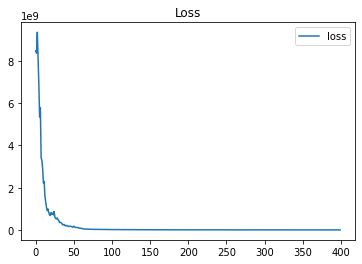

done 10 layers in 109.32ms
predict class: yaleB36
test image label: yaleB02
predict residuals label: 34
test residuals label: 1
[10406.71162347]


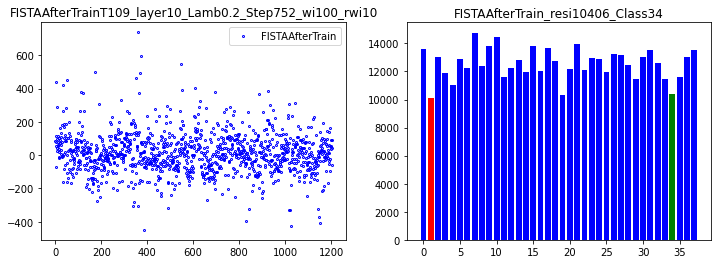

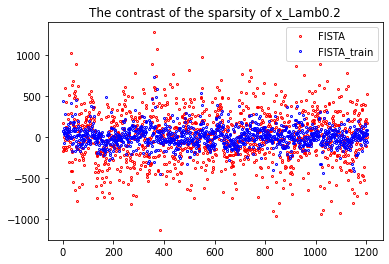

97


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 123.97ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.5421843]


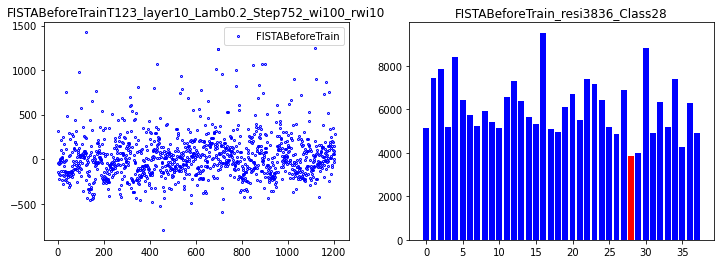

correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.71875
Epoch [ 10/100]: loss = 202102354.5295,   lambda [max:0.1373], [min:0.1260], 
Epoch [ 20/100]: loss = 29411507.5266,   lambda [max:0.1040], [min:0.0773], 
Epoch [ 30/100]: loss = 14094269.1190,   lambda [max:0.0771], [min:0.0362], 
Epoch [ 40/100]: loss = 10563557.7334,   lambda [max:0.0525], [min:0.0002], 
Epoch [ 50/100]: loss = 7114424.1374,   lambda [max:0.0294], [min:-0.0317], 
Epoch [ 60/100]: loss = 6281637.6912,   lambda [max:0.0075], [min:-0.0607], 
Epoch [ 70/100]: loss = 4520304.2425,   lambda [max:-0.0134], [min:-0.0873], 
Epoch [ 80/100]: loss = 3899460.2379,   lambda [max:-0.0336], [min:-0.1123], 
Epoch [ 90/100]: loss = 3588255.0110,   lambda [max:-0.0530], [min:-0.1360], 
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.5625
Epoch [100/100]: loss = 3186263.4215,   lambda [max:-0.0718], [min:-0.1584], 


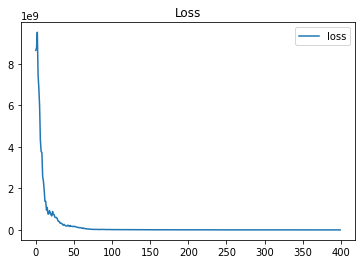

done 10 layers in 120.39ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4729.92514203]


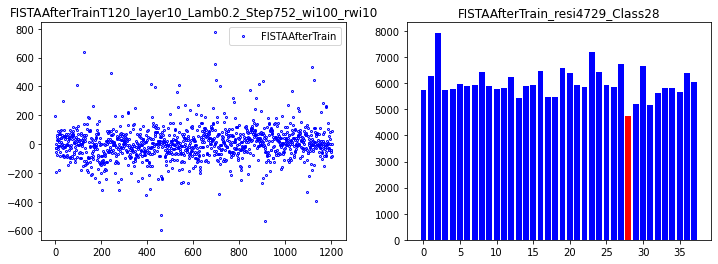

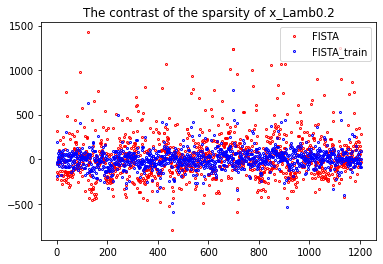

98


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 132.65ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11038.75418564]


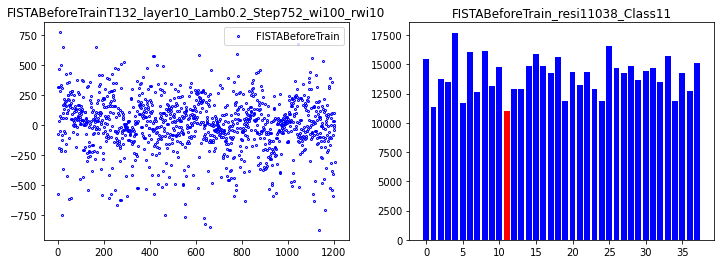

correct rate: 0.75
correct rate: 0.59375
correct rate: 0.84375
correct rate: 0.53125
Epoch [ 10/100]: loss = 212083251.9629,   lambda [max:0.1377], [min:0.1260], 
Epoch [ 20/100]: loss = 26874767.0427,   lambda [max:0.1039], [min:0.0777], 
Epoch [ 30/100]: loss = 16983271.4129,   lambda [max:0.0775], [min:0.0379], 
Epoch [ 40/100]: loss = 9641131.0236,   lambda [max:0.0533], [min:0.0031], 
Epoch [ 50/100]: loss = 6604483.8005,   lambda [max:0.0306], [min:-0.0279], 
Epoch [ 60/100]: loss = 5672319.2137,   lambda [max:0.0090], [min:-0.0561], 
Epoch [ 70/100]: loss = 5071524.6667,   lambda [max:-0.0117], [min:-0.0823], 
Epoch [ 80/100]: loss = 4215950.0848,   lambda [max:-0.0315], [min:-0.1077], 
Epoch [ 90/100]: loss = 3825554.9834,   lambda [max:-0.0507], [min:-0.1319], 
correct rate: 0.46875
correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.78125
Epoch [100/100]: loss = 3222922.4792,   lambda [max:-0.0693], [min:-0.1550], 


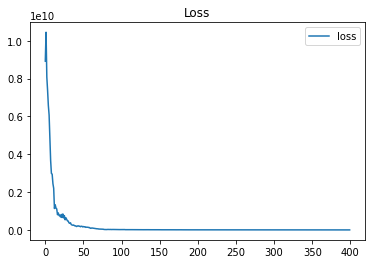

done 10 layers in 115.72ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11398.96525616]


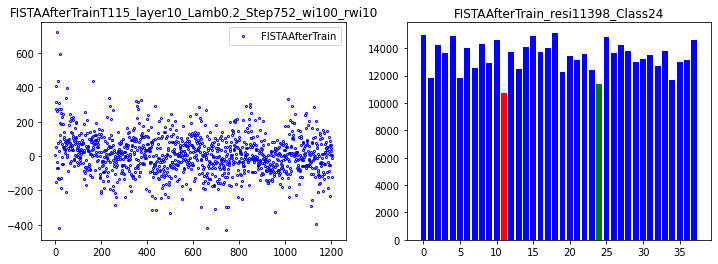

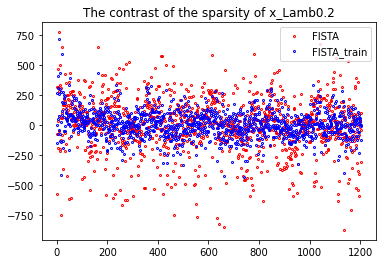

99


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 107.33ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16511.1576364]


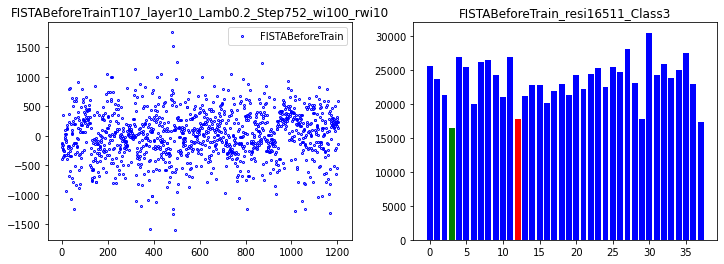

correct rate: 0.59375
correct rate: 0.75
correct rate: 0.65625
correct rate: 0.71875
Epoch [ 10/100]: loss = 224507792.3233,   lambda [max:0.1373], [min:0.1256], 
Epoch [ 20/100]: loss = 26069280.6373,   lambda [max:0.1039], [min:0.0783], 
Epoch [ 30/100]: loss = 13834813.6062,   lambda [max:0.0774], [min:0.0386], 
Epoch [ 40/100]: loss = 9714109.6944,   lambda [max:0.0530], [min:0.0038], 
Epoch [ 50/100]: loss = 7327219.4179,   lambda [max:0.0302], [min:-0.0273], 
Epoch [ 60/100]: loss = 6072038.2755,   lambda [max:0.0085], [min:-0.0557], 
Epoch [ 70/100]: loss = 5209792.1121,   lambda [max:-0.0122], [min:-0.0819], 
Epoch [ 80/100]: loss = 4475075.9897,   lambda [max:-0.0322], [min:-0.1068], 
Epoch [ 90/100]: loss = 3517927.2471,   lambda [max:-0.0515], [min:-0.1307], 
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.5625
correct rate: 0.75
Epoch [100/100]: loss = 3081539.3261,   lambda [max:-0.0702], [min:-0.1533], 


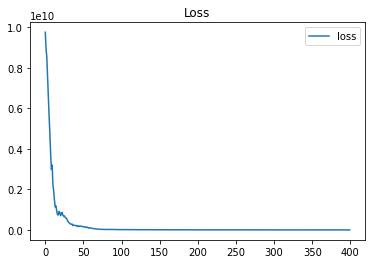

done 10 layers in 113.20ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21926.55787245]


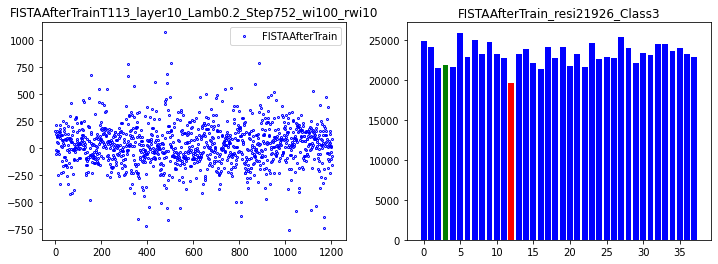

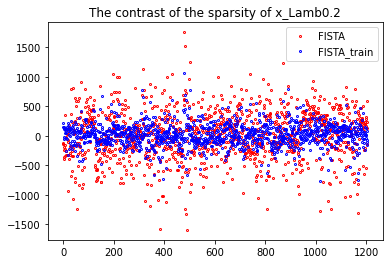

100


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 104.43ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6135.27056371]


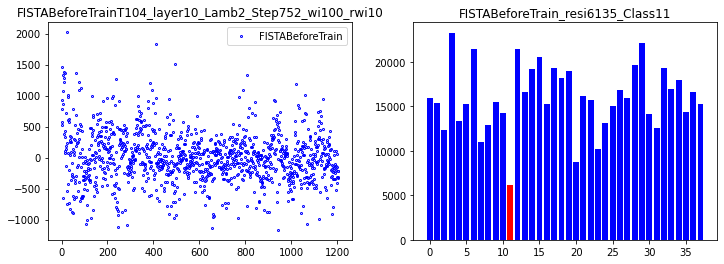

correct rate: 0.625
correct rate: 0.8125
correct rate: 0.65625
correct rate: 0.65625
Epoch [ 10/100]: loss = 196074238.6840,   lambda [max:1.9371], [min:1.9260], 
Epoch [ 20/100]: loss = 29085504.0240,   lambda [max:1.9031], [min:1.8770], 
Epoch [ 30/100]: loss = 17617319.8945,   lambda [max:1.8761], [min:1.8370], 
Epoch [ 40/100]: loss = 11028551.7495,   lambda [max:1.8512], [min:1.8020], 
Epoch [ 50/100]: loss = 9823317.5348,   lambda [max:1.8279], [min:1.7707], 
Epoch [ 60/100]: loss = 7417602.9489,   lambda [max:1.8058], [min:1.7423], 
Epoch [ 70/100]: loss = 6436386.7446,   lambda [max:1.7849], [min:1.7159], 
Epoch [ 80/100]: loss = 5396797.8954,   lambda [max:1.7648], [min:1.6912], 
Epoch [ 90/100]: loss = 4967690.1367,   lambda [max:1.7454], [min:1.6678], 
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.5
correct rate: 0.71875
Epoch [100/100]: loss = 4457133.4489,   lambda [max:1.7267], [min:1.6455], 


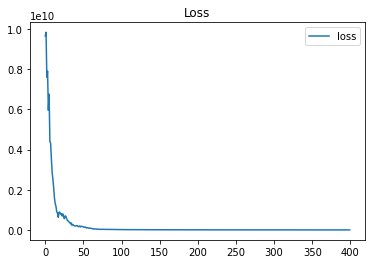

done 10 layers in 104.04ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[14154.70693796]


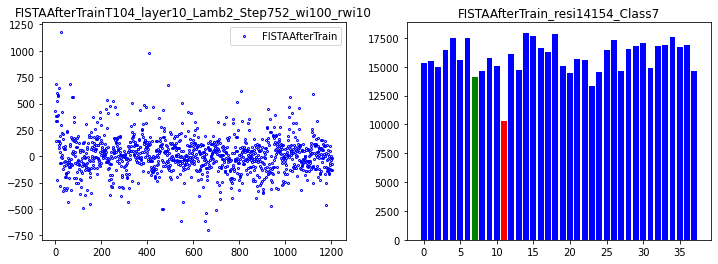

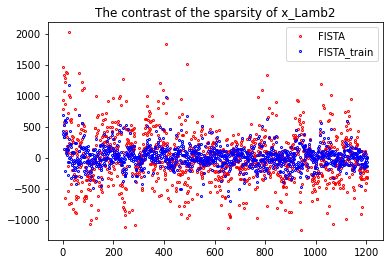

101


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 108.56ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6904.66862168]


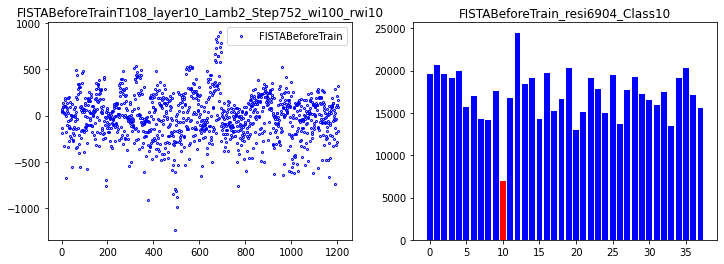

correct rate: 0.65625
correct rate: 0.8125
correct rate: 0.6875
correct rate: 0.5625
Epoch [ 10/100]: loss = 204862802.2752,   lambda [max:1.9372], [min:1.9266], 
Epoch [ 20/100]: loss = 28836119.8929,   lambda [max:1.9034], [min:1.8775], 
Epoch [ 30/100]: loss = 15513906.8125,   lambda [max:1.8767], [min:1.8370], 
Epoch [ 40/100]: loss = 11374827.1712,   lambda [max:1.8524], [min:1.8017], 
Epoch [ 50/100]: loss = 8047988.1694,   lambda [max:1.8296], [min:1.7703], 
Epoch [ 60/100]: loss = 6857950.0009,   lambda [max:1.8080], [min:1.7417], 
Epoch [ 70/100]: loss = 5931611.8138,   lambda [max:1.7873], [min:1.7154], 
Epoch [ 80/100]: loss = 5285702.4387,   lambda [max:1.7674], [min:1.6906], 
Epoch [ 90/100]: loss = 4774658.6206,   lambda [max:1.7482], [min:1.6672], 
correct rate: 0.6875
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.625
Epoch [100/100]: loss = 4546493.1883,   lambda [max:1.7294], [min:1.6450], 


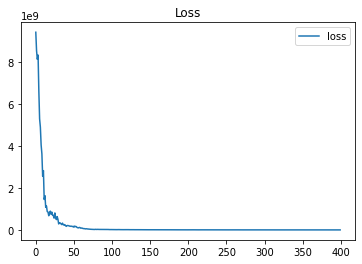

done 10 layers in 106.19ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[11136.07013781]


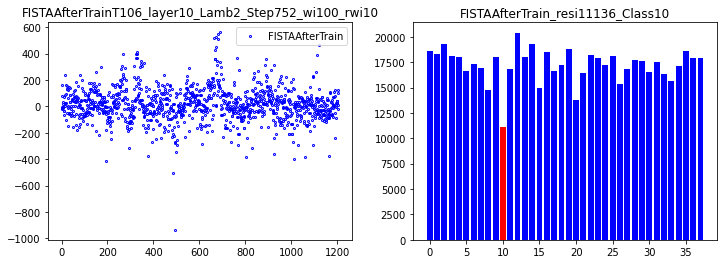

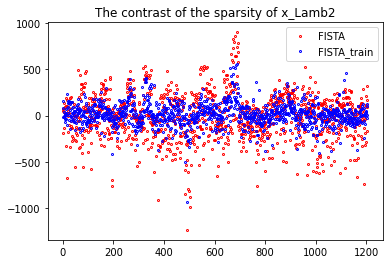

102


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 107.24ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.14730092]


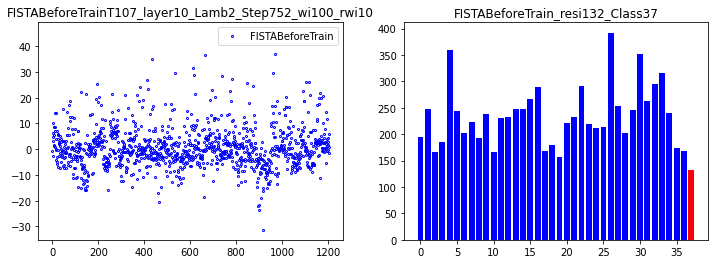

correct rate: 0.65625
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.75
Epoch [ 10/100]: loss = 208355156.1133,   lambda [max:1.9372], [min:1.9258], 
Epoch [ 20/100]: loss = 28331585.8450,   lambda [max:1.9037], [min:1.8768], 
Epoch [ 30/100]: loss = 16690742.3218,   lambda [max:1.8767], [min:1.8358], 
Epoch [ 40/100]: loss = 11560398.0490,   lambda [max:1.8519], [min:1.8000], 
Epoch [ 50/100]: loss = 9191498.1781,   lambda [max:1.8287], [min:1.7682], 
Epoch [ 60/100]: loss = 7356077.8370,   lambda [max:1.8068], [min:1.7393], 
Epoch [ 70/100]: loss = 6357182.7471,   lambda [max:1.7858], [min:1.7127], 
Epoch [ 80/100]: loss = 5700383.5350,   lambda [max:1.7656], [min:1.6878], 
Epoch [ 90/100]: loss = 4653562.2523,   lambda [max:1.7462], [min:1.6642], 
correct rate: 0.59375
correct rate: 0.625
correct rate: 0.625
correct rate: 0.71875
Epoch [100/100]: loss = 4445040.3572,   lambda [max:1.7273], [min:1.6417], 


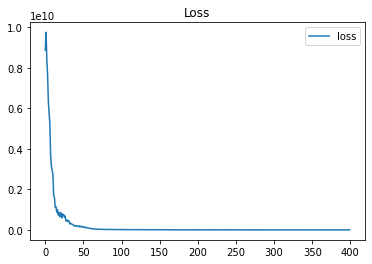

done 10 layers in 102.49ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[172.47590705]


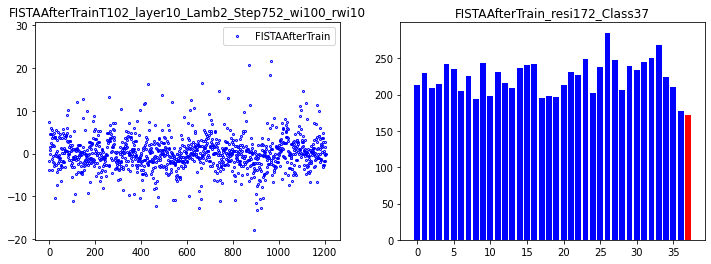

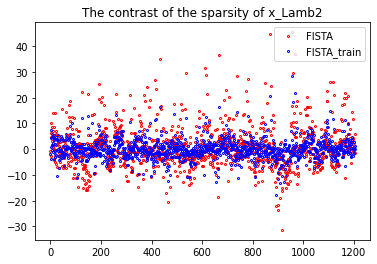

103


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 97.74ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4726.57002266]


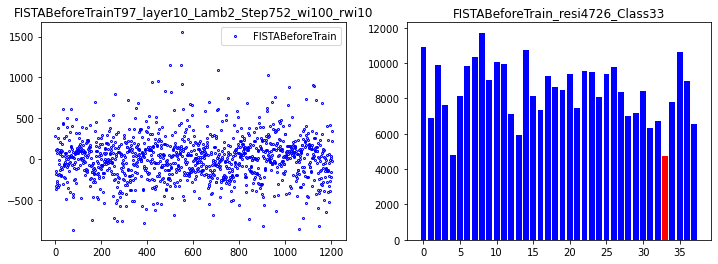

correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.75
Epoch [ 10/100]: loss = 250918575.3843,   lambda [max:1.9372], [min:1.9259], 
Epoch [ 20/100]: loss = 27634424.9855,   lambda [max:1.9028], [min:1.8772], 
Epoch [ 30/100]: loss = 13140851.5015,   lambda [max:1.8762], [min:1.8373], 
Epoch [ 40/100]: loss = 11043389.7013,   lambda [max:1.8517], [min:1.8025], 
Epoch [ 50/100]: loss = 8682537.0656,   lambda [max:1.8289], [min:1.7714], 
Epoch [ 60/100]: loss = 7036725.9893,   lambda [max:1.8073], [min:1.7431], 
Epoch [ 70/100]: loss = 6411223.5734,   lambda [max:1.7866], [min:1.7169], 
Epoch [ 80/100]: loss = 5513068.1270,   lambda [max:1.7667], [min:1.6924], 
Epoch [ 90/100]: loss = 4915389.0391,   lambda [max:1.7476], [min:1.6691], 
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.625
correct rate: 0.6875
Epoch [100/100]: loss = 4005270.1577,   lambda [max:1.7289], [min:1.6469], 


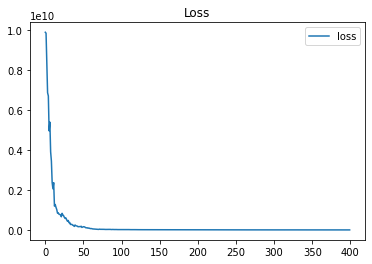

done 10 layers in 123.40ms
predict class: yaleB15
test image label: yaleB35
predict residuals label: 13
test residuals label: 33
[7952.55161318]


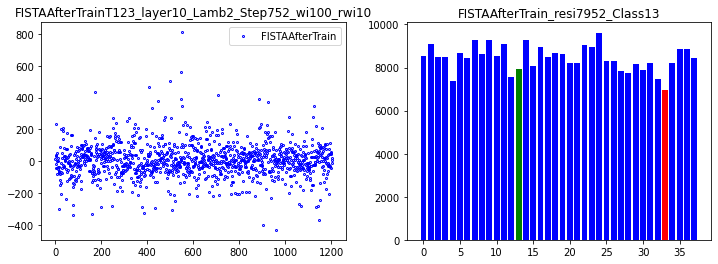

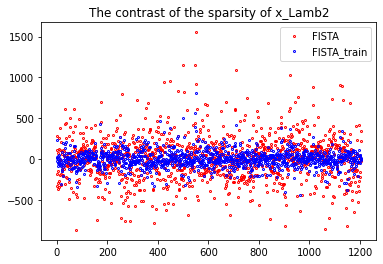

104


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 120.91ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5983.44513674]


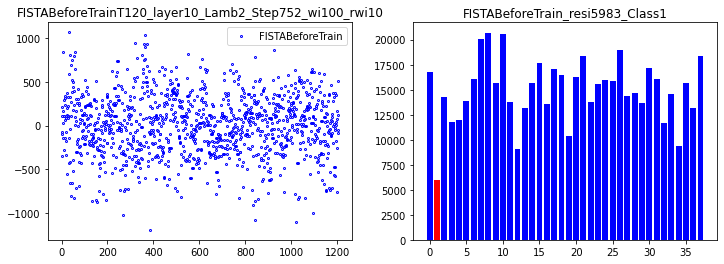

correct rate: 0.84375
correct rate: 0.71875
correct rate: 0.5
correct rate: 0.6875
Epoch [ 10/100]: loss = 186225164.4091,   lambda [max:1.9371], [min:1.9265], 
Epoch [ 20/100]: loss = 32086583.5438,   lambda [max:1.9028], [min:1.8766], 
Epoch [ 30/100]: loss = 15157106.4485,   lambda [max:1.8755], [min:1.8365], 
Epoch [ 40/100]: loss = 11571979.1537,   lambda [max:1.8505], [min:1.8015], 
Epoch [ 50/100]: loss = 8728774.0657,   lambda [max:1.8272], [min:1.7702], 
Epoch [ 60/100]: loss = 6726628.8816,   lambda [max:1.8052], [min:1.7417], 
Epoch [ 70/100]: loss = 6453163.9423,   lambda [max:1.7842], [min:1.7152], 
Epoch [ 80/100]: loss = 5433198.2025,   lambda [max:1.7641], [min:1.6904], 
Epoch [ 90/100]: loss = 5299874.8649,   lambda [max:1.7447], [min:1.6670], 
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.65625
correct rate: 0.6875
Epoch [100/100]: loss = 4462296.7985,   lambda [max:1.7260], [min:1.6446], 


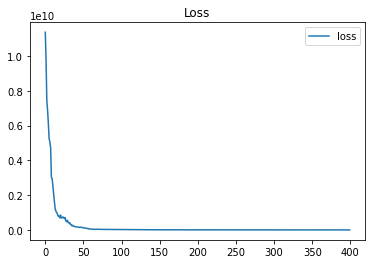

done 10 layers in 103.20ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[11576.81055648]


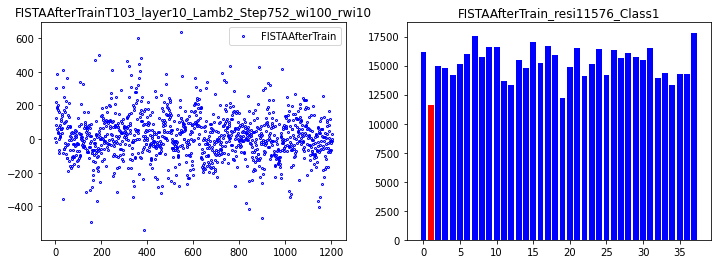

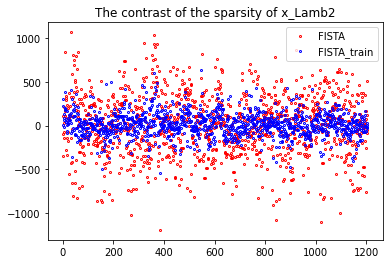

105


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 138.07ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.88200257]


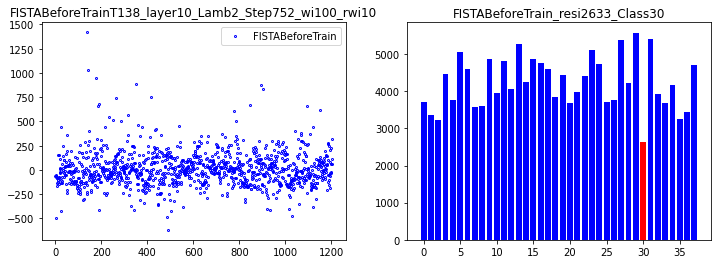

correct rate: 0.625
correct rate: 0.625
correct rate: 0.75
correct rate: 0.75
Epoch [ 10/100]: loss = 206569162.4373,   lambda [max:1.9377], [min:1.9267], 
Epoch [ 20/100]: loss = 33514914.6571,   lambda [max:1.9045], [min:1.8769], 
Epoch [ 30/100]: loss = 16695004.4936,   lambda [max:1.8782], [min:1.8366], 
Epoch [ 40/100]: loss = 12056118.4580,   lambda [max:1.8539], [min:1.8015], 
Epoch [ 50/100]: loss = 9213865.4586,   lambda [max:1.8313], [min:1.7701], 
Epoch [ 60/100]: loss = 6870958.6821,   lambda [max:1.8097], [min:1.7416], 
Epoch [ 70/100]: loss = 5823561.3873,   lambda [max:1.7892], [min:1.7151], 
Epoch [ 80/100]: loss = 5657906.0464,   lambda [max:1.7694], [min:1.6903], 
Epoch [ 90/100]: loss = 4893870.1607,   lambda [max:1.7502], [min:1.6667], 
correct rate: 0.375
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.71875
Epoch [100/100]: loss = 4271262.8624,   lambda [max:1.7316], [min:1.6444], 


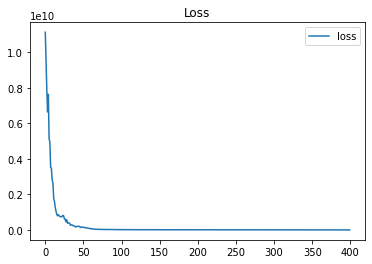

done 10 layers in 115.93ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3086.9215069]


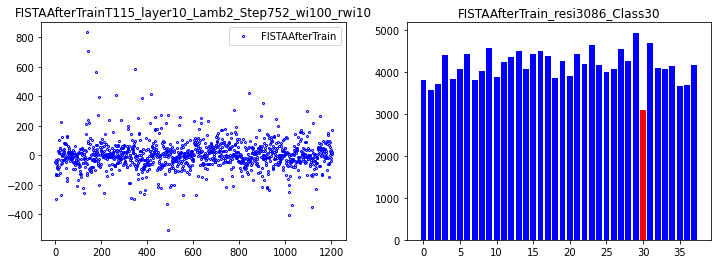

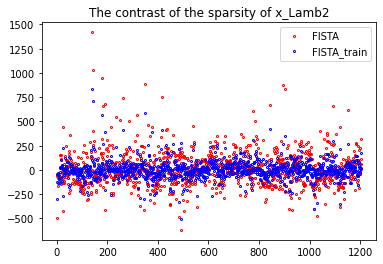

106


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 118.20ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6125.85516692]


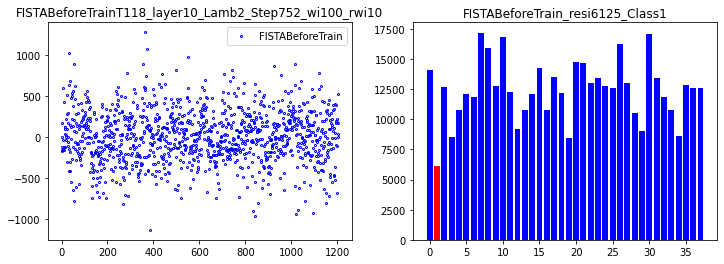

correct rate: 0.5625
correct rate: 0.6875
correct rate: 0.8125
correct rate: 0.6875
Epoch [ 10/100]: loss = 202408064.8577,   lambda [max:1.9376], [min:1.9263], 
Epoch [ 20/100]: loss = 33399447.4540,   lambda [max:1.9039], [min:1.8779], 
Epoch [ 30/100]: loss = 16512751.8407,   lambda [max:1.8770], [min:1.8376], 
Epoch [ 40/100]: loss = 12182675.9223,   lambda [max:1.8521], [min:1.8022], 
Epoch [ 50/100]: loss = 8732973.3377,   lambda [max:1.8287], [min:1.7705], 
Epoch [ 60/100]: loss = 7868910.9987,   lambda [max:1.8066], [min:1.7417], 
Epoch [ 70/100]: loss = 6559565.0327,   lambda [max:1.7855], [min:1.7151], 
Epoch [ 80/100]: loss = 5414241.6780,   lambda [max:1.7653], [min:1.6901], 
Epoch [ 90/100]: loss = 5024874.8371,   lambda [max:1.7459], [min:1.6665], 
correct rate: 0.5625
correct rate: 0.71875
correct rate: 0.5625
correct rate: 0.75
Epoch [100/100]: loss = 4399555.9879,   lambda [max:1.7270], [min:1.6440], 


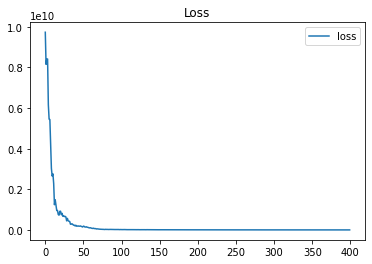

done 10 layers in 137.18ms
predict class: yaleB36
test image label: yaleB02
predict residuals label: 34
test residuals label: 1
[10396.35601277]


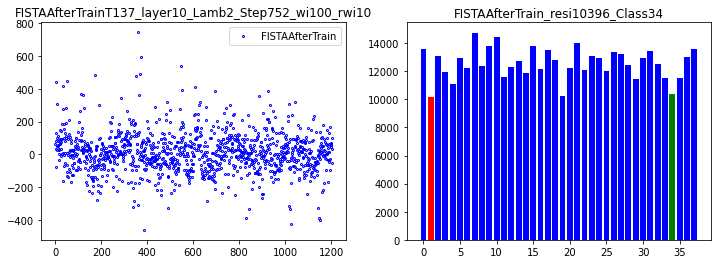

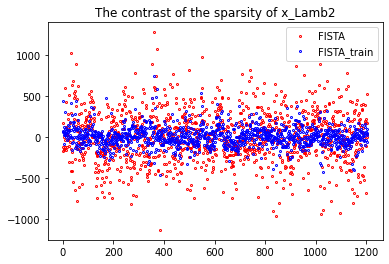

107


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 120.68ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.58414072]


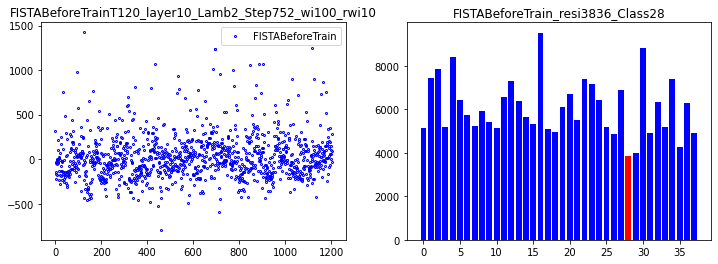

correct rate: 0.75
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.53125
Epoch [ 10/100]: loss = 211181394.0451,   lambda [max:1.9380], [min:1.9264], 
Epoch [ 20/100]: loss = 29700756.6858,   lambda [max:1.9037], [min:1.8782], 
Epoch [ 30/100]: loss = 17411451.5609,   lambda [max:1.8768], [min:1.8380], 
Epoch [ 40/100]: loss = 10901518.1964,   lambda [max:1.8520], [min:1.8029], 
Epoch [ 50/100]: loss = 8733723.3889,   lambda [max:1.8289], [min:1.7717], 
Epoch [ 60/100]: loss = 7331121.5000,   lambda [max:1.8070], [min:1.7434], 
Epoch [ 70/100]: loss = 6358678.7505,   lambda [max:1.7862], [min:1.7170], 
Epoch [ 80/100]: loss = 5314448.9057,   lambda [max:1.7661], [min:1.6923], 
Epoch [ 90/100]: loss = 5091856.3959,   lambda [max:1.7467], [min:1.6684], 
correct rate: 0.65625
correct rate: 0.5625
correct rate: 0.78125
correct rate: 0.59375
Epoch [100/100]: loss = 4428249.6808,   lambda [max:1.7280], [min:1.6456], 


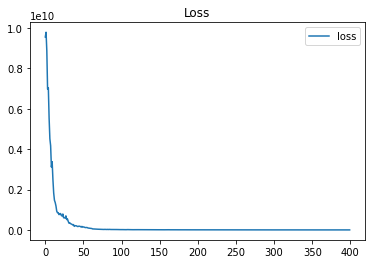

done 10 layers in 102.54ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4716.59714284]


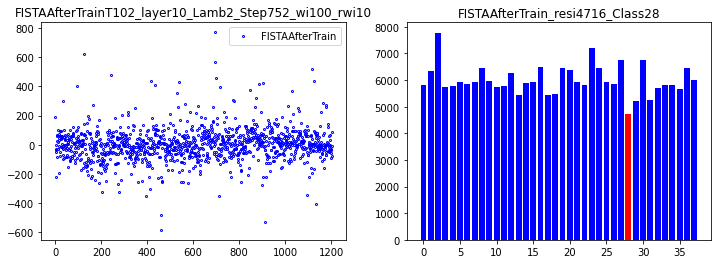

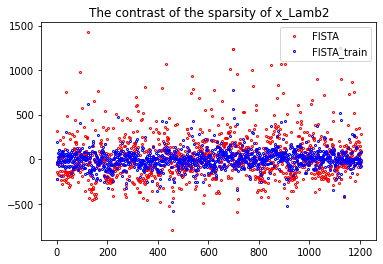

108


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 107.66ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11038.90506418]


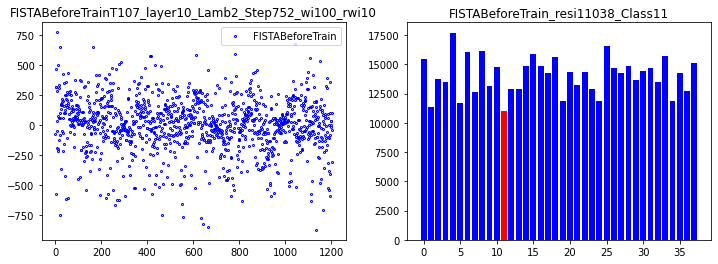

correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.6875
Epoch [ 10/100]: loss = 214745170.0482,   lambda [max:1.9372], [min:1.9260], 
Epoch [ 20/100]: loss = 30604286.5066,   lambda [max:1.9037], [min:1.8762], 
Epoch [ 30/100]: loss = 18735471.6779,   lambda [max:1.8771], [min:1.8357], 
Epoch [ 40/100]: loss = 10351234.8556,   lambda [max:1.8527], [min:1.8002], 
Epoch [ 50/100]: loss = 9198184.3067,   lambda [max:1.8298], [min:1.7685], 
Epoch [ 60/100]: loss = 6298203.8333,   lambda [max:1.8082], [min:1.7398], 
Epoch [ 70/100]: loss = 6475160.4150,   lambda [max:1.7876], [min:1.7132], 
Epoch [ 80/100]: loss = 5408618.3725,   lambda [max:1.7678], [min:1.6882], 
Epoch [ 90/100]: loss = 5036233.7164,   lambda [max:1.7487], [min:1.6646], 
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.6875
correct rate: 0.6875
Epoch [100/100]: loss = 4622104.7747,   lambda [max:1.7302], [min:1.6421], 


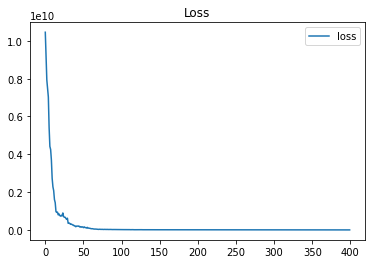

done 10 layers in 100.15ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11435.61024459]


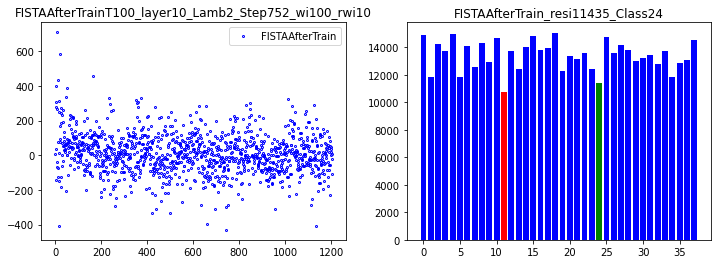

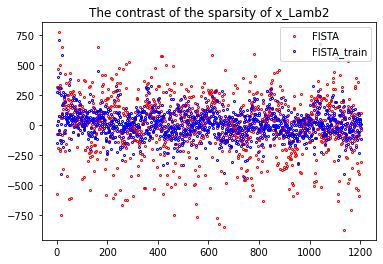

109


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 113.07ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16511.55223475]


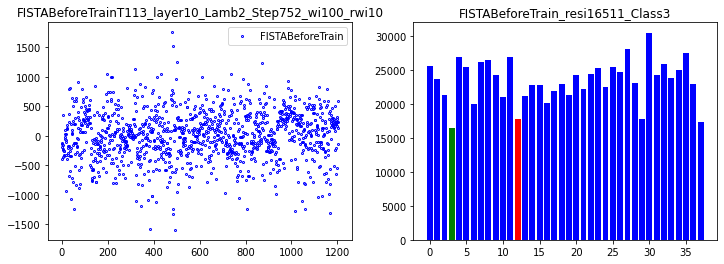

correct rate: 0.625
correct rate: 0.75
correct rate: 0.625
correct rate: 0.6875
Epoch [ 10/100]: loss = 230895102.6640,   lambda [max:1.9377], [min:1.9268], 
Epoch [ 20/100]: loss = 32434957.8696,   lambda [max:1.9038], [min:1.8779], 
Epoch [ 30/100]: loss = 17230912.2364,   lambda [max:1.8770], [min:1.8380], 
Epoch [ 40/100]: loss = 10868543.0725,   lambda [max:1.8521], [min:1.8029], 
Epoch [ 50/100]: loss = 9122226.5024,   lambda [max:1.8288], [min:1.7716], 
Epoch [ 60/100]: loss = 7338341.7891,   lambda [max:1.8067], [min:1.7431], 
Epoch [ 70/100]: loss = 6472597.9455,   lambda [max:1.7857], [min:1.7167], 
Epoch [ 80/100]: loss = 5472093.4091,   lambda [max:1.7656], [min:1.6918], 
Epoch [ 90/100]: loss = 4788866.5310,   lambda [max:1.7462], [min:1.6681], 
correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.5
correct rate: 0.75
Epoch [100/100]: loss = 4325206.1840,   lambda [max:1.7274], [min:1.6454], 


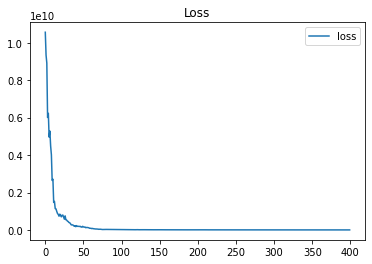

done 10 layers in 110.26ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21802.45562481]


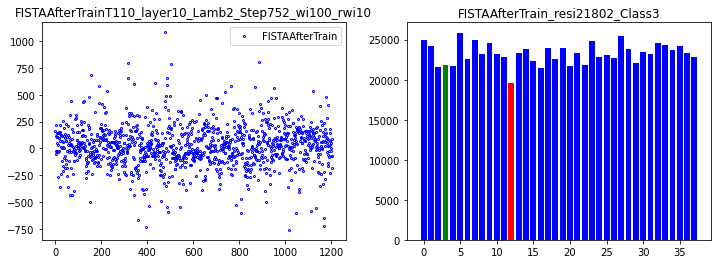

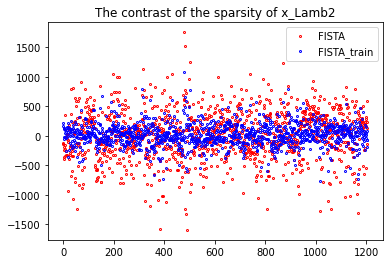

110


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 98.13ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6134.51951648]


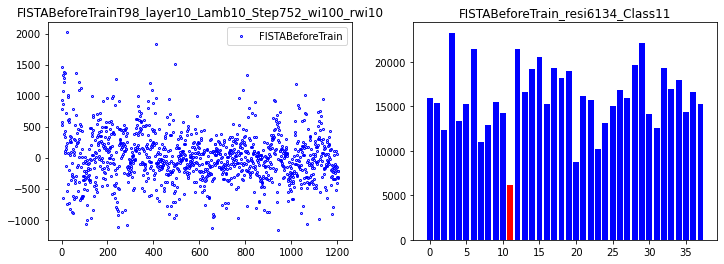

correct rate: 0.75
correct rate: 0.65625
correct rate: 0.625
correct rate: 0.6875
Epoch [ 10/100]: loss = 232335711.6952,   lambda [max:9.9375], [min:9.9260], 
Epoch [ 20/100]: loss = 34170681.6202,   lambda [max:9.9040], [min:9.8785], 
Epoch [ 30/100]: loss = 21978302.1434,   lambda [max:9.8772], [min:9.8384], 
Epoch [ 40/100]: loss = 16071615.8827,   lambda [max:9.8525], [min:9.8033], 
Epoch [ 50/100]: loss = 14687102.6243,   lambda [max:9.8295], [min:9.7720], 
Epoch [ 60/100]: loss = 12734657.7338,   lambda [max:9.8079], [min:9.7437], 
Epoch [ 70/100]: loss = 11590104.4400,   lambda [max:9.7871], [min:9.7176], 
Epoch [ 80/100]: loss = 11335031.1668,   lambda [max:9.7673], [min:9.6932], 
Epoch [ 90/100]: loss = 10569334.2473,   lambda [max:9.7482], [min:9.6701], 
correct rate: 0.46875
correct rate: 0.78125
correct rate: 0.59375
correct rate: 0.6875
Epoch [100/100]: loss = 9671413.4674,   lambda [max:9.7297], [min:9.6483], 


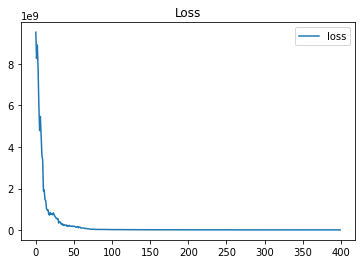

done 10 layers in 99.63ms
predict class: yaleB08
test image label: yaleB12
predict residuals label: 7
test residuals label: 11
[14156.74836788]


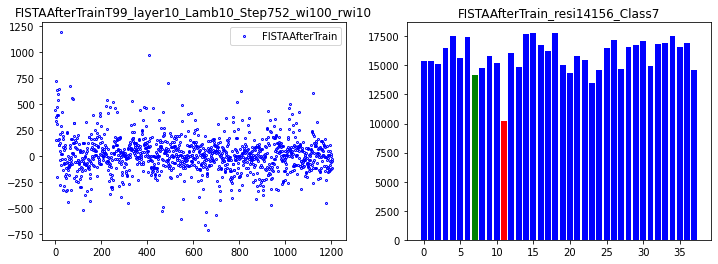

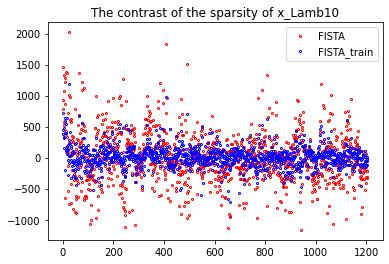

111


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 114.31ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6906.60745131]


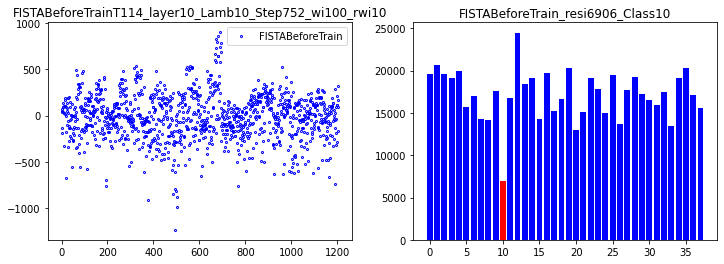

correct rate: 0.71875
correct rate: 0.53125
correct rate: 0.78125
correct rate: 0.71875
Epoch [ 10/100]: loss = 237970191.8697,   lambda [max:9.9380], [min:9.9267], 
Epoch [ 20/100]: loss = 32360359.1192,   lambda [max:9.9043], [min:9.8779], 
Epoch [ 30/100]: loss = 22461953.5498,   lambda [max:9.8778], [min:9.8382], 
Epoch [ 40/100]: loss = 17689794.2574,   lambda [max:9.8534], [min:9.8034], 
Epoch [ 50/100]: loss = 14284562.4086,   lambda [max:9.8307], [min:9.7725], 
Epoch [ 60/100]: loss = 12670282.1165,   lambda [max:9.8092], [min:9.7444], 
Epoch [ 70/100]: loss = 12094144.5084,   lambda [max:9.7888], [min:9.7184], 
Epoch [ 80/100]: loss = 10568031.3612,   lambda [max:9.7692], [min:9.6940], 
Epoch [ 90/100]: loss = 10328849.3008,   lambda [max:9.7503], [min:9.6711], 
correct rate: 0.75
correct rate: 0.625
correct rate: 0.5625
correct rate: 0.625
Epoch [100/100]: loss = 10091136.9954,   lambda [max:9.7320], [min:9.6493], 


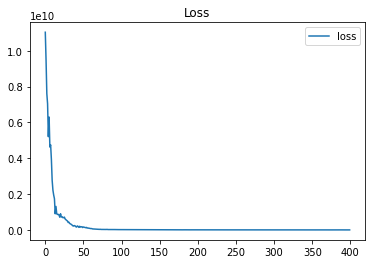

done 10 layers in 113.42ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[11077.49407305]


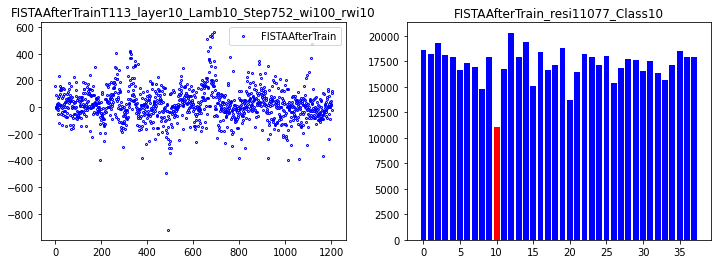

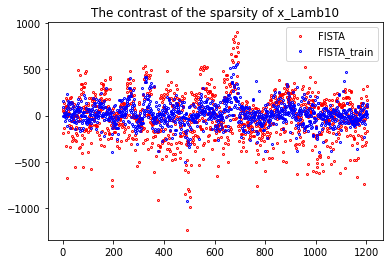

112


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 117.85ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.29430182]


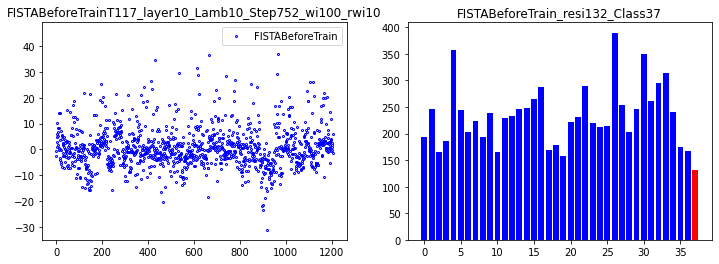

correct rate: 0.75
correct rate: 0.625
correct rate: 0.625
correct rate: 0.75
Epoch [ 10/100]: loss = 205512986.6612,   lambda [max:9.9376], [min:9.9260], 
Epoch [ 20/100]: loss = 36673276.4100,   lambda [max:9.9041], [min:9.8778], 
Epoch [ 30/100]: loss = 22433426.5818,   lambda [max:9.8780], [min:9.8381], 
Epoch [ 40/100]: loss = 17094943.0495,   lambda [max:9.8540], [min:9.8035], 
Epoch [ 50/100]: loss = 15046496.3116,   lambda [max:9.8316], [min:9.7727], 
Epoch [ 60/100]: loss = 13918490.2675,   lambda [max:9.8104], [min:9.7446], 
Epoch [ 70/100]: loss = 12186906.9978,   lambda [max:9.7902], [min:9.7187], 
Epoch [ 80/100]: loss = 11397380.6211,   lambda [max:9.7708], [min:9.6944], 
Epoch [ 90/100]: loss = 10685565.2479,   lambda [max:9.7521], [min:9.6714], 
correct rate: 0.65625
correct rate: 0.75
correct rate: 0.71875
correct rate: 0.53125
Epoch [100/100]: loss = 10456288.6289,   lambda [max:9.7341], [min:9.6496], 


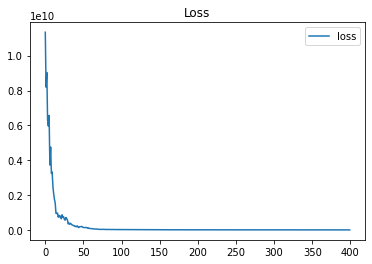

done 10 layers in 102.59ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[173.54751049]


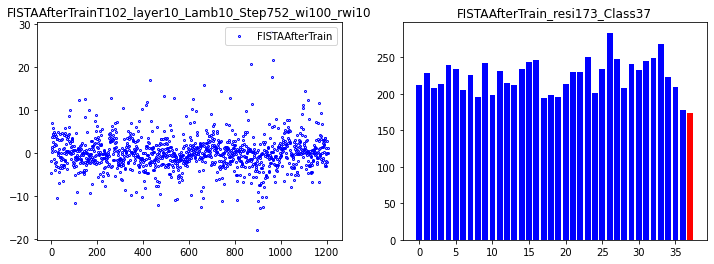

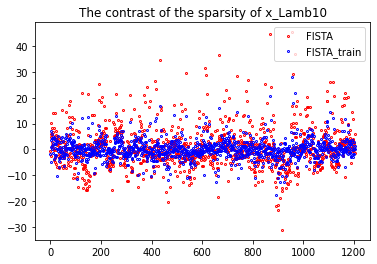

113


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 119.10ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4727.03378325]


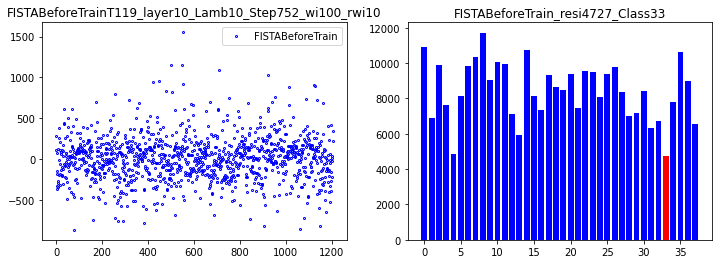

correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.5625
Epoch [ 10/100]: loss = 229342714.9297,   lambda [max:9.9375], [min:9.9255], 
Epoch [ 20/100]: loss = 36859685.4099,   lambda [max:9.9042], [min:9.8780], 
Epoch [ 30/100]: loss = 20685764.0020,   lambda [max:9.8779], [min:9.8386], 
Epoch [ 40/100]: loss = 17044344.0186,   lambda [max:9.8537], [min:9.8041], 
Epoch [ 50/100]: loss = 15122679.5585,   lambda [max:9.8311], [min:9.7735], 
Epoch [ 60/100]: loss = 12413561.2389,   lambda [max:9.8097], [min:9.7457], 
Epoch [ 70/100]: loss = 11943783.5154,   lambda [max:9.7894], [min:9.7200], 
Epoch [ 80/100]: loss = 11433106.9736,   lambda [max:9.7697], [min:9.6959], 
Epoch [ 90/100]: loss = 10827896.2760,   lambda [max:9.7508], [min:9.6731], 
correct rate: 0.53125
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.65625
Epoch [100/100]: loss = 10592432.9847,   lambda [max:9.7326], [min:9.6516], 


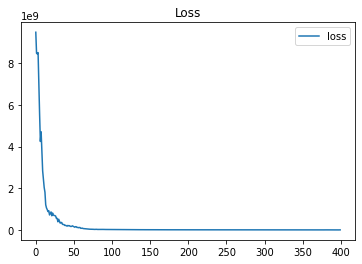

done 10 layers in 97.11ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[6882.0795503]


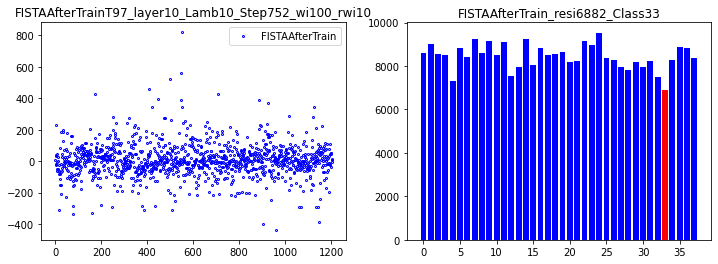

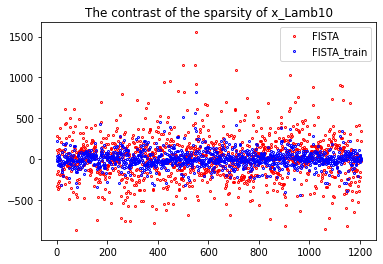

114


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.79ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5985.48640629]


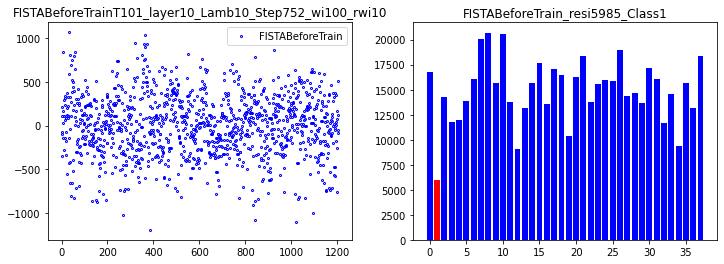

correct rate: 0.71875
correct rate: 0.59375
correct rate: 0.78125
correct rate: 0.65625
Epoch [ 10/100]: loss = 212346460.1697,   lambda [max:9.9376], [min:9.9264], 
Epoch [ 20/100]: loss = 40909998.2318,   lambda [max:9.9035], [min:9.8773], 
Epoch [ 30/100]: loss = 20149789.5211,   lambda [max:9.8769], [min:9.8376], 
Epoch [ 40/100]: loss = 17288387.3073,   lambda [max:9.8525], [min:9.8027], 
Epoch [ 50/100]: loss = 14996143.5880,   lambda [max:9.8298], [min:9.7716], 
Epoch [ 60/100]: loss = 12573742.5497,   lambda [max:9.8085], [min:9.7433], 
Epoch [ 70/100]: loss = 12066617.3259,   lambda [max:9.7881], [min:9.7170], 
Epoch [ 80/100]: loss = 11312561.9609,   lambda [max:9.7686], [min:9.6925], 
Epoch [ 90/100]: loss = 10580911.9175,   lambda [max:9.7497], [min:9.6693], 
correct rate: 0.75
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.65625
Epoch [100/100]: loss = 9991281.8345,   lambda [max:9.7314], [min:9.6473], 


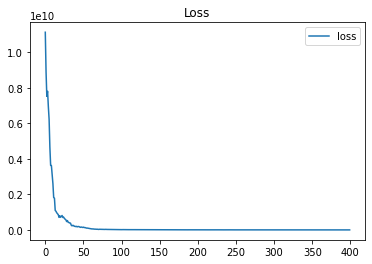

done 10 layers in 99.30ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[11541.8943155]


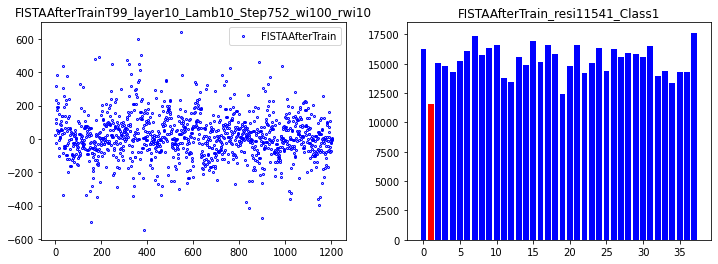

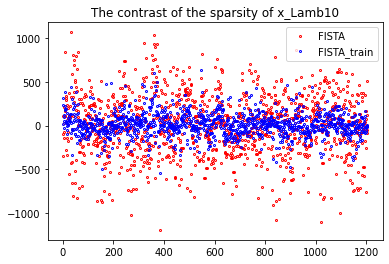

115


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 117.05ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.75313704]


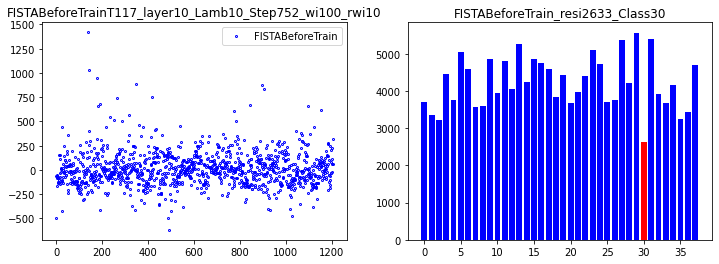

correct rate: 0.6875
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.625
Epoch [ 10/100]: loss = 213787719.2698,   lambda [max:9.9375], [min:9.9269], 
Epoch [ 20/100]: loss = 35229707.0632,   lambda [max:9.9045], [min:9.8759], 
Epoch [ 30/100]: loss = 20695570.8972,   lambda [max:9.8780], [min:9.8346], 
Epoch [ 40/100]: loss = 16677079.2137,   lambda [max:9.8538], [min:9.7987], 
Epoch [ 50/100]: loss = 13915713.3487,   lambda [max:9.8312], [min:9.7669], 
Epoch [ 60/100]: loss = 12949322.2432,   lambda [max:9.8098], [min:9.7380], 
Epoch [ 70/100]: loss = 12105894.4247,   lambda [max:9.7894], [min:9.7113], 
Epoch [ 80/100]: loss = 10810190.8339,   lambda [max:9.7699], [min:9.6865], 
Epoch [ 90/100]: loss = 10080241.3703,   lambda [max:9.7509], [min:9.6630], 
correct rate: 0.59375
correct rate: 0.5625
correct rate: 0.65625
correct rate: 0.78125
Epoch [100/100]: loss = 10169845.4446,   lambda [max:9.7326], [min:9.6407], 


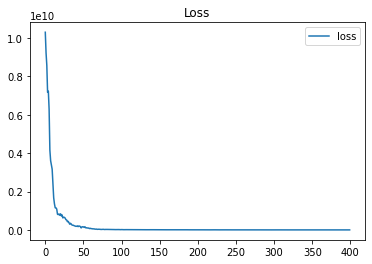

done 10 layers in 119.95ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3087.08385435]


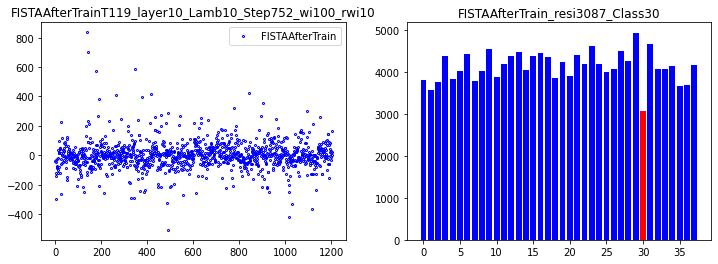

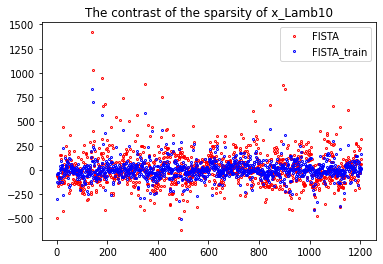

116


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.27ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6127.86149992]


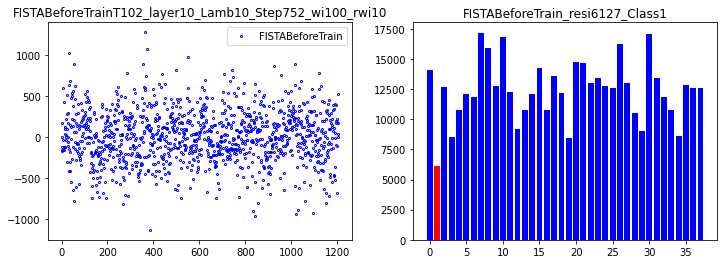

correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.6875
correct rate: 0.75
Epoch [ 10/100]: loss = 207405879.7713,   lambda [max:9.9374], [min:9.9260], 
Epoch [ 20/100]: loss = 36124833.5091,   lambda [max:9.9037], [min:9.8774], 
Epoch [ 30/100]: loss = 23009757.1009,   lambda [max:9.8772], [min:9.8375], 
Epoch [ 40/100]: loss = 18259152.6921,   lambda [max:9.8529], [min:9.8028], 
Epoch [ 50/100]: loss = 14091518.8710,   lambda [max:9.8301], [min:9.7719], 
Epoch [ 60/100]: loss = 13261345.6000,   lambda [max:9.8088], [min:9.7438], 
Epoch [ 70/100]: loss = 12199319.8900,   lambda [max:9.7883], [min:9.7177], 
Epoch [ 80/100]: loss = 10889081.7711,   lambda [max:9.7686], [min:9.6934], 
Epoch [ 90/100]: loss = 10334964.6379,   lambda [max:9.7496], [min:9.6703], 
correct rate: 0.65625
correct rate: 0.53125
correct rate: 0.5
correct rate: 0.875
Epoch [100/100]: loss = 9497565.8038,   lambda [max:9.7312], [min:9.6484], 


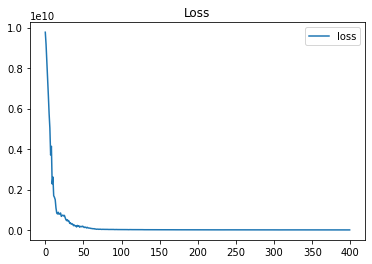

done 10 layers in 103.01ms
predict class: yaleB36
test image label: yaleB02
predict residuals label: 34
test residuals label: 1
[10475.58613061]


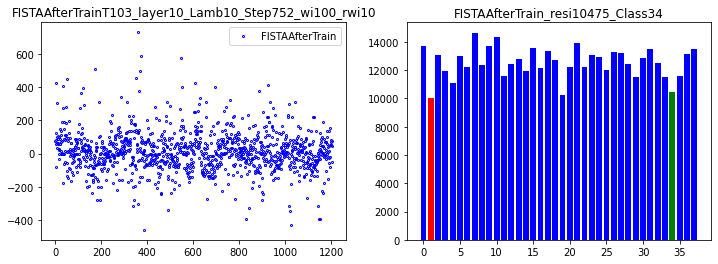

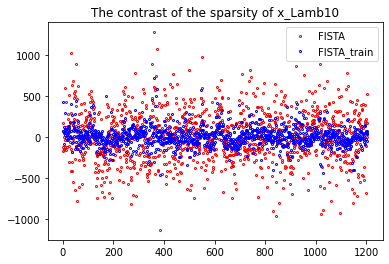

117


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 101.08ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[3836.77151891]


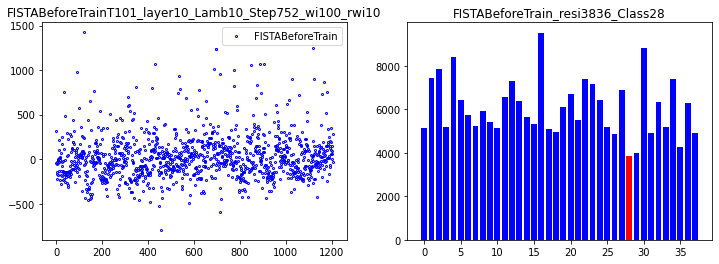

correct rate: 0.78125
correct rate: 0.5625
correct rate: 0.75
correct rate: 0.65625
Epoch [ 10/100]: loss = 202037589.4334,   lambda [max:9.9373], [min:9.9262], 
Epoch [ 20/100]: loss = 35572192.5757,   lambda [max:9.9042], [min:9.8768], 
Epoch [ 30/100]: loss = 22242959.9747,   lambda [max:9.8782], [min:9.8369], 
Epoch [ 40/100]: loss = 16663446.7135,   lambda [max:9.8544], [min:9.8023], 
Epoch [ 50/100]: loss = 14196572.5811,   lambda [max:9.8321], [min:9.7716], 
Epoch [ 60/100]: loss = 13255915.3151,   lambda [max:9.8110], [min:9.7436], 
Epoch [ 70/100]: loss = 12281607.6449,   lambda [max:9.7908], [min:9.7177], 
Epoch [ 80/100]: loss = 10974486.0386,   lambda [max:9.7715], [min:9.6924], 
Epoch [ 90/100]: loss = 11254377.5929,   lambda [max:9.7529], [min:9.6685], 
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.5
Epoch [100/100]: loss = 10226519.6030,   lambda [max:9.7348], [min:9.6457], 


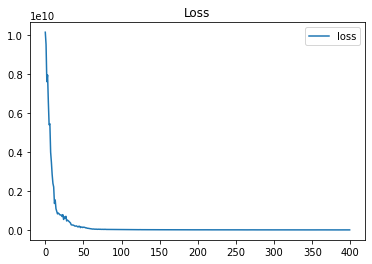

done 10 layers in 112.36ms
predict class: yaleB30
test image label: yaleB30
predict residuals label: 28
test residuals label: 28
[4720.7007237]


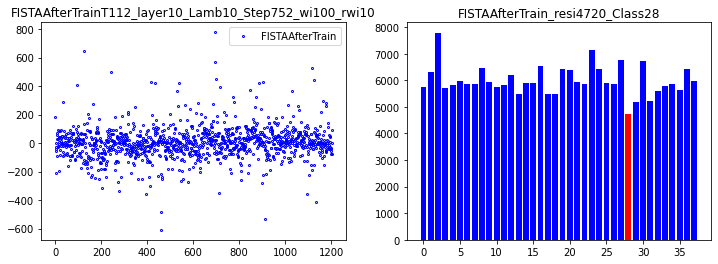

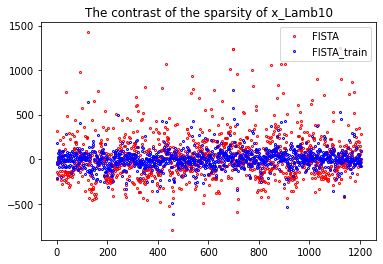

118


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 130.17ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[11039.5768946]


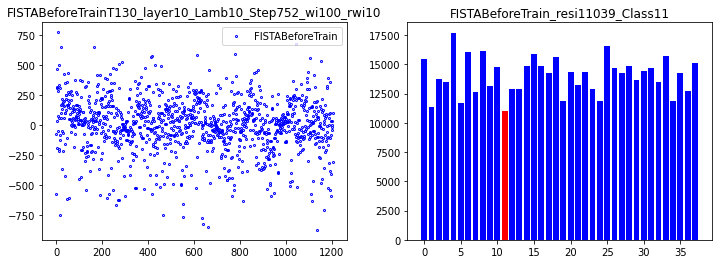

correct rate: 0.625
correct rate: 0.71875
correct rate: 0.65625
correct rate: 0.6875
Epoch [ 10/100]: loss = 236103850.5220,   lambda [max:9.9381], [min:9.9254], 
Epoch [ 20/100]: loss = 34971676.9352,   lambda [max:9.9043], [min:9.8780], 
Epoch [ 30/100]: loss = 22076343.9866,   lambda [max:9.8780], [min:9.8377], 
Epoch [ 40/100]: loss = 16655805.3027,   lambda [max:9.8538], [min:9.8025], 
Epoch [ 50/100]: loss = 15099791.2659,   lambda [max:9.8313], [min:9.7713], 
Epoch [ 60/100]: loss = 13298302.8177,   lambda [max:9.8100], [min:9.7430], 
Epoch [ 70/100]: loss = 12279137.2924,   lambda [max:9.7897], [min:9.7168], 
Epoch [ 80/100]: loss = 11475516.3567,   lambda [max:9.7701], [min:9.6924], 
Epoch [ 90/100]: loss = 10651500.6369,   lambda [max:9.7512], [min:9.6693], 
correct rate: 0.6875
correct rate: 0.59375
correct rate: 0.71875
correct rate: 0.59375
Epoch [100/100]: loss = 10106642.8876,   lambda [max:9.7330], [min:9.6473], 


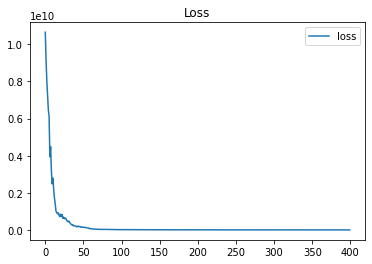

done 10 layers in 103.17ms
predict class: yaleB26
test image label: yaleB12
predict residuals label: 24
test residuals label: 11
[11407.65088927]


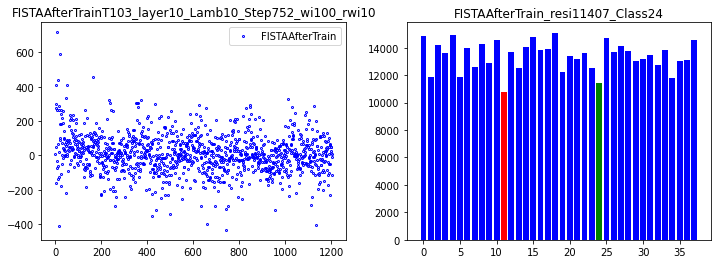

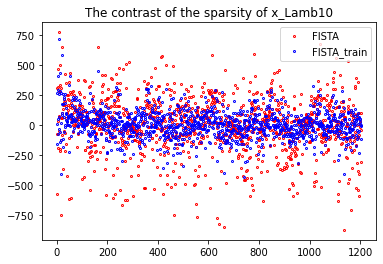

119


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 109.24ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[16513.30609801]


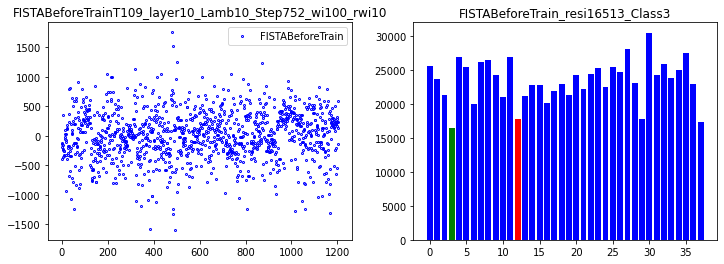

correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.75
correct rate: 0.65625
Epoch [ 10/100]: loss = 252777154.2829,   lambda [max:9.9370], [min:9.9262], 
Epoch [ 20/100]: loss = 35786797.3001,   lambda [max:9.9029], [min:9.8780], 
Epoch [ 30/100]: loss = 23911296.4428,   lambda [max:9.8757], [min:9.8383], 
Epoch [ 40/100]: loss = 16885560.7437,   lambda [max:9.8507], [min:9.8037], 
Epoch [ 50/100]: loss = 14867616.0404,   lambda [max:9.8275], [min:9.7728], 
Epoch [ 60/100]: loss = 12766496.7384,   lambda [max:9.8056], [min:9.7447], 
Epoch [ 70/100]: loss = 12295430.5132,   lambda [max:9.7847], [min:9.7188], 
Epoch [ 80/100]: loss = 10821185.0609,   lambda [max:9.7648], [min:9.6944], 
Epoch [ 90/100]: loss = 10554146.2931,   lambda [max:9.7456], [min:9.6715], 
correct rate: 0.78125
correct rate: 0.6875
correct rate: 0.5
correct rate: 0.65625
Epoch [100/100]: loss = 10727225.1447,   lambda [max:9.7270], [min:9.6498], 


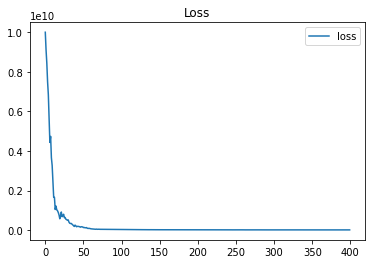

done 10 layers in 97.91ms
predict class: yaleB04
test image label: yaleB13
predict residuals label: 3
test residuals label: 12
[21943.11427237]


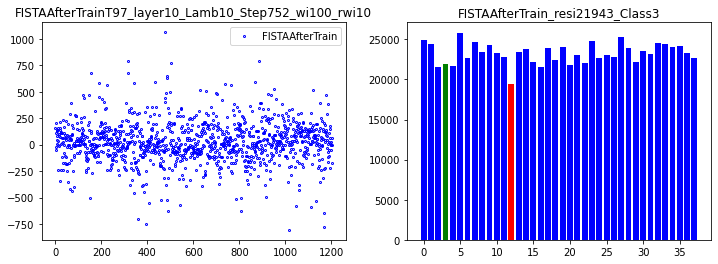

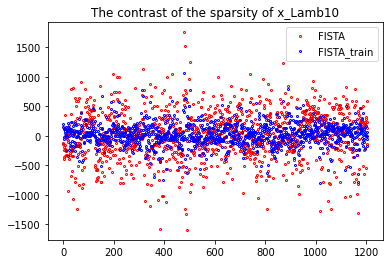

120


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 106.27ms
predict class: yaleB12
test image label: yaleB12
predict residuals label: 11
test residuals label: 11
[6135.43966325]


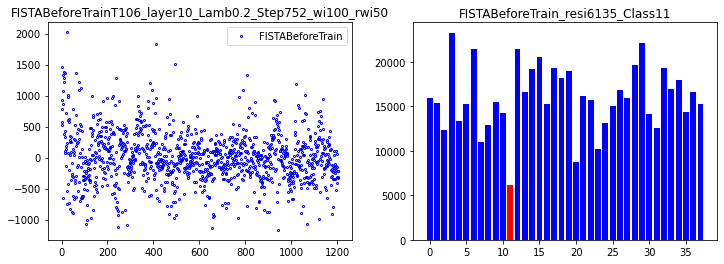

correct rate: 0.53125
correct rate: 0.78125
correct rate: 0.65625
correct rate: 0.71875
Epoch [ 10/100]: loss = 195032023.2020,   lambda [max:0.1379], [min:0.1258], 
Epoch [ 20/100]: loss = 31465316.9850,   lambda [max:0.1039], [min:0.0772], 
Epoch [ 30/100]: loss = 18750108.6796,   lambda [max:0.0768], [min:0.0365], 
Epoch [ 40/100]: loss = 12052070.9275,   lambda [max:0.0518], [min:0.0010], 
Epoch [ 50/100]: loss = 10032604.2987,   lambda [max:0.0283], [min:-0.0306], 
Epoch [ 60/100]: loss = 9011894.7669,   lambda [max:0.0060], [min:-0.0593], 
Epoch [ 70/100]: loss = 6963578.4897,   lambda [max:-0.0153], [min:-0.0858], 
Epoch [ 80/100]: loss = 6374313.3006,   lambda [max:-0.0357], [min:-0.1106], 
Epoch [ 90/100]: loss = 5842581.2306,   lambda [max:-0.0555], [min:-0.1340], 
correct rate: 0.78125
correct rate: 0.625
correct rate: 0.59375
correct rate: 0.78125
Epoch [100/100]: loss = 5575811.6204,   lambda [max:-0.0746], [min:-0.1564], 


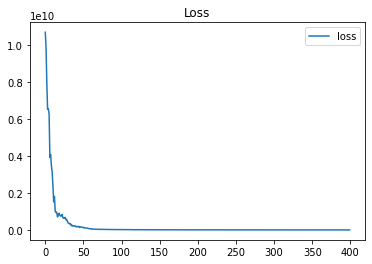

done 10 layers in 108.56ms
predict class: yaleB25
test image label: yaleB12
predict residuals label: 23
test residuals label: 11
[13078.35287524]


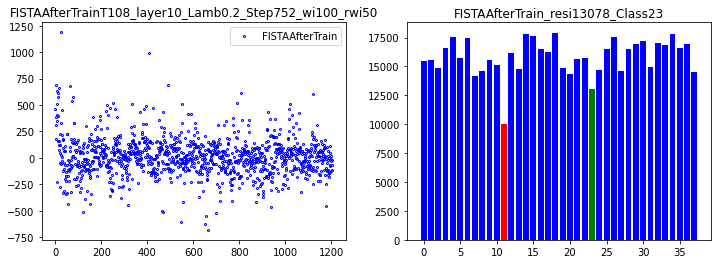

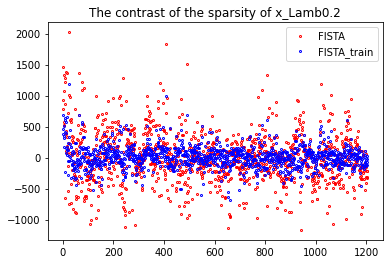

121


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 94.25ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[6904.23254266]


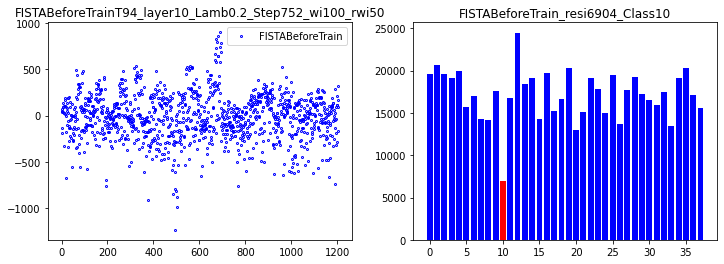

correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.75
correct rate: 0.65625
Epoch [ 10/100]: loss = 235558282.2791,   lambda [max:0.1377], [min:0.1260], 
Epoch [ 20/100]: loss = 31820411.5999,   lambda [max:0.1028], [min:0.0779], 
Epoch [ 30/100]: loss = 15850933.5313,   lambda [max:0.0753], [min:0.0381], 
Epoch [ 40/100]: loss = 11357603.1269,   lambda [max:0.0501], [min:0.0030], 
Epoch [ 50/100]: loss = 9903171.5610,   lambda [max:0.0266], [min:-0.0283], 
Epoch [ 60/100]: loss = 8911182.1410,   lambda [max:0.0042], [min:-0.0567], 
Epoch [ 70/100]: loss = 6983147.1911,   lambda [max:-0.0171], [min:-0.0831], 
Epoch [ 80/100]: loss = 6287942.0980,   lambda [max:-0.0376], [min:-0.1078], 
Epoch [ 90/100]: loss = 6425068.9342,   lambda [max:-0.0573], [min:-0.1312], 
correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.78125
correct rate: 0.625
Epoch [100/100]: loss = 5667587.3893,   lambda [max:-0.0765], [min:-0.1535], 


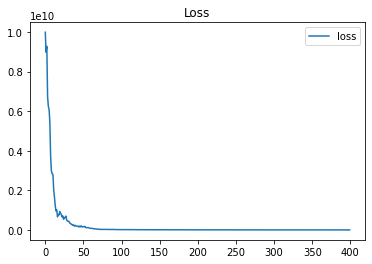

done 10 layers in 99.91ms
predict class: yaleB11
test image label: yaleB11
predict residuals label: 10
test residuals label: 10
[10754.18806623]


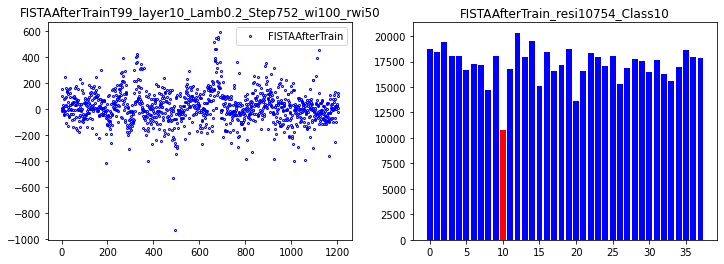

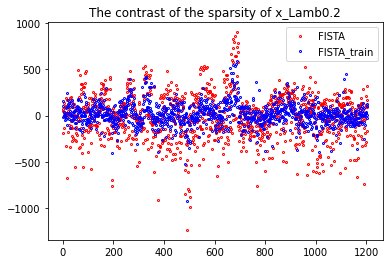

122


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 124.10ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[132.11572183]


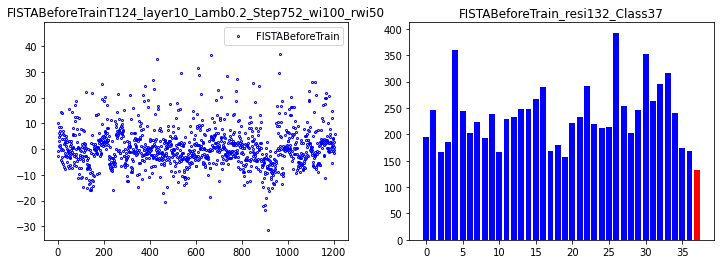

correct rate: 0.75
correct rate: 0.625
correct rate: 0.65625
correct rate: 0.75
Epoch [ 10/100]: loss = 213126695.8389,   lambda [max:0.1372], [min:0.1265], 
Epoch [ 20/100]: loss = 28234486.0816,   lambda [max:0.1033], [min:0.0784], 
Epoch [ 30/100]: loss = 17089125.2333,   lambda [max:0.0764], [min:0.0380], 
Epoch [ 40/100]: loss = 12544568.6441,   lambda [max:0.0516], [min:0.0022], 
Epoch [ 50/100]: loss = 9836463.8696,   lambda [max:0.0284], [min:-0.0296], 
Epoch [ 60/100]: loss = 8610686.5937,   lambda [max:0.0065], [min:-0.0586], 
Epoch [ 70/100]: loss = 7033366.6590,   lambda [max:-0.0146], [min:-0.0853], 
Epoch [ 80/100]: loss = 6874593.9047,   lambda [max:-0.0349], [min:-0.1104], 
Epoch [ 90/100]: loss = 6180724.7528,   lambda [max:-0.0546], [min:-0.1341], 
correct rate: 0.6875
correct rate: 0.65625
correct rate: 0.84375
correct rate: 0.65625
Epoch [100/100]: loss = 5753634.3626,   lambda [max:-0.0736], [min:-0.1566], 


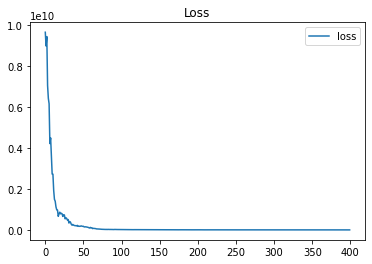

done 10 layers in 116.16ms
predict class: yaleB39
test image label: yaleB39
predict residuals label: 37
test residuals label: 37
[170.96733276]


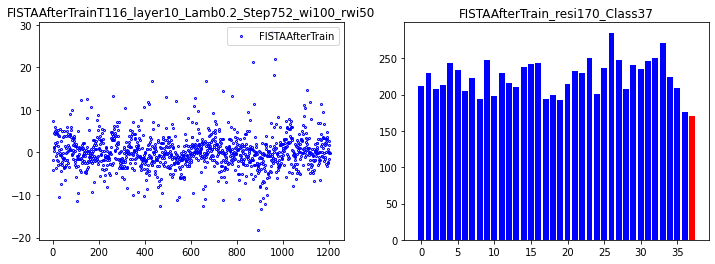

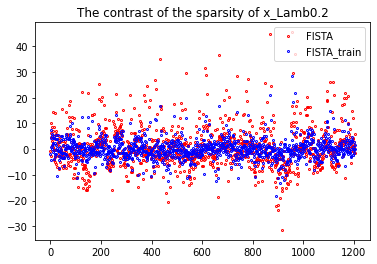

123


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 92.54ms
predict class: yaleB35
test image label: yaleB35
predict residuals label: 33
test residuals label: 33
[4726.46574361]


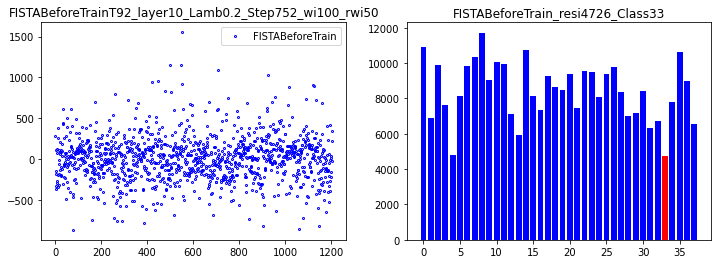

correct rate: 0.71875
correct rate: 0.71875
correct rate: 0.6875
correct rate: 0.5625
Epoch [ 10/100]: loss = 249432766.4824,   lambda [max:0.1374], [min:0.1254], 
Epoch [ 20/100]: loss = 28205463.5784,   lambda [max:0.1038], [min:0.0768], 
Epoch [ 30/100]: loss = 18109331.7937,   lambda [max:0.0768], [min:0.0358], 
Epoch [ 40/100]: loss = 12349017.0876,   lambda [max:0.0518], [min:-0.0001], 
Epoch [ 50/100]: loss = 9926172.8815,   lambda [max:0.0284], [min:-0.0320], 
Epoch [ 60/100]: loss = 8483411.3409,   lambda [max:0.0062], [min:-0.0611], 
Epoch [ 70/100]: loss = 7476643.1820,   lambda [max:-0.0151], [min:-0.0879], 
Epoch [ 80/100]: loss = 6786912.3397,   lambda [max:-0.0356], [min:-0.1130], 
Epoch [ 90/100]: loss = 5749367.0088,   lambda [max:-0.0554], [min:-0.1367], 
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.625
correct rate: 0.75
Epoch [100/100]: loss = 5668028.8470,   lambda [max:-0.0746], [min:-0.1593], 


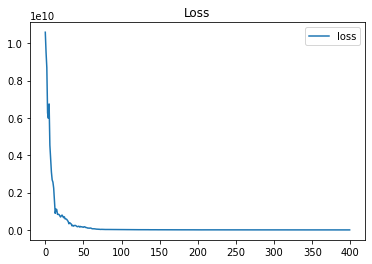

done 10 layers in 103.56ms
predict class: yaleB13
test image label: yaleB35
predict residuals label: 12
test residuals label: 33
[7471.60835411]


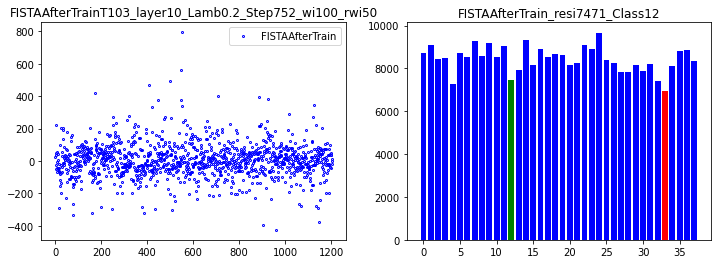

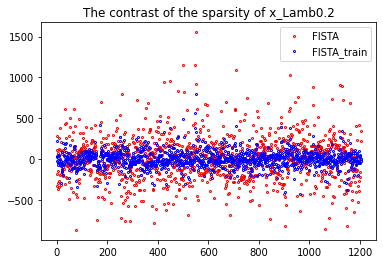

124


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 106.10ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[5982.98608124]


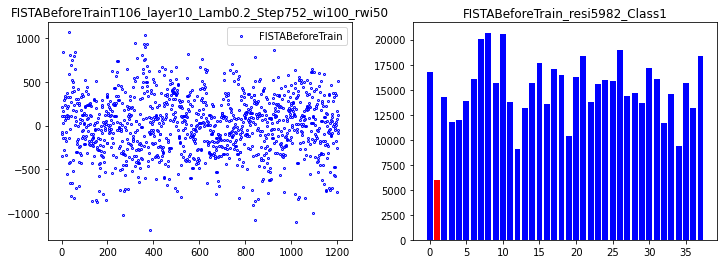

correct rate: 0.59375
correct rate: 0.65625
correct rate: 0.71875
correct rate: 0.78125
Epoch [ 10/100]: loss = 192550554.6286,   lambda [max:0.1373], [min:0.1268], 
Epoch [ 20/100]: loss = 29217192.0677,   lambda [max:0.1037], [min:0.0768], 
Epoch [ 30/100]: loss = 16815900.1453,   lambda [max:0.0768], [min:0.0359], 
Epoch [ 40/100]: loss = 11903607.6920,   lambda [max:0.0521], [min:0.0003], 
Epoch [ 50/100]: loss = 9565403.4278,   lambda [max:0.0290], [min:-0.0311], 
Epoch [ 60/100]: loss = 8898089.8117,   lambda [max:0.0070], [min:-0.0597], 
Epoch [ 70/100]: loss = 6941413.6417,   lambda [max:-0.0141], [min:-0.0862], 
Epoch [ 80/100]: loss = 6518167.8219,   lambda [max:-0.0343], [min:-0.1109], 
Epoch [ 90/100]: loss = 5695587.6840,   lambda [max:-0.0540], [min:-0.1344], 
correct rate: 0.625
correct rate: 0.75
correct rate: 0.59375
correct rate: 0.78125
Epoch [100/100]: loss = 5230403.3293,   lambda [max:-0.0730], [min:-0.1567], 


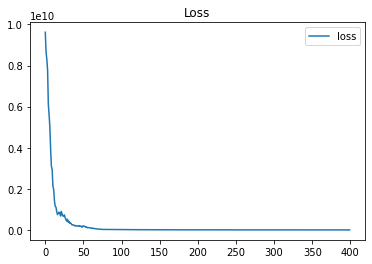

done 10 layers in 101.03ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[11043.32789948]


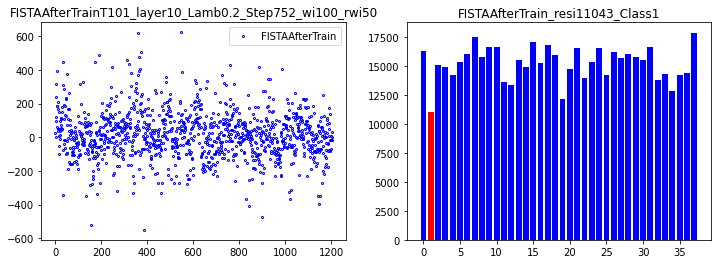

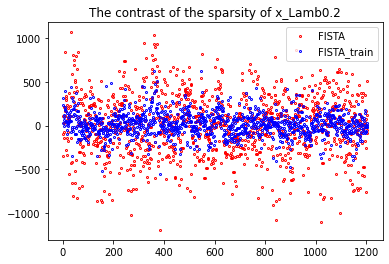

125


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 117.69ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[2633.91111018]


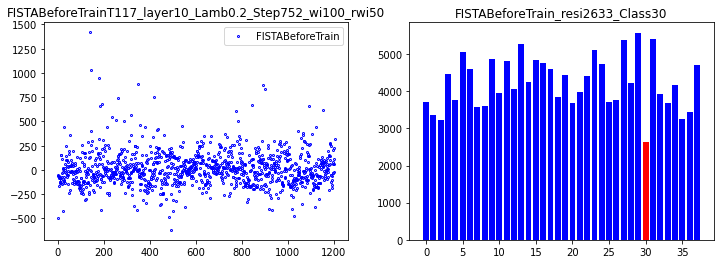

correct rate: 0.625
correct rate: 0.8125
correct rate: 0.625
correct rate: 0.71875
Epoch [ 10/100]: loss = 221814564.5908,   lambda [max:0.1371], [min:0.1259], 
Epoch [ 20/100]: loss = 30504144.2143,   lambda [max:0.1037], [min:0.0772], 
Epoch [ 30/100]: loss = 16334089.5474,   lambda [max:0.0768], [min:0.0368], 
Epoch [ 40/100]: loss = 12644868.6197,   lambda [max:0.0519], [min:0.0014], 
Epoch [ 50/100]: loss = 10190712.6103,   lambda [max:0.0287], [min:-0.0300], 
Epoch [ 60/100]: loss = 8439866.0042,   lambda [max:0.0066], [min:-0.0585], 
Epoch [ 70/100]: loss = 7794768.8289,   lambda [max:-0.0145], [min:-0.0847], 
Epoch [ 80/100]: loss = 6470524.4968,   lambda [max:-0.0349], [min:-0.1093], 
Epoch [ 90/100]: loss = 5969889.3628,   lambda [max:-0.0546], [min:-0.1326], 
correct rate: 0.6875
correct rate: 0.75
correct rate: 0.71875
correct rate: 0.625
Epoch [100/100]: loss = 5840313.7361,   lambda [max:-0.0738], [min:-0.1548], 


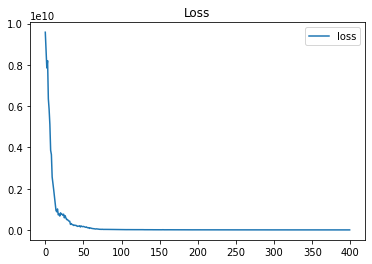

done 10 layers in 100.37ms
predict class: yaleB32
test image label: yaleB32
predict residuals label: 30
test residuals label: 30
[3087.98128902]


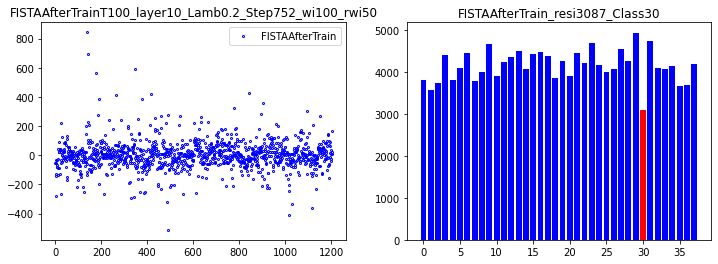

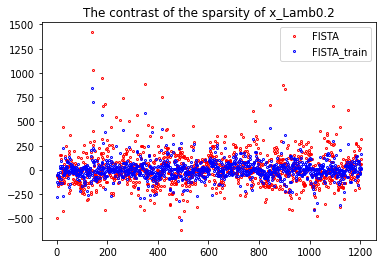

126


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:17: ComplexWarning: Casting complex values to real discards the imaginary part


done 10 layers in 102.60ms
predict class: yaleB02
test image label: yaleB02
predict residuals label: 1
test residuals label: 1
[6125.4037645]


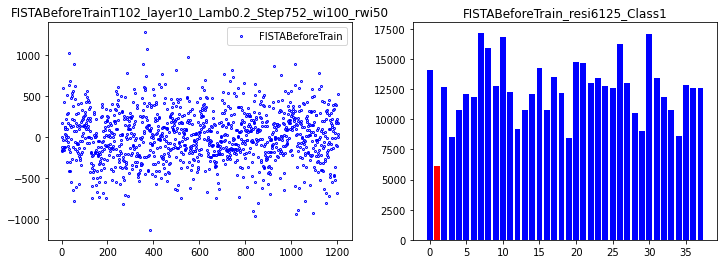

correct rate: 0.625
correct rate: 0.65625
correct rate: 0.75
correct rate: 0.71875
Epoch [ 10/100]: loss = 192111118.4285,   lambda [max:0.1374], [min:0.1261], 
Epoch [ 20/100]: loss = 34288195.5834,   lambda [max:0.1040], [min:0.0768], 
Epoch [ 30/100]: loss = 19038736.4358,   lambda [max:0.0771], [min:0.0362], 
Epoch [ 40/100]: loss = 12940279.0216,   lambda [max:0.0523], [min:0.0008], 
Epoch [ 50/100]: loss = 9154879.1216,   lambda [max:0.0288], [min:-0.0307], 
Epoch [ 60/100]: loss = 8195403.3200,   lambda [max:0.0067], [min:-0.0595], 
Epoch [ 70/100]: loss = 7356079.9988,   lambda [max:-0.0144], [min:-0.0860], 
Epoch [ 80/100]: loss = 6777340.3240,   lambda [max:-0.0348], [min:-0.1109], 


In [0]:
cout = 0
title = ["FISTA", "ISTA"]
lay = 10
for tit in title:
  for wi in w:
    for rwi in rew:
      for l in la:
        lam = np.ones((Dn,1)) * l
        for i in range(10):
          input_y = input_y_example[:,i]
          input_y_label = val_example_label[i]
          
          normy = np.linalg.norm(input_y)
          L1 = 2*np.linalg.norm(D.dot(D.T.dot(input_y))) / normy
          evi = np.linalg.eigvals(D.T.dot(D))
          L2 =  np.max(evi)
          L2 = L2.astype(L1.dtype)

          # plot 1
          model_obj = model_choose(tit, lay, lam, L2)
          x_model = model_test(model_obj, input_y.reshape(input_y.shape[0],1), input_y_label, lay, l, L2, wi, rwi, tit+"BeforeTrain")
        
          # train
          train(model_obj, wi, rwi, tit, cout)
          # plot after train
          x_model_tr = model_test(model_obj, input_y.reshape(input_y.shape[0],1), input_y_label, lay, l, L2, wi,rwi, tit + "AfterTrain")
          # plot contrast of before train and after train
          x_p = [x_model, x_model_tr]
          title_p = [tit, tit+"_train"]
          co_p = ['red', 'blue']
          for o_x, o_tit, o_co in zip(x_p, title_p, co_p):
            plt.plot(np.arange(o_x.shape[0]), o_x, 'ro', mfc = 'None', markersize=2, mec=o_co, mew=1, label=o_tit)
            plt.legend(loc= 'upper right')
          plt.title("The contrast of the sparsity of x" + '_Lamb' + str(l))
          plt.savefig(savePath +'/' + tit + 'Contrast_layer' + str(lay) + '_Lamb' + str(l) + '_Step' + str(int(L2)) +"_wi"+ str(wi)+"_Rwi"+ str(rwi) + '.png')
          plt.show()

          cout = cout+1
          print(cout)    


In [0]:
outPath = '/tmp/savezip'
if not os.path.exists(outPath):
  print(outPath)
  os.makedirs(outPath)
  print('create' + outPath + 'success！\n')
zip_path(savePath, outPath, 'save'+class_to_num[val_lab] + '.zip')